## Set Up Libraries

In [1]:
import numpy as np # data science library
import pandas as pd # a more user-friendly data science library
import matplotlib.pyplot as plt # plotting/charting library
%matplotlib inline 
# shows charts directly on our Jupyter Notebook
import datetime # library for managing date and time
import time # library for managing time

# Requires installation
import quandl # library for extracting data from quandl.com (See: https://anaconda.org/anaconda/quandl)


# Download Data

In [2]:
quandl.ApiConfig.api_key = 'ttptW8rHH9s2zCsjkDsx' 

stockA = quandl.get_table('WIKI/PRICES', ticker = ['ADBE'], 
                        qopts = { 'columns': ['date', 'adj_close'] }, 
                        date = { 'gte': '2007-12-01', 'lte': '2017-12-01' }, #Format YYYY-MM-DD.
                        paginate=True)

stockA.sort_values(by=['date'], inplace = True )

stockB = quandl.get_table('WIKI/PRICES', ticker = ['MSFT'], 
                        qopts = { 'columns': ['date', 'adj_close'] }, 
                        date = { 'gte': '2007-12-01', 'lte': '2017-12-01' }, #Format YYYY-MM-DD.
                        paginate=True)

stockB.sort_values(by=['date'], inplace = True )

## Check Data and Plot Chart

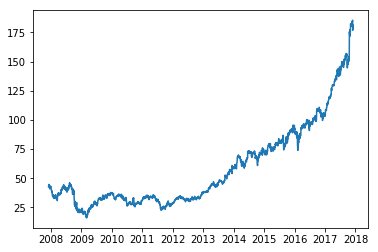

In [3]:
plt.plot(stockA['date'], stockA['adj_close'])


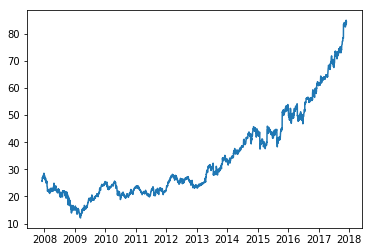

In [6]:
plt.plot(stockB['date'], stockB['adj_close'])


## Run Cointegration Test

In [7]:
import statsmodels # More info: https://www.statsmodels.org/stable/tsa.html#tsa-tools
from statsmodels.tsa.stattools import coint

In [8]:
stockA.rename(index = str, columns = {"adj_close": "stockA_adj_close"}, inplace = True)
stockB.rename(index = str, columns = {"adj_close": "stockB_adj_close"}, inplace = True)
frames = [stockA, stockB];
result = stockA.set_index('date').join(stockB.set_index('date'))


In [10]:
#Run Cointegration Test on Your 2 stocks
score, pvalue, _ = coint(result['stockA_adj_close'],result['stockB_adj_close']) #TDL4
print(pvalue) # the lower the better. <0.05 means the 2 stocks are statistically cointegrated. 
print(_)

0.0013419105642537197
[-3.9007982  -3.33855958 -3.04613612]


## Plot Spread between Your 2 Stocks

In [11]:
result['ratio'] = result['stockA_adj_close']/ result['stockB_adj_close']

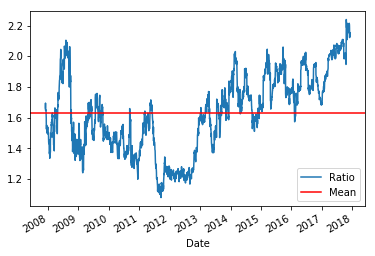

In [12]:
ratios = result['ratio']
ratios.plot()
plt.axhline(ratios.mean(), color = 'red')
plt.legend(['Ratio','Mean'])
plt.xlabel('Date')
plt.show()

In [13]:
result['zscore'] = ( result['ratio'] - result['ratio'].mean() ) / np.std(result['ratio'])

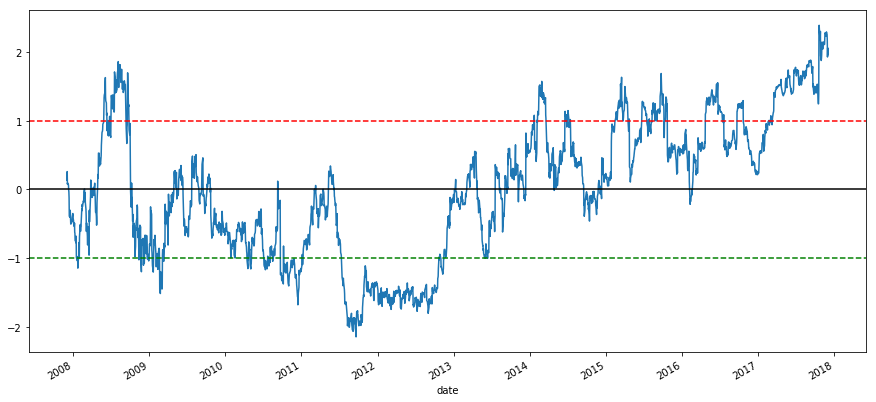

In [14]:
zscores = result['zscore']
plt.figure(figsize=(15,7))
zscores.plot()
plt.axhline(zscores.mean(), color = 'black')
plt.axhline(1.0, color='red', linestyle = '--')
plt.axhline(-1.0, color='green', linestyle = '--')
plt.show()

In [15]:
training_set_size = int( 3/4 * len(ratios) )
train = ratios[:training_set_size]
test = ratios[training_set_size:]

In [16]:
ratios_mavg5 = train.rolling(window=5, center=False).mean()
ratios_mavg60 = train.rolling(window=60, center=False).mean()
std_60 = train.rolling(window=60,center=False).std()
zscore_60_5 = (ratios_mavg5 - ratios_mavg60)/std_60

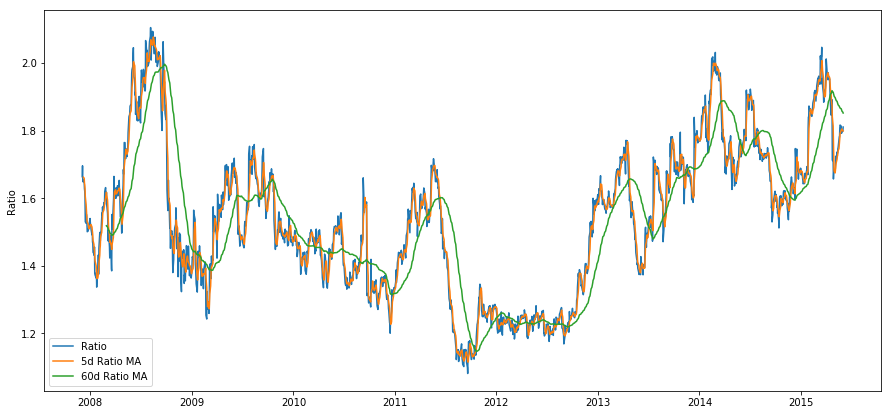

In [17]:
plt.figure(figsize=(15,7))
plt.plot(train.index,train.values)
plt.plot(ratios_mavg5.index, ratios_mavg5.values)
plt.plot(ratios_mavg60.index, ratios_mavg60.values)
plt.legend(['Ratio', '5d Ratio MA', '60d Ratio MA'])
plt.ylabel('Ratio')
plt.show()

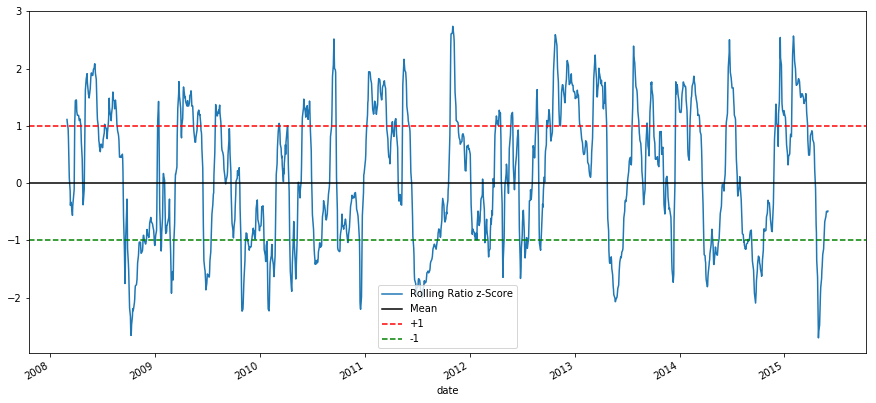

In [18]:
plt.figure(figsize=(15,7))
zscore_60_5.plot()
plt.axhline(0,color='black')
plt.axhline(1.0, color='red', linestyle='--')
plt.axhline(-1.0, color='green', linestyle='--')
plt.legend(['Rolling Ratio z-Score', 'Mean', '+1', '-1'])
plt.show()

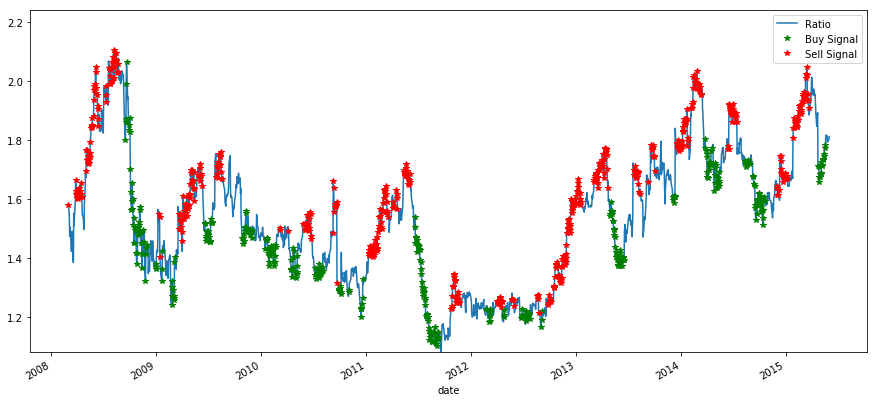

In [19]:
plt.figure(figsize=(15,7))
train[60:].plot()
buy = train.copy()
sell = train.copy()
buy[zscore_60_5 > -1] = 0 # For buy signal, when zscore > -1, we don't care so we simply set it to zero. We only care when zscore <= -1. 
sell[zscore_60_5 < 1] = 0 # For sell signal, when zscore < 1, we don't care so we simply set it to zero. We only care when zscore >= 1. 
buy[60:].plot(color='g', linestyle = 'None', marker = '*')
sell[60:].plot(color='r', linestyle = 'None', marker = '*')
x1,x2,y1,y2 = plt.axis()
plt.axis((x1,x2,ratios.min(), ratios.max()))
plt.legend(['Ratio', 'Buy Signal', 'Sell Signal'])
plt.show()

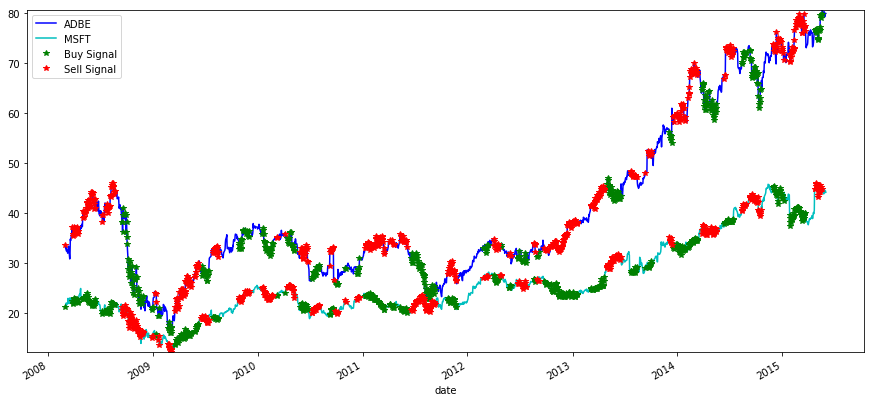

In [20]:
plt.figure(figsize=(15,7))
S1 = result['stockA_adj_close'].iloc[:training_set_size]
S2 = result['stockB_adj_close'].iloc[:training_set_size]
S1[60:].plot(color='b')
S2[60:].plot(color='c')

# initialize
buyR = 0*S1.copy()
sellR = 0*S1.copy()

# When buying Ratio, we long S1 and short S2
buyR[buy!=0] = S1[buy!=0]
buyR[sell!=0] = S2[sell!=0]

# when selling Ratio, we short S1 and long S2
sellR[sell!=0] = S1[sell!=0]
sellR[buy!=0] = S2[buy!=0]

buyR[60:].plot(color='g', linestyle = 'None', marker = '*')
sellR[60:].plot(color='r', linestyle = 'None', marker = '*')

x1,x2,y1,y2 = plt.axis()
plt.axis((x1,x2,min(S1.min(),S2.min()),max(S1.max(),S2.max())))
plt.legend(['ADBE', 'MSFT', 'Buy Signal', 'Sell Signal'])
plt.show()

In [21]:
def trade(S1, S2, window1, window2):
    if( (window1 == 0) or (window2 == 0) ):
        return 0
    ratios = S1/S2
    ma1 = ratios.rolling(window=window1,center=False).mean()
    ma2 = ratios.rolling(window=window2,center=False).mean()
    std = ratios.rolling(window=window2,center=False).std()
    zscore = (ma1 - ma2)/std;
    
    # simulate trading
    money = 0
    countS1 = 0
    countS2 = 0
    for i in range(len(ratios)):
        if zscore[i] > 1:
            money += S1[i] - S2[i]*ratios[i]
            countS1 -= 1;
            countS2 += ratios[i];
            print('Selling Ratio %s %s %s %s'%(money,ratios[i],countS1, countS2))
        elif zscore[i] < -1:
            money -= S1[i] - S2[i]*ratios[i]
            countS1 += 1;
            countS2 -= ratios[i];
            print('Buying Ratio %s %s %s %s'%(money,ratios[i],countS1, countS2))
        elif abs(zscore[i] < 0.55):
            money += S1[i] * countS1 + S2[i] * countS2;
            countS1 = 0
            countS2 = 0
            print('Exit pos %s %s %s %s'%(money,ratios[i],countS1, countS2))
    return money

In [22]:
money_training_data = trade(result['stockA_adj_close'].iloc[:training_set_size], result['stockB_adj_close'].iloc[:training_set_size], 5, 60 )


Selling Ratio 0.0 1.6166617406756194 -1 1.6166617406756194
Selling Ratio 0.0 1.580670369585654 -2 3.1973321102612733
Exit pos 5.5284475817912835 1.4730679811315484 0 0
Exit pos 5.5284475817912835 1.5047663596868592 0 0
Exit pos 5.5284475817912835 1.4922362138098428 0 0
Exit pos 5.5284475817912835 1.4548747190281084 0 0
Exit pos 5.5284475817912835 1.4225583160118498 0 0
Exit pos 5.5284475817912835 1.4878796318277476 0 0
Exit pos 5.5284475817912835 1.4866137836503102 0 0
Exit pos 5.5284475817912835 1.49017469011504 0 0
Exit pos 5.5284475817912835 1.3901024363243417 0 0
Exit pos 5.5284475817912835 1.3845198780422558 0 0
Exit pos 5.5284475817912835 1.5513462156711197 0 0
Exit pos 5.5284475817912835 1.5084380880339388 0 0
Exit pos 5.5284475817912835 1.5812273729533906 0 0
Exit pos 5.5284475817912835 1.6021476853731866 0 0
Selling Ratio 5.5284475817912835 1.6642106154014042 -1 1.6642106154014042
Selling Ratio 5.5284475817912835 1.6252326228842486 -2 3.289443238285653
Selling Ratio 5.52844758

Buying Ratio 685.9565184928421 1.5967456128210114 27 -42.9922890028359
Buying Ratio 685.9565184928421 1.605480438680762 28 -44.59776944151667
Buying Ratio 685.9565184928421 1.5930312602966255 29 -46.190800701813295
Exit pos 702.8131598068848 1.6068472266958191 0 0
Exit pos 702.8131598068848 1.591069341728244 0 0
Exit pos 702.8131598068848 1.5896722048908143 0 0
Exit pos 702.8131598068848 1.5770738697409294 0 0
Exit pos 702.8131598068848 1.5851041366353422 0 0
Exit pos 702.8131598068848 1.5966212547243188 0 0
Exit pos 702.8131598068848 1.5819225545472164 0 0
Exit pos 702.8131598068848 1.6165918599332467 0 0
Exit pos 702.8131598068848 1.6214448570354192 0 0
Exit pos 702.8131598068848 1.5998913652852293 0 0
Exit pos 702.8131598068848 1.6219932283439873 0 0
Exit pos 702.8131598068848 1.6189702757837678 0 0
Exit pos 702.8131598068848 1.607319361682795 0 0
Exit pos 702.8131598068848 1.5968286846645647 0 0
Exit pos 702.8131598068848 1.592190363640163 0 0
Exit pos 702.8131598068848 1.592841965

In [23]:
print(money_training_data)

801.8379505786385


In [24]:
money_test_data = trade(result['stockA_adj_close'].iloc[training_set_size:], result['stockB_adj_close'].iloc[training_set_size:], 5, 60 )

Exit pos 0.0 1.9110149973372987 0 0
Exit pos 0.0 1.9212205007251015 0 0
Exit pos 0.0 1.8837098587513152 0 0
Exit pos 0.0 1.9036548867664442 0 0
Exit pos 0.0 1.9079330139066286 0 0
Exit pos 0.0 1.921910888711028 0 0
Exit pos 0.0 1.927570252388998 0 0
Exit pos 0.0 1.922170654812706 0 0
Exit pos 0.0 1.9256865795117328 0 0
Exit pos 0.0 1.9119677105607176 0 0
Exit pos 0.0 1.9220238350051073 0 0
Exit pos 0.0 1.9189389011314706 0 0
Selling Ratio 0.0 1.9971790404820835 -1 1.9971790404820835
Selling Ratio 0.0 2.0390061705972333 -2 4.036185211079317
Selling Ratio 0.0 2.0606454595997525 -3 6.09683067067907
Selling Ratio -1.4210854715202004e-14 2.0204824391715173 -4 8.117313109850588
Selling Ratio 0.0 2.000334033668971 -5 10.117647143519559
Selling Ratio 0.0 1.9666223777067227 -6 12.08426952122628
Selling Ratio 0.0 1.9430371709148369 -7 14.027306692141117
Selling Ratio 0.0 1.966799092700745 -8 15.994105784841862
Selling Ratio 0.0 1.9849857284729602 -9 17.97909151331482
Exit pos 69.958914769638 1.8

In [25]:
print(money_test_data)

708.496919778221


In [26]:
length_scores_training_data = [ trade( result['stockA_adj_close'].iloc[:training_set_size], result['stockB_adj_close'].iloc[:training_set_size], 5, l ) for l in range(255) ]

Selling Ratio 0.0 1.6481963939389386 -1 1.6481963939389386
Selling Ratio 0.0 1.6465158184137543 -2 3.294712212352693
Selling Ratio 0.0 1.6201799393600549 -3 4.914892151712747
Selling Ratio 0.0 1.598789464958791 -4 6.513681616671539
Selling Ratio 0.0 1.5254825406113102 -5 8.03916415728285
Selling Ratio 0.0 1.5518355090101765 -6 9.590999666293026
Exit pos 8.917040664921444 1.543706175027 0 0
Exit pos 8.917040664921444 1.5228136223989486 0 0
Selling Ratio 8.917040664921444 1.5003651304000634 -1 1.5003651304000634
Selling Ratio 8.917040664921444 1.5021796360512862 -2 3.00254476645135
Selling Ratio 8.917040664921444 1.510758799670857 -3 4.5133035661222065
Buying Ratio 8.917040664921444 1.509824697137924 -2 3.003478868984282
Exit pos 7.634807346516851 1.5245064146811194 0 0
Buying Ratio 7.634807346516851 1.5395684552247286 1 -1.5395684552247286
Exit pos 7.070914088089829 1.5190320861829425 0 0
Selling Ratio 7.070914088089829 1.5154912058884822 -1 1.5154912058884822
Selling Ratio 7.0709140880

Exit pos -13.276397572961006 1.428779349343308 0 0
Exit pos -13.276397572961006 1.3471914701197296 0 0
Selling Ratio -13.276397572961006 1.372997369422185 -1 1.372997369422185
Selling Ratio -13.276397572961006 1.3548509079734938 -2 2.7278482773956787
Exit pos -14.441663198862447 1.399547659435072 0 0
Buying Ratio -14.441663198862447 1.4324805554346498 1 -1.4324805554346498
Buying Ratio -14.441663198862447 1.4369670724185803 2 -2.86944762785323
Buying Ratio -14.441663198862447 1.4592612179144135 3 -4.328708845767643
Exit pos -15.79758122682819 1.41300410740904 0 0
Selling Ratio -15.79758122682819 1.3979487163696933 -1 1.3979487163696933
Selling Ratio -15.79758122682819 1.3895851313812404 -2 2.7875338477509337
Selling Ratio -15.79758122682819 1.3952740331653568 -3 4.1828078809162905
Exit pos -18.69153469318501 1.4578157768552087 0 0
Exit pos -18.69153469318501 1.3862729544981198 0 0
Selling Ratio -18.69153469318501 1.3699367646322527 -1 1.3699367646322527
Selling Ratio -18.69153469318501

Exit pos -47.47741305350026 1.7127896866739578 0 0
Buying Ratio -47.47741305350026 1.7040657656951899 1 -1.7040657656951899
Exit pos -47.07513021673969 1.7250953490496799 0 0
Exit pos -47.07513021673969 1.6705313294205841 0 0
Exit pos -47.07513021673969 1.717170222957021 0 0
Exit pos -47.07513021673969 1.7520749811781737 0 0
Buying Ratio -47.07513021673969 1.741325789648335 1 -1.741325789648335
Exit pos -47.568733974212186 1.714808375565489 0 0
Exit pos -47.568733974212186 1.7448032343056141 0 0
Exit pos -47.568733974212186 1.7586719200731922 0 0
Exit pos -47.568733974212186 1.6924879587814476 0 0
Selling Ratio -47.568733974212186 1.6680119495707129 -1 1.6680119495707129
Selling Ratio -47.56873397421219 1.6623787197525923 -2 3.330390669323305
Selling Ratio -47.56873397421219 1.6574583599055357 -3 4.98784902922884
Exit pos -48.33187361307692 1.67589716924986 0 0
Exit pos -48.33187361307692 1.6625547725236334 0 0
Exit pos -48.33187361307692 1.6415189275774298 0 0
Selling Ratio -48.331873

Buying Ratio -51.8916694680549 1.273157494729182 1 -1.273157494729182
Exit pos -52.14146586586218 1.2615631630975366 0 0
Selling Ratio -52.14146586586218 1.2508672611363716 -1 1.2508672611363716
Selling Ratio -52.14146586586218 1.2472525498725595 -2 2.498119811008931
Selling Ratio -52.14146586586218 1.2448472680487486 -3 3.7429670790576797
Selling Ratio -52.14146586586219 1.2482403024511106 -4 4.99120738150879
Exit pos -52.91505380732494 1.256933594739613 0 0
Exit pos -52.91505380732494 1.2324505637365193 0 0
Exit pos -52.91505380732494 1.258771723222118 0 0
Buying Ratio -52.91505380732494 1.2607031612905324 1 -1.2607031612905324
Buying Ratio -52.91505380732494 1.2623055842870334 2 -2.523008745577566
Buying Ratio -52.91505380732494 1.2752836192438517 3 -3.7982923648214175
Buying Ratio -52.91505380732494 1.279559787636215 4 -5.077852152457632
Buying Ratio -52.91505380732494 1.277971635874566 5 -6.355823788332199
Exit pos -53.490613545609165 1.2658428571291263 0 0
Exit pos -53.4906135456

Selling Ratio -75.07662636765673 1.768493467286359 -1 1.768493467286359
Selling Ratio -75.07662636765673 1.7696821706755617 -2 3.5381756379619205
Exit pos -75.39148879726399 1.7737512873074237 0 0
Exit pos -75.39148879726399 1.768119598318099 0 0
Exit pos -75.39148879726399 1.7761924231374848 0 0
Buying Ratio -75.39148879726399 1.782639547579231 1 -1.782639547579231
Buying Ratio -75.39148879726399 1.7948011611764212 2 -3.577440708755652
Exit pos -73.03354717034814 1.8252555499723853 0 0
Buying Ratio -73.03354717034814 1.842997200297897 1 -1.842997200297897
Buying Ratio -73.03354717034814 1.8304463032685852 2 -3.673443503566482
Exit pos -71.7879589350528 1.856451910995938 0 0
Buying Ratio -71.7879589350528 1.8697637369159354 1 -1.8697637369159354
Buying Ratio -71.7879589350528 1.859408257594039 2 -3.7291719945099744
Exit pos -72.6689408849591 1.851353730344995 0 0
Exit pos -72.6689408849591 1.869387444789349 0 0
Buying Ratio -72.6689408849591 1.8643093032748759 1 -1.8643093032748759
Exi

Exit pos 1.0504478857138793 1.6275997773552582 0 0
Exit pos 1.0504478857138793 1.5296907238721993 0 0
Selling Ratio 1.0504478857138793 1.5518355090101765 -1 1.5518355090101765
Exit pos 1.854126642190657 1.5228136223989486 0 0
Exit pos 1.854126642190657 1.5003651304000634 0 0
Selling Ratio 1.854126642190657 1.5021796360512862 -1 1.5021796360512862
Selling Ratio 1.854126642190657 1.510758799670857 -2 3.012938435722143
Exit pos 1.6659312936164028 1.509824697137924 0 0
Exit pos 1.6659312936164028 1.5245064146811194 0 0
Exit pos 1.6659312936164028 1.5395684552247286 0 0
Exit pos 1.6659312936164028 1.5190320861829425 0 0
Exit pos 1.6659312936164028 1.5154912058884822 0 0
Selling Ratio 1.6659312936164028 1.5057795492281068 -1 1.5057795492281068
Exit pos 2.6363675937916184 1.4696368985828527 0 0
Exit pos 2.6363675937916184 1.4664996609466157 0 0
Selling Ratio 2.6363675937916184 1.4305581663713114 -1 1.4305581663713114
Exit pos 1.997591123203378 1.455214850891202 0 0
Exit pos 1.997591123203378 

Exit pos -14.52139677928362 1.4793991922510015 0 0
Exit pos -14.52139677928362 1.4792056345014224 0 0
Exit pos -14.52139677928362 1.501214749612695 0 0
Exit pos -14.52139677928362 1.5060344921082411 0 0
Buying Ratio -14.52139677928362 1.4913515996268134 1 -1.4913515996268134
Exit pos -15.197924746541894 1.4631188326639093 0 0
Selling Ratio -15.197924746541894 1.4319287414166464 -1 1.4319287414166464
Selling Ratio -15.197924746541894 1.4146947407994084 -2 2.8466234822160548
Selling Ratio -15.197924746541894 1.334570978819916 -3 4.181194461035971
Exit pos -13.000068438607194 1.3650919681768574 0 0
Exit pos -13.000068438607194 1.4035403945582636 0 0
Exit pos -13.000068438607194 1.434111284519459 0 0
Buying Ratio -13.000068438607194 1.4232594784506927 1 -1.4232594784506927
Exit pos -13.502136905338297 1.4033227467085074 0 0
Exit pos -13.502136905338297 1.4055230674403725 0 0
Exit pos -13.502136905338297 1.3477742271008943 0 0
Selling Ratio -13.502136905338297 1.3471909808022184 -1 1.347190

Exit pos -29.26202371730294 1.1755284732711804 0 0
Selling Ratio -29.26202371730294 1.186195136899304 -1 1.186195136899304
Selling Ratio -29.26202371730294 1.19451546803408 -2 2.380710604933384
Exit pos -30.72873035113174 1.2200408024415226 0 0
Exit pos -30.72873035113174 1.208602109888555 0 0
Exit pos -30.72873035113174 1.1967081072822017 0 0
Exit pos -30.72873035113174 1.1976000003244944 0 0
Selling Ratio -30.72873035113174 1.1962158135659162 -1 1.1962158135659162
Exit pos -30.96181081090211 1.205024585225283 0 0
Exit pos -30.96181081090211 1.207598394714761 0 0
Buying Ratio -30.961810810902108 1.2127468181821925 1 -1.2127468181821925
Exit pos -31.4507725595358 1.1933071529428119 0 0
Exit pos -31.4507725595358 1.2192147924259884 0 0
Exit pos -31.4507725595358 1.2298592805378583 0 0
Exit pos -31.4507725595358 1.2422674535097589 0 0
Exit pos -31.4507725595358 1.212484016417166 0 0
Exit pos -31.4507725595358 1.2143660330628465 0 0
Selling Ratio -31.450772559535796 1.2093564332751352 -1 

Exit pos -11.687753982929657 1.6182114008989748 0 0
Exit pos -11.687753982929657 1.6203012835435802 0 0
Exit pos -11.687753982929657 1.597512420660102 0 0
Exit pos -11.687753982929657 1.5910118196153382 0 0
Exit pos -11.687753982929657 1.593989077237198 0 0
Exit pos -11.687753982929657 1.5728194436139333 0 0
Selling Ratio -11.687753982929657 1.5547387075475494 -1 1.5547387075475494
Exit pos -9.943723448577586 1.5114404439933595 0 0
Exit pos -9.943723448577586 1.5621821351773812 0 0
Exit pos -9.943723448577586 1.5967456128210114 0 0
Buying Ratio -9.943723448577586 1.605480438680762 1 -1.605480438680762
Buying Ratio -9.943723448577586 1.5930312602966255 2 -3.1985116989773874
Buying Ratio -9.943723448577586 1.6068472266958191 3 -4.8053589256732065
Exit pos -11.25799336311131 1.591069341728244 0 0
Exit pos -11.25799336311131 1.5896722048908143 0 0
Exit pos -11.25799336311131 1.5966212547243188 0 0
Exit pos -11.25799336311131 1.5819225545472164 0 0
Exit pos -11.25799336311131 1.616591859933

Exit pos 1.3640898278993596 1.6249742876772777 0 0
Exit pos 1.3640898278993596 1.6090278333392527 0 0
Exit pos 1.3640898278993596 1.6344277493975958 0 0
Exit pos 1.3640898278993596 1.6660162263355753 0 0
Exit pos 1.3640898278993596 1.7038286310067179 0 0
Exit pos 1.3640898278993596 1.682097161146987 0 0
Exit pos 1.3640898278993596 1.673396937019994 0 0
Exit pos 1.3640898278993596 1.676219524310541 0 0
Exit pos 1.3640898278993596 1.704788959050296 0 0
Exit pos 1.3640898278993596 1.7181439134297773 0 0
Exit pos 1.3640898278993596 1.6617444225233562 0 0
Exit pos 1.3640898278993596 1.6757623012493819 0 0
Exit pos 1.3640898278993596 1.682605708957362 0 0
Exit pos 1.3640898278993596 1.6753598822800218 0 0
Exit pos 1.3640898278993596 1.6624826059307078 0 0
Exit pos 1.3640898278993596 1.6546114230161193 0 0
Exit pos 1.3640898278993596 1.6058350165275181 0 0
Exit pos 1.3640898278993596 1.5290983929818713 0 0
Exit pos 1.3640898278993596 1.492699358156586 0 0
Exit pos 1.3640898278993596 1.5049629

Buying Ratio 5.277370796890104 1.4416531732833768 1 -1.4416531732833768
Exit pos 5.044097650519468 1.4311053549912232 0 0
Exit pos 5.044097650519468 1.4262620947869702 0 0
Exit pos 5.044097650519468 1.3948753031776835 0 0
Exit pos 5.044097650519468 1.3850294199839495 0 0
Exit pos 5.044097650519468 1.3614651482057407 0 0
Exit pos 5.044097650519468 1.3443458572923614 0 0
Exit pos 5.044097650519468 1.3200880991501538 0 0
Exit pos 5.044097650519468 1.3021396117092108 0 0
Exit pos 5.044097650519468 1.2881613845866 0 0
Exit pos 5.044097650519468 1.2709607711310356 0 0
Exit pos 5.044097650519468 1.2829463010058677 0 0
Exit pos 5.044097650519468 1.2988650350533262 0 0
Exit pos 5.044097650519468 1.285261046588767 0 0
Exit pos 5.044097650519468 1.2647759906545348 0 0
Exit pos 5.044097650519468 1.2562708987959823 0 0
Exit pos 5.044097650519468 1.2415207425159351 0 0
Exit pos 5.044097650519468 1.2034378221320674 0 0
Exit pos 5.044097650519468 1.2040228096477597 0 0
Exit pos 5.044097650519468 1.208

Exit pos 7.556548028416202 1.6244730932227869 0 0
Exit pos 7.556548028416202 1.6225629288429864 0 0
Exit pos 7.556548028416202 1.616760748283282 0 0
Exit pos 7.556548028416202 1.6111700034796643 0 0
Exit pos 7.556548028416202 1.5941599284840535 0 0
Exit pos 7.556548028416202 1.5966875568452912 0 0
Exit pos 7.556548028416202 1.591581373567108 0 0
Selling Ratio 7.556548028416202 1.5945576092313687 -1 1.5945576092313687
Exit pos 8.130410730092159 1.5747742423045172 0 0
Exit pos 8.130410730092159 1.470717496066628 0 0
Exit pos 8.130410730092159 1.5060395640701554 0 0
Exit pos 8.130410730092159 1.5275390002434335 0 0
Exit pos 8.130410730092159 1.5396561349117732 0 0
Exit pos 8.130410730092159 1.5286465354396888 0 0
Exit pos 8.130410730092159 1.5294940330495477 0 0
Exit pos 8.130410730092159 1.6069717864758302 0 0
Exit pos 8.130410730092159 1.6798430994402127 0 0
Exit pos 8.130410730092159 1.6705778535826252 0 0
Exit pos 8.130410730092159 1.6800111913731064 0 0
Buying Ratio 8.130410730092159

Exit pos 0.0 1.6022827162368294 0 0
Exit pos 0.0 1.6133525669513933 0 0
Exit pos 0.0 1.5992961653161584 0 0
Exit pos 0.0 1.630589488374768 0 0
Exit pos 0.0 1.6198898419654348 0 0
Exit pos 0.0 1.6176990253006183 0 0
Exit pos 0.0 1.6367691127882746 0 0
Exit pos 0.0 1.6062822087370174 0 0
Exit pos 0.0 1.6279391928953033 0 0
Exit pos 0.0 1.6255686122906567 0 0
Exit pos 0.0 1.6524291689966022 0 0
Exit pos 0.0 1.6168924945637844 0 0
Exit pos 0.0 1.607366543637462 0 0
Exit pos 0.0 1.5772098542328232 0 0
Exit pos 0.0 1.5447202932155704 0 0
Exit pos 0.0 1.5397733617766667 0 0
Exit pos 0.0 1.5277302601181688 0 0
Exit pos 0.0 1.496251573693552 0 0
Exit pos 0.0 1.5038906465413546 0 0
Exit pos 0.0 1.5800795524437774 0 0
Exit pos 0.0 1.6386444115310523 0 0
Exit pos 0.0 1.6845446358959204 0 0
Exit pos 0.0 1.6705766746481872 0 0
Exit pos 0.0 1.6953218952622786 0 0
Exit pos 0.0 1.764462762750758 0 0
Exit pos 0.0 1.764065467629973 0 0
Exit pos 0.0 1.7315418258105402 0 0
Exit pos 0.0 1.716409828992238 0 

Exit pos 0.0 1.4437252519839063 0 0
Exit pos 0.0 1.5082138668949336 0 0
Exit pos 0.0 1.464000332924486 0 0
Exit pos 0.0 1.466409683487178 0 0
Exit pos 0.0 1.4793991922510015 0 0
Exit pos 0.0 1.4679856332628565 0 0
Exit pos 0.0 1.4792056345014224 0 0
Exit pos 0.0 1.501214749612695 0 0
Exit pos 0.0 1.5060344921082411 0 0
Exit pos 0.0 1.4913515996268134 0 0
Exit pos 0.0 1.4631188326639093 0 0
Exit pos 0.0 1.4303328257266676 0 0
Exit pos 0.0 1.4319287414166464 0 0
Exit pos 0.0 1.4146947407994084 0 0
Exit pos 0.0 1.3977944320825326 0 0
Exit pos 0.0 1.3917438202803027 0 0
Exit pos 0.0 1.3644930896688958 0 0
Exit pos 0.0 1.357816041767452 0 0
Exit pos 0.0 1.334570978819916 0 0
Exit pos 0.0 1.3642637068345032 0 0
Exit pos 0.0 1.3650919681768574 0 0
Exit pos 0.0 1.4035403945582636 0 0
Exit pos 0.0 1.434111284519459 0 0
Exit pos 0.0 1.4232594784506927 0 0
Exit pos 0.0 1.4033227467085074 0 0
Exit pos 0.0 1.4055230674403725 0 0
Exit pos 0.0 1.3811584280413272 0 0
Exit pos 0.0 1.3477742271008943 0 

Exit pos 0.0 1.2134663986800087 0 0
Exit pos 0.0 1.2102473861927172 0 0
Exit pos 0.0 1.2502798666477586 0 0
Exit pos 0.0 1.2092565040861663 0 0
Exit pos 0.0 1.2269116721764317 0 0
Exit pos 0.0 1.2291214226969327 0 0
Exit pos 0.0 1.2323721287477323 0 0
Exit pos 0.0 1.2313803877067653 0 0
Exit pos 0.0 1.2422817488956885 0 0
Exit pos 0.0 1.2488562354575343 0 0
Exit pos 0.0 1.2523042968259415 0 0
Exit pos 0.0 1.240914393406903 0 0
Exit pos 0.0 1.253659453559592 0 0
Exit pos 0.0 1.2531525910876498 0 0
Exit pos 0.0 1.250691845107082 0 0
Exit pos 0.0 1.2432027014961096 0 0
Exit pos 0.0 1.2461128922743345 0 0
Exit pos 0.0 1.248522849105482 0 0
Exit pos 0.0 1.2688513480642456 0 0
Exit pos 0.0 1.2635701553450913 0 0
Exit pos 0.0 1.256327405400431 0 0
Exit pos 0.0 1.2330374834959457 0 0
Exit pos 0.0 1.2556423850049097 0 0
Exit pos 0.0 1.2508808993076588 0 0
Exit pos 0.0 1.2378792384279955 0 0
Exit pos 0.0 1.1896192656495086 0 0
Exit pos 0.0 1.1847495986792984 0 0
Exit pos 0.0 1.1841324363468204 0

Exit pos 0.0 1.9561484438826904 0 0
Exit pos 0.0 1.9473175352282763 0 0
Exit pos 0.0 1.9603409714377285 0 0
Exit pos 0.0 1.9706384799156877 0 0
Exit pos 0.0 1.9056326818476568 0 0
Exit pos 0.0 1.8942915069216997 0 0
Exit pos 0.0 1.8679587011645327 0 0
Exit pos 0.0 1.8388908791837422 0 0
Exit pos 0.0 1.7718512328655927 0 0
Exit pos 0.0 1.7944209163149367 0 0
Exit pos 0.0 1.7664251722580013 0 0
Exit pos 0.0 1.8033287280349175 0 0
Exit pos 0.0 1.770818787636181 0 0
Exit pos 0.0 1.76408743798218 0 0
Exit pos 0.0 1.750819226474789 0 0
Exit pos 0.0 1.7418128204095937 0 0
Exit pos 0.0 1.6749852978257147 0 0
Exit pos 0.0 1.6917034557485153 0 0
Exit pos 0.0 1.6711876689090086 0 0
Exit pos 0.0 1.7076390239207841 0 0
Exit pos 0.0 1.7247858846190907 0 0
Exit pos 0.0 1.7183741436055646 0 0
Exit pos 0.0 1.69721919385061 0 0
Exit pos 0.0 1.7234612675331702 0 0
Exit pos 0.0 1.7185325370835172 0 0
Exit pos 0.0 1.7163393728464225 0 0
Exit pos 0.0 1.760561083895536 0 0
Exit pos 0.0 1.7708070336908606 0 0

Exit pos 0.0 1.8577477630876997 0 0
Exit pos 0.0 1.8001777231655611 0 0
Exit pos 0.0 1.8605940427722034 0 0
Exit pos 0.0 1.8695642483210633 0 0
Exit pos 0.0 1.9901557344839724 0 0
Exit pos 0.0 2.0630721595603574 0 0
Exit pos 0.0 1.9582214723870561 0 0
Exit pos 0.0 1.9362040894298351 0 0
Exit pos 0.0 1.9447028926350307 0 0
Exit pos 0.0 1.8977659437094423 0 0
Exit pos 0.0 1.8504529972883748 0 0
Exit pos 0.0 1.832617488982543 0 0
Exit pos 0.0 1.8749762436876178 0 0
Exit pos 0.0 1.825207010052873 0 0
Exit pos 0.0 1.7011290489928805 0 0
Exit pos 0.0 1.6229021774011858 0 0
Exit pos 0.0 1.5630875566947706 0 0
Exit pos 0.0 1.5658802818293773 0 0
Exit pos 0.0 1.6530342535341238 0 0
Exit pos 0.0 1.5913849711288222 0 0
Exit pos 0.0 1.5992944943782856 0 0
Exit pos 0.0 1.5105141779354931 0 0
Exit pos 0.0 1.5361832512801261 0 0
Exit pos 0.0 1.4514005493217013 0 0
Exit pos 0.0 1.4513237566942894 0 0
Exit pos 0.0 1.4930539714977733 0 0
Exit pos 0.0 1.5032962320316285 0 0
Exit pos 0.0 1.497462925821492

Exit pos 0.0 1.4766473790176267 0 0
Exit pos 0.0 1.4855945698508568 0 0
Exit pos 0.0 1.6599789564219132 0 0
Exit pos 0.0 1.6375503862353211 0 0
Exit pos 0.0 1.5573115474342543 0 0
Exit pos 0.0 1.573676623719649 0 0
Exit pos 0.0 1.5821144388925044 0 0
Exit pos 0.0 1.5729950920884368 0 0
Exit pos 0.0 1.5764893836227623 0 0
Exit pos 0.0 1.5792056618302794 0 0
Exit pos 0.0 1.5885935281278654 0 0
Exit pos 0.0 1.3144333981557437 0 0
Exit pos 0.0 1.3112095923150928 0 0
Exit pos 0.0 1.3158378989401947 0 0
Exit pos 0.0 1.3182216197924088 0 0
Exit pos 0.0 1.2916694375881255 0 0
Exit pos 0.0 1.289145921628798 0 0
Exit pos 0.0 1.2951202430340232 0 0
Exit pos 0.0 1.306933695036459 0 0
Exit pos 0.0 1.2986364028406439 0 0
Exit pos 0.0 1.2836382106964892 0 0
Exit pos 0.0 1.2774488000858515 0 0
Exit pos 0.0 1.4186007447579492 0 0
Exit pos 0.0 1.3323702028291302 0 0
Exit pos 0.0 1.3441110805965037 0 0
Exit pos 0.0 1.3511471194756912 0 0
Exit pos 0.0 1.326346814602818 0 0
Exit pos 0.0 1.3215532674610557 

Exit pos 0.0 1.2004814908339037 0 0
Exit pos 0.0 1.1945620071914549 0 0
Exit pos 0.0 1.1680849369357489 0 0
Exit pos 0.0 1.191059344289775 0 0
Exit pos 0.0 1.2221171528683172 0 0
Exit pos 0.0 1.2043488967887876 0 0
Exit pos 0.0 1.2074441140573402 0 0
Exit pos 0.0 1.2041170081479577 0 0
Exit pos 0.0 1.2125968519621246 0 0
Exit pos 0.0 1.2126167745026826 0 0
Exit pos 0.0 1.2210551697198944 0 0
Exit pos 0.0 1.2298467660833179 0 0
Exit pos 0.0 1.2324289278597373 0 0
Exit pos 0.0 1.2027918399357547 0 0
Exit pos 0.0 1.227947861961045 0 0
Exit pos 0.0 1.2640160536763172 0 0
Exit pos 0.0 1.2487221049296 0 0
Exit pos 0.0 1.2498331128934956 0 0
Exit pos 0.0 1.2461730856665623 0 0
Exit pos 0.0 1.241537695976028 0 0
Exit pos 0.0 1.252050030589003 0 0
Exit pos 0.0 1.254758516407069 0 0
Exit pos 0.0 1.2734689512919302 0 0
Exit pos 0.0 1.2642291169924842 0 0
Exit pos 0.0 1.2569180799785342 0 0
Exit pos 0.0 1.2528696600040263 0 0
Exit pos 0.0 1.2523252289043287 0 0
Exit pos 0.0 1.245990665463648 0 0
E

Exit pos 0.0 1.7255332477112484 0 0
Exit pos 0.0 1.7312087611995721 0 0
Exit pos 0.0 1.7264687477498024 0 0
Exit pos 0.0 1.7182328834726057 0 0
Exit pos 0.0 1.7360047219772006 0 0
Exit pos 0.0 1.7489929357942364 0 0
Exit pos 0.0 1.7379996469406025 0 0
Exit pos 0.0 1.7293549979433473 0 0
Exit pos 0.0 1.714589216240767 0 0
Exit pos 0.0 1.6814342545427292 0 0
Exit pos 0.0 1.6764764279336621 0 0
Exit pos 0.0 1.6728482072854785 0 0
Exit pos 0.0 1.6502946357065635 0 0
Exit pos 0.0 1.6498634472568245 0 0
Exit pos 0.0 1.642196145040144 0 0
Exit pos 0.0 1.5706203887993961 0 0
Exit pos 0.0 1.579424082930874 0 0
Exit pos 0.0 1.5293438774183925 0 0
Exit pos 0.0 1.5502909897588646 0 0
Exit pos 0.0 1.5806966576575927 0 0
Exit pos 0.0 1.591832223679846 0 0
Exit pos 0.0 1.596663405156829 0 0
Exit pos 0.0 1.5990225631501815 0 0
Exit pos 0.0 1.6182114008989748 0 0
Exit pos 0.0 1.6203012835435802 0 0
Exit pos 0.0 1.597512420660102 0 0
Exit pos 0.0 1.5910118196153382 0 0
Exit pos 0.0 1.611184467016763 0 0

Exit pos 0.0 1.385672620558089 0 0
Exit pos 0.0 1.404407834362287 0 0
Exit pos 0.0 1.3850920541206677 0 0
Exit pos 0.0 1.4053454411496407 0 0
Exit pos 0.0 1.428459070788487 0 0
Exit pos 0.0 1.403013817751949 0 0
Exit pos 0.0 1.4198495213630977 0 0
Exit pos 0.0 1.415557710218589 0 0
Exit pos 0.0 1.574241458678121 0 0
Exit pos 0.0 1.5496835001358085 0 0
Exit pos 0.0 1.4997743326286372 0 0
Exit pos 0.0 1.5480013857524868 0 0
Exit pos 0.0 1.5269664955643587 0 0
Exit pos 0.0 1.5456959657564011 0 0
Exit pos 0.0 1.5234998217573787 0 0
Exit pos 0.0 1.5064479964236892 0 0
Exit pos 0.0 1.4894934956719152 0 0
Exit pos 0.0 1.4561326585757326 0 0
Exit pos 0.0 1.4221630021610359 0 0
Exit pos 0.0 1.5092113496093589 0 0
Exit pos 0.0 1.611368880468625 0 0
Exit pos 0.0 1.5458495675127046 0 0
Exit pos 0.0 1.5305177261790297 0 0
Exit pos 0.0 1.5587824760632278 0 0
Exit pos 0.0 1.5811415067856973 0 0
Exit pos 0.0 1.5780230573131888 0 0
Exit pos 0.0 1.5517098068775175 0 0
Exit pos 0.0 1.5699884824038548 0 0

Exit pos 0.0 1.6176411768949832 0 0
Exit pos 0.0 1.6321410446066098 0 0
Exit pos 0.0 1.6259962528455525 0 0
Exit pos 0.0 1.643978595606985 0 0
Exit pos 0.0 1.6150278690624291 0 0
Exit pos 0.0 1.5896771176100408 0 0
Exit pos 0.0 1.5593757595157571 0 0
Exit pos 0.0 1.5511958400191823 0 0
Exit pos 0.0 1.5394904289139455 0 0
Exit pos 0.0 1.5457384152957472 0 0
Exit pos 0.0 1.5299536245923864 0 0
Exit pos 0.0 1.5576524631160693 0 0
Exit pos 0.0 1.4864069286468669 0 0
Exit pos 0.0 1.513107545438784 0 0
Exit pos 0.0 1.5266675189361794 0 0
Exit pos 0.0 1.5293811203538303 0 0
Exit pos 0.0 1.5335133542643535 0 0
Exit pos 0.0 1.541768901868019 0 0
Exit pos 0.0 1.5650393518626666 0 0
Exit pos 0.0 1.6065412437674231 0 0
Exit pos 0.0 1.6119889807494585 0 0
Exit pos 0.0 1.5887756914717819 0 0
Exit pos 0.0 1.5690453778579687 0 0
Exit pos 0.0 1.577028009555827 0 0
Exit pos 0.0 1.5697233476685921 0 0
Exit pos 0.0 1.5857698874373254 0 0
Exit pos 0.0 1.5932444761651805 0 0
Exit pos 0.0 1.5994766671308722 

Exit pos 0.0 1.685241048387952 0 0
Exit pos 0.0 1.679580232204668 0 0
Exit pos 0.0 1.686986231702173 0 0
Exit pos 0.0 1.6750022946372658 0 0
Exit pos 0.0 1.6712836934687778 0 0
Exit pos 0.0 1.6545232525065179 0 0
Exit pos 0.0 1.637370170748314 0 0
Exit pos 0.0 1.6979452165247033 0 0
Exit pos 0.0 1.6990492964711714 0 0
Exit pos 0.0 1.7222934560705614 0 0
Exit pos 0.0 1.708497432796521 0 0
Exit pos 0.0 1.7026358177740033 0 0
Exit pos 0.0 1.7224922862210106 0 0
Exit pos 0.0 1.7168483673510706 0 0
Exit pos 0.0 1.7238038113032321 0 0
Exit pos 0.0 1.7325408522716736 0 0
Exit pos 0.0 1.7506150749772842 0 0
Exit pos 0.0 1.711464522296689 0 0
Exit pos 0.0 1.734287283869778 0 0
Exit pos 0.0 1.6890761972341999 0 0
Exit pos 0.0 1.6715212504173687 0 0
Exit pos 0.0 1.7691769411001808 0 0
Exit pos 0.0 1.7710080368467718 0 0
Exit pos 0.0 1.7602103098801678 0 0
Exit pos 0.0 1.7697754767434624 0 0
Exit pos 0.0 1.748590213595547 0 0
Exit pos 0.0 1.7019638948935711 0 0
Exit pos 0.0 1.6354580934134728 0 0


Exit pos 0.0 2.0189084166613926 0 0
Exit pos 0.0 2.04654055318218 0 0
Exit pos 0.0 1.9379606823646505 0 0
Exit pos 0.0 1.9541474511532833 0 0
Exit pos 0.0 1.9325276452181412 0 0
Exit pos 0.0 1.908409513522672 0 0
Exit pos 0.0 1.883935296143261 0 0
Exit pos 0.0 1.8894278241400078 0 0
Exit pos 0.0 1.8967310887423792 0 0
Exit pos 0.0 1.9167315276626775 0 0
Exit pos 0.0 1.9247835452954427 0 0
Exit pos 0.0 1.9481819342410112 0 0
Exit pos 0.0 1.9747979942985092 0 0
Exit pos 0.0 2.0120922436918303 0 0
Exit pos 0.0 1.965491578666179 0 0
Exit pos 0.0 1.951241535799686 0 0
Exit pos 0.0 1.9509925728074282 0 0
Exit pos 0.0 1.9711539542982788 0 0
Exit pos 0.0 1.9649497315798201 0 0
Exit pos 0.0 1.9499856087071492 0 0
Exit pos 0.0 1.9533353216706877 0 0
Exit pos 0.0 1.9273958314630117 0 0
Exit pos 0.0 1.9093801954156302 0 0
Exit pos 0.0 1.8829052328863807 0 0
Exit pos 0.0 1.8455171392342817 0 0
Exit pos 0.0 1.8747916401806073 0 0
Exit pos 0.0 1.8814559357647838 0 0
Exit pos 0.0 1.891254982986816 0 0

Exit pos 0.0 1.4696114885710057 0 0
Exit pos 0.0 1.4753449797902833 0 0
Exit pos 0.0 1.4680880109851338 0 0
Exit pos 0.0 1.4585827407236056 0 0
Exit pos 0.0 1.4776485412775513 0 0
Exit pos 0.0 1.4847710058994277 0 0
Exit pos 0.0 1.4745479372494865 0 0
Exit pos 0.0 1.4983149544422723 0 0
Exit pos 0.0 1.5043677372084967 0 0
Exit pos 0.0 1.4905808934980478 0 0
Exit pos 0.0 1.4724422726592568 0 0
Exit pos 0.0 1.4719017438377047 0 0
Exit pos 0.0 1.459185907583215 0 0
Exit pos 0.0 1.4708598694280675 0 0
Exit pos 0.0 1.4267773704105458 0 0
Exit pos 0.0 1.4302046012491667 0 0
Exit pos 0.0 1.4618969824927202 0 0
Exit pos 0.0 1.4680068919622165 0 0
Exit pos 0.0 1.4686635012423457 0 0
Exit pos 0.0 1.4607302759317713 0 0
Exit pos 0.0 1.4335624342772377 0 0
Exit pos 0.0 1.4156390628824393 0 0
Exit pos 0.0 1.3743510346732828 0 0
Exit pos 0.0 1.3878389433271254 0 0
Exit pos 0.0 1.410341383416108 0 0
Exit pos 0.0 1.406719484154482 0 0
Exit pos 0.0 1.4258652061665926 0 0
Exit pos 0.0 1.417398664600083 

Exit pos 0.0 1.240914393406903 0 0
Exit pos 0.0 1.250691845107082 0 0
Exit pos 0.0 1.2432027014961096 0 0
Exit pos 0.0 1.2461128922743345 0 0
Exit pos 0.0 1.248522849105482 0 0
Exit pos 0.0 1.2688513480642456 0 0
Exit pos 0.0 1.2635701553450913 0 0
Exit pos 0.0 1.256327405400431 0 0
Exit pos 0.0 1.2330374834959457 0 0
Exit pos 0.0 1.2556423850049097 0 0
Exit pos 0.0 1.2508808993076588 0 0
Exit pos 0.0 1.2378792384279955 0 0
Exit pos 0.0 1.1896192656495086 0 0
Exit pos 0.0 1.1847495986792984 0 0
Exit pos 0.0 1.1841324363468204 0 0
Exit pos 0.0 1.200283163779781 0 0
Exit pos 0.0 1.2083704309895706 0 0
Exit pos 0.0 1.2249556989938135 0 0
Exit pos 0.0 1.2225233659788883 0 0
Exit pos 0.0 1.2279693741847713 0 0
Exit pos 0.0 1.2377650289142366 0 0
Exit pos 0.0 1.2495897244675154 0 0
Exit pos 0.0 1.23333869103449 0 0
Exit pos 0.0 1.2113709920647266 0 0
Exit pos 0.0 1.2055259762989075 0 0
Exit pos 0.0 1.225527611260801 0 0
Exit pos 0.0 1.2402448565221933 0 0
Exit pos 0.0 1.254266375762013 0 0
E

Exit pos 0.0 1.7733615506245632 0 0
Exit pos 0.0 1.7532514489280986 0 0
Exit pos 0.0 1.760757083668404 0 0
Exit pos 0.0 1.7538314777253148 0 0
Exit pos 0.0 1.7909720412555101 0 0
Exit pos 0.0 1.7826515433404522 0 0
Exit pos 0.0 1.8061265265292816 0 0
Exit pos 0.0 1.7989213574674614 0 0
Exit pos 0.0 1.7527014279541817 0 0
Exit pos 0.0 1.7570711107757933 0 0
Exit pos 0.0 1.7321273855328179 0 0
Exit pos 0.0 1.7488588426802876 0 0
Exit pos 0.0 1.7438578447324595 0 0
Exit pos 0.0 1.7139841734824734 0 0
Exit pos 0.0 1.729334807165537 0 0
Exit pos 0.0 1.7440009014506082 0 0
Exit pos 0.0 1.7265337839606225 0 0
Exit pos 0.0 1.7295050656604294 0 0
Exit pos 0.0 1.728497849470355 0 0
Exit pos 0.0 1.7089182232477118 0 0
Exit pos 0.0 1.720769112573741 0 0
Exit pos 0.0 1.725615920130233 0 0
Exit pos 0.0 1.7153266878281572 0 0
Exit pos 0.0 1.7221308454453057 0 0
Exit pos 0.0 1.7322549946536838 0 0
Exit pos 0.0 1.7262002809174808 0 0
Exit pos 0.0 1.7255332477112484 0 0
Exit pos 0.0 1.7312087611995721 0

Exit pos 0.0 1.4579518863498289 0 0
Exit pos 0.0 1.518353671709473 0 0
Exit pos 0.0 1.5306239847413363 0 0
Exit pos 0.0 1.5175341468044974 0 0
Exit pos 0.0 1.7290301759548954 0 0
Exit pos 0.0 1.7533927216786342 0 0
Exit pos 0.0 1.7116736345930543 0 0
Exit pos 0.0 1.7040657656951899 0 0
Exit pos 0.0 1.7250953490496799 0 0
Exit pos 0.0 1.6705313294205841 0 0
Exit pos 0.0 1.717170222957021 0 0
Exit pos 0.0 1.7520749811781737 0 0
Exit pos 0.0 1.741325789648335 0 0
Exit pos 0.0 1.714808375565489 0 0
Exit pos 0.0 1.6924879587814476 0 0
Exit pos 0.0 1.6680119495707129 0 0
Exit pos 0.0 1.6623787197525923 0 0
Exit pos 0.0 1.6574583599055357 0 0
Exit pos 0.0 1.67589716924986 0 0
Exit pos 0.0 1.6625547725236334 0 0
Exit pos 0.0 1.6415189275774298 0 0
Exit pos 0.0 1.6385097269769213 0 0
Exit pos 0.0 1.6364625308317946 0 0
Exit pos 0.0 1.6246806890612822 0 0
Exit pos 0.0 1.5887863855577848 0 0
Exit pos 0.0 1.5751787707011256 0 0
Exit pos 0.0 1.601362817341782 0 0
Exit pos 0.0 1.6055796218862934 0 0

Exit pos 0.0 1.2294287210525918 0 0
Exit pos 0.0 1.2307710563559005 0 0
Exit pos 0.0 1.2273408191375974 0 0
Exit pos 0.0 1.2266464342765242 0 0
Exit pos 0.0 1.2368234704164478 0 0
Exit pos 0.0 1.2386560681791867 0 0
Exit pos 0.0 1.24897831685419 0 0
Exit pos 0.0 1.2294558847450867 0 0
Exit pos 0.0 1.2422725018696366 0 0
Exit pos 0.0 1.2510469738027712 0 0
Exit pos 0.0 1.2601498420035264 0 0
Exit pos 0.0 1.2253200781729383 0 0
Exit pos 0.0 1.2225860407982838 0 0
Exit pos 0.0 1.2074055321530661 0 0
Exit pos 0.0 1.2061351482839693 0 0
Exit pos 0.0 1.2260906444480508 0 0
Exit pos 0.0 1.2381119122971036 0 0
Exit pos 0.0 1.2380363775569454 0 0
Exit pos 0.0 1.2178362232949764 0 0
Exit pos 0.0 1.2088574775566368 0 0
Exit pos 0.0 1.1958538303407058 0 0
Exit pos 0.0 1.226783217891181 0 0
Exit pos 0.0 1.2186827342682733 0 0
Exit pos 0.0 1.1826717026595002 0 0
Exit pos 0.0 1.187474034721319 0 0
Exit pos 0.0 1.2044920554520937 0 0
Exit pos 0.0 1.2267608201887406 0 0
Exit pos 0.0 1.221933566140776 0

Exit pos 0.0 1.7265337839606225 0 0
Exit pos 0.0 1.7295050656604294 0 0
Exit pos 0.0 1.728497849470355 0 0
Exit pos 0.0 1.7089182232477118 0 0
Exit pos 0.0 1.720769112573741 0 0
Exit pos 0.0 1.725615920130233 0 0
Exit pos 0.0 1.7153266878281572 0 0
Exit pos 0.0 1.7221308454453057 0 0
Exit pos 0.0 1.7322549946536838 0 0
Exit pos 0.0 1.7262002809174808 0 0
Exit pos 0.0 1.7255332477112484 0 0
Exit pos 0.0 1.7182328834726057 0 0
Exit pos 0.0 1.7360047219772006 0 0
Exit pos 0.0 1.7489929357942364 0 0
Exit pos 0.0 1.7379996469406025 0 0
Exit pos 0.0 1.7293549979433473 0 0
Exit pos 0.0 1.714589216240767 0 0
Exit pos 0.0 1.6814342545427292 0 0
Exit pos 0.0 1.6764764279336621 0 0
Exit pos 0.0 1.6728482072854785 0 0
Exit pos 0.0 1.6502946357065635 0 0
Exit pos 0.0 1.6498634472568245 0 0
Exit pos 0.0 1.642196145040144 0 0
Exit pos 0.0 1.5706203887993961 0 0
Exit pos 0.0 1.579424082930874 0 0
Exit pos 0.0 1.5293438774183925 0 0
Exit pos 0.0 1.5502909897588646 0 0
Exit pos 0.0 1.5806966576575927 0 

Exit pos 0.0 1.4479159248216524 0 0
Exit pos 0.0 1.4687458137228955 0 0
Exit pos 0.0 1.4679603258310876 0 0
Exit pos 0.0 1.4569596610006796 0 0
Exit pos 0.0 1.4817669568431437 0 0
Exit pos 0.0 1.4912136829950733 0 0
Exit pos 0.0 1.5061998519141118 0 0
Exit pos 0.0 1.5013927372018672 0 0
Exit pos 0.0 1.5399120570640517 0 0
Exit pos 0.0 1.5134491277751958 0 0
Exit pos 0.0 1.4952519241181674 0 0
Exit pos 0.0 1.4919886212703937 0 0
Exit pos 0.0 1.4875856586033014 0 0
Exit pos 0.0 1.4975774371542105 0 0
Exit pos 0.0 1.4789217556060472 0 0
Exit pos 0.0 1.4939660264569767 0 0
Exit pos 0.0 1.489842410552064 0 0
Exit pos 0.0 1.4676661442613816 0 0
Exit pos 0.0 1.4924442056175706 0 0
Exit pos 0.0 1.5081025941946653 0 0
Exit pos 0.0 1.4849504536522173 0 0
Exit pos 0.0 1.4980418697504019 0 0
Exit pos 0.0 1.502226828372691 0 0
Exit pos 0.0 1.4847359497018642 0 0
Exit pos 0.0 1.47472322542269 0 0
Exit pos 0.0 1.4583985003795659 0 0
Exit pos 0.0 1.462151239271605 0 0
Exit pos 0.0 1.4903075533900647 0

Exit pos 0.0 1.2303602143307224 0 0
Exit pos 0.0 1.2483619176459189 0 0
Exit pos 0.0 1.2513148220637025 0 0
Exit pos 0.0 1.2417820943324798 0 0
Exit pos 0.0 1.2370905003228045 0 0
Exit pos 0.0 1.2485584469838624 0 0
Exit pos 0.0 1.264743623757747 0 0
Exit pos 0.0 1.2509513183732246 0 0
Exit pos 0.0 1.2415892774431714 0 0
Exit pos 0.0 1.1986345045280682 0 0
Exit pos 0.0 1.2010283078843074 0 0
Exit pos 0.0 1.1915708586954608 0 0
Exit pos 0.0 1.196946421831212 0 0
Exit pos 0.0 1.199452407931448 0 0
Exit pos 0.0 1.2065493263700506 0 0
Exit pos 0.0 1.2077383155665729 0 0
Exit pos 0.0 1.2263535079611756 0 0
Exit pos 0.0 1.2207313053024345 0 0
Exit pos 0.0 1.1755284732711804 0 0
Exit pos 0.0 1.186195136899304 0 0
Exit pos 0.0 1.19451546803408 0 0
Exit pos 0.0 1.2200408024415226 0 0
Exit pos 0.0 1.208602109888555 0 0
Exit pos 0.0 1.1967081072822017 0 0
Exit pos 0.0 1.1976000003244944 0 0
Exit pos 0.0 1.1962158135659162 0 0
Exit pos 0.0 1.205024585225283 0 0
Exit pos 0.0 1.207598394714761 0 0
E

Exit pos 0.0 1.8958332522523123 0 0
Exit pos 0.0 1.9010531026612276 0 0
Exit pos 0.0 1.91988831335099 0 0
Exit pos 0.0 1.9322838173027876 0 0
Exit pos 0.0 1.9478067974047797 0 0
Exit pos 0.0 1.9370766419538006 0 0
Exit pos 0.0 1.9395113668592112 0 0
Exit pos 0.0 2.0212002141003333 0 0
Exit pos 0.0 2.0093110980505697 0 0
Exit pos 0.0 2.0189084166613926 0 0
Exit pos 0.0 1.9541474511532833 0 0
Exit pos 0.0 1.9325276452181412 0 0
Exit pos 0.0 1.908409513522672 0 0
Exit pos 0.0 1.883935296143261 0 0
Exit pos 0.0 1.8894278241400078 0 0
Exit pos 0.0 1.8967310887423792 0 0
Exit pos 0.0 1.9167315276626775 0 0
Exit pos 0.0 1.9247835452954427 0 0
Exit pos 0.0 1.9481819342410112 0 0
Exit pos 0.0 1.9747979942985092 0 0
Exit pos 0.0 1.9649497315798201 0 0
Exit pos 0.0 1.9499856087071492 0 0
Exit pos 0.0 1.9533353216706877 0 0
Exit pos 0.0 1.9273958314630117 0 0
Exit pos 0.0 1.9093801954156302 0 0
Exit pos 0.0 1.8829052328863807 0 0
Exit pos 0.0 1.8455171392342817 0 0
Exit pos 0.0 1.8747916401806073 

Exit pos -2.1765287577036183 1.5313914847928645 0 0
Exit pos -2.1765287577036183 1.5457832205285247 0 0
Exit pos -2.1765287577036183 1.5566468719232205 0 0
Exit pos -2.1765287577036183 1.4636457409117392 0 0
Exit pos -2.1765287577036183 1.4758252776783687 0 0
Exit pos -2.1765287577036183 1.4835717587996198 0 0
Exit pos -2.1765287577036183 1.440474273522277 0 0
Exit pos -2.1765287577036183 1.4070710771748587 0 0
Exit pos -2.1765287577036183 1.4005111605919456 0 0
Exit pos -2.1765287577036183 1.4035491308667303 0 0
Exit pos -2.1765287577036183 1.400582207899049 0 0
Exit pos -2.1765287577036183 1.3482798469119688 0 0
Exit pos -2.1765287577036183 1.344226551947647 0 0
Exit pos -2.1765287577036183 1.3411934880618965 0 0
Exit pos -2.1765287577036183 1.3664859077682772 0 0
Exit pos -2.1765287577036183 1.3302654605283744 0 0
Exit pos -2.1765287577036183 1.3638744278443033 0 0
Exit pos -2.1765287577036183 1.3434206522157457 0 0
Exit pos -2.1765287577036183 1.348815600483863 0 0
Exit pos -2.1765

Exit pos -2.751548291241072 1.5554921924864487 0 0
Exit pos -2.751548291241072 1.524405598767701 0 0
Exit pos -2.751548291241072 1.5247385038801087 0 0
Exit pos -2.751548291241072 1.494988193639733 0 0
Exit pos -2.751548291241072 1.4770837567025166 0 0
Exit pos -2.751548291241072 1.4975605984821954 0 0
Exit pos -2.751548291241072 1.4704049683687177 0 0
Exit pos -2.751548291241072 1.4387046301334574 0 0
Exit pos -2.751548291241072 1.4198336378554943 0 0
Exit pos -2.751548291241072 1.420491440744191 0 0
Exit pos -2.751548291241072 1.4027226664903776 0 0
Exit pos -2.751548291241072 1.4084450495242486 0 0
Exit pos -2.751548291241072 1.3923966369655227 0 0
Exit pos -2.751548291241072 1.3779508854182059 0 0
Exit pos -2.751548291241072 1.3734867946304983 0 0
Exit pos -2.751548291241072 1.3865464784336474 0 0
Exit pos -2.751548291241072 1.3826888254253697 0 0
Exit pos -2.751548291241072 1.3732610408981851 0 0
Exit pos -2.751548291241072 1.4266996935543197 0 0
Exit pos -2.751548291241072 1.4175

Exit pos 10.83605311654513 2.0300471394730333 0 0
Exit pos 10.83605311654513 2.0221777472266855 0 0
Exit pos 10.83605311654513 2.019769269030955 0 0
Exit pos 10.83605311654513 1.981483292860925 0 0
Exit pos 10.83605311654513 1.9531256167670608 0 0
Exit pos 10.83605311654513 1.903670886412227 0 0
Exit pos 10.83605311654513 1.8577477630876997 0 0
Exit pos 10.83605311654513 1.8001777231655611 0 0
Exit pos 10.83605311654513 1.8605940427722034 0 0
Buying Ratio 10.83605311654513 1.8695642483210633 1 -1.8695642483210633
Exit pos 13.238605009097967 1.9901557344839724 0 0
Exit pos 13.238605009097967 2.0630721595603574 0 0
Exit pos 13.238605009097967 1.9582214723870561 0 0
Exit pos 13.238605009097967 1.9362040894298351 0 0
Exit pos 13.238605009097967 1.8504529972883748 0 0
Exit pos 13.238605009097967 1.832617488982543 0 0
Exit pos 13.238605009097967 1.8749762436876178 0 0
Exit pos 13.238605009097967 1.825207010052873 0 0
Exit pos 13.238605009097967 1.7011290489928805 0 0
Exit pos 13.238605009097

Buying Ratio 4.762848345179254 1.577409056086877 1 -1.577409056086877
Exit pos 4.438818617681573 1.561159073778589 0 0
Exit pos 4.438818617681573 1.528194786637876 0 0
Exit pos 4.438818617681573 1.4953071475369493 0 0
Exit pos 4.438818617681573 1.5058282330489072 0 0
Exit pos 4.438818617681573 1.5391600603600712 0 0
Exit pos 4.438818617681573 1.449431926846358 0 0
Exit pos 4.438818617681573 1.4713940238644163 0 0
Exit pos 4.438818617681573 1.4683487602801533 0 0
Exit pos 4.438818617681573 1.4593723682450348 0 0
Exit pos 4.438818617681573 1.420818929259166 0 0
Exit pos 4.438818617681573 1.4475303463107936 0 0
Exit pos 4.438818617681573 1.440111284120933 0 0
Exit pos 4.438818617681573 1.4426647821312382 0 0
Exit pos 4.438818617681573 1.4416531732833768 0 0
Exit pos 4.438818617681573 1.4311053549912232 0 0
Exit pos 4.438818617681573 1.4262620947869702 0 0
Exit pos 4.438818617681573 1.3948753031776835 0 0
Exit pos 4.438818617681573 1.3850294199839495 0 0
Exit pos 4.438818617681573 1.361465

Exit pos 14.66161579869204 1.9561484438826904 0 0
Exit pos 14.66161579869204 1.9473175352282763 0 0
Exit pos 14.66161579869204 1.9603409714377285 0 0
Exit pos 14.66161579869204 1.9706384799156877 0 0
Exit pos 14.66161579869204 1.9056326818476568 0 0
Exit pos 14.66161579869204 1.8942915069216997 0 0
Exit pos 14.66161579869204 1.8679587011645327 0 0
Exit pos 14.66161579869204 1.8388908791837422 0 0
Exit pos 14.66161579869204 1.7718512328655927 0 0
Exit pos 14.66161579869204 1.7944209163149367 0 0
Buying Ratio 14.66161579869204 1.7664251722580013 1 -1.7664251722580013
Buying Ratio 14.66161579869204 1.8033287280349175 2 -3.569753900292919
Exit pos 13.631478113193012 1.770818787636181 0 0
Exit pos 13.631478113193012 1.76408743798218 0 0
Exit pos 13.631478113193012 1.750819226474789 0 0
Exit pos 13.631478113193012 1.7418128204095937 0 0
Exit pos 13.631478113193012 1.6749852978257147 0 0
Exit pos 13.631478113193012 1.6917034557485153 0 0
Exit pos 13.631478113193012 1.6711876689090086 0 0
Exit

Buying Ratio 18.57193003111385 1.6074966428356263 1 -1.6074966428356263
Exit pos 18.857599934025234 1.6249742876772777 0 0
Exit pos 18.857599934025234 1.6090278333392527 0 0
Exit pos 18.857599934025234 1.6344277493975958 0 0
Exit pos 18.857599934025234 1.6660162263355753 0 0
Exit pos 18.857599934025234 1.7038286310067179 0 0
Selling Ratio 18.857599934025234 1.676219524310541 -1 1.676219524310541
Selling Ratio 18.857599934025234 1.704788959050296 -2 3.381008483360837
Exit pos 20.514181762294992 1.6438272723924585 0 0
Exit pos 20.514181762294992 1.6753598822800218 0 0
Exit pos 20.514181762294992 1.6624826059307078 0 0
Exit pos 20.514181762294992 1.6546114230161193 0 0
Exit pos 20.514181762294992 1.6058350165275181 0 0
Exit pos 20.514181762294992 1.5290983929818713 0 0
Exit pos 20.514181762294992 1.492699358156586 0 0
Exit pos 20.514181762294992 1.5049629039944388 0 0
Buying Ratio 20.514181762294992 1.5186053286335404 1 -1.5186053286335404
Buying Ratio 20.514181762294996 1.514134024987631

Exit pos 13.05720227952504 1.2762590875727837 0 0
Exit pos 13.05720227952504 1.2534963128008911 0 0
Exit pos 13.05720227952504 1.212017555557817 0 0
Exit pos 13.05720227952504 1.2082421086342445 0 0
Exit pos 13.05720227952504 1.1999990827486455 0 0
Buying Ratio 13.05720227952504 1.2077453750243052 1 -1.2077453750243052
Buying Ratio 13.05720227952504 1.2316680864928047 2 -2.43941346151711
Exit pos 14.113633923110978 1.242083544544958 0 0
Exit pos 14.113633923110978 1.2258881646309094 0 0
Exit pos 14.113633923110978 1.20423185492177 0 0
Exit pos 14.113633923110978 1.2198118894529735 0 0
Exit pos 14.113633923110978 1.243354885129872 0 0
Exit pos 14.113633923110978 1.2628347923350636 0 0
Exit pos 14.113633923110978 1.205527871712797 0 0
Exit pos 14.113633923110978 1.194052180734158 0 0
Exit pos 14.113633923110978 1.2387412847372148 0 0
Exit pos 14.113633923110978 1.2450151338422761 0 0
Exit pos 14.113633923110978 1.2411782684952257 0 0
Exit pos 14.113633923110978 1.2474204436040208 0 0
Exi

Buying Ratio 29.678625515343036 1.5502909897588646 1 -1.5502909897588646
Buying Ratio 29.678625515343036 1.5806966576575927 2 -3.1309876474164575
Exit pos 31.96296141832874 1.591832223679846 0 0
Exit pos 31.96296141832874 1.596663405156829 0 0
Exit pos 31.96296141832874 1.5990225631501815 0 0
Exit pos 31.96296141832874 1.6182114008989748 0 0
Exit pos 31.96296141832874 1.6203012835435802 0 0
Exit pos 31.96296141832874 1.597512420660102 0 0
Exit pos 31.96296141832874 1.5910118196153382 0 0
Exit pos 31.96296141832874 1.593989077237198 0 0
Exit pos 31.96296141832874 1.5728194436139333 0 0
Exit pos 31.96296141832874 1.5779044334828776 0 0
Exit pos 31.96296141832874 1.5547387075475494 0 0
Exit pos 31.96296141832874 1.560566511020252 0 0
Buying Ratio 31.96296141832874 1.534108194432935 1 -1.534108194432935
Exit pos 31.04991674478856 1.5114404439933595 0 0
Buying Ratio 31.04991674478856 1.5621821351773812 1 -1.5621821351773812
Exit pos 32.410596985418806 1.5967456128210114 0 0
Exit pos 32.4105

Exit pos 19.168571504508968 1.4875856586033014 0 0
Exit pos 19.168571504508968 1.4975774371542105 0 0
Exit pos 19.168571504508968 1.4789217556060472 0 0
Exit pos 19.168571504508968 1.4939660264569767 0 0
Exit pos 19.168571504508968 1.489842410552064 0 0
Exit pos 19.168571504508968 1.4676661442613816 0 0
Exit pos 19.168571504508968 1.4924442056175706 0 0
Exit pos 19.168571504508968 1.5081025941946653 0 0
Exit pos 19.168571504508968 1.4849504536522173 0 0
Exit pos 19.168571504508968 1.4980418697504019 0 0
Exit pos 19.168571504508968 1.502226828372691 0 0
Exit pos 19.168571504508968 1.4847359497018642 0 0
Exit pos 19.168571504508968 1.47472322542269 0 0
Exit pos 19.168571504508968 1.4583985003795659 0 0
Exit pos 19.168571504508968 1.462151239271605 0 0
Exit pos 19.168571504508968 1.4903075533900647 0 0
Exit pos 19.168571504508968 1.547664532252114 0 0
Exit pos 19.168571504508968 1.5384737480487862 0 0
Exit pos 19.168571504508968 1.5133356478658948 0 0
Exit pos 19.168571504508968 1.4696114

Exit pos 22.57746951152557 1.2485584469838624 0 0
Exit pos 22.57746951152557 1.2570434760520646 0 0
Exit pos 22.57746951152557 1.264743623757747 0 0
Exit pos 22.57746951152557 1.2509513183732246 0 0
Exit pos 22.57746951152557 1.1986345045280682 0 0
Exit pos 22.57746951152557 1.2010283078843074 0 0
Exit pos 22.57746951152557 1.1915708586954608 0 0
Buying Ratio 22.577469511525575 1.196946421831212 1 -1.196946421831212
Buying Ratio 22.577469511525578 1.199452407931448 2 -2.39639882976266
Buying Ratio 22.577469511525578 1.2065493263700506 3 -3.602948156132711
Exit pos 23.1005264136967 1.2077383155665729 0 0
Exit pos 23.1005264136967 1.2263535079611756 0 0
Exit pos 23.1005264136967 1.2207313053024345 0 0
Exit pos 23.1005264136967 1.2248505277641728 0 0
Exit pos 23.1005264136967 1.2279993674437935 0 0
Exit pos 23.1005264136967 1.2044139964746168 0 0
Exit pos 23.1005264136967 1.1755284732711804 0 0
Exit pos 23.1005264136967 1.186195136899304 0 0
Exit pos 23.1005264136967 1.19451546803408 0 0


Selling Ratio 80.84095445239645 1.914094792294306 -1 1.914094792294306
Selling Ratio 80.84095445239645 1.918629443652632 -2 3.8327242359469382
Selling Ratio 80.84095445239645 1.8948915402639115 -3 5.7276157762108495
Selling Ratio 80.84095445239645 1.8872661435812468 -4 7.614881919792096
Selling Ratio 80.84095445239645 1.9313902003529264 -5 9.546272120145023
Selling Ratio 80.84095445239645 1.953525333412442 -6 11.499797453557465
Selling Ratio 80.84095445239645 1.9610554854888773 -7 13.460852939046342
Selling Ratio 80.84095445239645 2.04654055318218 -8 15.507393492228521
Selling Ratio 80.84095445239645 1.9379606823646505 -9 17.44535417459317
Exit pos 82.94677231736661 1.9325276452181412 0 0
Exit pos 82.94677231736661 1.908409513522672 0 0
Exit pos 82.94677231736661 1.883935296143261 0 0
Exit pos 82.94677231736661 1.8894278241400078 0 0
Exit pos 82.94677231736661 1.8967310887423792 0 0
Exit pos 82.94677231736661 1.9167315276626775 0 0
Exit pos 82.94677231736661 1.9247835452954427 0 0
Exit

Exit pos 36.27164979083898 1.4604543595858956 0 0
Exit pos 36.27164979083898 1.4670676548567703 0 0
Exit pos 36.27164979083898 1.4788135899398667 0 0
Exit pos 36.27164979083898 1.4351082819066094 0 0
Buying Ratio 36.27164979083898 1.4462096772011328 1 -1.4462096772011328
Buying Ratio 36.27164979083898 1.4437252519839063 2 -2.8899349291850394
Exit pos 39.333717046347104 1.5082138668949336 0 0
Exit pos 39.333717046347104 1.464000332924486 0 0
Exit pos 39.333717046347104 1.466409683487178 0 0
Exit pos 39.333717046347104 1.4793991922510015 0 0
Exit pos 39.333717046347104 1.4679856332628565 0 0
Exit pos 39.333717046347104 1.4792056345014224 0 0
Exit pos 39.333717046347104 1.501214749612695 0 0
Exit pos 39.333717046347104 1.4303328257266676 0 0
Exit pos 39.333717046347104 1.4319287414166464 0 0
Exit pos 39.333717046347104 1.4146947407994084 0 0
Buying Ratio 39.333717046347104 1.3977944320825326 1 -1.3977944320825326
Buying Ratio 39.333717046347104 1.3917438202803027 2 -2.7895382523628354
Buy

Exit pos 49.938518138513444 1.2593058968705193 0 0
Exit pos 49.938518138513444 1.2612920889431056 0 0
Selling Ratio 49.938518138513444 1.3361868031514208 -1 1.3361868031514208
Selling Ratio 49.938518138513444 1.3770074592951467 -2 2.7131942624465673
Selling Ratio 49.938518138513444 1.3673112743359181 -3 4.080505536782486
Selling Ratio 49.938518138513444 1.376484865722462 -4 5.456990402504948
Selling Ratio 49.938518138513444 1.379217865343711 -5 6.836208267848659
Selling Ratio 49.938518138513444 1.387978447420066 -6 8.224186715268726
Selling Ratio 49.938518138513444 1.3725347277785551 -7 9.596721443047281
Exit pos 57.24623972507919 1.3303970743937248 0 0
Exit pos 57.24623972507919 1.32593290706938 0 0
Exit pos 57.24623972507919 1.325075080977434 0 0
Exit pos 57.24623972507919 1.317924465606098 0 0
Exit pos 57.24623972507919 1.3138035535819206 0 0
Exit pos 57.24623972507919 1.3340432811963525 0 0
Exit pos 57.24623972507919 1.3712731694151115 0 0
Exit pos 57.24623972507919 1.3710477558455

Selling Ratio 79.27528234170724 1.7806838415248938 -4 7.083808966126632
Selling Ratio 79.27528234170724 1.8080129611191085 -5 8.89182192724574
Selling Ratio 79.27528234170724 1.8162593742221296 -6 10.70808130146787
Selling Ratio 79.27528234170724 1.812925433486323 -7 12.521006734954192
Selling Ratio 79.27528234170724 1.791856220184816 -8 14.312862955139007
Selling Ratio 79.27528234170724 1.7946461201831074 -9 16.107509075322113
Buying Ratio 0.0 1.5021796360512862 1 -1.5021796360512862
Buying Ratio 0.0 1.510758799670857 2 -3.012938435722143
Buying Ratio 0.0 1.509824697137924 3 -4.522763132860067
Exit pos 1.429288740352348 1.5245064146811194 0 0
Exit pos 1.429288740352348 1.5395684552247286 0 0
Exit pos 1.429288740352348 1.5190320861829425 0 0
Exit pos 1.429288740352348 1.5154912058884822 0 0
Exit pos 1.429288740352348 1.5057795492281068 0 0
Exit pos 1.429288740352348 1.4913256309474643 0 0
Exit pos 1.429288740352348 1.5039298402527577 0 0
Exit pos 1.429288740352348 1.4696368985828527 0 

Selling Ratio 61.93005700806751 1.5100403535144589 -1 1.5100403535144589
Selling Ratio 61.93005700806751 1.5160749892380154 -2 3.0261153427524743
Selling Ratio 61.93005700806751 1.513159485687082 -3 4.539274828439556
Selling Ratio 61.93005700806751 1.5178881991849165 -4 6.057163027624473
Selling Ratio 61.93005700806751 1.493467991837449 -5 7.550631019461921
Exit pos 61.796092056796226 1.511444007490254 0 0
Exit pos 61.796092056796226 1.5027993210276898 0 0
Exit pos 61.796092056796226 1.5313914847928645 0 0
Exit pos 61.796092056796226 1.5457832205285247 0 0
Exit pos 61.796092056796226 1.5566468719232205 0 0
Exit pos 61.796092056796226 1.4758252776783687 0 0
Exit pos 61.796092056796226 1.4835717587996198 0 0
Exit pos 61.796092056796226 1.440474273522277 0 0
Buying Ratio 61.796092056796226 1.4070710771748587 1 -1.4070710771748587
Buying Ratio 61.796092056796226 1.4005111605919456 2 -2.8075822377668045
Buying Ratio 61.796092056796226 1.4035491308667303 3 -4.211131368633534
Buying Ratio 61.

Exit pos 104.06669049839016 1.5910941280779538 0 0
Exit pos 104.06669049839016 1.5956930941410539 0 0
Exit pos 104.06669049839016 1.5815118561345183 0 0
Exit pos 104.06669049839016 1.5741695594246254 0 0
Exit pos 104.06669049839016 1.569062164430694 0 0
Exit pos 104.06669049839016 1.5640473834620676 0 0
Buying Ratio 104.06669049839016 1.569931085527478 1 -1.569931085527478
Exit pos 103.70672619992406 1.5551760027958565 0 0
Exit pos 103.70672619992406 1.5732632994226827 0 0
Exit pos 103.70672619992406 1.5670707053511126 0 0
Exit pos 103.70672619992406 1.5850694215343348 0 0
Exit pos 103.70672619992406 1.5989217631409096 0 0
Exit pos 103.70672619992406 1.6033935540909299 0 0
Selling Ratio 103.70672619992406 1.6210061484396576 -1 1.6210061484396576
Exit pos 104.91250841408093 1.5719155548575856 0 0
Exit pos 104.91250841408093 1.5746180552791824 0 0
Exit pos 104.91250841408093 1.5743951030486967 0 0
Exit pos 104.91250841408093 1.5751397166345447 0 0
Exit pos 104.91250841408093 1.5792017574

Selling Ratio 0.5508879214272326 1.550192373940236 -5 7.623451421399115
Selling Ratio 0.5508879214272326 1.573412779328212 -6 9.196864200727326
Selling Ratio 0.5508879214272326 1.5647533042591384 -7 10.761617504986464
Selling Ratio 0.5508879214272326 1.5829315347655208 -8 12.344549039751985
Selling Ratio 0.5508879214272326 1.5869182840603544 -9 13.93146732381234
Selling Ratio 0.5508879214272326 1.5814184776111941 -10 15.512885801423534
Selling Ratio 0.5508879214272326 1.6197233145715388 -11 17.132609115995074
Selling Ratio 0.5508879214272326 1.631066784226125 -12 18.763675900221198
Selling Ratio 0.5508879214272326 1.6148884807927806 -13 20.37856438101398
Selling Ratio 0.5508879214272326 1.6032089359710373 -14 21.981773316985016
Selling Ratio 0.5508879214272326 1.6166617406756194 -15 23.598435057660637
Exit pos 6.147874003245846 1.5555652243551465 0 0
Exit pos 6.147874003245846 1.5314613665791477 0 0
Exit pos 6.147874003245846 1.4730679811315484 0 0
Buying Ratio 6.147874003245846 1.5047

Exit pos 51.53218839034025 1.3707141041496087 0 0
Exit pos 51.53218839034025 1.3572494069615484 0 0
Selling Ratio 51.53218839034025 1.3949027821030033 -1 1.3949027821030033
Selling Ratio 51.53218839034025 1.405441600269486 -2 2.800344382372489
Selling Ratio 51.53218839034025 1.418692016282926 -3 4.219036398655415
Selling Ratio 51.53218839034025 1.385553684054829 -4 5.604590082710244
Exit pos 54.709176660262926 1.3616203649081795 0 0
Exit pos 54.709176660262926 1.372189003591875 0 0
Exit pos 54.709176660262926 1.3731934594910855 0 0
Exit pos 54.709176660262926 1.3741968150513153 0 0
Exit pos 54.709176660262926 1.3976202461798086 0 0
Exit pos 54.709176660262926 1.3897466208414908 0 0
Exit pos 54.709176660262926 1.4091708663073597 0 0
Exit pos 54.709176660262926 1.3830149326535908 0 0
Exit pos 54.709176660262926 1.3941800699431055 0 0
Exit pos 54.709176660262926 1.4181827384656083 0 0
Selling Ratio 54.709176660262926 1.464114696500513 -1 1.464114696500513
Selling Ratio 54.709176660262926 

Selling Ratio 96.24324715147668 1.685241048387952 -6 9.981085480870485
Selling Ratio 96.24324715147668 1.679580232204668 -7 11.660665713075153
Selling Ratio 96.24324715147668 1.686986231702173 -8 13.347651944777326
Selling Ratio 96.24324715147668 1.6750022946372658 -9 15.022654239414592
Exit pos 103.36909464927743 1.637370170748314 0 0
Exit pos 103.36909464927743 1.6979452165247033 0 0
Exit pos 103.36909464927743 1.6990492964711714 0 0
Exit pos 103.36909464927743 1.7222934560705614 0 0
Selling Ratio 103.36909464927743 1.7192571427883456 -1 1.7192571427883456
Selling Ratio 103.36909464927743 1.7026358177740033 -2 3.421892960562349
Selling Ratio 103.36909464927743 1.7224922862210106 -3 5.14438524678336
Exit pos 106.8407949634661 1.6715212504173687 0 0
Exit pos 106.8407949634661 1.7691769411001808 0 0
Exit pos 106.8407949634661 1.7710080368467718 0 0
Exit pos 106.8407949634661 1.7602103098801678 0 0
Selling Ratio 106.8407949634661 1.7637510080481902 -1 1.7637510080481902
Selling Ratio 106

Buying Ratio 14.522684967988113 1.3901024363243417 7 -10.224439790767242
Exit pos 2.2543999002662645 1.3845198780422558 0 0
Exit pos 2.2543999002662645 1.5513462156711197 0 0
Exit pos 2.2543999002662645 1.5084380880339388 0 0
Exit pos 2.2543999002662645 1.5812273729533906 0 0
Exit pos 2.2543999002662645 1.6021476853731866 0 0
Selling Ratio 2.2543999002662645 1.6252326228842486 -1 1.6252326228842486
Selling Ratio 2.2543999002662645 1.6173624354812444 -2 3.242595058365493
Selling Ratio 2.2543999002662645 1.6022827162368294 -3 4.844877774602322
Selling Ratio 2.2543999002662645 1.6133525669513933 -4 6.4582303415537154
Exit pos 1.034885499246741 1.6279391928953033 0 0
Exit pos 1.034885499246741 1.6255686122906567 0 0
Exit pos 1.034885499246741 1.6168924945637844 0 0
Exit pos 1.034885499246741 1.607366543637462 0 0
Exit pos 1.034885499246741 1.5772098542328232 0 0
Exit pos 1.034885499246741 1.5447202932155704 0 0
Buying Ratio 1.034885499246741 1.5397733617766667 1 -1.5397733617766667
Buying 

Selling Ratio 52.06954505624846 1.6599789564219132 -6 9.049447597342429
Selling Ratio 52.06954505624846 1.6375503862353211 -7 10.68699798357775
Selling Ratio 52.06954505624846 1.5573115474342543 -8 12.244309531012005
Selling Ratio 52.06954505624846 1.573676623719649 -9 13.817986154731654
Selling Ratio 52.06954505624846 1.5821144388925044 -10 15.40010059362416
Selling Ratio 52.06954505624846 1.5729950920884368 -11 16.973095685712597
Exit pos 103.08554633489145 1.3144333981557437 0 0
Exit pos 103.08554633489145 1.3112095923150928 0 0
Exit pos 103.08554633489145 1.3158378989401947 0 0
Buying Ratio 103.08554633489145 1.3182216197924088 1 -1.3182216197924088
Buying Ratio 103.08554633489145 1.2916694375881255 2 -2.6098910573805343
Buying Ratio 103.08554633489145 1.289145921628798 3 -3.899036979009332
Buying Ratio 103.08554633489145 1.2951202430340232 4 -5.194157222043355
Buying Ratio 103.08554633489145 1.306933695036459 5 -6.501090917079814
Buying Ratio 103.08554633489145 1.2986364028406439 

Exit pos 94.15090966569055 1.6715212504173687 0 0
Exit pos 94.15090966569055 1.7691769411001808 0 0
Exit pos 94.15090966569055 1.7710080368467718 0 0
Exit pos 94.15090966569055 1.7602103098801678 0 0
Selling Ratio 94.15090966569055 1.7637510080481902 -1 1.7637510080481902
Selling Ratio 94.15090966569055 1.748590213595547 -2 3.5123412216437373
Exit pos 100.72439317082477 1.6354580934134728 0 0
Exit pos 100.72439317082477 1.6603318269717549 0 0
Exit pos 100.72439317082477 1.5925596524239283 0 0
Buying Ratio 100.72439317082477 1.5970559585238642 1 -1.5970559585238642
Buying Ratio 100.72439317082477 1.5996050888394409 2 -3.196661047363305
Buying Ratio 100.72439317082477 1.564590318383031 3 -4.761251365746336
Buying Ratio 100.72439317082477 1.5421128766436587 4 -6.3033642423899945
Buying Ratio 100.72439317082477 1.5472184116703633 5 -7.850582654060358
Buying Ratio 100.72439317082477 1.5601519064288094 6 -9.410734560489168
Buying Ratio 100.72439317082477 1.5894078498029671 7 -11.000142410292

Buying Ratio 11.32603328535562 1.5397733617766667 1 -1.5397733617766667
Buying Ratio 11.32603328535562 1.5277302601181688 2 -3.0675036218948355
Buying Ratio 11.32603328535562 1.496251573693552 3 -4.563755195588388
Buying Ratio 11.32603328535562 1.5038906465413546 4 -6.067645842129743
Buying Ratio 11.32603328535562 1.5800795524437774 5 -7.64772539457352
Exit pos 23.70307237367699 1.6386444115310523 0 0
Exit pos 23.70307237367699 1.6845446358959204 0 0
Exit pos 23.70307237367699 1.6705766746481872 0 0
Selling Ratio 23.70307237367699 1.764462762750758 -1 1.764462762750758
Selling Ratio 23.70307237367699 1.764065467629973 -2 3.528528230380731
Selling Ratio 23.70307237367699 1.7315418258105402 -3 5.260070056191271
Selling Ratio 23.70307237367699 1.716409828992238 -4 6.976479885183509
Selling Ratio 23.70307237367699 1.7460666606369413 -5 8.72254654582045
Selling Ratio 23.70307237367699 1.7341553550922735 -6 10.456701900912723
Selling Ratio 23.70307237367699 1.8452609171513414 -7 12.301962818

Exit pos 120.37607640129252 1.3323702028291302 0 0
Exit pos 120.37607640129252 1.3441110805965037 0 0
Exit pos 120.37607640129252 1.3511471194756912 0 0
Exit pos 120.37607640129252 1.326346814602818 0 0
Exit pos 120.37607640129252 1.3215532674610557 0 0
Exit pos 120.37607640129252 1.3335318536564726 0 0
Exit pos 120.37607640129252 1.3181311161969755 0 0
Exit pos 120.37607640129252 1.3327470313887257 0 0
Exit pos 120.37607640129252 1.35187994217959 0 0
Exit pos 120.37607640129252 1.3216954846949265 0 0
Exit pos 120.37607640129252 1.3482841626072348 0 0
Exit pos 120.37607640129252 1.357838518280051 0 0
Exit pos 120.37607640129252 1.317806096869918 0 0
Exit pos 120.37607640129252 1.3116147828100835 0 0
Exit pos 120.37607640129252 1.296904933963803 0 0
Exit pos 120.37607640129252 1.280454039753257 0 0
Exit pos 120.37607640129252 1.2700634655901932 0 0
Buying Ratio 120.37607640129252 1.2850870859767372 1 -1.2850870859767372
Buying Ratio 120.37607640129252 1.2923305934484042 2 -2.57741767942

Exit pos 107.867251573117 1.6603318269717549 0 0
Buying Ratio 107.867251573117 1.5925596524239283 1 -1.5925596524239283
Buying Ratio 107.867251573117 1.5970559585238642 2 -3.1896156109477927
Buying Ratio 107.867251573117 1.5996050888394409 3 -4.789220699787234
Buying Ratio 107.867251573117 1.564590318383031 4 -6.353811018170265
Buying Ratio 107.867251573117 1.5421128766436587 5 -7.895923894813923
Buying Ratio 107.867251573117 1.5472184116703633 6 -9.443142306484287
Buying Ratio 107.867251573117 1.5601519064288094 7 -11.003294212913096
Buying Ratio 107.867251573117 1.5894078498029671 8 -12.592702062716063
Buying Ratio 107.867251573117 1.5597177657655121 9 -14.152419828481575
Exit pos 101.9481771759689 1.5501349476332815 0 0
Exit pos 101.9481771759689 1.5554921924864487 0 0
Exit pos 101.9481771759689 1.524405598767701 0 0
Exit pos 101.9481771759689 1.5247385038801087 0 0
Exit pos 101.9481771759689 1.494988193639733 0 0
Exit pos 101.9481771759689 1.4770837567025166 0 0
Buying Ratio 101.94

Exit pos 22.300752459699424 1.6705766746481872 0 0
Selling Ratio 22.300752459699424 1.764462762750758 -1 1.764462762750758
Selling Ratio 22.300752459699424 1.764065467629973 -2 3.528528230380731
Selling Ratio 22.300752459699424 1.7315418258105402 -3 5.260070056191271
Selling Ratio 22.300752459699424 1.716409828992238 -4 6.976479885183509
Selling Ratio 22.300752459699424 1.7460666606369413 -5 8.72254654582045
Selling Ratio 22.300752459699424 1.7341553550922735 -6 10.456701900912723
Selling Ratio 22.300752459699424 1.8452609171513414 -7 12.301962818064064
Selling Ratio 22.300752459699424 1.8511226869526918 -8 14.153085505016756
Selling Ratio 22.300752459699424 1.87203264057767 -9 16.025118145594426
Selling Ratio 22.300752459699424 1.879483909737764 -10 17.90460205533219
Selling Ratio 22.300752459699424 1.935222046103511 -11 19.839824101435703
Selling Ratio 22.300752459699424 1.9695026551382642 -12 21.809326756573967
Selling Ratio 22.300752459699424 1.9804941927195576 -13 23.7898209492935

Exit pos 117.36117544062336 1.3323702028291302 0 0
Exit pos 117.36117544062336 1.3441110805965037 0 0
Exit pos 117.36117544062336 1.3511471194756912 0 0
Exit pos 117.36117544062336 1.326346814602818 0 0
Exit pos 117.36117544062336 1.3215532674610557 0 0
Exit pos 117.36117544062336 1.3335318536564726 0 0
Exit pos 117.36117544062336 1.3181311161969755 0 0
Exit pos 117.36117544062336 1.3327470313887257 0 0
Exit pos 117.36117544062336 1.35187994217959 0 0
Exit pos 117.36117544062336 1.3216954846949265 0 0
Exit pos 117.36117544062336 1.3482841626072348 0 0
Exit pos 117.36117544062336 1.357838518280051 0 0
Exit pos 117.36117544062336 1.317806096869918 0 0
Exit pos 117.36117544062336 1.3116147828100835 0 0
Exit pos 117.36117544062336 1.296904933963803 0 0
Exit pos 117.36117544062336 1.280454039753257 0 0
Exit pos 117.36117544062336 1.2700634655901932 0 0
Buying Ratio 117.36117544062336 1.2850870859767372 1 -1.2850870859767372
Buying Ratio 117.36117544062336 1.2923305934484042 2 -2.57741767942

Selling Ratio 99.42020197586672 1.711464522296689 -18 30.473595807866676
Selling Ratio 99.42020197586672 1.734287283869778 -19 32.207883091736456
Exit pos 111.42685532600345 1.6715212504173687 0 0
Exit pos 111.42685532600345 1.7691769411001808 0 0
Exit pos 111.42685532600345 1.7710080368467718 0 0
Exit pos 111.42685532600345 1.7602103098801678 0 0
Selling Ratio 111.42685532600345 1.7637510080481902 -1 1.7637510080481902
Selling Ratio 111.42685532600345 1.748590213595547 -2 3.5123412216437373
Exit pos 118.00033883113767 1.6354580934134728 0 0
Exit pos 118.00033883113767 1.6603318269717549 0 0
Buying Ratio 118.00033883113767 1.5925596524239283 1 -1.5925596524239283
Buying Ratio 118.00033883113767 1.5970559585238642 2 -3.1896156109477927
Buying Ratio 118.00033883113767 1.5996050888394409 3 -4.789220699787234
Buying Ratio 118.00033883113767 1.564590318383031 4 -6.353811018170265
Buying Ratio 118.00033883113767 1.5421128766436587 5 -7.895923894813923
Buying Ratio 118.00033883113767 1.547218

Exit pos 41.66228787324826 1.5084380880339388 0 0
Exit pos 41.66228787324826 1.5812273729533906 0 0
Exit pos 41.66228787324826 1.6021476853731866 0 0
Selling Ratio 41.66228787324826 1.6173624354812444 -1 1.6173624354812444
Selling Ratio 41.66228787324826 1.6022827162368294 -2 3.2196451517180735
Selling Ratio 41.66228787324826 1.6133525669513933 -3 4.832997718669467
Selling Ratio 41.66228787324826 1.5992961653161584 -4 6.432293883985626
Exit pos 40.88232236881609 1.6168924945637844 0 0
Exit pos 40.88232236881609 1.607366543637462 0 0
Exit pos 40.88232236881609 1.5772098542328232 0 0
Exit pos 40.88232236881609 1.5447202932155704 0 0
Buying Ratio 40.88232236881609 1.5397733617766667 1 -1.5397733617766667
Buying Ratio 40.88232236881609 1.5277302601181688 2 -3.0675036218948355
Buying Ratio 40.88232236881609 1.496251573693552 3 -4.563755195588388
Buying Ratio 40.88232236881609 1.5038906465413546 4 -6.067645842129743
Buying Ratio 40.88232236881609 1.5800795524437774 5 -7.64772539457352
Exit p

Selling Ratio 90.33880408865392 1.4766473790176267 -4 5.903874071069658
Selling Ratio 90.33880408865392 1.4855945698508568 -5 7.389468640920515
Selling Ratio 90.33880408865392 1.6599789564219132 -6 9.049447597342429
Selling Ratio 90.33880408865392 1.6375503862353211 -7 10.68699798357775
Selling Ratio 90.33880408865392 1.5573115474342543 -8 12.244309531012005
Selling Ratio 90.33880408865392 1.573676623719649 -9 13.817986154731654
Selling Ratio 90.33880408865392 1.5821144388925044 -10 15.40010059362416
Selling Ratio 90.33880408865392 1.5729950920884368 -11 16.973095685712597
Exit pos 141.3548053672969 1.3144333981557437 0 0
Exit pos 141.3548053672969 1.3112095923150928 0 0
Exit pos 141.3548053672969 1.3158378989401947 0 0
Buying Ratio 141.3548053672969 1.3182216197924088 1 -1.3182216197924088
Buying Ratio 141.3548053672969 1.2916694375881255 2 -2.6098910573805343
Buying Ratio 141.3548053672969 1.289145921628798 3 -3.899036979009332
Buying Ratio 141.3548053672969 1.2951202430340232 4 -5.1

Exit pos 102.59060530824709 1.5989217631409096 0 0
Exit pos 102.59060530824709 1.6033935540909299 0 0
Exit pos 102.59060530824709 1.5929354338858488 0 0
Exit pos 102.59060530824709 1.6210061484396576 0 0
Exit pos 102.59060530824709 1.5719155548575856 0 0
Exit pos 102.59060530824709 1.5746180552791824 0 0
Exit pos 102.59060530824709 1.5743951030486967 0 0
Exit pos 102.59060530824709 1.5751397166345447 0 0
Exit pos 102.59060530824709 1.5792017574481045 0 0
Exit pos 102.59060530824709 1.5724077314055607 0 0
Exit pos 102.59060530824709 1.57661045181744 0 0
Exit pos 102.59060530824709 1.596468048691551 0 0
Exit pos 102.59060530824709 1.6123319015341817 0 0
Exit pos 102.59060530824709 1.6011001486458392 0 0
Selling Ratio 102.59060530824709 1.6274502793029366 -1 1.6274502793029366
Selling Ratio 102.59060530824709 1.6559090682235282 -2 3.283359347526465
Selling Ratio 102.59060530824709 1.6643834689013355 -3 4.9477428164278
Selling Ratio 102.59060530824709 1.6698761177330488 -4 6.61761893416084

Exit pos 11.497079704540738 1.4984379342774108 0 0
Selling Ratio 11.497079704540738 1.4879377066556618 -1 1.4879377066556618
Selling Ratio 11.497079704540738 1.4906138719943784 -2 2.9785515786500403
Selling Ratio 11.497079704540738 1.53866252868049 -3 4.51721410733053
Selling Ratio 11.497079704540738 1.5560449401283485 -4 6.073259047458879
Selling Ratio 11.497079704540738 1.550192373940236 -5 7.623451421399115
Selling Ratio 11.497079704540738 1.573412779328212 -6 9.196864200727326
Selling Ratio 11.497079704540738 1.5647533042591384 -7 10.761617504986464
Selling Ratio 11.497079704540738 1.5829315347655208 -8 12.344549039751985
Selling Ratio 11.497079704540738 1.5869182840603544 -9 13.93146732381234
Selling Ratio 11.497079704540738 1.5814184776111941 -10 15.512885801423534
Selling Ratio 11.497079704540738 1.6197233145715388 -11 17.132609115995074
Selling Ratio 11.497079704540738 1.631066784226125 -12 18.763675900221198
Selling Ratio 11.497079704540738 1.6148884807927806 -13 20.3785643810

Buying Ratio 103.2840451794689 1.3411934880618965 7 -9.645413463454096
Buying Ratio 103.2840451794689 1.3664859077682772 8 -11.011899371222373
Buying Ratio 103.2840451794689 1.3302654605283744 9 -12.342164831750747
Buying Ratio 103.2840451794689 1.3638744278443033 10 -13.70603925959505
Buying Ratio 103.2840451794689 1.3434206522157457 11 -15.049459911810796
Buying Ratio 103.2840451794689 1.348815600483863 12 -16.39827551229466
Exit pos 97.21677361599083 1.3417548235238677 0 0
Exit pos 97.21677361599083 1.3372048349290862 0 0
Exit pos 97.21677361599083 1.3336552367996124 0 0
Exit pos 97.21677361599083 1.3430604293495703 0 0
Exit pos 97.21677361599083 1.3485769882141048 0 0
Exit pos 97.21677361599083 1.3808510686839004 0 0
Exit pos 97.21677361599083 1.3627053198549222 0 0
Exit pos 97.21677361599083 1.3619102909140262 0 0
Exit pos 97.21677361599083 1.3480289391933955 0 0
Exit pos 97.21677361599083 1.344354354379085 0 0
Exit pos 97.21677361599083 1.3567582173315642 0 0
Exit pos 97.21677361

Exit pos 126.63623734138636 1.325075080977434 0 0
Exit pos 126.63623734138636 1.317924465606098 0 0
Exit pos 126.63623734138636 1.3138035535819206 0 0
Exit pos 126.63623734138636 1.3340432811963525 0 0
Exit pos 126.63623734138636 1.3712731694151115 0 0
Exit pos 126.63623734138636 1.3710477558455718 0 0
Exit pos 126.63623734138636 1.3976100703852385 0 0
Selling Ratio 126.63623734138636 1.40606584140552 -1 1.40606584140552
Selling Ratio 126.63623734138636 1.3950304306821029 -2 2.801096272087623
Selling Ratio 126.63623734138636 1.3910790116814902 -3 4.192175283769113
Selling Ratio 126.63623734138636 1.3764933478860752 -4 5.568668631655188
Selling Ratio 126.63623734138636 1.4845080192480182 -5 7.053176650903207
Selling Ratio 126.63623734138636 1.4988203812749694 -6 8.551997032178177
Selling Ratio 126.63623734138636 1.5281711440560113 -7 10.080168176234189
Selling Ratio 126.63623734138636 1.5152617678817288 -8 11.595429944115917
Selling Ratio 126.63623734138636 1.501037224311357 -9 13.09646

Exit pos 208.80397731656123 1.8455171392342817 0 0
Buying Ratio 208.80397731656123 1.8747916401806073 1 -1.8747916401806073
Buying Ratio 208.80397731656123 1.8814559357647838 2 -3.756247575945391
Buying Ratio 208.80397731656123 1.891254982986816 3 -5.6475025589322065
Buying Ratio 208.80397731656123 1.7127306170956624 4 -7.360233176027869
Buying Ratio 208.80397731656123 1.7072481049183856 5 -9.067481280946254
Buying Ratio 208.80397731656123 1.6566249419104861 6 -10.72410622285674
Buying Ratio 208.80397731656123 1.6735883584965012 7 -12.39769458135324
Buying Ratio 208.80397731656123 1.6750461836976316 8 -14.072740765050872
Buying Ratio 208.80397731656123 1.6826756636091236 9 -15.755416428659995
Buying Ratio 208.80397731656123 1.684272341603994 10 -17.439688770263988
Buying Ratio 208.80397731656123 1.6877897364666188 11 -19.127478506730608
Buying Ratio 208.80397731656123 1.723893168432356 12 -20.851371675162962
Exit pos 196.51458823746495 1.714123593288447 0 0
Exit pos 196.51458823746495 

Exit pos 91.13318740174232 1.4679856332628565 0 0
Exit pos 91.13318740174232 1.4792056345014224 0 0
Exit pos 91.13318740174232 1.501214749612695 0 0
Exit pos 91.13318740174232 1.5060344921082411 0 0
Exit pos 91.13318740174232 1.4913515996268134 0 0
Exit pos 91.13318740174232 1.4631188326639093 0 0
Exit pos 91.13318740174232 1.4303328257266676 0 0
Exit pos 91.13318740174232 1.4319287414166464 0 0
Exit pos 91.13318740174232 1.4146947407994084 0 0
Buying Ratio 91.13318740174232 1.3977944320825326 1 -1.3977944320825326
Buying Ratio 91.13318740174232 1.3917438202803027 2 -2.7895382523628354
Buying Ratio 91.13318740174232 1.3644930896688958 3 -4.154031342031731
Buying Ratio 91.13318740174232 1.357816041767452 4 -5.511847383799183
Buying Ratio 91.13318740174232 1.334570978819916 5 -6.846418362619099
Buying Ratio 91.13318740174232 1.3642637068345032 6 -8.210682069453602
Buying Ratio 91.13318740174232 1.3650919681768574 7 -9.57577403763046
Buying Ratio 91.13318740174232 1.4035403945582636 8 -10

Selling Ratio 20.278175382199944 1.2422157017482813 -2 2.481943190463862
Selling Ratio 20.278175382199944 1.2406114970333622 -3 3.722554687497224
Selling Ratio 20.278175382199944 1.2434931455052083 -4 4.966047833002433
Selling Ratio 20.278175382199944 1.2306107955261125 -5 6.196658628528546
Selling Ratio 20.278175382199944 1.2703727139634682 -6 7.467031342492014
Selling Ratio 20.278175382199944 1.2615435204867593 -7 8.728574862978773
Selling Ratio 20.278175382199944 1.2756763328577292 -8 10.004251195836503
Selling Ratio 20.278175382199944 1.2747553003796293 -9 11.279006496216132
Exit pos 30.06710989226752 1.2124215311824948 0 0
Exit pos 30.06710989226752 1.2050240033060058 0 0
Exit pos 30.06710989226752 1.2004814908339037 0 0
Buying Ratio 30.067109892267517 1.1945620071914549 1 -1.1945620071914549
Buying Ratio 30.06710989226752 1.1680849369357489 2 -2.3626469441272038
Buying Ratio 30.067109892267517 1.191059344289775 3 -3.5537062884169788
Buying Ratio 30.067109892267517 1.2221171528683

Exit pos 96.19558048171906 1.6884611734417823 0 0
Exit pos 96.19558048171906 1.6689617667114813 0 0
Exit pos 96.19558048171906 1.6762500359737973 0 0
Exit pos 96.19558048171906 1.6667692815059878 0 0
Exit pos 96.19558048171906 1.6593926841237931 0 0
Exit pos 96.19558048171906 1.6528885118667553 0 0
Exit pos 96.19558048171906 1.6423235942551209 0 0
Exit pos 96.19558048171906 1.6464487515668096 0 0
Exit pos 96.19558048171906 1.6428162208299284 0 0
Exit pos 96.19558048171906 1.64303043756575 0 0
Buying Ratio 96.19558048171906 1.6673066147197064 1 -1.6673066147197064
Exit pos 96.46098945269635 1.6734987460471866 0 0
Exit pos 96.46098945269635 1.6625063408908567 0 0
Exit pos 96.46098945269635 1.6806970673732404 0 0
Exit pos 96.46098945269635 1.6819539213256676 0 0
Selling Ratio 96.46098945269635 1.8399114516526067 -1 1.8399114516526067
Selling Ratio 96.46098945269635 1.839692684919949 -2 3.679604136572556
Selling Ratio 96.46098945269635 1.8726855510377112 -3 5.552289687610267
Selling Ratio 

Exit pos 90.33740306983806 1.4696114885710057 0 0
Exit pos 90.33740306983806 1.4753449797902833 0 0
Exit pos 90.33740306983806 1.4680880109851338 0 0
Exit pos 90.33740306983806 1.4585827407236056 0 0
Exit pos 90.33740306983806 1.4776485412775513 0 0
Exit pos 90.33740306983806 1.4847710058994277 0 0
Exit pos 90.33740306983806 1.4745479372494865 0 0
Exit pos 90.33740306983806 1.4983149544422723 0 0
Exit pos 90.33740306983806 1.5043677372084967 0 0
Exit pos 90.33740306983806 1.4905808934980478 0 0
Exit pos 90.33740306983806 1.4724422726592568 0 0
Exit pos 90.33740306983806 1.4719017438377047 0 0
Exit pos 90.33740306983806 1.459185907583215 0 0
Exit pos 90.33740306983806 1.4708598694280675 0 0
Exit pos 90.33740306983806 1.4267773704105458 0 0
Buying Ratio 90.33740306983806 1.4302046012491667 1 -1.4302046012491667
Buying Ratio 90.33740306983806 1.4618969824927202 2 -2.892101583741887
Buying Ratio 90.33740306983806 1.4680068919622165 3 -4.360108475704104
Buying Ratio 90.33740306983806 1.4686

Exit pos 67.54858445607448 1.1896192656495086 0 0
Exit pos 67.54858445607448 1.1847495986792984 0 0
Buying Ratio 67.54858445607448 1.1841324363468204 1 -1.1841324363468204
Buying Ratio 67.54858445607448 1.200283163779781 2 -2.3844156001266015
Buying Ratio 67.54858445607448 1.2083704309895706 3 -3.592786031116172
Buying Ratio 67.54858445607448 1.2249556989938135 4 -4.817741730109986
Buying Ratio 67.54858445607448 1.2225233659788883 5 -6.0402650960888735
Exit pos 70.66003888234891 1.2307321244362244 0 0
Exit pos 70.66003888234891 1.2384927486121886 0 0
Exit pos 70.66003888234891 1.2238907406514237 0 0
Exit pos 70.66003888234891 1.2279693741847713 0 0
Exit pos 70.66003888234891 1.2377650289142366 0 0
Exit pos 70.66003888234891 1.2495897244675154 0 0
Exit pos 70.66003888234891 1.23333869103449 0 0
Exit pos 70.66003888234891 1.2113709920647266 0 0
Exit pos 70.66003888234891 1.2055259762989075 0 0
Exit pos 70.66003888234891 1.225527611260801 0 0
Exit pos 70.66003888234891 1.2402448565221933 

Exit pos 133.75062850494373 1.7182328834726057 0 0
Exit pos 133.75062850494373 1.7360047219772006 0 0
Exit pos 133.75062850494373 1.7489929357942364 0 0
Exit pos 133.75062850494373 1.7379996469406025 0 0
Exit pos 133.75062850494373 1.7293549979433473 0 0
Exit pos 133.75062850494373 1.714589216240767 0 0
Exit pos 133.75062850494373 1.6814342545427292 0 0
Exit pos 133.75062850494373 1.6764764279336621 0 0
Buying Ratio 133.75062850494373 1.6728482072854785 1 -1.6728482072854785
Buying Ratio 133.75062850494373 1.6502946357065635 2 -3.323142842992042
Buying Ratio 133.75062850494373 1.6498634472568245 3 -4.9730062902488665
Buying Ratio 133.75062850494373 1.642196145040144 4 -6.61520243528901
Buying Ratio 133.75062850494373 1.5706203887993961 5 -8.185822824088406
Buying Ratio 133.75062850494373 1.579424082930874 6 -9.76524690701928
Buying Ratio 133.75062850494373 1.5293438774183925 7 -11.294590784437673
Buying Ratio 133.75062850494373 1.5502909897588646 8 -12.844881774196537
Buying Ratio 133.

Buying Ratio 69.92522747443354 1.5887863855577848 2 -3.213467074619067
Buying Ratio 69.92522747443354 1.5751787707011256 3 -4.788645845320192
Buying Ratio 69.92522747443354 1.601362817341782 4 -6.390008662661974
Buying Ratio 69.92522747443354 1.6055796218862934 5 -7.995588284548267
Buying Ratio 69.92522747443354 1.6140465028776643 6 -9.609634787425932
Buying Ratio 69.92522747443354 1.6087204336777803 7 -11.218355221103712
Exit pos 72.18008917203076 1.6186605613183178 0 0
Exit pos 72.18008917203076 1.6357357087208806 0 0
Exit pos 72.18008917203076 1.681647219425337 0 0
Exit pos 72.18008917203076 1.722434467618561 0 0
Exit pos 72.18008917203076 1.7394816476066313 0 0
Exit pos 72.18008917203076 1.6119911963220213 0 0
Exit pos 72.18008917203076 1.604558094114644 0 0
Exit pos 72.18008917203076 1.5877618222695318 0 0
Exit pos 72.18008917203076 1.5722407937731737 0 0
Exit pos 72.18008917203076 1.539720787961928 0 0
Buying Ratio 72.18008917203076 1.549196927966645 1 -1.549196927966645
Buying R

Exit pos 29.458334323397594 1.277971635874566 0 0
Exit pos 29.458334323397594 1.2658428571291263 0 0
Exit pos 29.458334323397594 1.2812236719311216 0 0
Exit pos 29.458334323397594 1.2608448294126144 0 0
Exit pos 29.458334323397594 1.2303738551588463 0 0
Exit pos 29.458334323397594 1.2169796103484896 0 0
Exit pos 29.458334323397594 1.215651411009577 0 0
Exit pos 29.458334323397594 1.2736668001692195 0 0
Exit pos 29.458334323397594 1.2651467454572798 0 0
Exit pos 29.458334323397594 1.28327260165434 0 0
Exit pos 29.458334323397594 1.2750484152942918 0 0
Exit pos 29.458334323397594 1.2534963128008911 0 0
Exit pos 29.458334323397594 1.212017555557817 0 0
Exit pos 29.458334323397594 1.2082421086342445 0 0
Buying Ratio 29.458334323397597 1.1999990827486455 1 -1.1999990827486455
Buying Ratio 29.458334323397597 1.2077453750243052 2 -2.4077444577729508
Buying Ratio 29.458334323397597 1.2316680864928047 3 -3.6394125442657552
Buying Ratio 29.458334323397597 1.242083544544958 4 -4.881496088810714
B

Buying Ratio 106.34070746108404 1.6795840087388294 1 -1.6795840087388294
Buying Ratio 106.34070746108404 1.7211284606586523 2 -3.4007124693974817
Buying Ratio 106.34070746108404 1.7060267567037506 3 -5.106739226101232
Exit pos 107.59705105928467 1.7139287186693366 0 0
Exit pos 107.59705105928467 1.6738436449002647 0 0
Exit pos 107.59705105928467 1.6357484526020714 0 0
Exit pos 107.59705105928467 1.6393631427972923 0 0
Exit pos 107.59705105928467 1.6576965987696963 0 0
Buying Ratio 107.59705105928467 1.670409182697551 1 -1.670409182697551
Buying Ratio 107.59705105928467 1.6434213328212073 2 -3.313830515518758
Buying Ratio 107.59705105928467 1.6526728691320296 3 -4.966503384650788
Exit pos 108.15427701317526 1.6606248450682446 0 0
Exit pos 108.15427701317526 1.6905287053950349 0 0
Exit pos 108.15427701317526 1.7093204071896548 0 0
Exit pos 108.15427701317526 1.6988463789597383 0 0
Exit pos 108.15427701317526 1.6912125501644764 0 0
Exit pos 108.15427701317526 1.7202802690350547 0 0
Exit p

Selling Ratio 44.85088391162866 1.6966385827260277 -6 9.84854418673358
Selling Ratio 44.85088391162866 1.6531473643588863 -7 11.501691551092467
Selling Ratio 44.85088391162866 1.6991993067550282 -8 13.200890857847495
Selling Ratio 44.85088391162866 1.665076300966716 -9 14.865967158814211
Selling Ratio 44.85088391162866 1.6589786551103451 -10 16.524945813924557
Selling Ratio 44.85088391162866 1.6369131396878918 -11 18.161858953612448
Selling Ratio 44.85088391162866 1.6926372154169147 -12 19.854496169029364
Exit pos 52.176985781254004 1.6164821090801624 0 0
Exit pos 52.176985781254004 1.6030724855803018 0 0
Exit pos 52.176985781254004 1.6074966428356263 0 0
Exit pos 52.176985781254004 1.6249742876772777 0 0
Exit pos 52.176985781254004 1.6090278333392527 0 0
Exit pos 52.176985781254004 1.6344277493975958 0 0
Exit pos 52.176985781254004 1.6660162263355753 0 0
Exit pos 52.176985781254004 1.7038286310067179 0 0
Exit pos 52.176985781254004 1.682097161146987 0 0
Selling Ratio 52.17698578125400

Buying Ratio 193.93868099246558 1.1164263625810562 48 -63.6690129470235
Buying Ratio 193.93868099246558 1.116183688940958 49 -64.78519663596445
Buying Ratio 193.93868099246558 1.14312339126063 50 -65.92832002722508
Buying Ratio 193.93868099246558 1.138097948425709 51 -67.0664179756508
Exit pos 11.514892484356068 1.1450750503620706 0 0
Exit pos 11.514892484356068 1.1491389329067276 0 0
Exit pos 11.514892484356068 1.1498188722296736 0 0
Exit pos 11.514892484356068 1.1682056972989172 0 0
Exit pos 11.514892484356068 1.1361773663770327 0 0
Exit pos 11.514892484356068 1.1225972410560048 0 0
Exit pos 11.514892484356068 1.1180860842080804 0 0
Exit pos 11.514892484356068 1.1074233738774004 0 0
Buying Ratio 11.514892484356068 1.1009979557611416 1 -1.1009979557611416
Exit pos 12.618890916343595 1.1512335293275064 0 0
Exit pos 12.618890916343595 1.1275863902359458 0 0
Exit pos 12.618890916343595 1.1325266164662355 0 0
Exit pos 12.618890916343595 1.151555163324559 0 0
Exit pos 12.618890916343595 1.

Selling Ratio 64.45960100559857 1.7845130220506136 -3 5.350137822036297
Selling Ratio 64.45960100559857 1.799639395022557 -4 7.149777217058854
Selling Ratio 64.45960100559857 1.77910692475193 -5 8.928884141810784
Selling Ratio 64.45960100559857 1.763480053593196 -6 10.692364195403979
Selling Ratio 64.45960100559857 1.768493467286359 -7 12.460857662690337
Selling Ratio 64.45960100559857 1.7696821706755617 -8 14.2305398333659
Selling Ratio 64.45960100559857 1.8697637369159354 -9 16.100303570281834
Selling Ratio 64.45960100559857 1.859408257594039 -10 17.959711827875875
Selling Ratio 64.45960100559857 1.851353730344995 -11 19.81106555822087
Selling Ratio 64.45960100559857 1.869387444789349 -12 21.68045300301022
Selling Ratio 64.45960100559857 1.8643093032748759 -13 23.544762306285097
Selling Ratio 64.45960100559857 1.9051372873718389 -14 25.449899593656937
Selling Ratio 64.45960100559857 1.8711777163081456 -15 27.321077309965084
Selling Ratio 64.45960100559857 1.7791520316963578 -16 29.10

Exit pos 35.30120522402548 1.4592612179144135 0 0
Exit pos 35.30120522402548 1.41300410740904 0 0
Exit pos 35.30120522402548 1.3979487163696933 0 0
Exit pos 35.30120522402548 1.3895851313812404 0 0
Exit pos 35.30120522402548 1.3952740331653568 0 0
Exit pos 35.30120522402548 1.4578157768552087 0 0
Exit pos 35.30120522402548 1.3862729544981198 0 0
Exit pos 35.30120522402548 1.3699367646322527 0 0
Exit pos 35.30120522402548 1.3883101670473248 0 0
Exit pos 35.30120522402548 1.3879210305666236 0 0
Exit pos 35.30120522402548 1.3631641104472982 0 0
Exit pos 35.30120522402548 1.3708967612307728 0 0
Exit pos 35.30120522402548 1.379394597864454 0 0
Exit pos 35.30120522402548 1.4261889282840647 0 0
Exit pos 35.30120522402548 1.4197353511035247 0 0
Exit pos 35.30120522402548 1.4694537097024511 0 0
Selling Ratio 35.30120522402548 1.520577844731944 -1 1.520577844731944
Selling Ratio 35.30120522402548 1.54924986402033 -2 3.069827708752274
Selling Ratio 35.30120522402548 1.5370556963474225 -3 4.606883

Exit pos 199.366203415788 1.5471181431453025 0 0
Exit pos 199.366203415788 1.575957791683597 0 0
Exit pos 199.366203415788 1.6221924706723894 0 0
Exit pos 199.366203415788 1.6727361931376525 0 0
Selling Ratio 199.366203415788 1.69143856714548 -1 1.69143856714548
Selling Ratio 199.366203415788 1.677260272409248 -2 3.368698839554728
Selling Ratio 199.366203415788 1.6858075798110945 -3 5.054506419365823
Selling Ratio 199.366203415788 1.6814331638031692 -4 6.735939583168992
Selling Ratio 199.366203415788 1.7057448294837907 -5 8.441684412652783
Selling Ratio 199.366203415788 1.7165548450717003 -6 10.158239257724484
Selling Ratio 199.366203415788 1.6959346906410464 -7 11.85417394836553
Selling Ratio 199.366203415788 1.6830426951809332 -8 13.537216643546463
Selling Ratio 199.366203415788 1.679767488967835 -9 15.216984132514298
Selling Ratio 199.366203415788 1.6668707867114172 -10 16.883854919225715
Exit pos 204.62079950973902 1.662778142760622 0 0
Exit pos 204.62079950973902 1.684077103818523

Exit pos 84.19955253248057 1.6705778535826252 0 0
Exit pos 84.19955253248057 1.6800111913731064 0 0
Selling Ratio 84.19955253248057 1.6554435007763337 -1 1.6554435007763337
Exit pos 84.88013295853813 1.6323658881539482 0 0
Selling Ratio 84.88013295853813 1.781284194046108 -1 1.781284194046108
Selling Ratio 84.88013295853813 1.7666651421263813 -2 3.547949336172489
Selling Ratio 84.88013295853813 1.7691050176695127 -3 5.317054353842002
Selling Ratio 84.88013295853813 1.781842170399342 -4 7.0988965242413435
Selling Ratio 84.88013295853813 1.7752700952129128 -5 8.874166619454256
Selling Ratio 84.88013295853813 1.7462409986328442 -6 10.6204076180871
Selling Ratio 84.88013295853813 1.7426965968882961 -7 12.363104214975396
Selling Ratio 84.88013295853813 1.7434211945720812 -8 14.106525409547476
Exit pos 100.33642633549704 1.6996397721935996 0 0
Exit pos 100.33642633549704 1.7040941385778718 0 0
Exit pos 100.33642633549704 1.6771200599236522 0 0
Exit pos 100.33642633549704 1.6696877329629567 0

Exit pos 46.011529235291086 2.0300471394730333 0 0
Exit pos 46.011529235291086 2.0221777472266855 0 0
Exit pos 46.011529235291086 2.019769269030955 0 0
Exit pos 46.011529235291086 1.981483292860925 0 0
Buying Ratio 46.011529235291086 1.9531256167670608 1 -1.9531256167670608
Buying Ratio 46.011529235291086 1.903670886412227 2 -3.8567965031792877
Buying Ratio 46.011529235291086 1.8577477630876997 3 -5.714544266266987
Buying Ratio 46.011529235291086 1.8001777231655611 4 -7.514721989432548
Buying Ratio 46.011529235291086 1.8605940427722034 5 -9.37531603220475
Buying Ratio 46.011529235291086 1.8695642483210633 6 -11.244880280525814
Buying Ratio 46.011529235291086 1.9901557344839724 7 -13.235036015009786
Buying Ratio 46.01152923529108 2.0630721595603574 8 -15.298108174570144
Exit pos 53.37711244891241 1.9582214723870561 0 0
Exit pos 53.37711244891241 1.9362040894298351 0 0
Exit pos 53.37711244891241 1.9447028926350307 0 0
Exit pos 53.37711244891241 1.8977659437094423 0 0
Exit pos 53.37711244

Buying Ratio 195.59517703910706 1.3282528173381476 9 -11.262838725121929
Exit pos 208.0557804392036 1.3106349138196927 0 0
Exit pos 208.0557804392036 1.3140502440547062 0 0
Exit pos 208.0557804392036 1.3291116940386571 0 0
Exit pos 208.0557804392036 1.33066769897147 0 0
Exit pos 208.0557804392036 1.3347255602662862 0 0
Exit pos 208.0557804392036 1.3231633946493133 0 0
Selling Ratio 208.0557804392036 1.3497341222957298 -1 1.3497341222957298
Selling Ratio 208.0557804392036 1.3504226472467136 -2 2.7001567695424433
Selling Ratio 208.0557804392036 1.4079052616756877 -3 4.108062031218131
Selling Ratio 208.0557804392036 1.4142723284763459 -4 5.522334359694477
Selling Ratio 208.0557804392036 1.4174926259930514 -5 6.939826985687528
Selling Ratio 208.0557804392036 1.427363197344337 -6 8.367190183031866
Selling Ratio 208.0557804392036 1.439279019339012 -7 9.806469202370877
Selling Ratio 208.0557804392036 1.4376034644964741 -8 11.244072666867352
Selling Ratio 208.0557804392036 1.4357656572249464 -

Exit pos 90.34552735462385 1.5925596524239283 0 0
Buying Ratio 90.34552735462385 1.5970559585238642 1 -1.5970559585238642
Buying Ratio 90.34552735462385 1.5996050888394409 2 -3.196661047363305
Buying Ratio 90.34552735462385 1.564590318383031 3 -4.761251365746336
Buying Ratio 90.34552735462385 1.5421128766436587 4 -6.3033642423899945
Buying Ratio 90.34552735462385 1.5472184116703633 5 -7.850582654060358
Buying Ratio 90.34552735462385 1.5601519064288094 6 -9.410734560489168
Buying Ratio 90.34552735462385 1.5894078498029671 7 -11.000142410292135
Buying Ratio 90.34552735462385 1.5597177657655121 8 -12.559860176057647
Buying Ratio 90.34552735462385 1.5501349476332815 9 -14.10999512369093
Buying Ratio 90.34552735462385 1.5554921924864487 10 -15.665487316177378
Buying Ratio 90.34552735462385 1.524405598767701 11 -17.18989291494508
Buying Ratio 90.34552735462385 1.5247385038801087 12 -18.71463141882519
Buying Ratio 90.34552735462385 1.494988193639733 13 -20.20961961246492
Buying Ratio 90.34552

Buying Ratio 52.10569315073968 1.5084380880339388 6 -8.811195091837007
Exit pos 67.54288237723051 1.5812273729533906 0 0
Exit pos 67.54288237723051 1.6021476853731866 0 0
Selling Ratio 67.54288237723051 1.6022827162368294 -1 1.6022827162368294
Selling Ratio 67.54288237723051 1.6133525669513933 -2 3.215635283188223
Exit pos 70.50593120327493 1.5447202932155704 0 0
Exit pos 70.50593120327493 1.5397733617766667 0 0
Exit pos 70.50593120327493 1.5277302601181688 0 0
Exit pos 70.50593120327493 1.496251573693552 0 0
Exit pos 70.50593120327493 1.5038906465413546 0 0
Exit pos 70.50593120327493 1.5800795524437774 0 0
Exit pos 70.50593120327493 1.6386444115310523 0 0
Exit pos 70.50593120327493 1.6845446358959204 0 0
Exit pos 70.50593120327493 1.6705766746481872 0 0
Selling Ratio 70.50593120327493 1.764462762750758 -1 1.764462762750758
Selling Ratio 70.50593120327493 1.764065467629973 -2 3.528528230380731
Selling Ratio 70.50593120327493 1.7315418258105402 -3 5.260070056191271
Selling Ratio 70.5059

Exit pos 136.95410818701583 1.3567582173315642 0 0
Exit pos 136.95410818701583 1.3707141041496087 0 0
Exit pos 136.95410818701583 1.3572494069615484 0 0
Exit pos 136.95410818701583 1.407416676504297 0 0
Exit pos 136.95410818701583 1.414892250829507 0 0
Selling Ratio 136.95410818701583 1.405441600269486 -1 1.405441600269486
Selling Ratio 136.95410818701583 1.418692016282926 -2 2.824133616552412
Selling Ratio 136.95410818701583 1.385553684054829 -3 4.209687300607241
Selling Ratio 136.95410818701583 1.3980231014482396 -4 5.60771040205548
Selling Ratio 136.95410818701583 1.3996817888332063 -5 7.0073921908886865
Selling Ratio 136.95410818701583 1.3616203649081795 -6 8.369012555796866
Exit pos 139.6112979096112 1.3731934594910855 0 0
Exit pos 139.6112979096112 1.3741968150513153 0 0
Exit pos 139.6112979096112 1.3976202461798086 0 0
Exit pos 139.6112979096112 1.3897466208414908 0 0
Selling Ratio 139.6112979096112 1.464114696500513 -1 1.464114696500513
Selling Ratio 139.6112979096112 1.4905471

Selling Ratio 118.57360046643535 1.5310284624428003 -12 17.45947334303033
Selling Ratio 118.57360046643535 1.5149066567065297 -13 18.974379999736858
Selling Ratio 118.57360046643535 1.485060503012877 -14 20.459440502749736
Selling Ratio 118.57360046643535 1.5070108387001384 -15 21.966451341449876
Selling Ratio 118.57360046643535 1.4961430141736656 -16 23.46259435562354
Selling Ratio 118.57360046643535 1.5993230216860341 -17 25.061917377309573
Selling Ratio 118.57360046643535 1.576601905092999 -18 26.638519282402573
Selling Ratio 118.57360046643535 1.5529171280142355 -19 28.19143641041681
Selling Ratio 118.57360046643535 1.592196598273032 -20 29.78363300868984
Selling Ratio 118.57360046643535 1.5618403497619626 -21 31.3454733584518
Selling Ratio 118.57360046643535 1.568272773492714 -22 32.913746131944514
Selling Ratio 118.57360046643535 1.583281697236062 -23 34.497027829180574
Selling Ratio 118.57360046643535 1.595920863117602 -24 36.09294869229818
Selling Ratio 118.57360046643535 1.579

Exit pos 181.19925841836883 1.8967310887423792 0 0
Exit pos 181.19925841836883 1.9167315276626775 0 0
Exit pos 181.19925841836883 1.9247835452954427 0 0
Exit pos 181.19925841836883 1.9481819342410112 0 0
Exit pos 181.19925841836883 1.9747979942985092 0 0
Exit pos 181.19925841836883 2.0120922436918303 0 0
Exit pos 181.19925841836883 1.965491578666179 0 0
Exit pos 181.19925841836883 1.951241535799686 0 0
Exit pos 181.19925841836883 1.9509925728074282 0 0
Exit pos 181.19925841836883 1.9711539542982788 0 0
Exit pos 181.19925841836883 1.9649497315798201 0 0
Exit pos 181.19925841836883 1.9499856087071492 0 0
Exit pos 181.19925841836883 1.9533353216706877 0 0
Exit pos 181.19925841836883 1.9273958314630117 0 0
Exit pos 181.19925841836883 1.9093801954156302 0 0
Exit pos 181.19925841836883 1.8829052328863807 0 0
Exit pos 181.19925841836883 1.8455171392342817 0 0
Buying Ratio 181.19925841836883 1.8747916401806073 1 -1.8747916401806073
Buying Ratio 181.19925841836883 1.8814559357647838 2 -3.756247

Exit pos 106.53327606180729 1.4788135899398667 0 0
Exit pos 106.53327606180729 1.4351082819066094 0 0
Exit pos 106.53327606180729 1.4462096772011328 0 0
Exit pos 106.53327606180729 1.4437252519839063 0 0
Exit pos 106.53327606180729 1.5082138668949336 0 0
Exit pos 106.53327606180729 1.464000332924486 0 0
Exit pos 106.53327606180729 1.466409683487178 0 0
Exit pos 106.53327606180729 1.4793991922510015 0 0
Exit pos 106.53327606180729 1.4679856332628565 0 0
Exit pos 106.53327606180729 1.4792056345014224 0 0
Exit pos 106.53327606180729 1.501214749612695 0 0
Exit pos 106.53327606180729 1.5060344921082411 0 0
Exit pos 106.53327606180729 1.4913515996268134 0 0
Exit pos 106.53327606180729 1.4631188326639093 0 0
Exit pos 106.53327606180729 1.4303328257266676 0 0
Exit pos 106.53327606180729 1.4319287414166464 0 0
Buying Ratio 106.53327606180729 1.4146947407994084 1 -1.4146947407994084
Buying Ratio 106.53327606180729 1.3977944320825326 2 -2.812489172881941
Buying Ratio 106.53327606180729 1.39174382

Exit pos 92.92714166763326 1.1967081072822017 0 0
Exit pos 92.92714166763326 1.1976000003244944 0 0
Exit pos 92.92714166763326 1.1962158135659162 0 0
Exit pos 92.92714166763326 1.205024585225283 0 0
Exit pos 92.92714166763326 1.207598394714761 0 0
Exit pos 92.92714166763326 1.2127468181821925 0 0
Exit pos 92.92714166763326 1.1933071529428119 0 0
Exit pos 92.92714166763326 1.2192147924259884 0 0
Exit pos 92.92714166763326 1.2298592805378583 0 0
Exit pos 92.92714166763326 1.2422674535097589 0 0
Exit pos 92.92714166763326 1.212484016417166 0 0
Selling Ratio 92.92714166763326 1.2397274887155805 -1 1.2397274887155805
Selling Ratio 92.92714166763326 1.2422157017482813 -2 2.481943190463862
Selling Ratio 92.92714166763326 1.2406114970333622 -3 3.722554687497224
Selling Ratio 92.92714166763326 1.2434931455052083 -4 4.966047833002433
Selling Ratio 92.92714166763326 1.2306107955261125 -5 6.196658628528546
Selling Ratio 92.92714166763326 1.226740544590236 -6 7.423399173118781
Selling Ratio 92.9271

Exit pos 125.12957436435757 1.5819225545472164 0 0
Exit pos 125.12957436435757 1.6165918599332467 0 0
Exit pos 125.12957436435757 1.592841965998931 0 0
Exit pos 125.12957436435757 1.5893264453171296 0 0
Exit pos 125.12957436435757 1.5695202616437611 0 0
Exit pos 125.12957436435757 1.5639007796179645 0 0
Exit pos 125.12957436435757 1.5358670900620512 0 0
Exit pos 125.12957436435757 1.567740229377643 0 0
Exit pos 125.12957436435757 1.5844228690148536 0 0
Exit pos 125.12957436435757 1.560388611437631 0 0
Exit pos 125.12957436435757 1.6035905073452923 0 0
Exit pos 125.12957436435757 1.6145784030406587 0 0
Exit pos 125.12957436435757 1.6362725719070688 0 0
Selling Ratio 125.12957436435757 1.6625444265110014 -1 1.6625444265110014
Selling Ratio 125.12957436435757 1.6363999441235109 -2 3.298944370634512
Selling Ratio 125.12957436435757 1.6355695475878895 -3 4.934513918222402
Selling Ratio 125.12957436435757 1.6419893351281354 -4 6.576503253350538
Selling Ratio 125.12957436435757 1.613125034672

Exit pos 94.87044237457678 1.5243530016319633 0 0
Exit pos 94.87044237457678 1.4988442816669412 0 0
Exit pos 94.87044237457678 1.5227225329628569 0 0
Exit pos 94.87044237457678 1.5399120570640517 0 0
Exit pos 94.87044237457678 1.5134491277751958 0 0
Exit pos 94.87044237457678 1.4952519241181674 0 0
Exit pos 94.87044237457678 1.4919886212703937 0 0
Exit pos 94.87044237457678 1.4875856586033014 0 0
Exit pos 94.87044237457678 1.4975774371542105 0 0
Exit pos 94.87044237457678 1.4789217556060472 0 0
Exit pos 94.87044237457678 1.4939660264569767 0 0
Exit pos 94.87044237457678 1.489842410552064 0 0
Exit pos 94.87044237457678 1.4676661442613816 0 0
Exit pos 94.87044237457678 1.4924442056175706 0 0
Exit pos 94.87044237457678 1.5081025941946653 0 0
Exit pos 94.87044237457678 1.4849504536522173 0 0
Exit pos 94.87044237457678 1.4980418697504019 0 0
Exit pos 94.87044237457678 1.502226828372691 0 0
Exit pos 94.87044237457678 1.5013360753490617 0 0
Exit pos 94.87044237457678 1.4847359497018642 0 0
Ex

Exit pos 100.72875091535406 1.2186827342682733 0 0
Buying Ratio 100.72875091535406 1.1826717026595002 1 -1.1826717026595002
Buying Ratio 100.72875091535406 1.187474034721319 2 -2.3701457373808195
Buying Ratio 100.72875091535406 1.2044920554520937 3 -3.574637792832913
Buying Ratio 100.72875091535406 1.2267608201887406 4 -4.801398613021654
Buying Ratio 100.72875091535406 1.221933566140776 5 -6.02333217916243
Exit pos 103.14711706596168 1.221937578307852 0 0
Exit pos 103.14711706596168 1.2021890541105544 0 0
Exit pos 103.14711706596168 1.2134663986800087 0 0
Exit pos 103.14711706596168 1.2102473861927172 0 0
Exit pos 103.14711706596168 1.2502798666477586 0 0
Exit pos 103.14711706596168 1.2092565040861663 0 0
Exit pos 103.14711706596168 1.2269116721764317 0 0
Exit pos 103.14711706596168 1.2291214226969327 0 0
Exit pos 103.14711706596168 1.2323721287477323 0 0
Exit pos 103.14711706596168 1.2313803877067653 0 0
Selling Ratio 103.14711706596168 1.2523042968259415 -1 1.2523042968259415
Selling

Selling Ratio 146.19437070224058 1.8955390210289593 -18 33.037834910272394
Selling Ratio 146.19437070224058 1.9048010134048596 -19 34.94263592367725
Selling Ratio 146.19437070224058 1.896919466375323 -20 36.839555390052574
Selling Ratio 146.19437070224058 1.9226255091187912 -21 38.76218089917136
Selling Ratio 146.19437070224058 1.8907724684039446 -22 40.65295336757531
Selling Ratio 146.19437070224058 1.8600115931317982 -23 42.51296496070711
Exit pos 135.59596300292742 1.8602476135611472 0 0
Exit pos 135.59596300292742 1.7936893058103145 0 0
Exit pos 135.59596300292742 1.7512772771431007 0 0
Exit pos 135.59596300292742 1.7733615506245632 0 0
Exit pos 135.59596300292742 1.7532514489280986 0 0
Buying Ratio 135.59596300292742 1.760757083668404 1 -1.760757083668404
Buying Ratio 135.59596300292742 1.7538314777253148 2 -3.514588561393719
Buying Ratio 135.59596300292742 1.7909720412555101 3 -5.305560602649229
Buying Ratio 135.59596300292742 1.7826515433404522 4 -7.088212145989681
Buying Ratio 

Buying Ratio 36.978752531880005 1.489647202244306 8 -11.921651245981533
Buying Ratio 36.978752531880005 1.4900453708565173 9 -13.41169661683805
Buying Ratio 36.978752531880005 1.4904847477845258 10 -14.902181364622576
Buying Ratio 36.978752531880005 1.4793999508516953 11 -16.38158131547427
Buying Ratio 36.978752531880005 1.481392252014947 12 -17.862973567489217
Buying Ratio 36.978752531880005 1.4696288619087405 13 -19.33260242939796
Buying Ratio 36.978752531880005 1.4546889063454815 14 -20.78729133574344
Buying Ratio 36.978752531880005 1.4527233765237264 15 -22.240014712267165
Buying Ratio 36.978752531880005 1.4579518863498289 16 -23.697966598616993
Exit pos 47.73637707130116 1.518353671709473 0 0
Exit pos 47.73637707130116 1.5306239847413363 0 0
Exit pos 47.73637707130116 1.5175341468044974 0 0
Exit pos 47.73637707130116 1.5216502307116022 0 0
Exit pos 47.73637707130116 1.5377841423442045 0 0
Exit pos 47.73637707130116 1.5695088686159653 0 0
Exit pos 47.73637707130116 1.58687465871128

Exit pos 79.46681014200742 1.1230174644121445 0 0
Exit pos 79.46681014200742 1.1631291302362563 0 0
Exit pos 79.46681014200742 1.1506364882322464 0 0
Exit pos 79.46681014200742 1.1592595052918973 0 0
Exit pos 79.46681014200742 1.1346809276672971 0 0
Exit pos 79.46681014200742 1.1410827928268932 0 0
Selling Ratio 79.46681014200742 1.2289795097193097 -1 1.2289795097193097
Selling Ratio 79.46681014200742 1.2373680790506911 -2 2.4663475887700006
Selling Ratio 79.46681014200742 1.2304092740322465 -3 3.696756862802247
Selling Ratio 79.46681014200742 1.272540811299535 -4 4.969297674101782
Selling Ratio 79.46681014200742 1.3065923607443708 -5 6.275890034846152
Selling Ratio 79.46681014200742 1.3014399452667418 -6 7.577329980112894
Selling Ratio 79.46681014200742 1.3350084358399987 -7 8.912338415952892
Selling Ratio 79.46681014200742 1.3449630209926469 -8 10.25730143694554
Selling Ratio 79.46681014200742 1.3426334166088119 -9 11.599934853554352
Selling Ratio 79.46681014200742 1.3208182218371294

Selling Ratio 146.88349845107206 1.926504173227087 -3 5.754043924065433
Selling Ratio 146.88349845107206 1.9753159257253026 -4 7.729359849790736
Selling Ratio 146.88349845107206 2.0130848304489266 -5 9.742444680239663
Selling Ratio 146.88349845107206 2.018219239165907 -6 11.76066391940557
Selling Ratio 146.88349845107206 1.9937298124802365 -7 13.754393731885806
Selling Ratio 146.88349845107206 1.9953317890047435 -8 15.74972552089055
Selling Ratio 146.88349845107206 1.9757185644017154 -9 17.725444085292267
Selling Ratio 146.88349845107206 2.006825615586954 -10 19.732269700879222
Selling Ratio 146.88349845107206 1.9927225368195636 -11 21.724992237698785
Selling Ratio 146.88349845107206 1.9908677810117437 -12 23.71586001871053
Selling Ratio 146.88349845107206 2.0313704752299655 -13 25.747230493940496
Selling Ratio 146.88349845107206 1.97047156827141 -14 27.717702062211906
Selling Ratio 146.88349845107206 1.9756964872063703 -15 29.693398549418276
Exit pos 159.1017730857564 1.95614844388269

Exit pos 31.446760378017807 1.4426032266348392 0 0
Exit pos 31.446760378017807 1.4238495632948809 0 0
Exit pos 31.446760378017807 1.4342686022707019 0 0
Exit pos 31.446760378017807 1.4585154258323938 0 0
Exit pos 31.446760378017807 1.4356800233672873 0 0
Exit pos 31.446760378017807 1.4223133400679149 0 0
Exit pos 31.446760378017807 1.3831537682545372 0 0
Exit pos 31.446760378017807 1.341231108006485 0 0
Exit pos 31.446760378017807 1.3440413963140243 0 0
Exit pos 31.446760378017807 1.3832357624495801 0 0
Exit pos 31.446760378017807 1.3902257884265983 0 0
Exit pos 31.446760378017807 1.3878173924967876 0 0
Exit pos 31.446760378017807 1.3720856523422456 0 0
Exit pos 31.446760378017807 1.3316548602985763 0 0
Exit pos 31.446760378017807 1.3877083987488492 0 0
Exit pos 31.446760378017807 1.3921487663573708 0 0
Exit pos 31.446760378017807 1.4102331352327833 0 0
Exit pos 31.446760378017807 1.4072081659297684 0 0
Exit pos 31.446760378017807 1.3643578303163408 0 0
Exit pos 31.446760378017807 1.25

Buying Ratio 225.80087864163804 1.528194786637876 1 -1.528194786637876
Buying Ratio 225.80087864163804 1.4953071475369493 2 -3.023501934174825
Buying Ratio 225.80087864163804 1.5058282330489072 3 -4.5293301672237325
Buying Ratio 225.80087864163804 1.5391600603600712 4 -6.068490227583804
Buying Ratio 225.80087864163804 1.449431926846358 5 -7.5179221544301615
Buying Ratio 225.80087864163804 1.4713940238644163 6 -8.989316178294578
Buying Ratio 225.80087864163804 1.4683487602801533 7 -10.45766493857473
Buying Ratio 225.80087864163804 1.4593723682450348 8 -11.917037306819765
Buying Ratio 225.80087864163804 1.420818929259166 9 -13.337856236078931
Buying Ratio 225.80087864163804 1.4475303463107936 10 -14.785386582389725
Buying Ratio 225.80087864163804 1.440111284120933 11 -16.225497866510658
Buying Ratio 225.80087864163804 1.4426647821312382 12 -17.668162648641896
Buying Ratio 225.80087864163804 1.4416531732833768 13 -19.109815821925274
Buying Ratio 225.80087864163804 1.4311053549912232 14 -2

Selling Ratio 72.18573569641899 1.781842170399342 -4 7.0988965242413435
Selling Ratio 72.18573569641899 1.7752700952129128 -5 8.874166619454256
Selling Ratio 72.18573569641899 1.7462409986328442 -6 10.6204076180871
Selling Ratio 72.18573569641899 1.7426965968882961 -7 12.363104214975396
Selling Ratio 72.18573569641899 1.7434211945720812 -8 14.106525409547476
Selling Ratio 72.18573569641899 1.6959895274400725 -9 15.80251493698755
Exit pos 86.07301543010186 1.7040941385778718 0 0
Exit pos 86.07301543010186 1.6771200599236522 0 0
Exit pos 86.07301543010186 1.6696877329629567 0 0
Exit pos 86.07301543010186 1.6922857441229384 0 0
Exit pos 86.07301543010186 1.7074742543275978 0 0
Exit pos 86.07301543010186 1.70587537179498 0 0
Exit pos 86.07301543010186 1.68123446222709 0 0
Exit pos 86.07301543010186 1.6733095934685915 0 0
Exit pos 86.07301543010186 1.6648487835716328 0 0
Exit pos 86.07301543010186 1.6809898901125884 0 0
Exit pos 86.07301543010186 1.6939092014490627 0 0
Exit pos 86.073015430

Exit pos 28.374245461044282 1.9362040894298351 0 0
Exit pos 28.374245461044282 1.9447028926350307 0 0
Exit pos 28.374245461044282 1.8977659437094423 0 0
Exit pos 28.374245461044282 1.8504529972883748 0 0
Buying Ratio 28.374245461044282 1.832617488982543 1 -1.832617488982543
Buying Ratio 28.374245461044282 1.8749762436876178 2 -3.707593732670161
Buying Ratio 28.374245461044282 1.825207010052873 3 -5.532800742723034
Buying Ratio 28.374245461044282 1.7011290489928805 4 -7.233929791715915
Buying Ratio 28.374245461044282 1.6229021774011858 5 -8.856831969117101
Buying Ratio 28.374245461044282 1.5630875566947706 6 -10.41991952581187
Buying Ratio 28.374245461044282 1.5658802818293773 7 -11.985799807641248
Buying Ratio 28.37424546104428 1.6530342535341238 8 -13.638834061175372
Buying Ratio 28.37424546104428 1.5913849711288222 9 -15.230219032304193
Buying Ratio 28.37424546104428 1.5992944943782856 10 -16.82951352668248
Buying Ratio 28.374245461044282 1.5105141779354931 11 -18.340027704617974
Buy

Exit pos 230.49509139930333 1.3293888056362364 0 0
Exit pos 230.49509139930333 1.3480347614146388 0 0
Selling Ratio 230.49509139930333 1.4079052616756877 -1 1.4079052616756877
Selling Ratio 230.49509139930333 1.4142723284763459 -2 2.822177590152034
Selling Ratio 230.49509139930333 1.4174926259930514 -3 4.239670216145085
Selling Ratio 230.49509139930333 1.427363197344337 -4 5.667033413489422
Selling Ratio 230.49509139930333 1.439279019339012 -5 7.106312432828434
Selling Ratio 230.49509139930333 1.4376034644964741 -6 8.543915897324908
Selling Ratio 230.49509139930333 1.4357656572249464 -7 9.979681554549854
Selling Ratio 230.49509139930333 1.4238591380846435 -8 11.403540692634497
Selling Ratio 230.49509139930333 1.4312908941373421 -9 12.83483158677184
Selling Ratio 230.49509139930333 1.4454157954578712 -10 14.28024738222971
Selling Ratio 230.49509139930333 1.4219453973281777 -11 15.702192779557889
Selling Ratio 230.49509139930333 1.4039655738714392 -12 17.10615835342933
Selling Ratio 230.

Buying Ratio 143.68219488340344 1.5894078498029671 7 -11.000142410292135
Buying Ratio 143.68219488340344 1.5597177657655121 8 -12.559860176057647
Buying Ratio 143.68219488340344 1.5501349476332815 9 -14.10999512369093
Buying Ratio 143.68219488340344 1.5554921924864487 10 -15.665487316177378
Buying Ratio 143.68219488340344 1.524405598767701 11 -17.18989291494508
Buying Ratio 143.68219488340344 1.5247385038801087 12 -18.71463141882519
Buying Ratio 143.68219488340344 1.494988193639733 13 -20.20961961246492
Buying Ratio 143.68219488340344 1.4770837567025166 14 -21.686703369167436
Buying Ratio 143.68219488340344 1.4975605984821954 15 -23.18426396764963
Buying Ratio 143.68219488340344 1.4704049683687177 16 -24.65466893601835
Buying Ratio 143.68219488340344 1.4387046301334574 17 -26.093373566151808
Buying Ratio 143.68219488340344 1.4198336378554943 18 -27.5132072040073
Buying Ratio 143.68219488340344 1.420491440744191 19 -28.93369864475149
Buying Ratio 143.68219488340344 1.4027226664903776 20

Exit pos 40.565537733206924 1.5397733617766667 0 0
Exit pos 40.565537733206924 1.5277302601181688 0 0
Exit pos 40.565537733206924 1.496251573693552 0 0
Exit pos 40.565537733206924 1.5038906465413546 0 0
Exit pos 40.565537733206924 1.5800795524437774 0 0
Exit pos 40.565537733206924 1.6386444115310523 0 0
Exit pos 40.565537733206924 1.6845446358959204 0 0
Exit pos 40.565537733206924 1.6705766746481872 0 0
Selling Ratio 40.565537733206924 1.764462762750758 -1 1.764462762750758
Selling Ratio 40.565537733206924 1.764065467629973 -2 3.528528230380731
Selling Ratio 40.565537733206924 1.7315418258105402 -3 5.260070056191271
Selling Ratio 40.565537733206924 1.716409828992238 -4 6.976479885183509
Selling Ratio 40.565537733206924 1.7460666606369413 -5 8.72254654582045
Selling Ratio 40.565537733206924 1.7341553550922735 -6 10.456701900912723
Selling Ratio 40.565537733206924 1.7228927055541285 -7 12.179594606466852
Selling Ratio 40.565537733206924 1.7350687481233114 -8 13.914663354590163
Selling Ra

Buying Ratio 121.8169331403505 1.3417548235238677 11 -14.932448098051722
Buying Ratio 121.8169331403505 1.3372048349290862 12 -16.269652932980808
Buying Ratio 121.8169331403505 1.3336552367996124 13 -17.60330816978042
Buying Ratio 121.8169331403505 1.3430604293495703 14 -18.94636859912999
Buying Ratio 121.8169331403505 1.3485769882141048 15 -20.294945587344095
Buying Ratio 121.8169331403505 1.3808510686839004 16 -21.675796656027995
Exit pos 124.54594459438124 1.3627053198549222 0 0
Exit pos 124.54594459438124 1.3619102909140262 0 0
Exit pos 124.54594459438124 1.3480289391933955 0 0
Exit pos 124.54594459438124 1.344354354379085 0 0
Exit pos 124.54594459438124 1.3567582173315642 0 0
Exit pos 124.54594459438124 1.3707141041496087 0 0
Exit pos 124.54594459438124 1.3572494069615484 0 0
Exit pos 124.54594459438124 1.407416676504297 0 0
Exit pos 124.54594459438124 1.414892250829507 0 0
Exit pos 124.54594459438124 1.3949027821030033 0 0
Exit pos 124.54594459438124 1.405441600269486 0 0
Exit po

Selling Ratio 145.40233278814756 1.4440281214440318 -8 11.204788132167513
Selling Ratio 145.40233278814756 1.4845080192480182 -9 12.689296151415531
Selling Ratio 145.40233278814756 1.4988203812749694 -10 14.1881165326905
Selling Ratio 145.40233278814756 1.5281711440560113 -11 15.716287676746513
Selling Ratio 145.40233278814756 1.5152617678817288 -12 17.231549444628243
Selling Ratio 145.40233278814756 1.501037224311357 -13 18.7325866689396
Selling Ratio 145.40233278814756 1.5310284624428003 -14 20.2636151313824
Selling Ratio 145.40233278814756 1.5149066567065297 -15 21.77852178808893
Selling Ratio 145.40233278814756 1.485060503012877 -16 23.26358229110181
Selling Ratio 145.40233278814756 1.5070108387001384 -17 24.77059312980195
Selling Ratio 145.40233278814756 1.4961430141736656 -18 26.266736143975614
Selling Ratio 145.40233278814756 1.5993230216860341 -19 27.866059165661646
Selling Ratio 145.40233278814756 1.576601905092999 -20 29.442661070754646
Selling Ratio 145.40233278814756 1.5529

Selling Ratio 284.40377213564483 1.953525333412442 -25 47.166583128647666
Selling Ratio 284.40377213564483 1.9610554854888773 -26 49.12763861413654
Selling Ratio 284.40377213564483 1.9481297606071655 -27 51.07576837474371
Selling Ratio 284.40377213564483 2.0212002141003333 -28 53.09696858884404
Selling Ratio 284.40377213564483 2.0093110980505697 -29 55.10627968689461
Selling Ratio 284.40377213564483 2.0189084166613926 -30 57.125188103556
Selling Ratio 284.40377213564483 2.04654055318218 -31 59.17172865673818
Selling Ratio 284.40377213564483 1.9379606823646505 -32 61.10968933910283
Selling Ratio 284.40377213564483 1.9541474511532833 -33 63.06383679025611
Selling Ratio 284.40377213564483 1.9325276452181412 -34 64.99636443547425
Exit pos 322.1526702033288 1.883935296143261 0 0
Exit pos 322.1526702033288 1.8894278241400078 0 0
Exit pos 322.1526702033288 1.8967310887423792 0 0
Exit pos 322.1526702033288 1.9167315276626775 0 0
Exit pos 322.1526702033288 1.9247835452954427 0 0
Exit pos 322.15

Exit pos 90.76256015919958 1.4226482169310917 0 0
Exit pos 90.76256015919958 1.4193404016107996 0 0
Exit pos 90.76256015919958 1.440136675581468 0 0
Exit pos 90.76256015919958 1.428228021909092 0 0
Exit pos 90.76256015919958 1.3855188222743506 0 0
Buying Ratio 90.76256015919958 1.374315359074693 1 -1.374315359074693
Buying Ratio 90.76256015919958 1.3850560335499897 2 -2.759371392624683
Buying Ratio 90.76256015919958 1.4054108614619696 3 -4.164782254086653
Buying Ratio 90.76256015919958 1.442378811542029 4 -5.607161065628682
Exit pos 94.03920985893029 1.4367131576277958 0 0
Exit pos 94.03920985893029 1.4457576150347093 0 0
Exit pos 94.03920985893029 1.4780955106067872 0 0
Exit pos 94.03920985893029 1.4800742226602481 0 0
Selling Ratio 94.03920985893029 1.4725815523322199 -1 1.4725815523322199
Selling Ratio 94.03920985893029 1.495101621837675 -2 2.9676831741698946
Selling Ratio 94.03920985893029 1.4985445731832998 -3 4.466227747353194
Selling Ratio 94.03920985893029 1.4947802356179782 -4

Exit pos 122.3933796924513 1.2402448565221933 0 0
Exit pos 122.3933796924513 1.254266375762013 0 0
Exit pos 122.3933796924513 1.2482147904290506 0 0
Exit pos 122.3933796924513 1.2396891508059016 0 0
Exit pos 122.3933796924513 1.246956086438734 0 0
Selling Ratio 122.3933796924513 1.2565392511688087 -1 1.2565392511688087
Exit pos 123.4198783392717 1.2147245915612603 0 0
Exit pos 123.4198783392717 1.2303602143307224 0 0
Exit pos 123.4198783392717 1.2483619176459189 0 0
Exit pos 123.4198783392717 1.2513148220637025 0 0
Exit pos 123.4198783392717 1.2417820943324798 0 0
Exit pos 123.4198783392717 1.2370905003228045 0 0
Selling Ratio 123.4198783392717 1.2672745413210258 -1 1.2672745413210258
Exit pos 125.25179187814588 1.1986345045280682 0 0
Exit pos 125.25179187814588 1.2010283078843074 0 0
Exit pos 125.25179187814588 1.1915708586954608 0 0
Buying Ratio 125.25179187814588 1.196946421831212 1 -1.196946421831212
Buying Ratio 125.25179187814588 1.199452407931448 2 -2.39639882976266
Buying Ratio

Buying Ratio 255.52963049967883 1.6728482072854785 2 -3.3493246352191406
Buying Ratio 255.52963049967883 1.6502946357065635 3 -4.999619270925704
Buying Ratio 255.52963049967883 1.6498634472568245 4 -6.6494827181825285
Buying Ratio 255.52963049967883 1.642196145040144 5 -8.291678863222673
Buying Ratio 255.52963049967883 1.5706203887993961 6 -9.86229925202207
Buying Ratio 255.52963049967883 1.579424082930874 7 -11.441723334952943
Buying Ratio 255.52963049967883 1.5293438774183925 8 -12.971067212371336
Buying Ratio 255.52963049967883 1.5502909897588646 9 -14.521358202130202
Buying Ratio 255.52963049967883 1.5806966576575927 10 -16.102054859787795
Buying Ratio 255.52963049967883 1.591832223679846 11 -17.69388708346764
Buying Ratio 255.52963049967883 1.596663405156829 12 -19.29055048862447
Buying Ratio 255.52963049967883 1.5990225631501815 13 -20.88957305177465
Buying Ratio 255.52963049967883 1.6182114008989748 14 -22.507784452673626
Buying Ratio 255.52963049967883 1.6203012835435802 15 -24

Exit pos 56.27541084601835 1.6364625308317946 0 0
Exit pos 56.27541084601835 1.6246806890612822 0 0
Exit pos 56.27541084601835 1.5887863855577848 0 0
Exit pos 56.27541084601835 1.5751787707011256 0 0
Exit pos 56.27541084601835 1.601362817341782 0 0
Exit pos 56.27541084601835 1.6055796218862934 0 0
Exit pos 56.27541084601835 1.6140465028776643 0 0
Exit pos 56.27541084601835 1.6087204336777803 0 0
Exit pos 56.27541084601835 1.6186605613183178 0 0
Exit pos 56.27541084601835 1.6357357087208806 0 0
Exit pos 56.27541084601835 1.681647219425337 0 0
Exit pos 56.27541084601835 1.722434467618561 0 0
Exit pos 56.27541084601835 1.7394816476066313 0 0
Exit pos 56.27541084601835 1.7467629322833824 0 0
Exit pos 56.27541084601835 1.6040696441620976 0 0
Exit pos 56.27541084601835 1.6119911963220213 0 0
Exit pos 56.27541084601835 1.604558094114644 0 0
Buying Ratio 56.27541084601835 1.5877618222695318 1 -1.5877618222695318
Buying Ratio 56.27541084601835 1.5722407937731737 2 -3.1600026160427053
Buying Rat

Exit pos 110.3038646029558 1.279559787636215 0 0
Exit pos 110.3038646029558 1.277971635874566 0 0
Exit pos 110.3038646029558 1.2658428571291263 0 0
Exit pos 110.3038646029558 1.2812236719311216 0 0
Exit pos 110.3038646029558 1.2608448294126144 0 0
Exit pos 110.3038646029558 1.2303738551588463 0 0
Exit pos 110.3038646029558 1.2169796103484896 0 0
Exit pos 110.3038646029558 1.215651411009577 0 0
Exit pos 110.3038646029558 1.2736668001692195 0 0
Exit pos 110.3038646029558 1.2651467454572798 0 0
Exit pos 110.3038646029558 1.28327260165434 0 0
Exit pos 110.3038646029558 1.2750484152942918 0 0
Exit pos 110.3038646029558 1.2687110207856214 0 0
Exit pos 110.3038646029558 1.2762590875727837 0 0
Exit pos 110.3038646029558 1.2852391559703351 0 0
Exit pos 110.3038646029558 1.274132099168862 0 0
Exit pos 110.3038646029558 1.2776521946191568 0 0
Exit pos 110.3038646029558 1.212017555557817 0 0
Exit pos 110.3038646029558 1.2082421086342445 0 0
Buying Ratio 110.3038646029558 1.1999990827486455 1 -1.19

Buying Ratio 99.16719270613434 1.7944209163149367 1 -1.7944209163149367
Buying Ratio 99.16719270613434 1.7664251722580013 2 -3.560846088572938
Buying Ratio 99.16719270613434 1.8033287280349175 3 -5.364174816607855
Buying Ratio 99.16719270613434 1.770818787636181 4 -7.134993604244036
Buying Ratio 99.16719270613434 1.76408743798218 5 -8.899081042226216
Buying Ratio 99.16719270613434 1.750819226474789 6 -10.649900268701005
Buying Ratio 99.16719270613434 1.7418128204095937 7 -12.391713089110599
Buying Ratio 99.16719270613434 1.6749852978257147 8 -14.066698386936313
Buying Ratio 99.16719270613434 1.6917034557485153 9 -15.758401842684828
Buying Ratio 99.16719270613434 1.6711876689090086 10 -17.429589511593836
Buying Ratio 99.16719270613436 1.7076390239207841 11 -19.13722853551462
Buying Ratio 99.16719270613436 1.7247858846190907 12 -20.86201442013371
Buying Ratio 99.16719270613436 1.7183741436055646 13 -22.580388563739277
Buying Ratio 99.16719270613436 1.69721919385061 14 -24.277607757589887

Exit pos 19.63859019996886 1.3643578303163408 0 0
Exit pos 19.63859019996886 1.2533239602155215 0 0
Exit pos 19.63859019996886 1.2418253086030777 0 0
Buying Ratio 19.63859019996886 1.3233781089202152 1 -1.3233781089202152
Buying Ratio 19.63859019996886 1.3006847461865132 2 -2.6240628551067284
Buying Ratio 19.63859019996886 1.271869733387155 3 -3.895932588493883
Buying Ratio 19.63859019996886 1.29313319023013 4 -5.189065778724013
Buying Ratio 19.63859019996886 1.2703446067827404 5 -6.459410385506753
Buying Ratio 19.63859019996886 1.2584199397238771 6 -7.71783032523063
Buying Ratio 19.63859019996886 1.2660604176853654 7 -8.983890742915996
Buying Ratio 19.63859019996886 1.385672620558089 8 -10.369563363474086
Exit pos 30.216286949136432 1.404407834362287 0 0
Exit pos 30.216286949136432 1.3850920541206677 0 0
Exit pos 30.216286949136432 1.4053454411496407 0 0
Exit pos 30.216286949136432 1.3616395568088309 0 0
Exit pos 30.216286949136432 1.403013817751949 0 0
Selling Ratio 30.21628694913643

Exit pos 224.7056486432643 1.6033178903824372 0 0
Exit pos 224.7056486432643 1.6007373317835643 0 0
Exit pos 224.7056486432643 1.5905849001433277 0 0
Exit pos 224.7056486432643 1.5679246891600824 0 0
Exit pos 224.7056486432643 1.577409056086877 0 0
Exit pos 224.7056486432643 1.561159073778589 0 0
Exit pos 224.7056486432643 1.528194786637876 0 0
Buying Ratio 224.7056486432643 1.4953071475369493 1 -1.4953071475369493
Buying Ratio 224.7056486432643 1.5058282330489072 2 -3.0011353805858567
Buying Ratio 224.7056486432643 1.5391600603600712 3 -4.540295440945928
Buying Ratio 224.7056486432643 1.449431926846358 4 -5.989727367792286
Buying Ratio 224.7056486432643 1.4713940238644163 5 -7.461121391656702
Buying Ratio 224.7056486432643 1.4683487602801533 6 -8.929470151936854
Buying Ratio 224.7056486432643 1.4593723682450348 7 -10.388842520181889
Buying Ratio 224.7056486432643 1.420818929259166 8 -11.809661449441055
Buying Ratio 224.7056486432643 1.4475303463107936 9 -13.257191795751849
Buying Rati

Exit pos -56.71346550666226 1.6387856680256279 0 0
Exit pos -56.71346550666226 1.6323658881539482 0 0
Exit pos -56.71346550666226 1.7620520962540456 0 0
Selling Ratio -56.71346550666226 1.781284194046108 -1 1.781284194046108
Selling Ratio -56.71346550666226 1.7666651421263813 -2 3.547949336172489
Selling Ratio -56.71346550666226 1.7691050176695127 -3 5.317054353842002
Selling Ratio -56.71346550666226 1.781842170399342 -4 7.0988965242413435
Selling Ratio -56.71346550666226 1.7752700952129128 -5 8.874166619454256
Selling Ratio -56.71346550666226 1.7462409986328442 -6 10.6204076180871
Selling Ratio -56.71346550666226 1.7426965968882961 -7 12.363104214975396
Selling Ratio -56.71346550666226 1.7434211945720812 -8 14.106525409547476
Selling Ratio -56.71346550666226 1.6959895274400725 -9 15.80251493698755
Exit pos -35.77031523612669 1.6771200599236522 0 0
Exit pos -35.77031523612669 1.6696877329629567 0 0
Exit pos -35.77031523612669 1.6922857441229384 0 0
Exit pos -35.77031523612669 1.7074742

Buying Ratio 62.775033779569306 1.903670886412227 1 -1.903670886412227
Buying Ratio 62.775033779569306 1.8577477630876997 2 -3.7614186494999267
Buying Ratio 62.775033779569306 1.8001777231655611 3 -5.561596372665488
Buying Ratio 62.775033779569306 1.8605940427722034 4 -7.422190415437691
Buying Ratio 62.775033779569306 1.8695642483210633 5 -9.291754663758754
Buying Ratio 62.775033779569306 1.9901557344839724 6 -11.281910398242726
Buying Ratio 62.7750337795693 2.0630721595603574 7 -13.344982557803084
Exit pos 70.03852924735008 1.9582214723870561 0 0
Exit pos 70.03852924735008 1.9362040894298351 0 0
Exit pos 70.03852924735008 1.9447028926350307 0 0
Exit pos 70.03852924735008 1.8977659437094423 0 0
Buying Ratio 70.03852924735008 1.8504529972883748 1 -1.8504529972883748
Buying Ratio 70.03852924735008 1.832617488982543 2 -3.6830704862709176
Buying Ratio 70.03852924735008 1.8749762436876178 3 -5.558046729958535
Buying Ratio 70.03852924735008 1.825207010052873 4 -7.383253740011408
Buying Ratio

Selling Ratio 264.65441000661525 1.3553536882904473 -2 2.721493355402747
Selling Ratio 264.65441000661525 1.36241793824311 -3 4.083911293645857
Selling Ratio 264.65441000661525 1.33804862397912 -4 5.421959917624976
Exit pos 267.06097427961197 1.3267762006055281 0 0
Exit pos 267.06097427961197 1.3132928937334338 0 0
Exit pos 267.06097427961197 1.3045040301491007 0 0
Exit pos 267.06097427961197 1.3000122394032838 0 0
Exit pos 267.06097427961197 1.3127727168070273 0 0
Exit pos 267.06097427961197 1.3018860697721002 0 0
Exit pos 267.06097427961197 1.293085238711647 0 0
Buying Ratio 267.06097427961197 1.273094410861402 1 -1.273094410861402
Buying Ratio 267.06097427961197 1.2658373930334668 2 -2.5389318038948687
Buying Ratio 267.06097427961197 1.2304314267310035 3 -3.7693632306258724
Buying Ratio 267.06097427961197 1.2285645037654682 4 -4.99792773439134
Buying Ratio 267.06097427961197 1.1998066503002605 5 -6.197734384691601
Buying Ratio 267.06097427961197 1.2283684491360158 6 -7.4261028338276

Selling Ratio 30.40957576162245 1.6712836934687778 -9 15.066487653580433
Selling Ratio 30.40957576162245 1.6545232525065179 -10 16.72101090608695
Selling Ratio 30.40957576162245 1.637370170748314 -11 18.358381076835265
Selling Ratio 30.40957576162245 1.6979452165247033 -12 20.05632629335997
Selling Ratio 30.40957576162245 1.6990492964711714 -13 21.75537558983114
Selling Ratio 30.40957576162245 1.7222934560705614 -14 23.4776690459017
Selling Ratio 30.40957576162245 1.708497432796521 -15 25.18616647869822
Selling Ratio 30.40957576162245 1.7192571427883456 -16 26.905423621486566
Selling Ratio 30.40957576162245 1.7026358177740033 -17 28.60805943926057
Selling Ratio 30.40957576162245 1.7224922862210106 -18 30.33055172548158
Selling Ratio 30.40957576162245 1.7168483673510706 -19 32.04740009283265
Selling Ratio 30.40957576162245 1.7238038113032321 -20 33.77120390413589
Selling Ratio 30.40957576162245 1.7325408522716736 -21 35.50374475640756
Selling Ratio 30.40957576162245 1.7506150749772842 -

Selling Ratio 2.347364038028502 1.5829315347655208 -3 4.7210976183528715
Selling Ratio 2.347364038028502 1.5869182840603544 -4 6.308015902413226
Selling Ratio 2.347364038028502 1.5814184776111941 -5 7.88943438002442
Selling Ratio 2.347364038028502 1.6197233145715388 -6 9.50915769459596
Selling Ratio 2.347364038028502 1.631066784226125 -7 11.140224478822084
Selling Ratio 2.347364038028502 1.6148884807927806 -8 12.755112959614864
Selling Ratio 2.347364038028502 1.6032089359710373 -9 14.358321895585902
Selling Ratio 2.347364038028502 1.6166617406756194 -10 15.974983636261522
Selling Ratio 2.347364038028502 1.580670369585654 -11 17.555654005847174
Selling Ratio 2.347364038028502 1.5555652243551465 -12 19.11121923020232
Exit pos 25.09117658804024 1.5047663596868592 0 0
Exit pos 25.09117658804024 1.4922362138098428 0 0
Exit pos 25.09117658804024 1.4548747190281084 0 0
Exit pos 25.09117658804024 1.4225583160118498 0 0
Exit pos 25.09117658804024 1.4878796318277476 0 0
Exit pos 25.0911765880402

Selling Ratio 139.09424811345977 1.493615052031065 -7 10.552632607538406
Selling Ratio 139.09424811345977 1.4974717965809443 -8 12.05010440411935
Selling Ratio 139.09424811345977 1.5052928913188095 -9 13.55539729543816
Selling Ratio 139.09424811345977 1.511444007490254 -10 15.066841302928415
Selling Ratio 139.09424811345977 1.5470316526093142 -11 16.61387295553773
Selling Ratio 139.09424811345977 1.507715673719873 -12 18.1215886292576
Selling Ratio 139.09424811345977 1.5160386573991989 -13 19.6376272866568
Selling Ratio 139.09424811345977 1.491170064380187 -14 21.12879735103699
Selling Ratio 139.09424811345977 1.5027993210276898 -15 22.63159667206468
Selling Ratio 139.09424811345977 1.5313914847928645 -16 24.162988156857544
Selling Ratio 139.09424811345977 1.5457832205285247 -17 25.708771377386068
Selling Ratio 139.09424811345977 1.5566468719232205 -18 27.26541824930929
Selling Ratio 139.09424811345977 1.5501318690331285 -19 28.815550118342415
Selling Ratio 139.09424811345977 1.4636457

Buying Ratio 184.37277380649004 1.2221171528683172 2 -2.4131764971580925
Buying Ratio 184.37277380649004 1.2043488967887876 3 -3.61752539394688
Exit pos 184.50200010986217 1.2074441140573402 0 0
Exit pos 184.50200010986217 1.2041170081479577 0 0
Exit pos 184.50200010986217 1.2125968519621246 0 0
Exit pos 184.50200010986217 1.2126167745026826 0 0
Exit pos 184.50200010986217 1.2210551697198944 0 0
Exit pos 184.50200010986217 1.2298467660833179 0 0
Exit pos 184.50200010986217 1.2324289278597373 0 0
Exit pos 184.50200010986217 1.2027918399357547 0 0
Exit pos 184.50200010986217 1.227947861961045 0 0
Exit pos 184.50200010986217 1.2640160536763172 0 0
Exit pos 184.50200010986217 1.2487221049296 0 0
Exit pos 184.50200010986217 1.2498331128934956 0 0
Exit pos 184.50200010986217 1.2517834306986324 0 0
Selling Ratio 184.50200010986217 1.2976734500595881 -1 1.2976734500595881
Selling Ratio 184.50200010986217 1.3010694524049657 -2 2.598742902464554
Selling Ratio 184.50200010986217 1.306626198717907

Selling Ratio 262.643704187563 1.6561694850244433 -7 11.877816101526173
Selling Ratio 262.643704187563 1.6749019701781513 -8 13.552718071704325
Exit pos 277.18401424698857 1.6528885118667553 0 0
Exit pos 277.18401424698857 1.6423235942551209 0 0
Exit pos 277.18401424698857 1.6464487515668096 0 0
Exit pos 277.18401424698857 1.6428162208299284 0 0
Exit pos 277.18401424698857 1.64303043756575 0 0
Exit pos 277.18401424698857 1.6673066147197064 0 0
Exit pos 277.18401424698857 1.6734987460471866 0 0
Exit pos 277.18401424698857 1.6625063408908567 0 0
Exit pos 277.18401424698857 1.6806970673732404 0 0
Exit pos 277.18401424698857 1.6819539213256676 0 0
Exit pos 277.18401424698857 1.6934335396009936 0 0
Exit pos 277.18401424698857 1.6692655530792204 0 0
Selling Ratio 277.18401424698857 1.8399114516526067 -1 1.8399114516526067
Selling Ratio 277.18401424698857 1.839692684919949 -2 3.679604136572556
Selling Ratio 277.18401424698857 1.8726855510377112 -3 5.552289687610267
Selling Ratio 277.184014246

Exit pos 104.35829282455738 1.5013360753490617 0 0
Exit pos 104.35829282455738 1.4847359497018642 0 0
Exit pos 104.35829282455738 1.47472322542269 0 0
Exit pos 104.35829282455738 1.4583985003795659 0 0
Exit pos 104.35829282455738 1.462151239271605 0 0
Exit pos 104.35829282455738 1.4903075533900647 0 0
Exit pos 104.35829282455738 1.547664532252114 0 0
Exit pos 104.35829282455738 1.5384737480487862 0 0
Exit pos 104.35829282455738 1.5133356478658948 0 0
Exit pos 104.35829282455738 1.4696114885710057 0 0
Exit pos 104.35829282455738 1.4753449797902833 0 0
Exit pos 104.35829282455738 1.4680880109851338 0 0
Exit pos 104.35829282455738 1.4585827407236056 0 0
Buying Ratio 104.35829282455738 1.4776485412775513 1 -1.4776485412775513
Exit pos 104.53472693308439 1.4847710058994277 0 0
Exit pos 104.53472693308439 1.4745479372494865 0 0
Exit pos 104.53472693308439 1.4983149544422723 0 0
Exit pos 104.53472693308439 1.5043677372084967 0 0
Exit pos 104.53472693308439 1.4905808934980478 0 0
Exit pos 104.

Buying Ratio 138.56614469083266 1.2044920554520937 3 -3.574637792832913
Buying Ratio 138.56614469083266 1.2267608201887406 4 -4.801398613021654
Buying Ratio 138.56614469083266 1.221933566140776 5 -6.02333217916243
Exit pos 140.98451084144028 1.221937578307852 0 0
Exit pos 140.98451084144028 1.2021890541105544 0 0
Exit pos 140.98451084144028 1.2134663986800087 0 0
Exit pos 140.98451084144028 1.2102473861927172 0 0
Exit pos 140.98451084144028 1.2502798666477586 0 0
Exit pos 140.98451084144028 1.2092565040861663 0 0
Exit pos 140.98451084144028 1.2269116721764317 0 0
Exit pos 140.98451084144028 1.2291214226969327 0 0
Exit pos 140.98451084144028 1.2323721287477323 0 0
Exit pos 140.98451084144028 1.2313803877067653 0 0
Exit pos 140.98451084144028 1.2422817488956885 0 0
Selling Ratio 140.98451084144028 1.253659453559592 -1 1.253659453559592
Selling Ratio 140.98451084144028 1.2531525910876498 -2 2.5068120446472415
Selling Ratio 140.98451084144028 1.250691845107082 -3 3.7575038897543234
Selling

Selling Ratio 185.12379344100336 1.8615555871979184 -13 24.097078272070323
Selling Ratio 185.12379344100336 1.8955390210289593 -14 25.992617293099283
Selling Ratio 185.12379344100336 1.9048010134048596 -15 27.897418306504143
Selling Ratio 185.12379344100336 1.896919466375323 -16 29.794337772879466
Selling Ratio 185.12379344100336 1.9226255091187912 -17 31.716963281998257
Selling Ratio 185.12379344100336 1.8907724684039446 -18 33.6077357504022
Selling Ratio 185.12379344100336 1.8600115931317982 -19 35.467747343534
Selling Ratio 185.12379344100336 1.8761939995219614 -20 37.34394134305596
Selling Ratio 185.12379344100336 1.87892556581384 -21 39.2228669088698
Exit pos 284.8356379234009 1.7512772771431007 0 0
Exit pos 284.8356379234009 1.7733615506245632 0 0
Exit pos 284.8356379234009 1.7532514489280986 0 0
Exit pos 284.8356379234009 1.760757083668404 0 0
Exit pos 284.8356379234009 1.7538314777253148 0 0
Exit pos 284.8356379234009 1.7909720412555101 0 0
Exit pos 284.8356379234009 1.78265154

Buying Ratio 52.32455899492703 1.492699358156586 1 -1.492699358156586
Buying Ratio 52.32455899492703 1.5049629039944388 2 -2.9976622621510245
Buying Ratio 52.32455899492703 1.5186053286335404 3 -4.516267590784565
Buying Ratio 52.32455899492703 1.5141340249876312 4 -6.030401615772196
Buying Ratio 52.32455899492703 1.4576963633306892 5 -7.488097979102886
Buying Ratio 52.32455899492703 1.4752445544700565 6 -8.963342533572941
Buying Ratio 52.32455899492703 1.4686615101642848 7 -10.432004043737226
Buying Ratio 52.32455899492703 1.489647202244306 8 -11.921651245981533
Buying Ratio 52.32455899492703 1.4900453708565173 9 -13.41169661683805
Buying Ratio 52.32455899492703 1.4904847477845258 10 -14.902181364622576
Buying Ratio 52.32455899492703 1.4793999508516953 11 -16.38158131547427
Buying Ratio 52.32455899492703 1.481392252014947 12 -17.862973567489217
Buying Ratio 52.32455899492703 1.4696288619087405 13 -19.33260242939796
Buying Ratio 52.32455899492703 1.4546889063454815 14 -20.78729133574344

Buying Ratio 118.16770978925342 1.1009979557611416 1 -1.1009979557611416
Buying Ratio 118.16770978925342 1.1512335293275064 2 -2.252231485088648
Exit pos 118.23289590028114 1.1275863902359458 0 0
Exit pos 118.23289590028114 1.1325266164662355 0 0
Exit pos 118.23289590028114 1.151555163324559 0 0
Exit pos 118.23289590028114 1.144013112967169 0 0
Exit pos 118.23289590028114 1.149825502637898 0 0
Exit pos 118.23289590028114 1.1449500611951124 0 0
Exit pos 118.23289590028114 1.1132872657598094 0 0
Exit pos 118.23289590028114 1.0987349940206421 0 0
Exit pos 118.23289590028114 1.0804757267546705 0 0
Exit pos 118.23289590028114 1.133012949901686 0 0
Exit pos 118.23289590028114 1.147678243435887 0 0
Exit pos 118.23289590028114 1.1745880171404717 0 0
Exit pos 118.23289590028114 1.168669306982839 0 0
Exit pos 118.23289590028114 1.1780161309319153 0 0
Exit pos 118.23289590028114 1.121833536407137 0 0
Exit pos 118.23289590028114 1.1223908288709934 0 0
Exit pos 118.23289590028114 1.1275644307552977

Selling Ratio 106.81697935340301 1.7845130220506136 -3 5.350137822036297
Selling Ratio 106.81697935340301 1.799639395022557 -4 7.149777217058854
Selling Ratio 106.81697935340301 1.77910692475193 -5 8.928884141810784
Selling Ratio 106.81697935340301 1.763480053593196 -6 10.692364195403979
Selling Ratio 106.81697935340301 1.768493467286359 -7 12.460857662690337
Selling Ratio 106.81697935340301 1.7696821706755617 -8 14.2305398333659
Selling Ratio 106.81697935340301 1.7737512873074237 -9 16.004291120673322
Selling Ratio 106.81697935340301 1.768119598318099 -10 17.77241071899142
Selling Ratio 106.81697935340301 1.7761924231374848 -11 19.548603142128904
Selling Ratio 106.81697935340301 1.782639547579231 -12 21.331242689708134
Selling Ratio 106.81697935340301 1.7948011611764212 -13 23.126043850884557
Selling Ratio 106.81697935340301 1.8252555499723853 -14 24.951299400856943
Selling Ratio 106.81697935340301 1.842997200297897 -15 26.79429660115484
Selling Ratio 106.81697935340301 1.830446303268

Buying Ratio 33.52011760250805 1.3548509079734938 1 -1.3548509079734938
Buying Ratio 33.52011760250805 1.399547659435072 2 -2.7543985674085656
Buying Ratio 33.52011760250805 1.4324805554346498 3 -4.186879122843216
Exit pos 35.435297377909535 1.4369670724185803 0 0
Exit pos 35.435297377909535 1.4592612179144135 0 0
Exit pos 35.435297377909535 1.41300410740904 0 0
Exit pos 35.435297377909535 1.3979487163696933 0 0
Exit pos 35.435297377909535 1.3895851313812404 0 0
Exit pos 35.435297377909535 1.3952740331653568 0 0
Exit pos 35.435297377909535 1.4578157768552087 0 0
Exit pos 35.435297377909535 1.3862729544981198 0 0
Exit pos 35.435297377909535 1.3699367646322527 0 0
Exit pos 35.435297377909535 1.3883101670473248 0 0
Exit pos 35.435297377909535 1.3879210305666236 0 0
Exit pos 35.435297377909535 1.3631641104472982 0 0
Exit pos 35.435297377909535 1.3708967612307728 0 0
Exit pos 35.435297377909535 1.379394597864454 0 0
Exit pos 35.435297377909535 1.4261889282840647 0 0
Exit pos 35.435297377909

Selling Ratio 251.4090759256351 1.4973426391684972 -29 42.204339546929766
Selling Ratio 251.4090759256351 1.5630087424659938 -30 43.76734828939576
Selling Ratio 251.4090759256351 1.5553837579123737 -31 45.322732047308136
Selling Ratio 251.4090759256351 1.556077590183054 -32 46.87880963749119
Selling Ratio 251.4090759256351 1.5844361557036353 -33 48.46324579319482
Selling Ratio 251.4090759256351 1.6030983681824749 -34 50.066344161377295
Selling Ratio 251.4090759256351 1.628544765660681 -35 51.69488892703797
Selling Ratio 251.4090759256351 1.6176411768949832 -36 53.31253010393296
Selling Ratio 251.4090759256351 1.6321410446066098 -37 54.94467114853957
Selling Ratio 251.4090759256351 1.6259962528455525 -38 56.57066740138512
Selling Ratio 251.4090759256351 1.643978595606985 -39 58.21464599699211
Selling Ratio 251.4090759256351 1.6150278690624291 -40 59.82967386605454
Selling Ratio 251.4090759256351 1.5896771176100408 -41 61.419350983664586
Selling Ratio 251.4090759256351 1.5593757595157571

Exit pos 10.411863902181835 1.3918485176946978 0 0
Exit pos 10.411863902181835 1.3726334088715855 0 0
Exit pos 10.411863902181835 1.4026912639255344 0 0
Exit pos 10.411863902181835 1.4004976518691803 0 0
Exit pos 10.411863902181835 1.394161133214843 0 0
Exit pos 10.411863902181835 1.3939937731295262 0 0
Exit pos 10.411863902181835 1.48838947997229 0 0
Exit pos 10.411863902181835 1.5075585696629996 0 0
Exit pos 10.411863902181835 1.513529645908476 0 0
Exit pos 10.411863902181835 1.454302299025909 0 0
Exit pos 10.411863902181835 1.4819640815315258 0 0
Exit pos 10.411863902181835 1.4955148137044116 0 0
Exit pos 10.411863902181835 1.4919722560509026 0 0
Exit pos 10.411863902181835 1.4831664187857185 0 0
Selling Ratio 10.411863902181835 1.5450272698765024 -1 1.5450272698765024
Selling Ratio 10.411863902181835 1.527564877549028 -2 3.0725921474255307
Selling Ratio 10.411863902181835 1.5472423400978654 -3 4.619834487523396
Selling Ratio 10.411863902181835 1.5313120621386915 -4 6.15114654966208

Selling Ratio 29.804912766884684 1.9804941927195576 -21 37.91873459340239
Selling Ratio 29.804912766884684 1.9900649719591479 -22 39.90879956536154
Selling Ratio 29.804912766884684 2.029033869430751 -23 41.93783343479229
Selling Ratio 29.804912766884684 2.0453689961866792 -24 43.98320243097897
Selling Ratio 29.804912766884684 1.9742469457444574 -25 45.957449376723424
Selling Ratio 29.804912766884684 1.9587903555320225 -26 47.91623973225545
Selling Ratio 29.804912766884684 1.9510484968180117 -27 49.86728822907346
Selling Ratio 29.804912766884684 1.9051372120489403 -28 51.7724254411224
Selling Ratio 29.804912766884684 1.9136977918258713 -29 53.68612323294827
Exit pos 42.80291519575104 1.8311978597178 0 0
Exit pos 42.80291519575104 1.8480902943275985 0 0
Exit pos 42.80291519575104 1.8285309256567215 0 0
Exit pos 42.80291519575104 1.837336118558498 0 0
Exit pos 42.80291519575104 1.8996034350389444 0 0
Exit pos 42.80291519575104 1.9011663548994429 0 0
Exit pos 42.80291519575104 1.8730040737

Exit pos 165.87169792757675 1.3897466208414908 0 0
Exit pos 165.87169792757675 1.4091708663073597 0 0
Exit pos 165.87169792757675 1.3830149326535908 0 0
Selling Ratio 165.87169792757675 1.425831673889993 -1 1.425831673889993
Selling Ratio 165.87169792757675 1.4318133058148155 -2 2.8576449797048085
Selling Ratio 165.87169792757675 1.464114696500513 -3 4.321759676205321
Selling Ratio 165.87169792757675 1.4905471064547293 -4 5.81230678266005
Selling Ratio 165.87169792757675 1.4725648890967888 -5 7.284871671756839
Selling Ratio 165.87169792757675 1.4766473790176267 -6 8.761519050774465
Selling Ratio 165.87169792757675 1.4855945698508568 -7 10.247113620625322
Selling Ratio 165.87169792757675 1.6599789564219132 -8 11.907092577047235
Selling Ratio 165.87169792757675 1.6375503862353211 -9 13.544642963282556
Selling Ratio 165.87169792757675 1.5573115474342543 -10 15.10195451071681
Selling Ratio 165.87169792757675 1.573676623719649 -11 16.675631134436458
Selling Ratio 165.87169792757675 1.582114

Selling Ratio 157.78196104962007 1.5529171280142355 -37 52.67502147644694
Selling Ratio 157.78196104962007 1.592196598273032 -38 54.26721807471998
Selling Ratio 157.78196104962007 1.5618403497619626 -39 55.82905842448194
Selling Ratio 157.78196104962007 1.568272773492714 -40 57.39733119797466
Selling Ratio 157.78196104962007 1.583281697236062 -41 58.98061289521072
Selling Ratio 157.78196104962007 1.595920863117602 -42 60.576533758328324
Selling Ratio 157.78196104962007 1.579415381369329 -43 62.155949139697654
Selling Ratio 157.78196104962007 1.5866066123964466 -44 63.7425557520941
Selling Ratio 157.78196104962007 1.6104576295570605 -45 65.35301338165115
Selling Ratio 157.78196104962007 1.5846591165987505 -46 66.9376724982499
Selling Ratio 157.78196104962007 1.5814587502617894 -47 68.51913124851168
Selling Ratio 157.78196104962007 1.6278441440200742 -48 70.14697539253176
Selling Ratio 157.78196104962007 1.6227670167802346 -49 71.76974240931199
Selling Ratio 157.78196104962007 1.63992347

Selling Ratio 306.4406115559276 1.9395113668592112 -31 58.69175002378534
Selling Ratio 306.4406115559276 2.0212002141003333 -32 60.71295023788567
Selling Ratio 306.4406115559276 2.0093110980505697 -33 62.72226133593624
Selling Ratio 306.4406115559276 2.0189084166613926 -34 64.74116975259763
Selling Ratio 306.4406115559276 2.04654055318218 -35 66.78771030577981
Selling Ratio 306.4406115559276 1.9379606823646505 -36 68.72567098814446
Selling Ratio 306.4406115559276 1.9541474511532833 -37 70.67981843929775
Selling Ratio 306.4406115559276 1.9325276452181412 -38 72.61234608451589
Exit pos 347.4030717117315 1.883935296143261 0 0
Exit pos 347.4030717117315 1.8894278241400078 0 0
Exit pos 347.4030717117315 1.8967310887423792 0 0
Exit pos 347.4030717117315 1.9167315276626775 0 0
Exit pos 347.4030717117315 1.9247835452954427 0 0
Exit pos 347.4030717117315 1.9481819342410112 0 0
Exit pos 347.4030717117315 1.9747979942985092 0 0
Exit pos 347.4030717117315 1.9499856087071492 0 0
Exit pos 347.403071

Exit pos 118.73596733043085 1.428228021909092 0 0
Buying Ratio 118.73596733043085 1.3855188222743506 1 -1.3855188222743506
Buying Ratio 118.73596733043085 1.374315359074693 2 -2.759834181349044
Buying Ratio 118.73596733043085 1.3850560335499897 3 -4.144890214899034
Buying Ratio 118.73596733043085 1.4054108614619696 4 -5.550301076361004
Buying Ratio 118.73596733043085 1.442378811542029 5 -6.992679887903033
Buying Ratio 118.73596733043085 1.4367131576277958 6 -8.429393045530828
Exit pos 124.40628464556143 1.4457576150347093 0 0
Exit pos 124.40628464556143 1.4780955106067872 0 0
Exit pos 124.40628464556143 1.4800742226602481 0 0
Exit pos 124.40628464556143 1.4803054573697811 0 0
Selling Ratio 124.40628464556143 1.495101621837675 -1 1.495101621837675
Selling Ratio 124.40628464556143 1.4985445731832998 -2 2.9936461950209745
Selling Ratio 124.40628464556143 1.4947802356179782 -3 4.4884264306389525
Selling Ratio 124.40628464556143 1.506428359695926 -4 5.994854790334879
Selling Ratio 124.40628

Exit pos 176.24838459200177 1.2384927486121886 0 0
Exit pos 176.24838459200177 1.2238907406514237 0 0
Exit pos 176.24838459200177 1.2279693741847713 0 0
Exit pos 176.24838459200177 1.2377650289142366 0 0
Exit pos 176.24838459200177 1.2495897244675154 0 0
Exit pos 176.24838459200177 1.23333869103449 0 0
Exit pos 176.24838459200177 1.2113709920647266 0 0
Exit pos 176.24838459200177 1.2055259762989075 0 0
Exit pos 176.24838459200177 1.225527611260801 0 0
Exit pos 176.24838459200177 1.2402448565221933 0 0
Exit pos 176.24838459200177 1.254266375762013 0 0
Exit pos 176.24838459200177 1.2482147904290506 0 0
Exit pos 176.24838459200177 1.2396891508059016 0 0
Selling Ratio 176.24838459200177 1.2565392511688087 -1 1.2565392511688087
Exit pos 176.84721747427523 1.2327640609661832 0 0
Exit pos 176.84721747427523 1.2147245915612603 0 0
Exit pos 176.84721747427523 1.2303602143307224 0 0
Exit pos 176.84721747427523 1.2483619176459189 0 0
Exit pos 176.84721747427523 1.2513148220637025 0 0
Exit pos 176

Buying Ratio 316.4763865360401 1.7221308454453057 12 -20.708475215147633
Buying Ratio 316.4763865360401 1.7322549946536838 13 -22.440730209801316
Buying Ratio 316.4763865360401 1.7262002809174808 14 -24.166930490718798
Exit pos 316.08402488261197 1.7255332477112484 0 0
Exit pos 316.08402488261197 1.7312087611995721 0 0
Exit pos 316.08402488261197 1.7264687477498024 0 0
Exit pos 316.08402488261197 1.7182328834726057 0 0
Exit pos 316.08402488261197 1.7360047219772006 0 0
Exit pos 316.08402488261197 1.7489929357942364 0 0
Exit pos 316.08402488261197 1.7379996469406025 0 0
Exit pos 316.08402488261197 1.7293549979433473 0 0
Exit pos 316.08402488261197 1.714589216240767 0 0
Exit pos 316.08402488261197 1.6814342545427292 0 0
Exit pos 316.08402488261197 1.6764764279336621 0 0
Buying Ratio 316.08402488261197 1.6728482072854785 1 -1.6728482072854785
Buying Ratio 316.08402488261197 1.6502946357065635 2 -3.323142842992042
Buying Ratio 316.08402488261197 1.6498634472568245 3 -4.9730062902488665
Buy

Exit pos 97.98130091054222 1.5643740393835206 0 0
Exit pos 97.98130091054222 1.5702747867133668 0 0
Exit pos 97.98130091054222 1.570740546782048 0 0
Exit pos 97.98130091054222 1.7290301759548954 0 0
Selling Ratio 97.98130091054222 1.673843719490654 -1 1.673843719490654
Selling Ratio 97.98130091054222 1.684622034167337 -2 3.358465753657991
Selling Ratio 97.98130091054222 1.7127896866739578 -3 5.0712554403319485
Selling Ratio 97.98130091054222 1.7040657656951899 -4 6.775321206027138
Selling Ratio 97.98130091054222 1.7250953490496799 -5 8.500416555076818
Selling Ratio 97.98130091054222 1.6705313294205841 -6 10.170947884497402
Selling Ratio 97.98130091054222 1.717170222957021 -7 11.888118107454423
Selling Ratio 97.98130091054222 1.7520749811781737 -8 13.640193088632596
Selling Ratio 97.98130091054222 1.741325789648335 -9 15.381518878280932
Selling Ratio 97.98130091054222 1.714808375565489 -10 17.09632725384642
Selling Ratio 97.98130091054222 1.7448032343056141 -11 18.841130488152036
Sellin

Exit pos 164.15397480709706 1.161575188771655 0 0
Exit pos 164.15397480709706 1.1617019706084557 0 0
Exit pos 164.15397480709706 1.1488623850078226 0 0
Exit pos 164.15397480709706 1.121833536407137 0 0
Exit pos 164.15397480709706 1.1223908288709934 0 0
Exit pos 164.15397480709706 1.1275644307552977 0 0
Exit pos 164.15397480709706 1.1377207417512214 0 0
Exit pos 164.15397480709706 1.139368001741214 0 0
Exit pos 164.15397480709706 1.1312654509690196 0 0
Exit pos 164.15397480709706 1.132256967271839 0 0
Exit pos 164.15397480709706 1.1356921939894342 0 0
Exit pos 164.15397480709706 1.1230174644121445 0 0
Exit pos 164.15397480709706 1.1631291302362563 0 0
Exit pos 164.15397480709706 1.1506364882322464 0 0
Exit pos 164.15397480709706 1.1592595052918973 0 0
Exit pos 164.15397480709706 1.1346809276672971 0 0
Selling Ratio 164.15397480709706 1.2270327583567278 -1 1.2270327583567278
Selling Ratio 164.15397480709706 1.2289795097193097 -2 2.4560122680760372
Selling Ratio 164.15397480709706 1.23736

Selling Ratio 155.08520937455103 1.7791520316963578 -25 45.350884323714894
Selling Ratio 155.08520937455103 1.7949688412527847 -26 47.145853164967676
Exit pos 179.11447225550194 1.7855165802213497 0 0
Exit pos 179.11447225550194 1.7334172145888338 0 0
Exit pos 179.11447225550194 1.764625049122811 0 0
Exit pos 179.11447225550194 1.82062824840086 0 0
Exit pos 179.11447225550194 1.8871661867571148 0 0
Exit pos 179.11447225550194 1.8788023819623816 0 0
Selling Ratio 179.11447225550194 1.9206250514071572 -1 1.9206250514071572
Selling Ratio 179.11447225550194 1.9069146994311892 -2 3.8275397508383464
Selling Ratio 179.11447225550194 1.926504173227087 -3 5.754043924065433
Selling Ratio 179.11447225550194 1.9753159257253026 -4 7.729359849790736
Selling Ratio 179.11447225550194 2.0130848304489266 -5 9.742444680239663
Selling Ratio 179.11447225550194 2.018219239165907 -6 11.76066391940557
Selling Ratio 179.11447225550194 1.9937298124802365 -7 13.754393731885806
Selling Ratio 179.11447225550194 1.

Selling Ratio 80.30725195166227 1.4044223865255279 -3 4.49072794689328
Exit pos 86.41544776349807 1.3636198740615784 0 0
Exit pos 86.41544776349807 1.345801049199141 0 0
Exit pos 86.41544776349807 1.3215541480116768 0 0
Buying Ratio 86.41544776349807 1.3622180342929973 1 -1.3622180342929973
Exit pos 87.23051484296118 1.4222182017927107 0 0
Exit pos 87.23051484296118 1.4426032266348392 0 0
Exit pos 87.23051484296118 1.4238495632948809 0 0
Exit pos 87.23051484296118 1.4342686022707019 0 0
Exit pos 87.23051484296118 1.4585154258323938 0 0
Exit pos 87.23051484296118 1.4356800233672873 0 0
Exit pos 87.23051484296118 1.4223133400679149 0 0
Exit pos 87.23051484296118 1.3831537682545372 0 0
Exit pos 87.23051484296118 1.341231108006485 0 0
Exit pos 87.23051484296118 1.3440413963140243 0 0
Exit pos 87.23051484296118 1.3832357624495801 0 0
Exit pos 87.23051484296118 1.3902257884265983 0 0
Exit pos 87.23051484296118 1.3878173924967876 0 0
Exit pos 87.23051484296118 1.3720856523422456 0 0
Exit pos 

Exit pos 250.31111732703812 1.4864069286468669 0 0
Exit pos 250.31111732703812 1.513107545438784 0 0
Exit pos 250.31111732703812 1.5266675189361794 0 0
Exit pos 250.31111732703812 1.5293811203538303 0 0
Exit pos 250.31111732703812 1.5335133542643535 0 0
Exit pos 250.31111732703812 1.541768901868019 0 0
Exit pos 250.31111732703812 1.5650393518626666 0 0
Exit pos 250.31111732703812 1.6065412437674231 0 0
Selling Ratio 250.31111732703812 1.6173521191985534 -1 1.6173521191985534
Selling Ratio 250.31111732703812 1.6033211451300322 -2 3.2206732643285854
Exit pos 252.6819154648457 1.5548704281964874 0 0
Exit pos 252.6819154648457 1.5158609962341119 0 0
Exit pos 252.6819154648457 1.5285643214563929 0 0
Exit pos 252.6819154648457 1.5262787662507402 0 0
Exit pos 252.6819154648457 1.551068465481471 0 0
Exit pos 252.6819154648457 1.56678466973028 0 0
Exit pos 252.6819154648457 1.5548932708421255 0 0
Exit pos 252.6819154648457 1.527561337246241 0 0
Exit pos 252.6819154648457 1.5305435579435902 0 0


Selling Ratio 29.156375890976904 1.696183962811865 -8 12.558020031540037
Selling Ratio 29.156375890976904 1.6988902042887384 -9 14.256910235828776
Selling Ratio 29.156375890976904 1.6819477157206726 -10 15.93885795154945
Selling Ratio 29.156375890976904 1.7121313529239492 -11 17.6509893044734
Selling Ratio 29.156375890976904 1.694342687414328 -12 19.345331991887726
Selling Ratio 29.156375890976904 1.6818821162655928 -13 21.02721410815332
Selling Ratio 29.156375890976904 1.672220805144625 -14 22.699434913297946
Selling Ratio 29.156375890976904 1.669920415661446 -15 24.369355328959394
Selling Ratio 29.156375890976904 1.6937982549080743 -16 26.063153583867468
Selling Ratio 29.156375890976904 1.6732971175667035 -17 27.736450701434173
Selling Ratio 29.156375890976904 1.6897119858009808 -18 29.426162687235152
Selling Ratio 29.156375890976904 1.687586134335142 -19 31.113748821570294
Selling Ratio 29.156375890976904 1.6519926757936003 -20 32.76574149736389
Selling Ratio 29.156375890976904 1.62

Exit pos 53.64988535344162 1.9581692892793907 0 0
Exit pos 53.64988535344162 1.9790512270975462 0 0
Selling Ratio 53.64988535344162 1.9884179256740417 -1 1.9884179256740417
Selling Ratio 53.64988535344162 2.0142306250356037 -2 4.002648550709646
Selling Ratio 53.64988535344162 2.0375721306815247 -3 6.040220681391171
Selling Ratio 53.64988535344162 1.9902512155865704 -4 8.03047189697774
Selling Ratio 53.64988535344162 1.9948379817995834 -5 10.025309878777325
Selling Ratio 53.64988535344162 1.9994255013887399 -6 12.024735380166064
Selling Ratio 53.64988535344162 2.0004699238404786 -7 14.025205304006542
Selling Ratio 53.64988535344162 2.0465712981244897 -8 16.07177660213103
Selling Ratio 53.64988535344162 2.0625914348401877 -9 18.134368036971217
Selling Ratio 53.64988535344162 2.079170682595995 -10 20.21353871956721
Selling Ratio 53.64988535344162 2.1049617839371857 -11 22.318500503504396
Selling Ratio 53.64988535344162 2.050811064920574 -12 24.36931156842497
Selling Ratio 53.6498853534416

Selling Ratio 221.7804303257915 1.5885935281278654 -14 21.717384259293503
Selling Ratio 221.7804303257915 1.3144333981557437 -15 23.031817657449245
Exit pos 289.53056337718476 1.3112095923150928 0 0
Exit pos 289.53056337718476 1.3158378989401947 0 0
Exit pos 289.53056337718476 1.3182216197924088 0 0
Buying Ratio 289.53056337718476 1.2916694375881255 1 -1.2916694375881255
Buying Ratio 289.53056337718476 1.289145921628798 2 -2.580815359216923
Buying Ratio 289.53056337718476 1.2951202430340232 3 -3.875935602250946
Buying Ratio 289.53056337718476 1.306933695036459 4 -5.1828692972874055
Buying Ratio 289.53056337718476 1.2986364028406439 5 -6.481505700128049
Buying Ratio 289.53056337718476 1.2836382106964892 6 -7.765143910824539
Buying Ratio 289.53056337718476 1.2774488000858515 7 -9.042592710910391
Buying Ratio 289.53056337718476 1.4186007447579492 8 -10.46119345566834
Exit pos 293.5367793785957 1.3323702028291302 0 0
Exit pos 293.5367793785957 1.3441110805965037 0 0
Exit pos 293.5367793785

Selling Ratio 194.59353401890462 1.6399234741680346 -52 76.07838708938519
Selling Ratio 194.59353401890462 1.6529434943269858 -53 77.73133058371218
Selling Ratio 194.59353401890462 1.6662104303201763 -54 79.39754101403236
Selling Ratio 194.59353401890462 1.6206816660021464 -55 81.0182226800345
Selling Ratio 194.59353401890462 1.6200371846519377 -56 82.63825986468643
Selling Ratio 194.59353401890462 1.6005653828455315 -57 84.23882524753196
Selling Ratio 194.59353401890462 1.5992291682499027 -58 85.83805441578187
Exit pos 68.39040233089395 1.569062164430694 0 0
Exit pos 68.39040233089395 1.5640473834620676 0 0
Exit pos 68.39040233089395 1.569931085527478 0 0
Exit pos 68.39040233089395 1.5551760027958565 0 0
Exit pos 68.39040233089395 1.5732632994226827 0 0
Exit pos 68.39040233089395 1.5670707053511126 0 0
Exit pos 68.39040233089395 1.5850694215343348 0 0
Exit pos 68.39040233089395 1.5989217631409096 0 0
Exit pos 68.39040233089395 1.6033935540909299 0 0
Exit pos 68.39040233089395 1.592935

Exit pos 451.6245287812589 1.9273958314630117 0 0
Exit pos 451.6245287812589 1.9093801954156302 0 0
Exit pos 451.6245287812589 1.8829052328863807 0 0
Exit pos 451.6245287812589 1.8455171392342817 0 0
Buying Ratio 451.6245287812589 1.8747916401806073 1 -1.8747916401806073
Buying Ratio 451.6245287812589 1.8814559357647838 2 -3.756247575945391
Buying Ratio 451.6245287812589 1.891254982986816 3 -5.6475025589322065
Buying Ratio 451.6245287812589 1.7127306170956624 4 -7.360233176027869
Buying Ratio 451.6245287812589 1.7072481049183856 5 -9.067481280946254
Buying Ratio 451.6245287812589 1.6566249419104861 6 -10.72410622285674
Buying Ratio 451.6245287812589 1.6735883584965012 7 -12.39769458135324
Buying Ratio 451.6245287812589 1.6750461836976316 8 -14.072740765050872
Buying Ratio 451.6245287812589 1.6826756636091236 9 -15.755416428659995
Buying Ratio 451.6245287812589 1.684272341603994 10 -17.439688770263988
Buying Ratio 451.6245287812589 1.6877897364666188 11 -19.127478506730608
Buying Ratio 

Selling Ratio 156.10122909060505 1.4999139971598832 -4 5.999667165657087
Selling Ratio 156.10122909060505 1.4936120671930297 -5 7.493279232850116
Selling Ratio 156.10122909060505 1.4861157208627849 -6 8.979394953712902
Selling Ratio 156.10122909060505 1.478358825540756 -7 10.457753779253657
Exit pos 166.05441155836454 1.4351082819066094 0 0
Exit pos 166.05441155836454 1.4462096772011328 0 0
Exit pos 166.05441155836454 1.4437252519839063 0 0
Exit pos 166.05441155836454 1.5082138668949336 0 0
Exit pos 166.05441155836454 1.464000332924486 0 0
Exit pos 166.05441155836454 1.466409683487178 0 0
Exit pos 166.05441155836454 1.4319287414166464 0 0
Exit pos 166.05441155836454 1.4146947407994084 0 0
Exit pos 166.05441155836454 1.3977944320825326 0 0
Buying Ratio 166.05441155836454 1.3917438202803027 1 -1.3917438202803027
Buying Ratio 166.05441155836454 1.3644930896688958 2 -2.7562369099491986
Buying Ratio 166.05441155836454 1.357816041767452 3 -4.11405295171665
Buying Ratio 166.05441155836454 1.3

Exit pos 259.12901204551537 1.2303602143307224 0 0
Exit pos 259.12901204551537 1.2483619176459189 0 0
Exit pos 259.12901204551537 1.2513148220637025 0 0
Exit pos 259.12901204551537 1.2417820943324798 0 0
Exit pos 259.12901204551537 1.2370905003228045 0 0
Exit pos 259.12901204551537 1.2485584469838624 0 0
Exit pos 259.12901204551537 1.2570434760520646 0 0
Exit pos 259.12901204551537 1.1986345045280682 0 0
Exit pos 259.12901204551537 1.2010283078843074 0 0
Exit pos 259.12901204551537 1.1915708586954608 0 0
Buying Ratio 259.12901204551537 1.196946421831212 1 -1.196946421831212
Buying Ratio 259.12901204551537 1.199452407931448 2 -2.39639882976266
Buying Ratio 259.12901204551537 1.2065493263700506 3 -3.602948156132711
Buying Ratio 259.12901204551537 1.2077383155665729 4 -4.810686471699284
Buying Ratio 259.12901204551537 1.2263535079611756 5 -6.0370399796604595
Exit pos 260.8856530309985 1.2207313053024345 0 0
Exit pos 260.8856530309985 1.2248505277641728 0 0
Exit pos 260.8856530309985 1.227

Buying Ratio 421.70924151478977 1.591832223679846 10 -16.017410655533975
Buying Ratio 421.70924151478977 1.596663405156829 11 -17.614074060690804
Buying Ratio 421.70924151478977 1.5990225631501815 12 -19.213096623840986
Buying Ratio 421.70924151478977 1.6182114008989748 13 -20.83130802473996
Buying Ratio 421.70924151478977 1.6203012835435802 14 -22.45160930828354
Buying Ratio 421.70924151478977 1.597512420660102 15 -24.049121728943643
Buying Ratio 421.70924151478977 1.5910118196153382 16 -25.640133548558982
Buying Ratio 421.70924151478977 1.611184467016763 17 -27.251318015575745
Buying Ratio 421.70924151478977 1.593989077237198 18 -28.84530709281294
Buying Ratio 421.70924151478977 1.5728194436139333 19 -30.418126536426875
Buying Ratio 421.70924151478977 1.5779044334828776 20 -31.996030969909754
Buying Ratio 421.70924151478977 1.5547387075475494 21 -33.5507696774573
Buying Ratio 421.70924151478977 1.560566511020252 22 -35.11133618847756
Buying Ratio 421.70924151478977 1.534108194432935 

Exit pos 114.19046781234223 1.7394816476066313 0 0
Exit pos 114.19046781234223 1.6119911963220213 0 0
Exit pos 114.19046781234223 1.604558094114644 0 0
Exit pos 114.19046781234223 1.5877618222695318 0 0
Exit pos 114.19046781234223 1.5722407937731737 0 0
Buying Ratio 114.19046781234223 1.539720787961928 1 -1.539720787961928
Buying Ratio 114.19046781234223 1.549196927966645 2 -3.088917715928573
Buying Ratio 114.19046781234223 1.5754619454702639 3 -4.664379661398836
Buying Ratio 114.19046781234223 1.568358736175164 4 -6.232738397574001
Buying Ratio 114.19046781234223 1.5874851350423913 5 -7.820223532616392
Buying Ratio 114.19046781234223 1.5983660878834567 6 -9.41858962049985
Buying Ratio 114.19046781234223 1.601659879452304 7 -11.020249499952154
Exit pos 122.30936384892462 1.632491325775904 0 0
Exit pos 122.30936384892462 1.6491809443195207 0 0
Exit pos 122.30936384892462 1.6375294389193817 0 0
Exit pos 122.30936384892462 1.6526790722016431 0 0
Exit pos 122.30936384892462 1.6754349542542

Selling Ratio 174.59140081110388 1.261868192802498 -14 18.00272403856304
Selling Ratio 174.59140081110388 1.2499119451139042 -15 19.252635983676946
Selling Ratio 174.59140081110388 1.2485180916792629 -16 20.501154075356208
Exit pos 191.13186758403117 1.2324505637365193 0 0
Exit pos 191.13186758403117 1.258771723222118 0 0
Exit pos 191.13186758403117 1.2607031612905324 0 0
Exit pos 191.13186758403117 1.2623055842870334 0 0
Exit pos 191.13186758403117 1.2752836192438517 0 0
Exit pos 191.13186758403117 1.2303738551588463 0 0
Exit pos 191.13186758403117 1.2169796103484896 0 0
Exit pos 191.13186758403117 1.215651411009577 0 0
Exit pos 191.13186758403117 1.2736668001692195 0 0
Exit pos 191.13186758403117 1.2651467454572798 0 0
Exit pos 191.13186758403117 1.28327260165434 0 0
Exit pos 191.13186758403117 1.2750484152942918 0 0
Exit pos 191.13186758403117 1.2687110207856214 0 0
Exit pos 191.13186758403117 1.2762590875727837 0 0
Exit pos 191.13186758403117 1.2852391559703351 0 0
Exit pos 191.131

Buying Ratio 239.3634843791225 1.76408743798218 4 -7.1046601259112805
Buying Ratio 239.3634843791225 1.750819226474789 5 -8.85547935238607
Buying Ratio 239.3634843791225 1.7418128204095937 6 -10.597292172795663
Buying Ratio 239.3634843791225 1.6749852978257147 7 -12.272277470621379
Buying Ratio 239.3634843791225 1.6917034557485153 8 -13.963980926369894
Buying Ratio 239.3634843791225 1.6711876689090086 9 -15.635168595278902
Buying Ratio 239.3634843791225 1.7076390239207841 10 -17.342807619199686
Buying Ratio 239.3634843791225 1.7247858846190907 11 -19.067593503818777
Buying Ratio 239.3634843791225 1.7183741436055646 12 -20.785967647424343
Buying Ratio 239.3634843791225 1.69721919385061 13 -22.483186841274954
Buying Ratio 239.3634843791225 1.7234612675331702 14 -24.206648108808125
Buying Ratio 239.3634843791225 1.7185325370835172 15 -25.925180645891643
Buying Ratio 239.3634843791225 1.7163393728464225 16 -27.641520018738067
Buying Ratio 239.3634843791225 1.760561083895536 17 -29.40208110

Buying Ratio 84.8583070925902 1.2660604176853654 8 -10.225716051519072
Buying Ratio 84.8583070925902 1.385672620558089 9 -11.611388672077162
Exit pos 97.42254654948547 1.404407834362287 0 0
Exit pos 97.42254654948547 1.3850920541206677 0 0
Exit pos 97.42254654948547 1.4053454411496407 0 0
Exit pos 97.42254654948547 1.3616395568088309 0 0
Exit pos 97.42254654948547 1.428459070788487 0 0
Exit pos 97.42254654948547 1.403013817751949 0 0
Exit pos 97.42254654948547 1.4198495213630977 0 0
Exit pos 97.42254654948547 1.415557710218589 0 0
Selling Ratio 97.42254654948547 1.5496835001358085 -1 1.5496835001358085
Selling Ratio 97.42254654948547 1.4997743326286372 -2 3.0494578327644457
Selling Ratio 97.42254654948547 1.5480013857524868 -3 4.597459218516932
Selling Ratio 97.42254654948547 1.5269664955643587 -4 6.1244257140812906
Selling Ratio 97.42254654948547 1.5456959657564011 -5 7.670121679837692
Selling Ratio 97.42254654948547 1.5234998217573787 -6 9.193621501595072
Selling Ratio 97.42254654948

Selling Ratio 355.93568617339946 1.6487909550061495 -12 20.22979507888333
Selling Ratio 355.93568617339946 1.6484946854285953 -13 21.878289764311926
Selling Ratio 355.93568617339946 1.662778142760622 -14 23.54106790707255
Exit pos 377.9465840325784 1.6033178903824372 0 0
Exit pos 377.9465840325784 1.6007373317835643 0 0
Exit pos 377.9465840325784 1.5905849001433277 0 0
Exit pos 377.9465840325784 1.5679246891600824 0 0
Exit pos 377.9465840325784 1.577409056086877 0 0
Exit pos 377.9465840325784 1.561159073778589 0 0
Exit pos 377.9465840325784 1.528194786637876 0 0
Buying Ratio 377.9465840325784 1.4953071475369493 1 -1.4953071475369493
Buying Ratio 377.9465840325784 1.5058282330489072 2 -3.0011353805858567
Buying Ratio 377.9465840325784 1.5391600603600712 3 -4.540295440945928
Buying Ratio 377.9465840325784 1.449431926846358 4 -5.989727367792286
Buying Ratio 377.9465840325784 1.4713940238644163 5 -7.461121391656702
Buying Ratio 377.9465840325784 1.4683487602801533 6 -8.929470151936854
Buyi

Selling Ratio 127.83788218485768 1.7426965968882961 -7 12.363104214975396
Selling Ratio 127.83788218485768 1.7434211945720812 -8 14.106525409547476
Selling Ratio 127.83788218485768 1.6959895274400725 -9 15.80251493698755
Exit pos 148.78103245539324 1.6771200599236522 0 0
Exit pos 148.78103245539324 1.6696877329629567 0 0
Exit pos 148.78103245539324 1.6922857441229384 0 0
Exit pos 148.78103245539324 1.7074742543275978 0 0
Exit pos 148.78103245539324 1.70587537179498 0 0
Exit pos 148.78103245539324 1.68123446222709 0 0
Exit pos 148.78103245539324 1.6733095934685915 0 0
Exit pos 148.78103245539324 1.6648487835716328 0 0
Exit pos 148.78103245539324 1.6809898901125884 0 0
Exit pos 148.78103245539324 1.6939092014490627 0 0
Exit pos 148.78103245539324 1.716899312862246 0 0
Exit pos 148.78103245539324 1.7549629939052696 0 0
Exit pos 148.78103245539324 1.7100077156605455 0 0
Exit pos 148.78103245539324 1.7164898724826674 0 0
Exit pos 148.78103245539324 1.7209032224238463 0 0
Exit pos 148.781032

Buying Ratio 78.20298208260922 1.825207010052873 4 -7.383253740011408
Buying Ratio 78.20298208260922 1.7011290489928805 5 -9.08438278900429
Buying Ratio 78.20298208260922 1.6229021774011858 6 -10.707284966405474
Buying Ratio 78.20298208260922 1.5630875566947706 7 -12.270372523100246
Buying Ratio 78.20298208260922 1.5658802818293773 8 -13.836252804929623
Buying Ratio 78.20298208260922 1.6530342535341238 9 -15.489287058463747
Buying Ratio 78.20298208260922 1.5913849711288222 10 -17.08067202959257
Buying Ratio 78.20298208260922 1.5992944943782856 11 -18.679966523970855
Buying Ratio 78.20298208260922 1.5105141779354931 12 -20.19048070190635
Buying Ratio 78.20298208260922 1.5361832512801261 13 -21.726663953186474
Buying Ratio 78.20298208260922 1.4514005493217013 14 -23.178064502508175
Buying Ratio 78.20298208260922 1.4513237566942894 15 -24.629388259202464
Buying Ratio 78.20298208260922 1.4930539714977733 16 -26.122442230700237
Buying Ratio 78.20298208260922 1.5032962320316285 17 -27.625738

Exit pos 326.470830695049 1.3045040301491007 0 0
Exit pos 326.470830695049 1.3000122394032838 0 0
Exit pos 326.470830695049 1.3127727168070273 0 0
Exit pos 326.470830695049 1.3018860697721002 0 0
Exit pos 326.470830695049 1.293085238711647 0 0
Exit pos 326.470830695049 1.273094410861402 0 0
Buying Ratio 326.470830695049 1.2658373930334668 1 -1.2658373930334668
Buying Ratio 326.470830695049 1.2304314267310035 2 -2.4962688197644702
Buying Ratio 326.470830695049 1.2285645037654682 3 -3.7248333235299382
Buying Ratio 326.470830695049 1.1998066503002605 4 -4.924639973830199
Buying Ratio 326.470830695049 1.2283684491360158 5 -6.153008422966215
Buying Ratio 326.470830695049 1.2437748947753058 6 -7.39678331774152
Buying Ratio 326.470830695049 1.2647081791808568 7 -8.661491496922377
Buying Ratio 326.470830695049 1.3282528173381476 8 -9.989744314260525
Exit pos 338.05359805378674 1.3106349138196927 0 0
Exit pos 338.05359805378674 1.3140502440547062 0 0
Exit pos 338.05359805378674 1.32911169403865

Selling Ratio 110.70791383455764 1.7710080368467718 -28 47.60089406314983
Selling Ratio 110.70791383455764 1.7602103098801678 -29 49.361104373029995
Selling Ratio 110.70791383455764 1.7697754767434624 -30 51.13087984977346
Selling Ratio 110.70791383455764 1.7637510080481902 -31 52.894630857821646
Selling Ratio 110.70791383455764 1.748590213595547 -32 54.643221071417194
Selling Ratio 110.70791383455764 1.7019638948935711 -33 56.34518496631077
Exit pos 217.03441969117478 1.5925596524239283 0 0
Exit pos 217.03441969117478 1.5970559585238642 0 0
Exit pos 217.03441969117478 1.5996050888394409 0 0
Exit pos 217.03441969117478 1.564590318383031 0 0
Buying Ratio 217.03441969117478 1.5421128766436587 1 -1.5421128766436587
Buying Ratio 217.03441969117478 1.5472184116703633 2 -3.089331288314022
Buying Ratio 217.03441969117478 1.5601519064288094 3 -4.649483194742832
Buying Ratio 217.03441969117478 1.5894078498029671 4 -6.238891044545799
Buying Ratio 217.03441969117478 1.5597177657655121 5 -7.798608

Selling Ratio 15.430830784039358 1.5992961653161584 -6 9.721737122271279
Selling Ratio 15.430830784039358 1.630589488374768 -7 11.352326610646047
Selling Ratio 15.430830784039358 1.6198898419654348 -8 12.972216452611482
Selling Ratio 15.430830784039358 1.6176990253006183 -9 14.5899154779121
Selling Ratio 15.430830784039358 1.6367691127882746 -10 16.226684590700376
Selling Ratio 15.430830784039358 1.6062822087370174 -11 17.832966799437393
Selling Ratio 15.430830784039358 1.6279391928953033 -12 19.460905992332698
Selling Ratio 15.430830784039358 1.6255686122906567 -13 21.086474604623355
Selling Ratio 15.430830784039358 1.6524291689966022 -14 22.738903773619956
Selling Ratio 15.430830784039358 1.6168924945637844 -15 24.35579626818374
Exit pos 45.41064514929292 1.5397733617766667 0 0
Exit pos 45.41064514929292 1.5277302601181688 0 0
Exit pos 45.41064514929292 1.496251573693552 0 0
Exit pos 45.41064514929292 1.5038906465413546 0 0
Exit pos 45.41064514929292 1.5800795524437774 0 0
Exit pos 4

Exit pos 216.71848253518635 1.400582207899049 0 0
Exit pos 216.71848253518635 1.3482798469119688 0 0
Buying Ratio 216.71848253518635 1.344226551947647 1 -1.344226551947647
Buying Ratio 216.71848253518635 1.3411934880618965 2 -2.685420040009544
Buying Ratio 216.71848253518635 1.3664859077682772 3 -4.051905947777821
Buying Ratio 216.71848253518635 1.3302654605283744 4 -5.382171408306196
Buying Ratio 216.71848253518635 1.3638744278443033 5 -6.746045836150499
Buying Ratio 216.71848253518635 1.3434206522157457 6 -8.089466488366245
Buying Ratio 216.71848253518635 1.348815600483863 7 -9.438282088850109
Buying Ratio 216.71848253518635 1.3417548235238677 8 -10.780036912373976
Buying Ratio 216.71848253518635 1.3372048349290862 9 -12.117241747303062
Buying Ratio 216.71848253518635 1.3336552367996124 10 -13.450896984102675
Buying Ratio 216.71848253518635 1.3430604293495703 11 -14.793957413452246
Buying Ratio 216.71848253518635 1.3485769882141048 12 -16.14253440166635
Buying Ratio 216.7184825351863

Selling Ratio 270.3278725649111 1.2976734500595881 -6 7.565553231914991
Selling Ratio 270.3278725649111 1.3010694524049657 -7 8.866622684319957
Selling Ratio 270.3278725649111 1.3066261987179075 -8 10.173248883037864
Selling Ratio 270.3278725649111 1.3361868031514208 -9 11.509435686189285
Selling Ratio 270.3278725649111 1.3770074592951467 -10 12.886443145484431
Selling Ratio 270.3278725649111 1.3673112743359181 -11 14.25375441982035
Selling Ratio 270.3278725649111 1.376484865722462 -12 15.630239285542812
Selling Ratio 270.3278725649111 1.379217865343711 -13 17.009457150886522
Selling Ratio 270.3278725649111 1.387978447420066 -14 18.39743559830659
Selling Ratio 270.3278725649111 1.3725347277785551 -15 19.769970326085144
Selling Ratio 270.3278725649111 1.3402615059098677 -16 21.110231831995012
Selling Ratio 270.3278725649111 1.34212288236163 -17 22.45235471435664
Selling Ratio 270.3278725649111 1.3303970743937248 -18 23.782751788750367
Selling Ratio 270.3278725649111 1.32593290706938 -19

Exit pos 646.7500645027387 1.6625063408908567 0 0
Exit pos 646.7500645027387 1.6806970673732404 0 0
Selling Ratio 646.7500645027387 1.8071098229258133 -1 1.8071098229258133
Selling Ratio 646.7500645027387 1.8399114516526067 -2 3.64702127457842
Selling Ratio 646.7500645027387 1.839692684919949 -3 5.486713959498369
Selling Ratio 646.7500645027387 1.8726855510377112 -4 7.35939951053608
Selling Ratio 646.7500645027387 1.8583750917404065 -5 9.217774602276487
Selling Ratio 646.7500645027387 1.8650854495351668 -6 11.082860051811654
Selling Ratio 646.7500645027387 1.8636693115584355 -7 12.94652936337009
Selling Ratio 646.7500645027387 1.8577277490034143 -8 14.804257112373504
Selling Ratio 646.7500645027387 1.845234919378469 -9 16.649492031751972
Selling Ratio 646.7500645027387 1.8420647822346408 -10 18.491556813986612
Selling Ratio 646.7500645027387 1.8425762845585847 -11 20.3341330985452
Selling Ratio 646.7500645027387 1.8585052057919074 -12 22.192638304337105
Selling Ratio 646.7500645027387 

Exit pos 149.34411067424313 1.4719017438377047 0 0
Exit pos 149.34411067424313 1.459185907583215 0 0
Exit pos 149.34411067424313 1.4708598694280675 0 0
Buying Ratio 149.34411067424313 1.4267773704105458 1 -1.4267773704105458
Buying Ratio 149.34411067424313 1.4302046012491667 2 -2.8569819716597125
Buying Ratio 149.34411067424313 1.4618969824927202 3 -4.318878954152432
Buying Ratio 149.34411067424313 1.4680068919622165 4 -5.786885846114648
Buying Ratio 149.34411067424313 1.4686635012423457 5 -7.255549347356994
Buying Ratio 149.34411067424313 1.4607302759317713 6 -8.716279623288765
Buying Ratio 149.34411067424313 1.4335624342772377 7 -10.149842057566003
Buying Ratio 149.34411067424313 1.4156390628824393 8 -11.565481120448442
Buying Ratio 149.34411067424313 1.3743510346732828 9 -12.939832155121724
Buying Ratio 149.34411067424313 1.3878389433271254 10 -14.32767109844885
Buying Ratio 149.34411067424313 1.410341383416108 11 -15.738012481864958
Buying Ratio 149.34411067424313 1.406719484154482

Selling Ratio 228.94452458417308 1.250691845107082 -3 3.7575038897543234
Selling Ratio 228.94452458417308 1.2432027014961096 -4 5.000706591250433
Selling Ratio 228.94452458417308 1.2461128922743345 -5 6.246819483524767
Selling Ratio 228.94452458417308 1.248522849105482 -6 7.4953423326302495
Selling Ratio 228.94452458417308 1.2688513480642456 -7 8.764193680694495
Selling Ratio 228.94452458417308 1.2635701553450913 -8 10.027763836039586
Selling Ratio 228.94452458417308 1.256327405400431 -9 11.284091241440017
Selling Ratio 228.94452458417308 1.2330374834959457 -10 12.517128724935962
Selling Ratio 228.94452458417308 1.2556423850049097 -11 13.772771109940871
Selling Ratio 228.94452458417308 1.2508808993076588 -12 15.02365200924853
Exit pos 249.73788349449458 1.1896192656495086 0 0
Exit pos 249.73788349449458 1.1847495986792984 0 0
Exit pos 249.73788349449458 1.1841324363468204 0 0
Buying Ratio 249.73788349449458 1.200283163779781 1 -1.200283163779781
Buying Ratio 249.73788349449458 1.208370

Exit pos 577.3151644623831 1.7321273855328179 0 0
Exit pos 577.3151644623831 1.7488588426802876 0 0
Exit pos 577.3151644623831 1.7438578447324595 0 0
Buying Ratio 577.3151644623831 1.7139841734824734 1 -1.7139841734824734
Buying Ratio 577.3151644623831 1.729334807165537 2 -3.4433189806480105
Buying Ratio 577.3151644623831 1.7440009014506082 3 -5.187319882098619
Buying Ratio 577.3151644623831 1.7265337839606225 4 -6.913853666059241
Buying Ratio 577.3151644623831 1.7295050656604294 5 -8.64335873171967
Buying Ratio 577.3151644623831 1.728497849470355 6 -10.371856581190025
Buying Ratio 577.3151644623831 1.7089182232477118 7 -12.080774804437738
Buying Ratio 577.3151644623831 1.720769112573741 8 -13.801543917011479
Buying Ratio 577.3151644623831 1.725615920130233 9 -15.527159837141712
Buying Ratio 577.3151644623831 1.7153266878281572 10 -17.24248652496987
Buying Ratio 577.3151644623831 1.7221308454453057 11 -18.964617370415176
Buying Ratio 577.3151644623831 1.7322549946536838 12 -20.69687236

Selling Ratio 107.77067046914888 1.684622034167337 -2 3.358465753657991
Selling Ratio 107.77067046914888 1.7127896866739578 -3 5.0712554403319485
Selling Ratio 107.77067046914888 1.7040657656951899 -4 6.775321206027138
Selling Ratio 107.77067046914888 1.7250953490496799 -5 8.500416555076818
Selling Ratio 107.77067046914888 1.6705313294205841 -6 10.170947884497402
Selling Ratio 107.77067046914888 1.717170222957021 -7 11.888118107454423
Selling Ratio 107.77067046914888 1.7520749811781737 -8 13.640193088632596
Selling Ratio 107.77067046914888 1.741325789648335 -9 15.381518878280932
Selling Ratio 107.77067046914888 1.714808375565489 -10 17.09632725384642
Selling Ratio 107.77067046914888 1.7448032343056141 -11 18.841130488152036
Selling Ratio 107.77067046914888 1.7586719200731922 -12 20.599802408225226
Selling Ratio 107.77067046914888 1.6924879587814476 -13 22.292290367006675
Selling Ratio 107.77067046914888 1.6680119495707129 -14 23.960302316577387
Selling Ratio 107.77067046914888 1.662378

Exit pos 195.21681245817604 1.1223908288709934 0 0
Exit pos 195.21681245817604 1.1275644307552977 0 0
Exit pos 195.21681245817604 1.1377207417512214 0 0
Exit pos 195.21681245817604 1.139368001741214 0 0
Exit pos 195.21681245817604 1.1312654509690196 0 0
Exit pos 195.21681245817604 1.132256967271839 0 0
Exit pos 195.21681245817604 1.1356921939894342 0 0
Exit pos 195.21681245817604 1.1230174644121445 0 0
Exit pos 195.21681245817604 1.1631291302362563 0 0
Exit pos 195.21681245817604 1.1506364882322464 0 0
Exit pos 195.21681245817604 1.1592595052918973 0 0
Exit pos 195.21681245817604 1.1346809276672971 0 0
Exit pos 195.21681245817604 1.1410827928268932 0 0
Selling Ratio 195.21681245817604 1.2270327583567278 -1 1.2270327583567278
Selling Ratio 195.21681245817604 1.2289795097193097 -2 2.4560122680760372
Selling Ratio 195.21681245817604 1.2373680790506911 -3 3.6933803471267286
Selling Ratio 195.21681245817604 1.2304092740322465 -4 4.923789621158975
Selling Ratio 195.21681245817604 1.272540811

Selling Ratio 373.0844618605113 2.006825615586954 -11 21.6382229292889
Selling Ratio 373.0844618605113 1.9927225368195636 -12 23.630945466108464
Selling Ratio 373.0844618605113 1.9908677810117437 -13 25.62181324712021
Selling Ratio 373.0844618605113 2.0313704752299655 -14 27.653183722350175
Selling Ratio 373.0844618605113 1.97047156827141 -15 29.623655290621585
Selling Ratio 373.0844618605113 1.9756964872063703 -16 31.599351777827955
Selling Ratio 373.0844618605113 1.9644823647844192 -17 33.56383414261237
Selling Ratio 373.0844618605113 1.9886053298994464 -18 35.55243947251182
Selling Ratio 373.0844618605113 1.987096930237009 -19 37.53953640274883
Selling Ratio 373.0844618605113 1.9885955822447234 -20 39.52813198499355
Selling Ratio 373.0844618605113 1.978841940278079 -21 41.50697392527163
Selling Ratio 373.0844618605113 1.9519420659712647 -22 43.4589159912429
Selling Ratio 373.0844618605113 1.9561484438826904 -23 45.415064435125586
Exit pos 439.00320308362257 1.8942915069216997 0 0
Ex

Exit pos 96.25590387799124 1.3921487663573708 0 0
Exit pos 96.25590387799124 1.4102331352327833 0 0
Exit pos 96.25590387799124 1.4072081659297684 0 0
Exit pos 96.25590387799124 1.3643578303163408 0 0
Exit pos 96.25590387799124 1.2533239602155215 0 0
Buying Ratio 96.25590387799124 1.2418253086030777 1 -1.2418253086030777
Buying Ratio 96.25590387799124 1.3233781089202152 2 -2.5652034175232927
Buying Ratio 96.25590387799124 1.3006847461865132 3 -3.8658881637098057
Buying Ratio 96.25590387799124 1.271869733387155 4 -5.137757897096961
Buying Ratio 96.25590387799124 1.29313319023013 5 -6.43089108732709
Buying Ratio 96.25590387799124 1.2703446067827404 6 -7.7012356941098306
Buying Ratio 96.25590387799124 1.2584199397238771 7 -8.959655633833707
Buying Ratio 96.25590387799124 1.2660604176853654 8 -10.225716051519072
Buying Ratio 96.25590387799124 1.385672620558089 9 -11.611388672077162
Exit pos 108.82014333488652 1.404407834362287 0 0
Exit pos 108.82014333488652 1.3850920541206677 0 0
Exit pos 

Exit pos 355.1181715129128 1.5305435579435902 0 0
Exit pos 355.1181715129128 1.5471181431453025 0 0
Exit pos 355.1181715129128 1.575957791683597 0 0
Exit pos 355.1181715129128 1.6221924706723894 0 0
Exit pos 355.1181715129128 1.6727361931376525 0 0
Selling Ratio 355.1181715129128 1.697149204651469 -1 1.697149204651469
Selling Ratio 355.1181715129128 1.69143856714548 -2 3.388587771796949
Selling Ratio 355.1181715129128 1.677260272409248 -3 5.065848044206197
Selling Ratio 355.1181715129128 1.6858075798110945 -4 6.751655624017292
Selling Ratio 355.1181715129128 1.6814331638031692 -5 8.433088787820461
Selling Ratio 355.1181715129128 1.7057448294837907 -6 10.138833617304252
Selling Ratio 355.1181715129128 1.7165548450717003 -7 11.855388462375952
Selling Ratio 355.1181715129128 1.6959346906410464 -8 13.551323153016998
Selling Ratio 355.1181715129128 1.6830426951809332 -9 15.234365848197932
Selling Ratio 355.1181715129128 1.679767488967835 -10 16.914133337165765
Selling Ratio 355.118171512912

Exit pos 340.2634469072427 1.5396561349117732 0 0
Exit pos 340.2634469072427 1.5286465354396888 0 0
Exit pos 340.2634469072427 1.5294940330495477 0 0
Exit pos 340.2634469072427 1.6069717864758302 0 0
Exit pos 340.2634469072427 1.6798430994402127 0 0
Exit pos 340.2634469072427 1.6705778535826252 0 0
Selling Ratio 340.2634469072427 1.6554435007763337 -1 1.6554435007763337
Exit pos 340.75277756485406 1.6387856680256279 0 0
Exit pos 340.75277756485406 1.6323658881539482 0 0
Selling Ratio 340.75277756485406 1.781284194046108 -1 1.781284194046108
Selling Ratio 340.75277756485406 1.7666651421263813 -2 3.547949336172489
Selling Ratio 340.75277756485406 1.7691050176695127 -3 5.317054353842002
Selling Ratio 340.75277756485406 1.781842170399342 -4 7.0988965242413435
Selling Ratio 340.75277756485406 1.7752700952129128 -5 8.874166619454256
Selling Ratio 340.75277756485406 1.7462409986328442 -6 10.6204076180871
Selling Ratio 340.75277756485406 1.7426965968882961 -7 12.363104214975396
Selling Ratio 3

Buying Ratio 75.38693097272272 2.0630721595603574 5 -9.583563908303157
Exit pos 79.54474958558026 1.9582214723870561 0 0
Exit pos 79.54474958558026 1.9362040894298351 0 0
Exit pos 79.54474958558026 1.9447028926350307 0 0
Exit pos 79.54474958558026 1.8977659437094423 0 0
Buying Ratio 79.54474958558026 1.8504529972883748 1 -1.8504529972883748
Buying Ratio 79.54474958558026 1.832617488982543 2 -3.6830704862709176
Buying Ratio 79.54474958558026 1.8749762436876178 3 -5.558046729958535
Buying Ratio 79.54474958558026 1.825207010052873 4 -7.383253740011408
Buying Ratio 79.54474958558026 1.7011290489928805 5 -9.08438278900429
Buying Ratio 79.54474958558026 1.6229021774011858 6 -10.707284966405474
Buying Ratio 79.54474958558026 1.5630875566947706 7 -12.270372523100246
Buying Ratio 79.54474958558026 1.5658802818293773 8 -13.836252804929623
Buying Ratio 79.54474958558026 1.6530342535341238 9 -15.489287058463747
Buying Ratio 79.54474958558026 1.5913849711288222 10 -17.08067202959257
Buying Ratio 79

Exit pos 285.9713064378115 1.3670636629087543 0 0
Exit pos 285.9713064378115 1.3527535402853845 0 0
Exit pos 285.9713064378115 1.34940125960956 0 0
Exit pos 285.9713064378115 1.371091036040685 0 0
Exit pos 285.9713064378115 1.3506950856707642 0 0
Exit pos 285.9713064378115 1.3267762006055281 0 0
Exit pos 285.9713064378115 1.3132928937334338 0 0
Exit pos 285.9713064378115 1.3045040301491007 0 0
Exit pos 285.9713064378115 1.3000122394032838 0 0
Exit pos 285.9713064378115 1.3127727168070273 0 0
Exit pos 285.9713064378115 1.3018860697721002 0 0
Exit pos 285.9713064378115 1.293085238711647 0 0
Exit pos 285.9713064378115 1.273094410861402 0 0
Buying Ratio 285.9713064378115 1.2658373930334668 1 -1.2658373930334668
Buying Ratio 285.9713064378115 1.2304314267310035 2 -2.4962688197644702
Buying Ratio 285.9713064378115 1.2285645037654682 3 -3.7248333235299382
Buying Ratio 285.9713064378115 1.1998066503002605 4 -4.924639973830199
Buying Ratio 285.9713064378115 1.2283684491360158 5 -6.1530084229662

Selling Ratio 88.79076388207858 1.7192571427883456 -16 26.905423621486566
Selling Ratio 88.79076388207858 1.7026358177740033 -17 28.60805943926057
Selling Ratio 88.79076388207858 1.7224922862210106 -18 30.33055172548158
Selling Ratio 88.79076388207858 1.7168483673510706 -19 32.04740009283265
Selling Ratio 88.79076388207858 1.7238038113032321 -20 33.77120390413589
Selling Ratio 88.79076388207858 1.7325408522716736 -21 35.50374475640756
Selling Ratio 88.79076388207858 1.7506150749772842 -22 37.254359831384846
Selling Ratio 88.79076388207858 1.711464522296689 -23 38.96582435368153
Selling Ratio 88.79076388207858 1.734287283869778 -24 40.70011163755131
Selling Ratio 88.79076388207858 1.6890761972341999 -25 42.38918783478551
Selling Ratio 88.79076388207858 1.6715212504173687 -26 44.06070908520288
Selling Ratio 88.79076388207858 1.7691769411001808 -27 45.82988602630306
Selling Ratio 88.79076388207858 1.7710080368467718 -28 47.60089406314983
Selling Ratio 88.79076388207858 1.7602103098801678 

Exit pos 9.648927216299683 1.3901024363243417 0 0
Exit pos 9.648927216299683 1.3845198780422558 0 0
Exit pos 9.648927216299683 1.5513462156711197 0 0
Exit pos 9.648927216299683 1.5084380880339388 0 0
Exit pos 9.648927216299683 1.5812273729533906 0 0
Exit pos 9.648927216299683 1.6021476853731866 0 0
Selling Ratio 9.648927216299683 1.6642106154014042 -1 1.6642106154014042
Selling Ratio 9.648927216299683 1.6252326228842486 -2 3.289443238285653
Selling Ratio 9.648927216299683 1.6173624354812444 -3 4.906805673766897
Selling Ratio 9.648927216299683 1.6022827162368294 -4 6.509088390003726
Selling Ratio 9.648927216299683 1.6133525669513933 -5 8.12244095695512
Selling Ratio 9.648927216299683 1.5992961653161584 -6 9.721737122271279
Selling Ratio 9.648927216299683 1.630589488374768 -7 11.352326610646047
Selling Ratio 9.648927216299683 1.6198898419654348 -8 12.972216452611482
Selling Ratio 9.648927216299683 1.6176990253006183 -9 14.5899154779121
Selling Ratio 9.648927216299683 1.6367691127882746 -

Exit pos 252.65256474219967 1.400582207899049 0 0
Exit pos 252.65256474219967 1.3482798469119688 0 0
Exit pos 252.65256474219967 1.344226551947647 0 0
Buying Ratio 252.65256474219967 1.3411934880618965 1 -1.3411934880618965
Buying Ratio 252.65256474219967 1.3664859077682772 2 -2.7076793958301737
Buying Ratio 252.65256474219967 1.3302654605283744 3 -4.037944856358548
Buying Ratio 252.65256474219967 1.3638744278443033 4 -5.401819284202851
Buying Ratio 252.65256474219967 1.3434206522157457 5 -6.745239936418597
Buying Ratio 252.65256474219967 1.348815600483863 6 -8.09405553690246
Buying Ratio 252.65256474219967 1.3417548235238677 7 -9.435810360426327
Buying Ratio 252.65256474219967 1.3372048349290862 8 -10.773015195355413
Buying Ratio 252.65256474219967 1.3336552367996124 9 -12.106670432155026
Buying Ratio 252.65256474219967 1.3430604293495703 10 -13.449730861504596
Buying Ratio 252.65256474219967 1.3485769882141048 11 -14.7983078497187
Buying Ratio 252.65256474219967 1.3808510686839004 12

Selling Ratio 319.7121646794146 1.2528696600040263 -5 6.289023504243002
Selling Ratio 319.7121646794146 1.2523252289043287 -6 7.541348733147331
Selling Ratio 319.7121646794146 1.2976734500595881 -7 8.839022183206918
Selling Ratio 319.7121646794146 1.3010694524049657 -8 10.140091635611883
Selling Ratio 319.7121646794146 1.3066261987179075 -9 11.44671783432979
Selling Ratio 319.7121646794146 1.3361868031514208 -10 12.782904637481211
Selling Ratio 319.7121646794146 1.3770074592951467 -11 14.159912096776358
Selling Ratio 319.7121646794146 1.3673112743359181 -12 15.527223371112276
Selling Ratio 319.7121646794146 1.376484865722462 -13 16.90370823683474
Selling Ratio 319.7121646794146 1.379217865343711 -14 18.28292610217845
Selling Ratio 319.7121646794146 1.387978447420066 -15 19.670904549598518
Selling Ratio 319.7121646794146 1.3725347277785551 -16 21.04343927737707
Selling Ratio 319.7121646794146 1.3402615059098677 -17 22.38370078328694
Selling Ratio 319.7121646794146 1.34212288236163 -18 2

Selling Ratio 723.8477296527456 1.6762500359737973 -22 36.810185435920694
Selling Ratio 723.8477296527456 1.6667692815059878 -23 38.47695471742668
Exit pos 750.1382592542705 1.6464487515668096 0 0
Exit pos 750.1382592542705 1.6428162208299284 0 0
Exit pos 750.1382592542705 1.64303043756575 0 0
Exit pos 750.1382592542705 1.6673066147197064 0 0
Exit pos 750.1382592542705 1.6734987460471866 0 0
Exit pos 750.1382592542705 1.6625063408908567 0 0
Selling Ratio 750.1382592542705 1.8071098229258133 -1 1.8071098229258133
Selling Ratio 750.1382592542705 1.8399114516526067 -2 3.64702127457842
Selling Ratio 750.1382592542705 1.839692684919949 -3 5.486713959498369
Selling Ratio 750.1382592542705 1.8726855510377112 -4 7.35939951053608
Selling Ratio 750.1382592542705 1.8583750917404065 -5 9.217774602276487
Selling Ratio 750.1382592542705 1.8650854495351668 -6 11.082860051811654
Selling Ratio 750.1382592542705 1.8636693115584355 -7 12.94652936337009
Selling Ratio 750.1382592542705 1.8577277490034143 -

Exit pos 179.96271241663715 1.4267773704105458 0 0
Buying Ratio 179.96271241663715 1.4302046012491667 1 -1.4302046012491667
Buying Ratio 179.96271241663715 1.4618969824927202 2 -2.892101583741887
Buying Ratio 179.96271241663715 1.4680068919622165 3 -4.360108475704104
Buying Ratio 179.96271241663715 1.4686635012423457 4 -5.82877197694645
Buying Ratio 179.96271241663715 1.4607302759317713 5 -7.289502252878221
Buying Ratio 179.96271241663715 1.4335624342772377 6 -8.723064687155459
Buying Ratio 179.96271241663715 1.4156390628824393 7 -10.138703750037898
Buying Ratio 179.96271241663715 1.3743510346732828 8 -11.51305478471118
Buying Ratio 179.96271241663715 1.3878389433271254 9 -12.900893728038305
Buying Ratio 179.96271241663715 1.410341383416108 10 -14.311235111454414
Buying Ratio 179.96271241663715 1.406719484154482 11 -15.717954595608896
Buying Ratio 179.96271241663715 1.4258652061665926 12 -17.14381980177549
Buying Ratio 179.96271241663715 1.417398664600083 13 -18.56121846637557
Buying R

Selling Ratio 279.1070747699554 1.256327405400431 -8 10.035568392334534
Selling Ratio 279.1070747699554 1.2330374834959457 -9 11.26860587583048
Selling Ratio 279.1070747699554 1.2556423850049097 -10 12.524248260835389
Selling Ratio 279.1070747699554 1.2508808993076588 -11 13.775129160143047
Exit pos 298.2634792989175 1.1896192656495086 0 0
Exit pos 298.2634792989175 1.1847495986792984 0 0
Exit pos 298.2634792989175 1.1841324363468204 0 0
Buying Ratio 298.2634792989175 1.200283163779781 1 -1.200283163779781
Buying Ratio 298.2634792989175 1.2083704309895706 2 -2.4086535947693517
Buying Ratio 298.2634792989175 1.2249556989938135 3 -3.633609293763165
Exit pos 299.1954737390472 1.2225233659788883 0 0
Exit pos 299.1954737390472 1.2307321244362244 0 0
Exit pos 299.1954737390472 1.2384927486121886 0 0
Exit pos 299.1954737390472 1.2238907406514237 0 0
Exit pos 299.1954737390472 1.2279693741847713 0 0
Exit pos 299.1954737390472 1.2377650289142366 0 0
Exit pos 299.1954737390472 1.2495897244675154

Exit pos 716.6601443633439 1.7527014279541817 0 0
Exit pos 716.6601443633439 1.7570711107757933 0 0
Exit pos 716.6601443633439 1.7321273855328179 0 0
Exit pos 716.6601443633439 1.7488588426802876 0 0
Exit pos 716.6601443633439 1.7438578447324595 0 0
Exit pos 716.6601443633439 1.7139841734824734 0 0
Exit pos 716.6601443633439 1.729334807165537 0 0
Exit pos 716.6601443633439 1.7440009014506082 0 0
Buying Ratio 716.6601443633439 1.7265337839606225 1 -1.7265337839606225
Buying Ratio 716.6601443633439 1.7295050656604294 2 -3.456038849621052
Buying Ratio 716.6601443633439 1.728497849470355 3 -5.184536699091407
Buying Ratio 716.6601443633439 1.7089182232477118 4 -6.893454922339118
Buying Ratio 716.6601443633439 1.720769112573741 5 -8.614224034912858
Buying Ratio 716.6601443633439 1.725615920130233 6 -10.339839955043091
Buying Ratio 716.6601443633439 1.7153266878281572 7 -12.05516664287125
Buying Ratio 716.6601443633439 1.7221308454453057 8 -13.777297488316556
Buying Ratio 716.6601443633439 1.

Selling Ratio 154.15640810710758 1.7040657656951899 -4 6.775321206027138
Selling Ratio 154.15640810710758 1.7250953490496799 -5 8.500416555076818
Selling Ratio 154.15640810710758 1.6705313294205841 -6 10.170947884497402
Selling Ratio 154.15640810710758 1.717170222957021 -7 11.888118107454423
Selling Ratio 154.15640810710758 1.7520749811781737 -8 13.640193088632596
Selling Ratio 154.15640810710758 1.741325789648335 -9 15.381518878280932
Selling Ratio 154.15640810710758 1.714808375565489 -10 17.09632725384642
Selling Ratio 154.15640810710758 1.7448032343056141 -11 18.841130488152036
Selling Ratio 154.15640810710758 1.7586719200731922 -12 20.599802408225226
Selling Ratio 154.15640810710758 1.6924879587814476 -13 22.292290367006675
Selling Ratio 154.15640810710758 1.6680119495707129 -14 23.960302316577387
Exit pos 173.67728678155495 1.6415189275774298 0 0
Exit pos 173.67728678155495 1.6385097269769213 0 0
Exit pos 173.67728678155495 1.6364625308317946 0 0
Exit pos 173.67728678155495 1.6246

Exit pos 253.08517204026714 1.121833536407137 0 0
Exit pos 253.08517204026714 1.1223908288709934 0 0
Exit pos 253.08517204026714 1.1275644307552977 0 0
Exit pos 253.08517204026714 1.1377207417512214 0 0
Exit pos 253.08517204026714 1.139368001741214 0 0
Exit pos 253.08517204026714 1.1312654509690196 0 0
Exit pos 253.08517204026714 1.132256967271839 0 0
Exit pos 253.08517204026714 1.1356921939894342 0 0
Exit pos 253.08517204026714 1.1230174644121445 0 0
Exit pos 253.08517204026714 1.1631291302362563 0 0
Exit pos 253.08517204026714 1.1506364882322464 0 0
Exit pos 253.08517204026714 1.1592595052918973 0 0
Exit pos 253.08517204026714 1.1346809276672971 0 0
Exit pos 253.08517204026714 1.1410827928268932 0 0
Exit pos 253.08517204026714 1.1891842210362875 0 0
Selling Ratio 253.08517204026714 1.2289795097193097 -1 1.2289795097193097
Selling Ratio 253.08517204026714 1.2373680790506911 -2 2.4663475887700006
Selling Ratio 253.08517204026714 1.2304092740322465 -3 3.696756862802247
Selling Ratio 253

Selling Ratio 451.1004616475227 2.0130848304489266 -6 11.648397908649343
Selling Ratio 451.1004616475227 2.018219239165907 -7 13.66661714781525
Selling Ratio 451.1004616475227 1.9937298124802365 -8 15.660346960295486
Selling Ratio 451.1004616475227 1.9953317890047435 -9 17.65567874930023
Selling Ratio 451.1004616475227 1.9757185644017154 -10 19.631397313701946
Selling Ratio 451.1004616475227 2.006825615586954 -11 21.6382229292889
Selling Ratio 451.1004616475227 1.9927225368195636 -12 23.630945466108464
Selling Ratio 451.1004616475227 1.9908677810117437 -13 25.62181324712021
Selling Ratio 451.1004616475227 2.0313704752299655 -14 27.653183722350175
Selling Ratio 451.1004616475227 1.97047156827141 -15 29.623655290621585
Selling Ratio 451.1004616475227 1.9756964872063703 -16 31.599351777827955
Selling Ratio 451.1004616475227 1.9644823647844192 -17 33.56383414261237
Selling Ratio 451.1004616475227 1.9886053298994464 -18 35.55243947251182
Selling Ratio 451.1004616475227 1.987096930237009 -19

Exit pos -45.4937393964128 1.3878173924967876 0 0
Exit pos -45.4937393964128 1.3720856523422456 0 0
Exit pos -45.4937393964128 1.3316548602985763 0 0
Exit pos -45.4937393964128 1.3877083987488492 0 0
Exit pos -45.4937393964128 1.3921487663573708 0 0
Exit pos -45.4937393964128 1.4102331352327833 0 0
Exit pos -45.4937393964128 1.4072081659297684 0 0
Exit pos -45.4937393964128 1.3643578303163408 0 0
Exit pos -45.4937393964128 1.2533239602155215 0 0
Buying Ratio -45.4937393964128 1.2418253086030777 1 -1.2418253086030777
Buying Ratio -45.4937393964128 1.3233781089202152 2 -2.5652034175232927
Buying Ratio -45.4937393964128 1.3006847461865132 3 -3.8658881637098057
Buying Ratio -45.4937393964128 1.271869733387155 4 -5.137757897096961
Buying Ratio -45.4937393964128 1.29313319023013 5 -6.43089108732709
Buying Ratio -45.4937393964128 1.2703446067827404 6 -7.7012356941098306
Buying Ratio -45.4937393964128 1.2584199397238771 7 -8.959655633833707
Buying Ratio -45.4937393964128 1.2660604176853654 8 -

Exit pos 230.40916844282538 1.5548932708421255 0 0
Exit pos 230.40916844282538 1.527561337246241 0 0
Exit pos 230.40916844282538 1.5305435579435902 0 0
Exit pos 230.40916844282538 1.5471181431453025 0 0
Exit pos 230.40916844282538 1.575957791683597 0 0
Exit pos 230.40916844282538 1.6221924706723894 0 0
Selling Ratio 230.40916844282538 1.697149204651469 -1 1.697149204651469
Selling Ratio 230.40916844282538 1.69143856714548 -2 3.388587771796949
Selling Ratio 230.40916844282538 1.677260272409248 -3 5.065848044206197
Selling Ratio 230.40916844282538 1.6858075798110945 -4 6.751655624017292
Selling Ratio 230.40916844282538 1.6814331638031692 -5 8.433088787820461
Selling Ratio 230.40916844282538 1.7057448294837907 -6 10.138833617304252
Selling Ratio 230.40916844282538 1.7165548450717003 -7 11.855388462375952
Selling Ratio 230.40916844282538 1.6959346906410464 -8 13.551323153016998
Selling Ratio 230.40916844282538 1.6830426951809332 -9 15.234365848197932
Selling Ratio 230.40916844282538 1.6797

Selling Ratio 135.35146162065251 1.6519926757936003 -13 21.903905428635714
Selling Ratio 135.35146162065251 1.6244730932227869 -14 23.5283785218585
Selling Ratio 135.35146162065251 1.6225629288429864 -15 25.150941450701485
Selling Ratio 135.35146162065251 1.6148554738504899 -16 26.765796924551974
Exit pos 180.87583163644416 1.5747742423045172 0 0
Exit pos 180.87583163644416 1.470717496066628 0 0
Exit pos 180.87583163644416 1.5060395640701554 0 0
Exit pos 180.87583163644416 1.5275390002434335 0 0
Exit pos 180.87583163644416 1.5396561349117732 0 0
Exit pos 180.87583163644416 1.5286465354396888 0 0
Exit pos 180.87583163644416 1.5294940330495477 0 0
Exit pos 180.87583163644416 1.6069717864758302 0 0
Exit pos 180.87583163644416 1.6798430994402127 0 0
Exit pos 180.87583163644416 1.6705778535826252 0 0
Selling Ratio 180.87583163644416 1.6554435007763337 -1 1.6554435007763337
Exit pos 181.55641206250172 1.6323658881539482 0 0
Selling Ratio 181.55641206250172 1.781284194046108 -1 1.781284194046

Buying Ratio -37.72694599697458 1.8605940427722034 2 -3.6607717659377643
Buying Ratio -37.72694599697458 1.8695642483210633 3 -5.530336014258827
Buying Ratio -37.72694599697458 1.9901557344839724 4 -7.520491748742799
Exit pos -23.20502803242873 2.0630721595603574 0 0
Exit pos -23.20502803242873 1.9582214723870561 0 0
Exit pos -23.20502803242873 1.9362040894298351 0 0
Exit pos -23.20502803242873 1.9447028926350307 0 0
Exit pos -23.20502803242873 1.8977659437094423 0 0
Buying Ratio -23.20502803242873 1.8504529972883748 1 -1.8504529972883748
Buying Ratio -23.20502803242873 1.832617488982543 2 -3.6830704862709176
Buying Ratio -23.20502803242873 1.8749762436876178 3 -5.558046729958535
Buying Ratio -23.20502803242873 1.825207010052873 4 -7.383253740011408
Buying Ratio -23.20502803242873 1.7011290489928805 5 -9.08438278900429
Buying Ratio -23.20502803242873 1.6229021774011858 6 -10.707284966405474
Buying Ratio -23.20502803242873 1.5630875566947706 7 -12.270372523100246
Buying Ratio -23.205028

Exit pos 226.39959747795587 1.3661396671122996 0 0
Exit pos 226.39959747795587 1.3553536882904473 0 0
Exit pos 226.39959747795587 1.36241793824311 0 0
Exit pos 226.39959747795587 1.33804862397912 0 0
Exit pos 226.39959747795587 1.354177086138959 0 0
Exit pos 226.39959747795587 1.3670636629087543 0 0
Exit pos 226.39959747795587 1.3527535402853845 0 0
Exit pos 226.39959747795587 1.34940125960956 0 0
Exit pos 226.39959747795587 1.371091036040685 0 0
Exit pos 226.39959747795587 1.3506950856707642 0 0
Exit pos 226.39959747795587 1.3267762006055281 0 0
Exit pos 226.39959747795587 1.3132928937334338 0 0
Exit pos 226.39959747795587 1.3045040301491007 0 0
Exit pos 226.39959747795587 1.3000122394032838 0 0
Exit pos 226.39959747795587 1.3127727168070273 0 0
Exit pos 226.39959747795587 1.3018860697721002 0 0
Exit pos 226.39959747795587 1.293085238711647 0 0
Exit pos 226.39959747795587 1.273094410861402 0 0
Exit pos 226.39959747795587 1.2658373930334668 0 0
Exit pos 226.39959747795587 1.23043142673

Selling Ratio -28.751507614387123 1.6979452165247033 -12 20.05632629335997
Selling Ratio -28.751507614387123 1.6990492964711714 -13 21.75537558983114
Selling Ratio -28.751507614387123 1.7222934560705614 -14 23.4776690459017
Selling Ratio -28.751507614387123 1.708497432796521 -15 25.18616647869822
Selling Ratio -28.751507614387123 1.7192571427883456 -16 26.905423621486566
Selling Ratio -28.751507614387123 1.7026358177740033 -17 28.60805943926057
Selling Ratio -28.751507614387123 1.7224922862210106 -18 30.33055172548158
Selling Ratio -28.751507614387123 1.7168483673510706 -19 32.04740009283265
Selling Ratio -28.751507614387123 1.7238038113032321 -20 33.77120390413589
Selling Ratio -28.751507614387123 1.7325408522716736 -21 35.50374475640756
Selling Ratio -28.751507614387123 1.7506150749772842 -22 37.254359831384846
Selling Ratio -28.751507614387123 1.711464522296689 -23 38.96582435368153
Selling Ratio -28.751507614387123 1.734287283869778 -24 40.70011163755131
Selling Ratio -28.751507614

Selling Ratio 0.0 1.6252326228842486 -2 3.289443238285653
Selling Ratio 0.0 1.6173624354812444 -3 4.906805673766897
Selling Ratio 0.0 1.6022827162368294 -4 6.509088390003726
Selling Ratio 0.0 1.6133525669513933 -5 8.12244095695512
Selling Ratio 0.0 1.5992961653161584 -6 9.721737122271279
Selling Ratio 0.0 1.630589488374768 -7 11.352326610646047
Selling Ratio 0.0 1.6198898419654348 -8 12.972216452611482
Selling Ratio 0.0 1.6176990253006183 -9 14.5899154779121
Selling Ratio 0.0 1.6367691127882746 -10 16.226684590700376
Selling Ratio 0.0 1.6062822087370174 -11 17.832966799437393
Selling Ratio 0.0 1.6279391928953033 -12 19.460905992332698
Selling Ratio 0.0 1.6255686122906567 -13 21.086474604623355
Selling Ratio 0.0 1.6524291689966022 -14 22.738903773619956
Selling Ratio 0.0 1.6168924945637844 -15 24.35579626818374
Selling Ratio 0.0 1.607366543637462 -16 25.963162811821203
Exit pos 31.58912006473497 1.5397733617766667 0 0
Exit pos 31.58912006473497 1.5277302601181688 0 0
Exit pos 31.5891200

Exit pos 141.77493068449746 1.344226551947647 0 0
Buying Ratio 141.77493068449746 1.3411934880618965 1 -1.3411934880618965
Buying Ratio 141.77493068449746 1.3664859077682772 2 -2.7076793958301737
Buying Ratio 141.77493068449746 1.3302654605283744 3 -4.037944856358548
Buying Ratio 141.77493068449746 1.3638744278443033 4 -5.401819284202851
Buying Ratio 141.77493068449746 1.3434206522157457 5 -6.745239936418597
Buying Ratio 141.77493068449746 1.348815600483863 6 -8.09405553690246
Buying Ratio 141.77493068449746 1.3417548235238677 7 -9.435810360426327
Buying Ratio 141.77493068449746 1.3372048349290862 8 -10.773015195355413
Buying Ratio 141.77493068449746 1.3336552367996124 9 -12.106670432155026
Buying Ratio 141.77493068449746 1.3430604293495703 10 -13.449730861504596
Buying Ratio 141.77493068449746 1.3485769882141048 11 -14.7983078497187
Buying Ratio 141.77493068449746 1.3808510686839004 12 -16.1791589184026
Buying Ratio 141.77493068449746 1.3627053198549222 13 -17.54186423825752
Buying Ra

Selling Ratio 169.1221485548181 1.2569180799785342 -6 7.537085446312608
Selling Ratio 169.1221485548181 1.2528696600040263 -7 8.789955106316635
Selling Ratio 169.1221485548181 1.2523252289043287 -8 10.042280335220964
Selling Ratio 169.1221485548181 1.245990665463648 -9 11.288271000684611
Selling Ratio 169.1221485548181 1.2976734500595881 -10 12.585944450744199
Selling Ratio 169.1221485548181 1.3010694524049657 -11 13.887013903149164
Selling Ratio 169.1221485548181 1.3066261987179075 -12 15.193640101867071
Selling Ratio 169.1221485548181 1.3361868031514208 -13 16.529826905018492
Selling Ratio 169.1221485548181 1.3770074592951467 -14 17.90683436431364
Selling Ratio 169.1221485548181 1.3673112743359181 -15 19.274145638649557
Selling Ratio 169.1221485548181 1.376484865722462 -16 20.650630504372018
Selling Ratio 169.1221485548181 1.379217865343711 -17 22.02984836971573
Selling Ratio 169.1221485548181 1.387978447420066 -18 23.417826817135797
Selling Ratio 169.1221485548181 1.3725347277785551

Selling Ratio 575.0072784961735 1.8583750917404065 -5 9.217774602276487
Selling Ratio 575.0072784961735 1.8650854495351668 -6 11.082860051811654
Selling Ratio 575.0072784961735 1.8636693115584355 -7 12.94652936337009
Selling Ratio 575.0072784961735 1.8577277490034143 -8 14.804257112373504
Selling Ratio 575.0072784961735 1.845234919378469 -9 16.649492031751972
Selling Ratio 575.0072784961735 1.8420647822346408 -10 18.491556813986612
Selling Ratio 575.0072784961735 1.8425762845585847 -11 20.3341330985452
Selling Ratio 575.0072784961735 1.8585052057919074 -12 22.192638304337105
Selling Ratio 575.0072784961735 1.8674393201396355 -13 24.06007762447674
Selling Ratio 575.0072784961735 1.8814511787366321 -14 25.941528803213373
Selling Ratio 575.0072784961735 1.8958332522523123 -15 27.837362055465686
Selling Ratio 575.0072784961735 1.9127756366827766 -16 29.750137692148463
Selling Ratio 575.0072784961735 1.914094792294306 -17 31.66423248444277
Selling Ratio 575.0072784961735 1.918629443652632 -

Buying Ratio 85.92771957607071 1.406719484154482 5 -6.994889908453437
Buying Ratio 85.92771957607071 1.4258652061665926 6 -8.420755114620029
Buying Ratio 85.92771957607071 1.417398664600083 7 -9.83815377922011
Buying Ratio 85.92771957607071 1.4249135559606736 8 -11.263067335180784
Buying Ratio 85.92771957607071 1.4390339048528824 9 -12.702101240033667
Buying Ratio 85.92771957607071 1.4226482169310917 10 -14.124749456964759
Buying Ratio 85.92771957607071 1.4193404016107996 11 -15.544089858575559
Buying Ratio 85.92771957607071 1.440136675581468 12 -16.984226534157028
Buying Ratio 85.92771957607071 1.428228021909092 13 -18.41245455606612
Buying Ratio 85.92771957607071 1.3855188222743506 14 -19.79797337834047
Buying Ratio 85.92771957607071 1.374315359074693 15 -21.172288737415162
Buying Ratio 85.92771957607071 1.3850560335499897 16 -22.557344770965152
Buying Ratio 85.92771957607071 1.4054108614619696 17 -23.962755632427122
Buying Ratio 85.92771957607071 1.442378811542029 18 -25.40513444396

Exit pos 164.34544877472857 1.2279693741847713 0 0
Exit pos 164.34544877472857 1.2377650289142366 0 0
Exit pos 164.34544877472857 1.2495897244675154 0 0
Exit pos 164.34544877472857 1.23333869103449 0 0
Exit pos 164.34544877472857 1.2113709920647266 0 0
Exit pos 164.34544877472857 1.2055259762989075 0 0
Exit pos 164.34544877472857 1.225527611260801 0 0
Exit pos 164.34544877472857 1.2402448565221933 0 0
Exit pos 164.34544877472857 1.254266375762013 0 0
Exit pos 164.34544877472857 1.2482147904290506 0 0
Selling Ratio 164.34544877472857 1.281139110848276 -1 1.281139110848276
Selling Ratio 164.34544877472857 1.2573874244522683 -2 2.5385265353005444
Selling Ratio 164.34544877472857 1.2602129204516153 -3 3.79873945575216
Selling Ratio 164.34544877472857 1.2565392511688087 -4 5.055278706920968
Selling Ratio 164.34544877472857 1.2359414825354655 -5 6.291220189456434
Exit pos 169.68719413238787 1.2147245915612603 0 0
Exit pos 169.68719413238787 1.2303602143307224 0 0
Exit pos 169.68719413238787 

Exit pos 548.0742873331744 1.7312087611995721 0 0
Exit pos 548.0742873331744 1.7264687477498024 0 0
Exit pos 548.0742873331744 1.7182328834726057 0 0
Exit pos 548.0742873331744 1.7360047219772006 0 0
Exit pos 548.0742873331744 1.7489929357942364 0 0
Exit pos 548.0742873331744 1.7379996469406025 0 0
Exit pos 548.0742873331744 1.7293549979433473 0 0
Exit pos 548.0742873331744 1.714589216240767 0 0
Exit pos 548.0742873331744 1.6814342545427292 0 0
Buying Ratio 548.0742873331744 1.6764764279336621 1 -1.6764764279336621
Buying Ratio 548.0742873331744 1.6728482072854785 2 -3.3493246352191406
Buying Ratio 548.0742873331744 1.6502946357065635 3 -4.999619270925704
Buying Ratio 548.0742873331744 1.6498634472568245 4 -6.6494827181825285
Buying Ratio 548.0742873331744 1.642196145040144 5 -8.291678863222673
Buying Ratio 548.0742873331744 1.5706203887993961 6 -9.86229925202207
Buying Ratio 548.0742873331744 1.579424082930874 7 -11.441723334952943
Buying Ratio 548.0742873331744 1.5293438774183925 8 -

Exit pos 71.21364729056498 1.5722407937731737 0 0
Exit pos 71.21364729056498 1.539720787961928 0 0
Exit pos 71.21364729056498 1.549196927966645 0 0
Exit pos 71.21364729056498 1.5754619454702639 0 0
Exit pos 71.21364729056498 1.568358736175164 0 0
Exit pos 71.21364729056498 1.5874851350423913 0 0
Exit pos 71.21364729056498 1.5983660878834567 0 0
Exit pos 71.21364729056498 1.601659879452304 0 0
Exit pos 71.21364729056498 1.632491325775904 0 0
Exit pos 71.21364729056498 1.6491809443195207 0 0
Exit pos 71.21364729056498 1.6375294389193817 0 0
Exit pos 71.21364729056498 1.6526790722016431 0 0
Exit pos 71.21364729056498 1.67543495425428 0 0
Exit pos 71.21364729056498 1.6509076646506224 0 0
Exit pos 71.21364729056498 1.6575996711971719 0 0
Exit pos 71.21364729056498 1.68658043148501 0 0
Exit pos 71.21364729056498 1.6540275957669033 0 0
Exit pos 71.21364729056498 1.6634043325485728 0 0
Exit pos 71.21364729056498 1.6713011853163404 0 0
Exit pos 71.21364729056498 1.6594202667331723 0 0
Exit pos 

Selling Ratio 107.25285877045837 1.273157494729182 -17 21.85413792462725
Selling Ratio 107.25285877045837 1.2615631630975366 -18 23.115701087724787
Selling Ratio 107.25285877045837 1.2508672611363716 -19 24.366568348861158
Selling Ratio 107.25285877045837 1.2472525498725595 -20 25.613820898733717
Exit pos 135.0204110106332 1.2169796103484896 0 0
Exit pos 135.0204110106332 1.215651411009577 0 0
Exit pos 135.0204110106332 1.2736668001692195 0 0
Exit pos 135.0204110106332 1.2651467454572798 0 0
Exit pos 135.0204110106332 1.28327260165434 0 0
Exit pos 135.0204110106332 1.212017555557817 0 0
Exit pos 135.0204110106332 1.2082421086342445 0 0
Exit pos 135.0204110106332 1.1999990827486455 0 0
Exit pos 135.0204110106332 1.2077453750243052 0 0
Exit pos 135.0204110106332 1.2316680864928047 0 0
Exit pos 135.0204110106332 1.242083544544958 0 0
Exit pos 135.0204110106332 1.2258881646309094 0 0
Exit pos 135.0204110106332 1.20423185492177 0 0
Exit pos 135.0204110106332 1.2198118894529735 0 0
Exit pos 

Buying Ratio 396.9626861907835 1.7234612675331702 12 -20.636894208515205
Buying Ratio 396.9626861907835 1.7185325370835172 13 -22.355426745598724
Buying Ratio 396.9626861907835 1.7163393728464225 14 -24.071766118445147
Buying Ratio 396.9626861907835 1.760561083895536 15 -25.832327202340682
Buying Ratio 396.9626861907835 1.7708070336908606 16 -27.603134236031543
Buying Ratio 396.9626861907835 1.7735439314896815 17 -29.376678167521224
Exit pos 431.5692716186066 1.7844552122182342 0 0
Exit pos 431.5692716186066 1.7445584434935852 0 0
Exit pos 431.5692716186066 1.6980004732837553 0 0
Buying Ratio 431.5692716186066 1.625551102063185 1 -1.625551102063185
Buying Ratio 431.5692716186066 1.6538445340950254 2 -3.2793956361582106
Buying Ratio 431.5692716186066 1.6795840087388294 3 -4.95897964489704
Buying Ratio 431.5692716186066 1.7211284606586523 4 -6.680108105555693
Buying Ratio 431.5692716186066 1.7060267567037506 5 -8.386134862259443
Buying Ratio 431.5692716186066 1.7139287186693366 6 -10.100

Selling Ratio -105.97190045448701 1.5764527151431609 -19 29.289864464008243
Selling Ratio -105.97190045448701 1.565653298393088 -20 30.85551776240133
Selling Ratio -105.97190045448701 1.6087948087746013 -21 32.46431257117593
Selling Ratio -105.97190045448701 1.6180412737649705 -22 34.082353844940904
Selling Ratio -105.97190045448701 1.580076429657077 -23 35.66243027459798
Selling Ratio -105.97190045448701 1.6024139976538867 -24 37.264844272251864
Selling Ratio -105.97190045448701 1.612594368526295 -25 38.87743864077816
Selling Ratio -105.97190045448701 1.6519544683796472 -26 40.52939310915781
Selling Ratio -105.97190045448701 1.688173986550942 -27 42.21756709570875
Selling Ratio -105.97190045448701 1.6966385827260277 -28 43.91420567843478
Selling Ratio -105.97190045448701 1.6531473643588863 -29 45.56735304279367
Selling Ratio -105.97190045448701 1.6991993067550282 -30 47.2665523495487
Selling Ratio -105.97190045448701 1.665076300966716 -31 48.931628650515414
Selling Ratio -105.97190045

Buying Ratio 159.03226669684983 1.3850294199839495 14 -20.21775782764137
Buying Ratio 159.03226669684983 1.3614651482057407 15 -21.579222975847113
Buying Ratio 159.03226669684983 1.3443458572923614 16 -22.923568833139473
Buying Ratio 159.03226669684983 1.3200880991501538 17 -24.24365693228963
Buying Ratio 159.03226669684983 1.3021396117092108 18 -25.54579654399884
Buying Ratio 159.03226669684983 1.2881613845866 19 -26.83395792858544
Buying Ratio 159.03226669684983 1.2709607711310356 20 -28.104918699716478
Buying Ratio 159.03226669684983 1.2829463010058677 21 -29.387865000722346
Buying Ratio 159.03226669684983 1.2988650350533262 22 -30.68673003577567
Buying Ratio 159.03226669684983 1.285261046588767 23 -31.97199108236444
Buying Ratio 159.03226669684983 1.2647759906545348 24 -33.236767073018974
Buying Ratio 159.03226669684983 1.2562708987959823 25 -34.49303797181496
Buying Ratio 159.03226669684983 1.2415207425159351 26 -35.734558714330895
Buying Ratio 159.03226669684983 1.203437822132067

Exit pos 154.64658902765893 1.671816586101511 0 0
Exit pos 154.64658902765893 1.6661050252853582 0 0
Exit pos 154.64658902765893 1.6638753877534822 0 0
Exit pos 154.64658902765893 1.6766793154774904 0 0
Exit pos 154.64658902765893 1.682280247682115 0 0
Exit pos 154.64658902765893 1.6772841139678119 0 0
Exit pos 154.64658902765893 1.6501919944844774 0 0
Exit pos 154.64658902765893 1.6358818563069495 0 0
Exit pos 154.64658902765893 1.6314465317293714 0 0
Buying Ratio 154.64658902765893 1.5950913603864176 1 -1.5950913603864176
Buying Ratio 154.64658902765893 1.6050949250399271 2 -3.2001862854263448
Buying Ratio 154.64658902765893 1.6062091147780193 3 -4.806395400204364
Buying Ratio 154.64658902765893 1.5873110617581792 4 -6.393706461962543
Buying Ratio 154.64658902765893 1.6086038939176381 5 -8.00231035588018
Buying Ratio 154.64658902765893 1.6099531948333907 6 -9.612263550713571
Buying Ratio 154.64658902765893 1.6074699081194082 7 -11.21973345883298
Exit pos 209.40606494810714 1.83909496

Buying Ratio -23.78505744466713 1.442668415290748 44 -66.60137682162704
Buying Ratio -23.78505744466713 1.421287843882013 45 -68.02266466550905
Exit pos -68.00593129782908 1.4469816462568044 0 0
Exit pos -68.00593129782908 1.428779349343308 0 0
Exit pos -68.00593129782908 1.3471914701197296 0 0
Exit pos -68.00593129782908 1.372997369422185 0 0
Exit pos -68.00593129782908 1.3548509079734938 0 0
Buying Ratio -68.00593129782908 1.399547659435072 1 -1.399547659435072
Buying Ratio -68.00593129782908 1.4324805554346498 2 -2.832028214869722
Exit pos -67.35880959001406 1.4369670724185803 0 0
Exit pos -67.35880959001406 1.4592612179144135 0 0
Exit pos -67.35880959001406 1.41300410740904 0 0
Exit pos -67.35880959001406 1.3979487163696933 0 0
Exit pos -67.35880959001406 1.3895851313812404 0 0
Exit pos -67.35880959001406 1.3952740331653568 0 0
Exit pos -67.35880959001406 1.4578157768552087 0 0
Exit pos -67.35880959001406 1.3862729544981198 0 0
Exit pos -67.35880959001406 1.3699367646322527 0 0
Exi

Selling Ratio 203.9847842483293 1.4369549321880186 -15 21.36776453015233
Selling Ratio 203.9847842483293 1.4430320579272198 -16 22.810796588079548
Selling Ratio 203.9847842483293 1.4422920617607666 -17 24.253088649840315
Selling Ratio 203.9847842483293 1.4617787902535928 -18 25.714867440093908
Selling Ratio 203.9847842483293 1.4480828182986638 -19 27.16295025839257
Selling Ratio 203.9847842483293 1.4346784840495492 -20 28.59762874244212
Selling Ratio 203.9847842483293 1.430792924546208 -21 30.028421666988326
Selling Ratio 203.9847842483293 1.4226441958149856 -22 31.45106586280331
Selling Ratio 203.9847842483293 1.471505486853739 -23 32.92257134965705
Selling Ratio 203.9847842483293 1.4894291461796356 -24 34.412000495836686
Selling Ratio 203.9847842483293 1.4989341384038466 -25 35.91093463424053
Selling Ratio 203.9847842483293 1.5085697368978157 -26 37.41950437113835
Selling Ratio 203.9847842483293 1.5384819177393376 -27 38.95798628887769
Selling Ratio 203.9847842483293 1.54051064770536

Buying Ratio 9.273093168647279 1.3909892058152664 28 -40.90671126714852
Buying Ratio 9.273093168647279 1.3978812374677874 29 -42.30459250461631
Buying Ratio 9.273093168647279 1.3918485176946978 30 -43.69644102231101
Buying Ratio 9.273093168647279 1.3726334088715855 31 -45.06907443118259
Buying Ratio 9.273093168647279 1.4026912639255344 32 -46.471765695108125
Buying Ratio 9.273093168647279 1.4004976518691803 33 -47.872263346977306
Buying Ratio 9.273093168647279 1.394161133214843 34 -49.26642448019215
Buying Ratio 9.273093168647279 1.3939937731295262 35 -50.66041825332167
Buying Ratio 9.273093168647279 1.48838947997229 36 -52.148807733293964
Exit pos 72.50485755429884 1.5075585696629996 0 0
Exit pos 72.50485755429884 1.513529645908476 0 0
Exit pos 72.50485755429884 1.454302299025909 0 0
Exit pos 72.50485755429884 1.4819640815315258 0 0
Exit pos 72.50485755429884 1.4955148137044116 0 0
Exit pos 72.50485755429884 1.4919722560509026 0 0
Exit pos 72.50485755429884 1.4831664187857185 0 0
Exit

Selling Ratio 37.14609913056495 1.9288985072339626 -35 65.11306628577266
Selling Ratio 37.14609913056495 1.9812504820209036 -36 67.09431676779356
Selling Ratio 37.14609913056495 1.978289954655864 -37 69.07260672244942
Selling Ratio 37.14609913056495 1.9426265076282698 -38 71.0152332300777
Selling Ratio 37.14609913056495 1.9389246979143757 -39 72.95415792799207
Selling Ratio 37.14609913056495 2.0435236806006616 -40 74.99768160859273
Selling Ratio 37.14609913056495 1.9884179256740417 -41 76.98609953426677
Selling Ratio 37.14609913056495 2.0142306250356037 -42 79.00033015930238
Selling Ratio 37.14609913056495 2.0375721306815247 -43 81.0379022899839
Selling Ratio 37.14609913056495 1.9902512155865704 -44 83.02815350557047
Selling Ratio 37.14609913056495 1.9948379817995834 -45 85.02299148737005
Selling Ratio 37.14609913056495 1.9994255013887399 -46 87.02241698875879
Selling Ratio 37.14609913056495 2.0004699238404786 -47 89.02288691259928
Selling Ratio 37.14609913056495 2.0465712981244897 -48

Selling Ratio 144.86774095410445 1.573676623719649 -4 6.428517513811137
Selling Ratio 144.86774095410445 1.5821144388925044 -5 8.01063195270364
Selling Ratio 144.86774095410445 1.5729950920884368 -6 9.583627044792077
Selling Ratio 144.86774095410445 1.5764893836227623 -7 11.16011642841484
Selling Ratio 144.86774095410445 1.5792056618302794 -8 12.73932209024512
Selling Ratio 144.86774095410445 1.5885935281278654 -9 14.327915618372984
Selling Ratio 144.86774095410445 1.3144333981557437 -10 15.642349016528728
Exit pos 195.60568098294263 1.3158378989401947 0 0
Exit pos 195.60568098294263 1.3182216197924088 0 0
Buying Ratio 195.60568098294263 1.2916694375881255 1 -1.2916694375881255
Buying Ratio 195.60568098294263 1.289145921628798 2 -2.580815359216923
Buying Ratio 195.60568098294263 1.2951202430340232 3 -3.875935602250946
Buying Ratio 195.60568098294263 1.306933695036459 4 -5.1828692972874055
Buying Ratio 195.60568098294263 1.2986364028406439 5 -6.481505700128049
Buying Ratio 195.605680982

Selling Ratio 157.15324084278484 1.592196598273032 -55 76.07459687064136
Selling Ratio 157.15324084278484 1.5618403497619626 -56 77.63643722040332
Selling Ratio 157.15324084278484 1.568272773492714 -57 79.20470999389603
Selling Ratio 157.15324084278484 1.583281697236062 -58 80.78799169113209
Selling Ratio 157.15324084278484 1.595920863117602 -59 82.38391255424969
Selling Ratio 157.15324084278484 1.579415381369329 -60 83.96332793561902
Selling Ratio 157.15324084278484 1.5866066123964466 -61 85.54993454801547
Selling Ratio 157.15324084278484 1.6104576295570605 -62 87.16039217757253
Selling Ratio 157.15324084278484 1.5846591165987505 -63 88.74505129417128
Selling Ratio 157.15324084278484 1.5814587502617894 -64 90.32651004443306
Selling Ratio 157.15324084278484 1.6278441440200742 -65 91.95435418845314
Selling Ratio 157.15324084278484 1.6227670167802346 -66 93.57712120523337
Selling Ratio 157.15324084278484 1.6399234741680346 -67 95.2170446794014
Selling Ratio 157.15324084278484 1.652943494

Exit pos 619.6197455010212 1.7127306170956624 0 0
Exit pos 619.6197455010212 1.7072481049183856 0 0
Buying Ratio 619.6197455010212 1.6566249419104861 1 -1.6566249419104861
Buying Ratio 619.6197455010212 1.6735883584965012 2 -3.3302133004069874
Buying Ratio 619.6197455010212 1.6750461836976316 3 -5.005259484104619
Buying Ratio 619.6197455010212 1.6826756636091236 4 -6.687935147713743
Buying Ratio 619.6197455010212 1.684272341603994 5 -8.372207489317738
Buying Ratio 619.6197455010212 1.6877897364666188 6 -10.059997225784358
Buying Ratio 619.6197455010212 1.723893168432356 7 -11.783890394216714
Buying Ratio 619.6197455010212 1.714123593288447 8 -13.49801398750516
Buying Ratio 619.6197455010212 1.7118752323889337 9 -15.209889219894094
Buying Ratio 619.6197455010212 1.7363490540945434 10 -16.946238273988637
Buying Ratio 619.6197455010212 1.732218588319997 11 -18.678456862308636
Buying Ratio 619.6197455010212 1.7336872218131598 12 -20.412144084121795
Buying Ratio 619.6197455010212 1.74639031

Buying Ratio 102.39637032549402 1.4035403945582636 7 -9.58152000010619
Buying Ratio 102.39637032549402 1.434111284519459 8 -11.015631284625648
Buying Ratio 102.39637032549402 1.4232594784506927 9 -12.43889076307634
Exit pos 107.20669159109255 1.4033227467085074 0 0
Exit pos 107.20669159109255 1.4055230674403725 0 0
Exit pos 107.20669159109255 1.3811584280413272 0 0
Buying Ratio 107.20669159109255 1.3477742271008943 1 -1.3477742271008943
Buying Ratio 107.20669159109255 1.3331833352272515 2 -2.680957562328146
Buying Ratio 107.20669159109255 1.3471909808022184 3 -4.0281485431303645
Buying Ratio 107.20669159109255 1.3524420389331253 4 -5.38059058206349
Buying Ratio 107.20669159109255 1.3731789092404272 5 -6.753769491303917
Buying Ratio 107.20669159109255 1.4076209391670191 6 -8.161390430470936
Buying Ratio 107.20669159109255 1.4508351895143774 7 -9.612225619985313
Exit pos 117.16210480721756 1.4334921057052075 0 0
Exit pos 117.16210480721756 1.4478288707191707 0 0
Exit pos 117.162104807217

Buying Ratio 146.6881049688332 1.207598394714761 2 -2.412622979940044
Exit pos 147.0132815901439 1.2127468181821925 0 0
Exit pos 147.0132815901439 1.1933071529428119 0 0
Exit pos 147.0132815901439 1.2192147924259884 0 0
Exit pos 147.0132815901439 1.2298592805378583 0 0
Exit pos 147.0132815901439 1.2422674535097589 0 0
Exit pos 147.0132815901439 1.212484016417166 0 0
Exit pos 147.0132815901439 1.2143660330628465 0 0
Exit pos 147.0132815901439 1.2093564332751352 0 0
Exit pos 147.0132815901439 1.214103864230141 0 0
Exit pos 147.0132815901439 1.247345638480733 0 0
Exit pos 147.0132815901439 1.2436595266709363 0 0
Exit pos 147.0132815901439 1.2397274887155805 0 0
Exit pos 147.0132815901439 1.2422157017482813 0 0
Exit pos 147.0132815901439 1.2306107955261125 0 0
Exit pos 147.0132815901439 1.226740544590236 0 0
Exit pos 147.0132815901439 1.2545850729300396 0 0
Selling Ratio 147.0132815901439 1.2703727139634682 -1 1.2703727139634682
Selling Ratio 147.0132815901439 1.2615435204867593 -2 2.53191

Exit pos 549.8998956800884 1.5819225545472164 0 0
Exit pos 549.8998956800884 1.6165918599332467 0 0
Exit pos 549.8998956800884 1.6214448570354192 0 0
Exit pos 549.8998956800884 1.5998913652852293 0 0
Exit pos 549.8998956800884 1.6219932283439873 0 0
Exit pos 549.8998956800884 1.6189702757837678 0 0
Exit pos 549.8998956800884 1.607319361682795 0 0
Exit pos 549.8998956800884 1.5968286846645647 0 0
Exit pos 549.8998956800884 1.592190363640163 0 0
Exit pos 549.8998956800884 1.592841965998931 0 0
Exit pos 549.8998956800884 1.5893264453171296 0 0
Exit pos 549.8998956800884 1.5695202616437611 0 0
Exit pos 549.8998956800884 1.5639007796179645 0 0
Exit pos 549.8998956800884 1.5358670900620512 0 0
Exit pos 549.8998956800884 1.567740229377643 0 0
Exit pos 549.8998956800884 1.5844228690148536 0 0
Exit pos 549.8998956800884 1.560388611437631 0 0
Exit pos 549.8998956800884 1.6035905073452923 0 0
Exit pos 549.8998956800884 1.6145784030406587 0 0
Exit pos 549.8998956800884 1.6362725719070688 0 0
Exit 

Buying Ratio 58.45532735555494 1.4988442816669412 13 -19.425693340762614
Exit pos 67.31953712242196 1.5227225329628569 0 0
Buying Ratio 67.31953712242196 1.5399120570640517 1 -1.5399120570640517
Buying Ratio 67.31953712242196 1.5134491277751958 2 -3.0533611848392477
Buying Ratio 67.31953712242196 1.4952519241181674 3 -4.548613108957415
Buying Ratio 67.31953712242196 1.4919886212703937 4 -6.0406017302278086
Buying Ratio 67.31953712242196 1.4875856586033014 5 -7.52818738883111
Buying Ratio 67.31953712242196 1.4975774371542105 6 -9.025764825985322
Buying Ratio 67.31953712242196 1.4789217556060472 7 -10.504686581591368
Buying Ratio 67.31953712242196 1.4939660264569767 8 -11.998652608048346
Buying Ratio 67.31953712242196 1.489842410552064 9 -13.48849501860041
Buying Ratio 67.31953712242196 1.4676661442613816 10 -14.956161162861791
Buying Ratio 67.31953712242196 1.4924442056175706 11 -16.448605368479363
Buying Ratio 67.31953712242196 1.5081025941946653 12 -17.956707962674027
Buying Ratio 67.

Exit pos 122.19703266762288 1.2368234704164478 0 0
Exit pos 122.19703266762288 1.2386560681791867 0 0
Exit pos 122.19703266762288 1.24897831685419 0 0
Exit pos 122.19703266762288 1.2294558847450867 0 0
Exit pos 122.19703266762288 1.246050826267237 0 0
Exit pos 122.19703266762288 1.240344014621287 0 0
Exit pos 122.19703266762288 1.2422725018696366 0 0
Exit pos 122.19703266762288 1.2510469738027712 0 0
Exit pos 122.19703266762288 1.2601498420035264 0 0
Exit pos 122.19703266762288 1.2253200781729383 0 0
Exit pos 122.19703266762288 1.2225860407982838 0 0
Exit pos 122.19703266762288 1.2074055321530661 0 0
Exit pos 122.19703266762288 1.2061351482839693 0 0
Buying Ratio 122.19703266762288 1.2260906444480508 1 -1.2260906444480508
Buying Ratio 122.19703266762288 1.2381119122971036 2 -2.464202556745154
Exit pos 122.51602289027464 1.2380363775569454 0 0
Exit pos 122.51602289027464 1.2178362232949764 0 0
Exit pos 122.51602289027464 1.2088574775566368 0 0
Exit pos 122.51602289027464 1.1958538303407

Exit pos 454.543699047611 1.8035085288851103 0 0
Exit pos 454.543699047611 1.7917255900876778 0 0
Exit pos 454.543699047611 1.7703672313242718 0 0
Exit pos 454.543699047611 1.7799069367694846 0 0
Exit pos 454.543699047611 1.7701235168687701 0 0
Selling Ratio 454.543699047611 1.903000718978996 -1 1.903000718978996
Selling Ratio 454.543699047611 1.896235624958221 -2 3.799236343937217
Selling Ratio 454.543699047611 1.8940190346178 -3 5.693255378555017
Selling Ratio 454.543699047611 1.8827353525993593 -4 7.575990731154377
Selling Ratio 454.543699047611 1.9074601880530853 -5 9.483450919207462
Selling Ratio 454.543699047611 1.8615555871979184 -6 11.34500650640538
Selling Ratio 454.543699047611 1.8955390210289593 -7 13.240545527434339
Selling Ratio 454.543699047611 1.9048010134048596 -8 15.1453465408392
Selling Ratio 454.543699047611 1.896919466375323 -9 17.042266007214522
Selling Ratio 454.543699047611 1.9226255091187912 -10 18.964891516333314
Selling Ratio 454.543699047611 1.890772468403944

Exit pos 15.055693878215834 1.5049629039944388 0 0
Exit pos 15.055693878215834 1.5186053286335404 0 0
Exit pos 15.055693878215834 1.5141340249876312 0 0
Buying Ratio 15.055693878215834 1.4576963633306892 1 -1.4576963633306892
Buying Ratio 15.055693878215834 1.4752445544700565 2 -2.932940917800746
Buying Ratio 15.055693878215834 1.4686615101642848 3 -4.401602427965031
Buying Ratio 15.055693878215834 1.489647202244306 4 -5.891249630209337
Buying Ratio 15.055693878215834 1.4900453708565173 5 -7.381295001065855
Buying Ratio 15.055693878215834 1.4904847477845258 6 -8.871779748850381
Buying Ratio 15.055693878215834 1.4793999508516953 7 -10.351179699702076
Buying Ratio 15.055693878215838 1.481392252014947 8 -11.832571951717023
Buying Ratio 15.055693878215838 1.4696288619087405 9 -13.302200813625763
Buying Ratio 15.055693878215838 1.4546889063454815 10 -14.756889719971245
Buying Ratio 15.055693878215838 1.4527233765237264 11 -16.20961309649497
Buying Ratio 15.055693878215838 1.4579518863498289

Buying Ratio 252.79596152086475 1.1504168034021474 40 -52.52212454137093
Buying Ratio 252.79596152086475 1.1494834023446203 41 -53.67160794371555
Buying Ratio 252.79596152086475 1.1509838875265166 42 -54.822591831242065
Buying Ratio 252.79596152086475 1.1164263625810562 43 -55.939018193823124
Buying Ratio 252.79596152086475 1.116183688940958 44 -57.05520188276408
Buying Ratio 252.79596152086475 1.14312339126063 45 -58.19832527402471
Buying Ratio 252.79596152086475 1.138097948425709 46 -59.33642322245042
Buying Ratio 252.79596152086475 1.1450750503620706 47 -60.481498272812495
Buying Ratio 252.79596152086475 1.1491389329067276 48 -61.630637205719225
Buying Ratio 252.79596152086475 1.1498188722296736 49 -62.7804560779489
Buying Ratio 252.79596152086475 1.1682056972989172 50 -63.948661775247814
Buying Ratio 252.79596152086475 1.1361773663770327 51 -65.08483914162484
Buying Ratio 252.79596152086475 1.1225972410560048 52 -66.20743638268084
Buying Ratio 252.79596152086475 1.1180860842080804 

Selling Ratio 266.4288546417199 1.7761924231374848 -11 19.548603142128904
Selling Ratio 266.4288546417199 1.782639547579231 -12 21.331242689708134
Selling Ratio 266.4288546417199 1.7948011611764212 -13 23.126043850884557
Selling Ratio 266.4288546417199 1.8252555499723853 -14 24.951299400856943
Selling Ratio 266.4288546417199 1.842997200297897 -15 26.79429660115484
Selling Ratio 266.4288546417199 1.8304463032685852 -16 28.624742904423425
Selling Ratio 266.4288546417199 1.856451910995938 -17 30.481194815419364
Selling Ratio 266.4288546417199 1.8697637369159354 -18 32.3509585523353
Selling Ratio 266.4288546417199 1.859408257594039 -19 34.21036680992934
Selling Ratio 266.4288546417199 1.851353730344995 -20 36.06172054027434
Selling Ratio 266.4288546417199 1.869387444789349 -21 37.93110798506368
Selling Ratio 266.4288546417199 1.8643093032748759 -22 39.795417288338555
Selling Ratio 266.4288546417199 1.9051372873718389 -23 41.70055457571039
Selling Ratio 266.4288546417199 1.8711777163081456 

Exit pos -69.4848344280193 1.4197353511035247 0 0
Exit pos -69.4848344280193 1.4694537097024511 0 0
Exit pos -69.4848344280193 1.5642467622211584 0 0
Exit pos -69.4848344280193 1.520577844731944 0 0
Exit pos -69.4848344280193 1.54924986402033 0 0
Exit pos -69.4848344280193 1.3928085525025637 0 0
Exit pos -69.4848344280193 1.3636198740615784 0 0
Exit pos -69.4848344280193 1.345801049199141 0 0
Buying Ratio -69.4848344280193 1.3215541480116768 1 -1.3215541480116768
Buying Ratio -69.4848344280193 1.3622180342929973 2 -2.683772182304674
Buying Ratio -69.4848344280193 1.4222182017927107 3 -4.105990384097384
Exit pos -66.45569928765639 1.4426032266348392 0 0
Exit pos -66.45569928765639 1.4238495632948809 0 0
Exit pos -66.45569928765639 1.4342686022707019 0 0
Exit pos -66.45569928765639 1.4585154258323938 0 0
Exit pos -66.45569928765639 1.4356800233672873 0 0
Exit pos -66.45569928765639 1.4223133400679149 0 0
Exit pos -66.45569928765639 1.3831537682545372 0 0
Exit pos -66.45569928765639 1.341

Selling Ratio 223.49013167710396 1.5553837579123737 -34 49.7063108761565
Selling Ratio 223.49013167710396 1.556077590183054 -35 51.26238846633955
Selling Ratio 223.49013167710396 1.5844361557036353 -36 52.84682462204319
Selling Ratio 223.49013167710396 1.6030983681824749 -37 54.44992299022566
Selling Ratio 223.49013167710396 1.628544765660681 -38 56.07846775588634
Selling Ratio 223.49013167710396 1.6176411768949832 -39 57.69610893278132
Selling Ratio 223.49013167710396 1.6321410446066098 -40 59.328249977387934
Selling Ratio 223.49013167710396 1.6259962528455525 -41 60.95424623023349
Selling Ratio 223.49013167710396 1.643978595606985 -42 62.598224825840475
Selling Ratio 223.49013167710396 1.6150278690624291 -43 64.2132526949029
Selling Ratio 223.49013167710396 1.5896771176100408 -44 65.80292981251294
Selling Ratio 223.49013167710396 1.5593757595157571 -45 67.3623055720287
Selling Ratio 223.49013167710396 1.5511958400191823 -46 68.91350141204788
Selling Ratio 223.49013167710396 1.5394904

Exit pos 99.9431787022267 1.4831664187857185 0 0
Exit pos 99.9431787022267 1.5132443888836404 0 0
Exit pos 99.9431787022267 1.5251778952851542 0 0
Exit pos 99.9431787022267 1.534934577647944 0 0
Exit pos 99.9431787022267 1.5450272698765024 0 0
Exit pos 99.9431787022267 1.527564877549028 0 0
Exit pos 99.9431787022267 1.5472423400978654 0 0
Exit pos 99.9431787022267 1.5313120621386915 0 0
Exit pos 99.9431787022267 1.512364290073503 0 0
Exit pos 99.9431787022267 1.5256112345739061 0 0
Exit pos 99.9431787022267 1.4961270509044804 0 0
Exit pos 99.9431787022267 1.4723133573400617 0 0
Exit pos 99.9431787022267 1.5116102076670237 0 0
Exit pos 99.9431787022267 1.529165807400163 0 0
Exit pos 99.9431787022267 1.7216142133906978 0 0
Selling Ratio 99.9431787022267 1.6819477157206726 -1 1.6819477157206726
Selling Ratio 99.9431787022267 1.7121313529239492 -2 3.394079068644622
Selling Ratio 99.9431787022267 1.694342687414328 -3 5.08842175605895
Selling Ratio 99.9431787022267 1.6818821162655928 -4 6.77

Selling Ratio 33.91483862636255 2.0431975162110376 -57 109.23225141665098
Selling Ratio 33.914838626362545 2.093804765439235 -58 111.32605618209021
Selling Ratio 33.914838626362545 2.0652008450548736 -59 113.39125702714509
Selling Ratio 33.914838626362545 2.093054566669799 -60 115.48431159381488
Selling Ratio 33.914838626362545 2.0688811319272626 -61 117.55319272574214
Selling Ratio 33.914838626362545 2.0648769091403065 -62 119.61806963488245
Selling Ratio 33.914838626362545 2.027393095906172 -63 121.64546273078862
Selling Ratio 33.914838626362545 2.029438986995029 -64 123.67490171778365
Selling Ratio 33.91483862636254 2.0572226319002507 -65 125.7321243496839
Selling Ratio 33.91483862636254 2.0762773140994835 -66 127.80840166378339
Selling Ratio 33.91483862636254 2.045271850079281 -67 129.85367351386267
Exit pos -61.502679908736596 2.0047432149424047 0 0
Exit pos -61.502679908736596 2.0300471394730333 0 0
Exit pos -61.502679908736596 2.0221777472266855 0 0
Exit pos -61.502679908736596 

Buying Ratio 158.73223576634433 1.2774488000858515 7 -9.042592710910391
Exit pos 176.6834477531003 1.4186007447579492 0 0
Exit pos 176.6834477531003 1.3323702028291302 0 0
Exit pos 176.6834477531003 1.3441110805965037 0 0
Exit pos 176.6834477531003 1.3511471194756912 0 0
Exit pos 176.6834477531003 1.326346814602818 0 0
Exit pos 176.6834477531003 1.3215532674610557 0 0
Exit pos 176.6834477531003 1.3335318536564726 0 0
Exit pos 176.6834477531003 1.3181311161969755 0 0
Exit pos 176.6834477531003 1.3327470313887257 0 0
Exit pos 176.6834477531003 1.35187994217959 0 0
Exit pos 176.6834477531003 1.3216954846949265 0 0
Exit pos 176.6834477531003 1.3482841626072348 0 0
Exit pos 176.6834477531003 1.357838518280051 0 0
Exit pos 176.6834477531003 1.317806096869918 0 0
Exit pos 176.6834477531003 1.3116147828100835 0 0
Exit pos 176.6834477531003 1.296904933963803 0 0
Exit pos 176.6834477531003 1.280454039753257 0 0
Buying Ratio 176.6834477531003 1.2700634655901932 1 -1.2700634655901932
Buying Ratio 

Selling Ratio 145.14438948492824 1.6399234741680346 -66 93.97087159373484
Selling Ratio 145.14438948492824 1.6529434943269858 -67 95.62381508806183
Selling Ratio 145.14438948492824 1.6662104303201763 -68 97.29002551838201
Selling Ratio 145.14438948492824 1.6206816660021464 -69 98.91070718438415
Selling Ratio 145.14438948492824 1.6200371846519377 -70 100.53074436903609
Selling Ratio 145.14438948492824 1.6005653828455315 -71 102.13130975188162
Selling Ratio 145.14438948492824 1.5992291682499027 -72 103.73053892013152
Selling Ratio 145.14438948492824 1.5806208913212534 -73 105.31115981145278
Selling Ratio 145.14438948492824 1.5910941280779538 -74 106.90225393953074
Selling Ratio 145.14438948492824 1.5956930941410539 -75 108.49794703367179
Selling Ratio 145.14438948492824 1.5815118561345183 -76 110.0794588898063
Exit pos -91.91398238956054 1.5751397166345447 0 0
Exit pos -91.91398238956054 1.5792017574481045 0 0
Exit pos -91.91398238956054 1.5724077314055607 0 0
Exit pos -91.91398238956054

Buying Ratio 615.6802882526646 1.7504468845477787 14 -23.908981282116493
Buying Ratio 615.6802882526646 1.7717707226288613 15 -25.680752004745354
Buying Ratio 615.6802882526646 1.7809075174250981 16 -27.461659522170454
Buying Ratio 615.6802882526646 1.7806838415248938 17 -29.242343363695348
Exit pos 682.2432674572234 1.8080129611191085 0 0
Exit pos 682.2432674572234 1.8162593742221296 0 0
Exit pos 682.2432674572234 1.812925433486323 0 0
Exit pos 682.2432674572234 1.791856220184816 0 0
Exit pos 682.2432674572234 1.7946461201831074 0 0
Exit pos 682.2432674572234 1.7962340421362892 0 0
Exit pos 682.2432674572234 1.7997383477107496 0 0
Exit pos 682.2432674572234 1.8104950909147604 0 0
Exit pos 0.0 1.5513462156711197 0 0
Exit pos 0.0 1.5084380880339388 0 0
Exit pos 0.0 1.5812273729533906 0 0
Exit pos 0.0 1.6021476853731866 0 0
Selling Ratio 0.0 1.6252326228842486 -1 1.6252326228842486
Selling Ratio 0.0 1.6173624354812444 -2 3.242595058365493
Selling Ratio 0.0 1.6022827162368294 -3 4.8448777

Exit pos 38.510159777557874 1.427524052381856 0 0
Exit pos 38.510159777557874 1.4618727066518822 0 0
Exit pos 38.510159777557874 1.4680645399107612 0 0
Exit pos 38.510159777557874 1.4755854424279822 0 0
Selling Ratio 38.510159777557874 1.5160749892380154 -1 1.5160749892380154
Selling Ratio 38.510159777557874 1.513159485687082 -2 3.0292344749250972
Selling Ratio 38.510159777557874 1.5178881991849165 -3 4.547122674110014
Selling Ratio 38.510159777557874 1.493467991837449 -4 6.040590665947462
Selling Ratio 38.510159777557874 1.493615052031065 -5 7.534205717978527
Selling Ratio 38.510159777557874 1.4974717965809443 -6 9.031677514559473
Selling Ratio 38.510159777557874 1.5052928913188095 -7 10.536970405878282
Selling Ratio 38.510159777557874 1.511444007490254 -8 12.048414413368537
Selling Ratio 38.510159777557874 1.5470316526093142 -9 13.595446065977852
Selling Ratio 38.510159777557874 1.507715673719873 -10 15.103161739697725
Selling Ratio 38.510159777557874 1.5160386573991989 -11 16.619200

Exit pos 98.01085662626465 1.226740544590236 0 0
Exit pos 98.01085662626465 1.2545850729300396 0 0
Selling Ratio 98.01085662626465 1.2703727139634682 -1 1.2703727139634682
Selling Ratio 98.01085662626465 1.2615435204867593 -2 2.5319162344502275
Selling Ratio 98.01085662626465 1.2756763328577292 -3 3.8075925673079567
Selling Ratio 98.01085662626465 1.2747553003796293 -4 5.082347867687586
Selling Ratio 98.01085662626465 1.2153187262980727 -5 6.297666593985658
Exit pos 105.26203440301853 1.2050240033060058 0 0
Exit pos 105.26203440301853 1.2004814908339037 0 0
Exit pos 105.26203440301853 1.1945620071914549 0 0
Buying Ratio 105.26203440301853 1.1680849369357489 1 -1.1680849369357489
Buying Ratio 105.26203440301853 1.191059344289775 2 -2.359144281225524
Buying Ratio 105.26203440301853 1.2221171528683172 3 -3.5812614340938413
Buying Ratio 105.26203440301853 1.2043488967887876 4 -4.785610330882629
Buying Ratio 105.26203440301853 1.2074441140573402 5 -5.993054444939969
Exit pos 105.99664577140

Exit pos 498.48940238297996 1.6625444265110014 0 0
Exit pos 498.48940238297996 1.6363999441235109 0 0
Exit pos 498.48940238297996 1.6355695475878895 0 0
Exit pos 498.48940238297996 1.6419893351281354 0 0
Exit pos 498.48940238297996 1.6131250346724173 0 0
Exit pos 498.48940238297996 1.6130809671056099 0 0
Exit pos 498.48940238297996 1.6296844358587104 0 0
Exit pos 498.48940238297996 1.6222857622127729 0 0
Exit pos 498.48940238297996 1.6067042911459781 0 0
Exit pos 498.48940238297996 1.5949917926450794 0 0
Exit pos 498.48940238297996 1.7467656964561538 0 0
Selling Ratio 498.48940238297996 1.7276146177920249 -1 1.7276146177920249
Selling Ratio 498.48940238297996 1.7452136459240635 -2 3.4728282637160883
Selling Ratio 498.48940238297996 1.7001599617831822 -3 5.172988225499271
Selling Ratio 498.48940238297996 1.6852062064882212 -4 6.858194431987492
Selling Ratio 498.48940238297996 1.675091037538198 -5 8.53328546952569
Selling Ratio 498.48940238297996 1.6561694850244433 -6 10.189454954550135


Exit pos 97.4230050834064 1.4585827407236056 0 0
Buying Ratio 97.4230050834064 1.4776485412775513 1 -1.4776485412775513
Exit pos 97.5994391919334 1.4847710058994277 0 0
Exit pos 97.5994391919334 1.4745479372494865 0 0
Exit pos 97.5994391919334 1.4983149544422723 0 0
Exit pos 97.5994391919334 1.5043677372084967 0 0
Exit pos 97.5994391919334 1.4905808934980478 0 0
Exit pos 97.5994391919334 1.4724422726592568 0 0
Exit pos 97.5994391919334 1.4719017438377047 0 0
Exit pos 97.5994391919334 1.459185907583215 0 0
Exit pos 97.5994391919334 1.4708598694280675 0 0
Exit pos 97.5994391919334 1.4267773704105458 0 0
Buying Ratio 97.5994391919334 1.4302046012491667 1 -1.4302046012491667
Buying Ratio 97.5994391919334 1.4618969824927202 2 -2.892101583741887
Exit pos 98.69095735403093 1.4680068919622165 0 0
Exit pos 98.69095735403093 1.4686635012423457 0 0
Exit pos 98.69095735403093 1.4607302759317713 0 0
Exit pos 98.69095735403093 1.4335624342772377 0 0
Exit pos 98.69095735403093 1.4156390628824393 0 0


Buying Ratio 160.15398637784932 1.2267608201887406 6 -7.246864565181108
Buying Ratio 160.15398637784932 1.221933566140776 7 -8.468798131321883
Buying Ratio 160.15398637784932 1.221937578307852 8 -9.690735709629735
Exit pos 158.09711350312648 1.2021890541105544 0 0
Exit pos 158.09711350312648 1.2134663986800087 0 0
Exit pos 158.09711350312648 1.2102473861927172 0 0
Exit pos 158.09711350312648 1.2502798666477586 0 0
Exit pos 158.09711350312648 1.2092565040861663 0 0
Exit pos 158.09711350312648 1.2269116721764317 0 0
Exit pos 158.09711350312648 1.2291214226969327 0 0
Exit pos 158.09711350312648 1.2323721287477323 0 0
Exit pos 158.09711350312648 1.2313803877067653 0 0
Exit pos 158.09711350312648 1.2422817488956885 0 0
Exit pos 158.09711350312648 1.2488562354575343 0 0
Exit pos 158.09711350312648 1.2523042968259415 0 0
Exit pos 158.09711350312648 1.240914393406903 0 0
Selling Ratio 158.09711350312648 1.256327405400431 -1 1.256327405400431
Selling Ratio 158.09711350312648 1.2330374834959457 

Exit pos 568.1544268509698 1.7989213574674614 0 0
Exit pos 568.1544268509698 1.802048320420681 0 0
Exit pos 568.1544268509698 1.7527014279541817 0 0
Exit pos 568.1544268509698 1.7570711107757933 0 0
Exit pos 568.1544268509698 1.7321273855328179 0 0
Exit pos 568.1544268509698 1.7488588426802876 0 0
Exit pos 568.1544268509698 1.7438578447324595 0 0
Exit pos 568.1544268509698 1.7139841734824734 0 0
Exit pos 568.1544268509698 1.729334807165537 0 0
Exit pos 568.1544268509698 1.7440009014506082 0 0
Exit pos 568.1544268509698 1.7265337839606225 0 0
Exit pos 568.1544268509698 1.7295050656604294 0 0
Exit pos 568.1544268509698 1.728497849470355 0 0
Exit pos 568.1544268509698 1.7089182232477118 0 0
Exit pos 568.1544268509698 1.720769112573741 0 0
Exit pos 568.1544268509698 1.725615920130233 0 0
Exit pos 568.1544268509698 1.7153266878281572 0 0
Exit pos 568.1544268509698 1.7221308454453057 0 0
Exit pos 568.1544268509698 1.7322549946536838 0 0
Exit pos 568.1544268509698 1.7262002809174808 0 0
Exit 

Selling Ratio 112.85391704720354 1.7586719200731922 -12 20.599802408225226
Selling Ratio 112.85391704720354 1.6924879587814476 -13 22.292290367006675
Selling Ratio 112.85391704720354 1.6680119495707129 -14 23.960302316577387
Exit pos 126.37536381843529 1.6625547725236334 0 0
Exit pos 126.37536381843529 1.6415189275774298 0 0
Exit pos 126.37536381843529 1.6385097269769213 0 0
Exit pos 126.37536381843529 1.6364625308317946 0 0
Exit pos 126.37536381843529 1.6246806890612822 0 0
Exit pos 126.37536381843529 1.5887863855577848 0 0
Exit pos 126.37536381843529 1.5751787707011256 0 0
Exit pos 126.37536381843529 1.601362817341782 0 0
Exit pos 126.37536381843529 1.6055796218862934 0 0
Exit pos 126.37536381843529 1.6140465028776643 0 0
Exit pos 126.37536381843529 1.6087204336777803 0 0
Exit pos 126.37536381843529 1.6186605613183178 0 0
Exit pos 126.37536381843529 1.6357357087208806 0 0
Exit pos 126.37536381843529 1.681647219425337 0 0
Exit pos 126.37536381843529 1.722434467618561 0 0
Exit pos 126.

Exit pos 167.56658662420924 1.1223908288709934 0 0
Exit pos 167.56658662420924 1.1275644307552977 0 0
Exit pos 167.56658662420924 1.1377207417512214 0 0
Exit pos 167.56658662420924 1.139368001741214 0 0
Exit pos 167.56658662420924 1.1312654509690196 0 0
Exit pos 167.56658662420924 1.132256967271839 0 0
Exit pos 167.56658662420924 1.1356921939894342 0 0
Exit pos 167.56658662420924 1.1230174644121445 0 0
Exit pos 167.56658662420924 1.1631291302362563 0 0
Exit pos 167.56658662420924 1.1506364882322464 0 0
Exit pos 167.56658662420924 1.1592595052918973 0 0
Exit pos 167.56658662420924 1.1346809276672971 0 0
Exit pos 167.56658662420924 1.1410827928268932 0 0
Exit pos 167.56658662420924 1.1891842210362875 0 0
Exit pos 167.56658662420924 1.2270327583567278 0 0
Exit pos 167.56658662420924 1.2289795097193097 0 0
Exit pos 167.56658662420924 1.2373680790506911 0 0
Selling Ratio 167.56658662420924 1.272540811299535 -1 1.272540811299535
Selling Ratio 167.56658662420924 1.3065923607443708 -2 2.579133

Selling Ratio 340.9926918173248 1.9519420659712647 -22 43.4589159912429
Selling Ratio 340.9926918173248 1.9561484438826904 -23 45.415064435125586
Selling Ratio 340.9926918173248 1.9473175352282763 -24 47.362381970353866
Selling Ratio 340.9926918173248 1.9603409714377285 -25 49.322722941791596
Exit pos 463.3214717076402 1.8388908791837422 0 0
Exit pos 463.3214717076402 1.7718512328655927 0 0
Exit pos 463.3214717076402 1.7944209163149367 0 0
Exit pos 463.3214717076402 1.7664251722580013 0 0
Exit pos 463.3214717076402 1.8033287280349175 0 0
Exit pos 463.3214717076402 1.770818787636181 0 0
Exit pos 463.3214717076402 1.76408743798218 0 0
Exit pos 463.3214717076402 1.750819226474789 0 0
Buying Ratio 463.3214717076402 1.7418128204095937 1 -1.7418128204095937
Buying Ratio 463.3214717076402 1.6749852978257147 2 -3.4167981182353087
Buying Ratio 463.3214717076402 1.6917034557485153 3 -5.108501573983824
Buying Ratio 463.3214717076402 1.6711876689090086 4 -6.779689242892833
Buying Ratio 463.3214717

Selling Ratio 9.743571840644158 1.5480013857524868 -3 4.597459218516932
Selling Ratio 9.743571840644158 1.5269664955643587 -4 6.1244257140812906
Selling Ratio 9.743571840644158 1.5456959657564011 -5 7.670121679837692
Selling Ratio 9.743571840644158 1.5234998217573787 -6 9.193621501595072
Selling Ratio 9.743571840644158 1.5064479964236892 -7 10.700069498018761
Selling Ratio 9.743571840644158 1.4894934956719152 -8 12.189562993690677
Selling Ratio 9.743571840644158 1.4561326585757326 -9 13.64569565226641
Selling Ratio 9.743571840644158 1.611368880468625 -10 15.257064532735034
Selling Ratio 9.743571840644158 1.5458495675127046 -11 16.80291410024774
Selling Ratio 9.743571840644158 1.5305177261790297 -12 18.33343182642677
Selling Ratio 9.743571840644158 1.5587824760632278 -13 19.89221430249
Selling Ratio 9.743571840644158 1.5811415067856973 -14 21.4733558092757
Selling Ratio 9.743571840644158 1.5780230573131888 -15 23.051378866588887
Selling Ratio 9.743571840644158 1.5517098068775175 -16 24.

Selling Ratio 282.75167624079546 1.6830426951809332 -9 15.234365848197932
Selling Ratio 282.75167624079546 1.679767488967835 -10 16.914133337165765
Selling Ratio 282.75167624079546 1.6668707867114172 -11 18.581004123877182
Selling Ratio 282.75167624079546 1.6487909550061495 -12 20.22979507888333
Selling Ratio 282.75167624079546 1.6484946854285953 -13 21.878289764311926
Selling Ratio 282.75167624079546 1.662778142760622 -14 23.54106790707255
Selling Ratio 282.75167624079546 1.684077103818523 -15 25.225145010891072
Selling Ratio 282.75167624079546 1.6569629757832507 -16 26.882107986674324
Selling Ratio 282.75167624079546 1.6283949239933786 -17 28.510502910667704
Selling Ratio 282.75167624079546 1.633422948603129 -18 30.143925859270833
Exit pos 309.53121971986917 1.6007373317835643 0 0
Exit pos 309.53121971986917 1.5905849001433277 0 0
Exit pos 309.53121971986917 1.5679246891600824 0 0
Exit pos 309.53121971986917 1.577409056086877 0 0
Exit pos 309.53121971986917 1.561159073778589 0 0
Exit

Selling Ratio 238.74111525168496 1.7434211945720812 -13 22.421535977654088
Selling Ratio 238.74111525168496 1.6959895274400725 -14 24.11752550509416
Selling Ratio 238.74111525168496 1.6778892991147378 -15 25.7954148042089
Selling Ratio 238.74111525168496 1.6996397721935996 -16 27.4950545764025
Exit pos 257.50193938010545 1.6809898901125884 0 0
Exit pos 257.50193938010545 1.6939092014490627 0 0
Exit pos 257.50193938010545 1.716899312862246 0 0
Exit pos 257.50193938010545 1.7100077156605455 0 0
Exit pos 257.50193938010545 1.6697405371204457 0 0
Exit pos 257.50193938010545 1.6050232729221103 0 0
Exit pos 257.50193938010545 1.5831505336087717 0 0
Exit pos 257.50193938010545 1.6208344095088514 0 0
Exit pos 257.50193938010545 1.668831791702878 0 0
Exit pos 257.50193938010545 1.6808989267530305 0 0
Exit pos 257.50193938010545 1.6842130398550272 0 0
Exit pos 257.50193938010545 1.6789888517113352 0 0
Exit pos 257.50193938010545 1.6922868235792334 0 0
Exit pos 257.50193938010545 1.69893454365017

Buying Ratio 19.278372497070905 1.3671839159686103 32 -48.995012630406165
Buying Ratio 19.278372497070905 1.4498549515668009 33 -50.444867581972964
Buying Ratio 19.278372497070905 1.411982964445245 34 -51.85685054641821
Buying Ratio 19.278372497070905 1.4962526817858355 35 -53.35310322820404
Buying Ratio 19.278372497070905 1.453404630304245 36 -54.80650785850828
Buying Ratio 19.278372497070905 1.48953918960549 37 -56.29604704811377
Buying Ratio 19.278372497070905 1.490888980995485 38 -57.786936029109256
Buying Ratio 19.278372497070905 1.3683327662647373 39 -59.15526879537399
Buying Ratio 19.278372497070905 1.3228431586757452 40 -60.47811195404974
Buying Ratio 19.278372497070905 1.4126414137724514 41 -61.890753367822185
Buying Ratio 19.278372497070905 1.4353375495315719 42 -63.32609091735376
Buying Ratio 19.278372497070905 1.442668415290748 43 -64.7687593326445
Buying Ratio 19.278372497070905 1.421287843882013 44 -66.19004717652652
Buying Ratio 19.278372497070905 1.4469816462568044 45 -

Exit pos 328.08570826454917 1.3231633946493133 0 0
Exit pos 328.08570826454917 1.3293888056362364 0 0
Exit pos 328.08570826454917 1.3480347614146388 0 0
Exit pos 328.08570826454917 1.3523171511596703 0 0
Exit pos 328.08570826454917 1.3871094904323231 0 0
Exit pos 328.08570826454917 1.3497341222957298 0 0
Selling Ratio 328.08570826454917 1.4142723284763459 -1 1.4142723284763459
Selling Ratio 328.08570826454917 1.4174926259930514 -2 2.8317649544693975
Selling Ratio 328.08570826454917 1.427363197344337 -3 4.2591281518137345
Selling Ratio 328.08570826454917 1.439279019339012 -4 5.698407171152747
Selling Ratio 328.08570826454917 1.4376034644964741 -5 7.136010635649221
Selling Ratio 328.08570826454917 1.4357656572249464 -6 8.571776292874167
Selling Ratio 328.08570826454917 1.4238591380846435 -7 9.99563543095881
Selling Ratio 328.08570826454917 1.4312908941373421 -8 11.426926325096153
Selling Ratio 328.08570826454917 1.4454157954578712 -9 12.872342120554023
Selling Ratio 328.08570826454917 1.

Buying Ratio 98.13686741773597 1.494988193639733 9 -13.906255370074925
Buying Ratio 98.13686741773597 1.4770837567025166 10 -15.383339126777441
Buying Ratio 98.13686741773597 1.4975605984821954 11 -16.88089972525964
Buying Ratio 98.13686741773597 1.4704049683687177 12 -18.351304693628357
Buying Ratio 98.13686741773597 1.4387046301334574 13 -19.790009323761815
Buying Ratio 98.13686741773597 1.4198336378554943 14 -21.20984296161731
Buying Ratio 98.13686741773597 1.420491440744191 15 -22.6303344023615
Buying Ratio 98.13686741773597 1.4027226664903776 16 -24.033057068851875
Buying Ratio 98.13686741773597 1.4084450495242486 17 -25.441502118376125
Buying Ratio 98.13686741773597 1.3923966369655227 18 -26.833898755341647
Buying Ratio 98.13686741773597 1.3779508854182059 19 -28.21184964075985
Buying Ratio 98.13686741773597 1.3734867946304983 20 -29.58533643539035
Buying Ratio 98.13686741773597 1.3865464784336474 21 -30.971882913823997
Buying Ratio 98.13686741773597 1.3826888254253697 22 -32.354

Selling Ratio 31.606407253813586 1.9510484968180117 -27 49.86728822907346
Selling Ratio 31.606407253813586 1.9051372120489403 -28 51.7724254411224
Selling Ratio 31.606407253813586 1.9136977918258713 -29 53.68612323294827
Selling Ratio 31.606407253813586 1.8477174290846177 -30 55.53384066203289
Selling Ratio 31.606407253813586 1.870281031089388 -31 57.40412169312228
Selling Ratio 31.606407253813586 1.8854921217128 -32 59.28961381483508
Selling Ratio 31.606407253813586 1.8299119061647016 -33 61.11952572099978
Selling Ratio 31.606407253813586 1.9790512270975462 -34 63.09857694809733
Selling Ratio 31.606407253813586 1.9424837805972706 -35 65.0410607286946
Selling Ratio 31.606407253813586 1.9520701831063414 -36 66.99313091180095
Selling Ratio 31.606407253813586 1.9288985072339626 -37 68.92202941903491
Selling Ratio 31.606407253813586 1.9812504820209036 -38 70.90327990105581
Selling Ratio 31.606407253813586 1.978289954655864 -39 72.88156985571167
Selling Ratio 31.606407253813586 1.9426265076

Exit pos 255.02129716765904 1.3741968150513153 0 0
Exit pos 255.02129716765904 1.3976202461798086 0 0
Exit pos 255.02129716765904 1.3897466208414908 0 0
Exit pos 255.02129716765904 1.4091708663073597 0 0
Exit pos 255.02129716765904 1.3830149326535908 0 0
Exit pos 255.02129716765904 1.3941800699431055 0 0
Exit pos 255.02129716765904 1.4181827384656083 0 0
Exit pos 255.02129716765904 1.425831673889993 0 0
Exit pos 255.02129716765904 1.4318133058148155 0 0
Exit pos 255.02129716765904 1.464114696500513 0 0
Exit pos 255.02129716765904 1.4905471064547293 0 0
Exit pos 255.02129716765904 1.4725648890967888 0 0
Selling Ratio 255.02129716765904 1.6599789564219132 -1 1.6599789564219132
Selling Ratio 255.02129716765904 1.6375503862353211 -2 3.297529342657234
Selling Ratio 255.02129716765904 1.5573115474342543 -3 4.854840890091488
Selling Ratio 255.02129716765904 1.573676623719649 -4 6.428517513811137
Selling Ratio 255.02129716765904 1.5821144388925044 -5 8.01063195270364
Selling Ratio 255.02129716

Selling Ratio 219.08144475344616 1.3879495907162231 -38 50.45120224970387
Selling Ratio 219.08144475344616 1.3987340295058581 -39 51.84993627920973
Selling Ratio 219.08144475344616 1.413626662410641 -40 53.26356294162037
Selling Ratio 219.08144475344616 1.4440281214440318 -41 54.707591063064406
Selling Ratio 219.08144475344616 1.4845080192480182 -42 56.192099082312424
Selling Ratio 219.08144475344616 1.4988203812749694 -43 57.69091946358739
Selling Ratio 219.08144475344616 1.5281711440560113 -44 59.2190906076434
Selling Ratio 219.08144475344616 1.5152617678817288 -45 60.734352375525134
Selling Ratio 219.08144475344616 1.501037224311357 -46 62.23538959983649
Selling Ratio 219.08144475344616 1.5310284624428003 -47 63.766418062279286
Selling Ratio 219.08144475344616 1.5149066567065297 -48 65.28132471898581
Selling Ratio 219.08144475344616 1.485060503012877 -49 66.76638522199869
Selling Ratio 219.08144475344616 1.5070108387001384 -50 68.27339606069883
Selling Ratio 219.08144475344616 1.496

Selling Ratio 499.7406311984089 1.9541474511532833 -55 100.91857221450931
Selling Ratio 499.7406311984089 1.9325276452181412 -56 102.85109985972746
Selling Ratio 499.7406311984089 1.908409513522672 -57 104.75950937325013
Selling Ratio 499.7406311984089 1.883935296143261 -58 106.64344466939339
Selling Ratio 499.7406311984089 2.0120922436918303 -59 108.65553691308521
Selling Ratio 499.7406311984089 1.965491578666179 -60 110.62102849175139
Selling Ratio 499.7406311984089 1.951241535799686 -61 112.57227002755107
Selling Ratio 499.7406311984089 1.9509925728074282 -62 114.52326260035849
Selling Ratio 499.7406311984089 1.9711539542982788 -63 116.49441655465677
Selling Ratio 499.7406311984089 1.9649497315798201 -64 118.45936628623659
Exit pos 513.6100403053599 1.8455171392342817 0 0
Exit pos 513.6100403053599 1.8747916401806073 0 0
Exit pos 513.6100403053599 1.8814559357647838 0 0
Exit pos 513.6100403053599 1.891254982986816 0 0
Exit pos 513.6100403053599 1.7127306170956624 0 0
Exit pos 513.61

Buying Ratio 203.8224153898444 1.3917438202803027 1 -1.3917438202803027
Buying Ratio 203.8224153898444 1.3644930896688958 2 -2.7562369099491986
Buying Ratio 203.8224153898444 1.357816041767452 3 -4.11405295171665
Buying Ratio 203.8224153898444 1.334570978819916 4 -5.4486239305365665
Buying Ratio 203.8224153898444 1.3642637068345032 5 -6.81288763737107
Buying Ratio 203.8224153898444 1.3650919681768574 6 -8.177979605547927
Buying Ratio 203.8224153898444 1.4035403945582636 7 -9.58152000010619
Buying Ratio 203.8224153898444 1.434111284519459 8 -11.015631284625648
Buying Ratio 203.8224153898444 1.4232594784506927 9 -12.43889076307634
Exit pos 208.63273665544293 1.4033227467085074 0 0
Exit pos 208.63273665544293 1.4055230674403725 0 0
Exit pos 208.63273665544293 1.3811584280413272 0 0
Buying Ratio 208.63273665544293 1.3477742271008943 1 -1.3477742271008943
Buying Ratio 208.63273665544293 1.3331833352272515 2 -2.680957562328146
Buying Ratio 208.63273665544293 1.3471909808022184 3 -4.028148543

Buying Ratio 203.94769435383026 1.2263535079611756 5 -6.0370399796604595
Exit pos 205.70433533931342 1.2207313053024345 0 0
Exit pos 205.70433533931342 1.2248505277641728 0 0
Exit pos 205.70433533931342 1.2279993674437935 0 0
Exit pos 205.70433533931342 1.2044139964746168 0 0
Exit pos 205.70433533931342 1.1755284732711804 0 0
Buying Ratio 205.70433533931342 1.186195136899304 1 -1.186195136899304
Buying Ratio 205.70433533931342 1.19451546803408 2 -2.380710604933384
Buying Ratio 205.70433533931342 1.2200408024415226 3 -3.6007514073749065
Buying Ratio 205.70433533931342 1.208602109888555 4 -4.809353517263462
Buying Ratio 205.70433533931342 1.1967081072822017 5 -6.006061624545664
Buying Ratio 205.70433533931342 1.1976000003244944 6 -7.203661624870159
Buying Ratio 205.70433533931342 1.1962158135659162 7 -8.399877438436075
Buying Ratio 205.70433533931342 1.205024585225283 8 -9.604902023661358
Buying Ratio 205.70433533931342 1.207598394714761 9 -10.81250041837612
Buying Ratio 205.704335339313

Exit pos 413.7535990427717 1.6219932283439873 0 0
Exit pos 413.7535990427717 1.6189702757837678 0 0
Exit pos 413.7535990427717 1.607319361682795 0 0
Exit pos 413.7535990427717 1.5968286846645647 0 0
Exit pos 413.7535990427717 1.592190363640163 0 0
Exit pos 413.7535990427717 1.592841965998931 0 0
Exit pos 413.7535990427717 1.5893264453171296 0 0
Exit pos 413.7535990427717 1.5695202616437611 0 0
Exit pos 413.7535990427717 1.5639007796179645 0 0
Buying Ratio 413.7535990427717 1.5358670900620512 1 -1.5358670900620512
Buying Ratio 413.7535990427717 1.567740229377643 2 -3.1036073194396945
Buying Ratio 413.7535990427717 1.5844228690148536 3 -4.688030188454548
Buying Ratio 413.7535990427717 1.560388611437631 4 -6.248418799892179
Exit pos 421.13395648000017 1.6035905073452923 0 0
Exit pos 421.13395648000017 1.6145784030406587 0 0
Exit pos 421.13395648000017 1.6362725719070688 0 0
Exit pos 421.13395648000017 1.6488185657287622 0 0
Exit pos 421.13395648000017 1.6625444265110014 0 0
Exit pos 421.1

Buying Ratio 136.14190972667706 1.4924442056175706 25 -37.39702124220483
Buying Ratio 136.14190972667706 1.5081025941946653 26 -38.9051238363995
Buying Ratio 136.14190972667706 1.4849504536522173 27 -40.390074290051714
Buying Ratio 136.14190972667706 1.4980418697504019 28 -41.88811615980212
Buying Ratio 136.14190972667706 1.502226828372691 29 -43.39034298817481
Buying Ratio 136.14190972667706 1.5013360753490617 30 -44.89167906352387
Buying Ratio 136.14190972667706 1.4847359497018642 31 -46.37641501322573
Buying Ratio 136.14190972667706 1.47472322542269 32 -47.851138238648424
Buying Ratio 136.14190972667706 1.4583985003795659 33 -49.30953673902799
Buying Ratio 136.14190972667706 1.462151239271605 34 -50.771687978299596
Buying Ratio 136.14190972667706 1.4903075533900647 35 -52.261995531689664
Buying Ratio 136.14190972667706 1.547664532252114 36 -53.80966006394178
Exit pos 174.04009554736007 1.5384737480487862 0 0
Exit pos 174.04009554736007 1.5133356478658948 0 0
Exit pos 174.04009554736

Exit pos 189.077631691187 1.2273408191375974 0 0
Exit pos 189.077631691187 1.2266464342765242 0 0
Exit pos 189.077631691187 1.2368234704164478 0 0
Exit pos 189.077631691187 1.2386560681791867 0 0
Exit pos 189.077631691187 1.24897831685419 0 0
Exit pos 189.077631691187 1.2294558847450867 0 0
Exit pos 189.077631691187 1.246050826267237 0 0
Exit pos 189.077631691187 1.240344014621287 0 0
Exit pos 189.077631691187 1.2422725018696366 0 0
Exit pos 189.077631691187 1.2510469738027712 0 0
Exit pos 189.077631691187 1.2601498420035264 0 0
Exit pos 189.077631691187 1.2253200781729383 0 0
Exit pos 189.077631691187 1.2225860407982838 0 0
Exit pos 189.077631691187 1.2074055321530661 0 0
Exit pos 189.077631691187 1.2061351482839693 0 0
Buying Ratio 189.077631691187 1.2260906444480508 1 -1.2260906444480508
Buying Ratio 189.077631691187 1.2381119122971036 2 -2.464202556745154
Exit pos 189.39662191383877 1.2380363775569454 0 0
Exit pos 189.39662191383877 1.2178362232949764 0 0
Exit pos 189.3966219138387

Selling Ratio 317.6154427503785 1.896919466375323 -7 13.243029663277305
Selling Ratio 317.6154427503785 1.9226255091187912 -8 15.165655172396097
Selling Ratio 317.6154427503785 1.8907724684039446 -9 17.05642764080004
Selling Ratio 317.6154427503785 1.8600115931317982 -10 18.91643923393184
Selling Ratio 317.6154427503785 1.8761939995219614 -11 20.792633233453802
Selling Ratio 317.6154427503785 1.87892556581384 -12 22.671558799267643
Selling Ratio 317.6154427503785 1.875379901659635 -13 24.546938700927278
Selling Ratio 317.6154427503785 1.8892266298146672 -14 26.436165330741947
Selling Ratio 317.6154427503785 1.8602476135611472 -15 28.296412944303093
Selling Ratio 317.6154427503785 1.7936893058103145 -16 30.090102250113407
Exit pos 401.26583401055416 1.7532514489280986 0 0
Exit pos 401.26583401055416 1.760757083668404 0 0
Exit pos 401.26583401055416 1.7538314777253148 0 0
Exit pos 401.26583401055416 1.7909720412555101 0 0
Exit pos 401.26583401055416 1.7826515433404522 0 0
Exit pos 401.26

Buying Ratio 123.57124158552188 1.5306239847413363 5 -7.414341825669846
Buying Ratio 123.57124158552188 1.5175341468044974 6 -8.931875972474343
Exit pos 127.254163613658 1.5216502307116022 0 0
Exit pos 127.254163613658 1.5377841423442045 0 0
Exit pos 127.254163613658 1.5695088686159653 0 0
Exit pos 127.254163613658 1.586874658711282 0 0
Exit pos 127.254163613658 1.5809734132701918 0 0
Exit pos 127.254163613658 1.5643740393835206 0 0
Exit pos 127.254163613658 1.5702747867133668 0 0
Exit pos 127.254163613658 1.570740546782048 0 0
Exit pos 127.254163613658 1.7290301759548954 0 0
Selling Ratio 127.254163613658 1.673843719490654 -1 1.673843719490654
Selling Ratio 127.254163613658 1.684622034167337 -2 3.358465753657991
Selling Ratio 127.254163613658 1.7127896866739578 -3 5.0712554403319485
Selling Ratio 127.254163613658 1.7040657656951899 -4 6.775321206027138
Selling Ratio 127.254163613658 1.7250953490496799 -5 8.500416555076818
Selling Ratio 127.254163613658 1.6705313294205841 -6 10.1709478

Buying Ratio 335.2097699702302 1.1225972410560048 52 -66.20743638268084
Buying Ratio 335.2097699702302 1.1180860842080804 53 -67.32552246688891
Buying Ratio 335.2097699702302 1.1074233738774004 54 -68.43294584076631
Buying Ratio 335.2097699702302 1.1009979557611416 55 -69.53394379652745
Buying Ratio 335.2097699702302 1.1512335293275064 56 -70.68517732585497
Buying Ratio 335.2097699702302 1.1275863902359458 57 -71.81276371609091
Buying Ratio 335.2097699702302 1.1325266164662355 58 -72.94529033255715
Buying Ratio 335.2097699702302 1.151555163324559 59 -74.09684549588171
Buying Ratio 335.2097699702302 1.144013112967169 60 -75.24085860884888
Buying Ratio 335.2097699702302 1.149825502637898 61 -76.39068411148678
Exit pos 185.8121295962115 1.1449500611951124 0 0
Exit pos 185.8121295962115 1.1132872657598094 0 0
Buying Ratio 185.8121295962115 1.0987349940206421 1 -1.0987349940206421
Buying Ratio 185.8121295962115 1.0804757267546705 2 -2.1792107207753126
Buying Ratio 185.8121295962115 1.133012

Selling Ratio 229.7738818321185 2.006825615586954 -40 74.23603015761935
Selling Ratio 229.7738818321185 1.9927225368195636 -41 76.22875269443892
Selling Ratio 229.7738818321185 1.9908677810117437 -42 78.21962047545067
Selling Ratio 229.7738818321185 2.0313704752299655 -43 80.25099095068063
Selling Ratio 229.7738818321185 1.97047156827141 -44 82.22146251895204
Selling Ratio 229.7738818321185 1.9756964872063703 -45 84.1971590061584
Selling Ratio 229.7738818321185 1.9644823647844192 -46 86.16164137094282
Selling Ratio 229.7738818321185 1.9886053298994464 -47 88.15024670084226
Selling Ratio 229.7738818321185 1.987096930237009 -48 90.13734363107928
Selling Ratio 229.7738818321185 1.9885955822447234 -49 92.125939213324
Selling Ratio 229.7738818321185 1.978841940278079 -50 94.10478115360208
Selling Ratio 229.7738818321185 1.9519420659712647 -51 96.05672321957334
Selling Ratio 229.7738818321185 1.9561484438826904 -52 98.01287166345604
Selling Ratio 229.7738818321185 1.9473175352282763 -53 99.9

Buying Ratio -19.702854840398174 1.3006847461865132 3 -3.8658881637098057
Buying Ratio -19.702854840398174 1.271869733387155 4 -5.137757897096961
Buying Ratio -19.702854840398174 1.29313319023013 5 -6.43089108732709
Buying Ratio -19.702854840398174 1.2703446067827404 6 -7.7012356941098306
Buying Ratio -19.702854840398174 1.2584199397238771 7 -8.959655633833707
Buying Ratio -19.702854840398174 1.2660604176853654 8 -10.225716051519072
Buying Ratio -19.702854840398174 1.385672620558089 9 -11.611388672077162
Buying Ratio -19.702854840398174 1.404407834362287 10 -13.015796506439449
Exit pos -9.58556244694023 1.3850920541206677 0 0
Exit pos -9.58556244694023 1.4053454411496407 0 0
Exit pos -9.58556244694023 1.3616395568088309 0 0
Exit pos -9.58556244694023 1.428459070788487 0 0
Exit pos -9.58556244694023 1.403013817751949 0 0
Exit pos -9.58556244694023 1.4198495213630977 0 0
Exit pos -9.58556244694023 1.415557710218589 0 0
Selling Ratio -9.58556244694023 1.5496835001358085 -1 1.5496835001358

Selling Ratio 300.28682745709267 1.6033211451300322 -58 88.41753331111634
Selling Ratio 300.28682745709267 1.5672150492979997 -59 89.98474836041434
Selling Ratio 300.28682745709267 1.5720929507430084 -60 91.55684131115736
Exit pos 296.830214721962 1.5285643214563929 0 0
Exit pos 296.830214721962 1.5262787662507402 0 0
Exit pos 296.830214721962 1.551068465481471 0 0
Exit pos 296.830214721962 1.56678466973028 0 0
Exit pos 296.830214721962 1.5548932708421255 0 0
Exit pos 296.830214721962 1.527561337246241 0 0
Exit pos 296.830214721962 1.5305435579435902 0 0
Exit pos 296.830214721962 1.5471181431453025 0 0
Exit pos 296.830214721962 1.575957791683597 0 0
Exit pos 296.830214721962 1.6221924706723894 0 0
Selling Ratio 296.830214721962 1.697149204651469 -1 1.697149204651469
Selling Ratio 296.830214721962 1.69143856714548 -2 3.388587771796949
Selling Ratio 296.830214721962 1.677260272409248 -3 5.065848044206197
Selling Ratio 296.830214721962 1.6858075798110945 -4 6.751655624017292
Selling Ratio

Exit pos 210.17812050122348 1.5396561349117732 0 0
Exit pos 210.17812050122348 1.5286465354396888 0 0
Exit pos 210.17812050122348 1.5294940330495477 0 0
Exit pos 210.17812050122348 1.6069717864758302 0 0
Exit pos 210.17812050122348 1.6798430994402127 0 0
Selling Ratio 210.17812050122348 1.6667200138495326 -1 1.6667200138495326
Selling Ratio 210.17812050122348 1.6554435007763337 -2 3.322163514625866
Selling Ratio 210.17812050122348 1.6438853252990655 -3 4.966048839924932
Selling Ratio 210.17812050122348 1.6272713852979817 -4 6.5933202252229135
Selling Ratio 210.17812050122348 1.7216903428836967 -5 8.31501056810661
Selling Ratio 210.17812050122348 1.781284194046108 -6 10.096294762152718
Selling Ratio 210.17812050122348 1.7666651421263813 -7 11.8629599042791
Selling Ratio 210.17812050122348 1.7691050176695127 -8 13.632064921948611
Selling Ratio 210.17812050122348 1.781842170399342 -9 15.413907092347953
Selling Ratio 210.17812050122348 1.7752700952129128 -10 17.189177187560865
Selling Rati

Buying Ratio 2.5989179275488823 1.4930539714977733 14 -22.43937174442932
Buying Ratio 2.5989179275488823 1.5032962320316285 15 -23.94266797646095
Buying Ratio 2.5989179275488823 1.4974629258214929 16 -25.44013090228244
Buying Ratio 2.5989179275488823 1.4957771816303107 17 -26.93590808391275
Buying Ratio 2.5989179275488823 1.4184092962966908 18 -28.35431738020944
Buying Ratio 2.5989179275488823 1.3793072877543344 19 -29.733624667963774
Buying Ratio 2.5989179275488823 1.4175322857350405 20 -31.151156953698816
Buying Ratio 2.598917927548886 1.4860509589555022 21 -32.63720791265432
Buying Ratio 2.598917927548886 1.4773526479106458 22 -34.11456056056497
Buying Ratio 2.598917927548886 1.5048689146395837 23 -35.619429475204555
Buying Ratio 2.598917927548886 1.512595187566086 24 -37.13202466277064
Buying Ratio 2.598917927548886 1.522349545536285 25 -38.654374208306926
Buying Ratio 2.5989179275488823 1.5712410227349238 26 -40.22561523104185
Buying Ratio 2.5989179275488823 1.5630262389664091 27 

Exit pos 289.86958898111 1.3527535402853845 0 0
Exit pos 289.86958898111 1.34940125960956 0 0
Exit pos 289.86958898111 1.371091036040685 0 0
Exit pos 289.86958898111 1.3506950856707642 0 0
Exit pos 289.86958898111 1.3267762006055281 0 0
Exit pos 289.86958898111 1.3132928937334338 0 0
Exit pos 289.86958898111 1.3045040301491007 0 0
Exit pos 289.86958898111 1.3000122394032838 0 0
Exit pos 289.86958898111 1.3127727168070273 0 0
Exit pos 289.86958898111 1.3018860697721002 0 0
Exit pos 289.86958898111 1.293085238711647 0 0
Exit pos 289.86958898111 1.273094410861402 0 0
Exit pos 289.86958898111 1.2658373930334668 0 0
Buying Ratio 289.86958898111 1.2304314267310035 1 -1.2304314267310035
Buying Ratio 289.86958898111 1.2285645037654682 2 -2.4589959304964717
Buying Ratio 289.86958898111 1.1998066503002605 3 -3.658802580796732
Buying Ratio 289.86958898111 1.2283684491360158 4 -4.887171029932748
Buying Ratio 289.86958898111 1.2437748947753058 5 -6.130945924708054
Buying Ratio 289.86958898111 1.264

Selling Ratio 306.68339952263716 1.7168483673510706 -96 143.93072637160725
Selling Ratio 306.68339952263716 1.7238038113032321 -97 145.6545301829105
Selling Ratio 306.68339952263716 1.7325408522716736 -98 147.38707103518217
Selling Ratio 306.68339952263716 1.7506150749772842 -99 149.13768611015945
Selling Ratio 306.68339952263716 1.711464522296689 -100 150.84915063245614
Selling Ratio 306.68339952263716 1.734287283869778 -101 152.58343791632592
Selling Ratio 306.68339952263716 1.6890761972341999 -102 154.2725141135601
Selling Ratio 306.68339952263716 1.6715212504173687 -103 155.94403536397746
Selling Ratio 306.68339952263716 1.7691769411001808 -104 157.71321230507763
Selling Ratio 306.68339952263716 1.7710080368467718 -105 159.4842203419244
Selling Ratio 306.68339952263716 1.7602103098801678 -106 161.24443065180458
Selling Ratio 306.68339952263716 1.7697754767434624 -107 163.01420612854804
Selling Ratio 306.68339952263716 1.7637510080481902 -108 164.77795713659623
Selling Ratio 306.683

Selling Ratio 21.562439129023232 1.7350687481233114 -10 17.28056192450063
Selling Ratio 21.562439129023232 1.7412593079709124 -11 19.021821232471545
Selling Ratio 21.562439129023232 1.7558317448842022 -12 20.777652977355746
Selling Ratio 21.562439129023232 1.7938055213654998 -13 22.571458498721245
Selling Ratio 21.562439129023232 1.8407685516718602 -14 24.412227050393106
Selling Ratio 21.562439129023232 1.8439651692766743 -15 26.25619221966978
Selling Ratio 21.562439129023232 1.8452609171513414 -16 28.101453136821124
Selling Ratio 21.562439129023232 1.8511226869526918 -17 29.952575823773817
Selling Ratio 21.562439129023232 1.87203264057767 -18 31.824608464351485
Selling Ratio 21.562439129023232 1.879483909737764 -19 33.70409237408925
Selling Ratio 21.562439129023232 1.935222046103511 -20 35.63931442019276
Selling Ratio 21.562439129023232 1.9695026551382642 -21 37.608817075331025
Selling Ratio 21.562439129023232 1.9804941927195576 -22 39.58931126805058
Selling Ratio 21.562439129023232 1

Buying Ratio 229.84005445264052 1.348815600483863 8 -10.786561935762078
Buying Ratio 229.84005445264052 1.3417548235238677 9 -12.128316759285946
Buying Ratio 229.84005445264052 1.3372048349290862 10 -13.465521594215032
Buying Ratio 229.84005445264052 1.3336552367996124 11 -14.799176831014645
Buying Ratio 229.84005445264052 1.3430604293495703 12 -16.142237260364215
Buying Ratio 229.84005445264052 1.3485769882141048 13 -17.49081424857832
Buying Ratio 229.84005445264052 1.3808510686839004 14 -18.87166531726222
Buying Ratio 229.84005445264052 1.3627053198549222 15 -20.23437063711714
Buying Ratio 229.84005445264052 1.3619102909140262 16 -21.596280928031167
Buying Ratio 229.84005445264052 1.3480289391933955 17 -22.94430986722456
Buying Ratio 229.84005445264052 1.344354354379085 18 -24.288664221603646
Buying Ratio 229.84005445264052 1.3567582173315642 19 -25.64542243893521
Buying Ratio 229.84005445264052 1.3707141041496087 20 -27.01613654308482
Buying Ratio 229.84005445264052 1.35724940696154

Selling Ratio 332.38736553127194 1.241537695976028 -1 1.241537695976028
Selling Ratio 332.38736553127194 1.2734689512919302 -2 2.515006647267958
Selling Ratio 332.38736553127194 1.2642291169924842 -3 3.7792357642604424
Selling Ratio 332.38736553127194 1.2569180799785342 -4 5.036153844238976
Selling Ratio 332.38736553127194 1.2528696600040263 -5 6.289023504243002
Selling Ratio 332.38736553127194 1.2523252289043287 -6 7.541348733147331
Selling Ratio 332.38736553127194 1.245990665463648 -7 8.787339398610978
Selling Ratio 332.38736553127194 1.2593058968705193 -8 10.046645295481497
Selling Ratio 332.38736553127194 1.2612920889431056 -9 11.307937384424603
Selling Ratio 332.38736553127194 1.2976734500595881 -10 12.60561083448419
Selling Ratio 332.38736553127194 1.3010694524049657 -11 13.906680286889156
Selling Ratio 332.38736553127194 1.3066261987179075 -12 15.213306485607063
Selling Ratio 332.38736553127194 1.3361868031514208 -13 16.549493288758484
Selling Ratio 332.38736553127194 1.37700745

Selling Ratio 614.3338667399935 1.8425762845585847 -24 42.200461391066035
Selling Ratio 614.3338667399935 1.8585052057919074 -25 44.05896659685794
Selling Ratio 614.3338667399935 1.8674393201396355 -26 45.92640591699758
Selling Ratio 614.3338667399935 1.8814511787366321 -27 47.807857095734214
Selling Ratio 614.3338667399935 1.8958332522523123 -28 49.70369034798652
Selling Ratio 614.3338667399935 1.9127756366827766 -29 51.6164659846693
Selling Ratio 614.3338667399935 1.914094792294306 -30 53.530560776963604
Selling Ratio 614.3338667399935 1.918629443652632 -31 55.44919022061624
Selling Ratio 614.3338667399935 1.8948915402639115 -32 57.34408176088015
Selling Ratio 614.3338667399935 1.8872661435812468 -33 59.2313479044614
Selling Ratio 614.3338667399935 1.9010531026612276 -34 61.13240100712263
Selling Ratio 614.3338667399935 1.91988831335099 -35 63.05228932047362
Selling Ratio 614.3338667399935 1.9322838173027876 -36 64.98457313777641
Selling Ratio 614.3338667399935 1.9478067974047797 -37

Buying Ratio 128.1337305366235 1.374315359074693 2 -2.759834181349044
Buying Ratio 128.1337305366235 1.3850560335499897 3 -4.144890214899034
Buying Ratio 128.1337305366235 1.4054108614619696 4 -5.550301076361004
Buying Ratio 128.1337305366235 1.442378811542029 5 -6.992679887903033
Buying Ratio 128.1337305366235 1.4367131576277958 6 -8.429393045530828
Buying Ratio 128.1337305366235 1.4457576150347093 7 -9.875150660565538
Exit pos 139.15530783038332 1.4780955106067872 0 0
Exit pos 139.15530783038332 1.4800742226602481 0 0
Exit pos 139.15530783038332 1.4803054573697811 0 0
Exit pos 139.15530783038332 1.4725815523322199 0 0
Exit pos 139.15530783038332 1.495101621837675 0 0
Exit pos 139.15530783038332 1.4985445731832998 0 0
Exit pos 139.15530783038332 1.4947802356179782 0 0
Exit pos 139.15530783038332 1.478358825540756 0 0
Exit pos 139.15530783038332 1.4713023823986038 0 0
Exit pos 139.15530783038332 1.4840974603415984 0 0
Exit pos 139.15530783038332 1.4604543595858956 0 0
Exit pos 139.1553

Exit pos 263.24723202266733 1.1896192656495086 0 0
Exit pos 263.24723202266733 1.1847495986792984 0 0
Exit pos 263.24723202266733 1.1841324363468204 0 0
Buying Ratio 263.24723202266733 1.200283163779781 1 -1.200283163779781
Buying Ratio 263.24723202266733 1.2083704309895706 2 -2.4086535947693517
Buying Ratio 263.24723202266733 1.2249556989938135 3 -3.633609293763165
Exit pos 264.17922646279703 1.2225233659788883 0 0
Exit pos 264.17922646279703 1.2307321244362244 0 0
Exit pos 264.17922646279703 1.2384927486121886 0 0
Exit pos 264.17922646279703 1.2238907406514237 0 0
Exit pos 264.17922646279703 1.2279693741847713 0 0
Exit pos 264.17922646279703 1.2377650289142366 0 0
Exit pos 264.17922646279703 1.2495897244675154 0 0
Exit pos 264.17922646279703 1.23333869103449 0 0
Exit pos 264.17922646279703 1.2113709920647266 0 0
Exit pos 264.17922646279703 1.2055259762989075 0 0
Exit pos 264.17922646279703 1.225527611260801 0 0
Exit pos 264.17922646279703 1.2402448565221933 0 0
Exit pos 264.179226462

Exit pos 673.6154744398501 1.7293549979433473 0 0
Exit pos 673.6154744398501 1.714589216240767 0 0
Exit pos 673.6154744398501 1.6814342545427292 0 0
Exit pos 673.6154744398501 1.6764764279336621 0 0
Buying Ratio 673.6154744398501 1.6728482072854785 1 -1.6728482072854785
Buying Ratio 673.6154744398501 1.6502946357065635 2 -3.323142842992042
Buying Ratio 673.6154744398501 1.6498634472568245 3 -4.9730062902488665
Buying Ratio 673.6154744398501 1.642196145040144 4 -6.61520243528901
Buying Ratio 673.6154744398501 1.5706203887993961 5 -8.185822824088406
Buying Ratio 673.6154744398501 1.579424082930874 6 -9.76524690701928
Buying Ratio 673.6154744398501 1.5293438774183925 7 -11.294590784437673
Buying Ratio 673.6154744398501 1.5502909897588646 8 -12.844881774196537
Buying Ratio 673.6154744398501 1.5806966576575927 9 -14.42557843185413
Buying Ratio 673.6154744398501 1.591832223679846 10 -16.017410655533975
Buying Ratio 673.6154744398501 1.596663405156829 11 -17.614074060690804
Buying Ratio 673.6

Exit pos 80.45415193193776 1.604558094114644 0 0
Exit pos 80.45415193193776 1.5877618222695318 0 0
Exit pos 80.45415193193776 1.5722407937731737 0 0
Exit pos 80.45415193193776 1.539720787961928 0 0
Exit pos 80.45415193193776 1.549196927966645 0 0
Exit pos 80.45415193193776 1.5754619454702639 0 0
Exit pos 80.45415193193776 1.568358736175164 0 0
Exit pos 80.45415193193776 1.5874851350423913 0 0
Exit pos 80.45415193193776 1.5983660878834567 0 0
Exit pos 80.45415193193776 1.601659879452304 0 0
Exit pos 80.45415193193776 1.632491325775904 0 0
Exit pos 80.45415193193776 1.6491809443195207 0 0
Exit pos 80.45415193193776 1.6375294389193817 0 0
Exit pos 80.45415193193776 1.6526790722016431 0 0
Exit pos 80.45415193193776 1.67543495425428 0 0
Exit pos 80.45415193193776 1.6509076646506224 0 0
Exit pos 80.45415193193776 1.6184140483742602 0 0
Exit pos 80.45415193193776 1.6345365032931978 0 0
Exit pos 80.45415193193776 1.5339176322052108 0 0
Exit pos 80.45415193193776 1.484399065167666 0 0
Exit pos 

Exit pos 214.00936557825491 1.2289795097193097 0 0
Exit pos 214.00936557825491 1.2373680790506911 0 0
Exit pos 214.00936557825491 1.2304092740322465 0 0
Exit pos 214.00936557825491 1.272540811299535 0 0
Selling Ratio 214.00936557825491 1.3350084358399987 -1 1.3350084358399987
Selling Ratio 214.00936557825491 1.3449630209926469 -2 2.6799714568326456
Selling Ratio 214.00936557825491 1.3426334166088119 -3 4.022604873441457
Selling Ratio 214.00936557825491 1.3208182218371294 -4 5.343423095278586
Selling Ratio 214.00936557825491 1.3250909891547205 -5 6.668514084433307
Selling Ratio 214.00936557825491 1.2679790228576107 -6 7.936493107290917
Selling Ratio 214.00936557825491 1.261868192802498 -7 9.198361300093415
Selling Ratio 214.00936557825491 1.2499119451139042 -8 10.44827324520732
Selling Ratio 214.00936557825491 1.2485180916792629 -9 11.696791336886582
Selling Ratio 214.00936557825491 1.2502766843590056 -10 12.947068021245588
Selling Ratio 214.00936557825491 1.2855619382588936 -11 14.2326

Exit pos 573.1635780660222 1.7418128204095937 0 0
Exit pos 573.1635780660222 1.6749852978257147 0 0
Exit pos 573.1635780660222 1.6917034557485153 0 0
Buying Ratio 573.1635780660222 1.6711876689090086 1 -1.6711876689090086
Buying Ratio 573.1635780660222 1.7076390239207841 2 -3.3788266928297928
Buying Ratio 573.1635780660222 1.7247858846190907 3 -5.103612577448883
Buying Ratio 573.1635780660222 1.7183741436055646 4 -6.821986721054448
Buying Ratio 573.1635780660222 1.69721919385061 5 -8.519205914905058
Buying Ratio 573.1635780660222 1.7234612675331702 6 -10.242667182438229
Buying Ratio 573.1635780660222 1.7185325370835172 7 -11.961199719521746
Buying Ratio 573.1635780660222 1.7163393728464225 8 -13.677539092368168
Buying Ratio 573.1635780660222 1.760561083895536 9 -15.438100176263703
Buying Ratio 573.1635780660222 1.7708070336908606 10 -17.208907209954564
Exit pos 592.3064870878244 1.7735439314896815 0 0
Exit pos 592.3064870878244 1.7844552122182342 0 0
Exit pos 592.3064870878244 1.744558

Selling Ratio -70.33735649690664 1.6087739996530095 -20 30.746943631494744
Selling Ratio -70.33735649690664 1.5764527151431609 -21 32.32339634663791
Selling Ratio -70.33735649690664 1.565653298393088 -22 33.889049645030994
Selling Ratio -70.33735649690664 1.6087948087746013 -23 35.4978444538056
Selling Ratio -70.33735649690664 1.6180412737649705 -24 37.11588572757057
Selling Ratio -70.33735649690664 1.580076429657077 -25 38.69596215722765
Selling Ratio -70.33735649690664 1.6024139976538867 -26 40.29837615488153
Selling Ratio -70.33735649690664 1.612594368526295 -27 41.910970523407826
Selling Ratio -70.33735649690664 1.6519544683796472 -28 43.562924991787476
Selling Ratio -70.33735649690664 1.688173986550942 -29 45.25109897833842
Selling Ratio -70.33735649690664 1.6966385827260277 -30 46.94773756106445
Selling Ratio -70.33735649690664 1.6531473643588863 -31 48.60088492542334
Selling Ratio -70.33735649690664 1.6991993067550282 -32 50.300084232178364
Selling Ratio -70.33735649690664 1.665

Exit pos 297.68624612691144 1.5905849001433277 0 0
Exit pos 297.68624612691144 1.5679246891600824 0 0
Exit pos 297.68624612691144 1.577409056086877 0 0
Exit pos 297.68624612691144 1.561159073778589 0 0
Exit pos 297.68624612691144 1.528194786637876 0 0
Exit pos 297.68624612691144 1.4953071475369493 0 0
Exit pos 297.68624612691144 1.5058282330489072 0 0
Buying Ratio 297.68624612691144 1.5391600603600712 1 -1.5391600603600712
Buying Ratio 297.68624612691144 1.449431926846358 2 -2.988591987206429
Buying Ratio 297.68624612691144 1.4713940238644163 3 -4.459986011070845
Buying Ratio 297.68624612691144 1.4683487602801533 4 -5.928334771350999
Buying Ratio 297.68624612691144 1.4593723682450348 5 -7.387707139596033
Buying Ratio 297.68624612691144 1.420818929259166 6 -8.8085260688552
Buying Ratio 297.68624612691144 1.4475303463107936 7 -10.256056415165993
Buying Ratio 297.68624612691144 1.440111284120933 8 -11.696167699286926
Buying Ratio 297.68624612691144 1.4426647821312382 9 -13.138832481418165

Selling Ratio 198.96231780557304 1.6996397721935996 -17 29.25710667265655
Selling Ratio 198.96231780557304 1.7040941385778718 -18 30.961200811234423
Selling Ratio 198.96231780557304 1.7951262464630016 -19 32.756327057697426
Selling Ratio 198.96231780557304 1.6816403957883417 -20 34.43796745348577
Selling Ratio 198.96231780557304 1.692971747210634 -21 36.1309392006964
Selling Ratio 198.96231780557304 1.7245905483024806 -22 37.85552974899888
Exit pos 285.98322035954965 1.6050232729221103 0 0
Exit pos 285.98322035954965 1.5831505336087717 0 0
Exit pos 285.98322035954965 1.6208344095088514 0 0
Exit pos 285.98322035954965 1.668831791702878 0 0
Exit pos 285.98322035954965 1.6808989267530305 0 0
Exit pos 285.98322035954965 1.6842130398550272 0 0
Exit pos 285.98322035954965 1.6789888517113352 0 0
Exit pos 285.98322035954965 1.6922868235792334 0 0
Exit pos 285.98322035954965 1.698934543650173 0 0
Exit pos 285.98322035954965 1.6821603246533257 0 0
Exit pos 285.98322035954965 1.671816586101511 0 

Buying Ratio -24.24423744728074 1.3471914701197296 47 -70.41299964224635
Buying Ratio -24.24423744728074 1.372997369422185 48 -71.78599701166853
Buying Ratio -24.24423744728074 1.3548509079734938 49 -73.14084791964203
Buying Ratio -24.24423744728074 1.399547659435072 50 -74.5403955790771
Buying Ratio -24.24423744728074 1.4324805554346498 51 -75.97287613451175
Buying Ratio -24.24423744728074 1.4369670724185803 52 -77.40984320693033
Buying Ratio -24.24423744728074 1.4592612179144135 53 -78.86910442484475
Exit pos -84.40710615608964 1.41300410740904 0 0
Exit pos -84.40710615608964 1.3979487163696933 0 0
Exit pos -84.40710615608964 1.3895851313812404 0 0
Exit pos -84.40710615608964 1.3952740331653568 0 0
Exit pos -84.40710615608964 1.4578157768552087 0 0
Exit pos -84.40710615608964 1.3862729544981198 0 0
Exit pos -84.40710615608964 1.3699367646322527 0 0
Exit pos -84.40710615608964 1.3883101670473248 0 0
Exit pos -84.40710615608964 1.3879210305666236 0 0
Exit pos -84.40710615608964 1.36316

Exit pos 260.1209352521513 1.4079052616756877 0 0
Exit pos 260.1209352521513 1.4142723284763459 0 0
Exit pos 260.1209352521513 1.4174926259930514 0 0
Selling Ratio 260.1209352521513 1.4376034644964741 -1 1.4376034644964741
Selling Ratio 260.1209352521513 1.4357656572249464 -2 2.873369121721421
Selling Ratio 260.1209352521513 1.4238591380846435 -3 4.297228259806064
Selling Ratio 260.1209352521513 1.4312908941373421 -4 5.728519153943406
Selling Ratio 260.1209352521513 1.4454157954578712 -5 7.173934949401277
Selling Ratio 260.1209352521513 1.4219453973281777 -6 8.595880346729455
Selling Ratio 260.1209352521513 1.4039655738714392 -7 9.999845920600894
Selling Ratio 260.1209352521513 1.4133675876080445 -8 11.413213508208939
Selling Ratio 260.1209352521513 1.4112836569269365 -9 12.824497165135876
Selling Ratio 260.1209352521513 1.4369549321880186 -10 14.261452097323895
Selling Ratio 260.1209352521513 1.4430320579272198 -11 15.704484155251114
Selling Ratio 260.1209352521513 1.4422920617607666 

Buying Ratio 94.33951226461573 1.5501349476332815 5 -7.806630881300935
Buying Ratio 94.33951226461573 1.5554921924864487 6 -9.362123073787384
Buying Ratio 94.33951226461573 1.524405598767701 7 -10.886528672555084
Buying Ratio 94.33951226461573 1.5247385038801087 8 -12.411267176435192
Buying Ratio 94.33951226461573 1.494988193639733 9 -13.906255370074925
Buying Ratio 94.33951226461573 1.4770837567025166 10 -15.383339126777441
Buying Ratio 94.33951226461573 1.4975605984821954 11 -16.88089972525964
Buying Ratio 94.33951226461573 1.4704049683687177 12 -18.351304693628357
Buying Ratio 94.33951226461573 1.4387046301334574 13 -19.790009323761815
Buying Ratio 94.33951226461573 1.4198336378554943 14 -21.20984296161731
Buying Ratio 94.33951226461573 1.420491440744191 15 -22.6303344023615
Buying Ratio 94.33951226461573 1.4027226664903776 16 -24.033057068851875
Buying Ratio 94.33951226461573 1.4084450495242486 17 -25.441502118376125
Buying Ratio 94.33951226461573 1.3923966369655227 18 -26.83389875

Selling Ratio 10.43658848840002 2.0665039663954192 -53 99.23520014904717
Selling Ratio 10.43658848840002 2.0435236806006616 -54 101.27872382964783
Selling Ratio 10.43658848840002 1.9884179256740417 -55 103.26714175532187
Selling Ratio 10.43658848840002 2.0142306250356037 -56 105.28137238035748
Selling Ratio 10.43658848840002 2.0375721306815247 -57 107.318944511039
Selling Ratio 10.43658848840002 1.9902512155865704 -58 109.30919572662557
Selling Ratio 10.43658848840002 1.9948379817995834 -59 111.30403370842515
Selling Ratio 10.43658848840002 1.9994255013887399 -60 113.3034592098139
Selling Ratio 10.43658848840002 2.0004699238404786 -61 115.30392913365438
Selling Ratio 10.43658848840002 2.0465712981244897 -62 117.35050043177887
Selling Ratio 10.43658848840002 2.0625914348401877 -63 119.41309186661906
Selling Ratio 10.43658848840002 2.079170682595995 -64 121.49226254921506
Selling Ratio 10.43658848840002 2.1049617839371857 -65 123.59722433315224
Selling Ratio 10.43658848840002 2.050811064

Selling Ratio 264.0799728602883 1.5573115474342543 -3 4.854840890091488
Selling Ratio 264.0799728602883 1.573676623719649 -4 6.428517513811137
Selling Ratio 264.0799728602883 1.5821144388925044 -5 8.01063195270364
Selling Ratio 264.0799728602883 1.5729950920884368 -6 9.583627044792077
Selling Ratio 264.0799728602883 1.5764893836227623 -7 11.16011642841484
Selling Ratio 264.0799728602883 1.5792056618302794 -8 12.73932209024512
Selling Ratio 264.0799728602883 1.5885935281278654 -9 14.327915618372984
Selling Ratio 264.0799728602883 1.3144333981557437 -10 15.642349016528728
Exit pos 315.0435904144599 1.3112095923150928 0 0
Exit pos 315.0435904144599 1.3158378989401947 0 0
Exit pos 315.0435904144599 1.3182216197924088 0 0
Buying Ratio 315.0435904144599 1.2916694375881255 1 -1.2916694375881255
Buying Ratio 315.0435904144599 1.289145921628798 2 -2.580815359216923
Buying Ratio 315.0435904144599 1.2951202430340232 3 -3.875935602250946
Buying Ratio 315.0435904144599 1.306933695036459 4 -5.182869

Selling Ratio 340.2107764366244 1.5281711440560113 -40 54.2085904217073
Selling Ratio 340.2107764366244 1.5152617678817288 -41 55.72385218958903
Selling Ratio 340.2107764366244 1.501037224311357 -42 57.224889413900385
Selling Ratio 340.2107764366244 1.5310284624428003 -43 58.75591787634318
Selling Ratio 340.2107764366244 1.5149066567065297 -44 60.27082453304971
Selling Ratio 340.2107764366244 1.485060503012877 -45 61.75588503606259
Selling Ratio 340.2107764366244 1.5070108387001384 -46 63.26289587476273
Selling Ratio 340.2107764366244 1.4961430141736656 -47 64.75903888893639
Selling Ratio 340.2107764366244 1.5993230216860341 -48 66.35836191062242
Selling Ratio 340.2107764366244 1.576601905092999 -49 67.93496381571542
Selling Ratio 340.2107764366244 1.5529171280142355 -50 69.48788094372965
Selling Ratio 340.2107764366244 1.592196598273032 -51 71.08007754200268
Selling Ratio 340.2107764366244 1.5618403497619626 -52 72.64191789176465
Selling Ratio 340.2107764366244 1.568272773492714 -53 7

Buying Ratio 783.13560705746 1.6826756636091236 2 -3.357721847306755
Buying Ratio 783.13560705746 1.684272341603994 3 -5.041994188910749
Buying Ratio 783.13560705746 1.6877897364666188 4 -6.729783925377368
Buying Ratio 783.13560705746 1.723893168432356 5 -8.453677093809723
Buying Ratio 783.13560705746 1.714123593288447 6 -10.16780068709817
Buying Ratio 783.13560705746 1.7118752323889337 7 -11.879675919487104
Buying Ratio 783.13560705746 1.7363490540945434 8 -13.616024973581647
Exit pos 793.8206247330303 1.732218588319997 0 0
Exit pos 793.8206247330303 1.7336872218131598 0 0
Exit pos 793.8206247330303 1.7463903134469185 0 0
Exit pos 793.8206247330303 1.7504468845477787 0 0
Exit pos 793.8206247330303 1.7717707226288613 0 0
Exit pos 793.8206247330303 1.7809075174250981 0 0
Exit pos 793.8206247330303 1.7806838415248938 0 0
Exit pos 793.8206247330303 1.8080129611191085 0 0
Exit pos 793.8206247330303 1.8162593742221296 0 0
Exit pos 793.8206247330303 1.812925433486323 0 0
Exit pos 793.8206247

Buying Ratio 199.6488194563905 1.3524420389331253 4 -5.38059058206349
Buying Ratio 199.6488194563905 1.3731789092404272 5 -6.753769491303917
Buying Ratio 199.6488194563905 1.4076209391670191 6 -8.161390430470936
Buying Ratio 199.6488194563905 1.4508351895143774 7 -9.612225619985313
Exit pos 209.6042326725155 1.4334921057052075 0 0
Exit pos 209.6042326725155 1.4478288707191707 0 0
Exit pos 209.6042326725155 1.441395289907765 0 0
Exit pos 209.6042326725155 1.4276275706004025 0 0
Exit pos 209.6042326725155 1.430943341816835 0 0
Exit pos 209.6042326725155 1.4189310049026107 0 0
Exit pos 209.6042326725155 1.4196233893737933 0 0
Exit pos 209.6042326725155 1.427524052381856 0 0
Exit pos 209.6042326725155 1.4618727066518822 0 0
Exit pos 209.6042326725155 1.4680645399107612 0 0
Exit pos 209.6042326725155 1.4755854424279822 0 0
Selling Ratio 209.6042326725155 1.5100403535144589 -1 1.5100403535144589
Selling Ratio 209.6042326725155 1.5160749892380154 -2 3.0261153427524743
Selling Ratio 209.604232

Buying Ratio 337.5791254717965 1.1967081072822017 5 -6.006061624545664
Buying Ratio 337.5791254717965 1.1976000003244944 6 -7.203661624870159
Buying Ratio 337.5791254717965 1.1962158135659162 7 -8.399877438436075
Buying Ratio 337.5791254717965 1.205024585225283 8 -9.604902023661358
Buying Ratio 337.5791254717965 1.207598394714761 9 -10.81250041837612
Buying Ratio 337.5791254717965 1.2127468181821925 10 -12.025247236558313
Buying Ratio 337.5791254717965 1.1933071529428119 11 -13.218554389501124
Exit pos 342.37555395990347 1.2192147924259884 0 0
Exit pos 342.37555395990347 1.2298592805378583 0 0
Exit pos 342.37555395990347 1.2422674535097589 0 0
Exit pos 342.37555395990347 1.212484016417166 0 0
Exit pos 342.37555395990347 1.2143660330628465 0 0
Exit pos 342.37555395990347 1.2093564332751352 0 0
Exit pos 342.37555395990347 1.214103864230141 0 0
Exit pos 342.37555395990347 1.247345638480733 0 0
Exit pos 342.37555395990347 1.2436595266709363 0 0
Exit pos 342.37555395990347 1.239727488715580

Buying Ratio 681.035878195811 1.567740229377643 2 -3.1036073194396945
Buying Ratio 681.035878195811 1.5844228690148536 3 -4.688030188454548
Buying Ratio 681.035878195811 1.560388611437631 4 -6.248418799892179
Buying Ratio 681.035878195811 1.6035905073452923 5 -7.852009307237472
Exit pos 690.7798279756655 1.6145784030406587 0 0
Exit pos 690.7798279756655 1.6362725719070688 0 0
Exit pos 690.7798279756655 1.6488185657287622 0 0
Exit pos 690.7798279756655 1.6625444265110014 0 0
Exit pos 690.7798279756655 1.6363999441235109 0 0
Exit pos 690.7798279756655 1.6355695475878895 0 0
Exit pos 690.7798279756655 1.6419893351281354 0 0
Exit pos 690.7798279756655 1.6131250346724173 0 0
Exit pos 690.7798279756655 1.6130809671056099 0 0
Exit pos 690.7798279756655 1.6296844358587104 0 0
Exit pos 690.7798279756655 1.6222857622127729 0 0
Exit pos 690.7798279756655 1.6067042911459781 0 0
Exit pos 690.7798279756655 1.5949917926450794 0 0
Exit pos 690.7798279756655 1.7467656964561538 0 0
Exit pos 690.77982797

Exit pos 175.9147130532247 1.490748548644003 0 0
Exit pos 175.9147130532247 1.4696114885710057 0 0
Exit pos 175.9147130532247 1.4753449797902833 0 0
Buying Ratio 175.9147130532247 1.4680880109851338 1 -1.4680880109851338
Buying Ratio 175.9147130532247 1.4585827407236056 2 -2.9266707517087394
Buying Ratio 175.9147130532247 1.4776485412775513 3 -4.40431929298629
Buying Ratio 175.9147130532247 1.4847710058994277 4 -5.889090298885718
Buying Ratio 175.9147130532247 1.4745479372494865 5 -7.363638236135205
Exit pos 179.13380086635172 1.4983149544422723 0 0
Exit pos 179.13380086635172 1.5043677372084967 0 0
Exit pos 179.13380086635172 1.4905808934980478 0 0
Exit pos 179.13380086635172 1.4724422726592568 0 0
Exit pos 179.13380086635172 1.4719017438377047 0 0
Exit pos 179.13380086635172 1.459185907583215 0 0
Exit pos 179.13380086635172 1.4708598694280675 0 0
Buying Ratio 179.13380086635172 1.4267773704105458 1 -1.4267773704105458
Buying Ratio 179.13380086635172 1.4302046012491667 2 -2.8569819716

Exit pos 328.12958829772765 1.2260906444480508 0 0
Exit pos 328.12958829772765 1.2381119122971036 0 0
Exit pos 328.12958829772765 1.2380363775569454 0 0
Exit pos 328.12958829772765 1.2178362232949764 0 0
Exit pos 328.12958829772765 1.2088574775566368 0 0
Exit pos 328.12958829772765 1.1958538303407058 0 0
Exit pos 328.12958829772765 1.226783217891181 0 0
Buying Ratio 328.12958829772765 1.2186827342682733 1 -1.2186827342682733
Buying Ratio 328.12958829772765 1.1826717026595002 2 -2.4013544369277735
Buying Ratio 328.12958829772765 1.187474034721319 3 -3.5888284716490926
Buying Ratio 328.12958829772765 1.2044920554520937 4 -4.793320527101186
Buying Ratio 328.12958829772765 1.2267608201887406 5 -6.020081347289927
Buying Ratio 328.12958829772765 1.221933566140776 6 -7.242014913430703
Buying Ratio 328.12958829772765 1.221937578307852 7 -8.463952491738555
Exit pos 326.7635759062473 1.2021890541105544 0 0
Exit pos 326.7635759062473 1.2134663986800087 0 0
Exit pos 326.7635759062473 1.21024738619

Exit pos 638.4720334606637 1.7538314777253148 0 0
Exit pos 638.4720334606637 1.7909720412555101 0 0
Exit pos 638.4720334606637 1.7826515433404522 0 0
Exit pos 638.4720334606637 1.8061265265292816 0 0
Exit pos 638.4720334606637 1.7989213574674614 0 0
Exit pos 638.4720334606637 1.802048320420681 0 0
Exit pos 638.4720334606637 1.7527014279541817 0 0
Exit pos 638.4720334606637 1.7570711107757933 0 0
Exit pos 638.4720334606637 1.7321273855328179 0 0
Exit pos 638.4720334606637 1.7488588426802876 0 0
Exit pos 638.4720334606637 1.7438578447324595 0 0
Exit pos 638.4720334606637 1.7139841734824734 0 0
Exit pos 638.4720334606637 1.729334807165537 0 0
Exit pos 638.4720334606637 1.7440009014506082 0 0
Exit pos 638.4720334606637 1.7265337839606225 0 0
Exit pos 638.4720334606637 1.7295050656604294 0 0
Exit pos 638.4720334606637 1.728497849470355 0 0
Exit pos 638.4720334606637 1.7089182232477118 0 0
Exit pos 638.4720334606637 1.720769112573741 0 0
Exit pos 638.4720334606637 1.725615920130233 0 0
Exit 

Selling Ratio 112.34100468643004 1.6705313294205841 -7 11.882621519090454
Selling Ratio 112.34100468643004 1.717170222957021 -8 13.599791742047476
Selling Ratio 112.34100468643004 1.7520749811781737 -9 15.35186672322565
Selling Ratio 112.34100468643004 1.741325789648335 -10 17.093192512873983
Selling Ratio 112.34100468643004 1.714808375565489 -11 18.808000888439473
Selling Ratio 112.34100468643004 1.7448032343056141 -12 20.552804122745087
Selling Ratio 112.34100468643004 1.7586719200731922 -13 22.311476042818278
Selling Ratio 112.34100468643004 1.6924879587814476 -14 24.003964001599726
Selling Ratio 112.34100468643004 1.6680119495707129 -15 25.671975951170438
Selling Ratio 112.34100468643004 1.6623787197525923 -16 27.33435467092303
Exit pos 133.67660782641298 1.6415189275774298 0 0
Exit pos 133.67660782641298 1.6385097269769213 0 0
Exit pos 133.67660782641298 1.6364625308317946 0 0
Exit pos 133.67660782641298 1.6246806890612822 0 0
Exit pos 133.67660782641298 1.5887863855577848 0 0
Exi

Exit pos 276.6475295066805 1.1617019706084557 0 0
Exit pos 276.6475295066805 1.1488623850078226 0 0
Exit pos 276.6475295066805 1.121833536407137 0 0
Exit pos 276.6475295066805 1.1223908288709934 0 0
Exit pos 276.6475295066805 1.1275644307552977 0 0
Exit pos 276.6475295066805 1.1377207417512214 0 0
Exit pos 276.6475295066805 1.139368001741214 0 0
Exit pos 276.6475295066805 1.1312654509690196 0 0
Exit pos 276.6475295066805 1.132256967271839 0 0
Exit pos 276.6475295066805 1.1356921939894342 0 0
Exit pos 276.6475295066805 1.1230174644121445 0 0
Exit pos 276.6475295066805 1.1631291302362563 0 0
Exit pos 276.6475295066805 1.1506364882322464 0 0
Exit pos 276.6475295066805 1.1592595052918973 0 0
Exit pos 276.6475295066805 1.1346809276672971 0 0
Exit pos 276.6475295066805 1.1410827928268932 0 0
Exit pos 276.6475295066805 1.1891842210362875 0 0
Exit pos 276.6475295066805 1.2270327583567278 0 0
Exit pos 276.6475295066805 1.2289795097193097 0 0
Exit pos 276.6475295066805 1.2373680790506911 0 0
Exi

Selling Ratio 330.3205405082395 1.9756964872063703 -45 84.1971590061584
Selling Ratio 330.3205405082395 1.9644823647844192 -46 86.16164137094282
Selling Ratio 330.3205405082395 1.9886053298994464 -47 88.15024670084226
Selling Ratio 330.3205405082395 1.987096930237009 -48 90.13734363107928
Selling Ratio 330.3205405082395 1.9885955822447234 -49 92.125939213324
Selling Ratio 330.3205405082395 1.978841940278079 -50 94.10478115360208
Selling Ratio 330.3205405082395 1.9519420659712647 -51 96.05672321957334
Selling Ratio 330.3205405082395 1.9561484438826904 -52 98.01287166345604
Selling Ratio 330.3205405082395 1.9473175352282763 -53 99.96018919868432
Selling Ratio 330.3205405082395 1.9603409714377285 -54 101.92053017012205
Selling Ratio 330.3205405082395 1.9706384799156877 -55 103.89116865003774
Selling Ratio 330.3205405082395 1.9056326818476568 -56 105.7968013318854
Exit pos 572.3448948882569 1.7718512328655927 0 0
Exit pos 572.3448948882569 1.7944209163149367 0 0
Exit pos 572.3448948882569 

Selling Ratio -14.625260654489544 1.5811415067856973 -13 19.923672309139885
Selling Ratio -14.625260654489544 1.5780230573131888 -14 21.501695366453074
Selling Ratio -14.625260654489544 1.5517098068775175 -15 23.053405173330592
Selling Ratio -14.625260654489544 1.5699884824038548 -16 24.623393655734446
Selling Ratio -14.625260654489544 1.54292947381044 -17 26.166323129544885
Selling Ratio -14.625260654489544 1.6087739996530095 -18 27.775097129197896
Selling Ratio -14.625260654489544 1.5764527151431609 -19 29.351549844341058
Selling Ratio -14.625260654489544 1.565653298393088 -20 30.917203142734145
Selling Ratio -14.625260654489544 1.6087948087746013 -21 32.52599795150875
Selling Ratio -14.625260654489544 1.6180412737649705 -22 34.14403922527372
Selling Ratio -14.625260654489544 1.580076429657077 -23 35.7241156549308
Selling Ratio -14.625260654489544 1.6024139976538867 -24 37.32652965258468
Selling Ratio -14.625260654489544 1.612594368526295 -25 38.93912402111098
Selling Ratio -14.62526

Selling Ratio 342.14024884519074 1.633422948603129 -18 30.143925859270833
Exit pos 372.2733802379778 1.5905849001433277 0 0
Exit pos 372.2733802379778 1.5679246891600824 0 0
Exit pos 372.2733802379778 1.577409056086877 0 0
Exit pos 372.2733802379778 1.561159073778589 0 0
Exit pos 372.2733802379778 1.528194786637876 0 0
Exit pos 372.2733802379778 1.4953071475369493 0 0
Exit pos 372.2733802379778 1.5058282330489072 0 0
Exit pos 372.2733802379778 1.5391600603600712 0 0
Buying Ratio 372.2733802379778 1.449431926846358 1 -1.449431926846358
Buying Ratio 372.2733802379778 1.4713940238644163 2 -2.9208259507107743
Buying Ratio 372.2733802379778 1.4683487602801533 3 -4.389174710990927
Buying Ratio 372.2733802379778 1.4593723682450348 4 -5.848547079235962
Buying Ratio 372.2733802379778 1.420818929259166 5 -7.269366008495128
Buying Ratio 372.2733802379778 1.4475303463107936 6 -8.716896354805922
Buying Ratio 372.2733802379778 1.440111284120933 7 -10.157007638926855
Buying Ratio 372.2733802379778 1.

Selling Ratio 243.3834595797319 1.7951262464630016 -20 34.370904571840796
Selling Ratio 243.3834595797319 1.6816403957883417 -21 36.05254496762914
Selling Ratio 243.3834595797319 1.692971747210634 -22 37.74551671483977
Selling Ratio 243.3834595797319 1.7245905483024806 -23 39.47010726314225
Exit pos 330.7310469656787 1.6050232729221103 0 0
Exit pos 330.7310469656787 1.5831505336087717 0 0
Exit pos 330.7310469656787 1.6208344095088514 0 0
Exit pos 330.7310469656787 1.668831791702878 0 0
Exit pos 330.7310469656787 1.6808989267530305 0 0
Exit pos 330.7310469656787 1.6842130398550272 0 0
Exit pos 330.7310469656787 1.6789888517113352 0 0
Exit pos 330.7310469656787 1.6922868235792334 0 0
Exit pos 330.7310469656787 1.698934543650173 0 0
Exit pos 330.7310469656787 1.6821603246533257 0 0
Exit pos 330.7310469656787 1.671816586101511 0 0
Exit pos 330.7310469656787 1.6661050252853582 0 0
Exit pos 330.7310469656787 1.6638753877534822 0 0
Exit pos 330.7310469656787 1.6766793154774904 0 0
Exit pos 33

Buying Ratio 41.7985747769785 1.4324805554346498 50 -74.09789989082412
Buying Ratio 41.7985747769785 1.4369670724185803 51 -75.5348669632427
Buying Ratio 41.7985747769785 1.4592612179144135 52 -76.99412818115712
Buying Ratio 41.7985747769785 1.41300410740904 53 -78.40713228856616
Buying Ratio 41.7985747769785 1.3979487163696933 54 -79.80508100493586
Buying Ratio 41.7985747769785 1.3895851313812404 55 -81.1946661363171
Buying Ratio 41.7985747769785 1.3952740331653568 56 -82.58994016948245
Buying Ratio 41.7985747769785 1.4578157768552087 57 -84.04775594633766
Buying Ratio 41.7985747769785 1.3862729544981198 58 -85.43402890083578
Buying Ratio 41.7985747769785 1.3699367646322527 59 -86.80396566546804
Exit pos -32.682734236532966 1.3883101670473248 0 0
Exit pos -32.682734236532966 1.3879210305666236 0 0
Buying Ratio -32.682734236532966 1.3631641104472982 1 -1.3631641104472982
Buying Ratio -32.682734236532966 1.3708967612307728 2 -2.734060871678071
Exit pos -32.301069686115426 1.379394597864

Exit pos 323.8896870181004 1.427363197344337 0 0
Selling Ratio 323.8896870181004 1.4430320579272198 -1 1.4430320579272198
Selling Ratio 323.8896870181004 1.4422920617607666 -2 2.8853241196879864
Selling Ratio 323.8896870181004 1.4617787902535928 -3 4.347102909941579
Selling Ratio 323.8896870181004 1.4480828182986638 -4 5.795185728240243
Selling Ratio 323.8896870181004 1.4346784840495492 -5 7.229864212289792
Selling Ratio 323.8896870181004 1.430792924546208 -6 8.660657136836
Selling Ratio 323.8896870181004 1.4226441958149856 -7 10.083301332650986
Selling Ratio 323.8896870181004 1.471505486853739 -8 11.554806819504725
Selling Ratio 323.8896870181004 1.4894291461796356 -9 13.04423596568436
Selling Ratio 323.8896870181004 1.4989341384038466 -10 14.543170104088206
Selling Ratio 323.8896870181004 1.5085697368978157 -11 16.051739840986023
Selling Ratio 323.8896870181004 1.5384819177393376 -12 17.59022175872536
Selling Ratio 323.8896870181004 1.5405106477053692 -13 19.130732406430727
Selling R

Buying Ratio 175.21788860382685 1.3923966369655227 17 -25.28668034367128
Buying Ratio 175.21788860382685 1.3779508854182059 18 -26.664631229089483
Buying Ratio 175.21788860382685 1.3734867946304983 19 -28.03811802371998
Buying Ratio 175.21788860382685 1.3865464784336474 20 -29.42466450215363
Buying Ratio 175.21788860382685 1.3826888254253697 21 -30.807353327578998
Buying Ratio 175.21788860382685 1.3732610408981851 22 -32.18061436847718
Buying Ratio 175.21788860382685 1.4266996935543197 23 -33.6073140620315
Buying Ratio 175.21788860382685 1.4175302426465008 24 -35.024844304678
Buying Ratio 175.21788860382685 1.401546468341226 25 -36.42639077301922
Buying Ratio 175.21788860382685 1.3909892058152664 26 -37.81737997883449
Buying Ratio 175.21788860382685 1.3978812374677874 27 -39.215261216302274
Buying Ratio 175.21788860382685 1.3918485176946978 28 -40.60710973399697
Buying Ratio 175.21788860382685 1.3726334088715855 29 -41.97974314286856
Buying Ratio 175.21788860382685 1.4026912639255344 3

Selling Ratio 0.0 2.079170682595995 -66 125.30489244715079
Selling Ratio 0.0 2.1049617839371857 -67 127.40985423108798
Selling Ratio 0.0 2.050811064920574 -68 129.46066529600856
Selling Ratio 0.0 2.008699908489262 -69 131.46936520449782
Selling Ratio 0.0 2.0431975162110376 -70 133.51256272070884
Selling Ratio -7.105427357601002e-15 2.093804765439235 -71 135.6063674861481
Selling Ratio -7.105427357601002e-15 2.0652008450548736 -72 137.67156833120296
Selling Ratio -7.105427357601002e-15 2.093054566669799 -73 139.76462289787275
Selling Ratio -7.105427357601002e-15 2.0688811319272626 -74 141.83350402980003
Selling Ratio -7.105427357601002e-15 2.0648769091403065 -75 143.89838093894033
Selling Ratio -7.105427357601002e-15 2.027393095906172 -76 145.9257740348465
Selling Ratio -7.105427357601002e-15 2.029438986995029 -77 147.95521302184153
Selling Ratio -1.4210854715202004e-14 2.0572226319002507 -78 150.0124356537418
Selling Ratio -1.4210854715202004e-14 2.0762773140994835 -79 152.088712967841

Selling Ratio 254.3121181382168 1.5885935281278654 -9 14.327915618372984
Selling Ratio 254.3121181382168 1.3144333981557437 -10 15.642349016528728
Exit pos 305.27573569238837 1.3112095923150928 0 0
Exit pos 305.27573569238837 1.3158378989401947 0 0
Exit pos 305.27573569238837 1.3182216197924088 0 0
Buying Ratio 305.27573569238837 1.2916694375881255 1 -1.2916694375881255
Buying Ratio 305.27573569238837 1.289145921628798 2 -2.580815359216923
Buying Ratio 305.27573569238837 1.2951202430340232 3 -3.875935602250946
Buying Ratio 305.27573569238837 1.306933695036459 4 -5.1828692972874055
Buying Ratio 305.27573569238837 1.2986364028406439 5 -6.481505700128049
Buying Ratio 305.27573569238837 1.2836382106964892 6 -7.765143910824539
Buying Ratio 305.27573569238837 1.2774488000858515 7 -9.042592710910391
Buying Ratio 305.27573569238837 1.4186007447579492 8 -10.46119345566834
Buying Ratio 305.27573569238837 1.3323702028291302 9 -11.79356365849747
Buying Ratio 305.27573569238837 1.3441110805965037 1

Selling Ratio 351.3830198653932 1.6662104303201763 -63 91.02221965865431
Selling Ratio 351.3830198653932 1.6206816660021464 -64 92.64290132465645
Selling Ratio 351.3830198653932 1.6200371846519377 -65 94.26293850930838
Selling Ratio 351.3830198653932 1.6005653828455315 -66 95.86350389215391
Selling Ratio 351.3830198653932 1.5992291682499027 -67 97.46273306040382
Selling Ratio 351.3830198653932 1.5806208913212534 -68 99.04335395172508
Selling Ratio 351.3830198653932 1.5910941280779538 -69 100.63444807980304
Selling Ratio 351.3830198653932 1.5956930941410539 -70 102.23014117394409
Selling Ratio 351.3830198653932 1.5815118561345183 -71 103.8116530300786
Selling Ratio 351.3830198653932 1.5741695594246254 -72 105.38582258950323
Selling Ratio 351.3830198653932 1.569062164430694 -73 106.95488475393392
Selling Ratio 351.3830198653932 1.5640473834620676 -74 108.51893213739599
Selling Ratio 351.3830198653932 1.569931085527478 -75 110.08886322292346
Selling Ratio 351.3830198653932 1.5551760027958

Exit pos 779.4723734131702 1.8080129611191085 0 0
Exit pos 779.4723734131702 1.8162593742221296 0 0
Exit pos 779.4723734131702 1.812925433486323 0 0
Exit pos 779.4723734131702 1.791856220184816 0 0
Exit pos 779.4723734131702 1.7946461201831074 0 0
Exit pos 779.4723734131702 1.7962340421362892 0 0
Exit pos 779.4723734131702 1.7997383477107496 0 0
Exit pos 779.4723734131702 1.8104950909147604 0 0
Exit pos 0.0 1.5277302601181688 0 0
Exit pos 0.0 1.496251573693552 0 0
Exit pos 0.0 1.5038906465413546 0 0
Exit pos 0.0 1.5800795524437774 0 0
Exit pos 0.0 1.6386444115310523 0 0
Selling Ratio 0.0 1.6705766746481872 -1 1.6705766746481872
Selling Ratio 0.0 1.6953218952622786 -2 3.365898569910466
Selling Ratio 0.0 1.764462762750758 -3 5.130361332661224
Selling Ratio 0.0 1.764065467629973 -4 6.894426800291196
Selling Ratio 0.0 1.7315418258105402 -5 8.625968626101736
Selling Ratio 0.0 1.716409828992238 -6 10.342378455093975
Selling Ratio 0.0 1.7460666606369413 -7 12.088445115730917
Selling Ratio 0.0

Exit pos 194.94991641984993 1.4618727066518822 0 0
Exit pos 194.94991641984993 1.4680645399107612 0 0
Exit pos 194.94991641984993 1.4755854424279822 0 0
Selling Ratio 194.94991641984993 1.5100403535144589 -1 1.5100403535144589
Selling Ratio 194.94991641984993 1.5160749892380154 -2 3.0261153427524743
Selling Ratio 194.94991641984993 1.513159485687082 -3 4.539274828439556
Selling Ratio 194.94991641984993 1.5178881991849165 -4 6.057163027624473
Selling Ratio 194.94991641984993 1.493467991837449 -5 7.550631019461921
Selling Ratio 194.94991641984993 1.493615052031065 -6 9.044246071492985
Selling Ratio 194.94991641984993 1.4974717965809443 -7 10.54171786807393
Selling Ratio 194.94991641984993 1.5052928913188095 -8 12.04701075939274
Selling Ratio 194.94991641984993 1.511444007490254 -9 13.558454766882994
Selling Ratio 194.94991641984993 1.5470316526093142 -10 15.105486419492308
Selling Ratio 194.94991641984993 1.507715673719873 -11 16.61320209321218
Selling Ratio 194.94991641984993 1.51603865

Exit pos 335.25026023622377 1.1945620071914549 0 0
Buying Ratio 335.25026023622377 1.1680849369357489 1 -1.1680849369357489
Buying Ratio 335.25026023622377 1.191059344289775 2 -2.359144281225524
Buying Ratio 335.25026023622377 1.2221171528683172 3 -3.5812614340938413
Buying Ratio 335.25026023622377 1.2043488967887876 4 -4.785610330882629
Buying Ratio 335.25026023622377 1.2074441140573402 5 -5.993054444939969
Exit pos 335.98487160460627 1.2041170081479577 0 0
Exit pos 335.98487160460627 1.2125968519621246 0 0
Exit pos 335.98487160460627 1.2126167745026826 0 0
Exit pos 335.98487160460627 1.2210551697198944 0 0
Exit pos 335.98487160460627 1.2298467660833179 0 0
Exit pos 335.98487160460627 1.2324289278597373 0 0
Exit pos 335.98487160460627 1.2027918399357547 0 0
Exit pos 335.98487160460627 1.227947861961045 0 0
Exit pos 335.98487160460627 1.2640160536763172 0 0
Exit pos 335.98487160460627 1.2487221049296 0 0
Exit pos 335.98487160460627 1.2498331128934956 0 0
Selling Ratio 335.9848716046062

Exit pos 670.5425441172308 1.64303043756575 0 0
Exit pos 670.5425441172308 1.6673066147197064 0 0
Exit pos 670.5425441172308 1.6734987460471866 0 0
Selling Ratio 670.5425441172308 1.6934335396009936 -1 1.6934335396009936
Selling Ratio 670.5425441172308 1.6692655530792204 -2 3.362699092680214
Selling Ratio 670.5425441172308 1.8071098229258133 -3 5.169808915606027
Selling Ratio 670.5425441172308 1.8399114516526067 -4 7.009720367258634
Selling Ratio 670.5425441172308 1.839692684919949 -5 8.849413052178583
Selling Ratio 670.5425441172308 1.8726855510377112 -6 10.722098603216295
Selling Ratio 670.5425441172308 1.8583750917404065 -7 12.580473694956702
Selling Ratio 670.5425441172308 1.8650854495351668 -8 14.445559144491869
Selling Ratio 670.5425441172308 1.8636693115584355 -9 16.309228456050302
Selling Ratio 670.5425441172308 1.8577277490034143 -10 18.166956205053715
Selling Ratio 670.5425441172308 1.845234919378469 -11 20.012191124432185
Selling Ratio 670.5425441172308 1.8420647822346408 -1

Buying Ratio 166.1725581541169 1.4335624342772377 8 -11.620701926994071
Buying Ratio 166.1725581541169 1.4156390628824393 9 -13.03634098987651
Buying Ratio 166.1725581541169 1.3743510346732828 10 -14.410692024549792
Buying Ratio 166.1725581541169 1.3878389433271254 11 -15.798530967876918
Buying Ratio 166.1725581541169 1.410341383416108 12 -17.208872351293024
Buying Ratio 166.1725581541169 1.406719484154482 13 -18.615591835447507
Buying Ratio 166.1725581541169 1.4258652061665926 14 -20.0414570416141
Buying Ratio 166.1725581541169 1.417398664600083 15 -21.45885570621418
Buying Ratio 166.1725581541169 1.4249135559606736 16 -22.883769262174855
Buying Ratio 166.1725581541169 1.4390339048528824 17 -24.322803167027736
Buying Ratio 166.1725581541169 1.4226482169310917 18 -25.745451383958827
Buying Ratio 166.1725581541169 1.4193404016107996 19 -27.164791785569626
Buying Ratio 166.1725581541169 1.440136675581468 20 -28.604928461151093
Buying Ratio 166.1725581541169 1.428228021909092 21 -30.03315

Exit pos 321.33453171073603 1.1896192656495086 0 0
Exit pos 321.33453171073603 1.1847495986792984 0 0
Buying Ratio 321.33453171073603 1.1841324363468204 1 -1.1841324363468204
Buying Ratio 321.33453171073603 1.200283163779781 2 -2.3844156001266015
Buying Ratio 321.33453171073603 1.2083704309895706 3 -3.592786031116172
Buying Ratio 321.33453171073603 1.2249556989938135 4 -4.817741730109986
Buying Ratio 321.33453171073603 1.2225233659788883 5 -6.0402650960888735
Exit pos 324.44598613701044 1.2307321244362244 0 0
Exit pos 324.44598613701044 1.2384927486121886 0 0
Exit pos 324.44598613701044 1.2238907406514237 0 0
Exit pos 324.44598613701044 1.2279693741847713 0 0
Exit pos 324.44598613701044 1.2377650289142366 0 0
Exit pos 324.44598613701044 1.2495897244675154 0 0
Exit pos 324.44598613701044 1.23333869103449 0 0
Exit pos 324.44598613701044 1.2113709920647266 0 0
Exit pos 324.44598613701044 1.2055259762989075 0 0
Exit pos 324.44598613701044 1.225527611260801 0 0
Exit pos 324.44598613701044 1

Exit pos 616.2848008527236 1.7182328834726057 0 0
Exit pos 616.2848008527236 1.7360047219772006 0 0
Exit pos 616.2848008527236 1.7489929357942364 0 0
Exit pos 616.2848008527236 1.7379996469406025 0 0
Exit pos 616.2848008527236 1.7293549979433473 0 0
Exit pos 616.2848008527236 1.714589216240767 0 0
Exit pos 616.2848008527236 1.6814342545427292 0 0
Exit pos 616.2848008527236 1.6764764279336621 0 0
Exit pos 616.2848008527236 1.6728482072854785 0 0
Buying Ratio 616.2848008527236 1.6502946357065635 1 -1.6502946357065635
Buying Ratio 616.2848008527236 1.6498634472568245 2 -3.300158082963388
Buying Ratio 616.2848008527236 1.642196145040144 3 -4.942354228003532
Buying Ratio 616.2848008527236 1.5706203887993961 4 -6.5129746168029286
Buying Ratio 616.2848008527236 1.579424082930874 5 -8.092398699733803
Buying Ratio 616.2848008527236 1.5293438774183925 6 -9.621742577152196
Buying Ratio 616.2848008527236 1.5502909897588646 7 -11.172033566911061
Buying Ratio 616.2848008527236 1.5806966576575927 8 -

Exit pos 168.23619475845612 1.604558094114644 0 0
Exit pos 168.23619475845612 1.5877618222695318 0 0
Exit pos 168.23619475845612 1.5722407937731737 0 0
Exit pos 168.23619475845612 1.539720787961928 0 0
Exit pos 168.23619475845612 1.549196927966645 0 0
Exit pos 168.23619475845612 1.5754619454702639 0 0
Exit pos 168.23619475845612 1.568358736175164 0 0
Exit pos 168.23619475845612 1.5874851350423913 0 0
Exit pos 168.23619475845612 1.5983660878834567 0 0
Exit pos 168.23619475845612 1.601659879452304 0 0
Exit pos 168.23619475845612 1.632491325775904 0 0
Exit pos 168.23619475845612 1.6491809443195207 0 0
Exit pos 168.23619475845612 1.6375294389193817 0 0
Exit pos 168.23619475845612 1.6526790722016431 0 0
Exit pos 168.23619475845612 1.67543495425428 0 0
Exit pos 168.23619475845612 1.6509076646506224 0 0
Exit pos 168.23619475845612 1.6575996711971719 0 0
Exit pos 168.23619475845612 1.6184140483742602 0 0
Exit pos 168.23619475845612 1.6345365032931978 0 0
Exit pos 168.23619475845612 1.533917632

Selling Ratio 334.64927457267197 1.279559787636215 -1 1.279559787636215
Selling Ratio 334.64927457267197 1.277971635874566 -2 2.557531423510781
Selling Ratio 334.64927457267197 1.2658428571291263 -3 3.823374280639907
Selling Ratio 334.64927457267197 1.2812236719311216 -4 5.104597952571028
Selling Ratio 334.64927457267197 1.2608448294126144 -5 6.365442781983643
Selling Ratio 334.64927457267197 1.2303738551588463 -6 7.595816637142489
Selling Ratio 334.64927457267197 1.2687110207856214 -7 8.864527657928111
Selling Ratio 334.64927457267197 1.2762590875727837 -8 10.140786745500895
Selling Ratio 334.64927457267197 1.2852391559703351 -9 11.426025901471231
Selling Ratio 334.64927457267197 1.274132099168862 -10 12.700158000640092
Selling Ratio 334.64927457267197 1.2776521946191568 -11 13.977810195259249
Selling Ratio 334.64927457267197 1.2787957625210977 -12 15.256605957780346
Selling Ratio 334.64927457267197 1.2534963128008911 -13 16.510102270581235
Exit pos 356.43135761909195 1.19999908274864

Exit pos 623.7800481294004 1.7183741436055646 0 0
Exit pos 623.7800481294004 1.69721919385061 0 0
Exit pos 623.7800481294004 1.7234612675331702 0 0
Exit pos 623.7800481294004 1.7185325370835172 0 0
Exit pos 623.7800481294004 1.7163393728464225 0 0
Exit pos 623.7800481294004 1.760561083895536 0 0
Exit pos 623.7800481294004 1.7708070336908606 0 0
Exit pos 623.7800481294004 1.7735439314896815 0 0
Exit pos 623.7800481294004 1.7844552122182342 0 0
Exit pos 623.7800481294004 1.7445584434935852 0 0
Exit pos 623.7800481294004 1.6980004732837553 0 0
Exit pos 623.7800481294004 1.625551102063185 0 0
Buying Ratio 623.7800481294004 1.6538445340950254 1 -1.6538445340950254
Buying Ratio 623.7800481294004 1.6795840087388294 2 -3.333428542833855
Buying Ratio 623.7800481294004 1.7211284606586523 3 -5.054557003492507
Buying Ratio 623.7800481294004 1.7060267567037506 4 -6.7605837601962575
Buying Ratio 623.7800481294004 1.7139287186693366 5 -8.474512478865595
Buying Ratio 623.7800481294004 1.67384364490026

Selling Ratio 29.176098536517443 1.5937325027793672 -36 57.209646122346115
Selling Ratio 29.176098536517443 1.6164821090801624 -37 58.826128231426274
Selling Ratio 29.176098536517443 1.6030724855803018 -38 60.42920071700657
Selling Ratio 29.176098536517443 1.6074966428356263 -39 62.0366973598422
Selling Ratio 29.176098536517443 1.6249742876772777 -40 63.661671647519476
Selling Ratio 29.176098536517443 1.6090278333392527 -41 65.27069948085872
Selling Ratio 29.176098536517443 1.6344277493975958 -42 66.90512723025633
Selling Ratio 29.176098536517443 1.6660162263355753 -43 68.5711434565919
Selling Ratio 29.176098536517443 1.7038286310067179 -44 70.27497208759861
Selling Ratio 29.176098536517443 1.682097161146987 -45 71.9570692487456
Selling Ratio 29.176098536517443 1.673396937019994 -46 73.63046618576558
Selling Ratio 29.176098536517443 1.676219524310541 -47 75.30668571007612
Selling Ratio 29.176098536517443 1.704788959050296 -48 77.01147466912641
Selling Ratio 29.176098536517443 1.7181439

Buying Ratio 423.7587602158393 1.2829463010058677 19 -26.399273013515916
Buying Ratio 423.7587602158393 1.2988650350533262 20 -27.69813804856924
Buying Ratio 423.7587602158393 1.285261046588767 21 -28.98339909515801
Buying Ratio 423.7587602158393 1.2647759906545348 22 -30.248175085812544
Buying Ratio 423.7587602158393 1.2562708987959823 23 -31.504445984608527
Buying Ratio 423.7587602158393 1.2415207425159351 24 -32.74596672712446
Buying Ratio 423.7587602158393 1.2034378221320674 25 -33.94940454925653
Buying Ratio 423.7587602158393 1.2040228096477597 26 -35.15342735890429
Buying Ratio 423.7587602158393 1.2080162399117638 27 -36.36144359881605
Buying Ratio 423.7587602158393 1.200770481757975 28 -37.56221408057403
Buying Ratio 423.7587602158393 1.210454567151972 29 -38.772668647726
Buying Ratio 423.7587602158393 1.2001912963802108 30 -39.97285994410621
Buying Ratio 423.7587602158393 1.1877713828737895 31 -41.16063132698
Buying Ratio 423.7587602158393 1.1628318381789686 32 -42.323463165158

Exit pos 401.2797770771778 1.6358818563069495 0 0
Exit pos 401.2797770771778 1.6314465317293714 0 0
Exit pos 401.2797770771778 1.5950913603864176 0 0
Exit pos 401.2797770771778 1.6050949250399271 0 0
Exit pos 401.2797770771778 1.6062091147780193 0 0
Exit pos 401.2797770771778 1.5873110617581792 0 0
Buying Ratio 401.2797770771778 1.6086038939176381 1 -1.6086038939176381
Exit pos 401.3255708320977 1.6099531948333907 0 0
Exit pos 401.3255708320977 1.6074699081194082 0 0
Exit pos 401.3255708320977 1.8390949645362358 0 0
Exit pos 401.3255708320977 1.757567330166164 0 0
Selling Ratio 401.3255708320977 1.7885807022923783 -1 1.7885807022923783
Selling Ratio 401.3255708320977 1.777044097693305 -2 3.5656247999856836
Selling Ratio 401.3255708320977 1.7845130220506136 -3 5.350137822036297
Selling Ratio 401.3255708320977 1.799639395022557 -4 7.149777217058854
Selling Ratio 401.3255708320977 1.77910692475193 -5 8.928884141810784
Selling Ratio 401.3255708320977 1.763480053593196 -6 10.692364195403979

Exit pos 15.234674203576319 1.5370556963474225 0 0
Exit pos 15.234674203576319 1.4044223865255279 0 0
Exit pos 15.234674203576319 1.3928085525025637 0 0
Exit pos 15.234674203576319 1.3636198740615784 0 0
Exit pos 15.234674203576319 1.345801049199141 0 0
Exit pos 15.234674203576319 1.3215541480116768 0 0
Exit pos 15.234674203576319 1.3622180342929973 0 0
Exit pos 15.234674203576319 1.4222182017927107 0 0
Exit pos 15.234674203576319 1.4426032266348392 0 0
Exit pos 15.234674203576319 1.4238495632948809 0 0
Exit pos 15.234674203576319 1.4342686022707019 0 0
Exit pos 15.234674203576319 1.4585154258323938 0 0
Exit pos 15.234674203576319 1.4356800233672873 0 0
Exit pos 15.234674203576319 1.4223133400679149 0 0
Exit pos 15.234674203576319 1.3831537682545372 0 0
Exit pos 15.234674203576319 1.341231108006485 0 0
Exit pos 15.234674203576319 1.3440413963140243 0 0
Exit pos 15.234674203576319 1.3832357624495801 0 0
Exit pos 15.234674203576319 1.3902257884265983 0 0
Exit pos 15.234674203576319 1.387

Selling Ratio 392.44961937500364 1.5553837579123737 -17 25.45322222631618
Selling Ratio 392.44961937500364 1.556077590183054 -18 27.009299816499233
Selling Ratio 392.44961937500364 1.5844361557036353 -19 28.593735972202868
Selling Ratio 392.44961937500364 1.6030983681824749 -20 30.196834340385344
Selling Ratio 392.44961937500364 1.628544765660681 -21 31.825379106046025
Selling Ratio 392.44961937500364 1.6176411768949832 -22 33.443020282941006
Selling Ratio 392.44961937500364 1.6321410446066098 -23 35.07516132754762
Selling Ratio 392.44961937500364 1.6259962528455525 -24 36.70115758039317
Selling Ratio 392.44961937500364 1.643978595606985 -25 38.34513617600016
Selling Ratio 392.44961937500364 1.6150278690624291 -26 39.96016404506259
Selling Ratio 392.44961937500364 1.5896771176100408 -27 41.549841162672635
Selling Ratio 392.44961937500364 1.5593757595157571 -28 43.109216922188395
Selling Ratio 392.44961937500364 1.5511958400191823 -29 44.66041276220758
Selling Ratio 392.44961937500364 1

Buying Ratio 213.8438237236653 1.5075585696629996 30 -42.752130352525924
Exit pos 292.3416528598598 1.513529645908476 0 0
Exit pos 292.3416528598598 1.454302299025909 0 0
Exit pos 292.3416528598598 1.4819640815315258 0 0
Exit pos 292.3416528598598 1.4955148137044116 0 0
Exit pos 292.3416528598598 1.4919722560509026 0 0
Exit pos 292.3416528598598 1.4831664187857185 0 0
Exit pos 292.3416528598598 1.5132443888836404 0 0
Exit pos 292.3416528598598 1.5251778952851542 0 0
Exit pos 292.3416528598598 1.534934577647944 0 0
Exit pos 292.3416528598598 1.5450272698765024 0 0
Exit pos 292.3416528598598 1.527564877549028 0 0
Exit pos 292.3416528598598 1.5472423400978654 0 0
Exit pos 292.3416528598598 1.5313120621386915 0 0
Exit pos 292.3416528598598 1.512364290073503 0 0
Exit pos 292.3416528598598 1.5256112345739061 0 0
Exit pos 292.3416528598598 1.4961270509044804 0 0
Exit pos 292.3416528598598 1.4723133573400617 0 0
Exit pos 292.3416528598598 1.5116102076670237 0 0
Exit pos 292.3416528598598 1.529

Exit pos 47.81581073522692 1.8577477630876997 0 0
Exit pos 47.81581073522692 1.8001777231655611 0 0
Exit pos 47.81581073522692 1.8605940427722034 0 0
Exit pos 47.81581073522692 1.8695642483210633 0 0
Exit pos 47.81581073522692 1.9901557344839724 0 0
Exit pos 47.81581073522692 2.0630721595603574 0 0
Exit pos 47.81581073522692 1.9582214723870561 0 0
Exit pos 47.81581073522692 1.9362040894298351 0 0
Exit pos 47.81581073522692 1.9447028926350307 0 0
Exit pos 47.81581073522692 1.8977659437094423 0 0
Exit pos 47.81581073522692 1.8504529972883748 0 0
Exit pos 47.81581073522692 1.832617488982543 0 0
Exit pos 47.81581073522692 1.8749762436876178 0 0
Exit pos 47.81581073522692 1.825207010052873 0 0
Buying Ratio 47.81581073522692 1.7011290489928805 1 -1.7011290489928805
Buying Ratio 47.81581073522692 1.6229021774011858 2 -3.3240312263940663
Buying Ratio 47.81581073522692 1.5630875566947706 3 -4.887118783088837
Buying Ratio 47.81581073522692 1.5658802818293773 4 -6.452999064918215
Buying Ratio 47.

Buying Ratio 363.9011029218011 1.3323702028291302 9 -11.79356365849747
Buying Ratio 363.9011029218011 1.3441110805965037 10 -13.137674739093974
Exit pos 371.55327477977687 1.3511471194756912 0 0
Exit pos 371.55327477977687 1.326346814602818 0 0
Exit pos 371.55327477977687 1.3215532674610557 0 0
Exit pos 371.55327477977687 1.3335318536564726 0 0
Exit pos 371.55327477977687 1.3181311161969755 0 0
Buying Ratio 371.55327477977687 1.3327470313887257 1 -1.3327470313887257
Exit pos 371.9525257757936 1.35187994217959 0 0
Exit pos 371.9525257757936 1.3216954846949265 0 0
Exit pos 371.9525257757936 1.3482841626072348 0 0
Exit pos 371.9525257757936 1.357838518280051 0 0
Exit pos 371.9525257757936 1.317806096869918 0 0
Exit pos 371.9525257757936 1.3116147828100835 0 0
Exit pos 371.9525257757936 1.296904933963803 0 0
Buying Ratio 371.9525257757936 1.280454039753257 1 -1.280454039753257
Buying Ratio 371.9525257757936 1.2700634655901932 2 -2.55051750534345
Buying Ratio 371.9525257757936 1.28508708597

Selling Ratio 388.6676575943286 1.569062164430694 -72 105.69359266499083
Selling Ratio 388.6676575943286 1.5640473834620676 -73 107.2576400484529
Selling Ratio 388.6676575943286 1.569931085527478 -74 108.82757113398037
Selling Ratio 388.6676575943286 1.5551760027958565 -75 110.38274713677623
Selling Ratio 388.6676575943286 1.5732632994226827 -76 111.95601043619891
Selling Ratio 388.6676575943286 1.5670707053511126 -77 113.52308114155002
Selling Ratio 388.6676575943286 1.5850694215343348 -78 115.10815056308435
Selling Ratio 388.6676575943286 1.5989217631409096 -79 116.70707232622526
Selling Ratio 388.6676575943286 1.6033935540909299 -80 118.31046588031619
Selling Ratio 388.6676575943286 1.5929354338858488 -81 119.90340131420203
Selling Ratio 388.6676575943286 1.6210061484396576 -82 121.52440746264169
Selling Ratio 388.6676575943286 1.5833007768270302 -83 123.10770823946872
Selling Ratio 388.6676575943286 1.5924015546636139 -84 124.70010979413233
Selling Ratio 388.6676575943286 1.5806217

Exit pos 806.4422275776247 1.791856220184816 0 0
Exit pos 806.4422275776247 1.7946461201831074 0 0
Exit pos 806.4422275776247 1.7962340421362892 0 0
Exit pos 806.4422275776247 1.7997383477107496 0 0
Exit pos 806.4422275776247 1.8104950909147604 0 0
Selling Ratio 0.0 1.6953218952622786 -1 1.6953218952622786
Selling Ratio 0.0 1.764462762750758 -2 3.459784658013037
Selling Ratio 0.0 1.764065467629973 -3 5.223850125643009
Selling Ratio 0.0 1.7315418258105402 -4 6.955391951453549
Selling Ratio 0.0 1.716409828992238 -5 8.671801780445787
Selling Ratio 0.0 1.7460666606369413 -6 10.417868441082728
Selling Ratio 0.0 1.7341553550922735 -7 12.152023796175001
Selling Ratio 0.0 1.7228927055541285 -8 13.87491650172913
Selling Ratio 0.0 1.7350687481233114 -9 15.609985249852441
Selling Ratio 0.0 1.7412593079709124 -10 17.351244557823353
Selling Ratio 0.0 1.7558317448842022 -11 19.107076302707554
Selling Ratio 0.0 1.7938055213654998 -12 20.900881824073053
Selling Ratio 0.0 1.8407685516718602 -13 22.7416

Exit pos 250.85663217658546 1.4755854424279822 0 0
Selling Ratio 250.85663217658546 1.5160749892380154 -1 1.5160749892380154
Selling Ratio 250.85663217658546 1.513159485687082 -2 3.0292344749250972
Selling Ratio 250.85663217658546 1.5178881991849165 -3 4.547122674110014
Selling Ratio 250.85663217658546 1.493467991837449 -4 6.040590665947462
Selling Ratio 250.85663217658546 1.493615052031065 -5 7.534205717978527
Selling Ratio 250.85663217658546 1.4974717965809443 -6 9.031677514559473
Selling Ratio 250.85663217658546 1.5052928913188095 -7 10.536970405878282
Selling Ratio 250.85663217658546 1.511444007490254 -8 12.048414413368537
Selling Ratio 250.85663217658546 1.5470316526093142 -9 13.595446065977852
Selling Ratio 250.85663217658546 1.507715673719873 -10 15.103161739697725
Selling Ratio 250.85663217658546 1.5160386573991989 -11 16.619200397096925
Selling Ratio 250.85663217658546 1.491170064380187 -12 18.110370461477114
Selling Ratio 250.85663217658546 1.5027993210276898 -13 19.613169782

Exit pos 388.51090751765514 1.1945620071914549 0 0
Buying Ratio 388.51090751765514 1.1680849369357489 1 -1.1680849369357489
Buying Ratio 388.51090751765514 1.191059344289775 2 -2.359144281225524
Buying Ratio 388.51090751765514 1.2221171528683172 3 -3.5812614340938413
Buying Ratio 388.51090751765514 1.2043488967887876 4 -4.785610330882629
Buying Ratio 388.51090751765514 1.2074441140573402 5 -5.993054444939969
Exit pos 389.24551888603764 1.2041170081479577 0 0
Exit pos 389.24551888603764 1.2125968519621246 0 0
Exit pos 389.24551888603764 1.2126167745026826 0 0
Exit pos 389.24551888603764 1.2210551697198944 0 0
Exit pos 389.24551888603764 1.2298467660833179 0 0
Exit pos 389.24551888603764 1.2324289278597373 0 0
Exit pos 389.24551888603764 1.2027918399357547 0 0
Exit pos 389.24551888603764 1.227947861961045 0 0
Exit pos 389.24551888603764 1.2640160536763172 0 0
Exit pos 389.24551888603764 1.2487221049296 0 0
Exit pos 389.24551888603764 1.2498331128934956 0 0
Selling Ratio 389.2455188860376

Selling Ratio 660.8363965659378 1.7001599617831822 -1 1.7001599617831822
Exit pos 661.9634967342893 1.6749019701781513 0 0
Exit pos 661.9634967342893 1.6824198954173388 0 0
Exit pos 661.9634967342893 1.6853890547980976 0 0
Exit pos 661.9634967342893 1.6768260504304422 0 0
Exit pos 661.9634967342893 1.6528885118667553 0 0
Exit pos 661.9634967342893 1.6423235942551209 0 0
Exit pos 661.9634967342893 1.6464487515668096 0 0
Exit pos 661.9634967342893 1.6428162208299284 0 0
Exit pos 661.9634967342893 1.64303043756575 0 0
Exit pos 661.9634967342893 1.6673066147197064 0 0
Exit pos 661.9634967342893 1.6734987460471866 0 0
Exit pos 661.9634967342893 1.6625063408908567 0 0
Selling Ratio 661.9634967342893 1.8071098229258133 -1 1.8071098229258133
Selling Ratio 661.9634967342893 1.8399114516526067 -2 3.64702127457842
Selling Ratio 661.9634967342893 1.839692684919949 -3 5.486713959498369
Selling Ratio 661.9634967342893 1.8726855510377112 -4 7.35939951053608
Selling Ratio 661.9634967342893 1.858375091

Buying Ratio 197.42778097530228 1.4708598694280675 1 -1.4708598694280675
Buying Ratio 197.42778097530228 1.4267773704105458 2 -2.8976372398386134
Buying Ratio 197.42778097530228 1.4302046012491667 3 -4.32784184108778
Buying Ratio 197.42778097530228 1.4618969824927202 4 -5.7897388235805005
Buying Ratio 197.42778097530228 1.4680068919622165 5 -7.2577457155427165
Buying Ratio 197.42778097530228 1.4686635012423457 6 -8.726409216785061
Buying Ratio 197.42778097530228 1.4607302759317713 7 -10.187139492716833
Buying Ratio 197.42778097530228 1.4335624342772377 8 -11.620701926994071
Buying Ratio 197.42778097530228 1.4156390628824393 9 -13.03634098987651
Buying Ratio 197.42778097530228 1.3743510346732828 10 -14.410692024549792
Buying Ratio 197.42778097530228 1.3878389433271254 11 -15.798530967876918
Buying Ratio 197.42778097530228 1.410341383416108 12 -17.208872351293024
Buying Ratio 197.42778097530228 1.406719484154482 13 -18.615591835447507
Buying Ratio 197.42778097530228 1.4258652061665926 14

Exit pos 376.0495072987907 1.2313803877067653 0 0
Exit pos 376.0495072987907 1.2422817488956885 0 0
Exit pos 376.0495072987907 1.2488562354575343 0 0
Exit pos 376.0495072987907 1.2523042968259415 0 0
Exit pos 376.0495072987907 1.240914393406903 0 0
Exit pos 376.0495072987907 1.253659453559592 0 0
Exit pos 376.0495072987907 1.2531525910876498 0 0
Exit pos 376.0495072987907 1.250691845107082 0 0
Exit pos 376.0495072987907 1.2432027014961096 0 0
Exit pos 376.0495072987907 1.2461128922743345 0 0
Exit pos 376.0495072987907 1.248522849105482 0 0
Exit pos 376.0495072987907 1.2688513480642456 0 0
Exit pos 376.0495072987907 1.2508808993076588 0 0
Exit pos 376.0495072987907 1.2378792384279955 0 0
Exit pos 376.0495072987907 1.1896192656495086 0 0
Exit pos 376.0495072987907 1.1847495986792984 0 0
Buying Ratio 376.0495072987907 1.1841324363468204 1 -1.1841324363468204
Buying Ratio 376.0495072987907 1.200283163779781 2 -2.3844156001266015
Buying Ratio 376.0495072987907 1.2083704309895706 3 -3.592786

Exit pos 634.6047097333442 1.7139841734824734 0 0
Exit pos 634.6047097333442 1.729334807165537 0 0
Exit pos 634.6047097333442 1.7440009014506082 0 0
Exit pos 634.6047097333442 1.7265337839606225 0 0
Exit pos 634.6047097333442 1.7295050656604294 0 0
Exit pos 634.6047097333442 1.728497849470355 0 0
Exit pos 634.6047097333442 1.7089182232477118 0 0
Exit pos 634.6047097333442 1.720769112573741 0 0
Exit pos 634.6047097333442 1.725615920130233 0 0
Exit pos 634.6047097333442 1.7153266878281572 0 0
Exit pos 634.6047097333442 1.7221308454453057 0 0
Exit pos 634.6047097333442 1.7322549946536838 0 0
Exit pos 634.6047097333442 1.7262002809174808 0 0
Exit pos 634.6047097333442 1.7255332477112484 0 0
Exit pos 634.6047097333442 1.7312087611995721 0 0
Exit pos 634.6047097333442 1.7264687477498024 0 0
Exit pos 634.6047097333442 1.7182328834726057 0 0
Exit pos 634.6047097333442 1.7360047219772006 0 0
Exit pos 634.6047097333442 1.7489929357942364 0 0
Exit pos 634.6047097333442 1.7379996469406025 0 0
Exit

Selling Ratio 145.55190438027705 1.6924879587814476 -14 24.003964001599726
Selling Ratio 145.55190438027705 1.6680119495707129 -15 25.671975951170438
Selling Ratio 145.55190438027705 1.6623787197525923 -16 27.33435467092303
Exit pos 168.41678494385621 1.6364625308317946 0 0
Exit pos 168.41678494385621 1.6246806890612822 0 0
Exit pos 168.41678494385621 1.5887863855577848 0 0
Exit pos 168.41678494385621 1.5751787707011256 0 0
Exit pos 168.41678494385621 1.601362817341782 0 0
Exit pos 168.41678494385621 1.6055796218862934 0 0
Exit pos 168.41678494385621 1.6140465028776643 0 0
Exit pos 168.41678494385621 1.6087204336777803 0 0
Exit pos 168.41678494385621 1.6186605613183178 0 0
Exit pos 168.41678494385621 1.6357357087208806 0 0
Exit pos 168.41678494385621 1.681647219425337 0 0
Exit pos 168.41678494385621 1.722434467618561 0 0
Selling Ratio 168.41678494385621 1.7467629322833824 -1 1.7467629322833824
Selling Ratio 168.41678494385621 1.6354448004393827 -2 3.3822077327227653
Exit pos 171.960475

Exit pos 369.78440213568456 1.1891842210362875 0 0
Exit pos 369.78440213568456 1.2270327583567278 0 0
Exit pos 369.78440213568456 1.2289795097193097 0 0
Exit pos 369.78440213568456 1.2373680790506911 0 0
Exit pos 369.78440213568456 1.2304092740322465 0 0
Exit pos 369.78440213568456 1.272540811299535 0 0
Exit pos 369.78440213568456 1.3065923607443708 0 0
Exit pos 369.78440213568456 1.3014399452667418 0 0
Exit pos 369.78440213568456 1.3350084358399987 0 0
Exit pos 369.78440213568456 1.3449630209926469 0 0
Exit pos 369.78440213568456 1.261868192802498 0 0
Exit pos 369.78440213568456 1.2499119451139042 0 0
Exit pos 369.78440213568456 1.2485180916792629 0 0
Exit pos 369.78440213568456 1.2502766843590056 0 0
Exit pos 369.78440213568456 1.2855619382588936 0 0
Exit pos 369.78440213568456 1.273157494729182 0 0
Exit pos 369.78440213568456 1.2615631630975366 0 0
Exit pos 369.78440213568456 1.2508672611363716 0 0
Exit pos 369.78440213568456 1.2472525498725595 0 0
Exit pos 369.78440213568456 1.2448

Selling Ratio 371.815853090269 1.9519420659712647 -51 96.05672321957334
Selling Ratio 371.815853090269 1.9561484438826904 -52 98.01287166345604
Selling Ratio 371.815853090269 1.9473175352282763 -53 99.96018919868432
Selling Ratio 371.815853090269 1.9603409714377285 -54 101.92053017012205
Selling Ratio 371.815853090269 1.9706384799156877 -55 103.89116865003774
Selling Ratio 371.815853090269 1.9056326818476568 -56 105.7968013318854
Selling Ratio 371.815853090269 1.8942915069216997 -57 107.69109283880711
Exit pos 618.3484886009217 1.7718512328655927 0 0
Exit pos 618.3484886009217 1.7944209163149367 0 0
Exit pos 618.3484886009217 1.7664251722580013 0 0
Exit pos 618.3484886009217 1.8033287280349175 0 0
Exit pos 618.3484886009217 1.770818787636181 0 0
Exit pos 618.3484886009217 1.76408743798218 0 0
Exit pos 618.3484886009217 1.750819226474789 0 0
Exit pos 618.3484886009217 1.7418128204095937 0 0
Exit pos 618.3484886009217 1.6749852978257147 0 0
Exit pos 618.3484886009217 1.6917034557485153 0

Selling Ratio 30.229872027808952 1.5305177261790297 -11 16.783748326290958
Selling Ratio 30.229872027808952 1.5587824760632278 -12 18.342530802354187
Selling Ratio 30.229872027808952 1.5811415067856973 -13 19.923672309139885
Selling Ratio 30.229872027808952 1.5780230573131888 -14 21.501695366453074
Selling Ratio 30.229872027808952 1.5517098068775175 -15 23.053405173330592
Selling Ratio 30.229872027808952 1.5699884824038548 -16 24.623393655734446
Selling Ratio 30.229872027808952 1.54292947381044 -17 26.166323129544885
Selling Ratio 30.229872027808952 1.6087739996530095 -18 27.775097129197896
Selling Ratio 30.229872027808952 1.5764527151431609 -19 29.351549844341058
Selling Ratio 30.229872027808952 1.565653298393088 -20 30.917203142734145
Selling Ratio 30.229872027808952 1.6087948087746013 -21 32.52599795150875
Selling Ratio 30.229872027808952 1.6180412737649705 -22 34.14403922527372
Selling Ratio 30.229872027808952 1.580076429657077 -23 35.7241156549308
Selling Ratio 30.229872027808952 

Exit pos 436.61371304683615 1.561159073778589 0 0
Exit pos 436.61371304683615 1.528194786637876 0 0
Exit pos 436.61371304683615 1.4953071475369493 0 0
Exit pos 436.61371304683615 1.5058282330489072 0 0
Exit pos 436.61371304683615 1.5391600603600712 0 0
Exit pos 436.61371304683615 1.449431926846358 0 0
Exit pos 436.61371304683615 1.4713940238644163 0 0
Buying Ratio 436.61371304683615 1.4683487602801533 1 -1.4683487602801533
Buying Ratio 436.61371304683615 1.4593723682450348 2 -2.927721128525188
Buying Ratio 436.61371304683615 1.420818929259166 3 -4.348540057784354
Buying Ratio 436.61371304683615 1.4475303463107936 4 -5.796070404095148
Buying Ratio 436.61371304683615 1.440111284120933 5 -7.236181688216081
Buying Ratio 436.61371304683615 1.4426647821312382 6 -8.678846470347318
Buying Ratio 436.61371304683615 1.4416531732833768 7 -10.120499643630696
Buying Ratio 436.61371304683615 1.4311053549912232 8 -11.551604998621919
Buying Ratio 436.61371304683615 1.4262620947869702 9 -12.977867093408

Selling Ratio 275.31092545142735 1.7691050176695127 -7 12.100125619055145
Selling Ratio 275.31092545142735 1.781842170399342 -8 13.881967789454487
Selling Ratio 275.31092545142735 1.7752700952129128 -9 15.6572378846674
Selling Ratio 275.31092545142735 1.7462409986328442 -10 17.403478883300245
Selling Ratio 275.31092545142735 1.7426965968882961 -11 19.146175480188543
Selling Ratio 275.31092545142735 1.7434211945720812 -12 20.889596674760625
Selling Ratio 275.31092545142735 1.6959895274400725 -13 22.585586202200698
Selling Ratio 275.31092545142735 1.6778892991147378 -14 24.263475501315437
Selling Ratio 275.31092545142735 1.6996397721935996 -15 25.963115273509036
Selling Ratio 275.31092545142735 1.7040941385778718 -16 27.66720941208691
Selling Ratio 275.31092545142735 1.6771200599236522 -17 29.34432947201056
Selling Ratio 275.31092545142735 1.7951262464630016 -18 31.139455718473563
Selling Ratio 275.31092545142735 1.6816403957883417 -19 32.821096114261906
Selling Ratio 275.31092545142735 

Buying Ratio 61.068358318173054 1.4962526817858355 33 -49.65291997446354
Buying Ratio 61.068358318173054 1.453404630304245 34 -51.106324604767785
Buying Ratio 61.068358318173054 1.48953918960549 35 -52.59586379437327
Buying Ratio 61.068358318173054 1.490888980995485 36 -54.08675277536876
Buying Ratio 61.068358318173054 1.3683327662647373 37 -55.455085541633494
Buying Ratio 61.068358318173054 1.3228431586757452 38 -56.77792870030924
Buying Ratio 61.068358318173054 1.4126414137724514 39 -58.19057011408169
Buying Ratio 61.068358318173054 1.4353375495315719 40 -59.62590766361326
Buying Ratio 61.068358318173054 1.442668415290748 41 -61.06857607890401
Buying Ratio 61.068358318173054 1.421287843882013 42 -62.48986392278602
Buying Ratio 61.068358318173054 1.4469816462568044 43 -63.93684556904282
Buying Ratio 61.068358318173054 1.428779349343308 44 -65.36562491838613
Buying Ratio 61.068358318173054 1.3471914701197296 45 -66.71281638850586
Buying Ratio 61.068358318173054 1.372997369422185 46 -68

Buying Ratio 445.65609770883134 1.1998066503002605 3 -3.658802580796732
Buying Ratio 445.65609770883134 1.2283684491360158 4 -4.887171029932748
Buying Ratio 445.65609770883134 1.2437748947753058 5 -6.130945924708054
Buying Ratio 445.65609770883134 1.2647081791808568 6 -7.39565410388891
Buying Ratio 445.65609770883134 1.3282528173381476 7 -8.723906921227059
Buying Ratio 445.65609770883134 1.3106349138196927 8 -10.03454183504675
Exit pos 456.8748351111551 1.3140502440547062 0 0
Exit pos 456.8748351111551 1.3291116940386571 0 0
Exit pos 456.8748351111551 1.33066769897147 0 0
Exit pos 456.8748351111551 1.3347255602662862 0 0
Exit pos 456.8748351111551 1.3231633946493133 0 0
Exit pos 456.8748351111551 1.3293888056362364 0 0
Exit pos 456.8748351111551 1.3480347614146388 0 0
Exit pos 456.8748351111551 1.3523171511596703 0 0
Exit pos 456.8748351111551 1.3871094904323231 0 0
Exit pos 456.8748351111551 1.3497341222957298 0 0
Exit pos 456.8748351111551 1.3504226472467136 0 0
Exit pos 456.87483511

Selling Ratio 477.74622341256224 1.7602103098801678 -117 180.11467074068128
Selling Ratio 477.74622341256224 1.7697754767434624 -118 181.88444621742474
Selling Ratio 477.74622341256224 1.7637510080481902 -119 183.64819722547293
Selling Ratio 477.74622341256224 1.748590213595547 -120 185.39678743906848
Selling Ratio 477.74622341256224 1.7019638948935711 -121 187.09875133396204
Selling Ratio 477.74622341256224 1.6354580934134728 -122 188.7342094273755
Selling Ratio 477.74622341256224 1.6603318269717549 -123 190.39454125434725
Exit pos 307.2747132484436 1.5970559585238642 0 0
Exit pos 307.2747132484436 1.5996050888394409 0 0
Exit pos 307.2747132484436 1.564590318383031 0 0
Exit pos 307.2747132484436 1.5421128766436587 0 0
Exit pos 307.2747132484436 1.5472184116703633 0 0
Exit pos 307.2747132484436 1.5601519064288094 0 0
Exit pos 307.2747132484436 1.5894078498029671 0 0
Exit pos 307.2747132484436 1.5597177657655121 0 0
Exit pos 307.2747132484436 1.5501349476332815 0 0
Exit pos 307.27471324

Selling Ratio 0.0 1.8336840891999096 -37 69.01674692067687
Selling Ratio 0.0 1.8227106028499316 -38 70.8394575235268
Selling Ratio 0.0 1.9130264628967975 -39 72.7524839864236
Selling Ratio 0.0 1.9581692892793907 -40 74.710653275703
Selling Ratio 0.0 1.9790512270975462 -41 76.68970450280054
Selling Ratio 0.0 1.9424837805972706 -42 78.63218828339781
Selling Ratio 0.0 1.9520701831063414 -43 80.58425846650415
Selling Ratio 0.0 1.9288985072339626 -44 82.51315697373812
Selling Ratio 0.0 1.9812504820209036 -45 84.49440745575902
Selling Ratio 0.0 1.978289954655864 -46 86.47269741041488
Selling Ratio 0.0 1.9426265076282698 -47 88.41532391804316
Selling Ratio 0.0 1.9389246979143757 -48 90.35424861595753
Selling Ratio 0.0 1.9169449423728466 -49 92.27119355833038
Selling Ratio 0.0 1.9215000147138697 -50 94.19269357304425
Selling Ratio 0.0 2.0665039663954192 -51 96.25919753943967
Selling Ratio 0.0 2.0435236806006616 -52 98.30272122004033
Selling Ratio 0.0 1.9884179256740417 -53 100.29113914571437
S

Exit pos 384.5668835000235 1.414892250829507 0 0
Exit pos 384.5668835000235 1.3949027821030033 0 0
Exit pos 384.5668835000235 1.405441600269486 0 0
Exit pos 384.5668835000235 1.418692016282926 0 0
Exit pos 384.5668835000235 1.385553684054829 0 0
Exit pos 384.5668835000235 1.3980231014482396 0 0
Exit pos 384.5668835000235 1.3996817888332063 0 0
Exit pos 384.5668835000235 1.3616203649081795 0 0
Exit pos 384.5668835000235 1.372189003591875 0 0
Exit pos 384.5668835000235 1.3731934594910855 0 0
Exit pos 384.5668835000235 1.3741968150513153 0 0
Exit pos 384.5668835000235 1.3976202461798086 0 0
Exit pos 384.5668835000235 1.3897466208414908 0 0
Exit pos 384.5668835000235 1.4091708663073597 0 0
Exit pos 384.5668835000235 1.3830149326535908 0 0
Exit pos 384.5668835000235 1.3941800699431055 0 0
Exit pos 384.5668835000235 1.4181827384656083 0 0
Exit pos 384.5668835000235 1.425831673889993 0 0
Exit pos 384.5668835000235 1.4318133058148155 0 0
Exit pos 384.5668835000235 1.464114696500513 0 0
Exit po

Selling Ratio 479.34294510791625 1.3910790116814902 -30 40.16897637075871
Selling Ratio 479.34294510791625 1.3764933478860752 -31 41.54546971864479
Selling Ratio 479.34294510791625 1.3879495907162231 -32 42.933419309361014
Selling Ratio 479.34294510791625 1.3987340295058581 -33 44.332153338866874
Selling Ratio 479.34294510791625 1.413626662410641 -34 45.74578000127752
Selling Ratio 479.34294510791625 1.4440281214440318 -35 47.18980812272155
Selling Ratio 479.34294510791625 1.4845080192480182 -36 48.67431614196957
Selling Ratio 479.34294510791625 1.4988203812749694 -37 50.17313652324454
Selling Ratio 479.34294510791625 1.5281711440560113 -38 51.70130766730055
Selling Ratio 479.34294510791625 1.5152617678817288 -39 53.21656943518228
Selling Ratio 479.34294510791625 1.501037224311357 -40 54.71760665949363
Selling Ratio 479.34294510791625 1.5310284624428003 -41 56.24863512193643
Selling Ratio 479.34294510791625 1.5149066567065297 -42 57.76354177864296
Selling Ratio 479.34294510791625 1.485

Selling Ratio 776.3300033984283 1.9481297606071655 -29 54.81516201497232
Selling Ratio 776.3300033984283 1.9370766419538006 -30 56.752238656926124
Selling Ratio 776.3300033984283 1.9395113668592112 -31 58.69175002378534
Selling Ratio 776.3300033984283 2.0212002141003333 -32 60.71295023788567
Selling Ratio 776.3300033984283 2.0093110980505697 -33 62.72226133593624
Selling Ratio 776.3300033984283 2.0189084166613926 -34 64.74116975259763
Selling Ratio 776.3300033984283 2.04654055318218 -35 66.78771030577981
Selling Ratio 776.3300033984283 1.9379606823646505 -36 68.72567098814446
Selling Ratio 776.3300033984283 1.9541474511532833 -37 70.67981843929775
Selling Ratio 776.3300033984283 1.9325276452181412 -38 72.61234608451589
Selling Ratio 776.3300033984283 1.908409513522672 -39 74.52075559803856
Selling Ratio 776.3300033984283 1.883935296143261 -40 76.40469089418183
Selling Ratio 776.3300033984283 1.8894278241400078 -41 78.29411871832184
Selling Ratio 776.3300033984283 1.8967310887423792 -42

Exit pos 379.4120260925598 1.464000332924486 0 0
Exit pos 379.4120260925598 1.466409683487178 0 0
Exit pos 379.4120260925598 1.4793991922510015 0 0
Exit pos 379.4120260925598 1.4679856332628565 0 0
Exit pos 379.4120260925598 1.4792056345014224 0 0
Exit pos 379.4120260925598 1.501214749612695 0 0
Exit pos 379.4120260925598 1.5060344921082411 0 0
Exit pos 379.4120260925598 1.4913515996268134 0 0
Exit pos 379.4120260925598 1.4631188326639093 0 0
Exit pos 379.4120260925598 1.4303328257266676 0 0
Exit pos 379.4120260925598 1.4319287414166464 0 0
Exit pos 379.4120260925598 1.4146947407994084 0 0
Buying Ratio 379.4120260925598 1.3977944320825326 1 -1.3977944320825326
Buying Ratio 379.4120260925598 1.3917438202803027 2 -2.7895382523628354
Buying Ratio 379.4120260925598 1.3644930896688958 3 -4.154031342031731
Buying Ratio 379.4120260925598 1.357816041767452 4 -5.511847383799183
Buying Ratio 379.4120260925598 1.334570978819916 5 -6.846418362619099
Buying Ratio 379.4120260925598 1.364263706834503

Selling Ratio 527.2313845716523 1.2672745413210258 -2 2.517685339290115
Selling Ratio 527.2313845716523 1.2415892774431714 -3 3.7592746167332862
Exit pos 531.5915473819134 1.1986345045280682 0 0
Exit pos 531.5915473819134 1.2010283078843074 0 0
Exit pos 531.5915473819134 1.1915708586954608 0 0
Buying Ratio 531.5915473819134 1.196946421831212 1 -1.196946421831212
Buying Ratio 531.5915473819134 1.199452407931448 2 -2.39639882976266
Buying Ratio 531.5915473819134 1.2065493263700506 3 -3.602948156132711
Buying Ratio 531.5915473819134 1.2077383155665729 4 -4.810686471699284
Buying Ratio 531.5915473819134 1.2263535079611756 5 -6.0370399796604595
Exit pos 533.3481883673966 1.2207313053024345 0 0
Exit pos 533.3481883673966 1.2248505277641728 0 0
Exit pos 533.3481883673966 1.2279993674437935 0 0
Exit pos 533.3481883673966 1.2044139964746168 0 0
Exit pos 533.3481883673966 1.1755284732711804 0 0
Buying Ratio 533.3481883673966 1.186195136899304 1 -1.186195136899304
Buying Ratio 533.3481883673966 1

Buying Ratio 768.1619248516947 1.5547387075475494 20 -31.877921470171827
Buying Ratio 768.1619248516947 1.560566511020252 21 -33.43848798119208
Buying Ratio 768.1619248516947 1.534108194432935 22 -34.972596175625014
Buying Ratio 768.1619248516947 1.5114404439933595 23 -36.48403661961837
Buying Ratio 768.1619248516947 1.5621821351773812 24 -38.04621875479575
Buying Ratio 768.1619248516947 1.5967456128210114 25 -39.64296436761676
Buying Ratio 768.1619248516947 1.605480438680762 26 -41.24844480629753
Buying Ratio 768.1619248516947 1.5930312602966255 27 -42.841476066594154
Buying Ratio 768.1619248516947 1.6068472266958191 28 -44.448323293289974
Buying Ratio 768.1619248516947 1.591069341728244 29 -46.03939263501822
Buying Ratio 768.1619248516947 1.5896722048908143 30 -47.629064839909034
Buying Ratio 768.1619248516947 1.5770738697409294 31 -49.20613870964996
Buying Ratio 768.1619248516947 1.5851041366353422 32 -50.79124284628531
Buying Ratio 768.1619248516947 1.5966212547243188 33 -52.387864

Buying Ratio 321.65632692204156 1.553781371124304 9 -13.375936325454814
Exit pos 337.0551118986773 1.559099920919793 0 0
Exit pos 337.0551118986773 1.5243530016319633 0 0
Exit pos 337.0551118986773 1.4988442816669412 0 0
Exit pos 337.0551118986773 1.5227225329628569 0 0
Exit pos 337.0551118986773 1.5399120570640517 0 0
Exit pos 337.0551118986773 1.5134491277751958 0 0
Exit pos 337.0551118986773 1.4952519241181674 0 0
Exit pos 337.0551118986773 1.4919886212703937 0 0
Exit pos 337.0551118986773 1.4875856586033014 0 0
Buying Ratio 337.0551118986773 1.4975774371542105 1 -1.4975774371542105
Buying Ratio 337.0551118986773 1.4789217556060472 2 -2.976499192760258
Buying Ratio 337.0551118986773 1.4939660264569767 3 -4.4704652192172345
Buying Ratio 337.0551118986773 1.489842410552064 4 -5.960307629769298
Buying Ratio 337.0551118986773 1.4676661442613816 5 -7.42797377403068
Buying Ratio 337.0551118986773 1.4924442056175706 6 -8.920417979648251
Buying Ratio 337.0551118986773 1.5081025941946653 7 -

Exit pos 522.3076593175508 1.194052180734158 0 0
Exit pos 522.3076593175508 1.2387412847372148 0 0
Exit pos 522.3076593175508 1.2450151338422761 0 0
Exit pos 522.3076593175508 1.2411782684952257 0 0
Exit pos 522.3076593175508 1.2474204436040208 0 0
Exit pos 522.3076593175508 1.2294287210525918 0 0
Exit pos 522.3076593175508 1.2307710563559005 0 0
Exit pos 522.3076593175508 1.2273408191375974 0 0
Exit pos 522.3076593175508 1.2266464342765242 0 0
Exit pos 522.3076593175508 1.2368234704164478 0 0
Exit pos 522.3076593175508 1.2386560681791867 0 0
Exit pos 522.3076593175508 1.24897831685419 0 0
Exit pos 522.3076593175508 1.2294558847450867 0 0
Exit pos 522.3076593175508 1.246050826267237 0 0
Exit pos 522.3076593175508 1.240344014621287 0 0
Exit pos 522.3076593175508 1.2422725018696366 0 0
Exit pos 522.3076593175508 1.2510469738027712 0 0
Exit pos 522.3076593175508 1.2601498420035264 0 0
Exit pos 522.3076593175508 1.2253200781729383 0 0
Exit pos 522.3076593175508 1.2225860407982838 0 0
Exit 

Exit pos 753.5111547854428 1.6738436449002647 0 0
Exit pos 753.5111547854428 1.6357484526020714 0 0
Buying Ratio 753.5111547854428 1.6393631427972923 1 -1.6393631427972923
Buying Ratio 753.5111547854428 1.6576965987696963 2 -3.2970597415669887
Buying Ratio 753.5111547854428 1.670409182697551 3 -4.96746892426454
Buying Ratio 753.5111547854428 1.6434213328212073 4 -6.610890257085747
Buying Ratio 753.5111547854428 1.6526728691320296 5 -8.263563126217777
Buying Ratio 753.5111547854428 1.6606248450682446 6 -9.924187971286022
Buying Ratio 753.5111547854428 1.6905287053950349 7 -11.614716676681057
Buying Ratio 753.5111547854428 1.7093204071896548 8 -13.324037083870712
Buying Ratio 753.5111547854428 1.6988463789597383 9 -15.02288346283045
Buying Ratio 753.5111547854428 1.6912125501644764 10 -16.714096012994926
Exit pos 771.4511539998259 1.7202802690350547 0 0
Exit pos 771.4511539998259 1.7507344372614502 0 0
Exit pos 771.4511539998259 1.7735063007077785 0 0
Exit pos 771.4511539998259 1.7702910

Selling Ratio 180.25074018750755 1.6617444225233562 -49 78.8915886724509
Selling Ratio 180.25074018750755 1.6757623012493819 -50 80.56735097370027
Selling Ratio 180.25074018750755 1.682605708957362 -51 82.24995668265764
Selling Ratio 180.25074018750755 1.6438272723924585 -52 83.8937839550501
Selling Ratio 180.25074018750755 1.6753598822800218 -53 85.56914383733012
Selling Ratio 180.25074018750755 1.6624826059307078 -54 87.23162644326082
Selling Ratio 180.25074018750755 1.6546114230161193 -55 88.88623786627694
Selling Ratio 180.25074018750755 1.6058350165275181 -56 90.49207288280446
Exit pos 298.67347935165003 1.5049629039944388 0 0
Exit pos 298.67347935165003 1.5186053286335404 0 0
Exit pos 298.67347935165003 1.5141340249876312 0 0
Exit pos 298.67347935165003 1.4576963633306892 0 0
Exit pos 298.67347935165003 1.4752445544700565 0 0
Exit pos 298.67347935165003 1.4686615101642848 0 0
Exit pos 298.67347935165003 1.489647202244306 0 0
Exit pos 298.67347935165003 1.4900453708565173 0 0
Exit

Buying Ratio 585.4422802955457 1.1509838875265166 37 -47.388428826842144
Buying Ratio 585.4422802955457 1.1164263625810562 38 -48.5048551894232
Buying Ratio 585.4422802955457 1.116183688940958 39 -49.62103887836416
Buying Ratio 585.4422802955457 1.14312339126063 40 -50.76416226962479
Buying Ratio 585.4422802955457 1.138097948425709 41 -51.9022602180505
Buying Ratio 585.4422802955457 1.1450750503620706 42 -53.047335268412574
Buying Ratio 585.4422802955457 1.1491389329067276 43 -54.196474201319305
Buying Ratio 585.4422802955457 1.1498188722296736 44 -55.34629307354898
Buying Ratio 585.4422802955457 1.1682056972989172 45 -56.514498770847894
Buying Ratio 585.4422802955457 1.1361773663770327 46 -57.65067613722493
Buying Ratio 585.4422802955457 1.1225972410560048 47 -58.77327337828093
Buying Ratio 585.4422802955457 1.1180860842080804 48 -59.891359462489014
Buying Ratio 585.4422802955457 1.1074233738774004 49 -60.998782836366416
Buying Ratio 585.4422802955457 1.1009979557611416 50 -62.0997807

Exit pos 501.2762686156719 1.5873110617581792 0 0
Exit pos 501.2762686156719 1.6086038939176381 0 0
Exit pos 501.2762686156719 1.6099531948333907 0 0
Exit pos 501.2762686156719 1.6074699081194082 0 0
Exit pos 501.2762686156719 1.8390949645362358 0 0
Exit pos 501.2762686156719 1.757567330166164 0 0
Selling Ratio 501.2762686156719 1.7885807022923783 -1 1.7885807022923783
Selling Ratio 501.2762686156719 1.777044097693305 -2 3.5656247999856836
Selling Ratio 501.2762686156719 1.7845130220506136 -3 5.350137822036297
Selling Ratio 501.2762686156719 1.799639395022557 -4 7.149777217058854
Selling Ratio 501.2762686156719 1.77910692475193 -5 8.928884141810784
Selling Ratio 501.2762686156719 1.763480053593196 -6 10.692364195403979
Selling Ratio 501.2762686156719 1.768493467286359 -7 12.460857662690337
Selling Ratio 501.2762686156719 1.7696821706755617 -8 14.2305398333659
Selling Ratio 501.2762686156719 1.7737512873074237 -9 16.004291120673322
Selling Ratio 501.2762686156719 1.768119598318099 -10 1

Exit pos 172.62429714707469 1.5370556963474225 0 0
Exit pos 172.62429714707469 1.4044223865255279 0 0
Exit pos 172.62429714707469 1.3928085525025637 0 0
Exit pos 172.62429714707469 1.3636198740615784 0 0
Exit pos 172.62429714707469 1.345801049199141 0 0
Buying Ratio 172.62429714707469 1.3215541480116768 1 -1.3215541480116768
Buying Ratio 172.62429714707469 1.3622180342929973 2 -2.683772182304674
Exit pos 174.80682634774968 1.4222182017927107 0 0
Exit pos 174.80682634774968 1.4426032266348392 0 0
Exit pos 174.80682634774968 1.4238495632948809 0 0
Exit pos 174.80682634774968 1.4342686022707019 0 0
Exit pos 174.80682634774968 1.4585154258323938 0 0
Exit pos 174.80682634774968 1.4356800233672873 0 0
Exit pos 174.80682634774968 1.4223133400679149 0 0
Exit pos 174.80682634774968 1.3831537682545372 0 0
Exit pos 174.80682634774968 1.341231108006485 0 0
Exit pos 174.80682634774968 1.3440413963140243 0 0
Exit pos 174.80682634774968 1.3832357624495801 0 0
Exit pos 174.80682634774968 1.39022578842

Selling Ratio 560.6645540748016 1.5896771176100408 -20 31.39092931667626
Selling Ratio 560.6645540748016 1.5593757595157571 -21 32.950305076192016
Selling Ratio 560.6645540748016 1.5511958400191823 -22 34.5015009162112
Selling Ratio 560.6645540748016 1.5394904289139455 -23 36.04099134512514
Selling Ratio 560.6645540748016 1.5457384152957472 -24 37.58672976042089
Selling Ratio 560.6645540748016 1.5299536245923864 -25 39.116683385013275
Selling Ratio 560.6645540748016 1.5576524631160693 -26 40.674335848129346
Selling Ratio 560.6645540748016 1.4864069286468669 -27 42.16074277677621
Selling Ratio 560.6645540748016 1.513107545438784 -28 43.673850322214996
Selling Ratio 560.6645540748016 1.5266675189361794 -29 45.200517841151175
Selling Ratio 560.6645540748016 1.5293811203538303 -30 46.72989896150501
Selling Ratio 560.6645540748016 1.541768901868019 -31 48.271667863373025
Selling Ratio 560.6645540748016 1.5650393518626666 -32 49.83670721523569
Selling Ratio 560.6645540748016 1.60654124376742

Buying Ratio 355.2503362755899 1.3826888254253697 14 -19.943304562814177
Buying Ratio 355.2503362755899 1.3732610408981851 15 -21.316565603712363
Buying Ratio 355.2503362755899 1.4266996935543197 16 -22.74326529726668
Buying Ratio 355.2503362755899 1.4175302426465008 17 -24.16079553991318
Buying Ratio 355.2503362755899 1.401546468341226 18 -25.562342008254408
Buying Ratio 355.2503362755899 1.3909892058152664 19 -26.953331214069674
Buying Ratio 355.2503362755899 1.3978812374677874 20 -28.35121245153746
Buying Ratio 355.2503362755899 1.3918485176946978 21 -29.743060969232157
Buying Ratio 355.2503362755899 1.3726334088715855 22 -31.115694378103743
Buying Ratio 355.2503362755899 1.4026912639255344 23 -32.51838564202928
Buying Ratio 355.2503362755899 1.4004976518691803 24 -33.91888329389846
Buying Ratio 355.2503362755899 1.394161133214843 25 -35.313044427113304
Buying Ratio 355.2503362755899 1.3939937731295262 26 -36.70703820024283
Buying Ratio 355.2503362755899 1.48838947997229 27 -38.1954

Selling Ratio -7.105427357601002e-15 2.093804765439235 -62 120.16314168020595
Selling Ratio -7.105427357601002e-15 2.0652008450548736 -63 122.22834252526083
Selling Ratio -7.105427357601002e-15 2.093054566669799 -64 124.32139709193062
Selling Ratio -7.105427357601002e-15 2.0688811319272626 -65 126.39027822385788
Selling Ratio -7.105427357601002e-15 2.0648769091403065 -66 128.4551551329982
Selling Ratio -7.105427357601002e-15 2.027393095906172 -67 130.48254822890436
Selling Ratio -7.105427357601002e-15 2.029438986995029 -68 132.51198721589938
Selling Ratio -1.4210854715202004e-14 2.0572226319002507 -69 134.56920984779964
Selling Ratio -1.4210854715202004e-14 2.0762773140994835 -70 136.64548716189913
Selling Ratio -1.4210854715202004e-14 2.045271850079281 -71 138.6907590119784
Selling Ratio -1.4210854715202004e-14 2.001742606231296 -72 140.6925016182097
Selling Ratio -1.4210854715202004e-14 2.0159574086502885 -73 142.70845902685997
Selling Ratio -7.105427357601002e-15 2.0310878657161826 

Exit pos 540.4444633366663 1.3182216197924088 0 0
Buying Ratio 540.4444633366663 1.2916694375881255 1 -1.2916694375881255
Buying Ratio 540.4444633366663 1.289145921628798 2 -2.580815359216923
Buying Ratio 540.4444633366663 1.2951202430340232 3 -3.875935602250946
Buying Ratio 540.4444633366663 1.306933695036459 4 -5.1828692972874055
Buying Ratio 540.4444633366663 1.2986364028406439 5 -6.481505700128049
Buying Ratio 540.4444633366663 1.2836382106964892 6 -7.765143910824539
Buying Ratio 540.4444633366663 1.2774488000858515 7 -9.042592710910391
Buying Ratio 540.4444633366663 1.4186007447579492 8 -10.46119345566834
Buying Ratio 540.4444633366663 1.3323702028291302 9 -11.79356365849747
Buying Ratio 540.4444633366663 1.3441110805965037 10 -13.137674739093974
Exit pos 548.0966351946421 1.3511471194756912 0 0
Exit pos 548.0966351946421 1.326346814602818 0 0
Buying Ratio 548.0966351946421 1.3215532674610557 1 -1.3215532674610557
Buying Ratio 548.0966351946421 1.3335318536564726 2 -2.655085121117

Selling Ratio 557.4987246689204 1.595920863117602 -55 77.38939322561102
Selling Ratio 557.4987246689204 1.579415381369329 -56 78.96880860698035
Selling Ratio 557.4987246689204 1.5866066123964466 -57 80.5554152193768
Selling Ratio 557.4987246689204 1.6104576295570605 -58 82.16587284893386
Selling Ratio 557.4987246689204 1.5846591165987505 -59 83.75053196553262
Selling Ratio 557.4987246689204 1.5814587502617894 -60 85.3319907157944
Selling Ratio 557.4987246689204 1.6278441440200742 -61 86.95983485981448
Selling Ratio 557.4987246689204 1.6227670167802346 -62 88.58260187659471
Selling Ratio 557.4987246689204 1.6399234741680346 -63 90.22252535076274
Selling Ratio 557.4987246689204 1.6529434943269858 -64 91.87546884508973
Selling Ratio 557.4987246689204 1.6662104303201763 -65 93.5416792754099
Selling Ratio 557.4987246689204 1.6206816660021464 -66 95.16236094141205
Selling Ratio 557.4987246689204 1.6200371846519377 -67 96.78239812606398
Selling Ratio 557.4987246689204 1.6005653828455315 -68 9

Selling Ratio 847.4263744368233 1.9747979942985092 -46 87.95534480856186
Selling Ratio 847.4263744368233 2.0120922436918303 -47 89.96743705225369
Selling Ratio 847.4263744368233 1.965491578666179 -48 91.93292863091986
Selling Ratio 847.4263744368233 1.951241535799686 -49 93.88417016671954
Selling Ratio 847.4263744368233 1.9509925728074282 -50 95.83516273952696
Selling Ratio 847.4263744368233 1.9711539542982788 -51 97.80631669382524
Selling Ratio 847.4263744368233 1.9649497315798201 -52 99.77126642540506
Selling Ratio 847.4263744368233 1.9499856087071492 -53 101.72125203411221
Selling Ratio 847.4263744368233 1.9533353216706877 -54 103.6745873557829
Selling Ratio 847.4263744368233 1.9273958314630117 -55 105.60198318724592
Selling Ratio 847.4263744368233 1.9093801954156302 -56 107.51136338266156
Exit pos 1365.7479740087306 1.7127306170956624 0 0
Exit pos 1365.7479740087306 1.7072481049183856 0 0
Exit pos 1365.7479740087306 1.6566249419104861 0 0
Exit pos 1365.7479740087306 1.6735883584965

Buying Ratio 400.1715375977142 1.3811584280413272 13 -18.02668943734908
Buying Ratio 400.1715375977142 1.3477742271008943 14 -19.374463664449976
Buying Ratio 400.1715375977142 1.3331833352272515 15 -20.707646999677227
Buying Ratio 400.1715375977142 1.3471909808022184 16 -22.054837980479444
Buying Ratio 400.1715375977142 1.3524420389331253 17 -23.40728001941257
Buying Ratio 400.1715375977142 1.3731789092404272 18 -24.780458928652997
Buying Ratio 400.1715375977142 1.4076209391670191 19 -26.188079867820015
Buying Ratio 400.1715375977142 1.4508351895143774 20 -27.638915057334394
Exit pos 424.4795434668331 1.4334921057052075 0 0
Exit pos 424.4795434668331 1.4478288707191707 0 0
Exit pos 424.4795434668331 1.441395289907765 0 0
Exit pos 424.4795434668331 1.4276275706004025 0 0
Exit pos 424.4795434668331 1.430943341816835 0 0
Exit pos 424.4795434668331 1.4189310049026107 0 0
Exit pos 424.4795434668331 1.4196233893737933 0 0
Exit pos 424.4795434668331 1.427524052381856 0 0
Exit pos 424.47954346

Buying Ratio 551.0709761638935 1.208602109888555 4 -4.809353517263462
Buying Ratio 551.0709761638935 1.1967081072822017 5 -6.006061624545664
Buying Ratio 551.0709761638935 1.1976000003244944 6 -7.203661624870159
Buying Ratio 551.0709761638935 1.1962158135659162 7 -8.399877438436075
Buying Ratio 551.0709761638935 1.205024585225283 8 -9.604902023661358
Buying Ratio 551.0709761638935 1.207598394714761 9 -10.81250041837612
Buying Ratio 551.0709761638935 1.2127468181821925 10 -12.025247236558313
Buying Ratio 551.0709761638935 1.1933071529428119 11 -13.218554389501124
Exit pos 555.8674046520005 1.2192147924259884 0 0
Exit pos 555.8674046520005 1.2298592805378583 0 0
Exit pos 555.8674046520005 1.2422674535097589 0 0
Exit pos 555.8674046520005 1.212484016417166 0 0
Exit pos 555.8674046520005 1.2143660330628465 0 0
Exit pos 555.8674046520005 1.2093564332751352 0 0
Exit pos 555.8674046520005 1.214103864230141 0 0
Exit pos 555.8674046520005 1.247345638480733 0 0
Exit pos 555.8674046520005 1.24365

Buying Ratio 789.4909996639063 1.5770738697409294 31 -49.20613870964996
Buying Ratio 789.4909996639063 1.5851041366353422 32 -50.79124284628531
Buying Ratio 789.4909996639063 1.5966212547243188 33 -52.387864101009626
Buying Ratio 789.4909996639063 1.5819225545472164 34 -53.969786655556845
Buying Ratio 789.4909996639063 1.6165918599332467 35 -55.58637851549009
Buying Ratio 789.4909996639063 1.6214448570354192 36 -57.20782337252551
Buying Ratio 789.4909996639063 1.5998913652852293 37 -58.80771473781074
Buying Ratio 789.4909996639063 1.6219932283439873 38 -60.42970796615473
Exit pos 837.5933458048581 1.6189702757837678 0 0
Exit pos 837.5933458048581 1.607319361682795 0 0
Exit pos 837.5933458048581 1.5968286846645647 0 0
Exit pos 837.5933458048581 1.592190363640163 0 0
Exit pos 837.5933458048581 1.592841965998931 0 0
Buying Ratio 837.5933458048581 1.5893264453171296 1 -1.5893264453171296
Buying Ratio 837.5933458048581 1.5695202616437611 2 -3.1588467069608908
Buying Ratio 837.5933458048581 

Buying Ratio 356.41531963252476 1.4924442056175706 6 -8.920417979648251
Buying Ratio 356.41531963252476 1.5081025941946653 7 -10.428520573842917
Buying Ratio 356.41531963252476 1.4849504536522173 8 -11.913471027495135
Buying Ratio 356.41531963252476 1.4980418697504019 9 -13.411512897245537
Buying Ratio 356.41531963252476 1.502226828372691 10 -14.913739725618228
Buying Ratio 356.41531963252476 1.5013360753490617 11 -16.41507580096729
Buying Ratio 356.41531963252476 1.4847359497018642 12 -17.899811750669155
Buying Ratio 356.41531963252476 1.47472322542269 13 -19.374534976091844
Buying Ratio 356.41531963252476 1.4583985003795659 14 -20.83293347647141
Buying Ratio 356.41531963252476 1.462151239271605 15 -22.295084715743016
Buying Ratio 356.41531963252476 1.4903075533900647 16 -23.78539226913308
Buying Ratio 356.41531963252476 1.547664532252114 17 -25.333056801385194
Buying Ratio 356.41531963252476 1.5384737480487862 18 -26.87153054943398
Exit pos 365.50795215404446 1.5133356478658948 0 0
E

Exit pos 540.6680634010884 1.24897831685419 0 0
Exit pos 540.6680634010884 1.2294558847450867 0 0
Exit pos 540.6680634010884 1.246050826267237 0 0
Exit pos 540.6680634010884 1.240344014621287 0 0
Exit pos 540.6680634010884 1.2422725018696366 0 0
Exit pos 540.6680634010884 1.2510469738027712 0 0
Exit pos 540.6680634010884 1.2601498420035264 0 0
Exit pos 540.6680634010884 1.2253200781729383 0 0
Exit pos 540.6680634010884 1.2225860407982838 0 0
Exit pos 540.6680634010884 1.2074055321530661 0 0
Exit pos 540.6680634010884 1.2061351482839693 0 0
Exit pos 540.6680634010884 1.2260906444480508 0 0
Exit pos 540.6680634010884 1.2381119122971036 0 0
Exit pos 540.6680634010884 1.2380363775569454 0 0
Exit pos 540.6680634010884 1.2178362232949764 0 0
Exit pos 540.6680634010884 1.2088574775566368 0 0
Exit pos 540.6680634010884 1.1958538303407058 0 0
Exit pos 540.6680634010884 1.226783217891181 0 0
Exit pos 540.6680634010884 1.2186827342682733 0 0
Exit pos 540.6680634010884 1.1826717026595002 0 0
Exit 

Buying Ratio 783.6655629890245 1.6434213328212073 4 -6.610890257085747
Buying Ratio 783.6655629890245 1.6526728691320296 5 -8.263563126217777
Buying Ratio 783.6655629890245 1.6606248450682446 6 -9.924187971286022
Buying Ratio 783.6655629890245 1.6905287053950349 7 -11.614716676681057
Buying Ratio 783.6655629890245 1.7093204071896548 8 -13.324037083870712
Buying Ratio 783.6655629890245 1.6988463789597383 9 -15.02288346283045
Exit pos 790.9803751660937 1.6912125501644764 0 0
Exit pos 790.9803751660937 1.7202802690350547 0 0
Exit pos 790.9803751660937 1.7507344372614502 0 0
Exit pos 790.9803751660937 1.7735063007077785 0 0
Exit pos 790.9803751660937 1.7702910784709505 0 0
Exit pos 790.9803751660937 1.7723275274554808 0 0
Exit pos 790.9803751660937 1.7220721715061302 0 0
Exit pos 790.9803751660937 1.7310829080047918 0 0
Exit pos 790.9803751660937 1.7376537026362868 0 0
Exit pos 790.9803751660937 1.7385282086324356 0 0
Exit pos 790.9803751660937 1.7354413948256606 0 0
Exit pos 790.980375166

Exit pos 311.44935489991605 1.5049629039944388 0 0
Exit pos 311.44935489991605 1.5186053286335404 0 0
Exit pos 311.44935489991605 1.5141340249876312 0 0
Exit pos 311.44935489991605 1.4576963633306892 0 0
Exit pos 311.44935489991605 1.4752445544700565 0 0
Exit pos 311.44935489991605 1.4686615101642848 0 0
Exit pos 311.44935489991605 1.489647202244306 0 0
Exit pos 311.44935489991605 1.4900453708565173 0 0
Exit pos 311.44935489991605 1.4904847477845258 0 0
Exit pos 311.44935489991605 1.4793999508516953 0 0
Exit pos 311.44935489991605 1.481392252014947 0 0
Exit pos 311.44935489991605 1.4696288619087405 0 0
Exit pos 311.44935489991605 1.4546889063454815 0 0
Exit pos 311.44935489991605 1.4527233765237264 0 0
Exit pos 311.44935489991605 1.4579518863498289 0 0
Exit pos 311.44935489991605 1.518353671709473 0 0
Exit pos 311.44935489991605 1.5306239847413363 0 0
Exit pos 311.44935489991605 1.5175341468044974 0 0
Exit pos 311.44935489991605 1.5216502307116022 0 0
Exit pos 311.44935489991605 1.5377

Buying Ratio 597.1663442364653 1.1498188722296736 43 -53.88692070530395
Buying Ratio 597.1663442364653 1.1682056972989172 44 -55.055126402602866
Buying Ratio 597.1663442364653 1.1361773663770327 45 -56.1913037689799
Buying Ratio 597.1663442364653 1.1225972410560048 46 -57.313901010035906
Buying Ratio 597.1663442364653 1.1180860842080804 47 -58.431987094243986
Buying Ratio 597.1663442364653 1.1074233738774004 48 -59.53941046812139
Buying Ratio 597.1663442364653 1.1009979557611416 49 -60.64040842388253
Buying Ratio 597.1663442364653 1.1512335293275064 50 -61.79164195321004
Buying Ratio 597.1663442364653 1.1275863902359458 51 -62.91922834344599
Buying Ratio 597.1663442364653 1.1325266164662355 52 -64.05175495991222
Buying Ratio 597.1663442364653 1.151555163324559 53 -65.20331012323678
Buying Ratio 597.1663442364653 1.144013112967169 54 -66.34732323620395
Buying Ratio 597.1663442364653 1.149825502637898 55 -67.49714873884184
Buying Ratio 597.1663442364653 1.1449500611951124 56 -68.64209880

Exit pos 520.4691880073244 1.6314465317293714 0 0
Exit pos 520.4691880073244 1.5950913603864176 0 0
Exit pos 520.4691880073244 1.6050949250399271 0 0
Exit pos 520.4691880073244 1.6062091147780193 0 0
Exit pos 520.4691880073244 1.5873110617581792 0 0
Exit pos 520.4691880073244 1.6086038939176381 0 0
Exit pos 520.4691880073244 1.6099531948333907 0 0
Exit pos 520.4691880073244 1.6074699081194082 0 0
Exit pos 520.4691880073244 1.8390949645362358 0 0
Exit pos 520.4691880073244 1.757567330166164 0 0
Selling Ratio 520.4691880073244 1.7885807022923783 -1 1.7885807022923783
Selling Ratio 520.4691880073244 1.777044097693305 -2 3.5656247999856836
Selling Ratio 520.4691880073244 1.7845130220506136 -3 5.350137822036297
Selling Ratio 520.4691880073244 1.799639395022557 -4 7.149777217058854
Selling Ratio 520.4691880073244 1.77910692475193 -5 8.928884141810784
Selling Ratio 520.4691880073244 1.763480053593196 -6 10.692364195403979
Selling Ratio 520.4691880073244 1.768493467286359 -7 12.460857662690337

Exit pos 184.34662577519066 1.54924986402033 0 0
Exit pos 184.34662577519066 1.5370556963474225 0 0
Exit pos 184.34662577519066 1.4044223865255279 0 0
Exit pos 184.34662577519066 1.3928085525025637 0 0
Exit pos 184.34662577519066 1.3636198740615784 0 0
Exit pos 184.34662577519066 1.345801049199141 0 0
Buying Ratio 184.34662577519066 1.3215541480116768 1 -1.3215541480116768
Buying Ratio 184.34662577519066 1.3622180342929973 2 -2.683772182304674
Buying Ratio 184.34662577519066 1.4222182017927107 3 -4.105990384097384
Exit pos 187.37576091555357 1.4426032266348392 0 0
Exit pos 187.37576091555357 1.4238495632948809 0 0
Exit pos 187.37576091555357 1.4342686022707019 0 0
Exit pos 187.37576091555357 1.4585154258323938 0 0
Exit pos 187.37576091555357 1.4356800233672873 0 0
Exit pos 187.37576091555357 1.4223133400679149 0 0
Exit pos 187.37576091555357 1.3831537682545372 0 0
Exit pos 187.37576091555357 1.341231108006485 0 0
Exit pos 187.37576091555357 1.3440413963140243 0 0
Exit pos 187.375760915

Selling Ratio 582.8790117282745 1.5896771176100408 -19 29.891995178272413
Selling Ratio 582.8790117282745 1.5593757595157571 -20 31.45137093778817
Selling Ratio 582.8790117282745 1.5511958400191823 -21 33.00256677780735
Selling Ratio 582.8790117282745 1.5394904289139455 -22 34.542057206721296
Selling Ratio 582.8790117282745 1.5457384152957472 -23 36.08779562201704
Selling Ratio 582.8790117282745 1.5299536245923864 -24 37.61774924660943
Selling Ratio 582.8790117282745 1.5576524631160693 -25 39.1754017097255
Selling Ratio 582.8790117282745 1.4864069286468669 -26 40.661808638372364
Selling Ratio 582.8790117282745 1.513107545438784 -27 42.17491618381115
Selling Ratio 582.8790117282745 1.5266675189361794 -28 43.70158370274733
Selling Ratio 582.8790117282745 1.5293811203538303 -29 45.23096482310116
Selling Ratio 582.8790117282745 1.5335133542643535 -30 46.76447817736551
Selling Ratio 582.8790117282745 1.541768901868019 -31 48.30624707923353
Selling Ratio 582.8790117282745 1.5650393518626666 

Buying Ratio 382.9198132359279 1.4387046301334574 4 -5.883753953686886
Buying Ratio 382.9198132359279 1.4198336378554943 5 -7.303587591542381
Buying Ratio 382.9198132359279 1.420491440744191 6 -8.724079032286571
Buying Ratio 382.9198132359279 1.4027226664903776 7 -10.12680169877695
Buying Ratio 382.9198132359279 1.4084450495242486 8 -11.535246748301198
Buying Ratio 382.9198132359279 1.3923966369655227 9 -12.92764338526672
Buying Ratio 382.9198132359279 1.3779508854182059 10 -14.305594270684926
Buying Ratio 382.9198132359279 1.3734867946304983 11 -15.679081065315424
Buying Ratio 382.9198132359279 1.3865464784336474 12 -17.065627543749073
Buying Ratio 382.9198132359279 1.3826888254253697 13 -18.448316369174442
Buying Ratio 382.9198132359279 1.3732610408981851 14 -19.821577410072628
Buying Ratio 382.9198132359279 1.4266996935543197 15 -21.248277103626947
Buying Ratio 382.9198132359279 1.4175302426465008 16 -22.665807346273446
Buying Ratio 382.9198132359279 1.401546468341226 17 -24.0673538

Selling Ratio 0.0 1.9902512155865704 -46 88.70296952345001
Selling Ratio 0.0 1.9948379817995834 -47 90.69780750524959
Selling Ratio 0.0 1.9994255013887399 -48 92.69723300663833
Selling Ratio 0.0 2.0004699238404786 -49 94.69770293047881
Selling Ratio 0.0 2.0465712981244897 -50 96.7442742286033
Selling Ratio 0.0 2.0625914348401877 -51 98.80686566344349
Selling Ratio 0.0 2.079170682595995 -52 100.88603634603949
Selling Ratio 0.0 2.1049617839371857 -53 102.99099812997667
Selling Ratio 0.0 2.050811064920574 -54 105.04180919489725
Selling Ratio 0.0 2.008699908489262 -55 107.05050910338652
Selling Ratio 0.0 2.0431975162110376 -56 109.09370661959755
Selling Ratio -7.105427357601002e-15 2.093804765439235 -57 111.18751138503679
Selling Ratio -7.105427357601002e-15 2.0652008450548736 -58 113.25271223009166
Selling Ratio -7.105427357601002e-15 2.093054566669799 -59 115.34576679676145
Selling Ratio -7.105427357601002e-15 2.0688811319272626 -60 117.41464792868871
Selling Ratio -7.105427357601002e-15

Selling Ratio 601.6598905712033 1.6599789564219132 -1 1.6599789564219132
Selling Ratio 601.6598905712033 1.6375503862353211 -2 3.297529342657234
Selling Ratio 601.6598905712033 1.5573115474342543 -3 4.854840890091488
Selling Ratio 601.6598905712033 1.573676623719649 -4 6.428517513811137
Selling Ratio 601.6598905712033 1.5821144388925044 -5 8.01063195270364
Selling Ratio 601.6598905712033 1.5729950920884368 -6 9.583627044792077
Selling Ratio 601.6598905712033 1.5764893836227623 -7 11.16011642841484
Selling Ratio 601.6598905712033 1.5792056618302794 -8 12.73932209024512
Selling Ratio 601.6598905712033 1.5885935281278654 -9 14.327915618372984
Selling Ratio 601.6598905712033 1.3144333981557437 -10 15.642349016528728
Exit pos 652.3978306000415 1.3158378989401947 0 0
Exit pos 652.3978306000415 1.3182216197924088 0 0
Buying Ratio 652.3978306000415 1.2916694375881255 1 -1.2916694375881255
Buying Ratio 652.3978306000415 1.289145921628798 2 -2.580815359216923
Buying Ratio 652.3978306000415 1.295

Selling Ratio 620.8422877736468 1.501037224311357 -42 57.224889413900385
Selling Ratio 620.8422877736468 1.5310284624428003 -43 58.75591787634318
Selling Ratio 620.8422877736468 1.5149066567065297 -44 60.27082453304971
Selling Ratio 620.8422877736468 1.485060503012877 -45 61.75588503606259
Selling Ratio 620.8422877736468 1.5070108387001384 -46 63.26289587476273
Selling Ratio 620.8422877736468 1.4961430141736656 -47 64.75903888893639
Selling Ratio 620.8422877736468 1.5993230216860341 -48 66.35836191062242
Selling Ratio 620.8422877736468 1.576601905092999 -49 67.93496381571542
Selling Ratio 620.8422877736468 1.5529171280142355 -50 69.48788094372965
Selling Ratio 620.8422877736468 1.592196598273032 -51 71.08007754200268
Selling Ratio 620.8422877736468 1.5618403497619626 -52 72.64191789176465
Selling Ratio 620.8422877736468 1.568272773492714 -53 74.21019066525736
Selling Ratio 620.8422877736468 1.583281697236062 -54 75.79347236249342
Selling Ratio 620.8422877736468 1.595920863117602 -55 77

Selling Ratio 911.6843447876623 1.9550095924505546 -25 47.021061235110906
Selling Ratio 911.6843447876623 1.9313902003529264 -26 48.952451435463836
Selling Ratio 911.6843447876623 1.953525333412442 -27 50.90597676887628
Selling Ratio 911.6843447876623 1.9610554854888773 -28 52.86703225436516
Selling Ratio 911.6843447876623 1.9481297606071655 -29 54.81516201497232
Selling Ratio 911.6843447876623 1.9370766419538006 -30 56.752238656926124
Selling Ratio 911.6843447876623 1.9395113668592112 -31 58.69175002378534
Selling Ratio 911.6843447876623 2.0212002141003333 -32 60.71295023788567
Selling Ratio 911.6843447876623 2.0093110980505697 -33 62.72226133593624
Selling Ratio 911.6843447876623 2.0189084166613926 -34 64.74116975259763
Selling Ratio 911.6843447876623 2.04654055318218 -35 66.78771030577981
Selling Ratio 911.6843447876623 1.9379606823646505 -36 68.72567098814446
Selling Ratio 911.6843447876623 1.9541474511532833 -37 70.67981843929775
Selling Ratio 911.6843447876623 1.9325276452181412 

Exit pos 501.6856674913754 1.4303328257266676 0 0
Exit pos 501.6856674913754 1.4319287414166464 0 0
Exit pos 501.6856674913754 1.4146947407994084 0 0
Buying Ratio 501.6856674913754 1.3977944320825326 1 -1.3977944320825326
Buying Ratio 501.6856674913754 1.3917438202803027 2 -2.7895382523628354
Buying Ratio 501.6856674913754 1.3644930896688958 3 -4.154031342031731
Buying Ratio 501.6856674913754 1.357816041767452 4 -5.511847383799183
Buying Ratio 501.6856674913754 1.334570978819916 5 -6.846418362619099
Buying Ratio 501.6856674913754 1.3642637068345032 6 -8.210682069453602
Buying Ratio 501.6856674913754 1.3650919681768574 7 -9.57577403763046
Buying Ratio 501.6856674913754 1.4035403945582636 8 -10.979314432188723
Buying Ratio 501.6856674913754 1.434111284519459 9 -12.413425716708181
Buying Ratio 501.6856674913754 1.4232594784506927 10 -13.836685195158873
Buying Ratio 501.6856674913754 1.4033227467085074 11 -15.24000794186738
Buying Ratio 501.6856674913754 1.4055230674403725 12 -16.645531009

Exit pos 664.534616595191 1.2126167745026826 0 0
Exit pos 664.534616595191 1.2210551697198944 0 0
Exit pos 664.534616595191 1.2298467660833179 0 0
Exit pos 664.534616595191 1.2324289278597373 0 0
Exit pos 664.534616595191 1.2027918399357547 0 0
Exit pos 664.534616595191 1.227947861961045 0 0
Exit pos 664.534616595191 1.2640160536763172 0 0
Exit pos 664.534616595191 1.2487221049296 0 0
Exit pos 664.534616595191 1.2498331128934956 0 0
Selling Ratio 664.534616595191 1.2734689512919302 -1 1.2734689512919302
Selling Ratio 664.534616595191 1.2642291169924842 -2 2.5376980682844144
Selling Ratio 664.534616595191 1.2569180799785342 -3 3.7946161482629486
Selling Ratio 664.534616595191 1.2528696600040263 -4 5.047485808266975
Selling Ratio 664.534616595191 1.2523252289043287 -5 6.299811037171304
Selling Ratio 664.534616595191 1.245990665463648 -6 7.545801702634952
Selling Ratio 664.534616595191 1.2612920889431056 -7 8.807093791578058
Selling Ratio 664.534616595191 1.2976734500595881 -8 10.10476724

Buying Ratio 891.3483684794967 1.597512420660102 14 -22.376273521658167
Buying Ratio 891.3483684794967 1.5910118196153382 15 -23.967285341273506
Buying Ratio 891.3483684794967 1.611184467016763 16 -25.57846980829027
Buying Ratio 891.3483684794967 1.593989077237198 17 -27.172458885527465
Buying Ratio 891.3483684794967 1.5728194436139333 18 -28.7452783291414
Buying Ratio 891.3483684794967 1.5779044334828776 19 -30.323182762624278
Buying Ratio 891.3483684794967 1.5547387075475494 20 -31.877921470171827
Buying Ratio 891.3483684794967 1.560566511020252 21 -33.43848798119208
Buying Ratio 891.3483684794967 1.534108194432935 22 -34.972596175625014
Buying Ratio 891.3483684794967 1.5114404439933595 23 -36.48403661961837
Buying Ratio 891.3483684794967 1.5621821351773812 24 -38.04621875479575
Buying Ratio 891.3483684794967 1.5967456128210114 25 -39.64296436761676
Buying Ratio 891.3483684794967 1.605480438680762 26 -41.24844480629753
Buying Ratio 891.3483684794967 1.5930312602966255 27 -42.84147606

Buying Ratio 442.2650816619682 1.553781371124304 9 -13.375936325454814
Exit pos 457.66386663860396 1.559099920919793 0 0
Exit pos 457.66386663860396 1.5243530016319633 0 0
Exit pos 457.66386663860396 1.4988442816669412 0 0
Exit pos 457.66386663860396 1.5227225329628569 0 0
Exit pos 457.66386663860396 1.5399120570640517 0 0
Exit pos 457.66386663860396 1.5134491277751958 0 0
Exit pos 457.66386663860396 1.4952519241181674 0 0
Exit pos 457.66386663860396 1.4919886212703937 0 0
Buying Ratio 457.66386663860396 1.4875856586033014 1 -1.4875856586033014
Buying Ratio 457.66386663860396 1.4975774371542105 2 -2.985163095757512
Buying Ratio 457.66386663860396 1.4789217556060472 3 -4.464084851363559
Buying Ratio 457.66386663860396 1.4939660264569767 4 -5.958050877820535
Buying Ratio 457.66386663860396 1.489842410552064 5 -7.447893288372599
Buying Ratio 457.66386663860396 1.4676661442613816 6 -8.91555943263398
Buying Ratio 457.66386663860396 1.4924442056175706 7 -10.40800363825155
Buying Ratio 457.66

Selling Ratio 664.9404026000911 1.7710080368467718 -122 187.22542996007672
Selling Ratio 664.9404026000911 1.7602103098801678 -123 188.9856402699569
Selling Ratio 664.9404026000911 1.7697754767434624 -124 190.75541574670035
Selling Ratio 664.9404026000911 1.7637510080481902 -125 192.51916675474854
Selling Ratio 664.9404026000911 1.748590213595547 -126 194.2677569683441
Selling Ratio 664.9404026000911 1.7019638948935711 -127 195.96972086323765
Selling Ratio 664.9404026000911 1.6354580934134728 -128 197.60517895665112
Selling Ratio 664.9404026000911 1.6603318269717549 -129 199.26551078362286
Exit pos 474.4025646882865 1.5970559585238642 0 0
Exit pos 474.4025646882865 1.5996050888394409 0 0
Exit pos 474.4025646882865 1.564590318383031 0 0
Exit pos 474.4025646882865 1.5421128766436587 0 0
Exit pos 474.4025646882865 1.5472184116703633 0 0
Exit pos 474.4025646882865 1.5601519064288094 0 0
Exit pos 474.4025646882865 1.5894078498029671 0 0
Exit pos 474.4025646882865 1.5597177657655121 0 0
Exit

Exit pos 887.3491931691133 1.7163393728464225 0 0
Exit pos 887.3491931691133 1.760561083895536 0 0
Exit pos 887.3491931691133 1.7708070336908606 0 0
Exit pos 887.3491931691133 1.7735439314896815 0 0
Exit pos 887.3491931691133 1.7844552122182342 0 0
Exit pos 887.3491931691133 1.7445584434935852 0 0
Exit pos 887.3491931691133 1.6980004732837553 0 0
Exit pos 887.3491931691133 1.625551102063185 0 0
Exit pos 887.3491931691133 1.6538445340950254 0 0
Exit pos 887.3491931691133 1.6795840087388294 0 0
Exit pos 887.3491931691133 1.7211284606586523 0 0
Exit pos 887.3491931691133 1.7060267567037506 0 0
Exit pos 887.3491931691133 1.7139287186693366 0 0
Exit pos 887.3491931691133 1.6738436449002647 0 0
Exit pos 887.3491931691133 1.6357484526020714 0 0
Buying Ratio 887.3491931691133 1.6393631427972923 1 -1.6393631427972923
Buying Ratio 887.3491931691133 1.6576965987696963 2 -3.2970597415669887
Buying Ratio 887.3491931691133 1.670409182697551 3 -4.96746892426454
Buying Ratio 887.3491931691133 1.643421

Selling Ratio 294.48842836778505 1.6344277493975958 -38 60.78984997283084
Selling Ratio 294.48842836778505 1.6660162263355753 -39 62.455866199166415
Selling Ratio 294.48842836778505 1.7038286310067179 -40 64.15969483017314
Selling Ratio 294.48842836778505 1.682097161146987 -41 65.84179199132012
Selling Ratio 294.48842836778505 1.673396937019994 -42 67.51518892834011
Selling Ratio 294.48842836778505 1.676219524310541 -43 69.19140845265065
Selling Ratio 294.48842836778505 1.704788959050296 -44 70.89619741170094
Selling Ratio 294.48842836778505 1.7181439134297773 -45 72.61434132513071
Selling Ratio 294.48842836778505 1.6617444225233562 -46 74.27608574765407
Selling Ratio 294.48842836778505 1.6757623012493819 -47 75.95184804890344
Selling Ratio 294.48842836778505 1.682605708957362 -48 77.63445375786081
Selling Ratio 294.48842836778505 1.6438272723924585 -49 79.27828103025327
Selling Ratio 294.48842836778505 1.6753598822800218 -50 80.95364091253329
Selling Ratio 294.48842836778505 1.6624826

Selling Ratio 517.2197406014222 1.7951262464630016 -21 36.24121460606983
Selling Ratio 517.2197406014222 1.6816403957883417 -22 37.922855001858174
Selling Ratio 517.2197406014222 1.692971747210634 -23 39.61582674906881
Selling Ratio 517.2197406014222 1.7245905483024806 -24 41.34041729737129
Selling Ratio 517.2197406014222 1.6997419658468593 -25 43.04015926321815
Selling Ratio 517.2197406014222 1.7209032224238463 -26 44.761062485642
Exit pos 638.0923483102558 1.5831505336087717 0 0
Exit pos 638.0923483102558 1.6208344095088514 0 0
Exit pos 638.0923483102558 1.668831791702878 0 0
Exit pos 638.0923483102558 1.6808989267530305 0 0
Exit pos 638.0923483102558 1.6842130398550272 0 0
Exit pos 638.0923483102558 1.6789888517113352 0 0
Exit pos 638.0923483102558 1.6638753877534822 0 0
Exit pos 638.0923483102558 1.6766793154774904 0 0
Exit pos 638.0923483102558 1.682280247682115 0 0
Exit pos 638.0923483102558 1.6772841139678119 0 0
Exit pos 638.0923483102558 1.6501919944844774 0 0
Exit pos 638.092

Buying Ratio 168.07544121630144 1.3979487163696933 51 -74.65584276848894
Buying Ratio 168.07544121630144 1.3895851313812404 52 -76.04542789987018
Buying Ratio 168.07544121630144 1.3952740331653568 53 -77.44070193303553
Buying Ratio 168.07544121630144 1.4578157768552087 54 -78.89851770989074
Buying Ratio 168.07544121630144 1.3862729544981198 55 -80.28479066438886
Buying Ratio 168.07544121630144 1.3699367646322527 56 -81.65472742902112
Buying Ratio 168.07544121630144 1.3883101670473248 57 -83.04303759606844
Buying Ratio 168.07544121630144 1.3879210305666236 58 -84.43095862663507
Buying Ratio 168.07544121630144 1.3631641104472982 59 -85.79412273708238
Buying Ratio 168.07544121630144 1.3708967612307728 60 -87.16501949831314
Buying Ratio 168.07544121630144 1.379394597864454 61 -88.54441409617759
Buying Ratio 168.07544121630144 1.4261889282840647 62 -89.97060302446165
Buying Ratio 168.07544121630144 1.4197353511035247 63 -91.39033837556518
Buying Ratio 168.07544121630144 1.4694537097024511 6

Exit pos 478.59941946548497 1.5894078498029671 0 0
Exit pos 478.59941946548497 1.5597177657655121 0 0
Exit pos 478.59941946548497 1.5501349476332815 0 0
Exit pos 478.59941946548497 1.5554921924864487 0 0
Exit pos 478.59941946548497 1.524405598767701 0 0
Exit pos 478.59941946548497 1.5247385038801087 0 0
Exit pos 478.59941946548497 1.494988193639733 0 0
Exit pos 478.59941946548497 1.4770837567025166 0 0
Buying Ratio 478.59941946548497 1.4975605984821954 1 -1.4975605984821954
Buying Ratio 478.59941946548497 1.4704049683687177 2 -2.9679655668509133
Buying Ratio 478.59941946548497 1.4387046301334574 3 -4.40667019698437
Buying Ratio 478.59941946548497 1.4198336378554943 4 -5.826503834839865
Buying Ratio 478.59941946548497 1.420491440744191 5 -7.246995275584055
Buying Ratio 478.59941946548497 1.4027226664903776 6 -8.649717942074433
Buying Ratio 478.59941946548497 1.4084450495242486 7 -10.058162991598682
Buying Ratio 478.59941946548497 1.3923966369655227 8 -11.450559628564204
Buying Ratio 478

Selling Ratio 0.0 1.9215000147138697 -35 67.1793477789532
Selling Ratio 0.0 2.0665039663954192 -36 69.24585174534862
Selling Ratio 0.0 2.0435236806006616 -37 71.28937542594927
Selling Ratio 0.0 1.9884179256740417 -38 73.27779335162332
Selling Ratio 0.0 2.0142306250356037 -39 75.29202397665892
Selling Ratio 0.0 2.0375721306815247 -40 77.32959610734045
Selling Ratio 0.0 1.9902512155865704 -41 79.31984732292702
Selling Ratio 0.0 1.9948379817995834 -42 81.3146853047266
Selling Ratio 0.0 1.9994255013887399 -43 83.31411080611534
Selling Ratio 0.0 2.0004699238404786 -44 85.31458072995582
Selling Ratio 0.0 2.0465712981244897 -45 87.36115202808031
Selling Ratio 0.0 2.0625914348401877 -46 89.4237434629205
Selling Ratio 0.0 2.079170682595995 -47 91.5029141455165
Selling Ratio 0.0 2.1049617839371857 -48 93.60787592945368
Selling Ratio 0.0 2.050811064920574 -49 95.65868699437426
Selling Ratio 0.0 2.008699908489262 -50 97.66738690286353
Selling Ratio 0.0 2.0431975162110376 -51 99.71058441907456
Sell

Selling Ratio 662.8567040181765 1.5310284624428003 -42 57.48244892505125
Selling Ratio 662.8567040181765 1.5149066567065297 -43 58.99735558175778
Selling Ratio 662.8567040181765 1.485060503012877 -44 60.482416084770655
Selling Ratio 662.8567040181765 1.5070108387001384 -45 61.989426923470795
Selling Ratio 662.8567040181765 1.4961430141736656 -46 63.48556993764446
Selling Ratio 662.8567040181765 1.5993230216860341 -47 65.0848929593305
Selling Ratio 662.8567040181765 1.576601905092999 -48 66.6614948644235
Selling Ratio 662.8567040181765 1.5529171280142355 -49 68.21441199243773
Selling Ratio 662.8567040181765 1.592196598273032 -50 69.80660859071077
Selling Ratio 662.8567040181765 1.5618403497619626 -51 71.36844894047273
Selling Ratio 662.8567040181765 1.568272773492714 -52 72.93672171396544
Selling Ratio 662.8567040181765 1.583281697236062 -53 74.5200034112015
Selling Ratio 662.8567040181765 1.595920863117602 -54 76.1159242743191
Selling Ratio 662.8567040181765 1.579415381369329 -55 77.69

Selling Ratio 923.357607295276 1.9322838173027876 -22 41.31113502232975
Selling Ratio 923.357607295276 1.9478067974047797 -23 43.25894181973453
Selling Ratio 923.357607295276 1.9550095924505546 -24 45.21395141218508
Selling Ratio 923.357607295276 1.9313902003529264 -25 47.14534161253801
Selling Ratio 923.357607295276 1.953525333412442 -26 49.098866945950455
Selling Ratio 923.357607295276 1.9610554854888773 -27 51.05992243143933
Selling Ratio 923.357607295276 1.9481297606071655 -28 53.0080521920465
Selling Ratio 923.357607295276 1.9370766419538006 -29 54.9451288340003
Selling Ratio 923.357607295276 1.9395113668592112 -30 56.884640200859515
Selling Ratio 923.357607295276 2.0212002141003333 -31 58.90584041495985
Selling Ratio 923.357607295276 2.0093110980505697 -32 60.915151513010414
Selling Ratio 923.357607295276 2.0189084166613926 -33 62.934059929671804
Selling Ratio 923.357607295276 2.04654055318218 -34 64.98060048285399
Selling Ratio 923.357607295276 1.9379606823646505 -35 66.91856116

Exit pos 663.9745122718493 1.2044139964746168 0 0
Exit pos 663.9745122718493 1.1755284732711804 0 0
Buying Ratio 663.9745122718493 1.186195136899304 1 -1.186195136899304
Buying Ratio 663.9745122718493 1.19451546803408 2 -2.380710604933384
Buying Ratio 663.9745122718493 1.2200408024415226 3 -3.6007514073749065
Buying Ratio 663.9745122718493 1.208602109888555 4 -4.809353517263462
Buying Ratio 663.9745122718493 1.1967081072822017 5 -6.006061624545664
Buying Ratio 663.9745122718493 1.1976000003244944 6 -7.203661624870159
Buying Ratio 663.9745122718493 1.1962158135659162 7 -8.399877438436075
Buying Ratio 663.9745122718493 1.205024585225283 8 -9.604902023661358
Buying Ratio 663.9745122718493 1.207598394714761 9 -10.81250041837612
Buying Ratio 663.9745122718493 1.2127468181821925 10 -12.025247236558313
Buying Ratio 663.9745122718493 1.1933071529428119 11 -13.218554389501124
Exit pos 668.7709407599564 1.2192147924259884 0 0
Exit pos 668.7709407599564 1.2298592805378583 0 0
Exit pos 668.7709407

Buying Ratio 856.0613938120795 1.5967456128210114 25 -39.64296436761676
Buying Ratio 856.0613938120795 1.605480438680762 26 -41.24844480629753
Buying Ratio 856.0613938120795 1.5930312602966255 27 -42.841476066594154
Buying Ratio 856.0613938120795 1.6068472266958191 28 -44.448323293289974
Buying Ratio 856.0613938120795 1.591069341728244 29 -46.03939263501822
Buying Ratio 856.0613938120795 1.5896722048908143 30 -47.629064839909034
Buying Ratio 856.0613938120795 1.5770738697409294 31 -49.20613870964996
Buying Ratio 856.0613938120795 1.5851041366353422 32 -50.79124284628531
Buying Ratio 856.0613938120795 1.5966212547243188 33 -52.387864101009626
Buying Ratio 856.0613938120795 1.5819225545472164 34 -53.969786655556845
Buying Ratio 856.0613938120795 1.6165918599332467 35 -55.58637851549009
Buying Ratio 856.0613938120795 1.6214448570354192 36 -57.20782337252551
Buying Ratio 856.0613938120795 1.5998913652852293 37 -58.80771473781074
Buying Ratio 856.0613938120795 1.6219932283439873 38 -60.4297

Exit pos 655.4173471374957 1.2294558847450867 0 0
Exit pos 655.4173471374957 1.246050826267237 0 0
Exit pos 655.4173471374957 1.240344014621287 0 0
Exit pos 655.4173471374957 1.2422725018696366 0 0
Exit pos 655.4173471374957 1.2510469738027712 0 0
Exit pos 655.4173471374957 1.2253200781729383 0 0
Exit pos 655.4173471374957 1.2225860407982838 0 0
Exit pos 655.4173471374957 1.2074055321530661 0 0
Exit pos 655.4173471374957 1.2061351482839693 0 0
Exit pos 655.4173471374957 1.2260906444480508 0 0
Exit pos 655.4173471374957 1.2381119122971036 0 0
Exit pos 655.4173471374957 1.2380363775569454 0 0
Exit pos 655.4173471374957 1.2178362232949764 0 0
Exit pos 655.4173471374957 1.2088574775566368 0 0
Exit pos 655.4173471374957 1.1958538303407058 0 0
Exit pos 655.4173471374957 1.226783217891181 0 0
Exit pos 655.4173471374957 1.2186827342682733 0 0
Exit pos 655.4173471374957 1.1826717026595002 0 0
Exit pos 655.4173471374957 1.187474034721319 0 0
Exit pos 655.4173471374957 1.2044920554520937 0 0
Exit

Exit pos 848.9576330392582 1.7093204071896548 0 0
Exit pos 848.9576330392582 1.6988463789597383 0 0
Exit pos 848.9576330392582 1.6912125501644764 0 0
Exit pos 848.9576330392582 1.7202802690350547 0 0
Exit pos 848.9576330392582 1.7507344372614502 0 0
Exit pos 848.9576330392582 1.7735063007077785 0 0
Exit pos 848.9576330392582 1.7702910784709505 0 0
Exit pos 848.9576330392582 1.7723275274554808 0 0
Exit pos 848.9576330392582 1.7220721715061302 0 0
Exit pos 848.9576330392582 1.7310829080047918 0 0
Exit pos 848.9576330392582 1.7376537026362868 0 0
Exit pos 848.9576330392582 1.7385282086324356 0 0
Exit pos 848.9576330392582 1.7354413948256606 0 0
Exit pos 848.9576330392582 1.7620673662475177 0 0
Exit pos 848.9576330392582 1.7715629216176232 0 0
Exit pos 848.9576330392582 1.7792549965938786 0 0
Exit pos 848.9576330392582 1.8035085288851103 0 0
Exit pos 848.9576330392582 1.7917255900876778 0 0
Exit pos 848.9576330392582 1.7703672313242718 0 0
Exit pos 848.9576330392582 1.7799069367694846 0 0


Exit pos 441.40128291644794 1.4674598110891057 0 0
Buying Ratio 441.40128291644794 1.4479159248216524 1 -1.4479159248216524
Buying Ratio 441.40128291644794 1.4687458137228955 2 -2.9166617385445477
Buying Ratio 441.40128291644794 1.4679603258310876 3 -4.384622064375636
Buying Ratio 441.40128291644794 1.4569596610006796 4 -5.841581725376315
Buying Ratio 441.40128291644794 1.4817669568431437 5 -7.323348682219459
Buying Ratio 441.40128291644794 1.4912136829950733 6 -8.814562365214533
Buying Ratio 441.40128291644794 1.5061998519141118 7 -10.320762217128644
Buying Ratio 441.40128291644794 1.5013927372018672 8 -11.822154954330511
Buying Ratio 441.40128291644794 1.553781371124304 9 -13.375936325454814
Exit pos 456.8000678930837 1.559099920919793 0 0
Exit pos 456.8000678930837 1.5243530016319633 0 0
Exit pos 456.8000678930837 1.4988442816669412 0 0
Exit pos 456.8000678930837 1.5227225329628569 0 0
Exit pos 456.8000678930837 1.5399120570640517 0 0
Exit pos 456.8000678930837 1.5134491277751958 0 

Exit pos 668.5180384274627 1.2487221049296 0 0
Exit pos 668.5180384274627 1.2498331128934956 0 0
Selling Ratio 668.5180384274627 1.2642291169924842 -1 1.2642291169924842
Selling Ratio 668.5180384274627 1.2569180799785342 -2 2.521147196971018
Selling Ratio 668.5180384274627 1.2528696600040263 -3 3.7740168569750443
Selling Ratio 668.5180384274627 1.2523252289043287 -4 5.026342085879373
Selling Ratio 668.5180384274627 1.2612920889431056 -5 6.287634174822478
Selling Ratio 668.5180384274627 1.2976734500595881 -6 7.585307624882066
Selling Ratio 668.5180384274627 1.3010694524049657 -7 8.886377077287031
Selling Ratio 668.5180384274627 1.3066261987179075 -8 10.193003276004939
Selling Ratio 668.5180384274627 1.3361868031514208 -9 11.52919007915636
Selling Ratio 668.5180384274627 1.3770074592951467 -10 12.906197538451506
Selling Ratio 668.5180384274627 1.3673112743359181 -11 14.273508812787425
Selling Ratio 668.5180384274627 1.376484865722462 -12 15.649993678509887
Selling Ratio 668.5180384274627

Exit pos 269.05290634346454 1.3921487663573708 0 0
Exit pos 269.05290634346454 1.4102331352327833 0 0
Exit pos 269.05290634346454 1.4072081659297684 0 0
Exit pos 269.05290634346454 1.3643578303163408 0 0
Exit pos 269.05290634346454 1.2533239602155215 0 0
Exit pos 269.05290634346454 1.2418253086030777 0 0
Buying Ratio 269.05290634346454 1.3233781089202152 1 -1.3233781089202152
Buying Ratio 269.05290634346454 1.3006847461865132 2 -2.6240628551067284
Buying Ratio 269.05290634346454 1.271869733387155 3 -3.895932588493883
Buying Ratio 269.05290634346454 1.29313319023013 4 -5.189065778724013
Buying Ratio 269.05290634346454 1.2703446067827404 5 -6.459410385506753
Buying Ratio 269.05290634346454 1.2584199397238771 6 -7.71783032523063
Buying Ratio 269.05290634346454 1.2660604176853654 7 -8.983890742915996
Buying Ratio 269.05290634346454 1.385672620558089 8 -10.369563363474086
Exit pos 279.6306030926321 1.404407834362287 0 0
Exit pos 279.6306030926321 1.3850920541206677 0 0
Exit pos 279.63060309

Selling Ratio 673.8181703966738 1.5720929507430084 -48 75.28018147276906
Selling Ratio 673.8181703966738 1.5548704281964874 -49 76.83505190096554
Selling Ratio 673.8181703966738 1.5158609962341119 -50 78.35091289719965
Selling Ratio 673.8181703966738 1.6727361931376525 -51 80.0236490903373
Selling Ratio 673.8181703966738 1.697149204651469 -52 81.72079829498877
Selling Ratio 673.8181703966738 1.69143856714548 -53 83.41223686213425
Selling Ratio 673.8181703966738 1.677260272409248 -54 85.08949713454349
Selling Ratio 673.8181703966738 1.6858075798110945 -55 86.77530471435459
Selling Ratio 673.8181703966738 1.6814331638031692 -56 88.45673787815775
Selling Ratio 673.8181703966738 1.7057448294837907 -57 90.16248270764154
Selling Ratio 673.8181703966738 1.7165548450717003 -58 91.87903755271324
Selling Ratio 673.8181703966738 1.6959346906410464 -59 93.5749722433543
Selling Ratio 673.8181703966738 1.6830426951809332 -60 95.25801493853523
Selling Ratio 673.8181703966738 1.679767488967835 -61 96.

Selling Ratio -7.105427357601002e-15 2.027393095906172 -52 102.10933104777781
Selling Ratio -7.105427357601002e-15 2.029438986995029 -53 104.13877003477285
Selling Ratio -1.4210854715202004e-14 2.0572226319002507 -54 106.19599266667309
Selling Ratio -1.4210854715202004e-14 2.0762773140994835 -55 108.27226998077258
Selling Ratio -1.4210854715202004e-14 2.045271850079281 -56 110.31754183085185
Selling Ratio -1.4210854715202004e-14 2.001742606231296 -57 112.31928443708314
Selling Ratio -1.4210854715202004e-14 2.0159574086502885 -58 114.33524184573344
Selling Ratio -7.105427357601002e-15 2.0310878657161826 -59 116.36632971144962
Selling Ratio -7.105427357601002e-15 2.010724478981087 -60 118.37705419043071
Exit pos 150.57817337496817 1.8577477630876997 0 0
Exit pos 150.57817337496817 1.8001777231655611 0 0
Exit pos 150.57817337496817 1.8605940427722034 0 0
Exit pos 150.57817337496817 1.8695642483210633 0 0
Exit pos 150.57817337496817 1.9901557344839724 0 0
Exit pos 150.57817337496817 2.0630

Buying Ratio 650.8211540635084 1.2923305934484042 5 -6.424840118732395
Buying Ratio 650.8211540635084 1.3165885767461114 6 -7.741428695478507
Buying Ratio 650.8211540635084 1.316353222271481 7 -9.057781917749988
Buying Ratio 650.8211540635084 1.3251033172081186 8 -10.382885234958106
Buying Ratio 650.8211540635084 1.3272208221210062 9 -11.710106057079113
Exit pos 658.8366135039221 1.3412202297282294 0 0
Exit pos 658.8366135039221 1.3611097790568776 0 0
Exit pos 658.8366135039221 1.3638845246141535 0 0
Exit pos 658.8366135039221 1.3661396671122996 0 0
Exit pos 658.8366135039221 1.3553536882904473 0 0
Exit pos 658.8366135039221 1.36241793824311 0 0
Exit pos 658.8366135039221 1.33804862397912 0 0
Exit pos 658.8366135039221 1.354177086138959 0 0
Exit pos 658.8366135039221 1.3670636629087543 0 0
Exit pos 658.8366135039221 1.3527535402853845 0 0
Exit pos 658.8366135039221 1.34940125960956 0 0
Exit pos 658.8366135039221 1.371091036040685 0 0
Exit pos 658.8366135039221 1.3506950856707642 0 0
Ex

Exit pos 844.0267200136208 1.7445584434935852 0 0
Exit pos 844.0267200136208 1.6980004732837553 0 0
Exit pos 844.0267200136208 1.625551102063185 0 0
Exit pos 844.0267200136208 1.6538445340950254 0 0
Exit pos 844.0267200136208 1.6795840087388294 0 0
Exit pos 844.0267200136208 1.7211284606586523 0 0
Exit pos 844.0267200136208 1.7060267567037506 0 0
Exit pos 844.0267200136208 1.7139287186693366 0 0
Exit pos 844.0267200136208 1.6738436449002647 0 0
Exit pos 844.0267200136208 1.6357484526020714 0 0
Exit pos 844.0267200136208 1.6393631427972923 0 0
Buying Ratio 844.0267200136208 1.6576965987696963 1 -1.6576965987696963
Buying Ratio 844.0267200136208 1.670409182697551 2 -3.3281057814672472
Buying Ratio 844.0267200136208 1.6434213328212073 3 -4.971527114288454
Buying Ratio 844.0267200136208 1.6526728691320296 4 -6.624199983420484
Buying Ratio 844.0267200136208 1.6606248450682446 5 -8.284824828488729
Buying Ratio 844.0267200136208 1.6905287053950349 6 -9.975353533883764
Exit pos 854.23626649899

Exit pos 489.84813913810586 1.4679856332628565 0 0
Exit pos 489.84813913810586 1.4792056345014224 0 0
Exit pos 489.84813913810586 1.501214749612695 0 0
Exit pos 489.84813913810586 1.5060344921082411 0 0
Exit pos 489.84813913810586 1.4913515996268134 0 0
Exit pos 489.84813913810586 1.4631188326639093 0 0
Exit pos 489.84813913810586 1.4303328257266676 0 0
Exit pos 489.84813913810586 1.4319287414166464 0 0
Exit pos 489.84813913810586 1.4146947407994084 0 0
Exit pos 489.84813913810586 1.3977944320825326 0 0
Buying Ratio 489.84813913810586 1.3917438202803027 1 -1.3917438202803027
Buying Ratio 489.84813913810586 1.3644930896688958 2 -2.7562369099491986
Buying Ratio 489.84813913810586 1.357816041767452 3 -4.11405295171665
Buying Ratio 489.84813913810586 1.334570978819916 4 -5.4486239305365665
Buying Ratio 489.84813913810586 1.3642637068345032 5 -6.81288763737107
Buying Ratio 489.84813913810586 1.3650919681768574 6 -8.177979605547927
Buying Ratio 489.84813913810586 1.4035403945582636 7 -9.5815

Selling Ratio 684.1957770267277 1.2612920889431056 -5 6.287634174822478
Selling Ratio 684.1957770267277 1.2976734500595881 -6 7.585307624882066
Selling Ratio 684.1957770267277 1.3010694524049657 -7 8.886377077287031
Selling Ratio 684.1957770267277 1.3066261987179075 -8 10.193003276004939
Selling Ratio 684.1957770267277 1.3361868031514208 -9 11.52919007915636
Selling Ratio 684.1957770267277 1.3770074592951467 -10 12.906197538451506
Selling Ratio 684.1957770267277 1.3673112743359181 -11 14.273508812787425
Selling Ratio 684.1957770267277 1.376484865722462 -12 15.649993678509887
Selling Ratio 684.1957770267277 1.379217865343711 -13 17.0292115438536
Selling Ratio 684.1957770267277 1.387978447420066 -14 18.417189991273666
Selling Ratio 684.1957770267277 1.3725347277785551 -15 19.78972471905222
Selling Ratio 684.1957770267277 1.3402615059098677 -16 21.12998622496209
Selling Ratio 684.1957770267277 1.34212288236163 -17 22.472109107323718
Selling Ratio 684.1957770267277 1.3303970743937248 -18 2

Buying Ratio 225.51906620471937 1.372997369422185 43 -63.19869497483921
Buying Ratio 225.51906620471937 1.3548509079734938 44 -64.55354588281271
Buying Ratio 225.51906620471937 1.399547659435072 45 -65.95309354224779
Buying Ratio 225.51906620471937 1.4324805554346498 46 -67.38557409768244
Buying Ratio 225.51906620471937 1.4369670724185803 47 -68.82254117010102
Buying Ratio 225.51906620471937 1.4592612179144135 48 -70.28180238801544
Buying Ratio 225.51906620471937 1.41300410740904 49 -71.69480649542447
Buying Ratio 225.51906620471937 1.3979487163696933 50 -73.09275521179417
Buying Ratio 225.51906620471937 1.3895851313812404 51 -74.48234034317541
Buying Ratio 225.51906620471937 1.3952740331653568 52 -75.87761437634076
Buying Ratio 225.51906620471937 1.4578157768552087 53 -77.33543015319597
Buying Ratio 225.51906620471937 1.3862729544981198 54 -78.7217031076941
Buying Ratio 225.51906620471937 1.3699367646322527 55 -80.09163987232635
Buying Ratio 225.51906620471937 1.3883101670473248 56 -8

Exit pos 744.7109580664577 1.2450151338422761 0 0
Exit pos 744.7109580664577 1.2411782684952257 0 0
Exit pos 744.7109580664577 1.2474204436040208 0 0
Exit pos 744.7109580664577 1.2307710563559005 0 0
Exit pos 744.7109580664577 1.2273408191375974 0 0
Exit pos 744.7109580664577 1.2266464342765242 0 0
Exit pos 744.7109580664577 1.2368234704164478 0 0
Exit pos 744.7109580664577 1.2386560681791867 0 0
Exit pos 744.7109580664577 1.24897831685419 0 0
Exit pos 744.7109580664577 1.2294558847450867 0 0
Exit pos 744.7109580664577 1.246050826267237 0 0
Exit pos 744.7109580664577 1.240344014621287 0 0
Exit pos 744.7109580664577 1.2422725018696366 0 0
Exit pos 744.7109580664577 1.2510469738027712 0 0
Exit pos 744.7109580664577 1.2253200781729383 0 0
Exit pos 744.7109580664577 1.2225860407982838 0 0
Exit pos 744.7109580664577 1.2074055321530661 0 0
Exit pos 744.7109580664577 1.2061351482839693 0 0
Exit pos 744.7109580664577 1.2260906444480508 0 0
Exit pos 744.7109580664577 1.2381119122971036 0 0
Exit

Exit pos 1005.8604676888037 1.6419893351281354 0 0
Exit pos 1005.8604676888037 1.6131250346724173 0 0
Exit pos 1005.8604676888037 1.6130809671056099 0 0
Exit pos 1005.8604676888037 1.6296844358587104 0 0
Exit pos 1005.8604676888037 1.6222857622127729 0 0
Exit pos 1005.8604676888037 1.6067042911459781 0 0
Exit pos 1005.8604676888037 1.5949917926450794 0 0
Exit pos 1005.8604676888037 1.7467656964561538 0 0
Exit pos 1005.8604676888037 1.688361146976039 0 0
Exit pos 1005.8604676888037 1.7276146177920249 0 0
Exit pos 1005.8604676888037 1.7452136459240635 0 0
Exit pos 1005.8604676888037 1.7001599617831822 0 0
Exit pos 1005.8604676888037 1.6852062064882212 0 0
Exit pos 1005.8604676888037 1.675091037538198 0 0
Exit pos 1005.8604676888037 1.6561694850244433 0 0
Exit pos 1005.8604676888037 1.6749019701781513 0 0
Exit pos 1005.8604676888037 1.6824198954173388 0 0
Exit pos 1005.8604676888037 1.6853890547980976 0 0
Exit pos 1005.8604676888037 1.6768260504304422 0 0
Exit pos 1005.8604676888037 1.688

Selling Ratio 746.1705731408109 1.6183471907258955 -43 67.29016144203037
Selling Ratio 746.1705731408109 1.6300387663690803 -44 68.92020020839945
Selling Ratio 746.1705731408109 1.6173521191985534 -45 70.53755232759801
Selling Ratio 746.1705731408109 1.6033211451300322 -46 72.14087347272805
Selling Ratio 746.1705731408109 1.5672150492979997 -47 73.70808852202605
Selling Ratio 746.1705731408109 1.5720929507430084 -48 75.28018147276906
Selling Ratio 746.1705731408109 1.5548704281964874 -49 76.83505190096554
Selling Ratio 746.1705731408109 1.5158609962341119 -50 78.35091289719965
Selling Ratio 746.1705731408109 1.6727361931376525 -51 80.0236490903373
Selling Ratio 746.1705731408109 1.697149204651469 -52 81.72079829498877
Selling Ratio 746.1705731408109 1.69143856714548 -53 83.41223686213425
Selling Ratio 746.1705731408109 1.677260272409248 -54 85.08949713454349
Selling Ratio 746.1705731408109 1.6858075798110945 -55 86.77530471435459
Selling Ratio 746.1705731408109 1.6814331638031692 -56 8

Selling Ratio 734.9735206886884 1.987096930237009 -50 93.81002639805773
Selling Ratio 734.9735206886884 1.9885955822447234 -51 95.79862198030246
Selling Ratio 734.9735206886884 1.978841940278079 -52 97.77746392058053
Selling Ratio 734.9735206886884 1.9519420659712647 -53 99.7294059865518
Selling Ratio 734.9735206886884 1.9561484438826904 -54 101.6855544304345
Selling Ratio 734.9735206886884 1.9473175352282763 -55 103.63287196566277
Selling Ratio 734.9735206886884 1.9603409714377285 -56 105.5932129371005
Selling Ratio 734.9735206886884 1.9706384799156877 -57 107.5638514170162
Selling Ratio 734.9735206886884 1.9056326818476568 -58 109.46948409886386
Selling Ratio 734.9735206886884 1.8942915069216997 -59 111.36377560578556
Selling Ratio 734.9735206886884 1.8679587011645327 -60 113.2317343069501
Exit pos 939.1229492026681 1.7944209163149367 0 0
Exit pos 939.1229492026681 1.7664251722580013 0 0
Exit pos 939.1229492026681 1.8033287280349175 0 0
Exit pos 939.1229492026681 1.770818787636181 0 

Buying Ratio 529.5129617445506 1.4585827407236056 2 -2.9266707517087394
Buying Ratio 529.5129617445506 1.4776485412775513 3 -4.40431929298629
Buying Ratio 529.5129617445506 1.4847710058994277 4 -5.889090298885718
Buying Ratio 529.5129617445506 1.4745479372494865 5 -7.363638236135205
Buying Ratio 529.5129617445506 1.4983149544422723 6 -8.861953190577477
Exit pos 533.6204724683869 1.5043677372084967 0 0
Exit pos 533.6204724683869 1.4905808934980478 0 0
Exit pos 533.6204724683869 1.4724422726592568 0 0
Exit pos 533.6204724683869 1.4719017438377047 0 0
Buying Ratio 533.6204724683869 1.459185907583215 1 -1.459185907583215
Buying Ratio 533.6204724683869 1.4708598694280675 2 -2.9300457770112827
Buying Ratio 533.6204724683869 1.4267773704105458 3 -4.356823147421828
Buying Ratio 533.6204724683869 1.4302046012491667 4 -5.787027748670995
Buying Ratio 533.6204724683869 1.4618969824927202 5 -7.248924731163715
Buying Ratio 533.6204724683869 1.4680068919622165 6 -8.716931623125932
Buying Ratio 533.62

Exit pos 656.764894958426 1.470717496066628 0 0
Exit pos 656.764894958426 1.5060395640701554 0 0
Exit pos 656.764894958426 1.5275390002434335 0 0
Exit pos 656.764894958426 1.5396561349117732 0 0
Exit pos 656.764894958426 1.5286465354396888 0 0
Exit pos 656.764894958426 1.5294940330495477 0 0
Exit pos 656.764894958426 1.6069717864758302 0 0
Exit pos 656.764894958426 1.6798430994402127 0 0
Exit pos 656.764894958426 1.6705778535826252 0 0
Exit pos 656.764894958426 1.6800111913731064 0 0
Exit pos 656.764894958426 1.6145775141433794 0 0
Exit pos 656.764894958426 1.6387856680256279 0 0
Exit pos 656.764894958426 1.6323658881539482 0 0
Selling Ratio 656.764894958426 1.781284194046108 -1 1.781284194046108
Selling Ratio 656.764894958426 1.7666651421263813 -2 3.547949336172489
Selling Ratio 656.764894958426 1.7691050176695127 -3 5.317054353842002
Selling Ratio 656.764894958426 1.781842170399342 -4 7.0988965242413435
Selling Ratio 656.764894958426 1.7752700952129128 -5 8.874166619454256
Selling Ra

Buying Ratio 231.90975396615386 1.4126414137724514 36 -53.30345133099285
Buying Ratio 231.90975396615386 1.4353375495315719 37 -54.738788880524424
Buying Ratio 231.90975396615386 1.442668415290748 38 -56.18145729581517
Buying Ratio 231.90975396615386 1.421287843882013 39 -57.602745139697184
Buying Ratio 231.90975396615386 1.4469816462568044 40 -59.049726785953986
Buying Ratio 231.90975396615386 1.428779349343308 41 -60.478506135297295
Buying Ratio 231.90975396615386 1.3471914701197296 42 -61.82569760541703
Buying Ratio 231.90975396615386 1.372997369422185 43 -63.19869497483921
Buying Ratio 231.90975396615386 1.3548509079734938 44 -64.55354588281271
Buying Ratio 231.90975396615386 1.399547659435072 45 -65.95309354224779
Buying Ratio 231.90975396615386 1.4324805554346498 46 -67.38557409768244
Buying Ratio 231.90975396615386 1.4369670724185803 47 -68.82254117010102
Buying Ratio 231.90975396615386 1.4592612179144135 48 -70.28180238801544
Buying Ratio 231.90975396615386 1.41300410740904 49 

Selling Ratio 795.8064134918402 1.7192571427883456 -114 173.52265950918925
Selling Ratio 795.8064134918402 1.7026358177740033 -115 175.22529532696325
Selling Ratio 795.8064134918402 1.7224922862210106 -116 176.94778761318426
Selling Ratio 795.8064134918402 1.7168483673510706 -117 178.66463598053534
Selling Ratio 795.8064134918402 1.7238038113032321 -118 180.38843979183858
Selling Ratio 795.8064134918402 1.7325408522716736 -119 182.12098064411026
Selling Ratio 795.8064134918402 1.7506150749772842 -120 183.87159571908754
Selling Ratio 795.8064134918402 1.711464522296689 -121 185.58306024138423
Selling Ratio 795.8064134918402 1.734287283869778 -122 187.317347525254
Selling Ratio 795.8064134918402 1.6890761972341999 -123 189.0064237224882
Selling Ratio 795.8064134918402 1.6715212504173687 -124 190.67794497290555
Selling Ratio 795.8064134918402 1.7691769411001808 -125 192.44712191400572
Selling Ratio 795.8064134918402 1.7710080368467718 -126 194.2181299508525
Selling Ratio 795.8064134918402

Selling Ratio 0.0 1.9520701831063414 -17 32.0058097559248
Selling Ratio 0.0 1.9288985072339626 -18 33.93470826315876
Selling Ratio 0.0 1.9812504820209036 -19 35.915958745179665
Selling Ratio 0.0 1.978289954655864 -20 37.89424869983553
Selling Ratio 0.0 1.9426265076282698 -21 39.8368752074638
Selling Ratio 0.0 1.9389246979143757 -22 41.77579990537817
Selling Ratio 0.0 1.9169449423728466 -23 43.692744847751015
Selling Ratio 0.0 1.9215000147138697 -24 45.614244862464886
Selling Ratio 0.0 2.0665039663954192 -25 47.6807488288603
Selling Ratio 0.0 2.0435236806006616 -26 49.72427250946097
Selling Ratio 0.0 1.9884179256740417 -27 51.71269043513501
Selling Ratio 0.0 2.0142306250356037 -28 53.72692106017061
Selling Ratio 0.0 2.0375721306815247 -29 55.764493190852136
Selling Ratio 0.0 1.9902512155865704 -30 57.754744406438704
Selling Ratio 0.0 1.9948379817995834 -31 59.74958238823829
Selling Ratio 0.0 1.9994255013887399 -32 61.74900788962703
Selling Ratio 0.0 2.0004699238404786 -33 63.74947781346

Selling Ratio 796.667213328479 1.3340432811963525 -23 30.419285470148626
Selling Ratio 796.667213328479 1.3712731694151115 -24 31.790558639563738
Selling Ratio 796.667213328479 1.3710477558455718 -25 33.16160639540931
Selling Ratio 796.667213328479 1.3976100703852385 -26 34.55921646579455
Selling Ratio 796.667213328479 1.4054077588462133 -27 35.964624224640765
Selling Ratio 796.667213328479 1.40606584140552 -28 37.370690066046286
Selling Ratio 796.667213328479 1.3950304306821029 -29 38.76572049672839
Selling Ratio 796.667213328479 1.3910790116814902 -30 40.15679950840988
Selling Ratio 796.667213328479 1.3764933478860752 -31 41.53329285629596
Selling Ratio 796.667213328479 1.3879495907162231 -32 42.92124244701218
Selling Ratio 796.667213328479 1.3987340295058581 -33 44.31997647651804
Selling Ratio 796.667213328479 1.413626662410641 -34 45.733603138928686
Selling Ratio 796.667213328479 1.4440281214440318 -35 47.17763126037272
Selling Ratio 796.667213328479 1.4845080192480182 -36 48.66213

Selling Ratio 1040.3471062838676 1.8420647822346408 -9 16.6844469910608
Selling Ratio 1040.3471062838676 1.8425762845585847 -10 18.527023275619385
Selling Ratio 1040.3471062838676 1.8585052057919074 -11 20.385528481411292
Selling Ratio 1040.3471062838676 1.8674393201396355 -12 22.252967801550927
Selling Ratio 1040.3471062838676 1.8814511787366321 -13 24.13441898028756
Selling Ratio 1040.3471062838676 1.8958332522523123 -14 26.030252232539873
Selling Ratio 1040.3471062838676 1.9127756366827766 -15 27.94302786922265
Selling Ratio 1040.3471062838676 1.914094792294306 -16 29.857122661516957
Selling Ratio 1040.3471062838676 1.918629443652632 -17 31.775752105169587
Selling Ratio 1040.3471062838676 1.8948915402639115 -18 33.6706436454335
Selling Ratio 1040.3471062838676 1.8872661435812468 -19 35.557909789014744
Selling Ratio 1040.3471062838676 1.9010531026612276 -20 37.458962891675974
Selling Ratio 1040.3471062838676 1.91988831335099 -21 39.37885120502696
Selling Ratio 1040.3471062838676 1.93

Exit pos 792.1648757158144 1.2483619176459189 0 0
Exit pos 792.1648757158144 1.2513148220637025 0 0
Exit pos 792.1648757158144 1.2417820943324798 0 0
Exit pos 792.1648757158144 1.2370905003228045 0 0
Exit pos 792.1648757158144 1.2485584469838624 0 0
Exit pos 792.1648757158144 1.2570434760520646 0 0
Exit pos 792.1648757158144 1.264743623757747 0 0
Exit pos 792.1648757158144 1.1986345045280682 0 0
Exit pos 792.1648757158144 1.2010283078843074 0 0
Exit pos 792.1648757158144 1.1915708586954608 0 0
Buying Ratio 792.1648757158144 1.196946421831212 1 -1.196946421831212
Buying Ratio 792.1648757158144 1.199452407931448 2 -2.39639882976266
Buying Ratio 792.1648757158144 1.2065493263700506 3 -3.602948156132711
Buying Ratio 792.1648757158144 1.2077383155665729 4 -4.810686471699284
Buying Ratio 792.1648757158144 1.2263535079611756 5 -6.0370399796604595
Exit pos 793.9215167012976 1.2207313053024345 0 0
Exit pos 793.9215167012976 1.2248505277641728 0 0
Exit pos 793.9215167012976 1.2279993674437935 0 

Buying Ratio 973.0603703147794 1.5990225631501815 11 -17.54024841655551
Buying Ratio 973.0603703147794 1.6182114008989748 12 -19.158459817454485
Buying Ratio 973.0603703147794 1.6203012835435802 13 -20.778761100998064
Buying Ratio 973.0603703147794 1.597512420660102 14 -22.376273521658167
Buying Ratio 973.0603703147794 1.5910118196153382 15 -23.967285341273506
Buying Ratio 973.0603703147794 1.611184467016763 16 -25.57846980829027
Buying Ratio 973.0603703147794 1.593989077237198 17 -27.172458885527465
Buying Ratio 973.0603703147794 1.5728194436139333 18 -28.7452783291414
Buying Ratio 973.0603703147794 1.5779044334828776 19 -30.323182762624278
Buying Ratio 973.0603703147794 1.5547387075475494 20 -31.877921470171827
Buying Ratio 973.0603703147794 1.560566511020252 21 -33.43848798119208
Buying Ratio 973.0603703147794 1.534108194432935 22 -34.972596175625014
Buying Ratio 973.0603703147794 1.5114404439933595 23 -36.48403661961837
Buying Ratio 973.0603703147794 1.5621821351773812 24 -38.04621

Exit pos 790.4193921093251 1.20423185492177 0 0
Exit pos 790.4193921093251 1.2198118894529735 0 0
Exit pos 790.4193921093251 1.243354885129872 0 0
Exit pos 790.4193921093251 1.2628347923350636 0 0
Exit pos 790.4193921093251 1.205527871712797 0 0
Exit pos 790.4193921093251 1.194052180734158 0 0
Exit pos 790.4193921093251 1.2387412847372148 0 0
Exit pos 790.4193921093251 1.2450151338422761 0 0
Exit pos 790.4193921093251 1.2411782684952257 0 0
Exit pos 790.4193921093251 1.2474204436040208 0 0
Exit pos 790.4193921093251 1.2294287210525918 0 0
Exit pos 790.4193921093251 1.2307710563559005 0 0
Exit pos 790.4193921093251 1.2273408191375974 0 0
Exit pos 790.4193921093251 1.2266464342765242 0 0
Exit pos 790.4193921093251 1.2368234704164478 0 0
Exit pos 790.4193921093251 1.2386560681791867 0 0
Exit pos 790.4193921093251 1.24897831685419 0 0
Exit pos 790.4193921093251 1.2294558847450867 0 0
Exit pos 790.4193921093251 1.246050826267237 0 0
Exit pos 790.4193921093251 1.2225860407982838 0 0
Exit pos

Exit pos 962.1764979649384 1.7060267567037506 0 0
Exit pos 962.1764979649384 1.7139287186693366 0 0
Exit pos 962.1764979649384 1.6738436449002647 0 0
Exit pos 962.1764979649384 1.6357484526020714 0 0
Exit pos 962.1764979649384 1.6393631427972923 0 0
Exit pos 962.1764979649384 1.6576965987696963 0 0
Buying Ratio 962.1764979649384 1.670409182697551 1 -1.670409182697551
Buying Ratio 962.1764979649384 1.6434213328212073 2 -3.313830515518758
Buying Ratio 962.1764979649384 1.6526728691320296 3 -4.966503384650788
Buying Ratio 962.1764979649384 1.6606248450682446 4 -6.627128229719032
Exit pos 967.09837447361 1.6905287053950349 0 0
Exit pos 967.09837447361 1.7093204071896548 0 0
Exit pos 967.09837447361 1.6988463789597383 0 0
Exit pos 967.09837447361 1.6912125501644764 0 0
Exit pos 967.09837447361 1.7202802690350547 0 0
Exit pos 967.09837447361 1.7507344372614502 0 0
Exit pos 967.09837447361 1.7735063007077785 0 0
Exit pos 967.09837447361 1.7702910784709505 0 0
Exit pos 967.09837447361 1.772327

Buying Ratio 808.0294175368306 1.151555163324559 45 -53.758288855175394
Buying Ratio 808.0294175368306 1.144013112967169 46 -54.90230196814256
Buying Ratio 808.0294175368306 1.149825502637898 47 -56.052127470780455
Buying Ratio 808.0294175368306 1.1449500611951124 48 -57.197077531975566
Buying Ratio 808.0294175368306 1.1132872657598094 49 -58.310364797735375
Buying Ratio 808.0294175368306 1.0987349940206421 50 -59.40909979175602
Buying Ratio 808.0294175368306 1.0804757267546705 51 -60.48957551851069
Buying Ratio 808.0294175368306 1.133012949901686 52 -61.622588468412374
Buying Ratio 808.0294175368306 1.147678243435887 53 -62.77026671184826
Buying Ratio 808.0294175368306 1.1745880171404717 54 -63.94485472898873
Buying Ratio 808.0294175368306 1.168669306982839 55 -65.11352403597157
Buying Ratio 808.0294175368306 1.1780161309319153 56 -66.29154016690347
Buying Ratio 808.0294175368306 1.161575188771655 57 -67.45311535567512
Buying Ratio 808.0294175368306 1.1617019706084557 58 -68.614817326

Selling Ratio 722.9251237249943 1.7885807022923783 -1 1.7885807022923783
Selling Ratio 722.9251237249943 1.777044097693305 -2 3.5656247999856836
Selling Ratio 722.9251237249943 1.7845130220506136 -3 5.350137822036297
Selling Ratio 722.9251237249943 1.799639395022557 -4 7.149777217058854
Selling Ratio 722.9251237249943 1.77910692475193 -5 8.928884141810784
Selling Ratio 722.9251237249943 1.763480053593196 -6 10.692364195403979
Selling Ratio 722.9251237249943 1.768493467286359 -7 12.460857662690337
Selling Ratio 722.9251237249943 1.7696821706755617 -8 14.2305398333659
Selling Ratio 722.9251237249943 1.7737512873074237 -9 16.004291120673322
Selling Ratio 722.9251237249943 1.768119598318099 -10 17.77241071899142
Selling Ratio 722.9251237249943 1.7761924231374848 -11 19.548603142128904
Selling Ratio 722.9251237249943 1.782639547579231 -12 21.331242689708134
Selling Ratio 722.9251237249943 1.7948011611764212 -13 23.126043850884557
Selling Ratio 722.9251237249943 1.8252555499723853 -14 24.951

Selling Ratio 712.7441649995337 1.5672150492979997 -47 73.70808852202605
Selling Ratio 712.7441649995337 1.5720929507430084 -48 75.28018147276906
Selling Ratio 712.7441649995337 1.5548704281964874 -49 76.83505190096554
Selling Ratio 712.7441649995337 1.5158609962341119 -50 78.35091289719965
Selling Ratio 712.7441649995337 1.6727361931376525 -51 80.0236490903373
Selling Ratio 712.7441649995337 1.697149204651469 -52 81.72079829498877
Selling Ratio 712.7441649995337 1.69143856714548 -53 83.41223686213425
Selling Ratio 712.7441649995337 1.677260272409248 -54 85.08949713454349
Selling Ratio 712.7441649995337 1.6858075798110945 -55 86.77530471435459
Selling Ratio 712.7441649995337 1.6814331638031692 -56 88.45673787815775
Selling Ratio 712.7441649995337 1.7057448294837907 -57 90.16248270764154
Selling Ratio 712.7441649995337 1.7165548450717003 -58 91.87903755271324
Selling Ratio 712.7441649995337 1.6959346906410464 -59 93.5749722433543
Selling Ratio 712.7441649995337 1.6830426951809332 -60 95

Buying Ratio 587.7337647631302 1.5075585696629996 22 -30.904410464696003
Buying Ratio 587.7337647631302 1.513529645908476 23 -32.417940110604476
Buying Ratio 587.7337647631302 1.454302299025909 24 -33.87224240963039
Exit pos 638.4789321819474 1.4819640815315258 0 0
Exit pos 638.4789321819474 1.4955148137044116 0 0
Exit pos 638.4789321819474 1.4919722560509026 0 0
Exit pos 638.4789321819474 1.4831664187857185 0 0
Exit pos 638.4789321819474 1.5132443888836404 0 0
Exit pos 638.4789321819474 1.5251778952851542 0 0
Exit pos 638.4789321819474 1.534934577647944 0 0
Exit pos 638.4789321819474 1.5450272698765024 0 0
Exit pos 638.4789321819474 1.527564877549028 0 0
Exit pos 638.4789321819474 1.5472423400978654 0 0
Exit pos 638.4789321819474 1.5313120621386915 0 0
Exit pos 638.4789321819474 1.512364290073503 0 0
Exit pos 638.4789321819474 1.5256112345739061 0 0
Exit pos 638.4789321819474 1.4961270509044804 0 0
Exit pos 638.4789321819474 1.4723133573400617 0 0
Exit pos 638.4789321819474 1.51161020

Exit pos 671.5922931501391 1.3127727168070273 0 0
Buying Ratio 671.5922931501391 1.3018860697721002 1 -1.3018860697721002
Buying Ratio 671.5922931501391 1.293085238711647 2 -2.594971308483747
Buying Ratio 671.5922931501391 1.273094410861402 3 -3.8680657193451493
Buying Ratio 671.5922931501391 1.2658373930334668 4 -5.133903112378616
Buying Ratio 671.5922931501391 1.2304314267310035 5 -6.3643345391096195
Buying Ratio 671.5922931501391 1.2285645037654682 6 -7.5928990428750875
Buying Ratio 671.5922931501391 1.1998066503002605 7 -8.792705693175348
Buying Ratio 671.5922931501391 1.2283684491360158 8 -10.021074142311363
Buying Ratio 671.5922931501391 1.2437748947753058 9 -11.26484903708667
Buying Ratio 671.5922931501391 1.2647081791808568 10 -12.529557216267527
Buying Ratio 671.5922931501391 1.3282528173381476 11 -13.857810033605675
Buying Ratio 671.5922931501391 1.3106349138196927 12 -15.168444947425368
Exit pos 685.6822214498739 1.3140502440547062 0 0
Exit pos 685.6822214498739 1.3291116940

Selling Ratio 742.7626303099562 1.6274502793029366 -97 145.3559437987595
Selling Ratio 742.7626303099562 1.6559090682235282 -98 147.01185286698305
Selling Ratio 742.7626303099562 1.6643834689013355 -99 148.6762363358844
Selling Ratio 742.7626303099562 1.6698761177330488 -100 150.34611245361745
Selling Ratio 742.7626303099562 1.678225498321683 -101 152.02433795193915
Selling Ratio 742.7626303099562 1.685241048387952 -102 153.7095790003271
Selling Ratio 742.7626303099562 1.679580232204668 -103 155.38915923253177
Selling Ratio 742.7626303099562 1.686986231702173 -104 157.07614546423395
Selling Ratio 742.7626303099562 1.6750022946372658 -105 158.7511477588712
Selling Ratio 742.7626303099562 1.6712836934687778 -106 160.42243145234
Selling Ratio 742.7626303099562 1.6545232525065179 -107 162.07695470484651
Selling Ratio 742.7626303099562 1.637370170748314 -108 163.71432487559483
Selling Ratio 742.7626303099562 1.6979452165247033 -109 165.41227009211954
Selling Ratio 742.7626303099562 1.699049

Exit pos 601.653338219101 1.3741968150513153 0 0
Exit pos 601.653338219101 1.3976202461798086 0 0
Exit pos 601.653338219101 1.3897466208414908 0 0
Exit pos 601.653338219101 1.4091708663073597 0 0
Exit pos 601.653338219101 1.3830149326535908 0 0
Exit pos 601.653338219101 1.3941800699431055 0 0
Exit pos 601.653338219101 1.4181827384656083 0 0
Exit pos 601.653338219101 1.425831673889993 0 0
Exit pos 601.653338219101 1.4318133058148155 0 0
Exit pos 601.653338219101 1.464114696500513 0 0
Exit pos 601.653338219101 1.4905471064547293 0 0
Exit pos 601.653338219101 1.4725648890967888 0 0
Selling Ratio 601.653338219101 1.6599789564219132 -1 1.6599789564219132
Selling Ratio 601.653338219101 1.6375503862353211 -2 3.297529342657234
Selling Ratio 601.653338219101 1.5573115474342543 -3 4.854840890091488
Selling Ratio 601.653338219101 1.573676623719649 -4 6.428517513811137
Selling Ratio 601.653338219101 1.5821144388925044 -5 8.01063195270364
Selling Ratio 601.653338219101 1.5729950920884368 -6 9.58362

Selling Ratio 822.1590570427966 1.3710477558455718 -24 31.900314306466207
Selling Ratio 822.1590570427966 1.3976100703852385 -25 33.29792437685145
Selling Ratio 822.1590570427966 1.4054077588462133 -26 34.703332135697664
Selling Ratio 822.1590570427966 1.40606584140552 -27 36.109397977103185
Selling Ratio 822.1590570427966 1.3950304306821029 -28 37.50442840778529
Selling Ratio 822.1590570427966 1.3910790116814902 -29 38.89550741946678
Selling Ratio 822.1590570427966 1.3764933478860752 -30 40.27200076735286
Selling Ratio 822.1590570427966 1.3879495907162231 -31 41.65995035806908
Selling Ratio 822.1590570427966 1.3987340295058581 -32 43.05868438757494
Selling Ratio 822.1590570427966 1.413626662410641 -33 44.472311049985585
Selling Ratio 822.1590570427966 1.4440281214440318 -34 45.91633917142962
Selling Ratio 822.1590570427966 1.4845080192480182 -35 47.40084719067764
Selling Ratio 822.1590570427966 1.4988203812749694 -36 48.899667571952605
Selling Ratio 822.1590570427966 1.528171144056011

Buying Ratio 537.065102910189 1.3731789092404272 6 -8.134927919345245
Buying Ratio 537.065102910189 1.4076209391670191 7 -9.542548858512264
Buying Ratio 537.065102910189 1.4508351895143774 8 -10.993384048026641
Buying Ratio 537.065102910189 1.4334921057052075 9 -12.426876153731849
Exit pos 551.5728341650178 1.4478288707191707 0 0
Exit pos 551.5728341650178 1.441395289907765 0 0
Exit pos 551.5728341650178 1.4276275706004025 0 0
Exit pos 551.5728341650178 1.430943341816835 0 0
Exit pos 551.5728341650178 1.4189310049026107 0 0
Exit pos 551.5728341650178 1.4196233893737933 0 0
Exit pos 551.5728341650178 1.427524052381856 0 0
Exit pos 551.5728341650178 1.4618727066518822 0 0
Exit pos 551.5728341650178 1.4680645399107612 0 0
Exit pos 551.5728341650178 1.4755854424279822 0 0
Exit pos 551.5728341650178 1.5083865360454185 0 0
Selling Ratio 551.5728341650178 1.513159485687082 -1 1.513159485687082
Selling Ratio 551.5728341650178 1.5178881991849165 -2 3.0310476848719983
Selling Ratio 551.572834165

Buying Ratio 816.7348141029901 1.19451546803408 2 -2.380710604933384
Buying Ratio 816.7348141029901 1.2200408024415226 3 -3.6007514073749065
Buying Ratio 816.7348141029901 1.208602109888555 4 -4.809353517263462
Buying Ratio 816.7348141029901 1.1967081072822017 5 -6.006061624545664
Buying Ratio 816.7348141029901 1.1976000003244944 6 -7.203661624870159
Buying Ratio 816.7348141029901 1.1962158135659162 7 -8.399877438436075
Buying Ratio 816.7348141029901 1.205024585225283 8 -9.604902023661358
Buying Ratio 816.7348141029901 1.207598394714761 9 -10.81250041837612
Buying Ratio 816.7348141029901 1.2127468181821925 10 -12.025247236558313
Buying Ratio 816.7348141029901 1.1933071529428119 11 -13.218554389501124
Exit pos 821.531242591097 1.2192147924259884 0 0
Exit pos 821.531242591097 1.2298592805378583 0 0
Exit pos 821.531242591097 1.2422674535097589 0 0
Exit pos 821.531242591097 1.212484016417166 0 0
Exit pos 821.531242591097 1.2143660330628465 0 0
Exit pos 821.531242591097 1.2093564332751352 0

Buying Ratio 493.0507137813359 1.3743510346732828 10 -14.410692024549792
Buying Ratio 493.0507137813359 1.3878389433271254 11 -15.798530967876918
Buying Ratio 493.0507137813359 1.410341383416108 12 -17.208872351293024
Buying Ratio 493.0507137813359 1.406719484154482 13 -18.615591835447507
Buying Ratio 493.0507137813359 1.4258652061665926 14 -20.0414570416141
Buying Ratio 493.0507137813359 1.417398664600083 15 -21.45885570621418
Buying Ratio 493.0507137813359 1.4249135559606736 16 -22.883769262174855
Buying Ratio 493.0507137813359 1.4390339048528824 17 -24.322803167027736
Buying Ratio 493.0507137813359 1.4226482169310917 18 -25.745451383958827
Buying Ratio 493.0507137813359 1.4193404016107996 19 -27.164791785569626
Buying Ratio 493.0507137813359 1.440136675581468 20 -28.604928461151093
Buying Ratio 493.0507137813359 1.428228021909092 21 -30.033156483060186
Buying Ratio 493.0507137813359 1.3855188222743506 22 -31.418675305334535
Buying Ratio 493.0507137813359 1.374315359074693 23 -32.792

Exit pos 811.9806093083614 1.2291214226969327 0 0
Exit pos 811.9806093083614 1.2323721287477323 0 0
Exit pos 811.9806093083614 1.2313803877067653 0 0
Exit pos 811.9806093083614 1.2422817488956885 0 0
Exit pos 811.9806093083614 1.2488562354575343 0 0
Exit pos 811.9806093083614 1.2523042968259415 0 0
Exit pos 811.9806093083614 1.240914393406903 0 0
Exit pos 811.9806093083614 1.253659453559592 0 0
Exit pos 811.9806093083614 1.2531525910876498 0 0
Exit pos 811.9806093083614 1.250691845107082 0 0
Exit pos 811.9806093083614 1.2432027014961096 0 0
Exit pos 811.9806093083614 1.2461128922743345 0 0
Exit pos 811.9806093083614 1.248522849105482 0 0
Exit pos 811.9806093083614 1.2688513480642456 0 0
Exit pos 811.9806093083614 1.2635701553450913 0 0
Exit pos 811.9806093083614 1.2330374834959457 0 0
Exit pos 811.9806093083614 1.2556423850049097 0 0
Exit pos 811.9806093083614 1.2508808993076588 0 0
Exit pos 811.9806093083614 1.2378792384279955 0 0
Exit pos 811.9806093083614 1.1896192656495086 0 0
Exit

Exit pos 454.9134379421382 1.6345365032931978 0 0
Exit pos 454.9134379421382 1.5339176322052108 0 0
Exit pos 454.9134379421382 1.484399065167666 0 0
Exit pos 454.9134379421382 1.4674598110891057 0 0
Buying Ratio 454.9134379421382 1.4479159248216524 1 -1.4479159248216524
Buying Ratio 454.9134379421382 1.4687458137228955 2 -2.9166617385445477
Buying Ratio 454.9134379421382 1.4679603258310876 3 -4.384622064375636
Buying Ratio 454.9134379421382 1.4569596610006796 4 -5.841581725376315
Buying Ratio 454.9134379421382 1.4817669568431437 5 -7.323348682219459
Buying Ratio 454.9134379421382 1.4912136829950733 6 -8.814562365214533
Buying Ratio 454.9134379421382 1.5061998519141118 7 -10.320762217128644
Buying Ratio 454.9134379421382 1.5013927372018672 8 -11.822154954330511
Buying Ratio 454.9134379421382 1.553781371124304 9 -13.375936325454814
Buying Ratio 454.9134379421382 1.559099920919793 10 -14.935036246374608
Exit pos 462.1828146577428 1.5243530016319633 0 0
Exit pos 462.1828146577428 1.4988442

Exit pos 809.8237885219164 1.215651411009577 0 0
Exit pos 809.8237885219164 1.2736668001692195 0 0
Exit pos 809.8237885219164 1.2651467454572798 0 0
Exit pos 809.8237885219164 1.28327260165434 0 0
Exit pos 809.8237885219164 1.2750484152942918 0 0
Exit pos 809.8237885219164 1.2687110207856214 0 0
Exit pos 809.8237885219164 1.2762590875727837 0 0
Exit pos 809.8237885219164 1.2852391559703351 0 0
Exit pos 809.8237885219164 1.274132099168862 0 0
Exit pos 809.8237885219164 1.2776521946191568 0 0
Exit pos 809.8237885219164 1.2787957625210977 0 0
Exit pos 809.8237885219164 1.2534963128008911 0 0
Exit pos 809.8237885219164 1.212017555557817 0 0
Exit pos 809.8237885219164 1.2082421086342445 0 0
Exit pos 809.8237885219164 1.1999990827486455 0 0
Exit pos 809.8237885219164 1.2077453750243052 0 0
Exit pos 809.8237885219164 1.2316680864928047 0 0
Exit pos 809.8237885219164 1.242083544544958 0 0
Exit pos 809.8237885219164 1.2258881646309094 0 0
Exit pos 809.8237885219164 1.20423185492177 0 0
Exit pos

Selling Ratio 309.5087884521116 1.5290983929818713 -38 62.60374246568087
Exit pos 402.1163735205761 1.5186053286335404 0 0
Exit pos 402.1163735205761 1.5141340249876312 0 0
Exit pos 402.1163735205761 1.4576963633306892 0 0
Exit pos 402.1163735205761 1.4752445544700565 0 0
Exit pos 402.1163735205761 1.4686615101642848 0 0
Exit pos 402.1163735205761 1.489647202244306 0 0
Exit pos 402.1163735205761 1.4900453708565173 0 0
Exit pos 402.1163735205761 1.4904847477845258 0 0
Exit pos 402.1163735205761 1.4793999508516953 0 0
Exit pos 402.1163735205761 1.481392252014947 0 0
Exit pos 402.1163735205761 1.4696288619087405 0 0
Exit pos 402.1163735205761 1.4546889063454815 0 0
Exit pos 402.1163735205761 1.4527233765237264 0 0
Exit pos 402.1163735205761 1.4579518863498289 0 0
Exit pos 402.1163735205761 1.518353671709473 0 0
Exit pos 402.1163735205761 1.5306239847413363 0 0
Exit pos 402.1163735205761 1.5175341468044974 0 0
Exit pos 402.1163735205761 1.5216502307116022 0 0
Exit pos 402.1163735205761 1.5

Buying Ratio 772.3755735240095 1.151555163324559 44 -52.37325943519146
Buying Ratio 772.3755735240095 1.144013112967169 45 -53.51727254815862
Buying Ratio 772.3755735240095 1.149825502637898 46 -54.66709805079652
Buying Ratio 772.3755735240095 1.1449500611951124 47 -55.81204811199163
Buying Ratio 772.3755735240095 1.1132872657598094 48 -56.92533537775144
Buying Ratio 772.3755735240095 1.0987349940206421 49 -58.02407037177208
Buying Ratio 772.3755735240095 1.0804757267546705 50 -59.104546098526754
Buying Ratio 772.3755735240095 1.133012949901686 51 -60.23755904842844
Buying Ratio 772.3755735240095 1.147678243435887 52 -61.38523729186432
Buying Ratio 772.3755735240095 1.1745880171404717 53 -62.55982530900479
Buying Ratio 772.3755735240095 1.168669306982839 54 -63.728494615987636
Buying Ratio 772.3755735240095 1.1780161309319153 55 -64.90651074691955
Buying Ratio 772.3755735240095 1.161575188771655 56 -66.0680859356912
Buying Ratio 772.3755735240095 1.1617019706084557 57 -67.2297879062996

Buying Ratio 293.14705514543914 1.2660604176853654 8 -10.225716051519072
Buying Ratio 293.14705514543914 1.385672620558089 9 -11.611388672077162
Exit pos 305.7112946023344 1.404407834362287 0 0
Exit pos 305.7112946023344 1.3850920541206677 0 0
Exit pos 305.7112946023344 1.4053454411496407 0 0
Exit pos 305.7112946023344 1.3616395568088309 0 0
Exit pos 305.7112946023344 1.428459070788487 0 0
Exit pos 305.7112946023344 1.403013817751949 0 0
Exit pos 305.7112946023344 1.4198495213630977 0 0
Exit pos 305.7112946023344 1.415557710218589 0 0
Exit pos 305.7112946023344 1.574241458678121 0 0
Exit pos 305.7112946023344 1.5496835001358085 0 0
Exit pos 305.7112946023344 1.4997743326286372 0 0
Exit pos 305.7112946023344 1.5480013857524868 0 0
Exit pos 305.7112946023344 1.5269664955643587 0 0
Exit pos 305.7112946023344 1.5456959657564011 0 0
Exit pos 305.7112946023344 1.5234998217573787 0 0
Exit pos 305.7112946023344 1.5064479964236892 0 0
Exit pos 305.7112946023344 1.4894934956719152 0 0
Exit pos 3

Selling Ratio 663.4398078032723 1.6283949239933786 -69 110.15139543886941
Selling Ratio 663.4398078032723 1.633422948603129 -70 111.78481838747254
Selling Ratio 663.4398078032723 1.6033178903824372 -71 113.38813627785498
Selling Ratio 663.4398078032723 1.6007373317835643 -72 114.98887360963855
Exit pos 763.3829234742366 1.528194786637876 0 0
Exit pos 763.3829234742366 1.4953071475369493 0 0
Exit pos 763.3829234742366 1.5058282330489072 0 0
Exit pos 763.3829234742366 1.5391600603600712 0 0
Exit pos 763.3829234742366 1.449431926846358 0 0
Exit pos 763.3829234742366 1.4713940238644163 0 0
Exit pos 763.3829234742366 1.4683487602801533 0 0
Exit pos 763.3829234742366 1.4593723682450348 0 0
Exit pos 763.3829234742366 1.420818929259166 0 0
Exit pos 763.3829234742366 1.4475303463107936 0 0
Exit pos 763.3829234742366 1.440111284120933 0 0
Exit pos 763.3829234742366 1.4426647821312382 0 0
Exit pos 763.3829234742366 1.4416531732833768 0 0
Exit pos 763.3829234742366 1.4311053549912232 0 0
Exit pos 

Buying Ratio 220.80185119112207 1.421287843882013 39 -57.602745139697184
Buying Ratio 220.80185119112207 1.4469816462568044 40 -59.049726785953986
Buying Ratio 220.80185119112207 1.428779349343308 41 -60.478506135297295
Buying Ratio 220.80185119112207 1.3471914701197296 42 -61.82569760541703
Buying Ratio 220.80185119112207 1.372997369422185 43 -63.19869497483921
Buying Ratio 220.80185119112207 1.3548509079734938 44 -64.55354588281271
Buying Ratio 220.80185119112207 1.399547659435072 45 -65.95309354224779
Buying Ratio 220.80185119112207 1.4324805554346498 46 -67.38557409768244
Buying Ratio 220.80185119112207 1.4369670724185803 47 -68.82254117010102
Buying Ratio 220.80185119112207 1.4592612179144135 48 -70.28180238801544
Buying Ratio 220.80185119112207 1.41300410740904 49 -71.69480649542447
Buying Ratio 220.80185119112207 1.3979487163696933 50 -73.09275521179417
Buying Ratio 220.80185119112207 1.3895851313812404 51 -74.48234034317541
Buying Ratio 220.80185119112207 1.3952740331653568 52 

Selling Ratio 673.3497558178149 1.5672064538247208 -5 7.65370289457109
Selling Ratio 673.3497558178149 1.5205481668779879 -6 9.174251061449079
Selling Ratio 673.3497558178149 1.504324179323866 -7 10.678575240772945
Selling Ratio 673.3497558178149 1.4973426391684972 -8 12.175917879941442
Selling Ratio 673.3497558178149 1.5630087424659938 -9 13.738926622407437
Selling Ratio 673.3497558178149 1.5553837579123737 -10 15.29431038031981
Selling Ratio 673.3497558178149 1.556077590183054 -11 16.850387970502865
Selling Ratio 673.3497558178149 1.5844361557036353 -12 18.4348241262065
Selling Ratio 673.3497558178149 1.6030983681824749 -13 20.037922494388976
Selling Ratio 673.3497558178149 1.628544765660681 -14 21.666467260049657
Selling Ratio 673.3497558178149 1.6176411768949832 -15 23.284108436944642
Selling Ratio 673.3497558178149 1.6321410446066098 -16 24.91624948155125
Selling Ratio 673.3497558178149 1.6259962528455525 -17 26.542245734396804
Selling Ratio 673.3497558178149 1.643978595606985 -18

Selling Ratio -1.4210854715202004e-14 2.0762773140994835 -36 72.54759647387442
Selling Ratio -1.4210854715202004e-14 2.045271850079281 -37 74.5928683239537
Selling Ratio -1.4210854715202004e-14 2.001742606231296 -38 76.59461093018498
Selling Ratio -1.4210854715202004e-14 2.0159574086502885 -39 78.61056833883528
Selling Ratio -7.105427357601002e-15 2.0310878657161826 -40 80.64165620455147
Selling Ratio -7.105427357601002e-15 2.010724478981087 -41 82.65238068353256
Selling Ratio -7.105427357601002e-15 1.9898564888050525 -42 84.6422371723376
Selling Ratio -7.105427357601002e-15 2.0047432149424047 -43 86.64698038728001
Selling Ratio -7.105427357601002e-15 2.0333169343476283 -44 88.68029732162763
Selling Ratio -7.105427357601002e-15 2.0300471394730333 -45 90.71034446110066
Selling Ratio 0.0 2.0221777472266855 -46 92.73252220832735
Selling Ratio 7.105427357601002e-15 2.019769269030955 -47 94.75229147735831
Selling Ratio 7.105427357601002e-15 1.981483292860925 -48 96.73377477021924
Exit pos 2

Buying Ratio 644.1021761474159 1.3216954846949265 6 -7.979538695577746
Buying Ratio 644.1021761474159 1.3482841626072348 7 -9.32782285818498
Exit pos 647.7791368761407 1.357838518280051 0 0
Exit pos 647.7791368761407 1.317806096869918 0 0
Buying Ratio 647.7791368761407 1.3116147828100835 1 -1.3116147828100835
Buying Ratio 647.7791368761407 1.296904933963803 2 -2.6085197167738867
Buying Ratio 647.7791368761407 1.280454039753257 3 -3.8889737565271436
Buying Ratio 647.7791368761407 1.2700634655901932 4 -5.159037222117337
Buying Ratio 647.7791368761407 1.2850870859767372 5 -6.444124308094073
Buying Ratio 647.7791368761407 1.2923305934484042 6 -7.736454901542477
Buying Ratio 647.7791368761407 1.3165885767461114 7 -9.053043478288588
Buying Ratio 647.7791368761407 1.316353222271481 8 -10.369396700560069
Buying Ratio 647.7791368761407 1.3251033172081186 9 -11.694500017768187
Buying Ratio 647.7791368761407 1.3272208221210062 10 -13.021720839889193
Exit pos 656.4521663741357 1.3412202297282294 0

Selling Ratio 1236.8629023119906 1.8829052328863807 -55 105.74724734096952
Selling Ratio 1236.8629023119906 1.8455171392342817 -56 107.5927644802038
Exit pos 1774.3330814570013 1.7072481049183856 0 0
Exit pos 1774.3330814570013 1.6566249419104861 0 0
Exit pos 1774.3330814570013 1.6735883584965012 0 0
Exit pos 1774.3330814570013 1.6750461836976316 0 0
Exit pos 1774.3330814570013 1.6826756636091236 0 0
Exit pos 1774.3330814570013 1.684272341603994 0 0
Exit pos 1774.3330814570013 1.6877897364666188 0 0
Exit pos 1774.3330814570013 1.723893168432356 0 0
Exit pos 1774.3330814570013 1.714123593288447 0 0
Exit pos 1774.3330814570013 1.7118752323889337 0 0
Exit pos 1774.3330814570013 1.7363490540945434 0 0
Exit pos 1774.3330814570013 1.732218588319997 0 0
Exit pos 1774.3330814570013 1.7336872218131598 0 0
Exit pos 1774.3330814570013 1.7463903134469185 0 0
Exit pos 1774.3330814570013 1.7504468845477787 0 0
Exit pos 1774.3330814570013 1.7717707226288613 0 0
Exit pos 1774.3330814570013 1.780907517

Buying Ratio 559.316943138149 1.3485769882141048 13 -17.49081424857832
Buying Ratio 559.316943138149 1.3808510686839004 14 -18.87166531726222
Buying Ratio 559.316943138149 1.3627053198549222 15 -20.23437063711714
Buying Ratio 559.316943138149 1.3619102909140262 16 -21.596280928031167
Buying Ratio 559.316943138149 1.3480289391933955 17 -22.94430986722456
Buying Ratio 559.316943138149 1.344354354379085 18 -24.288664221603646
Buying Ratio 559.316943138149 1.3567582173315642 19 -25.64542243893521
Buying Ratio 559.316943138149 1.3707141041496087 20 -27.01613654308482
Buying Ratio 559.316943138149 1.3572494069615484 21 -28.37338595004637
Buying Ratio 559.316943138149 1.407416676504297 22 -29.780802626550667
Exit pos 587.3406910018874 1.414892250829507 0 0
Exit pos 587.3406910018874 1.3949027821030033 0 0
Exit pos 587.3406910018874 1.405441600269486 0 0
Exit pos 587.3406910018874 1.418692016282926 0 0
Exit pos 587.3406910018874 1.385553684054829 0 0
Exit pos 587.3406910018874 1.39802310144823

Exit pos 1288.2691143364525 1.6673066147197064 0 0
Exit pos 1288.2691143364525 1.6734987460471866 0 0
Exit pos 1288.2691143364525 1.6625063408908567 0 0
Exit pos 1288.2691143364525 1.6806970673732404 0 0
Exit pos 1288.2691143364525 1.6819539213256676 0 0
Exit pos 1288.2691143364525 1.6934335396009936 0 0
Exit pos 1288.2691143364525 1.6692655530792204 0 0
Exit pos 1288.2691143364525 1.8071098229258133 0 0
Selling Ratio 1288.2691143364525 1.8726855510377112 -1 1.8726855510377112
Selling Ratio 1288.2691143364525 1.8583750917404065 -2 3.7310606427781177
Selling Ratio 1288.2691143364525 1.8650854495351668 -3 5.596146092313284
Selling Ratio 1288.2691143364525 1.8636693115584355 -4 7.45981540387172
Selling Ratio 1288.2691143364525 1.8577277490034143 -5 9.317543152875134
Selling Ratio 1288.2691143364525 1.845234919378469 -6 11.162778072253602
Selling Ratio 1288.2691143364525 1.8420647822346408 -7 13.004842854488242
Selling Ratio 1288.2691143364525 1.8425762845585847 -8 14.847419139046826
Selli

Buying Ratio 518.7027727148864 1.3642637068345032 5 -6.81288763737107
Buying Ratio 518.7027727148864 1.3650919681768574 6 -8.177979605547927
Buying Ratio 518.7027727148864 1.4035403945582636 7 -9.58152000010619
Buying Ratio 518.7027727148864 1.434111284519459 8 -11.015631284625648
Buying Ratio 518.7027727148864 1.4232594784506927 9 -12.43889076307634
Buying Ratio 518.7027727148864 1.4033227467085074 10 -13.842213509784848
Buying Ratio 518.7027727148864 1.4055230674403725 11 -15.24773657722522
Buying Ratio 518.7027727148864 1.3811584280413272 12 -16.628895005266546
Buying Ratio 518.7027727148864 1.3477742271008943 13 -17.976669232367442
Buying Ratio 518.7027727148864 1.3331833352272515 14 -19.309852567594692
Buying Ratio 518.7027727148864 1.3471909808022184 15 -20.65704354839691
Buying Ratio 518.7027727148864 1.3524420389331253 16 -22.009485587330037
Buying Ratio 518.7027727148864 1.3731789092404272 17 -23.382664496570463
Buying Ratio 518.7027727148864 1.4076209391670191 18 -24.79028543

Buying Ratio 1293.162079653167 1.5896722048908143 30 -47.629064839909034
Buying Ratio 1293.162079653167 1.5770738697409294 31 -49.20613870964996
Buying Ratio 1293.162079653167 1.5851041366353422 32 -50.79124284628531
Buying Ratio 1293.162079653167 1.5966212547243188 33 -52.387864101009626
Buying Ratio 1293.162079653167 1.5819225545472164 34 -53.969786655556845
Buying Ratio 1293.162079653167 1.6165918599332467 35 -55.58637851549009
Buying Ratio 1293.162079653167 1.6214448570354192 36 -57.20782337252551
Buying Ratio 1293.162079653167 1.5998913652852293 37 -58.80771473781074
Buying Ratio 1293.162079653167 1.6219932283439873 38 -60.42970796615473
Buying Ratio 1293.162079653167 1.6189702757837678 39 -62.0486782419385
Buying Ratio 1293.162079653167 1.607319361682795 40 -63.655997603621294
Buying Ratio 1293.162079653167 1.5968286846645647 41 -65.25282628828586
Buying Ratio 1293.162079653167 1.592190363640163 42 -66.84501665192602
Buying Ratio 1293.162079653167 1.592841965998931 43 -68.4378586

Buying Ratio 481.8228784341966 1.4156390628824393 9 -13.03634098987651
Buying Ratio 481.8228784341966 1.3743510346732828 10 -14.410692024549792
Buying Ratio 481.8228784341966 1.3878389433271254 11 -15.798530967876918
Buying Ratio 481.8228784341966 1.410341383416108 12 -17.208872351293024
Buying Ratio 481.8228784341966 1.406719484154482 13 -18.615591835447507
Buying Ratio 481.8228784341966 1.4258652061665926 14 -20.0414570416141
Buying Ratio 481.8228784341966 1.417398664600083 15 -21.45885570621418
Buying Ratio 481.8228784341966 1.4249135559606736 16 -22.883769262174855
Buying Ratio 481.8228784341966 1.4390339048528824 17 -24.322803167027736
Buying Ratio 481.8228784341966 1.4226482169310917 18 -25.745451383958827
Buying Ratio 481.8228784341966 1.4193404016107996 19 -27.164791785569626
Buying Ratio 481.8228784341966 1.440136675581468 20 -28.604928461151093
Buying Ratio 481.8228784341966 1.428228021909092 21 -30.033156483060186
Buying Ratio 481.8228784341966 1.3855188222743506 22 -31.4186

Exit pos 1287.6705100871873 1.7570711107757933 0 0
Exit pos 1287.6705100871873 1.7321273855328179 0 0
Exit pos 1287.6705100871873 1.7488588426802876 0 0
Exit pos 1287.6705100871873 1.7438578447324595 0 0
Exit pos 1287.6705100871873 1.7139841734824734 0 0
Exit pos 1287.6705100871873 1.729334807165537 0 0
Exit pos 1287.6705100871873 1.7440009014506082 0 0
Exit pos 1287.6705100871873 1.7265337839606225 0 0
Exit pos 1287.6705100871873 1.7295050656604294 0 0
Exit pos 1287.6705100871873 1.728497849470355 0 0
Exit pos 1287.6705100871873 1.7089182232477118 0 0
Exit pos 1287.6705100871873 1.720769112573741 0 0
Exit pos 1287.6705100871873 1.725615920130233 0 0
Exit pos 1287.6705100871873 1.7153266878281572 0 0
Exit pos 1287.6705100871873 1.7221308454453057 0 0
Exit pos 1287.6705100871873 1.7322549946536838 0 0
Exit pos 1287.6705100871873 1.7262002809174808 0 0
Exit pos 1287.6705100871873 1.7255332477112484 0 0
Exit pos 1287.6705100871873 1.7312087611995721 0 0
Exit pos 1287.6705100871873 1.72646

Buying Ratio 440.9952790042462 1.4817669568431437 5 -7.323348682219459
Buying Ratio 440.9952790042462 1.4912136829950733 6 -8.814562365214533
Buying Ratio 440.9952790042462 1.5061998519141118 7 -10.320762217128644
Buying Ratio 440.9952790042462 1.5013927372018672 8 -11.822154954330511
Buying Ratio 440.9952790042462 1.553781371124304 9 -13.375936325454814
Buying Ratio 440.9952790042462 1.559099920919793 10 -14.935036246374608
Exit pos 448.2646557198508 1.5243530016319633 0 0
Exit pos 448.2646557198508 1.4988442816669412 0 0
Exit pos 448.2646557198508 1.5227225329628569 0 0
Exit pos 448.2646557198508 1.5399120570640517 0 0
Buying Ratio 448.2646557198508 1.5134491277751958 1 -1.5134491277751958
Buying Ratio 448.2646557198508 1.4952519241181674 2 -3.0087010518933632
Buying Ratio 448.2646557198508 1.4919886212703937 3 -4.500689673163757
Buying Ratio 448.2646557198508 1.4875856586033014 4 -5.988275331767058
Buying Ratio 448.2646557198508 1.4975774371542105 5 -7.485852768921268
Buying Ratio 4

Exit pos 1274.7652814547346 1.7844552122182342 0 0
Exit pos 1274.7652814547346 1.7445584434935852 0 0
Exit pos 1274.7652814547346 1.6980004732837553 0 0
Exit pos 1274.7652814547346 1.625551102063185 0 0
Exit pos 1274.7652814547346 1.6538445340950254 0 0
Exit pos 1274.7652814547346 1.6795840087388294 0 0
Exit pos 1274.7652814547346 1.7211284606586523 0 0
Exit pos 1274.7652814547346 1.7060267567037506 0 0
Exit pos 1274.7652814547346 1.7139287186693366 0 0
Exit pos 1274.7652814547346 1.6738436449002647 0 0
Exit pos 1274.7652814547346 1.6357484526020714 0 0
Exit pos 1274.7652814547346 1.6393631427972923 0 0
Exit pos 1274.7652814547346 1.6576965987696963 0 0
Buying Ratio 1274.7652814547346 1.670409182697551 1 -1.670409182697551
Buying Ratio 1274.7652814547346 1.6434213328212073 2 -3.313830515518758
Buying Ratio 1274.7652814547346 1.6526728691320296 3 -4.966503384650788
Exit pos 1275.3225074086251 1.6606248450682446 0 0
Exit pos 1275.3225074086251 1.6905287053950349 0 0
Exit pos 1275.3225074

Exit pos 385.23864637296 1.5216502307116022 0 0
Exit pos 385.23864637296 1.5377841423442045 0 0
Exit pos 385.23864637296 1.5695088686159653 0 0
Exit pos 385.23864637296 1.586874658711282 0 0
Exit pos 385.23864637296 1.5809734132701918 0 0
Selling Ratio 385.23864637296 1.7533927216786342 -1 1.7533927216786342
Selling Ratio 385.23864637296 1.7116736345930543 -2 3.465066356271689
Selling Ratio 385.23864637296 1.673843719490654 -3 5.138910075762343
Selling Ratio 385.23864637296 1.684622034167337 -4 6.82353210992968
Selling Ratio 385.23864637296 1.7127896866739578 -5 8.536321796603637
Selling Ratio 385.23864637296 1.7040657656951899 -6 10.240387562298828
Selling Ratio 385.23864637296 1.7250953490496799 -7 11.965482911348507
Selling Ratio 385.23864637296 1.6705313294205841 -8 13.636014240769091
Selling Ratio 385.23864637296 1.717170222957021 -9 15.353184463726112
Selling Ratio 385.23864637296 1.7520749811781737 -10 17.105259444904284
Selling Ratio 385.23864637296 1.741325789648335 -11 18.846

Selling Ratio 1000.6015893267403 1.7791520316963578 -25 45.350884323714894
Selling Ratio 1000.6015893267403 1.7949688412527847 -26 47.145853164967676
Selling Ratio 1000.6015893267403 1.806006448890975 -27 48.95185961385865
Selling Ratio 1000.6015893267403 1.7671452325094261 -28 50.71900484636808
Selling Ratio 1000.6015893267403 1.7855165802213497 -29 52.50452142658943
Selling Ratio 1000.6015893267403 1.7334172145888338 -30 54.23793864117826
Selling Ratio 1000.6015893267403 1.8871661867571148 -31 56.125104827935374
Selling Ratio 1000.6015893267403 1.8788023819623816 -32 58.003907209897754
Selling Ratio 1000.6015893267403 1.9059532284096814 -33 59.90986043830743
Selling Ratio 1000.6015893267403 1.9206250514071572 -34 61.83048548971459
Selling Ratio 1000.6015893267403 1.9069146994311892 -35 63.73740018914578
Selling Ratio 1000.6015893267403 1.926504173227087 -36 65.66390436237286
Selling Ratio 1000.6015893267403 1.9753159257253026 -37 67.63922028809816
Selling Ratio 1000.6015893267403 2.0

Exit pos 296.9120308748912 1.5517098068775175 0 0
Exit pos 296.9120308748912 1.5699884824038548 0 0
Exit pos 296.9120308748912 1.54292947381044 0 0
Exit pos 296.9120308748912 1.6087739996530095 0 0
Exit pos 296.9120308748912 1.5764527151431609 0 0
Exit pos 296.9120308748912 1.565653298393088 0 0
Selling Ratio 296.9120308748912 1.688173986550942 -1 1.688173986550942
Selling Ratio 296.9120308748912 1.6966385827260277 -2 3.3848125692769697
Selling Ratio 296.9120308748912 1.6531473643588863 -3 5.037959933635856
Selling Ratio 296.9120308748912 1.6991993067550282 -4 6.737159240390884
Selling Ratio 296.9120308748912 1.665076300966716 -5 8.4022355413576
Selling Ratio 296.9120308748912 1.6589786551103451 -6 10.061214196467946
Selling Ratio 296.9120308748912 1.6369131396878918 -7 11.698127336155837
Selling Ratio 296.9120308748912 1.6926372154169147 -8 13.390764551572751
Selling Ratio 296.9120308748912 1.63407057850336 -9 15.024835130076111
Selling Ratio 296.9120308748912 1.5937325027793672 -10 1

Exit pos 921.4200862822535 1.6800111913731064 0 0
Exit pos 921.4200862822535 1.6145775141433794 0 0
Exit pos 921.4200862822535 1.6387856680256279 0 0
Exit pos 921.4200862822535 1.6323658881539482 0 0
Selling Ratio 921.4200862822535 1.781284194046108 -1 1.781284194046108
Selling Ratio 921.4200862822535 1.7666651421263813 -2 3.547949336172489
Selling Ratio 921.4200862822535 1.7691050176695127 -3 5.317054353842002
Selling Ratio 921.4200862822535 1.781842170399342 -4 7.0988965242413435
Selling Ratio 921.4200862822535 1.7752700952129128 -5 8.874166619454256
Selling Ratio 921.4200862822535 1.7462409986328442 -6 10.6204076180871
Selling Ratio 921.4200862822535 1.7426965968882961 -7 12.363104214975396
Selling Ratio 921.4200862822535 1.7434211945720812 -8 14.106525409547476
Selling Ratio 921.4200862822535 1.6959895274400725 -9 15.80251493698755
Selling Ratio 921.4200862822535 1.6778892991147378 -10 17.480404236102288
Selling Ratio 921.4200862822535 1.7951262464630016 -11 19.27553048256529
Selli

Buying Ratio 269.88515959419124 1.4426032266348392 6 -8.258014533992943
Buying Ratio 269.88515959419124 1.4238495632948809 7 -9.681864097287825
Buying Ratio 269.88515959419124 1.4342686022707019 8 -11.116132699558527
Exit pos 277.79120273031447 1.4585154258323938 0 0
Exit pos 277.79120273031447 1.4356800233672873 0 0
Exit pos 277.79120273031447 1.4223133400679149 0 0
Exit pos 277.79120273031447 1.3831537682545372 0 0
Buying Ratio 277.79120273031447 1.341231108006485 1 -1.341231108006485
Buying Ratio 277.79120273031447 1.3440413963140243 2 -2.6852725043205092
Buying Ratio 277.79120273031447 1.3832357624495801 3 -4.068508266770089
Buying Ratio 277.79120273031447 1.3902257884265983 4 -5.458734055196688
Buying Ratio 277.79120273031447 1.3878173924967876 5 -6.846551447693475
Buying Ratio 277.79120273031447 1.3720856523422456 6 -8.218637100035721
Buying Ratio 277.79120273031447 1.3316548602985763 7 -9.550291960334297
Buying Ratio 277.79120273031447 1.3877083987488492 8 -10.938000359083146
Bu

Buying Ratio 852.4399135630324 1.3909892058152664 11 -15.331541321652992
Buying Ratio 852.4399135630324 1.3978812374677874 12 -16.729422559120778
Buying Ratio 852.4399135630324 1.3918485176946978 13 -18.121271076815475
Buying Ratio 852.4399135630324 1.3726334088715855 14 -19.49390448568706
Buying Ratio 852.4399135630324 1.4026912639255344 15 -20.896595749612594
Buying Ratio 852.4399135630324 1.4004976518691803 16 -22.297093401481774
Buying Ratio 852.4399135630324 1.394161133214843 17 -23.69125453469662
Buying Ratio 852.4399135630324 1.3939937731295262 18 -25.085248307826145
Buying Ratio 852.4399135630324 1.48838947997229 19 -26.573637787798436
Buying Ratio 852.4399135630324 1.5075585696629996 20 -28.081196357461437
Exit pos 917.2019644999773 1.513529645908476 0 0
Exit pos 917.2019644999773 1.454302299025909 0 0
Exit pos 917.2019644999773 1.4819640815315258 0 0
Exit pos 917.2019644999773 1.4955148137044116 0 0
Exit pos 917.2019644999773 1.4919722560509026 0 0
Exit pos 917.2019644999773 

Buying Ratio 194.9667202298558 1.5712410227349238 20 -30.072432912383135
Buying Ratio 194.9667202298558 1.5630262389664091 21 -31.635459151349544
Buying Ratio 194.9667202298558 1.4913345695226867 22 -33.12679372087223
Buying Ratio 194.9667202298558 1.4500977734794263 23 -34.576891494351656
Buying Ratio 194.9667202298558 1.483952131570101 24 -36.060843625921756
Buying Ratio 194.9667202298558 1.413802769857085 25 -37.47464639577884
Buying Ratio 194.9667202298558 1.3671839159686103 26 -38.84183031174745
Buying Ratio 194.9667202298558 1.4498549515668009 27 -40.29168526331425
Buying Ratio 194.9667202298558 1.411982964445245 28 -41.70366822775949
Buying Ratio 194.9667202298558 1.4962526817858355 29 -43.19992090954533
Buying Ratio 194.9667202298558 1.453404630304245 30 -44.65332553984957
Buying Ratio 194.9667202298558 1.48953918960549 31 -46.142864729455056
Buying Ratio 194.9667202298558 1.490888980995485 32 -47.63375371045054
Buying Ratio 194.9667202298558 1.3683327662647373 33 -49.002086476

Selling Ratio 912.8901008679304 1.7222934560705614 -114 172.61436455036
Selling Ratio 912.8901008679304 1.708497432796521 -115 174.3228619831565
Selling Ratio 912.8901008679304 1.7192571427883456 -116 176.04211912594485
Selling Ratio 912.8901008679304 1.7026358177740033 -117 177.74475494371885
Selling Ratio 912.8901008679304 1.7224922862210106 -118 179.46724722993986
Selling Ratio 912.8901008679304 1.7168483673510706 -119 181.18409559729093
Selling Ratio 912.8901008679304 1.7238038113032321 -120 182.90789940859418
Selling Ratio 912.8901008679304 1.7325408522716736 -121 184.64044026086586
Selling Ratio 912.8901008679304 1.7506150749772842 -122 186.39105533584313
Selling Ratio 912.8901008679304 1.711464522296689 -123 188.10251985813983
Selling Ratio 912.8901008679304 1.734287283869778 -124 189.8368071420096
Selling Ratio 912.8901008679304 1.6890761972341999 -125 191.5258833392438
Selling Ratio 912.8901008679304 1.6715212504173687 -126 193.19740458966115
Selling Ratio 912.8901008679304 1.

Selling Ratio -7.105427357601002e-15 2.0688811319272626 -22 44.69062290629924
Selling Ratio -7.105427357601002e-15 2.0648769091403065 -23 46.75549981543955
Selling Ratio -7.105427357601002e-15 2.027393095906172 -24 48.78289291134572
Selling Ratio -7.105427357601002e-15 2.029438986995029 -25 50.81233189834075
Selling Ratio -1.4210854715202004e-14 2.0572226319002507 -26 52.869554530241004
Selling Ratio -1.4210854715202004e-14 2.0762773140994835 -27 54.94583184434049
Selling Ratio -1.4210854715202004e-14 2.045271850079281 -28 56.99110369441977
Selling Ratio -1.4210854715202004e-14 2.001742606231296 -29 58.99284630065107
Selling Ratio -1.4210854715202004e-14 2.0159574086502885 -30 61.008803709301354
Selling Ratio -7.105427357601002e-15 2.0310878657161826 -31 63.039891575017535
Selling Ratio -7.105427357601002e-15 2.010724478981087 -32 65.05061605399862
Selling Ratio -7.105427357601002e-15 1.9898564888050525 -33 67.04047254280367
Selling Ratio -7.105427357601002e-15 2.0047432149424047 -34 6

Selling Ratio 936.2494805542462 1.6399234741680346 -63 90.22252535076274
Selling Ratio 936.2494805542462 1.6529434943269858 -64 91.87546884508973
Selling Ratio 936.2494805542462 1.6662104303201763 -65 93.5416792754099
Selling Ratio 936.2494805542462 1.6206816660021464 -66 95.16236094141205
Selling Ratio 936.2494805542462 1.6200371846519377 -67 96.78239812606398
Selling Ratio 936.2494805542462 1.6005653828455315 -68 98.38296350890951
Selling Ratio 936.2494805542462 1.5992291682499027 -69 99.98219267715942
Selling Ratio 936.2494805542462 1.5806208913212534 -70 101.56281356848068
Selling Ratio 936.2494805542462 1.5910941280779538 -71 103.15390769655863
Selling Ratio 936.2494805542462 1.5956930941410539 -72 104.74960079069969
Selling Ratio 936.2494805542462 1.5815118561345183 -73 106.3311126468342
Selling Ratio 936.2494805542462 1.5741695594246254 -74 107.90528220625883
Selling Ratio 936.2494805542462 1.569062164430694 -75 109.47434437068952
Selling Ratio 936.2494805542462 1.56404738346206

Selling Ratio 1422.2535587630844 1.9093801954156302 -53 102.02464942316318
Selling Ratio 1422.2535587630844 1.8829052328863807 -54 103.90755465604957
Selling Ratio 1422.2535587630844 1.8455171392342817 -55 105.75307179528384
Selling Ratio 1422.2535587630844 1.8747916401806073 -56 107.62786343546445
Exit pos 1961.2975132823137 1.7072481049183856 0 0
Exit pos 1961.2975132823137 1.6566249419104861 0 0
Exit pos 1961.2975132823137 1.6735883584965012 0 0
Exit pos 1961.2975132823137 1.6750461836976316 0 0
Exit pos 1961.2975132823137 1.6826756636091236 0 0
Exit pos 1961.2975132823137 1.684272341603994 0 0
Exit pos 1961.2975132823137 1.6877897364666188 0 0
Exit pos 1961.2975132823137 1.723893168432356 0 0
Exit pos 1961.2975132823137 1.714123593288447 0 0
Exit pos 1961.2975132823137 1.7118752323889337 0 0
Exit pos 1961.2975132823137 1.7363490540945434 0 0
Exit pos 1961.2975132823137 1.732218588319997 0 0
Exit pos 1961.2975132823137 1.7336872218131598 0 0
Exit pos 1961.2975132823137 1.74639031344

Selling Ratio 926.2176611099035 1.3066261987179075 -10 12.712462892760518
Selling Ratio 926.2176611099035 1.3361868031514208 -11 14.048649695911939
Selling Ratio 926.2176611099035 1.3770074592951467 -12 15.425657155207086
Selling Ratio 926.2176611099035 1.3673112743359181 -13 16.792968429543002
Selling Ratio 926.2176611099035 1.376484865722462 -14 18.169453295265463
Selling Ratio 926.2176611099035 1.379217865343711 -15 19.548671160609175
Selling Ratio 926.2176611099035 1.387978447420066 -16 20.936649608029242
Selling Ratio 926.2176611099035 1.3725347277785551 -17 22.309184335807796
Selling Ratio 926.2176611099035 1.3402615059098677 -18 23.649445841717665
Selling Ratio 926.2176611099035 1.34212288236163 -19 24.991568724079293
Selling Ratio 926.2176611099035 1.3303970743937248 -20 26.32196579847302
Selling Ratio 926.2176611099035 1.32593290706938 -21 27.6478987055424
Selling Ratio 926.2176611099035 1.325075080977434 -22 28.972973786519834
Selling Ratio 926.2176611099035 1.317924465606098

Selling Ratio 1409.260209156775 1.8726855510377112 -1 1.8726855510377112
Selling Ratio 1409.260209156775 1.8583750917404065 -2 3.7310606427781177
Selling Ratio 1409.260209156775 1.8650854495351668 -3 5.596146092313284
Selling Ratio 1409.260209156775 1.8636693115584355 -4 7.45981540387172
Selling Ratio 1409.260209156775 1.8577277490034143 -5 9.317543152875134
Selling Ratio 1409.260209156775 1.845234919378469 -6 11.162778072253602
Selling Ratio 1409.260209156775 1.8420647822346408 -7 13.004842854488242
Selling Ratio 1409.260209156775 1.8425762845585847 -8 14.847419139046826
Selling Ratio 1409.260209156775 1.8585052057919074 -9 16.705924344838735
Selling Ratio 1409.260209156775 1.8674393201396355 -10 18.57336366497837
Selling Ratio 1409.260209156775 1.8814511787366321 -11 20.454814843715003
Selling Ratio 1409.260209156775 1.8958332522523123 -12 22.350648095967315
Selling Ratio 1409.260209156775 1.9127756366827766 -13 24.263423732650093
Selling Ratio 1409.260209156775 1.914094792294306 -14

Buying Ratio 908.9486915017483 1.1976000003244944 7 -8.379190098141338
Buying Ratio 908.9486915017483 1.1962158135659162 8 -9.575405911707254
Buying Ratio 908.9486915017483 1.205024585225283 9 -10.780430496932537
Buying Ratio 908.9486915017483 1.207598394714761 10 -11.988028891647298
Buying Ratio 908.9486915017483 1.2127468181821925 11 -13.200775709829491
Buying Ratio 908.9486915017483 1.1933071529428119 12 -14.394082862772303
Exit pos 914.8318899898557 1.2192147924259884 0 0
Exit pos 914.8318899898557 1.2298592805378583 0 0
Exit pos 914.8318899898557 1.2422674535097589 0 0
Exit pos 914.8318899898557 1.212484016417166 0 0
Exit pos 914.8318899898557 1.2143660330628465 0 0
Exit pos 914.8318899898557 1.2093564332751352 0 0
Exit pos 914.8318899898557 1.214103864230141 0 0
Exit pos 914.8318899898557 1.247345638480733 0 0
Exit pos 914.8318899898557 1.2436595266709363 0 0
Exit pos 914.8318899898557 1.2397274887155805 0 0
Exit pos 914.8318899898557 1.2422157017482813 0 0
Exit pos 914.831889989

Buying Ratio 1355.9752590345183 1.592841965998931 43 -68.43785861792495
Buying Ratio 1355.9752590345183 1.5893264453171296 44 -70.02718506324207
Buying Ratio 1355.9752590345183 1.5695202616437611 45 -71.59670532488583
Buying Ratio 1355.9752590345183 1.5639007796179645 46 -73.1606061045038
Buying Ratio 1355.9752590345183 1.5358670900620512 47 -74.69647319456585
Buying Ratio 1355.9752590345183 1.567740229377643 48 -76.2642134239435
Buying Ratio 1355.9752590345183 1.5844228690148536 49 -77.84863629295836
Buying Ratio 1355.9752590345183 1.560388611437631 50 -79.40902490439599
Buying Ratio 1355.9752590345183 1.6035905073452923 51 -81.01261541174128
Buying Ratio 1355.9752590345183 1.6145784030406587 52 -82.62719381478193
Buying Ratio 1355.9752590345183 1.6362725719070688 53 -84.263466386689
Exit pos 1494.2460857725582 1.6488185657287622 0 0
Exit pos 1494.2460857725582 1.6625444265110014 0 0
Exit pos 1494.2460857725582 1.6363999441235109 0 0
Exit pos 1494.2460857725582 1.6355695475878895 0 0


Exit pos 853.9409995070815 1.2307321244362244 0 0
Exit pos 853.9409995070815 1.2384927486121886 0 0
Exit pos 853.9409995070815 1.2238907406514237 0 0
Exit pos 853.9409995070815 1.2279693741847713 0 0
Exit pos 853.9409995070815 1.2377650289142366 0 0
Exit pos 853.9409995070815 1.2495897244675154 0 0
Exit pos 853.9409995070815 1.23333869103449 0 0
Exit pos 853.9409995070815 1.2113709920647266 0 0
Exit pos 853.9409995070815 1.2055259762989075 0 0
Exit pos 853.9409995070815 1.225527611260801 0 0
Exit pos 853.9409995070815 1.2402448565221933 0 0
Exit pos 853.9409995070815 1.254266375762013 0 0
Exit pos 853.9409995070815 1.2482147904290506 0 0
Exit pos 853.9409995070815 1.2396891508059016 0 0
Exit pos 853.9409995070815 1.246956086438734 0 0
Exit pos 853.9409995070815 1.2465370823774413 0 0
Exit pos 853.9409995070815 1.281139110848276 0 0
Exit pos 853.9409995070815 1.2573874244522683 0 0
Exit pos 853.9409995070815 1.2327640609661832 0 0
Exit pos 853.9409995070815 1.2147245915612603 0 0
Exit p

Exit pos 1305.6990878271902 1.7264687477498024 0 0
Exit pos 1305.6990878271902 1.7182328834726057 0 0
Exit pos 1305.6990878271902 1.7360047219772006 0 0
Exit pos 1305.6990878271902 1.7489929357942364 0 0
Exit pos 1305.6990878271902 1.7379996469406025 0 0
Exit pos 1305.6990878271902 1.7293549979433473 0 0
Exit pos 1305.6990878271902 1.714589216240767 0 0
Exit pos 1305.6990878271902 1.6814342545427292 0 0
Exit pos 1305.6990878271902 1.6764764279336621 0 0
Buying Ratio 1305.6990878271902 1.6728482072854785 1 -1.6728482072854785
Buying Ratio 1305.6990878271902 1.6502946357065635 2 -3.323142842992042
Buying Ratio 1305.6990878271902 1.6498634472568245 3 -4.9730062902488665
Buying Ratio 1305.6990878271902 1.642196145040144 4 -6.61520243528901
Buying Ratio 1305.6990878271902 1.5706203887993961 5 -8.185822824088406
Buying Ratio 1305.6990878271902 1.579424082930874 6 -9.76524690701928
Buying Ratio 1305.6990878271902 1.5293438774183925 7 -11.294590784437673
Buying Ratio 1305.6990878271902 1.55029

Exit pos 835.9216849316307 1.2307710563559005 0 0
Exit pos 835.9216849316307 1.2273408191375974 0 0
Exit pos 835.9216849316307 1.2266464342765242 0 0
Exit pos 835.9216849316307 1.2368234704164478 0 0
Exit pos 835.9216849316307 1.2386560681791867 0 0
Exit pos 835.9216849316307 1.24897831685419 0 0
Exit pos 835.9216849316307 1.2294558847450867 0 0
Exit pos 835.9216849316307 1.246050826267237 0 0
Exit pos 835.9216849316307 1.240344014621287 0 0
Exit pos 835.9216849316307 1.2422725018696366 0 0
Exit pos 835.9216849316307 1.2510469738027712 0 0
Exit pos 835.9216849316307 1.2601498420035264 0 0
Exit pos 835.9216849316307 1.2253200781729383 0 0
Exit pos 835.9216849316307 1.2225860407982838 0 0
Exit pos 835.9216849316307 1.2074055321530661 0 0
Exit pos 835.9216849316307 1.2061351482839693 0 0
Exit pos 835.9216849316307 1.2260906444480508 0 0
Exit pos 835.9216849316307 1.2381119122971036 0 0
Exit pos 835.9216849316307 1.2380363775569454 0 0
Exit pos 835.9216849316307 1.2178362232949764 0 0
Exit

Exit pos 1276.7068584557396 1.7507344372614502 0 0
Exit pos 1276.7068584557396 1.7735063007077785 0 0
Exit pos 1276.7068584557396 1.7702910784709505 0 0
Exit pos 1276.7068584557396 1.7723275274554808 0 0
Exit pos 1276.7068584557396 1.7220721715061302 0 0
Exit pos 1276.7068584557396 1.7310829080047918 0 0
Exit pos 1276.7068584557396 1.7376537026362868 0 0
Exit pos 1276.7068584557396 1.7385282086324356 0 0
Exit pos 1276.7068584557396 1.7354413948256606 0 0
Exit pos 1276.7068584557396 1.7620673662475177 0 0
Exit pos 1276.7068584557396 1.7715629216176232 0 0
Exit pos 1276.7068584557396 1.7792549965938786 0 0
Exit pos 1276.7068584557396 1.8035085288851103 0 0
Exit pos 1276.7068584557396 1.7917255900876778 0 0
Exit pos 1276.7068584557396 1.7703672313242718 0 0
Exit pos 1276.7068584557396 1.7799069367694846 0 0
Exit pos 1276.7068584557396 1.7701235168687701 0 0
Exit pos 1276.7068584557396 1.9166983052220765 0 0
Exit pos 1276.7068584557396 1.919741656507552 0 0
Selling Ratio 1276.7068584557396

Exit pos 834.2384176667613 1.2855619382588936 0 0
Exit pos 834.2384176667613 1.273157494729182 0 0
Exit pos 834.2384176667613 1.2615631630975366 0 0
Exit pos 834.2384176667613 1.2508672611363716 0 0
Exit pos 834.2384176667613 1.2472525498725595 0 0
Exit pos 834.2384176667613 1.2448472680487486 0 0
Exit pos 834.2384176667613 1.2482403024511106 0 0
Exit pos 834.2384176667613 1.256933594739613 0 0
Exit pos 834.2384176667613 1.2324505637365193 0 0
Exit pos 834.2384176667613 1.258771723222118 0 0
Exit pos 834.2384176667613 1.2607031612905324 0 0
Exit pos 834.2384176667613 1.2623055842870334 0 0
Exit pos 834.2384176667613 1.2752836192438517 0 0
Exit pos 834.2384176667613 1.279559787636215 0 0
Exit pos 834.2384176667613 1.277971635874566 0 0
Exit pos 834.2384176667613 1.2658428571291263 0 0
Exit pos 834.2384176667613 1.2812236719311216 0 0
Exit pos 834.2384176667613 1.2608448294126144 0 0
Exit pos 834.2384176667613 1.2303738551588463 0 0
Exit pos 834.2384176667613 1.2169796103484896 0 0
Exit 

Selling Ratio 1007.0488963029593 1.9561484438826904 -55 103.41897164502332
Selling Ratio 1007.0488963029593 1.9473175352282763 -56 105.3662891802516
Selling Ratio 1007.0488963029593 1.9603409714377285 -57 107.32663015168933
Selling Ratio 1007.0488963029593 1.9706384799156877 -58 109.29726863160502
Selling Ratio 1007.0488963029593 1.9056326818476568 -59 111.20290131345268
Selling Ratio 1007.0488963029593 1.8942915069216997 -60 113.09719282037439
Selling Ratio 1007.0488963029593 1.8679587011645327 -61 114.96515152153893
Selling Ratio 1007.0488963029593 1.8388908791837422 -62 116.80404240072266
Exit pos 1270.6066564991156 1.7664251722580013 0 0
Exit pos 1270.6066564991156 1.8033287280349175 0 0
Exit pos 1270.6066564991156 1.770818787636181 0 0
Exit pos 1270.6066564991156 1.76408743798218 0 0
Exit pos 1270.6066564991156 1.750819226474789 0 0
Exit pos 1270.6066564991156 1.7418128204095937 0 0
Exit pos 1270.6066564991156 1.6749852978257147 0 0
Exit pos 1270.6066564991156 1.6917034557485153 0

Buying Ratio 728.2685387883707 1.1325266164662355 41 -48.51589326636879
Buying Ratio 728.2685387883707 1.151555163324559 42 -49.66744842969335
Buying Ratio 728.2685387883707 1.144013112967169 43 -50.81146154266052
Buying Ratio 728.2685387883707 1.149825502637898 44 -51.96128704529841
Buying Ratio 728.2685387883707 1.1449500611951124 45 -53.10623710649352
Buying Ratio 728.2685387883707 1.1132872657598094 46 -54.21952437225333
Buying Ratio 728.2685387883707 1.0987349940206421 47 -55.31825936627398
Buying Ratio 728.2685387883707 1.0804757267546705 48 -56.39873509302865
Buying Ratio 728.2685387883707 1.133012949901686 49 -57.53174804293033
Buying Ratio 728.2685387883707 1.147678243435887 50 -58.679426286366215
Buying Ratio 728.2685387883707 1.1745880171404717 51 -59.85401430350669
Buying Ratio 728.2685387883707 1.168669306982839 52 -61.02268361048953
Buying Ratio 728.2685387883707 1.1780161309319153 53 -62.200699741421445
Buying Ratio 728.2685387883707 1.161575188771655 54 -63.362274930193

Selling Ratio 1002.5455779280685 1.768493467286359 -7 12.460857662690337
Selling Ratio 1002.5455779280685 1.7696821706755617 -8 14.2305398333659
Selling Ratio 1002.5455779280685 1.7737512873074237 -9 16.004291120673322
Selling Ratio 1002.5455779280685 1.768119598318099 -10 17.77241071899142
Selling Ratio 1002.5455779280685 1.7761924231374848 -11 19.548603142128904
Selling Ratio 1002.5455779280685 1.782639547579231 -12 21.331242689708134
Selling Ratio 1002.5455779280685 1.7948011611764212 -13 23.126043850884557
Selling Ratio 1002.5455779280685 1.8252555499723853 -14 24.951299400856943
Selling Ratio 1002.5455779280685 1.842997200297897 -15 26.79429660115484
Selling Ratio 1002.5455779280685 1.8304463032685852 -16 28.624742904423425
Selling Ratio 1002.5455779280685 1.856451910995938 -17 30.481194815419364
Selling Ratio 1002.5455779280685 1.8697637369159354 -18 32.3509585523353
Selling Ratio 1002.5455779280685 1.859408257594039 -19 34.21036680992934
Selling Ratio 1002.5455779280685 1.851353

Exit pos 716.977825411576 1.4426647821312382 0 0
Exit pos 716.977825411576 1.4416531732833768 0 0
Exit pos 716.977825411576 1.4311053549912232 0 0
Exit pos 716.977825411576 1.4262620947869702 0 0
Exit pos 716.977825411576 1.3948753031776835 0 0
Exit pos 716.977825411576 1.3850294199839495 0 0
Exit pos 716.977825411576 1.3614651482057407 0 0
Exit pos 716.977825411576 1.3443458572923614 0 0
Buying Ratio 716.977825411576 1.3200880991501538 1 -1.3200880991501538
Buying Ratio 716.977825411576 1.3021396117092108 2 -2.622227710859365
Buying Ratio 716.977825411576 1.2881613845866 3 -3.910389095445965
Buying Ratio 716.977825411576 1.2709607711310356 4 -5.181349866577
Buying Ratio 716.977825411576 1.2829463010058677 5 -6.464296167582868
Buying Ratio 716.977825411576 1.2988650350533262 6 -7.763161202636194
Buying Ratio 716.977825411576 1.285261046588767 7 -9.048422249224961
Buying Ratio 716.977825411576 1.2647759906545348 8 -10.313198239879496
Buying Ratio 716.977825411576 1.2562708987959823 9 -1

Exit pos 913.1018117582255 1.470717496066628 0 0
Exit pos 913.1018117582255 1.5060395640701554 0 0
Exit pos 913.1018117582255 1.5275390002434335 0 0
Exit pos 913.1018117582255 1.5396561349117732 0 0
Exit pos 913.1018117582255 1.5286465354396888 0 0
Exit pos 913.1018117582255 1.5294940330495477 0 0
Exit pos 913.1018117582255 1.6069717864758302 0 0
Exit pos 913.1018117582255 1.6798430994402127 0 0
Exit pos 913.1018117582255 1.6705778535826252 0 0
Exit pos 913.1018117582255 1.6800111913731064 0 0
Exit pos 913.1018117582255 1.6387856680256279 0 0
Exit pos 913.1018117582255 1.6323658881539482 0 0
Selling Ratio 913.1018117582255 1.781284194046108 -1 1.781284194046108
Selling Ratio 913.1018117582255 1.7666651421263813 -2 3.547949336172489
Selling Ratio 913.1018117582255 1.7691050176695127 -3 5.317054353842002
Selling Ratio 913.1018117582255 1.781842170399342 -4 7.0988965242413435
Selling Ratio 913.1018117582255 1.7752700952129128 -5 8.874166619454256
Selling Ratio 913.1018117582255 1.74624099

Selling Ratio 542.4146514732294 1.5932444761651805 -41 64.0723375841736
Selling Ratio 542.4146514732294 1.5994766671308722 -42 65.67181425130447
Selling Ratio 542.4146514732294 1.6183471907258955 -43 67.29016144203037
Selling Ratio 542.4146514732294 1.6300387663690803 -44 68.92020020839945
Selling Ratio 542.4146514732294 1.6173521191985534 -45 70.53755232759801
Selling Ratio 542.4146514732294 1.6033211451300322 -46 72.14087347272805
Selling Ratio 542.4146514732294 1.5672150492979997 -47 73.70808852202605
Selling Ratio 542.4146514732294 1.5720929507430084 -48 75.28018147276906
Selling Ratio 542.4146514732294 1.5548704281964874 -49 76.83505190096554
Selling Ratio 542.4146514732294 1.5158609962341119 -50 78.35091289719965
Selling Ratio 542.4146514732294 1.6221924706723894 -51 79.97310536787204
Selling Ratio 542.4146514732294 1.6727361931376525 -52 81.64584156100969
Selling Ratio 542.4146514732294 1.697149204651469 -53 83.34299076566116
Selling Ratio 542.4146514732294 1.69143856714548 -54 

Buying Ratio 829.0879492303318 1.3978812374677874 9 -12.5506299872128
Buying Ratio 829.0879492303318 1.3918485176946978 10 -13.942478504907497
Buying Ratio 829.0879492303318 1.3726334088715855 11 -15.315111913779083
Buying Ratio 829.0879492303318 1.4026912639255344 12 -16.717803177704617
Buying Ratio 829.0879492303318 1.4004976518691803 13 -18.118300829573798
Buying Ratio 829.0879492303318 1.394161133214843 14 -19.51246196278864
Buying Ratio 829.0879492303318 1.3939937731295262 15 -20.90645573591817
Buying Ratio 829.0879492303318 1.48838947997229 16 -22.39484521589046
Exit pos 880.4908581138297 1.5075585696629996 0 0
Exit pos 880.4908581138297 1.513529645908476 0 0
Exit pos 880.4908581138297 1.454302299025909 0 0
Exit pos 880.4908581138297 1.4819640815315258 0 0
Exit pos 880.4908581138297 1.4955148137044116 0 0
Exit pos 880.4908581138297 1.4919722560509026 0 0
Exit pos 880.4908581138297 1.4831664187857185 0 0
Exit pos 880.4908581138297 1.5132443888836404 0 0
Exit pos 880.4908581138297 

Exit pos 537.8549427931036 1.4238591380846435 0 0
Exit pos 537.8549427931036 1.4039655738714392 0 0
Exit pos 537.8549427931036 1.4133675876080445 0 0
Exit pos 537.8549427931036 1.4112836569269365 0 0
Exit pos 537.8549427931036 1.4369549321880186 0 0
Exit pos 537.8549427931036 1.4430320579272198 0 0
Selling Ratio 537.8549427931036 1.4989341384038466 -1 1.4989341384038466
Selling Ratio 537.8549427931036 1.5085697368978157 -2 3.007503875301662
Selling Ratio 537.8549427931036 1.5384819177393376 -3 4.545985793041
Selling Ratio 537.8549427931036 1.5405106477053692 -4 6.0864964407463695
Selling Ratio 537.8549427931036 1.5672064538247208 -5 7.65370289457109
Selling Ratio 537.8549427931036 1.5205481668779879 -6 9.174251061449079
Selling Ratio 537.8549427931036 1.504324179323866 -7 10.678575240772945
Selling Ratio 537.8549427931036 1.4973426391684972 -8 12.175917879941442
Selling Ratio 537.8549427931036 1.5630087424659938 -9 13.738926622407437
Selling Ratio 537.8549427931036 1.5553837579123737 -

Selling Ratio 810.759036124118 1.7168483673510706 -119 181.18409559729093
Selling Ratio 810.759036124118 1.7238038113032321 -120 182.90789940859418
Selling Ratio 810.759036124118 1.7325408522716736 -121 184.64044026086586
Selling Ratio 810.759036124118 1.7506150749772842 -122 186.39105533584313
Selling Ratio 810.759036124118 1.711464522296689 -123 188.10251985813983
Selling Ratio 810.759036124118 1.734287283869778 -124 189.8368071420096
Selling Ratio 810.759036124118 1.6890761972341999 -125 191.5258833392438
Selling Ratio 810.759036124118 1.6715212504173687 -126 193.19740458966115
Selling Ratio 810.759036124118 1.7691769411001808 -127 194.96658153076132
Selling Ratio 810.759036124118 1.7710080368467718 -128 196.7375895676081
Selling Ratio 810.759036124118 1.7602103098801678 -129 198.49779987748826
Selling Ratio 810.759036124118 1.7697754767434624 -130 200.26757535423172
Selling Ratio 810.759036124118 1.7637510080481902 -131 202.0313263622799
Selling Ratio 810.759036124118 1.74859021359

Exit pos 512.6783442566207 1.3661396671122996 0 0
Exit pos 512.6783442566207 1.3553536882904473 0 0
Exit pos 512.6783442566207 1.36241793824311 0 0
Exit pos 512.6783442566207 1.33804862397912 0 0
Exit pos 512.6783442566207 1.354177086138959 0 0
Exit pos 512.6783442566207 1.3670636629087543 0 0
Exit pos 512.6783442566207 1.3527535402853845 0 0
Exit pos 512.6783442566207 1.34940125960956 0 0
Exit pos 512.6783442566207 1.371091036040685 0 0
Exit pos 512.6783442566207 1.3506950856707642 0 0
Exit pos 512.6783442566207 1.3267762006055281 0 0
Exit pos 512.6783442566207 1.3132928937334338 0 0
Exit pos 512.6783442566207 1.3045040301491007 0 0
Exit pos 512.6783442566207 1.3000122394032838 0 0
Buying Ratio 512.6783442566207 1.3127727168070273 1 -1.3127727168070273
Buying Ratio 512.6783442566207 1.3018860697721002 2 -2.6146587865791275
Buying Ratio 512.6783442566207 1.293085238711647 3 -3.9077440252907745
Buying Ratio 512.6783442566207 1.273094410861402 4 -5.180838436152176
Buying Ratio 512.678344

Selling Ratio 803.8302531321744 1.5815118561345183 -73 106.3311126468342
Selling Ratio 803.8302531321744 1.5741695594246254 -74 107.90528220625883
Selling Ratio 803.8302531321744 1.569062164430694 -75 109.47434437068952
Selling Ratio 803.8302531321744 1.5640473834620676 -76 111.03839175415159
Selling Ratio 803.8302531321744 1.569931085527478 -77 112.60832283967906
Selling Ratio 803.8302531321744 1.5551760027958565 -78 114.16349884247492
Selling Ratio 803.8302531321744 1.5732632994226827 -79 115.7367621418976
Selling Ratio 803.8302531321744 1.5670707053511126 -80 117.30383284724871
Selling Ratio 803.8302531321744 1.5850694215343348 -81 118.88890226878304
Selling Ratio 803.8302531321744 1.5989217631409096 -82 120.48782403192395
Selling Ratio 803.8302531321744 1.6033935540909299 -83 122.09121758601488
Selling Ratio 803.8302531321744 1.5929354338858488 -84 123.68415301990072
Selling Ratio 803.8302531321744 1.6210061484396576 -85 125.30515916834038
Selling Ratio 803.8302531321744 1.58330077

Selling Ratio 441.4145329594205 1.5764893836227623 -7 11.16011642841484
Selling Ratio 441.4145329594205 1.5792056618302794 -8 12.73932209024512
Selling Ratio 441.4145329594205 1.5885935281278654 -9 14.327915618372984
Selling Ratio 441.4145329594205 1.3144333981557437 -10 15.642349016528728
Exit pos 492.3781505135921 1.3112095923150928 0 0
Exit pos 492.3781505135921 1.3158378989401947 0 0
Exit pos 492.3781505135921 1.3182216197924088 0 0
Buying Ratio 492.3781505135921 1.2916694375881255 1 -1.2916694375881255
Buying Ratio 492.3781505135921 1.289145921628798 2 -2.580815359216923
Buying Ratio 492.3781505135921 1.2951202430340232 3 -3.875935602250946
Buying Ratio 492.3781505135921 1.306933695036459 4 -5.1828692972874055
Buying Ratio 492.3781505135921 1.2986364028406439 5 -6.481505700128049
Buying Ratio 492.3781505135921 1.2836382106964892 6 -7.765143910824539
Buying Ratio 492.3781505135921 1.2774488000858515 7 -9.042592710910391
Buying Ratio 492.3781505135921 1.4186007447579492 8 -10.461193

Selling Ratio 802.7259225769828 1.3950304306821029 -32 42.5444860103545
Selling Ratio 802.7259225769828 1.3910790116814902 -33 43.93556502203599
Selling Ratio 802.7259225769828 1.3764933478860752 -34 45.31205836992206
Selling Ratio 802.7259225769828 1.3879495907162231 -35 46.70000796063829
Selling Ratio 802.7259225769828 1.3987340295058581 -36 48.09874199014415
Selling Ratio 802.7259225769828 1.413626662410641 -37 49.51236865255479
Selling Ratio 802.7259225769828 1.4440281214440318 -38 50.956396773998826
Selling Ratio 802.7259225769828 1.4845080192480182 -39 52.440904793246844
Selling Ratio 802.7259225769828 1.4988203812749694 -40 53.93972517452181
Selling Ratio 802.7259225769828 1.5281711440560113 -41 55.46789631857782
Selling Ratio 802.7259225769828 1.5152617678817288 -42 56.983158086459554
Selling Ratio 802.7259225769828 1.501037224311357 -43 58.48419531077091
Selling Ratio 802.7259225769828 1.5310284624428003 -44 60.015223773213705
Selling Ratio 802.7259225769828 1.5149066567065297

Buying Ratio 416.56870646206687 1.3372048349290862 11 -14.866103802114079
Buying Ratio 416.56870646206687 1.3336552367996124 12 -16.19975903891369
Buying Ratio 416.56870646206687 1.3430604293495703 13 -17.54281946826326
Buying Ratio 416.56870646206687 1.3485769882141048 14 -18.891396456477366
Buying Ratio 416.56870646206687 1.3808510686839004 15 -20.272247525161266
Buying Ratio 416.56870646206687 1.3627053198549222 16 -21.634952845016187
Buying Ratio 416.56870646206687 1.3619102909140262 17 -22.996863135930212
Buying Ratio 416.56870646206687 1.3480289391933955 18 -24.344892075123607
Buying Ratio 416.56870646206687 1.344354354379085 19 -25.689246429502692
Buying Ratio 416.56870646206687 1.3567582173315642 20 -27.046004646834255
Buying Ratio 416.56870646206687 1.3707141041496087 21 -28.416718750983865
Buying Ratio 416.56870646206687 1.3572494069615484 22 -29.77396815794541
Buying Ratio 416.56870646206687 1.407416676504297 23 -31.18138483444971
Buying Ratio 416.56870646206687 1.4148922508

Exit pos 796.5031603376256 1.2125968519621246 0 0
Exit pos 796.5031603376256 1.2126167745026826 0 0
Exit pos 796.5031603376256 1.2210551697198944 0 0
Exit pos 796.5031603376256 1.2298467660833179 0 0
Exit pos 796.5031603376256 1.2324289278597373 0 0
Exit pos 796.5031603376256 1.2027918399357547 0 0
Exit pos 796.5031603376256 1.227947861961045 0 0
Exit pos 796.5031603376256 1.2640160536763172 0 0
Exit pos 796.5031603376256 1.2487221049296 0 0
Exit pos 796.5031603376256 1.2498331128934956 0 0
Selling Ratio 796.5031603376256 1.2734689512919302 -1 1.2734689512919302
Selling Ratio 796.5031603376256 1.2642291169924842 -2 2.5376980682844144
Selling Ratio 796.5031603376256 1.2569180799785342 -3 3.7946161482629486
Selling Ratio 796.5031603376256 1.2528696600040263 -4 5.047485808266975
Selling Ratio 796.5031603376256 1.2523252289043287 -5 6.299811037171304
Selling Ratio 796.5031603376256 1.245990665463648 -6 7.545801702634952
Selling Ratio 796.5031603376256 1.2612920889431056 -7 8.80709379157805

Buying Ratio 368.66353560722104 1.4334921057052075 21 -29.0724071630396
Exit pos 400.67945294748444 1.4478288707191707 0 0
Exit pos 400.67945294748444 1.441395289907765 0 0
Exit pos 400.67945294748444 1.4276275706004025 0 0
Exit pos 400.67945294748444 1.430943341816835 0 0
Exit pos 400.67945294748444 1.4189310049026107 0 0
Exit pos 400.67945294748444 1.4196233893737933 0 0
Exit pos 400.67945294748444 1.427524052381856 0 0
Exit pos 400.67945294748444 1.4618727066518822 0 0
Exit pos 400.67945294748444 1.4680645399107612 0 0
Exit pos 400.67945294748444 1.4755854424279822 0 0
Exit pos 400.67945294748444 1.5083865360454185 0 0
Exit pos 400.67945294748444 1.5100403535144589 0 0
Exit pos 400.67945294748444 1.5160749892380154 0 0
Exit pos 400.67945294748444 1.513159485687082 0 0
Exit pos 400.67945294748444 1.5178881991849165 0 0
Exit pos 400.67945294748444 1.493467991837449 0 0
Exit pos 400.67945294748444 1.493615052031065 0 0
Exit pos 400.67945294748444 1.4974717965809443 0 0
Exit pos 400.679

Buying Ratio 770.2749241391915 1.19451546803408 3 -3.5562390782045643
Buying Ratio 770.2749241391915 1.2200408024415226 4 -4.776279880646086
Buying Ratio 770.2749241391915 1.208602109888555 5 -5.9848819905346415
Buying Ratio 770.2749241391915 1.1967081072822017 6 -7.181590097816843
Buying Ratio 770.2749241391915 1.1976000003244944 7 -8.379190098141338
Buying Ratio 770.2749241391915 1.1962158135659162 8 -9.575405911707254
Buying Ratio 770.2749241391915 1.205024585225283 9 -10.780430496932537
Buying Ratio 770.2749241391915 1.207598394714761 10 -11.988028891647298
Buying Ratio 770.2749241391915 1.2127468181821925 11 -13.200775709829491
Buying Ratio 770.2749241391915 1.1933071529428119 12 -14.394082862772303
Buying Ratio 770.2749241391915 1.2192147924259884 13 -15.613297655198291
Exit pos 779.7072591344504 1.2298592805378583 0 0
Exit pos 779.7072591344504 1.2422674535097589 0 0
Exit pos 779.7072591344504 1.212484016417166 0 0
Exit pos 779.7072591344504 1.2143660330628465 0 0
Exit pos 779.7

Exit pos 362.2357036074164 1.4788135899398667 0 0
Exit pos 362.2357036074164 1.4351082819066094 0 0
Exit pos 362.2357036074164 1.4462096772011328 0 0
Exit pos 362.2357036074164 1.4437252519839063 0 0
Exit pos 362.2357036074164 1.5082138668949336 0 0
Exit pos 362.2357036074164 1.464000332924486 0 0
Exit pos 362.2357036074164 1.466409683487178 0 0
Exit pos 362.2357036074164 1.4793991922510015 0 0
Exit pos 362.2357036074164 1.4679856332628565 0 0
Exit pos 362.2357036074164 1.4792056345014224 0 0
Exit pos 362.2357036074164 1.501214749612695 0 0
Exit pos 362.2357036074164 1.5060344921082411 0 0
Exit pos 362.2357036074164 1.4913515996268134 0 0
Exit pos 362.2357036074164 1.4631188326639093 0 0
Exit pos 362.2357036074164 1.4303328257266676 0 0
Exit pos 362.2357036074164 1.4319287414166464 0 0
Exit pos 362.2357036074164 1.4146947407994084 0 0
Buying Ratio 362.2357036074164 1.3977944320825326 1 -1.3977944320825326
Buying Ratio 362.2357036074164 1.3917438202803027 2 -2.7895382523628354
Buying Ra

Exit pos 775.2413429579706 1.2402448565221933 0 0
Exit pos 775.2413429579706 1.254266375762013 0 0
Exit pos 775.2413429579706 1.2482147904290506 0 0
Exit pos 775.2413429579706 1.2396891508059016 0 0
Exit pos 775.2413429579706 1.246956086438734 0 0
Exit pos 775.2413429579706 1.2465370823774413 0 0
Exit pos 775.2413429579706 1.281139110848276 0 0
Exit pos 775.2413429579706 1.2327640609661832 0 0
Exit pos 775.2413429579706 1.2147245915612603 0 0
Exit pos 775.2413429579706 1.2303602143307224 0 0
Exit pos 775.2413429579706 1.2483619176459189 0 0
Exit pos 775.2413429579706 1.2513148220637025 0 0
Exit pos 775.2413429579706 1.2417820943324798 0 0
Exit pos 775.2413429579706 1.2370905003228045 0 0
Exit pos 775.2413429579706 1.2485584469838624 0 0
Exit pos 775.2413429579706 1.2570434760520646 0 0
Exit pos 775.2413429579706 1.264743623757747 0 0
Exit pos 775.2413429579706 1.2509513183732246 0 0
Exit pos 775.2413429579706 1.250410797969089 0 0
Exit pos 775.2413429579706 1.2672745413210258 0 0
Exit 

Buying Ratio 320.18174128017256 1.3878389433271254 24 -35.003919181602406
Buying Ratio 320.18174128017256 1.410341383416108 25 -36.414260565018516
Buying Ratio 320.18174128017256 1.406719484154482 26 -37.820980049172995
Buying Ratio 320.18174128017256 1.4258652061665926 27 -39.246845255339586
Buying Ratio 320.18174128017256 1.417398664600083 28 -40.66424391993967
Buying Ratio 320.18174128017256 1.4249135559606736 29 -42.08915747590034
Buying Ratio 320.18174128017256 1.4390339048528824 30 -43.52819138075323
Buying Ratio 320.18174128017256 1.4226482169310917 31 -44.95083959768432
Buying Ratio 320.18174128017256 1.4193404016107996 32 -46.37017999929512
Buying Ratio 320.18174128017256 1.440136675581468 33 -47.81031667487659
Buying Ratio 320.18174128017256 1.428228021909092 34 -49.23854469678568
Buying Ratio 320.18174128017256 1.3855188222743506 35 -50.62406351906003
Buying Ratio 320.18174128017256 1.374315359074693 36 -51.99837887813472
Buying Ratio 320.18174128017256 1.3850560335499897 37

Exit pos 754.9130803172762 1.2044920554520937 0 0
Exit pos 754.9130803172762 1.2267608201887406 0 0
Exit pos 754.9130803172762 1.221933566140776 0 0
Exit pos 754.9130803172762 1.221937578307852 0 0
Exit pos 754.9130803172762 1.2021890541105544 0 0
Exit pos 754.9130803172762 1.2134663986800087 0 0
Exit pos 754.9130803172762 1.2102473861927172 0 0
Exit pos 754.9130803172762 1.2502798666477586 0 0
Exit pos 754.9130803172762 1.2092565040861663 0 0
Exit pos 754.9130803172762 1.2269116721764317 0 0
Exit pos 754.9130803172762 1.2291214226969327 0 0
Exit pos 754.9130803172762 1.2323721287477323 0 0
Exit pos 754.9130803172762 1.2313803877067653 0 0
Exit pos 754.9130803172762 1.2422817488956885 0 0
Exit pos 754.9130803172762 1.2488562354575343 0 0
Exit pos 754.9130803172762 1.1896192656495086 0 0
Exit pos 754.9130803172762 1.1847495986792984 0 0
Exit pos 754.9130803172762 1.1841324363468204 0 0
Exit pos 754.9130803172762 1.200283163779781 0 0
Exit pos 754.9130803172762 1.2083704309895706 0 0
Exi

Buying Ratio 302.0786550899676 1.4903075533900647 19 -28.26021847312494
Buying Ratio 302.0786550899676 1.547664532252114 20 -29.807883005377054
Buying Ratio 302.0786550899676 1.5384737480487862 21 -31.34635675342584
Exit pos 312.77955529507324 1.5133356478658948 0 0
Exit pos 312.77955529507324 1.5029830760972032 0 0
Exit pos 312.77955529507324 1.490748548644003 0 0
Buying Ratio 312.77955529507324 1.4696114885710057 1 -1.4696114885710057
Buying Ratio 312.77955529507324 1.4753449797902833 2 -2.9449564683612888
Buying Ratio 312.77955529507324 1.4680880109851338 3 -4.413044479346422
Buying Ratio 312.77955529507324 1.4585827407236056 4 -5.871627220070028
Buying Ratio 312.77955529507324 1.4776485412775513 5 -7.349275761347579
Buying Ratio 312.77955529507324 1.4847710058994277 6 -8.834046767247006
Buying Ratio 312.77955529507324 1.4745479372494865 7 -10.308594704496493
Buying Ratio 312.77955529507324 1.4983149544422723 8 -11.806909658938764
Buying Ratio 312.77955529507324 1.5043677372084967 9

Exit pos 747.5108943321769 1.2411782684952257 0 0
Exit pos 747.5108943321769 1.2474204436040208 0 0
Exit pos 747.5108943321769 1.2294287210525918 0 0
Exit pos 747.5108943321769 1.2307710563559005 0 0
Exit pos 747.5108943321769 1.2273408191375974 0 0
Exit pos 747.5108943321769 1.2266464342765242 0 0
Exit pos 747.5108943321769 1.2368234704164478 0 0
Exit pos 747.5108943321769 1.2386560681791867 0 0
Exit pos 747.5108943321769 1.24897831685419 0 0
Exit pos 747.5108943321769 1.2294558847450867 0 0
Exit pos 747.5108943321769 1.246050826267237 0 0
Exit pos 747.5108943321769 1.240344014621287 0 0
Exit pos 747.5108943321769 1.2422725018696366 0 0
Exit pos 747.5108943321769 1.2510469738027712 0 0
Exit pos 747.5108943321769 1.2601498420035264 0 0
Exit pos 747.5108943321769 1.2253200781729383 0 0
Exit pos 747.5108943321769 1.2225860407982838 0 0
Exit pos 747.5108943321769 1.2074055321530661 0 0
Exit pos 747.5108943321769 1.2061351482839693 0 0
Exit pos 747.5108943321769 1.2260906444480508 0 0
Exit

Buying Ratio 287.2608821087539 1.4679603258310876 1 -1.4679603258310876
Buying Ratio 287.2608821087539 1.4569596610006796 2 -2.9249199868317675
Buying Ratio 287.2608821087539 1.4817669568431437 3 -4.406686943674911
Buying Ratio 287.2608821087539 1.4912136829950733 4 -5.897900626669984
Buying Ratio 287.2608821087539 1.5061998519141118 5 -7.4041004785840965
Buying Ratio 287.2608821087539 1.5013927372018672 6 -8.905493215785963
Exit pos 297.04781766615696 1.553781371124304 0 0
Exit pos 297.04781766615696 1.559099920919793 0 0
Exit pos 297.04781766615696 1.5243530016319633 0 0
Exit pos 297.04781766615696 1.4988442816669412 0 0
Exit pos 297.04781766615696 1.5227225329628569 0 0
Exit pos 297.04781766615696 1.5399120570640517 0 0
Exit pos 297.04781766615696 1.5134491277751958 0 0
Buying Ratio 297.04781766615696 1.4952519241181674 1 -1.4952519241181674
Buying Ratio 297.04781766615696 1.4919886212703937 2 -2.987240545388561
Buying Ratio 297.04781766615696 1.4875856586033014 3 -4.474826203991862

Exit pos 742.9473624886227 1.277971635874566 0 0
Exit pos 742.9473624886227 1.2658428571291263 0 0
Exit pos 742.9473624886227 1.2812236719311216 0 0
Exit pos 742.9473624886227 1.2608448294126144 0 0
Exit pos 742.9473624886227 1.2303738551588463 0 0
Exit pos 742.9473624886227 1.2169796103484896 0 0
Exit pos 742.9473624886227 1.215651411009577 0 0
Exit pos 742.9473624886227 1.2736668001692195 0 0
Exit pos 742.9473624886227 1.2651467454572798 0 0
Exit pos 742.9473624886227 1.28327260165434 0 0
Exit pos 742.9473624886227 1.2750484152942918 0 0
Exit pos 742.9473624886227 1.2687110207856214 0 0
Exit pos 742.9473624886227 1.2762590875727837 0 0
Exit pos 742.9473624886227 1.2852391559703351 0 0
Exit pos 742.9473624886227 1.274132099168862 0 0
Exit pos 742.9473624886227 1.2776521946191568 0 0
Exit pos 742.9473624886227 1.2787957625210977 0 0
Exit pos 742.9473624886227 1.2534963128008911 0 0
Exit pos 742.9473624886227 1.212017555557817 0 0
Exit pos 742.9473624886227 1.2082421086342445 0 0
Exit p

Selling Ratio 238.59248590210564 1.741325789648335 -11 18.84658523455262
Selling Ratio 238.59248590210564 1.714808375565489 -12 20.56139361011811
Selling Ratio 238.59248590210564 1.7448032343056141 -13 22.306196844423724
Selling Ratio 238.59248590210564 1.7586719200731922 -14 24.064868764496914
Selling Ratio 238.59248590210564 1.6924879587814476 -15 25.757356723278363
Selling Ratio 238.59248590210564 1.6680119495707129 -16 27.425368672849075
Selling Ratio 238.59248590210564 1.6623787197525923 -17 29.087747392601667
Selling Ratio 238.59248590210564 1.6574583599055357 -18 30.745205752507204
Selling Ratio 238.59248590210564 1.67589716924986 -19 32.42110292175706
Selling Ratio 238.59248590210564 1.6625547725236334 -20 34.083657694280696
Selling Ratio 238.59248590210564 1.6415189275774298 -21 35.725176621858125
Exit pos 277.36237347485235 1.6055796218862934 0 0
Exit pos 277.36237347485235 1.6140465028776643 0 0
Exit pos 277.36237347485235 1.6087204336777803 0 0
Selling Ratio 277.36237347485

Buying Ratio 624.029916564278 1.1592595052918973 67 -77.99688592658792
Buying Ratio 624.029916564278 1.1346809276672971 68 -79.13156685425523
Buying Ratio 624.029916564278 1.1410827928268932 69 -80.27264964708212
Buying Ratio 624.029916564278 1.1891842210362875 70 -81.4618338681184
Buying Ratio 624.029916564278 1.2270327583567278 71 -82.68886662647513
Buying Ratio 624.029916564278 1.2289795097193097 72 -83.91784613619444
Exit pos 740.2859873589728 1.2373680790506911 0 0
Exit pos 740.2859873589728 1.2304092740322465 0 0
Exit pos 740.2859873589728 1.272540811299535 0 0
Exit pos 740.2859873589728 1.3065923607443708 0 0
Exit pos 740.2859873589728 1.3014399452667418 0 0
Exit pos 740.2859873589728 1.3350084358399987 0 0
Exit pos 740.2859873589728 1.3449630209926469 0 0
Exit pos 740.2859873589728 1.3426334166088119 0 0
Exit pos 740.2859873589728 1.3208182218371294 0 0
Exit pos 740.2859873589728 1.3250909891547205 0 0
Exit pos 740.2859873589728 1.2679790228576107 0 0
Exit pos 740.2859873589728

Selling Ratio 196.26200564741578 1.6753598822800218 -10 16.793946082360176
Selling Ratio 196.26200564741578 1.6624826059307078 -11 18.456428688290885
Selling Ratio 196.26200564741578 1.6546114230161193 -12 20.111040111307005
Selling Ratio 196.26200564741578 1.6058350165275181 -13 21.716875127834523
Selling Ratio 196.26200564741578 1.5290983929818713 -14 23.245973520816396
Exit pos 233.811939067038 1.5186053286335404 0 0
Exit pos 233.811939067038 1.5141340249876312 0 0
Exit pos 233.811939067038 1.4576963633306892 0 0
Exit pos 233.811939067038 1.4752445544700565 0 0
Exit pos 233.811939067038 1.4686615101642848 0 0
Exit pos 233.811939067038 1.489647202244306 0 0
Exit pos 233.811939067038 1.4900453708565173 0 0
Exit pos 233.811939067038 1.4904847477845258 0 0
Exit pos 233.811939067038 1.4793999508516953 0 0
Exit pos 233.811939067038 1.481392252014947 0 0
Exit pos 233.811939067038 1.4696288619087405 0 0
Exit pos 233.811939067038 1.4546889063454815 0 0
Exit pos 233.811939067038 1.45272337652

Buying Ratio 620.6347552208547 1.14312339126063 27 -32.44884010868617
Buying Ratio 620.6347552208547 1.138097948425709 28 -33.58693805711188
Buying Ratio 620.6347552208547 1.1450750503620706 29 -34.73201310747395
Buying Ratio 620.6347552208547 1.1491389329067276 30 -35.881152040380684
Buying Ratio 620.6347552208547 1.1498188722296736 31 -37.03097091261036
Buying Ratio 620.6347552208547 1.1682056972989172 32 -38.19917660990927
Buying Ratio 620.6347552208547 1.1361773663770327 33 -39.33535397628631
Buying Ratio 620.6347552208547 1.1225972410560048 34 -40.45795121734231
Buying Ratio 620.6347552208547 1.1180860842080804 35 -41.57603730155039
Buying Ratio 620.6347552208547 1.1074233738774004 36 -42.683460675427796
Buying Ratio 620.6347552208547 1.1009979557611416 37 -43.78445863118894
Buying Ratio 620.6347552208547 1.1512335293275064 38 -44.935692160516446
Buying Ratio 620.6347552208547 1.1275863902359458 39 -46.06327855075239
Buying Ratio 620.6347552208547 1.1325266164662355 40 -47.1958051

Exit pos 184.62322694794875 1.5480013857524868 0 0
Exit pos 184.62322694794875 1.5269664955643587 0 0
Exit pos 184.62322694794875 1.5456959657564011 0 0
Exit pos 184.62322694794875 1.5234998217573787 0 0
Exit pos 184.62322694794875 1.5064479964236892 0 0
Exit pos 184.62322694794875 1.4894934956719152 0 0
Exit pos 184.62322694794875 1.4561326585757326 0 0
Exit pos 184.62322694794875 1.4221630021610359 0 0
Exit pos 184.62322694794875 1.5092113496093589 0 0
Exit pos 184.62322694794875 1.611368880468625 0 0
Exit pos 184.62322694794875 1.5458495675127046 0 0
Exit pos 184.62322694794875 1.5305177261790297 0 0
Exit pos 184.62322694794875 1.5587824760632278 0 0
Exit pos 184.62322694794875 1.5811415067856973 0 0
Exit pos 184.62322694794875 1.5780230573131888 0 0
Exit pos 184.62322694794875 1.5517098068775175 0 0
Exit pos 184.62322694794875 1.5699884824038548 0 0
Exit pos 184.62322694794875 1.54292947381044 0 0
Exit pos 184.62322694794875 1.6087739996530095 0 0
Exit pos 184.62322694794875 1.5764

Exit pos 596.3046649593156 1.4475303463107936 0 0
Exit pos 596.3046649593156 1.440111284120933 0 0
Exit pos 596.3046649593156 1.4426647821312382 0 0
Exit pos 596.3046649593156 1.4416531732833768 0 0
Exit pos 596.3046649593156 1.4311053549912232 0 0
Exit pos 596.3046649593156 1.4262620947869702 0 0
Exit pos 596.3046649593156 1.3948753031776835 0 0
Exit pos 596.3046649593156 1.3850294199839495 0 0
Exit pos 596.3046649593156 1.3614651482057407 0 0
Exit pos 596.3046649593156 1.3443458572923614 0 0
Exit pos 596.3046649593156 1.3200880991501538 0 0
Buying Ratio 596.3046649593156 1.3021396117092108 1 -1.3021396117092108
Buying Ratio 596.3046649593156 1.2881613845866 2 -2.590300996295811
Buying Ratio 596.3046649593156 1.2709607711310356 3 -3.8612617674268463
Buying Ratio 596.3046649593156 1.2829463010058677 4 -5.1442080684327145
Buying Ratio 596.3046649593156 1.2988650350533262 5 -6.443073103486041
Buying Ratio 596.3046649593156 1.285261046588767 6 -7.728334150074808
Buying Ratio 596.304664959

Buying Ratio 158.90371447679672 1.4356800233672873 11 -15.40313670126077
Buying Ratio 158.90371447679672 1.4223133400679149 12 -16.825450041328686
Buying Ratio 158.90371447679672 1.3831537682545372 13 -18.208603809583224
Buying Ratio 158.90371447679672 1.341231108006485 14 -19.54983491758971
Buying Ratio 158.90371447679672 1.3440413963140243 15 -20.893876313903736
Buying Ratio 158.90371447679672 1.3832357624495801 16 -22.277112076353315
Buying Ratio 158.90371447679672 1.3902257884265983 17 -23.667337864779913
Buying Ratio 158.90371447679672 1.3878173924967876 18 -25.055155257276702
Buying Ratio 158.90371447679672 1.3720856523422456 19 -26.42724090961895
Buying Ratio 158.90371447679672 1.3316548602985763 20 -27.758895769917526
Buying Ratio 158.90371447679672 1.3877083987488492 21 -29.146604168666375
Buying Ratio 158.90371447679672 1.3921487663573708 22 -30.538752935023744
Buying Ratio 158.90371447679672 1.4102331352327833 23 -31.948986070256527
Buying Ratio 158.90371447679672 1.40720816

Selling Ratio 462.1801521516507 1.6173521191985534 -44 69.03861818919415
Selling Ratio 462.1801521516507 1.6033211451300322 -45 70.64193933432419
Selling Ratio 462.1801521516507 1.5672150492979997 -46 72.20915438362219
Selling Ratio 462.1801521516507 1.5720929507430084 -47 73.7812473343652
Selling Ratio 462.1801521516507 1.5548704281964874 -48 75.33611776256168
Selling Ratio 462.1801521516507 1.5158609962341119 -49 76.8519787587958
Selling Ratio 462.1801521516507 1.5285643214563929 -50 78.38054308025218
Selling Ratio 462.1801521516507 1.6221924706723894 -51 80.00273555092457
Selling Ratio 462.1801521516507 1.6727361931376525 -52 81.67547174406222
Selling Ratio 462.1801521516507 1.697149204651469 -53 83.37262094871369
Selling Ratio 462.1801521516507 1.69143856714548 -54 85.06405951585917
Selling Ratio 462.1801521516507 1.677260272409248 -55 86.74131978826841
Selling Ratio 462.1801521516507 1.6858075798110945 -56 88.42712736807951
Selling Ratio 462.1801521516507 1.6814331638031692 -57 90

Buying Ratio 53.80465276096119 1.428779349343308 36 -52.5583979564912
Buying Ratio 53.80465276096119 1.3471914701197296 37 -53.90558942661093
Buying Ratio 53.80465276096119 1.372997369422185 38 -55.27858679603312
Buying Ratio 53.80465276096119 1.3548509079734938 39 -56.63343770400661
Buying Ratio 53.80465276096119 1.399547659435072 40 -58.03298536344168
Buying Ratio 53.80465276096119 1.4324805554346498 41 -59.46546591887633
Buying Ratio 53.80465276096119 1.4369670724185803 42 -60.902432991294916
Buying Ratio 53.80465276096119 1.4592612179144135 43 -62.36169420920933
Buying Ratio 53.80465276096119 1.41300410740904 44 -63.77469831661837
Buying Ratio 53.80465276096119 1.3979487163696933 45 -65.17264703298807
Buying Ratio 53.80465276096119 1.3895851313812404 46 -66.5622321643693
Buying Ratio 53.80465276096119 1.3952740331653568 47 -67.95750619753466
Buying Ratio 53.80465276096119 1.4578157768552087 48 -69.41532197438987
Buying Ratio 53.80465276096119 1.3862729544981198 49 -70.801594928888


Selling Ratio 456.6670440165008 1.5405106477053692 -3 4.587562302342523
Selling Ratio 456.6670440165008 1.5672064538247208 -4 6.154768756167243
Selling Ratio 456.6670440165008 1.5205481668779879 -5 7.675316923045231
Selling Ratio 456.6670440165008 1.504324179323866 -6 9.179641102369096
Selling Ratio 456.6670440165008 1.4973426391684972 -7 10.676983741537594
Selling Ratio 456.6670440165008 1.5630087424659938 -8 12.239992484003588
Selling Ratio 456.6670440165008 1.5553837579123737 -9 13.795376241915962
Selling Ratio 456.6670440165008 1.556077590183054 -10 15.351453832099017
Selling Ratio 456.6670440165008 1.5844361557036353 -11 16.935889987802653
Selling Ratio 456.6670440165008 1.6030983681824749 -12 18.53898835598513
Selling Ratio 456.6670440165008 1.628544765660681 -13 20.16753312164581
Selling Ratio 456.6670440165008 1.6176411768949832 -14 21.785174298540795
Selling Ratio 456.6670440165008 1.6321410446066098 -15 23.417315343147404
Selling Ratio 456.6670440165008 1.6259962528455525 -16

Exit pos 50.019718540147 1.6229021774011858 0 0
Exit pos 50.019718540147 1.5630875566947706 0 0
Exit pos 50.019718540147 1.5658802818293773 0 0
Exit pos 50.019718540147 1.6530342535341238 0 0
Exit pos 50.019718540147 1.5913849711288222 0 0
Exit pos 50.019718540147 1.5992944943782856 0 0
Exit pos 50.019718540147 1.5105141779354931 0 0
Buying Ratio 50.019718540147 1.5361832512801261 1 -1.5361832512801261
Buying Ratio 50.019718540147 1.4514005493217013 2 -2.9875838006018274
Buying Ratio 50.019718540147 1.4513237566942894 3 -4.438907557296117
Buying Ratio 50.019718540147 1.4930539714977733 4 -5.931961528793891
Buying Ratio 50.019718540147 1.5032962320316285 5 -7.435257760825519
Buying Ratio 50.019718540147 1.4974629258214929 6 -8.932720686647013
Buying Ratio 50.019718540147 1.4957771816303107 7 -10.428497868277324
Buying Ratio 50.019718540147 1.4184092962966908 8 -11.846907164574015
Buying Ratio 50.019718540147 1.3793072877543344 9 -13.22621445232835
Buying Ratio 50.019718540147 1.41753228

Buying Ratio 433.5318000893092 1.3127727168070273 2 -2.6127849562103114
Buying Ratio 433.5318000893092 1.3018860697721002 3 -3.9146710259824116
Buying Ratio 433.5318000893092 1.293085238711647 4 -5.2077562646940585
Buying Ratio 433.5318000893092 1.273094410861402 5 -6.480850675555461
Buying Ratio 433.5318000893092 1.2658373930334668 6 -7.746688068588927
Buying Ratio 433.5318000893092 1.2304314267310035 7 -8.977119495319931
Buying Ratio 433.5318000893092 1.2285645037654682 8 -10.2056839990854
Buying Ratio 433.5318000893092 1.1998066503002605 9 -11.40549064938566
Buying Ratio 433.5318000893092 1.2283684491360158 10 -12.633859098521675
Buying Ratio 433.5318000893092 1.2437748947753058 11 -13.877633993296982
Buying Ratio 433.5318000893092 1.2647081791808568 12 -15.14234217247784
Buying Ratio 433.5318000893092 1.3282528173381476 13 -16.470594989815986
Buying Ratio 433.5318000893092 1.3106349138196927 14 -17.78122990363568
Buying Ratio 433.5318000893092 1.3140502440547062 15 -19.095280147690

Exit pos 1827.6498815548093 1.6735883584965012 0 0
Exit pos 1827.6498815548093 1.6750461836976316 0 0
Exit pos 1827.6498815548093 1.6826756636091236 0 0
Exit pos 1827.6498815548093 1.684272341603994 0 0
Exit pos 1827.6498815548093 1.6877897364666188 0 0
Exit pos 1827.6498815548093 1.723893168432356 0 0
Exit pos 1827.6498815548093 1.714123593288447 0 0
Exit pos 1827.6498815548093 1.7118752323889337 0 0
Exit pos 1827.6498815548093 1.7363490540945434 0 0
Exit pos 1827.6498815548093 1.732218588319997 0 0
Exit pos 1827.6498815548093 1.7336872218131598 0 0
Exit pos 1827.6498815548093 1.7463903134469185 0 0
Exit pos 1827.6498815548093 1.7504468845477787 0 0
Exit pos 1827.6498815548093 1.7717707226288613 0 0
Exit pos 1827.6498815548093 1.7809075174250981 0 0
Exit pos 1827.6498815548093 1.7806838415248938 0 0
Exit pos 1827.6498815548093 1.8080129611191085 0 0
Exit pos 1827.6498815548093 1.8162593742221296 0 0
Exit pos 1827.6498815548093 1.812925433486323 0 0
Exit pos 1827.6498815548093 1.791856

Buying Ratio 395.8614633302218 1.306933695036459 4 -5.1828692972874055
Buying Ratio 395.8614633302218 1.2986364028406439 5 -6.481505700128049
Buying Ratio 395.8614633302218 1.2836382106964892 6 -7.765143910824539
Buying Ratio 395.8614633302218 1.2774488000858515 7 -9.042592710910391
Buying Ratio 395.8614633302218 1.4186007447579492 8 -10.46119345566834
Buying Ratio 395.8614633302218 1.3323702028291302 9 -11.79356365849747
Buying Ratio 395.8614633302218 1.3441110805965037 10 -13.137674739093974
Buying Ratio 395.8614633302218 1.3511471194756912 11 -14.488821858569665
Buying Ratio 395.8614633302218 1.326346814602818 12 -15.815168673172483
Buying Ratio 395.8614633302218 1.3215532674610557 13 -17.13672194063354
Buying Ratio 395.8614633302218 1.3335318536564726 14 -18.470253794290013
Buying Ratio 395.8614633302218 1.3181311161969755 15 -19.78838491048699
Buying Ratio 395.8614633302218 1.3327470313887257 16 -21.121131941875717
Buying Ratio 395.8614633302218 1.35187994217959 17 -22.47301188405

Selling Ratio 1274.8002105922506 1.914094792294306 -14 26.1775185249444
Selling Ratio 1274.8002105922506 1.918629443652632 -15 28.09614796859703
Selling Ratio 1274.8002105922506 1.8948915402639115 -16 29.991039508860943
Selling Ratio 1274.8002105922506 1.8872661435812468 -17 31.87830565244219
Selling Ratio 1274.8002105922506 1.9010531026612276 -18 33.77935875510342
Selling Ratio 1274.8002105922506 1.91988831335099 -19 35.699247068454405
Selling Ratio 1274.8002105922506 1.9322838173027876 -20 37.63153088575719
Selling Ratio 1274.8002105922506 1.9478067974047797 -21 39.579337683161974
Selling Ratio 1274.8002105922506 1.9550095924505546 -22 41.534347275612525
Selling Ratio 1274.8002105922506 1.9313902003529264 -23 43.465737475965454
Selling Ratio 1274.8002105922506 1.953525333412442 -24 45.4192628093779
Selling Ratio 1274.8002105922506 1.9610554854888773 -25 47.380318294866775
Selling Ratio 1274.8002105922506 1.9481297606071655 -26 49.32844805547394
Selling Ratio 1274.8002105922506 1.9370

Buying Ratio 321.9148021669643 1.3619102909140262 16 -21.596280928031167
Buying Ratio 321.9148021669643 1.3480289391933955 17 -22.94430986722456
Buying Ratio 321.9148021669643 1.344354354379085 18 -24.288664221603646
Buying Ratio 321.9148021669643 1.3567582173315642 19 -25.64542243893521
Buying Ratio 321.9148021669643 1.3707141041496087 20 -27.01613654308482
Buying Ratio 321.9148021669643 1.3572494069615484 21 -28.37338595004637
Buying Ratio 321.9148021669643 1.407416676504297 22 -29.780802626550667
Buying Ratio 321.9148021669643 1.414892250829507 23 -31.195694877380173
Exit pos 340.503215959583 1.3949027821030033 0 0
Exit pos 340.503215959583 1.405441600269486 0 0
Exit pos 340.503215959583 1.418692016282926 0 0
Exit pos 340.503215959583 1.385553684054829 0 0
Exit pos 340.503215959583 1.3980231014482396 0 0
Exit pos 340.503215959583 1.3996817888332063 0 0
Exit pos 340.503215959583 1.3616203649081795 0 0
Buying Ratio 340.503215959583 1.372189003591875 1 -1.372189003591875
Buying Ratio 3

Exit pos 1269.4040105803165 1.6067042911459781 0 0
Exit pos 1269.4040105803165 1.5949917926450794 0 0
Exit pos 1269.4040105803165 1.7467656964561538 0 0
Exit pos 1269.4040105803165 1.688361146976039 0 0
Exit pos 1269.4040105803165 1.7276146177920249 0 0
Exit pos 1269.4040105803165 1.7452136459240635 0 0
Exit pos 1269.4040105803165 1.7001599617831822 0 0
Exit pos 1269.4040105803165 1.6852062064882212 0 0
Exit pos 1269.4040105803165 1.675091037538198 0 0
Exit pos 1269.4040105803165 1.6561694850244433 0 0
Exit pos 1269.4040105803165 1.6749019701781513 0 0
Exit pos 1269.4040105803165 1.6824198954173388 0 0
Exit pos 1269.4040105803165 1.6853890547980976 0 0
Exit pos 1269.4040105803165 1.6768260504304422 0 0
Exit pos 1269.4040105803165 1.6884611734417823 0 0
Exit pos 1269.4040105803165 1.6689617667114813 0 0
Exit pos 1269.4040105803165 1.6762500359737973 0 0
Exit pos 1269.4040105803165 1.6667692815059878 0 0
Exit pos 1269.4040105803165 1.6593926841237931 0 0
Exit pos 1269.4040105803165 1.652

Exit pos 315.01457048522866 1.4189310049026107 0 0
Exit pos 315.01457048522866 1.4196233893737933 0 0
Exit pos 315.01457048522866 1.427524052381856 0 0
Exit pos 315.01457048522866 1.4618727066518822 0 0
Exit pos 315.01457048522866 1.4680645399107612 0 0
Exit pos 315.01457048522866 1.4755854424279822 0 0
Exit pos 315.01457048522866 1.5083865360454185 0 0
Exit pos 315.01457048522866 1.5100403535144589 0 0
Exit pos 315.01457048522866 1.5160749892380154 0 0
Exit pos 315.01457048522866 1.513159485687082 0 0
Exit pos 315.01457048522866 1.5178881991849165 0 0
Exit pos 315.01457048522866 1.493467991837449 0 0
Exit pos 315.01457048522866 1.493615052031065 0 0
Exit pos 315.01457048522866 1.4974717965809443 0 0
Exit pos 315.01457048522866 1.5052928913188095 0 0
Exit pos 315.01457048522866 1.511444007490254 0 0
Exit pos 315.01457048522866 1.5470316526093142 0 0
Exit pos 315.01457048522866 1.507715673719873 0 0
Exit pos 315.01457048522866 1.5160386573991989 0 0
Exit pos 315.01457048522866 1.4911700

Buying Ratio 1138.3256312707886 1.5728194436139333 19 -30.418126536426875
Buying Ratio 1138.3256312707886 1.5779044334828776 20 -31.996030969909754
Buying Ratio 1138.3256312707886 1.5547387075475494 21 -33.5507696774573
Buying Ratio 1138.3256312707886 1.560566511020252 22 -35.11133618847756
Buying Ratio 1138.3256312707886 1.534108194432935 23 -36.64544438291049
Buying Ratio 1138.3256312707886 1.5114404439933595 24 -38.15688482690385
Buying Ratio 1138.3256312707886 1.5621821351773812 25 -39.71906696208123
Buying Ratio 1138.3256312707886 1.5967456128210114 26 -41.31581257490224
Buying Ratio 1138.3256312707886 1.605480438680762 27 -42.921293013583
Buying Ratio 1138.3256312707886 1.5930312602966255 28 -44.51432427387963
Buying Ratio 1138.3256312707886 1.6068472266958191 29 -46.12117150057545
Buying Ratio 1138.3256312707886 1.591069341728244 30 -47.71224084230369
Buying Ratio 1138.3256312707886 1.5896722048908143 31 -49.30191304719451
Buying Ratio 1138.3256312707886 1.5770738697409294 32 -5

Exit pos 279.4301282666909 1.4861157208627849 0 0
Exit pos 279.4301282666909 1.478358825540756 0 0
Exit pos 279.4301282666909 1.4713023823986038 0 0
Exit pos 279.4301282666909 1.4840974603415984 0 0
Exit pos 279.4301282666909 1.4604543595858956 0 0
Exit pos 279.4301282666909 1.4670676548567703 0 0
Exit pos 279.4301282666909 1.4788135899398667 0 0
Exit pos 279.4301282666909 1.4351082819066094 0 0
Exit pos 279.4301282666909 1.4462096772011328 0 0
Exit pos 279.4301282666909 1.4437252519839063 0 0
Exit pos 279.4301282666909 1.5082138668949336 0 0
Exit pos 279.4301282666909 1.464000332924486 0 0
Exit pos 279.4301282666909 1.466409683487178 0 0
Exit pos 279.4301282666909 1.4793991922510015 0 0
Exit pos 279.4301282666909 1.4679856332628565 0 0
Exit pos 279.4301282666909 1.4792056345014224 0 0
Exit pos 279.4301282666909 1.501214749612695 0 0
Exit pos 279.4301282666909 1.5060344921082411 0 0
Exit pos 279.4301282666909 1.4913515996268134 0 0
Exit pos 279.4301282666909 1.4631188326639093 0 0
Exit

Exit pos 1131.3034863876946 1.7989213574674614 0 0
Exit pos 1131.3034863876946 1.802048320420681 0 0
Exit pos 1131.3034863876946 1.7527014279541817 0 0
Exit pos 1131.3034863876946 1.7570711107757933 0 0
Exit pos 1131.3034863876946 1.7321273855328179 0 0
Exit pos 1131.3034863876946 1.7488588426802876 0 0
Exit pos 1131.3034863876946 1.7438578447324595 0 0
Exit pos 1131.3034863876946 1.7139841734824734 0 0
Exit pos 1131.3034863876946 1.729334807165537 0 0
Exit pos 1131.3034863876946 1.7440009014506082 0 0
Exit pos 1131.3034863876946 1.7265337839606225 0 0
Exit pos 1131.3034863876946 1.7295050656604294 0 0
Exit pos 1131.3034863876946 1.728497849470355 0 0
Exit pos 1131.3034863876946 1.7089182232477118 0 0
Exit pos 1131.3034863876946 1.720769112573741 0 0
Exit pos 1131.3034863876946 1.725615920130233 0 0
Exit pos 1131.3034863876946 1.7153266878281572 0 0
Exit pos 1131.3034863876946 1.7221308454453057 0 0
Exit pos 1131.3034863876946 1.7322549946536838 0 0
Exit pos 1131.3034863876946 1.726200

Buying Ratio 229.96790734358402 1.4776485412775513 5 -7.349275761347579
Buying Ratio 229.96790734358402 1.4847710058994277 6 -8.834046767247006
Buying Ratio 229.96790734358402 1.4745479372494865 7 -10.308594704496493
Buying Ratio 229.96790734358402 1.4983149544422723 8 -11.806909658938764
Buying Ratio 229.96790734358402 1.5043677372084967 9 -13.311277396147261
Buying Ratio 229.96790734358402 1.4905808934980478 10 -14.80185828964531
Buying Ratio 229.96790734358402 1.4724422726592568 11 -16.274300562304568
Buying Ratio 229.96790734358402 1.4719017438377047 12 -17.746202306142273
Buying Ratio 229.96790734358402 1.459185907583215 13 -19.205388213725488
Buying Ratio 229.96790734358402 1.4708598694280675 14 -20.676248083153556
Buying Ratio 229.96790734358402 1.4267773704105458 15 -22.1030254535641
Buying Ratio 229.96790734358402 1.4302046012491667 16 -23.533230054813266
Buying Ratio 229.96790734358402 1.4618969824927202 17 -24.995127037305988
Buying Ratio 229.96790734358402 1.468006891962216

Exit pos 1063.9610240041047 1.6576965987696963 0 0
Exit pos 1063.9610240041047 1.670409182697551 0 0
Exit pos 1063.9610240041047 1.6434213328212073 0 0
Exit pos 1063.9610240041047 1.6526728691320296 0 0
Exit pos 1063.9610240041047 1.6606248450682446 0 0
Exit pos 1063.9610240041047 1.6905287053950349 0 0
Exit pos 1063.9610240041047 1.7093204071896548 0 0
Exit pos 1063.9610240041047 1.6988463789597383 0 0
Exit pos 1063.9610240041047 1.6912125501644764 0 0
Exit pos 1063.9610240041047 1.7202802690350547 0 0
Exit pos 1063.9610240041047 1.7507344372614502 0 0
Exit pos 1063.9610240041047 1.7735063007077785 0 0
Exit pos 1063.9610240041047 1.7702910784709505 0 0
Exit pos 1063.9610240041047 1.7723275274554808 0 0
Exit pos 1063.9610240041047 1.7220721715061302 0 0
Exit pos 1063.9610240041047 1.7310829080047918 0 0
Exit pos 1063.9610240041047 1.7376537026362868 0 0
Exit pos 1063.9610240041047 1.7385282086324356 0 0
Exit pos 1063.9610240041047 1.7354413948256606 0 0
Exit pos 1063.9610240041047 1.76

Exit pos 204.9546962865791 1.4674598110891057 0 0
Exit pos 204.9546962865791 1.4479159248216524 0 0
Exit pos 204.9546962865791 1.4687458137228955 0 0
Exit pos 204.9546962865791 1.4679603258310876 0 0
Exit pos 204.9546962865791 1.4569596610006796 0 0
Exit pos 204.9546962865791 1.4817669568431437 0 0
Exit pos 204.9546962865791 1.4912136829950733 0 0
Exit pos 204.9546962865791 1.5061998519141118 0 0
Exit pos 204.9546962865791 1.5013927372018672 0 0
Exit pos 204.9546962865791 1.553781371124304 0 0
Exit pos 204.9546962865791 1.559099920919793 0 0
Exit pos 204.9546962865791 1.5243530016319633 0 0
Exit pos 204.9546962865791 1.4988442816669412 0 0
Exit pos 204.9546962865791 1.5227225329628569 0 0
Exit pos 204.9546962865791 1.5399120570640517 0 0
Exit pos 204.9546962865791 1.5134491277751958 0 0
Exit pos 204.9546962865791 1.4952519241181674 0 0
Exit pos 204.9546962865791 1.4919886212703937 0 0
Exit pos 204.9546962865791 1.4875856586033014 0 0
Exit pos 204.9546962865791 1.4975774371542105 0 0
Bu

Selling Ratio 787.49810292536 1.9886053298994464 -52 97.14159997993322
Selling Ratio 787.49810292536 1.987096930237009 -53 99.12869691017023
Selling Ratio 787.49810292536 1.9885955822447234 -54 101.11729249241496
Selling Ratio 787.49810292536 1.978841940278079 -55 103.09613443269303
Selling Ratio 787.49810292536 1.9519420659712647 -56 105.0480764986643
Selling Ratio 787.49810292536 1.9561484438826904 -57 107.004224942547
Selling Ratio 787.49810292536 1.9473175352282763 -58 108.95154247777528
Selling Ratio 787.49810292536 1.9603409714377285 -59 110.91188344921301
Selling Ratio 787.49810292536 1.9706384799156877 -60 112.8825219291287
Selling Ratio 787.49810292536 1.9056326818476568 -61 114.78815461097636
Selling Ratio 787.49810292536 1.8942915069216997 -62 116.68244611789807
Selling Ratio 787.49810292536 1.8679587011645327 -63 118.5504048190626
Selling Ratio 787.49810292536 1.8388908791837422 -64 120.38929569824634
Exit pos 965.5676173348552 1.8033287280349175 0 0
Exit pos 965.5676173348

Exit pos 135.8399840380655 1.586874658711282 0 0
Selling Ratio 135.8399840380655 1.7290301759548954 -1 1.7290301759548954
Selling Ratio 135.8399840380655 1.7533927216786342 -2 3.48242289763353
Selling Ratio 135.8399840380655 1.7116736345930543 -3 5.194096532226585
Selling Ratio 135.8399840380655 1.673843719490654 -4 6.867940251717238
Selling Ratio 135.8399840380655 1.684622034167337 -5 8.552562285884575
Selling Ratio 135.8399840380655 1.7127896866739578 -6 10.265351972558532
Selling Ratio 135.8399840380655 1.7040657656951899 -7 11.969417738253721
Selling Ratio 135.8399840380655 1.7250953490496799 -8 13.6945130873034
Selling Ratio 135.8399840380655 1.6705313294205841 -9 15.365044416723984
Selling Ratio 135.8399840380655 1.717170222957021 -10 17.082214639681006
Selling Ratio 135.8399840380655 1.7520749811781737 -11 18.83428962085918
Selling Ratio 135.8399840380655 1.741325789648335 -12 20.575615410507517
Selling Ratio 135.8399840380655 1.714808375565489 -13 22.290423786073006
Selling Rat

Selling Ratio 772.9305340282904 1.768119598318099 -10 17.77241071899142
Selling Ratio 772.9305340282904 1.7761924231374848 -11 19.548603142128904
Selling Ratio 772.9305340282904 1.782639547579231 -12 21.331242689708134
Selling Ratio 772.9305340282904 1.7948011611764212 -13 23.126043850884557
Selling Ratio 772.9305340282904 1.8252555499723853 -14 24.951299400856943
Selling Ratio 772.9305340282904 1.842997200297897 -15 26.79429660115484
Selling Ratio 772.9305340282904 1.8304463032685852 -16 28.624742904423425
Selling Ratio 772.9305340282904 1.856451910995938 -17 30.481194815419364
Selling Ratio 772.9305340282904 1.8697637369159354 -18 32.3509585523353
Selling Ratio 772.9305340282904 1.859408257594039 -19 34.21036680992934
Selling Ratio 772.9305340282904 1.851353730344995 -20 36.06172054027434
Selling Ratio 772.9305340282904 1.869387444789349 -21 37.93110798506368
Selling Ratio 772.9305340282904 1.8643093032748759 -22 39.795417288338555
Selling Ratio 772.9305340282904 1.9051372873718389 -

Exit pos 125.67122155544476 1.688173986550942 0 0
Exit pos 125.67122155544476 1.6966385827260277 0 0
Exit pos 125.67122155544476 1.6531473643588863 0 0
Exit pos 125.67122155544476 1.6991993067550282 0 0
Exit pos 125.67122155544476 1.665076300966716 0 0
Exit pos 125.67122155544476 1.6589786551103451 0 0
Exit pos 125.67122155544476 1.6369131396878918 0 0
Exit pos 125.67122155544476 1.6926372154169147 0 0
Exit pos 125.67122155544476 1.63407057850336 0 0
Exit pos 125.67122155544476 1.5937325027793672 0 0
Exit pos 125.67122155544476 1.6164821090801624 0 0
Exit pos 125.67122155544476 1.6030724855803018 0 0
Exit pos 125.67122155544476 1.6074966428356263 0 0
Exit pos 125.67122155544476 1.6249742876772777 0 0
Exit pos 125.67122155544476 1.6090278333392527 0 0
Exit pos 125.67122155544476 1.6344277493975958 0 0
Exit pos 125.67122155544476 1.6660162263355753 0 0
Selling Ratio 125.67122155544476 1.682605708957362 -1 1.682605708957362
Exit pos 129.255105927623 1.492699358156586 0 0
Exit pos 129.2551

Selling Ratio 688.9554031291652 1.7462409986328442 -6 10.6204076180871
Selling Ratio 688.9554031291652 1.7426965968882961 -7 12.363104214975396
Selling Ratio 688.9554031291652 1.7434211945720812 -8 14.106525409547476
Selling Ratio 688.9554031291652 1.6959895274400725 -9 15.80251493698755
Selling Ratio 688.9554031291652 1.6778892991147378 -10 17.480404236102288
Selling Ratio 688.9554031291652 1.6996397721935996 -11 19.180044008295887
Selling Ratio 688.9554031291652 1.7040941385778718 -12 20.88413814687376
Selling Ratio 688.9554031291652 1.7951262464630016 -13 22.679264393336762
Selling Ratio 688.9554031291652 1.6816403957883417 -14 24.360904789125104
Selling Ratio 688.9554031291652 1.692971747210634 -15 26.05387653633574
Selling Ratio 688.9554031291652 1.7245905483024806 -16 27.77846708463822
Selling Ratio 688.9554031291652 1.6997419658468593 -17 29.478209050485077
Exit pos 775.0857534628608 1.5831505336087717 0 0
Exit pos 775.0857534628608 1.6208344095088514 0 0
Exit pos 775.0857534628

Buying Ratio 124.48087049799122 1.385672620558089 35 -47.585264698795335
Buying Ratio 124.48087049799122 1.404407834362287 36 -48.98967253315762
Buying Ratio 124.48087049799122 1.3850920541206677 37 -50.37476458727829
Buying Ratio 124.48087049799122 1.4053454411496407 38 -51.780110028427934
Exit pos 123.96359558566465 1.3616395568088309 0 0
Exit pos 123.96359558566465 1.428459070788487 0 0
Exit pos 123.96359558566465 1.403013817751949 0 0
Exit pos 123.96359558566465 1.4198495213630977 0 0
Exit pos 123.96359558566465 1.415557710218589 0 0
Exit pos 123.96359558566465 1.574241458678121 0 0
Exit pos 123.96359558566465 1.5496835001358085 0 0
Exit pos 123.96359558566465 1.4997743326286372 0 0
Exit pos 123.96359558566465 1.5480013857524868 0 0
Exit pos 123.96359558566465 1.5269664955643587 0 0
Exit pos 123.96359558566465 1.5456959657564011 0 0
Exit pos 123.96359558566465 1.5234998217573787 0 0
Exit pos 123.96359558566465 1.5064479964236892 0 0
Exit pos 123.96359558566465 1.4894934956719152 0 

Exit pos 562.6134147668987 1.529165807400163 0 0
Exit pos 562.6134147668987 1.7216142133906978 0 0
Exit pos 562.6134147668987 1.696183962811865 0 0
Selling Ratio 562.6134147668987 1.6819477157206726 -1 1.6819477157206726
Selling Ratio 562.6134147668987 1.7121313529239492 -2 3.394079068644622
Selling Ratio 562.6134147668987 1.694342687414328 -3 5.08842175605895
Selling Ratio 562.6134147668987 1.6818821162655928 -4 6.770303872324543
Selling Ratio 562.6134147668987 1.672220805144625 -5 8.442524677469168
Selling Ratio 562.6134147668987 1.669920415661446 -6 10.112445093130614
Selling Ratio 562.6134147668987 1.6937982549080743 -7 11.806243348038688
Selling Ratio 562.6134147668987 1.6732971175667035 -8 13.47954046560539
Selling Ratio 562.6134147668987 1.6897119858009808 -9 15.169252451406372
Selling Ratio 562.6134147668987 1.687586134335142 -10 16.856838585741514
Selling Ratio 562.6134147668987 1.6519926757936003 -11 18.508831261535114
Exit pos 583.6022026137451 1.616760748283282 0 0
Exit pos

Exit pos 122.14974554379475 1.54924986402033 0 0
Exit pos 122.14974554379475 1.5370556963474225 0 0
Exit pos 122.14974554379475 1.4044223865255279 0 0
Buying Ratio 122.14974554379475 1.3928085525025637 1 -1.3928085525025637
Buying Ratio 122.14974554379475 1.3636198740615784 2 -2.756428426564142
Buying Ratio 122.14974554379475 1.345801049199141 3 -4.1022294757632825
Buying Ratio 122.14974554379475 1.3215541480116768 4 -5.423783623774959
Buying Ratio 122.14974554379475 1.3622180342929973 5 -6.786001658067956
Buying Ratio 122.14974554379475 1.4222182017927107 6 -8.208219859860668
Buying Ratio 122.14974554379475 1.4426032266348392 7 -9.650823086495507
Buying Ratio 122.14974554379475 1.4238495632948809 8 -11.074672649790388
Buying Ratio 122.14974554379475 1.4342686022707019 9 -12.50894125206109
Buying Ratio 122.14974554379475 1.4585154258323938 10 -13.967456677893484
Buying Ratio 122.14974554379475 1.4356800233672873 11 -15.40313670126077
Buying Ratio 122.14974554379475 1.4223133400679149 1

Exit pos 610.2987436979403 1.4387046301334574 0 0
Exit pos 610.2987436979403 1.4198336378554943 0 0
Exit pos 610.2987436979403 1.420491440744191 0 0
Exit pos 610.2987436979403 1.4027226664903776 0 0
Exit pos 610.2987436979403 1.4084450495242486 0 0
Exit pos 610.2987436979403 1.3923966369655227 0 0
Exit pos 610.2987436979403 1.3779508854182059 0 0
Exit pos 610.2987436979403 1.3734867946304983 0 0
Exit pos 610.2987436979403 1.3865464784336474 0 0
Exit pos 610.2987436979403 1.3826888254253697 0 0
Exit pos 610.2987436979403 1.3732610408981851 0 0
Exit pos 610.2987436979403 1.4266996935543197 0 0
Exit pos 610.2987436979403 1.4175302426465008 0 0
Exit pos 610.2987436979403 1.401546468341226 0 0
Exit pos 610.2987436979403 1.3909892058152664 0 0
Exit pos 610.2987436979403 1.3978812374677874 0 0
Exit pos 610.2987436979403 1.3918485176946978 0 0
Exit pos 610.2987436979403 1.3726334088715855 0 0
Exit pos 610.2987436979403 1.4026912639255344 0 0
Exit pos 610.2987436979403 1.4004976518691803 0 0
Ex

Buying Ratio 19.09642557672681 1.483952131570101 19 -28.17043247766491
Buying Ratio 19.09642557672681 1.413802769857085 20 -29.584235247521995
Buying Ratio 19.09642557672681 1.3671839159686103 21 -30.951419163490606
Buying Ratio 19.09642557672681 1.4498549515668009 22 -32.401274115057404
Buying Ratio 19.09642557672681 1.411982964445245 23 -33.81325707950265
Buying Ratio 19.09642557672681 1.4962526817858355 24 -35.30950976128848
Buying Ratio 19.09642557672681 1.453404630304245 25 -36.76291439159272
Buying Ratio 19.09642557672681 1.48953918960549 26 -38.25245358119821
Buying Ratio 19.09642557672681 1.490888980995485 27 -39.743342562193696
Buying Ratio 19.09642557672681 1.3683327662647373 28 -41.11167532845843
Buying Ratio 19.09642557672681 1.3228431586757452 29 -42.43451848713418
Buying Ratio 19.09642557672681 1.4126414137724514 30 -43.847159900906625
Buying Ratio 19.09642557672681 1.4353375495315719 31 -45.2824974504382
Buying Ratio 19.09642557672681 1.442668415290748 32 -46.72516586572

Selling Ratio 653.8223262689851 1.6750022946372658 -108 162.53189946456993
Selling Ratio 653.8223262689851 1.6712836934687778 -109 164.2031831580387
Selling Ratio 653.8223262689851 1.6545232525065179 -110 165.85770641054523
Selling Ratio 653.8223262689851 1.637370170748314 -111 167.49507658129355
Selling Ratio 653.8223262689851 1.6979452165247033 -112 169.19302179781826
Selling Ratio 653.8223262689851 1.6990492964711714 -113 170.89207109428943
Selling Ratio 653.8223262689851 1.7222934560705614 -114 172.61436455036
Selling Ratio 653.8223262689851 1.708497432796521 -115 174.3228619831565
Selling Ratio 653.8223262689851 1.7192571427883456 -116 176.04211912594485
Selling Ratio 653.8223262689851 1.7026358177740033 -117 177.74475494371885
Selling Ratio 653.8223262689851 1.7224922862210106 -118 179.46724722993986
Selling Ratio 653.8223262689851 1.7168483673510706 -119 181.18409559729093
Selling Ratio 653.8223262689851 1.7238038113032321 -120 182.90789940859418
Selling Ratio 653.8223262689851 

Exit pos 1783.495998116788 1.7946461201831074 0 0
Exit pos 1783.495998116788 1.7962340421362892 0 0
Exit pos 1783.495998116788 1.7997383477107496 0 0
Exit pos 1783.495998116788 1.8104950909147604 0 0
Selling Ratio 0.0 2.0300471394730333 -1 2.0300471394730333
Selling Ratio 7.105427357601002e-15 2.0221777472266855 -2 4.052224886699719
Selling Ratio 1.4210854715202004e-14 2.019769269030955 -3 6.071994155730674
Selling Ratio 1.4210854715202004e-14 1.981483292860925 -4 8.053477448591599
Selling Ratio 1.4210854715202004e-14 1.9531256167670608 -5 10.006603065358659
Selling Ratio 1.4210854715202004e-14 1.903670886412227 -6 11.910273951770886
Selling Ratio 1.4210854715202004e-14 1.9447028926350307 -7 13.854976844405916
Exit pos 22.525378502164486 1.825207010052873 0 0
Exit pos 22.525378502164486 1.7011290489928805 0 0
Exit pos 22.525378502164486 1.6229021774011858 0 0
Exit pos 22.525378502164486 1.5630875566947706 0 0
Exit pos 22.525378502164486 1.5658802818293773 0 0
Exit pos 22.52537850216448

Selling Ratio 664.5074340276346 1.6005653828455315 -69 99.64226940578004
Selling Ratio 664.5074340276346 1.5992291682499027 -70 101.24149857402995
Selling Ratio 664.5074340276346 1.5806208913212534 -71 102.82211946535121
Selling Ratio 664.5074340276346 1.5910941280779538 -72 104.41321359342916
Selling Ratio 664.5074340276346 1.5956930941410539 -73 106.00890668757022
Selling Ratio 664.5074340276346 1.5815118561345183 -74 107.59041854370473
Selling Ratio 664.5074340276346 1.5741695594246254 -75 109.16458810312936
Selling Ratio 664.5074340276346 1.569062164430694 -76 110.73365026756005
Selling Ratio 664.5074340276346 1.5640473834620676 -77 112.29769765102212
Selling Ratio 664.5074340276346 1.569931085527478 -78 113.86762873654959
Selling Ratio 664.5074340276346 1.5551760027958565 -79 115.42280473934545
Selling Ratio 664.5074340276346 1.5732632994226827 -80 116.99606803876813
Selling Ratio 664.5074340276346 1.5670707053511126 -81 118.56313874411924
Selling Ratio 664.5074340276346 1.5850694

Selling Ratio 1093.294469242946 1.8967310887423792 -39 74.70413584756585
Selling Ratio 1093.294469242946 1.9167315276626775 -40 76.62086737522853
Selling Ratio 1093.294469242946 1.9247835452954427 -41 78.54565092052397
Selling Ratio 1093.294469242946 1.9481819342410112 -42 80.49383285476497
Selling Ratio 1093.294469242946 1.9747979942985092 -43 82.46863084906349
Selling Ratio 1093.294469242946 2.0120922436918303 -44 84.48072309275531
Selling Ratio 1093.294469242946 1.965491578666179 -45 86.44621467142149
Selling Ratio 1093.294469242946 1.951241535799686 -46 88.39745620722117
Selling Ratio 1093.294469242946 1.9509925728074282 -47 90.34844878002859
Selling Ratio 1093.294469242946 1.9711539542982788 -48 92.31960273432686
Selling Ratio 1093.294469242946 1.9649497315798201 -49 94.28455246590669
Selling Ratio 1093.294469242946 1.9499856087071492 -50 96.23453807461384
Selling Ratio 1093.294469242946 1.9533353216706877 -51 98.18787339628453
Selling Ratio 1093.294469242946 1.9273958314630117 -5

Selling Ratio 656.9625636254925 1.3976100703852385 -29 38.337981979420654
Selling Ratio 656.9625636254925 1.4054077588462133 -30 39.74338973826687
Selling Ratio 656.9625636254925 1.40606584140552 -31 41.14945557967239
Selling Ratio 656.9625636254925 1.3950304306821029 -32 42.5444860103545
Selling Ratio 656.9625636254925 1.3910790116814902 -33 43.93556502203599
Selling Ratio 656.9625636254925 1.3764933478860752 -34 45.31205836992206
Selling Ratio 656.9625636254925 1.3879495907162231 -35 46.70000796063829
Selling Ratio 656.9625636254925 1.3987340295058581 -36 48.09874199014415
Selling Ratio 656.9625636254925 1.413626662410641 -37 49.51236865255479
Selling Ratio 656.9625636254925 1.4440281214440318 -38 50.956396773998826
Selling Ratio 656.9625636254925 1.4845080192480182 -39 52.440904793246844
Selling Ratio 656.9625636254925 1.4988203812749694 -40 53.93972517452181
Selling Ratio 656.9625636254925 1.5281711440560113 -41 55.46789631857782
Selling Ratio 656.9625636254925 1.5152617678817288 -

Exit pos 1086.8131987281772 1.8399114516526067 0 0
Selling Ratio 1086.8131987281772 1.8726855510377112 -1 1.8726855510377112
Selling Ratio 1086.8131987281772 1.8583750917404065 -2 3.7310606427781177
Selling Ratio 1086.8131987281772 1.8650854495351668 -3 5.596146092313284
Selling Ratio 1086.8131987281772 1.8636693115584355 -4 7.45981540387172
Selling Ratio 1086.8131987281772 1.8577277490034143 -5 9.317543152875134
Selling Ratio 1086.8131987281772 1.845234919378469 -6 11.162778072253602
Selling Ratio 1086.8131987281772 1.8420647822346408 -7 13.004842854488242
Selling Ratio 1086.8131987281772 1.8425762845585847 -8 14.847419139046826
Selling Ratio 1086.8131987281772 1.8585052057919074 -9 16.705924344838735
Selling Ratio 1086.8131987281772 1.8674393201396355 -10 18.57336366497837
Selling Ratio 1086.8131987281772 1.8814511787366321 -11 20.454814843715003
Selling Ratio 1086.8131987281772 1.8958332522523123 -12 22.350648095967315
Selling Ratio 1086.8131987281772 1.9127756366827766 -13 24.26342

Buying Ratio 652.5510923653611 1.2221171528683172 4 -4.775823441285296
Buying Ratio 652.5510923653611 1.2043488967887876 5 -5.980172338074084
Buying Ratio 652.5510923653611 1.2074441140573402 6 -7.187616452131424
Buying Ratio 652.5510923653611 1.2041170081479577 7 -8.391733460279381
Exit pos 655.1304288051684 1.2125968519621246 0 0
Exit pos 655.1304288051684 1.2126167745026826 0 0
Exit pos 655.1304288051684 1.2210551697198944 0 0
Exit pos 655.1304288051684 1.2298467660833179 0 0
Exit pos 655.1304288051684 1.2324289278597373 0 0
Exit pos 655.1304288051684 1.2027918399357547 0 0
Exit pos 655.1304288051684 1.227947861961045 0 0
Exit pos 655.1304288051684 1.2640160536763172 0 0
Exit pos 655.1304288051684 1.2487221049296 0 0
Exit pos 655.1304288051684 1.2498331128934956 0 0
Selling Ratio 655.1304288051684 1.2734689512919302 -1 1.2734689512919302
Selling Ratio 655.1304288051684 1.2642291169924842 -2 2.5376980682844144
Selling Ratio 655.1304288051684 1.2569180799785342 -3 3.7946161482629486
S

Buying Ratio 946.7102371698134 1.6362725719070688 53 -84.263466386689
Exit pos 1084.9810639078532 1.6488185657287622 0 0
Exit pos 1084.9810639078532 1.6625444265110014 0 0
Exit pos 1084.9810639078532 1.6363999441235109 0 0
Exit pos 1084.9810639078532 1.6355695475878895 0 0
Exit pos 1084.9810639078532 1.6419893351281354 0 0
Exit pos 1084.9810639078532 1.6131250346724173 0 0
Exit pos 1084.9810639078532 1.6130809671056099 0 0
Exit pos 1084.9810639078532 1.6296844358587104 0 0
Exit pos 1084.9810639078532 1.6222857622127729 0 0
Exit pos 1084.9810639078532 1.6067042911459781 0 0
Exit pos 1084.9810639078532 1.5949917926450794 0 0
Exit pos 1084.9810639078532 1.7467656964561538 0 0
Exit pos 1084.9810639078532 1.688361146976039 0 0
Exit pos 1084.9810639078532 1.7276146177920249 0 0
Exit pos 1084.9810639078532 1.7452136459240635 0 0
Exit pos 1084.9810639078532 1.7001599617831822 0 0
Exit pos 1084.9810639078532 1.6852062064882212 0 0
Exit pos 1084.9810639078532 1.675091037538198 0 0
Exit pos 1084.

Exit pos 642.9002358761423 1.2248505277641728 0 0
Exit pos 642.9002358761423 1.2279993674437935 0 0
Exit pos 642.9002358761423 1.2044139964746168 0 0
Exit pos 642.9002358761423 1.1755284732711804 0 0
Exit pos 642.9002358761423 1.186195136899304 0 0
Exit pos 642.9002358761423 1.19451546803408 0 0
Exit pos 642.9002358761423 1.2200408024415226 0 0
Exit pos 642.9002358761423 1.208602109888555 0 0
Exit pos 642.9002358761423 1.1967081072822017 0 0
Exit pos 642.9002358761423 1.1976000003244944 0 0
Exit pos 642.9002358761423 1.1962158135659162 0 0
Exit pos 642.9002358761423 1.205024585225283 0 0
Buying Ratio 642.9002358761423 1.207598394714761 1 -1.207598394714761
Exit pos 643.0303105897405 1.2127468181821925 0 0
Buying Ratio 643.0303105897405 1.1933071529428119 1 -1.1933071529428119
Exit pos 643.6748063015758 1.2192147924259884 0 0
Exit pos 643.6748063015758 1.2298592805378583 0 0
Exit pos 643.6748063015758 1.2422674535097589 0 0
Exit pos 643.6748063015758 1.212484016417166 0 0
Exit pos 643.6

Buying Ratio 951.7421933608531 1.6182114008989748 12 -19.158459817454485
Buying Ratio 951.7421933608531 1.6203012835435802 13 -20.778761100998064
Buying Ratio 951.7421933608531 1.597512420660102 14 -22.376273521658167
Buying Ratio 951.7421933608531 1.5910118196153382 15 -23.967285341273506
Buying Ratio 951.7421933608531 1.611184467016763 16 -25.57846980829027
Buying Ratio 951.7421933608531 1.593989077237198 17 -27.172458885527465
Buying Ratio 951.7421933608531 1.5728194436139333 18 -28.7452783291414
Buying Ratio 951.7421933608531 1.5779044334828776 19 -30.323182762624278
Buying Ratio 951.7421933608531 1.5547387075475494 20 -31.877921470171827
Buying Ratio 951.7421933608531 1.560566511020252 21 -33.43848798119208
Buying Ratio 951.7421933608531 1.534108194432935 22 -34.972596175625014
Buying Ratio 951.7421933608531 1.5114404439933595 23 -36.48403661961837
Buying Ratio 951.7421933608531 1.5621821351773812 24 -38.04621875479575
Buying Ratio 951.7421933608531 1.5967456128210114 25 -39.64296

Exit pos 641.6642458917875 1.1896192656495086 0 0
Exit pos 641.6642458917875 1.1847495986792984 0 0
Exit pos 641.6642458917875 1.1841324363468204 0 0
Exit pos 641.6642458917875 1.200283163779781 0 0
Exit pos 641.6642458917875 1.2083704309895706 0 0
Exit pos 641.6642458917875 1.2249556989938135 0 0
Exit pos 641.6642458917875 1.2225233659788883 0 0
Exit pos 641.6642458917875 1.2307321244362244 0 0
Exit pos 641.6642458917875 1.2384927486121886 0 0
Exit pos 641.6642458917875 1.2238907406514237 0 0
Exit pos 641.6642458917875 1.2279693741847713 0 0
Exit pos 641.6642458917875 1.2377650289142366 0 0
Exit pos 641.6642458917875 1.2495897244675154 0 0
Exit pos 641.6642458917875 1.23333869103449 0 0
Exit pos 641.6642458917875 1.2113709920647266 0 0
Exit pos 641.6642458917875 1.2055259762989075 0 0
Exit pos 641.6642458917875 1.225527611260801 0 0
Exit pos 641.6642458917875 1.2402448565221933 0 0
Exit pos 641.6642458917875 1.254266375762013 0 0
Exit pos 641.6642458917875 1.2482147904290506 0 0
Exit 

Exit pos 882.0427889314071 1.7703672313242718 0 0
Exit pos 882.0427889314071 1.7799069367694846 0 0
Exit pos 882.0427889314071 1.7701235168687701 0 0
Exit pos 882.0427889314071 1.9166983052220765 0 0
Selling Ratio 882.0427889314071 1.896235624958221 -1 1.896235624958221
Selling Ratio 882.0427889314071 1.8940190346178 -2 3.7902546595760214
Selling Ratio 882.0427889314071 1.8827353525993593 -3 5.672990012175381
Selling Ratio 882.0427889314071 1.9074601880530853 -4 7.580450200228467
Selling Ratio 882.0427889314071 1.8615555871979184 -5 9.442005787426385
Selling Ratio 882.0427889314071 1.8955390210289593 -6 11.337544808455345
Selling Ratio 882.0427889314071 1.9048010134048596 -7 13.242345821860205
Selling Ratio 882.0427889314071 1.896919466375323 -8 15.139265288235528
Selling Ratio 882.0427889314071 1.9226255091187912 -9 17.06189079735432
Selling Ratio 882.0427889314071 1.8907724684039446 -10 18.952663265758265
Selling Ratio 882.0427889314071 1.8600115931317982 -11 20.812674858890063
Selli

Exit pos 630.3740863471153 1.2225860407982838 0 0
Exit pos 630.3740863471153 1.2074055321530661 0 0
Exit pos 630.3740863471153 1.2061351482839693 0 0
Exit pos 630.3740863471153 1.2260906444480508 0 0
Exit pos 630.3740863471153 1.2381119122971036 0 0
Exit pos 630.3740863471153 1.2380363775569454 0 0
Exit pos 630.3740863471153 1.2178362232949764 0 0
Exit pos 630.3740863471153 1.2088574775566368 0 0
Exit pos 630.3740863471153 1.1958538303407058 0 0
Exit pos 630.3740863471153 1.226783217891181 0 0
Exit pos 630.3740863471153 1.2186827342682733 0 0
Exit pos 630.3740863471153 1.1826717026595002 0 0
Exit pos 630.3740863471153 1.187474034721319 0 0
Exit pos 630.3740863471153 1.2044920554520937 0 0
Exit pos 630.3740863471153 1.2267608201887406 0 0
Exit pos 630.3740863471153 1.221933566140776 0 0
Exit pos 630.3740863471153 1.221937578307852 0 0
Exit pos 630.3740863471153 1.2021890541105544 0 0
Exit pos 630.3740863471153 1.2134663986800087 0 0
Exit pos 630.3740863471153 1.2102473861927172 0 0
Exit

Exit pos 634.8169701568213 1.2762590875727837 0 0
Exit pos 634.8169701568213 1.2852391559703351 0 0
Exit pos 634.8169701568213 1.274132099168862 0 0
Exit pos 634.8169701568213 1.2776521946191568 0 0
Exit pos 634.8169701568213 1.2787957625210977 0 0
Exit pos 634.8169701568213 1.2534963128008911 0 0
Exit pos 634.8169701568213 1.212017555557817 0 0
Exit pos 634.8169701568213 1.2082421086342445 0 0
Exit pos 634.8169701568213 1.1999990827486455 0 0
Exit pos 634.8169701568213 1.2077453750243052 0 0
Exit pos 634.8169701568213 1.2316680864928047 0 0
Exit pos 634.8169701568213 1.242083544544958 0 0
Exit pos 634.8169701568213 1.2258881646309094 0 0
Exit pos 634.8169701568213 1.20423185492177 0 0
Exit pos 634.8169701568213 1.2198118894529735 0 0
Exit pos 634.8169701568213 1.243354885129872 0 0
Exit pos 634.8169701568213 1.2628347923350636 0 0
Exit pos 634.8169701568213 1.205527871712797 0 0
Exit pos 634.8169701568213 1.194052180734158 0 0
Exit pos 634.8169701568213 1.2387412847372148 0 0
Exit pos

Exit pos 634.8169701568213 1.2304092740322465 0 0
Exit pos 634.8169701568213 1.272540811299535 0 0
Exit pos 634.8169701568213 1.3065923607443708 0 0
Exit pos 634.8169701568213 1.3014399452667418 0 0
Exit pos 634.8169701568213 1.3350084358399987 0 0
Exit pos 634.8169701568213 1.3449630209926469 0 0
Exit pos 634.8169701568213 1.3426334166088119 0 0
Exit pos 634.8169701568213 1.3208182218371294 0 0
Exit pos 634.8169701568213 1.3250909891547205 0 0
Exit pos 634.8169701568213 1.2679790228576107 0 0
Exit pos 634.8169701568213 1.261868192802498 0 0
Exit pos 634.8169701568213 1.2499119451139042 0 0
Exit pos 634.8169701568213 1.2485180916792629 0 0
Exit pos 634.8169701568213 1.2502766843590056 0 0
Exit pos 634.8169701568213 1.2855619382588936 0 0
Exit pos 634.8169701568213 1.273157494729182 0 0
Exit pos 634.8169701568213 1.2615631630975366 0 0
Exit pos 634.8169701568213 1.2508672611363716 0 0
Exit pos 634.8169701568213 1.2472525498725595 0 0
Exit pos 634.8169701568213 1.2448472680487486 0 0
Exi

Buying Ratio 525.3667768117932 1.1225972410560048 33 -39.155811605633104
Buying Ratio 525.3667768117932 1.1180860842080804 34 -40.273897689841185
Buying Ratio 525.3667768117932 1.1074233738774004 35 -41.38132106371859
Buying Ratio 525.3667768117932 1.1009979557611416 36 -42.48231901947973
Buying Ratio 525.3667768117932 1.1512335293275064 37 -43.63355254880724
Buying Ratio 525.3667768117932 1.1275863902359458 38 -44.761138939043185
Buying Ratio 525.3667768117932 1.1325266164662355 39 -45.89366555550942
Buying Ratio 525.3667768117932 1.151555163324559 40 -47.04522071883398
Buying Ratio 525.3667768117932 1.144013112967169 41 -48.18923383180115
Buying Ratio 525.3667768117932 1.149825502637898 42 -49.33905933443904
Buying Ratio 525.3667768117932 1.1449500611951124 43 -50.48400939563415
Buying Ratio 525.3667768117932 1.1132872657598094 44 -51.59729666139396
Buying Ratio 525.3667768117932 1.0987349940206421 45 -52.6960316554146
Buying Ratio 525.3667768117932 1.0804757267546705 46 -53.77650738

Exit pos 530.8337077183301 1.440111284120933 0 0
Exit pos 530.8337077183301 1.4426647821312382 0 0
Exit pos 530.8337077183301 1.4416531732833768 0 0
Exit pos 530.8337077183301 1.4311053549912232 0 0
Exit pos 530.8337077183301 1.4262620947869702 0 0
Exit pos 530.8337077183301 1.3948753031776835 0 0
Exit pos 530.8337077183301 1.3850294199839495 0 0
Exit pos 530.8337077183301 1.3614651482057407 0 0
Exit pos 530.8337077183301 1.3443458572923614 0 0
Exit pos 530.8337077183301 1.3200880991501538 0 0
Exit pos 530.8337077183301 1.3021396117092108 0 0
Buying Ratio 530.8337077183301 1.2881613845866 1 -1.2881613845866
Buying Ratio 530.8337077183301 1.2709607711310356 2 -2.5591221557176356
Buying Ratio 530.8337077183301 1.2829463010058677 3 -3.8420684567235033
Buying Ratio 530.8337077183301 1.2988650350533262 4 -5.1409334917768295
Buying Ratio 530.8337077183301 1.285261046588767 5 -6.426194538365596
Buying Ratio 530.8337077183301 1.2647759906545348 6 -7.690970529020131
Buying Ratio 530.83370771833

Selling Ratio 421.43081383840996 1.5548704281964874 -48 75.33611776256168
Selling Ratio 421.43081383840996 1.5158609962341119 -49 76.8519787587958
Selling Ratio 421.43081383840996 1.5285643214563929 -50 78.38054308025218
Selling Ratio 421.43081383840996 1.5262787662507402 -51 79.90682184650292
Selling Ratio 421.43081383840996 1.551068465481471 -52 81.45789031198439
Selling Ratio 421.43081383840996 1.56678466973028 -53 83.02467498171467
Selling Ratio 421.43081383840996 1.5548932708421255 -54 84.5795682525568
Selling Ratio 421.43081383840996 1.527561337246241 -55 86.10712958980304
Selling Ratio 421.43081383840996 1.5305435579435902 -56 87.63767314774663
Selling Ratio 421.43081383840996 1.5471181431453025 -57 89.18479129089192
Selling Ratio 421.43081383840996 1.575957791683597 -58 90.76074908257551
Selling Ratio 421.43081383840996 1.6221924706723894 -59 92.3829415532479
Selling Ratio 421.43081383840996 1.6727361931376525 -60 94.05567774638556
Selling Ratio 421.43081383840996 1.69714920465

Selling Ratio 420.4299270978914 1.5630087424659938 -8 12.239992484003588
Selling Ratio 420.4299270978914 1.5553837579123737 -9 13.795376241915962
Selling Ratio 420.4299270978914 1.556077590183054 -10 15.351453832099017
Selling Ratio 420.4299270978914 1.5844361557036353 -11 16.935889987802653
Selling Ratio 420.4299270978914 1.6030983681824749 -12 18.53898835598513
Selling Ratio 420.4299270978914 1.628544765660681 -13 20.16753312164581
Selling Ratio 420.4299270978914 1.6176411768949832 -14 21.785174298540795
Selling Ratio 420.4299270978914 1.6321410446066098 -15 23.417315343147404
Selling Ratio 420.4299270978914 1.6259962528455525 -16 25.043311595992957
Selling Ratio 420.4299270978914 1.643978595606985 -17 26.687290191599942
Selling Ratio 420.4299270978914 1.6150278690624291 -18 28.302318060662373
Selling Ratio 420.4299270978914 1.5896771176100408 -19 29.891995178272413
Selling Ratio 420.4299270978914 1.5593757595157571 -20 31.45137093778817
Selling Ratio 420.4299270978914 1.551195840019

Buying Ratio 398.79521575061517 1.1998066503002605 9 -11.40549064938566
Buying Ratio 398.79521575061517 1.2283684491360158 10 -12.633859098521675
Buying Ratio 398.79521575061517 1.2437748947753058 11 -13.877633993296982
Buying Ratio 398.79521575061517 1.2647081791808568 12 -15.14234217247784
Buying Ratio 398.79521575061517 1.3282528173381476 13 -16.470594989815986
Buying Ratio 398.79521575061517 1.3106349138196927 14 -17.78122990363568
Buying Ratio 398.79521575061517 1.3140502440547062 15 -19.095280147690385
Buying Ratio 398.79521575061517 1.3291116940386571 16 -20.424391841729044
Exit pos 418.92475546185 1.33066769897147 0 0
Exit pos 418.92475546185 1.3347255602662862 0 0
Exit pos 418.92475546185 1.3231633946493133 0 0
Exit pos 418.92475546185 1.3293888056362364 0 0
Exit pos 418.92475546185 1.3480347614146388 0 0
Exit pos 418.92475546185 1.3523171511596703 0 0
Exit pos 418.92475546185 1.3871094904323231 0 0
Exit pos 418.92475546185 1.3497341222957298 0 0
Exit pos 418.92475546185 1.350

Buying Ratio 362.6872358180491 1.3441110805965037 11 -14.455896358886381
Buying Ratio 362.6872358180491 1.3511471194756912 12 -15.807043478362072
Buying Ratio 362.6872358180491 1.326346814602818 13 -17.13339029296489
Buying Ratio 362.6872358180491 1.3215532674610557 14 -18.454943560425946
Buying Ratio 362.6872358180491 1.3335318536564726 15 -19.78847541408242
Buying Ratio 362.6872358180491 1.3181311161969755 16 -21.106606530279397
Buying Ratio 362.6872358180491 1.3327470313887257 17 -22.43935356166812
Buying Ratio 362.6872358180491 1.35187994217959 18 -23.79123350384771
Buying Ratio 362.6872358180491 1.3216954846949265 19 -25.112928988542638
Buying Ratio 362.6872358180491 1.3482841626072348 20 -26.461213151149874
Buying Ratio 362.6872358180491 1.357838518280051 21 -27.819051669429925
Buying Ratio 362.6872358180491 1.317806096869918 22 -29.136857766299844
Buying Ratio 362.6872358180491 1.3116147828100835 23 -30.448472549109926
Buying Ratio 362.6872358180491 1.296904933963803 24 -31.7453

Buying Ratio 286.137893895043 1.414892250829507 23 -31.195694877380173
Exit pos 304.7263076876617 1.3949027821030033 0 0
Exit pos 304.7263076876617 1.405441600269486 0 0
Exit pos 304.7263076876617 1.418692016282926 0 0
Exit pos 304.7263076876617 1.385553684054829 0 0
Exit pos 304.7263076876617 1.3980231014482396 0 0
Exit pos 304.7263076876617 1.3996817888332063 0 0
Exit pos 304.7263076876617 1.3616203649081795 0 0
Buying Ratio 304.7263076876617 1.372189003591875 1 -1.372189003591875
Buying Ratio 304.7263076876617 1.3731934594910855 2 -2.7453824630829606
Buying Ratio 304.7263076876617 1.3741968150513153 3 -4.119579278134276
Buying Ratio 304.7263076876617 1.3976202461798086 4 -5.517199524314085
Buying Ratio 304.7263076876617 1.3897466208414908 5 -6.906946145155576
Exit pos 307.4794909519411 1.4091708663073597 0 0
Exit pos 307.4794909519411 1.3830149326535908 0 0
Exit pos 307.4794909519411 1.3941800699431055 0 0
Exit pos 307.4794909519411 1.4181827384656083 0 0
Exit pos 307.4794909519411 

Exit pos 283.6421862745141 1.513159485687082 0 0
Exit pos 283.6421862745141 1.5178881991849165 0 0
Exit pos 283.6421862745141 1.493467991837449 0 0
Exit pos 283.6421862745141 1.493615052031065 0 0
Exit pos 283.6421862745141 1.4974717965809443 0 0
Exit pos 283.6421862745141 1.5052928913188095 0 0
Exit pos 283.6421862745141 1.511444007490254 0 0
Exit pos 283.6421862745141 1.5470316526093142 0 0
Exit pos 283.6421862745141 1.507715673719873 0 0
Exit pos 283.6421862745141 1.5160386573991989 0 0
Exit pos 283.6421862745141 1.491170064380187 0 0
Exit pos 283.6421862745141 1.5027993210276898 0 0
Exit pos 283.6421862745141 1.5313914847928645 0 0
Exit pos 283.6421862745141 1.5457832205285247 0 0
Exit pos 283.6421862745141 1.5566468719232205 0 0
Exit pos 283.6421862745141 1.5501318690331285 0 0
Exit pos 283.6421862745141 1.4636457409117392 0 0
Exit pos 283.6421862745141 1.4758252776783687 0 0
Exit pos 283.6421862745141 1.4835717587996198 0 0
Exit pos 283.6421862745141 1.440474273522277 0 0
Exit po

Exit pos 250.1108536768283 1.4793991922510015 0 0
Exit pos 250.1108536768283 1.4679856332628565 0 0
Exit pos 250.1108536768283 1.4792056345014224 0 0
Exit pos 250.1108536768283 1.501214749612695 0 0
Exit pos 250.1108536768283 1.5060344921082411 0 0
Exit pos 250.1108536768283 1.4913515996268134 0 0
Exit pos 250.1108536768283 1.4631188326639093 0 0
Exit pos 250.1108536768283 1.4303328257266676 0 0
Exit pos 250.1108536768283 1.4319287414166464 0 0
Exit pos 250.1108536768283 1.4146947407994084 0 0
Buying Ratio 250.1108536768283 1.3977944320825326 1 -1.3977944320825326
Buying Ratio 250.1108536768283 1.3917438202803027 2 -2.7895382523628354
Buying Ratio 250.1108536768283 1.3644930896688958 3 -4.154031342031731
Buying Ratio 250.1108536768283 1.357816041767452 4 -5.511847383799183
Buying Ratio 250.1108536768283 1.334570978819916 5 -6.846418362619099
Buying Ratio 250.1108536768283 1.3642637068345032 6 -8.210682069453602
Buying Ratio 250.1108536768283 1.3650919681768574 7 -9.57577403763046
Buyin

Buying Ratio 213.46398192404462 1.4335624342772377 18 -26.413045661373133
Buying Ratio 213.46398192404462 1.4156390628824393 19 -27.828684724255574
Buying Ratio 213.46398192404462 1.3743510346732828 20 -29.203035758928856
Buying Ratio 213.46398192404462 1.3878389433271254 21 -30.59087470225598
Buying Ratio 213.46398192404462 1.410341383416108 22 -32.00121608567209
Buying Ratio 213.46398192404462 1.406719484154482 23 -33.40793556982657
Buying Ratio 213.46398192404462 1.4258652061665926 24 -34.83380077599316
Buying Ratio 213.46398192404462 1.417398664600083 25 -36.25119944059325
Buying Ratio 213.46398192404462 1.4249135559606736 26 -37.67611299655392
Buying Ratio 213.46398192404462 1.4390339048528824 27 -39.1151469014068
Buying Ratio 213.46398192404462 1.4226482169310917 28 -40.5377951183379
Buying Ratio 213.46398192404462 1.4193404016107996 29 -41.95713551994869
Buying Ratio 213.46398192404462 1.440136675581468 30 -43.397272195530164
Buying Ratio 213.46398192404462 1.428228021909092 31 

Exit pos 212.45200923162082 1.4919886212703937 0 0
Exit pos 212.45200923162082 1.4875856586033014 0 0
Exit pos 212.45200923162082 1.4975774371542105 0 0
Exit pos 212.45200923162082 1.4789217556060472 0 0
Exit pos 212.45200923162082 1.4939660264569767 0 0
Exit pos 212.45200923162082 1.489842410552064 0 0
Exit pos 212.45200923162082 1.4676661442613816 0 0
Exit pos 212.45200923162082 1.4924442056175706 0 0
Exit pos 212.45200923162082 1.5081025941946653 0 0
Exit pos 212.45200923162082 1.4849504536522173 0 0
Exit pos 212.45200923162082 1.4980418697504019 0 0
Exit pos 212.45200923162082 1.502226828372691 0 0
Exit pos 212.45200923162082 1.5013360753490617 0 0
Exit pos 212.45200923162082 1.4847359497018642 0 0
Exit pos 212.45200923162082 1.47472322542269 0 0
Exit pos 212.45200923162082 1.4583985003795659 0 0
Exit pos 212.45200923162082 1.462151239271605 0 0
Exit pos 212.45200923162082 1.4903075533900647 0 0
Exit pos 212.45200923162082 1.547664532252114 0 0
Exit pos 212.45200923162082 1.5384737

Selling Ratio 124.97480116831053 1.6680119495707129 -16 27.425368672849075
Selling Ratio 124.97480116831053 1.6623787197525923 -17 29.087747392601667
Selling Ratio 124.97480116831053 1.6574583599055357 -18 30.745205752507204
Selling Ratio 124.97480116831053 1.67589716924986 -19 32.42110292175706
Selling Ratio 124.97480116831053 1.6625547725236334 -20 34.083657694280696
Selling Ratio 124.97480116831053 1.6415189275774298 -21 35.725176621858125
Selling Ratio 124.97480116831053 1.6385097269769213 -22 37.363686348835046
Selling Ratio 124.97480116831053 1.6364625308317946 -23 39.00014887966684
Selling Ratio 124.97480116831053 1.6246806890612822 -24 40.62482956872812
Selling Ratio 124.97480116831053 1.722434467618561 -25 42.34726403634668
Selling Ratio 124.97480116831053 1.7394816476066313 -26 44.08674568395331
Selling Ratio 124.97480116831053 1.7467629322833824 -27 45.83350861623669
Selling Ratio 124.97480116831053 1.6354448004393827 -28 47.46895341667607
Selling Ratio 124.97480116831053 1.

Exit pos 124.83892627353288 1.4576963633306892 0 0
Exit pos 124.83892627353288 1.4752445544700565 0 0
Exit pos 124.83892627353288 1.4686615101642848 0 0
Exit pos 124.83892627353288 1.489647202244306 0 0
Exit pos 124.83892627353288 1.4900453708565173 0 0
Exit pos 124.83892627353288 1.4904847477845258 0 0
Exit pos 124.83892627353288 1.4793999508516953 0 0
Exit pos 124.83892627353288 1.481392252014947 0 0
Exit pos 124.83892627353288 1.4696288619087405 0 0
Exit pos 124.83892627353288 1.4546889063454815 0 0
Exit pos 124.83892627353288 1.4527233765237264 0 0
Exit pos 124.83892627353288 1.4579518863498289 0 0
Exit pos 124.83892627353288 1.518353671709473 0 0
Exit pos 124.83892627353288 1.5306239847413363 0 0
Exit pos 124.83892627353288 1.5175341468044974 0 0
Exit pos 124.83892627353288 1.5216502307116022 0 0
Exit pos 124.83892627353288 1.5377841423442045 0 0
Exit pos 124.83892627353288 1.5695088686159653 0 0
Exit pos 124.83892627353288 1.586874658711282 0 0
Exit pos 124.83892627353288 1.58097

Exit pos 117.26090232377243 1.612594368526295 0 0
Exit pos 117.26090232377243 1.6519544683796472 0 0
Exit pos 117.26090232377243 1.688173986550942 0 0
Exit pos 117.26090232377243 1.6966385827260277 0 0
Exit pos 117.26090232377243 1.6531473643588863 0 0
Exit pos 117.26090232377243 1.6991993067550282 0 0
Exit pos 117.26090232377243 1.665076300966716 0 0
Exit pos 117.26090232377243 1.6589786551103451 0 0
Exit pos 117.26090232377243 1.6369131396878918 0 0
Exit pos 117.26090232377243 1.6926372154169147 0 0
Exit pos 117.26090232377243 1.63407057850336 0 0
Exit pos 117.26090232377243 1.5937325027793672 0 0
Exit pos 117.26090232377243 1.6164821090801624 0 0
Exit pos 117.26090232377243 1.6030724855803018 0 0
Exit pos 117.26090232377243 1.6074966428356263 0 0
Exit pos 117.26090232377243 1.6249742876772777 0 0
Exit pos 117.26090232377243 1.6090278333392527 0 0
Exit pos 117.26090232377243 1.6344277493975958 0 0
Exit pos 117.26090232377243 1.6660162263355753 0 0
Exit pos 117.26090232377243 1.703828

Buying Ratio 88.49707256296705 1.3850920541206677 36 -48.98195603477573
Buying Ratio 88.49707256296705 1.4053454411496407 37 -50.38730147592537
Buying Ratio 88.49707256296705 1.3616395568088309 38 -51.7489410327342
Buying Ratio 88.49707256296705 1.428459070788487 39 -53.177400103522686
Buying Ratio 88.49707256296705 1.403013817751949 40 -54.58041392127463
Exit pos 117.26090232377243 1.4198495213630977 0 0
Exit pos 117.26090232377243 1.415557710218589 0 0
Exit pos 117.26090232377243 1.574241458678121 0 0
Exit pos 117.26090232377243 1.5496835001358085 0 0
Exit pos 117.26090232377243 1.4997743326286372 0 0
Exit pos 117.26090232377243 1.5480013857524868 0 0
Exit pos 117.26090232377243 1.5269664955643587 0 0
Exit pos 117.26090232377243 1.5456959657564011 0 0
Exit pos 117.26090232377243 1.5234998217573787 0 0
Exit pos 117.26090232377243 1.5064479964236892 0 0
Exit pos 117.26090232377243 1.4894934956719152 0 0
Exit pos 117.26090232377243 1.4561326585757326 0 0
Exit pos 117.26090232377243 1.42

Buying Ratio 88.49707256296705 1.345801049199141 2 -2.709420923260719
Buying Ratio 88.49707256296705 1.3215541480116768 3 -4.030975071272396
Buying Ratio 88.49707256296705 1.3622180342929973 4 -5.393193105565393
Buying Ratio 88.49707256296705 1.4222182017927107 5 -6.8154113073581035
Buying Ratio 88.49707256296705 1.4426032266348392 6 -8.258014533992943
Buying Ratio 88.49707256296705 1.4238495632948809 7 -9.681864097287825
Buying Ratio 88.49707256296705 1.4342686022707019 8 -11.116132699558527
Buying Ratio 88.49707256296705 1.4585154258323938 9 -12.57464812539092
Buying Ratio 88.49707256296705 1.4356800233672873 10 -14.010328148758209
Buying Ratio 88.49707256296705 1.4223133400679149 11 -15.432641488826123
Buying Ratio 88.49707256296705 1.3831537682545372 12 -16.81579525708066
Buying Ratio 88.49707256296705 1.341231108006485 13 -18.157026365087145
Buying Ratio 88.49707256296705 1.3440413963140243 14 -19.50106776140117
Buying Ratio 88.49707256296705 1.3832357624495801 15 -20.884303523850

Buying Ratio 23.509137021707776 1.3471914701197296 17 -24.198973697665906
Buying Ratio 23.509137021707776 1.372997369422185 18 -25.571971067088093
Buying Ratio 23.509137021707776 1.3548509079734938 19 -26.926821975061586
Buying Ratio 23.509137021707776 1.399547659435072 20 -28.326369634496658
Buying Ratio 23.509137021707776 1.4324805554346498 21 -29.75885018993131
Buying Ratio 23.509137021707776 1.4369670724185803 22 -31.195817262349887
Buying Ratio 23.509137021707776 1.4592612179144135 23 -32.6550784802643
Buying Ratio 23.509137021707776 1.41300410740904 24 -34.06808258767334
Buying Ratio 23.509137021707776 1.3979487163696933 25 -35.46603130404303
Buying Ratio 23.509137021707776 1.3895851313812404 26 -36.85561643542427
Buying Ratio 23.509137021707776 1.3952740331653568 27 -38.250890468589624
Buying Ratio 23.509137021707776 1.4578157768552087 28 -39.70870624544483
Buying Ratio 23.509137021707776 1.3862729544981198 29 -41.09497919994295
Buying Ratio 23.509137021707776 1.3699367646322527

Buying Ratio 0.0 1.4957771816303107 5 -7.440914067675495
Buying Ratio 0.0 1.4184092962966908 6 -8.859323363972186
Buying Ratio 0.0 1.3793072877543344 7 -10.23863065172652
Buying Ratio 0.0 1.4175322857350405 8 -11.656162937461561
Buying Ratio 3.552713678800501e-15 1.4860509589555022 9 -13.142213896417063
Buying Ratio 3.552713678800501e-15 1.4773526479106458 10 -14.619566544327709
Buying Ratio 3.552713678800501e-15 1.5048689146395837 11 -16.12443545896729
Buying Ratio 3.552713678800501e-15 1.512595187566086 12 -17.637030646533375
Buying Ratio 3.552713678800501e-15 1.522349545536285 13 -19.159380192069662
Exit pos 23.509137021707776 1.5712410227349238 0 0
Exit pos 23.509137021707776 1.5630262389664091 0 0
Exit pos 23.509137021707776 1.4913345695226867 0 0
Exit pos 23.509137021707776 1.4500977734794263 0 0
Exit pos 23.509137021707776 1.483952131570101 0 0
Buying Ratio 23.509137021707776 1.413802769857085 1 -1.413802769857085
Buying Ratio 23.509137021707776 1.3671839159686103 2 -2.780986685

Exit pos 1876.8409436726447 1.6877897364666188 0 0
Exit pos 1876.8409436726447 1.723893168432356 0 0
Exit pos 1876.8409436726447 1.714123593288447 0 0
Exit pos 1876.8409436726447 1.7118752323889337 0 0
Exit pos 1876.8409436726447 1.7363490540945434 0 0
Exit pos 1876.8409436726447 1.732218588319997 0 0
Exit pos 1876.8409436726447 1.7336872218131598 0 0
Exit pos 1876.8409436726447 1.7463903134469185 0 0
Exit pos 1876.8409436726447 1.7504468845477787 0 0
Exit pos 1876.8409436726447 1.7717707226288613 0 0
Exit pos 1876.8409436726447 1.7809075174250981 0 0
Exit pos 1876.8409436726447 1.7806838415248938 0 0
Exit pos 1876.8409436726447 1.8080129611191085 0 0
Exit pos 1876.8409436726447 1.8162593742221296 0 0
Exit pos 1876.8409436726447 1.812925433486323 0 0
Exit pos 1876.8409436726447 1.791856220184816 0 0
Exit pos 1876.8409436726447 1.7946461201831074 0 0
Exit pos 1876.8409436726447 1.7962340421362892 0 0
Exit pos 1876.8409436726447 1.7997383477107496 0 0
Exit pos 1876.8409436726447 1.810495

Selling Ratio 1350.02519875285 1.9379606823646505 -33 63.238957028646084
Selling Ratio 1350.02519875285 1.9541474511532833 -34 65.19310447979937
Selling Ratio 1350.02519875285 1.9325276452181412 -35 67.12563212501752
Selling Ratio 1350.02519875285 1.908409513522672 -36 69.03404163854019
Selling Ratio 1350.02519875285 1.883935296143261 -37 70.91797693468345
Selling Ratio 1350.02519875285 1.8894278241400078 -38 72.80740475882347
Selling Ratio 1350.02519875285 1.8967310887423792 -39 74.70413584756585
Selling Ratio 1350.02519875285 1.9167315276626775 -40 76.62086737522853
Selling Ratio 1350.02519875285 1.9247835452954427 -41 78.54565092052397
Selling Ratio 1350.02519875285 1.9481819342410112 -42 80.49383285476497
Selling Ratio 1350.02519875285 1.9747979942985092 -43 82.46863084906349
Selling Ratio 1350.02519875285 2.0120922436918303 -44 84.48072309275531
Selling Ratio 1350.02519875285 1.965491578666179 -45 86.44621467142149
Selling Ratio 1350.02519875285 1.951241535799686 -46 88.3974562072

Selling Ratio 1368.874149893928 1.8650854495351668 -3 5.596146092313284
Selling Ratio 1368.874149893928 1.8636693115584355 -4 7.45981540387172
Selling Ratio 1368.874149893928 1.8577277490034143 -5 9.317543152875134
Selling Ratio 1368.874149893928 1.845234919378469 -6 11.162778072253602
Selling Ratio 1368.874149893928 1.8420647822346408 -7 13.004842854488242
Selling Ratio 1368.874149893928 1.8425762845585847 -8 14.847419139046826
Selling Ratio 1368.874149893928 1.8585052057919074 -9 16.705924344838735
Selling Ratio 1368.874149893928 1.8674393201396355 -10 18.57336366497837
Selling Ratio 1368.874149893928 1.8814511787366321 -11 20.454814843715003
Selling Ratio 1368.874149893928 1.8958332522523123 -12 22.350648095967315
Selling Ratio 1368.874149893928 1.9127756366827766 -13 24.263423732650093
Selling Ratio 1368.874149893928 1.914094792294306 -14 26.1775185249444
Selling Ratio 1368.874149893928 1.918629443652632 -15 28.09614796859703
Selling Ratio 1368.874149893928 1.8948915402639115 -16 2

Exit pos 1379.8419366276316 1.7467656964561538 0 0
Exit pos 1379.8419366276316 1.688361146976039 0 0
Exit pos 1379.8419366276316 1.7276146177920249 0 0
Exit pos 1379.8419366276316 1.7452136459240635 0 0
Exit pos 1379.8419366276316 1.7001599617831822 0 0
Exit pos 1379.8419366276316 1.6852062064882212 0 0
Exit pos 1379.8419366276316 1.675091037538198 0 0
Exit pos 1379.8419366276316 1.6561694850244433 0 0
Exit pos 1379.8419366276316 1.6749019701781513 0 0
Exit pos 1379.8419366276316 1.6824198954173388 0 0
Exit pos 1379.8419366276316 1.6853890547980976 0 0
Exit pos 1379.8419366276316 1.6768260504304422 0 0
Exit pos 1379.8419366276316 1.6884611734417823 0 0
Exit pos 1379.8419366276316 1.6689617667114813 0 0
Exit pos 1379.8419366276316 1.6762500359737973 0 0
Exit pos 1379.8419366276316 1.6667692815059878 0 0
Exit pos 1379.8419366276316 1.6593926841237931 0 0
Exit pos 1379.8419366276316 1.6528885118667553 0 0
Exit pos 1379.8419366276316 1.6423235942551209 0 0
Exit pos 1379.8419366276316 1.646

Buying Ratio 1199.7273693268303 1.5819225545472164 33 -52.31949201985028
Buying Ratio 1199.7273693268303 1.6165918599332467 34 -53.936083879783524
Buying Ratio 1199.7273693268303 1.6214448570354192 35 -55.557528736818945
Buying Ratio 1199.7273693268303 1.5998913652852293 36 -57.157420102104176
Buying Ratio 1199.7273693268303 1.6219932283439873 37 -58.779413330448165
Buying Ratio 1199.7273693268303 1.6189702757837678 38 -60.39838360623193
Buying Ratio 1199.7273693268303 1.607319361682795 39 -62.00570296791473
Buying Ratio 1199.7273693268303 1.5968286846645647 40 -63.602531652579295
Buying Ratio 1199.7273693268303 1.592190363640163 41 -65.19472201621946
Buying Ratio 1199.7273693268303 1.592841965998931 42 -66.78756398221839
Buying Ratio 1199.7273693268303 1.5893264453171296 43 -68.37689042753551
Buying Ratio 1199.7273693268303 1.5695202616437611 44 -69.94641068917927
Buying Ratio 1199.7273693268303 1.5639007796179645 45 -71.51031146879724
Buying Ratio 1199.7273693268303 1.535867090062051

Buying Ratio 1235.1339507690668 1.6498634472568245 1 -1.6498634472568245
Buying Ratio 1235.1339507690668 1.642196145040144 2 -3.292059592296969
Buying Ratio 1235.1339507690668 1.5706203887993961 3 -4.862679981096365
Buying Ratio 1235.1339507690668 1.579424082930874 4 -6.442104064027239
Buying Ratio 1235.1339507690668 1.5293438774183925 5 -7.971447941445632
Buying Ratio 1235.1339507690668 1.5502909897588646 6 -9.521738931204496
Buying Ratio 1235.1339507690668 1.5806966576575927 7 -11.102435588862088
Buying Ratio 1235.1339507690668 1.591832223679846 8 -12.694267812541934
Buying Ratio 1235.1339507690668 1.596663405156829 9 -14.290931217698763
Buying Ratio 1235.1339507690668 1.5990225631501815 10 -15.889953780848945
Buying Ratio 1235.1339507690668 1.6182114008989748 11 -17.50816518174792
Buying Ratio 1235.1339507690668 1.6203012835435802 12 -19.1284664652915
Buying Ratio 1235.1339507690668 1.597512420660102 13 -20.7259788859516
Buying Ratio 1235.1339507690668 1.5910118196153382 14 -22.3169

Exit pos 1233.8667907856025 1.7570711107757933 0 0
Exit pos 1233.8667907856025 1.7321273855328179 0 0
Exit pos 1233.8667907856025 1.7488588426802876 0 0
Exit pos 1233.8667907856025 1.7438578447324595 0 0
Exit pos 1233.8667907856025 1.7139841734824734 0 0
Exit pos 1233.8667907856025 1.729334807165537 0 0
Exit pos 1233.8667907856025 1.7440009014506082 0 0
Exit pos 1233.8667907856025 1.7265337839606225 0 0
Exit pos 1233.8667907856025 1.7295050656604294 0 0
Exit pos 1233.8667907856025 1.728497849470355 0 0
Exit pos 1233.8667907856025 1.7089182232477118 0 0
Exit pos 1233.8667907856025 1.720769112573741 0 0
Exit pos 1233.8667907856025 1.725615920130233 0 0
Exit pos 1233.8667907856025 1.7153266878281572 0 0
Exit pos 1233.8667907856025 1.7221308454453057 0 0
Exit pos 1233.8667907856025 1.7322549946536838 0 0
Exit pos 1233.8667907856025 1.7262002809174808 0 0
Exit pos 1233.8667907856025 1.7255332477112484 0 0
Exit pos 1233.8667907856025 1.7312087611995721 0 0
Exit pos 1233.8667907856025 1.72646

Exit pos 1175.8890376020236 1.7354413948256606 0 0
Exit pos 1175.8890376020236 1.7620673662475177 0 0
Exit pos 1175.8890376020236 1.7715629216176232 0 0
Exit pos 1175.8890376020236 1.7792549965938786 0 0
Exit pos 1175.8890376020236 1.8035085288851103 0 0
Exit pos 1175.8890376020236 1.7917255900876778 0 0
Exit pos 1175.8890376020236 1.7703672313242718 0 0
Exit pos 1175.8890376020236 1.7799069367694846 0 0
Exit pos 1175.8890376020236 1.7701235168687701 0 0
Exit pos 1175.8890376020236 1.9166983052220765 0 0
Selling Ratio 1175.8890376020236 1.896235624958221 -1 1.896235624958221
Selling Ratio 1175.8890376020236 1.8940190346178 -2 3.7902546595760214
Selling Ratio 1175.8890376020236 1.8827353525993593 -3 5.672990012175381
Selling Ratio 1175.8890376020236 1.9074601880530853 -4 7.580450200228467
Selling Ratio 1175.8890376020236 1.8615555871979184 -5 9.442005787426385
Selling Ratio 1175.8890376020236 1.8955390210289593 -6 11.337544808455345
Selling Ratio 1175.8890376020236 1.9048010134048596 -7

Exit pos 1297.0578359487918 1.760561083895536 0 0
Exit pos 1297.0578359487918 1.7708070336908606 0 0
Exit pos 1297.0578359487918 1.7735439314896815 0 0
Exit pos 1297.0578359487918 1.7844552122182342 0 0
Exit pos 1297.0578359487918 1.7445584434935852 0 0
Exit pos 1297.0578359487918 1.6980004732837553 0 0
Exit pos 1297.0578359487918 1.625551102063185 0 0
Exit pos 1297.0578359487918 1.6538445340950254 0 0
Exit pos 1297.0578359487918 1.6795840087388294 0 0
Exit pos 1297.0578359487918 1.7211284606586523 0 0
Exit pos 1297.0578359487918 1.7060267567037506 0 0
Exit pos 1297.0578359487918 1.7139287186693366 0 0
Exit pos 1297.0578359487918 1.6738436449002647 0 0
Exit pos 1297.0578359487918 1.6357484526020714 0 0
Exit pos 1297.0578359487918 1.6393631427972923 0 0
Exit pos 1297.0578359487918 1.6576965987696963 0 0
Exit pos 1297.0578359487918 1.670409182697551 0 0
Exit pos 1297.0578359487918 1.6434213328212073 0 0
Exit pos 1297.0578359487918 1.6526728691320296 0 0
Exit pos 1297.0578359487918 1.6606

Selling Ratio 983.1108115930133 1.9937298124802365 -42 77.24950746771691
Selling Ratio 983.1108115930133 1.9953317890047435 -43 79.24483925672165
Selling Ratio 983.1108115930133 1.9757185644017154 -44 81.22055782112336
Selling Ratio 983.1108115930133 2.006825615586954 -45 83.22738343671031
Selling Ratio 983.1108115930133 1.9927225368195636 -46 85.22010597352988
Selling Ratio 983.1108115930133 1.9908677810117437 -47 87.21097375454163
Selling Ratio 983.1108115930133 2.0313704752299655 -48 89.24234422977159
Selling Ratio 983.1108115930133 1.97047156827141 -49 91.212815798043
Selling Ratio 983.1108115930133 1.9756964872063703 -50 93.18851228524936
Selling Ratio 983.1108115930133 1.9644823647844192 -51 95.15299465003378
Selling Ratio 983.1108115930133 1.9886053298994464 -52 97.14159997993322
Selling Ratio 983.1108115930133 1.987096930237009 -53 99.12869691017023
Selling Ratio 983.1108115930133 1.9885955822447234 -54 101.11729249241496
Selling Ratio 983.1108115930133 1.978841940278079 -55 10

Selling Ratio 984.1852320821888 1.768493467286359 -7 12.460857662690337
Selling Ratio 984.1852320821888 1.7696821706755617 -8 14.2305398333659
Selling Ratio 984.1852320821888 1.7737512873074237 -9 16.004291120673322
Selling Ratio 984.1852320821888 1.768119598318099 -10 17.77241071899142
Selling Ratio 984.1852320821888 1.7761924231374848 -11 19.548603142128904
Selling Ratio 984.1852320821888 1.782639547579231 -12 21.331242689708134
Selling Ratio 984.1852320821888 1.7948011611764212 -13 23.126043850884557
Selling Ratio 984.1852320821888 1.8252555499723853 -14 24.951299400856943
Selling Ratio 984.1852320821888 1.842997200297897 -15 26.79429660115484
Selling Ratio 984.1852320821888 1.8304463032685852 -16 28.624742904423425
Selling Ratio 984.1852320821888 1.856451910995938 -17 30.481194815419364
Selling Ratio 984.1852320821888 1.8697637369159354 -18 32.3509585523353
Selling Ratio 984.1852320821888 1.859408257594039 -19 34.21036680992934
Selling Ratio 984.1852320821888 1.851353730344995 -20 

Selling Ratio 864.0649538150968 1.6959895274400725 -11 19.179648780647582
Selling Ratio 864.0649538150968 1.6778892991147378 -12 20.85753807976232
Selling Ratio 864.0649538150968 1.6996397721935996 -13 22.55717785195592
Selling Ratio 864.0649538150968 1.7040941385778718 -14 24.261271990533793
Selling Ratio 864.0649538150968 1.6771200599236522 -15 25.938392050457445
Selling Ratio 864.0649538150968 1.7549629939052696 -16 27.693355044362715
Selling Ratio 864.0649538150968 1.7951262464630016 -17 29.488481290825717
Selling Ratio 864.0649538150968 1.6816403957883417 -18 31.17012168661406
Selling Ratio 864.0649538150968 1.692971747210634 -19 32.863093433824695
Selling Ratio 864.0649538150968 1.7245905483024806 -20 34.587683982127174
Selling Ratio 864.0649538150968 1.6997419658468593 -21 36.287425947974036
Selling Ratio 864.0649538150968 1.7164898724826674 -22 38.003915820456704
Selling Ratio 864.0649538150968 1.7209032224238463 -23 39.724819042880554
Exit pos 975.3060398661324 1.5831505336087

Selling Ratio 848.4225483326761 1.6818821162655928 -4 6.770303872324543
Selling Ratio 848.4225483326761 1.672220805144625 -5 8.442524677469168
Selling Ratio 848.4225483326761 1.669920415661446 -6 10.112445093130614
Selling Ratio 848.4225483326761 1.6937982549080743 -7 11.806243348038688
Selling Ratio 848.4225483326761 1.6732971175667035 -8 13.47954046560539
Selling Ratio 848.4225483326761 1.6897119858009808 -9 15.169252451406372
Selling Ratio 848.4225483326761 1.687586134335142 -10 16.856838585741514
Selling Ratio 848.4225483326761 1.6519926757936003 -11 18.508831261535114
Selling Ratio 848.4225483326761 1.6244730932227869 -12 20.1333043547579
Exit pos 877.7123841922299 1.591581373567108 0 0
Exit pos 877.7123841922299 1.5945576092313687 0 0
Exit pos 877.7123841922299 1.5747742423045172 0 0
Exit pos 877.7123841922299 1.470717496066628 0 0
Exit pos 877.7123841922299 1.5060395640701554 0 0
Exit pos 877.7123841922299 1.5275390002434335 0 0
Exit pos 877.7123841922299 1.5396561349117732 0 0


Exit pos 854.1122331966646 1.3726334088715855 0 0
Exit pos 854.1122331966646 1.4026912639255344 0 0
Exit pos 854.1122331966646 1.4004976518691803 0 0
Exit pos 854.1122331966646 1.394161133214843 0 0
Exit pos 854.1122331966646 1.3939937731295262 0 0
Exit pos 854.1122331966646 1.48838947997229 0 0
Exit pos 854.1122331966646 1.5075585696629996 0 0
Exit pos 854.1122331966646 1.513529645908476 0 0
Exit pos 854.1122331966646 1.454302299025909 0 0
Exit pos 854.1122331966646 1.4819640815315258 0 0
Exit pos 854.1122331966646 1.4955148137044116 0 0
Exit pos 854.1122331966646 1.4919722560509026 0 0
Exit pos 854.1122331966646 1.4831664187857185 0 0
Exit pos 854.1122331966646 1.5132443888836404 0 0
Exit pos 854.1122331966646 1.5251778952851542 0 0
Exit pos 854.1122331966646 1.534934577647944 0 0
Exit pos 854.1122331966646 1.5450272698765024 0 0
Exit pos 854.1122331966646 1.527564877549028 0 0
Exit pos 854.1122331966646 1.5472423400978654 0 0
Exit pos 854.1122331966646 1.5313120621386915 0 0
Exit po

Selling Ratio 585.3856581078401 1.7697754767434624 -123 191.46048156265365
Selling Ratio 585.3856581078401 1.7637510080481902 -124 193.22423257070184
Selling Ratio 585.3856581078401 1.748590213595547 -125 194.9728227842974
Selling Ratio 585.3856581078401 1.7019638948935711 -126 196.67478667919096
Selling Ratio 585.3856581078401 1.6354580934134728 -127 198.31024477260442
Selling Ratio 585.3856581078401 1.6603318269717549 -128 199.97057659957616
Selling Ratio 585.3856581078401 1.5925596524239283 -129 201.56313625200008
Selling Ratio 585.3856581078401 1.5970559585238642 -130 203.16019221052395
Selling Ratio 585.3856581078401 1.5996050888394409 -131 204.75979729936338
Exit pos 845.4825341588732 1.494988193639733 0 0
Exit pos 845.4825341588732 1.4770837567025166 0 0
Exit pos 845.4825341588732 1.4975605984821954 0 0
Exit pos 845.4825341588732 1.4704049683687177 0 0
Exit pos 845.4825341588732 1.4387046301334574 0 0
Exit pos 845.4825341588732 1.4198336378554943 0 0
Exit pos 845.4825341588732 1

Selling Ratio 572.5269697260416 1.678225498321683 -97 146.9979958660598
Selling Ratio 572.5269697260416 1.685241048387952 -98 148.68323691444775
Selling Ratio 572.5269697260416 1.679580232204668 -99 150.36281714665242
Selling Ratio 572.5269697260416 1.686986231702173 -100 152.0498033783546
Selling Ratio 572.5269697260416 1.6750022946372658 -101 153.72480567299186
Selling Ratio 572.5269697260416 1.6712836934687778 -102 155.39608936646064
Selling Ratio 572.5269697260416 1.6545232525065179 -103 157.05061261896716
Selling Ratio 572.5269697260416 1.637370170748314 -104 158.68798278971548
Selling Ratio 572.5269697260416 1.6979452165247033 -105 160.3859280062402
Selling Ratio 572.5269697260416 1.6990492964711714 -106 162.08497730271137
Selling Ratio 572.5269697260416 1.7222934560705614 -107 163.80727075878193
Selling Ratio 572.5269697260416 1.708497432796521 -108 165.51576819157845
Selling Ratio 572.5269697260416 1.7192571427883456 -109 167.23502533436678
Selling Ratio 572.5269697260416 1.702

Selling Ratio 569.5712962372078 1.5850694215343348 -74 110.08180847720497
Selling Ratio 569.5712962372078 1.5989217631409096 -75 111.68073024034588
Selling Ratio 569.5712962372078 1.6033935540909299 -76 113.28412379443681
Selling Ratio 569.5712962372078 1.5929354338858488 -77 114.87705922832265
Selling Ratio 569.5712962372078 1.6210061484396576 -78 116.49806537676231
Selling Ratio 569.5712962372078 1.5833007768270302 -79 118.08136615358934
Selling Ratio 569.5712962372078 1.5924015546636139 -80 119.67376770825295
Selling Ratio 569.5712962372078 1.5806217880664493 -81 121.2543894963194
Selling Ratio 569.5712962372078 1.5719155548575856 -82 122.82630505117699
Selling Ratio 569.5712962372078 1.5746180552791824 -83 124.40092310645618
Selling Ratio 569.5712962372078 1.5743951030486967 -84 125.97531820950488
Selling Ratio 569.5712962372078 1.5751397166345447 -85 127.55045792613942
Selling Ratio 569.5712962372078 1.5792017574481045 -86 129.12965968358753
Selling Ratio 569.5712962372078 1.57240

Selling Ratio 715.2248810388842 1.5814587502617894 -53 76.52489692421634
Selling Ratio 715.2248810388842 1.6278441440200742 -54 78.15274106823641
Selling Ratio 715.2248810388842 1.6227670167802346 -55 79.77550808501664
Selling Ratio 715.2248810388842 1.6399234741680346 -56 81.41543155918467
Selling Ratio 715.2248810388842 1.6529434943269858 -57 83.06837505351166
Selling Ratio 715.2248810388842 1.6662104303201763 -58 84.73458548383184
Selling Ratio 715.2248810388842 1.6206816660021464 -59 86.35526714983398
Selling Ratio 715.2248810388842 1.6200371846519377 -60 87.97530433448591
Selling Ratio 715.2248810388842 1.6005653828455315 -61 89.57586971733144
Selling Ratio 715.2248810388842 1.5992291682499027 -62 91.17509888558135
Selling Ratio 715.2248810388842 1.5806208913212534 -63 92.75571977690261
Selling Ratio 715.2248810388842 1.5910941280779538 -64 94.34681390498056
Selling Ratio 715.2248810388842 1.5956930941410539 -65 95.94250699912162
Selling Ratio 715.2248810388842 1.5815118561345183 

Selling Ratio 711.500072109966 1.4988203812749694 -32 43.87332548607322
Selling Ratio 711.500072109966 1.5281711440560113 -33 45.40149663012923
Selling Ratio 711.500072109966 1.5152617678817288 -34 46.91675839801096
Selling Ratio 711.500072109966 1.501037224311357 -35 48.417795622322316
Selling Ratio 711.500072109966 1.5310284624428003 -36 49.948824084765114
Selling Ratio 711.500072109966 1.5149066567065297 -37 51.46373074147164
Selling Ratio 711.500072109966 1.485060503012877 -38 52.94879124448452
Selling Ratio 711.500072109966 1.5070108387001384 -39 54.45580208318466
Selling Ratio 711.500072109966 1.4961430141736656 -40 55.951945097358326
Selling Ratio 711.500072109966 1.5993230216860341 -41 57.55126811904436
Selling Ratio 711.500072109966 1.576601905092999 -42 59.12787002413736
Selling Ratio 711.500072109966 1.5529171280142355 -43 60.680787152151595
Selling Ratio 711.500072109966 1.592196598273032 -44 62.27298375042463
Selling Ratio 711.500072109966 1.5618403497619626 -45 63.8348241

Selling Ratio 712.4642018200567 1.379217865343711 -8 10.74157736903112
Selling Ratio 712.4642018200567 1.387978447420066 -9 12.129555816451186
Selling Ratio 712.4642018200567 1.3725347277785551 -10 13.502090544229741
Selling Ratio 712.4642018200567 1.3402615059098677 -11 14.84235205013961
Selling Ratio 712.4642018200567 1.34212288236163 -12 16.18447493250124
Selling Ratio 712.4642018200567 1.3303970743937248 -13 17.514872006894965
Selling Ratio 712.4642018200567 1.32593290706938 -14 18.840804913964345
Selling Ratio 712.4642018200567 1.325075080977434 -15 20.16587999494178
Selling Ratio 712.4642018200567 1.317924465606098 -16 21.483804460547876
Selling Ratio 712.4642018200567 1.3138035535819206 -17 22.797608014129796
Selling Ratio 712.4642018200567 1.3340432811963525 -18 24.131651295326147
Selling Ratio 712.4642018200567 1.3712731694151115 -19 25.50292446474126
Selling Ratio 712.4642018200567 1.3710477558455718 -20 26.87397222058683
Selling Ratio 712.4642018200567 1.3976100703852385 -21

Exit pos 712.0481034813295 1.2126167745026826 0 0
Exit pos 712.0481034813295 1.2210551697198944 0 0
Exit pos 712.0481034813295 1.2298467660833179 0 0
Exit pos 712.0481034813295 1.2324289278597373 0 0
Exit pos 712.0481034813295 1.2027918399357547 0 0
Exit pos 712.0481034813295 1.227947861961045 0 0
Exit pos 712.0481034813295 1.2640160536763172 0 0
Exit pos 712.0481034813295 1.2487221049296 0 0
Exit pos 712.0481034813295 1.2498331128934956 0 0
Exit pos 712.0481034813295 1.2461730856665623 0 0
Exit pos 712.0481034813295 1.241537695976028 0 0
Exit pos 712.0481034813295 1.252050030589003 0 0
Exit pos 712.0481034813295 1.254758516407069 0 0
Exit pos 712.0481034813295 1.2458386951588434 0 0
Exit pos 712.0481034813295 1.2517834306986324 0 0
Selling Ratio 712.0481034813295 1.2976734500595881 -1 1.2976734500595881
Selling Ratio 712.0481034813295 1.3010694524049657 -2 2.598742902464554
Selling Ratio 712.0481034813295 1.3066261987179075 -3 3.9053691011824614
Selling Ratio 712.0481034813295 1.33618

Exit pos 707.5256821446712 1.2397274887155805 0 0
Exit pos 707.5256821446712 1.2422157017482813 0 0
Exit pos 707.5256821446712 1.2406114970333622 0 0
Exit pos 707.5256821446712 1.2434931455052083 0 0
Exit pos 707.5256821446712 1.2306107955261125 0 0
Exit pos 707.5256821446712 1.226740544590236 0 0
Exit pos 707.5256821446712 1.2545850729300396 0 0
Exit pos 707.5256821446712 1.2586229013576578 0 0
Exit pos 707.5256821446712 1.2593237603428302 0 0
Exit pos 707.5256821446712 1.2124215311824948 0 0
Exit pos 707.5256821446712 1.2050240033060058 0 0
Exit pos 707.5256821446712 1.2004814908339037 0 0
Exit pos 707.5256821446712 1.1945620071914549 0 0
Exit pos 707.5256821446712 1.1680849369357489 0 0
Exit pos 707.5256821446712 1.191059344289775 0 0
Exit pos 707.5256821446712 1.2221171528683172 0 0
Exit pos 707.5256821446712 1.2043488967887876 0 0
Exit pos 707.5256821446712 1.2074441140573402 0 0
Exit pos 707.5256821446712 1.2041170081479577 0 0
Exit pos 707.5256821446712 1.2125968519621246 0 0
Ex

Exit pos 701.298864267456 1.2200408024415226 0 0
Exit pos 701.298864267456 1.208602109888555 0 0
Exit pos 701.298864267456 1.1967081072822017 0 0
Exit pos 701.298864267456 1.1976000003244944 0 0
Exit pos 701.298864267456 1.1962158135659162 0 0
Exit pos 701.298864267456 1.205024585225283 0 0
Exit pos 701.298864267456 1.207598394714761 0 0
Exit pos 701.298864267456 1.2127468181821925 0 0
Exit pos 701.298864267456 1.1933071529428119 0 0
Exit pos 701.298864267456 1.2192147924259884 0 0
Exit pos 701.298864267456 1.2298592805378583 0 0
Exit pos 701.298864267456 1.2422674535097589 0 0
Exit pos 701.298864267456 1.212484016417166 0 0
Exit pos 701.298864267456 1.2143660330628465 0 0
Exit pos 701.298864267456 1.2093564332751352 0 0
Exit pos 701.298864267456 1.214103864230141 0 0
Exit pos 701.298864267456 1.247345638480733 0 0
Exit pos 701.298864267456 1.2436595266709363 0 0
Exit pos 701.298864267456 1.2397274887155805 0 0
Exit pos 701.298864267456 1.2422157017482813 0 0
Exit pos 701.298864267456 

Exit pos 687.7496012805789 1.2370905003228045 0 0
Exit pos 687.7496012805789 1.2485584469838624 0 0
Exit pos 687.7496012805789 1.2570434760520646 0 0
Exit pos 687.7496012805789 1.264743623757747 0 0
Exit pos 687.7496012805789 1.2509513183732246 0 0
Exit pos 687.7496012805789 1.1986345045280682 0 0
Exit pos 687.7496012805789 1.2010283078843074 0 0
Exit pos 687.7496012805789 1.1915708586954608 0 0
Exit pos 687.7496012805789 1.196946421831212 0 0
Exit pos 687.7496012805789 1.199452407931448 0 0
Exit pos 687.7496012805789 1.2065493263700506 0 0
Exit pos 687.7496012805789 1.2077383155665729 0 0
Exit pos 687.7496012805789 1.2263535079611756 0 0
Exit pos 687.7496012805789 1.2207313053024345 0 0
Exit pos 687.7496012805789 1.2248505277641728 0 0
Exit pos 687.7496012805789 1.2279993674437935 0 0
Exit pos 687.7496012805789 1.2044139964746168 0 0
Exit pos 687.7496012805789 1.1755284732711804 0 0
Exit pos 687.7496012805789 1.186195136899304 0 0
Exit pos 687.7496012805789 1.19451546803408 0 0
Exit p

Exit pos 688.0680271512554 1.2113709920647266 0 0
Exit pos 688.0680271512554 1.2055259762989075 0 0
Exit pos 688.0680271512554 1.225527611260801 0 0
Exit pos 688.0680271512554 1.2402448565221933 0 0
Exit pos 688.0680271512554 1.254266375762013 0 0
Exit pos 688.0680271512554 1.2482147904290506 0 0
Exit pos 688.0680271512554 1.2396891508059016 0 0
Exit pos 688.0680271512554 1.246956086438734 0 0
Exit pos 688.0680271512554 1.2465370823774413 0 0
Exit pos 688.0680271512554 1.281139110848276 0 0
Exit pos 688.0680271512554 1.2573874244522683 0 0
Exit pos 688.0680271512554 1.2602129204516153 0 0
Exit pos 688.0680271512554 1.2565392511688087 0 0
Exit pos 688.0680271512554 1.2359414825354655 0 0
Exit pos 688.0680271512554 1.2327640609661832 0 0
Exit pos 688.0680271512554 1.2147245915612603 0 0
Exit pos 688.0680271512554 1.2303602143307224 0 0
Exit pos 688.0680271512554 1.2483619176459189 0 0
Exit pos 688.0680271512554 1.2513148220637025 0 0
Exit pos 688.0680271512554 1.2417820943324798 0 0
Exit

Exit pos 182.82378785760545 1.501214749612695 0 0
Exit pos 182.82378785760545 1.5060344921082411 0 0
Exit pos 182.82378785760545 1.4913515996268134 0 0
Exit pos 182.82378785760545 1.4631188326639093 0 0
Exit pos 182.82378785760545 1.4303328257266676 0 0
Exit pos 182.82378785760545 1.4319287414166464 0 0
Buying Ratio 182.82378785760545 1.4146947407994084 1 -1.4146947407994084
Buying Ratio 182.82378785760545 1.3977944320825326 2 -2.812489172881941
Buying Ratio 182.82378785760545 1.3917438202803027 3 -4.204232993162243
Buying Ratio 182.82378785760545 1.3644930896688958 4 -5.568726082831139
Buying Ratio 182.82378785760545 1.357816041767452 5 -6.926542124598591
Buying Ratio 182.82378785760545 1.334570978819916 6 -8.261113103418507
Buying Ratio 182.82378785760545 1.3642637068345032 7 -9.62537681025301
Buying Ratio 182.82378785760545 1.3650919681768574 8 -10.990468778429868
Buying Ratio 182.82378785760545 1.4035403945582636 9 -12.394009172988131
Buying Ratio 182.82378785760545 1.4341112845194

Exit pos 1763.421295652889 1.6853890547980976 0 0
Exit pos 1763.421295652889 1.6768260504304422 0 0
Exit pos 1763.421295652889 1.6884611734417823 0 0
Exit pos 1763.421295652889 1.6689617667114813 0 0
Exit pos 1763.421295652889 1.6762500359737973 0 0
Exit pos 1763.421295652889 1.6667692815059878 0 0
Exit pos 1763.421295652889 1.6593926841237931 0 0
Exit pos 1763.421295652889 1.6528885118667553 0 0
Exit pos 1763.421295652889 1.6423235942551209 0 0
Exit pos 1763.421295652889 1.6464487515668096 0 0
Exit pos 1763.421295652889 1.6428162208299284 0 0
Exit pos 1763.421295652889 1.64303043756575 0 0
Exit pos 1763.421295652889 1.6673066147197064 0 0
Exit pos 1763.421295652889 1.6734987460471866 0 0
Exit pos 1763.421295652889 1.6625063408908567 0 0
Exit pos 1763.421295652889 1.6806970673732404 0 0
Exit pos 1763.421295652889 1.6819539213256676 0 0
Exit pos 1763.421295652889 1.6934335396009936 0 0
Exit pos 1763.421295652889 1.6692655530792204 0 0
Exit pos 1763.421295652889 1.8071098229258133 0 0
Ex

Exit pos 175.98911463604588 1.4997743326286372 0 0
Exit pos 175.98911463604588 1.5480013857524868 0 0
Exit pos 175.98911463604588 1.5269664955643587 0 0
Exit pos 175.98911463604588 1.5456959657564011 0 0
Exit pos 175.98911463604588 1.5234998217573787 0 0
Exit pos 175.98911463604588 1.5064479964236892 0 0
Exit pos 175.98911463604588 1.4894934956719152 0 0
Exit pos 175.98911463604588 1.4561326585757326 0 0
Exit pos 175.98911463604588 1.4221630021610359 0 0
Exit pos 175.98911463604588 1.5092113496093589 0 0
Exit pos 175.98911463604588 1.611368880468625 0 0
Exit pos 175.98911463604588 1.5458495675127046 0 0
Exit pos 175.98911463604588 1.5305177261790297 0 0
Exit pos 175.98911463604588 1.5587824760632278 0 0
Exit pos 175.98911463604588 1.5811415067856973 0 0
Exit pos 175.98911463604588 1.5780230573131888 0 0
Exit pos 175.98911463604588 1.5517098068775175 0 0
Exit pos 175.98911463604588 1.5699884824038548 0 0
Exit pos 175.98911463604588 1.54292947381044 0 0
Exit pos 175.98911463604588 1.6087

Exit pos 228.51726205760886 1.5029830760972032 0 0
Exit pos 228.51726205760886 1.490748548644003 0 0
Exit pos 228.51726205760886 1.4696114885710057 0 0
Exit pos 228.51726205760886 1.4753449797902833 0 0
Exit pos 228.51726205760886 1.4680880109851338 0 0
Exit pos 228.51726205760886 1.4585827407236056 0 0
Exit pos 228.51726205760886 1.4776485412775513 0 0
Exit pos 228.51726205760886 1.4847710058994277 0 0
Exit pos 228.51726205760886 1.4745479372494865 0 0
Exit pos 228.51726205760886 1.4983149544422723 0 0
Exit pos 228.51726205760886 1.5043677372084967 0 0
Exit pos 228.51726205760886 1.4905808934980478 0 0
Exit pos 228.51726205760886 1.4724422726592568 0 0
Exit pos 228.51726205760886 1.4719017438377047 0 0
Exit pos 228.51726205760886 1.459185907583215 0 0
Exit pos 228.51726205760886 1.4708598694280675 0 0
Exit pos 228.51726205760886 1.4267773704105458 0 0
Exit pos 228.51726205760886 1.4302046012491667 0 0
Exit pos 228.51726205760886 1.4618969824927202 0 0
Exit pos 228.51726205760886 1.468

Exit pos 225.10426473891903 1.5134491277751958 0 0
Exit pos 225.10426473891903 1.4952519241181674 0 0
Exit pos 225.10426473891903 1.4919886212703937 0 0
Exit pos 225.10426473891903 1.4875856586033014 0 0
Exit pos 225.10426473891903 1.4975774371542105 0 0
Exit pos 225.10426473891903 1.4789217556060472 0 0
Exit pos 225.10426473891903 1.4939660264569767 0 0
Exit pos 225.10426473891903 1.489842410552064 0 0
Exit pos 225.10426473891903 1.4676661442613816 0 0
Exit pos 225.10426473891903 1.4924442056175706 0 0
Exit pos 225.10426473891903 1.5081025941946653 0 0
Exit pos 225.10426473891903 1.4849504536522173 0 0
Exit pos 225.10426473891903 1.4980418697504019 0 0
Exit pos 225.10426473891903 1.502226828372691 0 0
Exit pos 225.10426473891903 1.5013360753490617 0 0
Exit pos 225.10426473891903 1.4847359497018642 0 0
Exit pos 225.10426473891903 1.47472322542269 0 0
Exit pos 225.10426473891903 1.4583985003795659 0 0
Exit pos 225.10426473891903 1.462151239271605 0 0
Exit pos 225.10426473891903 1.490307

Selling Ratio 210.78823761352658 1.68658043148501 -4 6.670522721587084
Selling Ratio 210.78823761352658 1.6540275957669033 -5 8.324550317353987
Selling Ratio 210.78823761352658 1.6634043325485728 -6 9.98795464990256
Selling Ratio 210.78823761352658 1.6713011853163404 -7 11.6592558352189
Selling Ratio 210.78823761352658 1.6594202667331723 -8 13.318676101952072
Exit pos 244.28866921506716 1.484399065167666 0 0
Exit pos 244.28866921506716 1.4674598110891057 0 0
Exit pos 244.28866921506716 1.4479159248216524 0 0
Exit pos 244.28866921506716 1.4687458137228955 0 0
Exit pos 244.28866921506716 1.4679603258310876 0 0
Exit pos 244.28866921506716 1.4569596610006796 0 0
Exit pos 244.28866921506716 1.4817669568431437 0 0
Exit pos 244.28866921506716 1.4912136829950733 0 0
Exit pos 244.28866921506716 1.5061998519141118 0 0
Exit pos 244.28866921506716 1.5013927372018672 0 0
Exit pos 244.28866921506716 1.553781371124304 0 0
Exit pos 244.28866921506716 1.559099920919793 0 0
Exit pos 244.28866921506716 1

Exit pos 192.8429092647292 1.5887863855577848 0 0
Exit pos 192.8429092647292 1.5751787707011256 0 0
Exit pos 192.8429092647292 1.601362817341782 0 0
Exit pos 192.8429092647292 1.6055796218862934 0 0
Exit pos 192.8429092647292 1.6140465028776643 0 0
Exit pos 192.8429092647292 1.6087204336777803 0 0
Exit pos 192.8429092647292 1.6186605613183178 0 0
Selling Ratio 192.8429092647292 1.7394816476066313 -1 1.7394816476066313
Selling Ratio 192.8429092647292 1.7467629322833824 -2 3.4862445798900135
Selling Ratio 192.8429092647292 1.6354448004393827 -3 5.121689380329396
Selling Ratio 192.8429092647292 1.6040696441620976 -4 6.725759024491494
Selling Ratio 192.8429092647292 1.6119911963220213 -5 8.337750220813515
Exit pos 206.2591130099475 1.539720787961928 0 0
Exit pos 206.2591130099475 1.549196927966645 0 0
Exit pos 206.2591130099475 1.5754619454702639 0 0
Exit pos 206.2591130099475 1.568358736175164 0 0
Exit pos 206.2591130099475 1.5874851350423913 0 0
Exit pos 206.2591130099475 1.5983660878834

Exit pos 189.80822430537944 1.4696288619087405 0 0
Exit pos 189.80822430537944 1.4546889063454815 0 0
Exit pos 189.80822430537944 1.4527233765237264 0 0
Exit pos 189.80822430537944 1.4579518863498289 0 0
Exit pos 189.80822430537944 1.518353671709473 0 0
Exit pos 189.80822430537944 1.5306239847413363 0 0
Exit pos 189.80822430537944 1.5175341468044974 0 0
Exit pos 189.80822430537944 1.5216502307116022 0 0
Exit pos 189.80822430537944 1.5377841423442045 0 0
Exit pos 189.80822430537944 1.5695088686159653 0 0
Exit pos 189.80822430537944 1.586874658711282 0 0
Exit pos 189.80822430537944 1.5809734132701918 0 0
Exit pos 189.80822430537944 1.5643740393835206 0 0
Exit pos 189.80822430537944 1.5702747867133668 0 0
Exit pos 189.80822430537944 1.570740546782048 0 0
Exit pos 189.80822430537944 1.7290301759548954 0 0
Exit pos 189.80822430537944 1.7533927216786342 0 0
Exit pos 189.80822430537944 1.7116736345930543 0 0
Exit pos 189.80822430537944 1.673843719490654 0 0
Exit pos 189.80822430537944 1.58878

Exit pos 186.06891062727436 1.682605708957362 0 0
Exit pos 186.06891062727436 1.6438272723924585 0 0
Exit pos 186.06891062727436 1.6753598822800218 0 0
Exit pos 186.06891062727436 1.6624826059307078 0 0
Exit pos 186.06891062727436 1.6546114230161193 0 0
Exit pos 186.06891062727436 1.6058350165275181 0 0
Exit pos 186.06891062727436 1.5290983929818713 0 0
Exit pos 186.06891062727436 1.492699358156586 0 0
Exit pos 186.06891062727436 1.5049629039944388 0 0
Exit pos 186.06891062727436 1.5186053286335404 0 0
Exit pos 186.06891062727436 1.5141340249876312 0 0
Exit pos 186.06891062727436 1.4576963633306892 0 0
Exit pos 186.06891062727436 1.4752445544700565 0 0
Exit pos 186.06891062727436 1.4686615101642848 0 0
Exit pos 186.06891062727436 1.489647202244306 0 0
Exit pos 186.06891062727436 1.4900453708565173 0 0
Exit pos 186.06891062727436 1.4904847477845258 0 0
Exit pos 186.06891062727436 1.4793999508516953 0 0
Exit pos 186.06891062727436 1.481392252014947 0 0
Exit pos 186.06891062727436 1.46962

Exit pos 180.8640931474132 1.6030724855803018 0 0
Exit pos 180.8640931474132 1.6074966428356263 0 0
Exit pos 180.8640931474132 1.6249742876772777 0 0
Exit pos 180.8640931474132 1.6090278333392527 0 0
Exit pos 180.8640931474132 1.6344277493975958 0 0
Exit pos 180.8640931474132 1.6660162263355753 0 0
Exit pos 180.8640931474132 1.7038286310067179 0 0
Exit pos 180.8640931474132 1.682097161146987 0 0
Exit pos 180.8640931474132 1.673396937019994 0 0
Exit pos 180.8640931474132 1.676219524310541 0 0
Exit pos 180.8640931474132 1.704788959050296 0 0
Exit pos 180.8640931474132 1.7181439134297773 0 0
Exit pos 180.8640931474132 1.6617444225233562 0 0
Exit pos 180.8640931474132 1.6757623012493819 0 0
Exit pos 180.8640931474132 1.682605708957362 0 0
Exit pos 180.8640931474132 1.6438272723924585 0 0
Exit pos 180.8640931474132 1.6753598822800218 0 0
Exit pos 180.8640931474132 1.6624826059307078 0 0
Exit pos 180.8640931474132 1.6546114230161193 0 0
Exit pos 180.8640931474132 1.6058350165275181 0 0
Exit 

Exit pos 178.86730447000946 1.580076429657077 0 0
Exit pos 178.86730447000946 1.6024139976538867 0 0
Exit pos 178.86730447000946 1.612594368526295 0 0
Exit pos 178.86730447000946 1.6519544683796472 0 0
Exit pos 178.86730447000946 1.688173986550942 0 0
Exit pos 178.86730447000946 1.6966385827260277 0 0
Exit pos 178.86730447000946 1.6531473643588863 0 0
Exit pos 178.86730447000946 1.6991993067550282 0 0
Exit pos 178.86730447000946 1.665076300966716 0 0
Exit pos 178.86730447000946 1.6589786551103451 0 0
Exit pos 178.86730447000946 1.6369131396878918 0 0
Exit pos 178.86730447000946 1.6926372154169147 0 0
Exit pos 178.86730447000946 1.63407057850336 0 0
Exit pos 178.86730447000946 1.5937325027793672 0 0
Exit pos 178.86730447000946 1.6164821090801624 0 0
Exit pos 178.86730447000946 1.6030724855803018 0 0
Exit pos 178.86730447000946 1.6074966428356263 0 0
Exit pos 178.86730447000946 1.6249742876772777 0 0
Exit pos 178.86730447000946 1.6090278333392527 0 0
Exit pos 178.86730447000946 1.6344277

Exit pos 176.9840700486443 1.5587824760632278 0 0
Exit pos 176.9840700486443 1.5811415067856973 0 0
Exit pos 176.9840700486443 1.5780230573131888 0 0
Exit pos 176.9840700486443 1.5517098068775175 0 0
Exit pos 176.9840700486443 1.5699884824038548 0 0
Exit pos 176.9840700486443 1.54292947381044 0 0
Exit pos 176.9840700486443 1.6087739996530095 0 0
Exit pos 176.9840700486443 1.5764527151431609 0 0
Exit pos 176.9840700486443 1.565653298393088 0 0
Exit pos 176.9840700486443 1.6087948087746013 0 0
Exit pos 176.9840700486443 1.6180412737649705 0 0
Exit pos 176.9840700486443 1.580076429657077 0 0
Exit pos 176.9840700486443 1.6024139976538867 0 0
Exit pos 176.9840700486443 1.612594368526295 0 0
Exit pos 176.9840700486443 1.6519544683796472 0 0
Exit pos 176.9840700486443 1.688173986550942 0 0
Exit pos 176.9840700486443 1.6966385827260277 0 0
Exit pos 176.9840700486443 1.6531473643588863 0 0
Exit pos 176.9840700486443 1.6991993067550282 0 0
Exit pos 176.9840700486443 1.665076300966716 0 0
Exit po

Exit pos 86.43898624218104 1.4997743326286372 0 0
Exit pos 86.43898624218104 1.5480013857524868 0 0
Exit pos 86.43898624218104 1.5269664955643587 0 0
Exit pos 86.43898624218104 1.5456959657564011 0 0
Exit pos 86.43898624218104 1.5234998217573787 0 0
Exit pos 86.43898624218104 1.5064479964236892 0 0
Exit pos 86.43898624218104 1.4894934956719152 0 0
Exit pos 86.43898624218104 1.4561326585757326 0 0
Exit pos 86.43898624218104 1.4221630021610359 0 0
Exit pos 86.43898624218104 1.5092113496093589 0 0
Exit pos 86.43898624218104 1.611368880468625 0 0
Exit pos 86.43898624218104 1.5458495675127046 0 0
Exit pos 86.43898624218104 1.5305177261790297 0 0
Exit pos 86.43898624218104 1.5587824760632278 0 0
Exit pos 86.43898624218104 1.5811415067856973 0 0
Exit pos 86.43898624218104 1.5780230573131888 0 0
Exit pos 86.43898624218104 1.5517098068775175 0 0
Exit pos 86.43898624218104 1.5699884824038548 0 0
Exit pos 86.43898624218104 1.54292947381044 0 0
Exit pos 86.43898624218104 1.6087739996530095 0 0
Exi

Buying Ratio 57.78807384981752 1.2703446067827404 30 -40.91868329426384
Buying Ratio 57.78807384981752 1.2584199397238771 31 -42.17710323398772
Buying Ratio 57.78807384981752 1.2660604176853654 32 -43.44316365167309
Buying Ratio 57.78807384981752 1.385672620558089 33 -44.82883627223118
Buying Ratio 57.78807384981752 1.404407834362287 34 -46.23324410659347
Buying Ratio 57.78807384981752 1.3850920541206677 35 -47.618336160714136
Buying Ratio 57.78807384981752 1.4053454411496407 36 -49.02368160186378
Buying Ratio 57.78807384981752 1.3616395568088309 37 -50.38532115867261
Buying Ratio 57.78807384981752 1.428459070788487 38 -51.813780229461095
Buying Ratio 57.78807384981752 1.403013817751949 39 -53.21679404721304
Buying Ratio 57.78807384981752 1.4198495213630977 40 -54.63664356857614
Exit pos 84.62256326567962 1.415557710218589 0 0
Exit pos 84.62256326567962 1.574241458678121 0 0
Exit pos 84.62256326567962 1.5496835001358085 0 0
Exit pos 84.62256326567962 1.4997743326286372 0 0
Exit pos 84.

In [27]:
best_length_training_data = np.argmax(length_scores_training_data)

In [28]:
print('Best window length on the training data: ' + str(best_length_training_data))

Best window length on the training data: 249


In [29]:
money = trade(result['stockA_adj_close'].iloc[:training_set_size], result['stockB_adj_close'].iloc[:training_set_size], 5, best_length_training_data )

Buying Ratio 0.0 1.4126414137724514 1 -1.4126414137724514
Buying Ratio 0.0 1.4353375495315719 2 -2.8479789633040236
Buying Ratio 0.0 1.442668415290748 3 -4.290647378594771
Buying Ratio 0.0 1.421287843882013 4 -5.711935222476784
Buying Ratio 0.0 1.4469816462568044 5 -7.158916868733589
Buying Ratio 0.0 1.428779349343308 6 -8.587696218076896
Buying Ratio 0.0 1.3471914701197296 7 -9.934887688196627
Buying Ratio 0.0 1.372997369422185 8 -11.307885057618812
Buying Ratio 0.0 1.3548509079734938 9 -12.662735965592306
Buying Ratio 0.0 1.399547659435072 10 -14.062283625027378
Buying Ratio 0.0 1.4324805554346498 11 -15.494764180462028
Buying Ratio 0.0 1.4369670724185803 12 -16.931731252880606
Buying Ratio 0.0 1.4592612179144135 13 -18.39099247079502
Buying Ratio 0.0 1.41300410740904 14 -19.80399657820406
Buying Ratio 0.0 1.3979487163696933 15 -21.201945294573754
Buying Ratio 0.0 1.3895851313812404 16 -22.591530425954993
Buying Ratio 0.0 1.3952740331653568 17 -23.98680445912035
Buying Ratio 0.0 1.45

In [30]:
print(money)

2399.2403632743226


In [31]:
money = trade(result['stockA_adj_close'].iloc[training_set_size:], result['stockB_adj_close'].iloc[training_set_size:], 5, best_length_training_data )

Selling Ratio 0.0 1.9829006677516137 -1 1.9829006677516137
Selling Ratio 0.0 1.9818427471422366 -2 3.9647434148938503
Selling Ratio 0.0 1.9433256735677824 -3 5.908069088461633
Selling Ratio 0.0 1.9600088454308502 -4 7.868077933892483
Selling Ratio 0.0 1.9763924551318472 -5 9.84447038902433
Selling Ratio 0.0 1.9733339219586832 -6 11.817804310983014
Selling Ratio 0.0 1.9688059279872983 -7 13.786610238970312
Selling Ratio 0.0 1.9580150235932863 -8 15.744625262563599
Selling Ratio 0.0 1.9634560877853144 -9 17.708081350348913
Selling Ratio 0.0 1.9671954670018441 -10 19.675276817350756
Selling Ratio 0.0 1.952833887372068 -11 21.628110704722825
Selling Ratio 0.0 2.0023390498128197 -12 23.630449754535647
Selling Ratio 0.0 2.015211498444848 -13 25.645661252980496
Selling Ratio 0.0 2.021722821237519 -14 27.667384074218013
Selling Ratio 0.0 1.99713104924341 -15 29.664515123461424
Selling Ratio 0.0 1.9742341566935895 -16 31.638749280155015
Selling Ratio 0.0 2.026438864930397 -17 33.66518814508541


In [32]:
print(money)

699.7609314694837


In [33]:
length_scores_test_data = [ trade( result['stockA_adj_close'].iloc[training_set_size:], result['stockB_adj_close'].iloc[training_set_size:], 5, l ) for l in range(255) ]

Exit pos 0.0 1.8161022955976605 0 0
Buying Ratio 0.0 1.8165999717463313 1 -1.8165999717463313
Exit pos 0.38017807337388376 1.8253123853807258 0 0
Exit pos 0.38017807337388376 1.8488361901903065 0 0
Buying Ratio 0.38017807337388376 1.84649411164823 1 -1.84649411164823
Buying Ratio 0.38017807337388376 1.8563416901091334 2 -3.7028358017573635
Exit pos -3.742854574588762 1.8036918053810014 0 0
Selling Ratio -3.742854574588762 1.8084503894361599 -1 1.8084503894361599
Exit pos -5.106403375959445 1.839928843248185 0 0
Exit pos -5.106403375959445 1.8941484858602904 0 0
Buying Ratio -5.106403375959445 1.9367911547908698 1 -1.9367911547908698
Buying Ratio -5.106403375959445 1.9449642692335771 2 -3.8817554240244467
Buying Ratio -5.106403375959445 1.9569143349482363 3 -5.838669758972683
Buying Ratio -5.106403375959445 1.945559864573146 4 -7.784229623545829
Exit pos -4.521324761935574 1.9495658004992293 0 0
Exit pos -4.521324761935574 1.952772074432495 0 0
Exit pos -4.521324761935574 1.938254265733

Exit pos 5.137228385135344 1.9005194533643712 0 0
Exit pos 5.137228385135344 1.9110149973372987 0 0
Selling Ratio 5.137228385135344 1.908853781466156 -1 1.908853781466156
Exit pos 4.6480877601354535 1.9212205007251015 0 0
Exit pos 4.6480877601354535 1.8837098587513152 0 0
Exit pos 4.6480877601354535 1.9036548867664442 0 0
Exit pos 4.6480877601354535 1.9079330139066286 0 0
Exit pos 4.6480877601354535 1.921910888711028 0 0
Buying Ratio 4.6480877601354535 1.927570252388998 1 -1.927570252388998
Buying Ratio 4.6480877601354535 1.922170654812706 2 -3.8497409072017037
Buying Ratio 4.6480877601354535 1.9256865795117328 3 -5.775427486713436
Exit pos 4.928643821072498 1.9274398655106504 0 0
Exit pos 4.928643821072498 1.9119677105607176 0 0
Exit pos 4.928643821072498 1.9220238350051073 0 0
Exit pos 4.928643821072498 1.9757802069115835 0 0
Exit pos 4.928643821072498 1.9971790404820835 0 0
Buying Ratio 4.928643821072498 2.0390061705972333 1 -2.0390061705972333
Buying Ratio 4.928643821072498 2.06064

Exit pos 27.168207234401436 2.2154696132596685 0 0
Exit pos 27.168207234401436 2.2057946822463337 0 0
Exit pos 27.168207234401436 2.18426013195099 0 0
Exit pos 27.168207234401436 2.122030237580993 0 0
Selling Ratio 27.168207234401436 2.1305483028720626 -1 2.1305483028720626
Exit pos 0.0 1.8161022955976605 0 0
Buying Ratio 0.0 1.8165999717463313 1 -1.8165999717463313
Exit pos 0.38017807337388376 1.8253123853807258 0 0
Exit pos 0.38017807337388376 1.8488361901903065 0 0
Exit pos 0.38017807337388376 1.84649411164823 0 0
Exit pos 0.38017807337388376 1.8563416901091334 0 0
Exit pos 0.38017807337388376 1.8036918053810014 0 0
Exit pos 0.38017807337388376 1.8084503894361599 0 0
Exit pos 0.38017807337388376 1.839928843248185 0 0
Exit pos 0.38017807337388376 1.8941484858602904 0 0
Exit pos 0.38017807337388376 1.9367911547908698 0 0
Exit pos 0.38017807337388376 1.9449642692335771 0 0
Exit pos 0.38017807337388376 1.9569143349482363 0 0
Buying Ratio 0.38017807337388376 1.945559864573146 1 -1.945559

Exit pos -4.162118012283787 2.0733073271525093 0 0
Exit pos -4.162118012283787 2.05151117962292 0 0
Exit pos -4.162118012283787 2.065441208003765 0 0
Exit pos -4.162118012283787 2.0752037481718273 0 0
Exit pos -4.162118012283787 2.068833827106385 0 0
Exit pos -4.162118012283787 2.0696322126952067 0 0
Exit pos -4.162118012283787 2.063417519111965 0 0
Exit pos -4.162118012283787 2.072095971422288 0 0
Exit pos -4.162118012283787 2.0422290059657002 0 0
Exit pos -4.162118012283787 2.0291595503584516 0 0
Exit pos -4.162118012283787 2.016697091140356 0 0
Exit pos -4.162118012283787 2.0372458301617935 0 0
Exit pos -4.162118012283787 2.0407004330010134 0 0
Buying Ratio -4.162118012283787 2.047394307032062 1 -2.047394307032062
Exit pos -3.7671227554750883 2.052816984568348 0 0
Exit pos -3.7671227554750883 2.018514388514796 0 0
Exit pos -3.7671227554750883 2.043753325761301 0 0
Exit pos -3.7671227554750883 2.019172343745644 0 0
Exit pos -3.7671227554750883 2.029821584477333 0 0
Exit pos -3.767122

Exit pos 0.0 1.761735077802717 0 0
Exit pos 0.0 1.7717661908984195 0 0
Exit pos 0.0 1.7672715285444687 0 0
Exit pos 0.0 1.7631392704602422 0 0
Exit pos 0.0 1.7729416831769675 0 0
Exit pos 0.0 1.769418580960276 0 0
Exit pos 0.0 1.765564744948299 0 0
Exit pos 0.0 1.7793331942727482 0 0
Exit pos 0.0 1.80145351418505 0 0
Exit pos 0.0 1.8038094498258785 0 0
Exit pos 0.0 1.8017278351002524 0 0
Exit pos 0.0 1.8300994182940382 0 0
Exit pos 0.0 1.834009054249812 0 0
Exit pos 0.0 1.7953826426796937 0 0
Exit pos 0.0 1.7714186220551904 0 0
Exit pos 0.0 1.7864292642285464 0 0
Exit pos 0.0 1.7927356085207282 0 0
Exit pos 0.0 1.8225843426396897 0 0
Exit pos 0.0 1.8311772462671514 0 0
Exit pos 0.0 1.8487774422577754 0 0
Exit pos 0.0 1.8385349579805284 0 0
Exit pos 0.0 1.852679794603851 0 0
Exit pos 0.0 1.8741946265075704 0 0
Exit pos 0.0 1.8580764708618667 0 0
Exit pos 0.0 1.8663670739531422 0 0
Exit pos 0.0 1.8582397429904955 0 0
Exit pos 0.0 1.8502727850358263 0 0
Exit pos 0.0 1.8695276567467716 0 0

Exit pos 0.0 1.9162763551344222 0 0
Exit pos 0.0 1.9126005142925404 0 0
Exit pos 0.0 1.8980988769872227 0 0
Exit pos 0.0 1.883587201374842 0 0
Exit pos 0.0 1.8824621012956444 0 0
Exit pos 0.0 1.8863709848776025 0 0
Exit pos 0.0 1.8765141561924135 0 0
Exit pos 0.0 1.9072650945214231 0 0
Exit pos 0.0 1.8223632385951756 0 0
Exit pos 0.0 1.7877294023468802 0 0
Exit pos 0.0 1.7948784780217215 0 0
Exit pos 0.0 1.7763095740467978 0 0
Exit pos 0.0 1.786133860597187 0 0
Exit pos 0.0 1.8046212304215783 0 0
Exit pos 0.0 1.8133738959196033 0 0
Exit pos 0.0 1.7877414502957865 0 0
Exit pos 0.0 1.7883390302849174 0 0
Exit pos 0.0 1.7577769531197944 0 0
Exit pos 0.0 1.7570124506613405 0 0
Exit pos 0.0 1.7517318090593257 0 0
Exit pos 0.0 1.769341217846945 0 0
Exit pos 0.0 1.756485001969875 0 0
Exit pos 0.0 1.7590204536481886 0 0
Exit pos 0.0 1.7957088722491383 0 0
Exit pos 0.0 1.8057333068136878 0 0
Exit pos 0.0 1.8056941314399986 0 0
Exit pos 0.0 1.7981420925881884 0 0
Exit pos 0.0 1.8021854629412306 

Exit pos 0.0 1.7957160129959864 0 0
Exit pos 0.0 1.7756739387701777 0 0
Exit pos 0.0 1.836525403760655 0 0
Exit pos 0.0 1.8523522967616404 0 0
Exit pos 0.0 1.818324681957851 0 0
Exit pos 0.0 1.8307393287582574 0 0
Exit pos 0.0 1.8001054220187556 0 0
Exit pos 0.0 1.7594902794863907 0 0
Exit pos 0.0 1.749089956157918 0 0
Exit pos 0.0 1.7397043843044617 0 0
Exit pos 0.0 1.7051407090412176 0 0
Exit pos 0.0 1.6990819239735762 0 0
Exit pos 0.0 1.7200970379150962 0 0
Exit pos 0.0 1.7427021204368145 0 0
Exit pos 0.0 1.7715724602991634 0 0
Exit pos 0.0 1.7441043909146325 0 0
Exit pos 0.0 1.6581768178657303 0 0
Exit pos 0.0 1.5928028360563544 0 0
Exit pos 0.0 1.573776245933671 0 0
Exit pos 0.0 1.5956546677493293 0 0
Exit pos 0.0 1.583827493047771 0 0
Exit pos 0.0 1.5943999444815755 0 0
Exit pos 0.0 1.6100698156603566 0 0
Exit pos 0.0 1.6283035741265977 0 0
Exit pos 0.0 1.609103988220246 0 0
Exit pos 0.0 1.6274353435442626 0 0
Exit pos 0.0 1.6598137275895888 0 0
Exit pos 0.0 1.6926128667441616 0 

Exit pos 0.0 1.865009655901842 0 0
Exit pos 0.0 1.8762484343058086 0 0
Exit pos 0.0 1.8828161526299212 0 0
Exit pos 0.0 1.8802573296381206 0 0
Exit pos 0.0 1.923951075049768 0 0
Exit pos 0.0 1.9500681754191103 0 0
Exit pos 0.0 1.933678157264503 0 0
Exit pos 0.0 1.9147932196254658 0 0
Exit pos 0.0 1.9361623255975582 0 0
Exit pos 0.0 1.8840416951599877 0 0
Exit pos 0.0 1.94820985046574 0 0
Exit pos 0.0 1.9143583412287242 0 0
Exit pos 0.0 1.9005194533643712 0 0
Exit pos 0.0 1.9110149973372987 0 0
Exit pos 0.0 1.908853781466156 0 0
Exit pos 0.0 1.9212205007251015 0 0
Exit pos 0.0 1.8837098587513152 0 0
Exit pos 0.0 1.9036548867664442 0 0
Exit pos 0.0 1.9079330139066286 0 0
Exit pos 0.0 1.921910888711028 0 0
Exit pos 0.0 1.927570252388998 0 0
Exit pos 0.0 1.922170654812706 0 0
Exit pos 0.0 1.9256865795117328 0 0
Exit pos 0.0 1.9119677105607176 0 0
Exit pos 0.0 1.9220238350051073 0 0
Exit pos 0.0 1.9189389011314706 0 0
Exit pos 0.0 1.9757802069115835 0 0
Exit pos 0.0 1.9971790404820835 0 0
E

Exit pos 0.0 2.1305483028720626 0 0
Exit pos 0.0 1.84649411164823 0 0
Exit pos 0.0 1.8036918053810014 0 0
Exit pos 0.0 1.8084503894361599 0 0
Exit pos 0.0 1.839928843248185 0 0
Exit pos 0.0 1.8941484858602904 0 0
Exit pos 0.0 1.9367911547908698 0 0
Exit pos 0.0 1.9449642692335771 0 0
Exit pos 0.0 1.9382542657337782 0 0
Exit pos 0.0 1.9355446419723117 0 0
Exit pos 0.0 1.9299869254399113 0 0
Exit pos 0.0 1.9360700251526746 0 0
Exit pos 0.0 1.9242620288055987 0 0
Exit pos 0.0 1.9236341447053653 0 0
Exit pos 0.0 1.9226160527743335 0 0
Exit pos 0.0 1.9032172717931297 0 0
Exit pos 0.0 1.9103776200654443 0 0
Exit pos 0.0 1.9098820916087291 0 0
Exit pos 0.0 1.8821668342323616 0 0
Exit pos 0.0 1.874193897755285 0 0
Exit pos 0.0 1.8619837385767064 0 0
Exit pos 0.0 1.8275476327023155 0 0
Exit pos 0.0 1.8866248815306899 0 0
Exit pos 0.0 1.8612256476018305 0 0
Exit pos 0.0 1.8759895426251534 0 0
Exit pos 0.0 1.8757551743852106 0 0
Exit pos 0.0 1.8916608318099266 0 0
Exit pos 0.0 1.8450217571178413 

Exit pos 0.0 1.8454112002449534 0 0
Exit pos 0.0 1.868476488665996 0 0
Exit pos 0.0 1.8506717487744289 0 0
Exit pos 0.0 1.8370288076572363 0 0
Exit pos 0.0 1.865009655901842 0 0
Exit pos 0.0 1.8762484343058086 0 0
Exit pos 0.0 1.8828161526299212 0 0
Exit pos 0.0 1.8802573296381206 0 0
Exit pos 0.0 1.9361623255975582 0 0
Exit pos 0.0 1.8840416951599877 0 0
Exit pos 0.0 1.94820985046574 0 0
Exit pos 0.0 1.9143583412287242 0 0
Exit pos 0.0 1.9005194533643712 0 0
Exit pos 0.0 1.9110149973372987 0 0
Exit pos 0.0 1.908853781466156 0 0
Exit pos 0.0 1.9212205007251015 0 0
Exit pos 0.0 1.8837098587513152 0 0
Exit pos 0.0 1.9036548867664442 0 0
Exit pos 0.0 1.9079330139066286 0 0
Exit pos 0.0 1.921910888711028 0 0
Exit pos 0.0 1.927570252388998 0 0
Exit pos 0.0 1.922170654812706 0 0
Exit pos 0.0 1.9220238350051073 0 0
Exit pos 0.0 1.9189389011314706 0 0
Exit pos 0.0 1.9757802069115835 0 0
Exit pos 0.0 1.9971790404820835 0 0
Exit pos 0.0 1.9430371709148369 0 0
Exit pos 0.0 1.966799092700745 0 0
E

Exit pos 1.7290254872560382 1.8013237743296313 0 0
Exit pos 1.7290254872560382 1.7812692763659037 0 0
Exit pos 1.7290254872560382 1.7799406779111784 0 0
Exit pos 1.7290254872560382 1.7865108091335196 0 0
Exit pos 1.7290254872560382 1.7792379032520156 0 0
Exit pos 1.7290254872560382 1.7821448380683513 0 0
Exit pos 1.7290254872560382 1.780948127575614 0 0
Exit pos 1.7290254872560382 1.7950250480755148 0 0
Exit pos 1.7290254872560382 1.7948260020712121 0 0
Exit pos 1.7290254872560382 1.7672371563802491 0 0
Exit pos 1.7290254872560382 1.7601237627526507 0 0
Exit pos 1.7290254872560382 1.7503611572904134 0 0
Exit pos 1.7290254872560382 1.7420952498104976 0 0
Exit pos 1.7290254872560382 1.7389651142683034 0 0
Exit pos 1.7290254872560382 1.6860062203515649 0 0
Exit pos 1.7290254872560382 1.7265170442482347 0 0
Exit pos 1.7290254872560382 1.7106947983224716 0 0
Exit pos 1.7290254872560382 1.6903183068749843 0 0
Exit pos 1.7290254872560382 1.7759402941771008 0 0
Exit pos 1.7290254872560382 1.77

Exit pos 11.686773502503144 1.8212978464545309 0 0
Exit pos 11.686773502503144 1.7909732228249433 0 0
Selling Ratio 11.686773502503144 1.7797947683195345 -1 1.7797947683195345
Exit pos 11.860398294976434 1.7765057361190517 0 0
Exit pos 11.860398294976434 1.7710935611552305 0 0
Exit pos 11.860398294976434 1.7857791400324792 0 0
Exit pos 11.860398294976434 1.7778726088102959 0 0
Exit pos 11.860398294976434 1.79991467473844 0 0
Exit pos 11.860398294976434 1.8048988774057568 0 0
Exit pos 11.860398294976434 1.782639008359637 0 0
Exit pos 11.860398294976434 1.7810074728135414 0 0
Exit pos 11.860398294976434 1.7789904060441637 0 0
Exit pos 11.860398294976434 1.7832119822390853 0 0
Exit pos 11.860398294976434 1.7833028897357854 0 0
Exit pos 11.860398294976434 1.7849618060047472 0 0
Exit pos 11.860398294976434 1.8070850594123433 0 0
Exit pos 11.860398294976434 1.8016775129299438 0 0
Exit pos 11.860398294976434 1.9090362985801625 0 0
Selling Ratio 11.860398294976434 1.9569267436593791 -1 1.95692

Exit pos 46.11656685316714 1.7763095740467978 0 0
Buying Ratio 46.11656685316714 1.786133860597187 1 -1.786133860597187
Buying Ratio 46.11656685316714 1.8046212304215783 2 -3.5907550910187656
Exit pos 48.070450427170755 1.8133738959196033 0 0
Exit pos 48.070450427170755 1.7877414502957865 0 0
Exit pos 48.070450427170755 1.7883390302849174 0 0
Exit pos 48.070450427170755 1.7577769531197944 0 0
Exit pos 48.070450427170755 1.7570124506613405 0 0
Exit pos 48.070450427170755 1.7517318090593257 0 0
Exit pos 48.070450427170755 1.769341217846945 0 0
Buying Ratio 48.070450427170755 1.756485001969875 1 -1.756485001969875
Exit pos 48.212961622486844 1.7590204536481886 0 0
Exit pos 48.212961622486844 1.7957088722491383 0 0
Exit pos 48.212961622486844 1.8057333068136878 0 0
Exit pos 48.212961622486844 1.8056941314399986 0 0
Selling Ratio 48.212961622486844 1.8021854629412306 -1 1.8021854629412306
Exit pos 48.97578195674805 1.7885745190815254 0 0
Exit pos 48.97578195674805 1.797774981952238 0 0
Exit

Exit pos 75.81506222923966 1.8805232003963925 0 0
Exit pos 75.81506222923966 1.8692399424389454 0 0
Exit pos 75.81506222923966 1.8395149063067684 0 0
Exit pos 75.81506222923966 1.832447183479274 0 0
Buying Ratio 75.81506222923966 1.8331975298596517 1 -1.8331975298596517
Buying Ratio 75.81506222923966 1.849349294224428 2 -3.6825468240840795
Buying Ratio 75.81506222923966 1.8462605495032947 3 -5.528807373587374
Exit pos 75.12063445276189 1.8389526969928016 0 0
Exit pos 75.12063445276189 1.833433450860305 0 0
Exit pos 75.12063445276189 1.8624906549022844 0 0
Exit pos 75.12063445276189 1.8613513948976694 0 0
Exit pos 75.12063445276189 1.8505674221535284 0 0
Exit pos 75.12063445276189 1.8444427532591436 0 0
Exit pos 75.12063445276189 1.84457508042099 0 0
Exit pos 75.12063445276189 1.8245052400654285 0 0
Exit pos 75.12063445276189 1.8076390556260329 0 0
Exit pos 75.12063445276189 1.8133227012620803 0 0
Exit pos 75.12063445276189 1.7999709253561968 0 0
Buying Ratio 75.12063445276189 1.7836315

Exit pos 86.10099978590416 1.6990665032686212 0 0
Exit pos 86.10099978590416 1.6917718032247862 0 0
Exit pos 86.10099978590416 1.7016240506951128 0 0
Buying Ratio 86.10099978590416 1.6974411798131923 1 -1.6974411798131923
Buying Ratio 86.10099978590416 1.6844665841841289 2 -3.3819077639973214
Buying Ratio 86.10099978590416 1.6975730583872 3 -5.079480822384522
Exit pos 86.60122677596134 1.695853840719652 0 0
Exit pos 86.60122677596134 1.6840249817082824 0 0
Exit pos 86.60122677596134 1.6849719071789049 0 0
Exit pos 86.60122677596134 1.6935710585552766 0 0
Exit pos 86.60122677596134 1.6903209827934813 0 0
Exit pos 86.60122677596134 1.708747326416168 0 0
Exit pos 86.60122677596134 1.7377897958588089 0 0
Selling Ratio 86.60122677596134 1.7672715285444687 -1 1.7672715285444687
Selling Ratio 86.60122677596134 1.7631392704602422 -2 3.530410799004711
Selling Ratio 86.60122677596134 1.7729416831769675 -3 5.303352482181679
Selling Ratio 86.60122677596134 1.769418580960276 -4 7.072771063141955
Se

Selling Ratio 64.4549860735036 1.9894228858120975 -2 3.912672781137818
Selling Ratio 64.4549860735036 1.9766301879743549 -3 5.8893029691121725
Selling Ratio 64.4549860735036 1.9791721515735898 -4 7.868475120685762
Selling Ratio 64.4549860735036 1.9720281238082757 -5 9.840503244494037
Selling Ratio 64.4549860735036 1.9872299938822202 -6 11.827733238376258
Selling Ratio 64.4549860735036 1.996844662645348 -7 13.824577901021605
Selling Ratio 64.4549860735036 2.0017483387905757 -8 15.82632623981218
Selling Ratio 64.4549860735036 2.017132211018842 -9 17.843458450831022
Selling Ratio 64.4549860735036 2.038699678421399 -10 19.88215812925242
Exit pos 56.93332042020835 1.9995333093626362 0 0
Exit pos 56.93332042020835 1.9970279691518191 0 0
Exit pos 56.93332042020835 1.9891917317902885 0 0
Buying Ratio 56.93332042020835 1.985152622374053 1 -1.985152622374053
Buying Ratio 56.93332042020835 1.9849863087875672 2 -3.97013893116162
Buying Ratio 56.93332042020835 1.977873633919211 3 -5.948012565080831

Exit pos 50.03158609055335 2.033373037893923 0 0
Selling Ratio 50.03158609055335 2.0431722688440197 -1 2.0431722688440197
Selling Ratio 50.03158609055335 2.009329483909183 -2 4.052501752753203
Selling Ratio 50.03158609055335 2.0119952754483954 -3 6.064497028201599
Selling Ratio 50.03158609055335 2.0076977065273365 -4 8.072194734728935
Selling Ratio 50.03158609055335 2.0734294214610807 -5 10.145624156190015
Selling Ratio 50.03158609055335 2.0732226224642516 -6 12.218846778654267
Selling Ratio 50.03158609055335 2.048989005798632 -7 14.267835784452899
Selling Ratio 50.03158609055335 2.043646874722172 -8 16.31148265917507
Selling Ratio 50.03158609055335 2.052368961780117 -9 18.363851620955188
Exit pos 62.91848065809644 2.0202664481760224 0 0
Exit pos 62.91848065809644 2.007269866530235 0 0
Exit pos 62.91848065809644 1.9928245124931594 0 0
Exit pos 62.91848065809644 2.0046384638460077 0 0
Exit pos 62.91848065809644 2.003133889951681 0 0
Buying Ratio 62.91848065809644 1.983614445034243 1 -1.

Buying Ratio 94.2454039664118 1.9873808527937598 3 -5.974129187779684
Buying Ratio 94.2454039664118 1.9892229186372834 4 -7.963352106416967
Buying Ratio 94.2454039664118 1.9879016755588748 5 -9.951253781975842
Buying Ratio 94.2454039664118 1.9878719300860401 6 -11.939125712061882
Exit pos 94.1609674726501 1.9896511522822384 0 0
Exit pos 94.1609674726501 2.00101202048859 0 0
Exit pos 94.1609674726501 2.0365835245147603 0 0
Exit pos 94.1609674726501 2.07403209897007 0 0
Selling Ratio 94.1609674726501 2.063255454990991 -1 2.063255454990991
Selling Ratio 94.16096747265007 2.076701180700428 -2 4.139956635691419
Selling Ratio 94.16096747265007 2.0809786212621355 -3 6.220935256953554
Selling Ratio 94.16096747265007 2.081773026019911 -4 8.302708282973466
Selling Ratio 94.16096747265007 2.0836763190817367 -5 10.386384602055202
Selling Ratio 94.16096747265007 2.0733073271525093 -6 12.459691929207711
Exit pos 97.37055576268094 2.068833827106385 0 0
Exit pos 97.37055576268094 2.0696322126952067 0 

Selling Ratio 70.89613555435204 2.05151117962292 -7 14.511203108830632
Exit pos 72.54294218248612 2.0696322126952067 0 0
Exit pos 72.54294218248612 2.063417519111965 0 0
Exit pos 72.54294218248612 2.072095971422288 0 0
Exit pos 72.54294218248612 2.0422290059657002 0 0
Exit pos 72.54294218248612 2.0291595503584516 0 0
Exit pos 72.54294218248612 2.016697091140356 0 0
Buying Ratio 72.54294218248612 2.038611865445716 1 -2.038611865445716
Buying Ratio 72.54294218248612 2.0372458301617935 2 -4.075857695607509
Buying Ratio 72.54294218248612 2.0407004330010134 3 -6.116558128608522
Buying Ratio 72.54294218248612 2.047394307032062 4 -8.163952435640585
Exit pos 75.98946818157384 2.052816984568348 0 0
Exit pos 75.98946818157384 2.018514388514796 0 0
Exit pos 75.98946818157384 2.043753325761301 0 0
Exit pos 75.98946818157384 2.019172343745644 0 0
Exit pos 75.98946818157384 2.029821584477333 0 0
Exit pos 75.98946818157384 2.035418990238833 0 0
Exit pos 75.98946818157384 2.051456735676166 0 0
Exit po

Exit pos 42.76726082789962 2.016697091140356 0 0
Buying Ratio 42.76726082789962 2.038611865445716 1 -2.038611865445716
Buying Ratio 42.76726082789962 2.0372458301617935 2 -4.075857695607509
Buying Ratio 42.76726082789962 2.0407004330010134 3 -6.116558128608522
Buying Ratio 42.76726082789962 2.047394307032062 4 -8.163952435640585
Exit pos 46.213786826987345 2.052816984568348 0 0
Exit pos 46.213786826987345 2.018514388514796 0 0
Exit pos 46.213786826987345 2.043753325761301 0 0
Exit pos 46.213786826987345 2.019172343745644 0 0
Exit pos 46.213786826987345 2.029821584477333 0 0
Exit pos 46.213786826987345 2.035418990238833 0 0
Exit pos 46.213786826987345 2.051456735676166 0 0
Exit pos 46.213786826987345 2.0573254146644815 0 0
Exit pos 46.213786826987345 2.0697048961027287 0 0
Exit pos 46.213786826987345 2.0534999321288923 0 0
Selling Ratio 46.21378682698737 2.0505435888735124 -1 2.0505435888735124
Exit pos 44.67577700561863 2.071531971731233 0 0
Exit pos 44.67577700561863 2.057738401984642

Exit pos -32.243191112584924 2.035418990238833 0 0
Exit pos -32.243191112584924 2.051456735676166 0 0
Exit pos -32.243191112584924 2.0573254146644815 0 0
Exit pos -32.243191112584924 2.0697048961027287 0 0
Exit pos -32.243191112584924 2.0534999321288923 0 0
Exit pos -32.243191112584924 2.071531971731233 0 0
Selling Ratio -32.243191112584924 2.085201800412938 -1 2.085201800412938
Selling Ratio -32.243191112584924 2.0903125268716822 -2 4.1755143272846205
Selling Ratio -32.243191112584924 2.0947175491335868 -3 6.270231876418207
Selling Ratio -32.243191112584924 2.093224512178049 -4 8.363456388596257
Selling Ratio -32.243191112584924 2.0868503533213545 -5 10.450306741917611
Selling Ratio -32.24319111258495 2.0856671957415522 -6 12.535973937659163
Selling Ratio -32.24319111258495 2.1077201795988203 -7 14.643694117257983
Selling Ratio -32.24319111258495 2.1065192520075473 -8 16.75021336926553
Selling Ratio -32.24319111258495 2.1054257517815653 -9 18.855639121047098
Selling Ratio -32.24319111

Selling Ratio -6.323413010491095 2.0868503533213545 -7 14.63024479437459
Selling Ratio -6.323413010491123 2.0856671957415522 -8 16.715911990116144
Selling Ratio -6.323413010491123 2.1077201795988203 -9 18.823632169714966
Selling Ratio -6.323413010491123 2.1065192520075473 -10 20.930151421722513
Selling Ratio -6.323413010491123 2.1054257517815653 -11 23.03557717350408
Selling Ratio -6.323413010491123 2.10192232012886 -12 25.13749949363294
Selling Ratio -6.3234130104911515 2.1103845267437547 -13 27.247884020376695
Selling Ratio -6.3234130104911515 2.1089351434351284 -14 29.356819163811824
Exit pos 30.544800548122055 2.0617706154162767 0 0
Exit pos 30.544800548122055 2.0830019121415324 0 0
Exit pos 30.544800548122055 2.086328535642244 0 0
Buying Ratio 30.544800548122055 2.0111958450829053 1 -2.0111958450829053
Buying Ratio 30.544800548122055 2.022041181330295 2 -4.0332370264132
Buying Ratio 30.544800548122055 2.0058006571434976 3 -6.039037683556698
Buying Ratio 30.544800548122055 1.983370

Buying Ratio -139.43590719275574 2.022041181330295 2 -4.0332370264132
Buying Ratio -139.43590719275574 2.0058006571434976 3 -6.039037683556698
Buying Ratio -139.43590719275574 1.9833706710062575 4 -8.022408354562955
Buying Ratio -139.43590719275574 1.9947575262109005 5 -10.017165880773856
Buying Ratio -139.43590719275574 1.9928388581532852 6 -12.01000473892714
Buying Ratio -139.43590719275574 1.9977416306871307 7 -14.00774636961427
Buying Ratio -139.43590719275574 2.0128214349745086 8 -16.02056780458878
Buying Ratio -139.43590719275574 1.9928802101610563 9 -18.013448014749837
Buying Ratio -139.43590719275574 2.0112056698640974 10 -20.024653684613934
Exit pos -148.0452839282874 1.9908802128092202 0 0
Exit pos -148.0452839282874 1.987764702567927 0 0
Exit pos -148.0452839282874 1.9984853674316037 0 0
Exit pos -148.0452839282874 1.995894760516789 0 0
Exit pos -148.0452839282874 2.0044580053638907 0 0
Exit pos -148.0452839282874 2.020775888773889 0 0
Exit pos -148.0452839282874 2.001912486

Exit pos -140.65654340702628 1.987764702567927 0 0
Exit pos -140.65654340702628 1.9984853674316037 0 0
Exit pos -140.65654340702628 1.995894760516789 0 0
Exit pos -140.65654340702628 2.0044580053638907 0 0
Exit pos -140.65654340702628 2.020775888773889 0 0
Exit pos -140.65654340702628 2.001912486536264 0 0
Exit pos -140.65654340702628 1.9965042022076056 0 0
Exit pos -140.65654340702628 1.947476463114109 0 0
Exit pos -140.65654340702628 1.9479461585766455 0 0
Exit pos -140.65654340702628 1.9813735790583227 0 0
Exit pos -140.65654340702628 2.2153665078632008 0 0
Selling Ratio -140.65654340702628 2.1949940511946786 -1 2.1949940511946786
Selling Ratio -140.65654340702628 2.186766997318427 -2 4.3817610485131055
Selling Ratio -140.65654340702628 2.1963590331130614 -3 6.578120081626167
Selling Ratio -140.65654340702625 2.217235002260264 -4 8.795355083886431
Selling Ratio -140.65654340702628 2.126566624590628 -5 10.92192170847706
Selling Ratio -140.65654340702625 2.1089637490543574 -6 13.03088

Selling Ratio -119.75356443779182 2.126566624590628 -5 10.92192170847706
Selling Ratio -119.7535644377918 2.1089637490543574 -6 13.030885457531417
Exit pos -118.93068917183479 2.1701614846951074 0 0
Exit pos -118.93068917183479 2.191105769230769 0 0
Exit pos -118.93068917183479 2.211650485436893 0 0
Exit pos -118.93068917183479 2.2093784078516903 0 0
Exit pos -118.93068917183479 2.199593884376493 0 0
Exit pos -118.93068917183479 2.122030237580993 0 0
Exit pos -118.93068917183479 2.15599382202685 0 0
Exit pos -118.93068917183479 2.1305483028720626 0 0
Exit pos 0.0 1.9103776200654443 0 0
Exit pos 0.0 1.9098820916087291 0 0
Exit pos 0.0 1.8821668342323616 0 0
Exit pos 0.0 1.874193897755285 0 0
Exit pos 0.0 1.8619837385767064 0 0
Exit pos 0.0 1.8275476327023155 0 0
Exit pos 0.0 1.8866248815306899 0 0
Exit pos 0.0 1.8612256476018305 0 0
Buying Ratio 0.0 1.8759895426251534 1 -1.8759895426251534
Buying Ratio 0.0 1.8757551743852106 2 -3.751744717010364
Exit pos 1.3452655383385377 1.89166083180

Buying Ratio 0.0 1.8450217571178413 1 -1.8450217571178413
Buying Ratio 0.0 1.8454112002449534 2 -3.6904329573627948
Buying Ratio 0.0 1.868476488665996 3 -5.558909446028791
Buying Ratio 0.0 1.8506717487744289 4 -7.40958119480322
Buying Ratio 0.0 1.8370288076572363 5 -9.246610002460457
Buying Ratio 0.0 1.865009655901842 6 -11.111619658362299
Exit pos 6.389949728168574 1.8762484343058086 0 0
Exit pos 6.389949728168574 1.8828161526299212 0 0
Exit pos 6.389949728168574 1.8802573296381206 0 0
Exit pos 6.389949728168574 1.923951075049768 0 0
Exit pos 6.389949728168574 1.908545772323618 0 0
Selling Ratio 6.389949728168574 1.9500681754191103 -1 1.9500681754191103
Selling Ratio 6.389949728168574 1.951499718961564 -2 3.9015678943806744
Selling Ratio 6.389949728168574 1.933678157264503 -3 5.835246051645178
Selling Ratio 6.389949728168574 1.939055352779179 -4 7.774301404424357
Selling Ratio 6.389949728168574 1.9147932196254658 -5 9.689094624049822
Selling Ratio 6.389949728168574 1.9361623255975582 

Exit pos 11.635214311685786 1.921910888711028 0 0
Exit pos 11.635214311685786 1.927570252388998 0 0
Exit pos 11.635214311685786 1.922170654812706 0 0
Exit pos 11.635214311685786 1.9256865795117328 0 0
Exit pos 11.635214311685786 1.9274398655106504 0 0
Exit pos 11.635214311685786 1.9119677105607176 0 0
Exit pos 11.635214311685786 1.9220238350051073 0 0
Exit pos 11.635214311685786 1.9189389011314706 0 0
Exit pos 11.635214311685786 1.9757802069115835 0 0
Selling Ratio 11.635214311685786 2.0390061705972333 -1 2.0390061705972333
Selling Ratio 11.635214311685786 2.0606454595997525 -2 4.099651630196986
Selling Ratio 11.635214311685772 2.0204824391715173 -3 6.120134069368503
Selling Ratio 11.635214311685786 2.000334033668971 -4 8.120468103037474
Selling Ratio 11.635214311685786 1.9666223777067227 -5 10.087090480744196
Selling Ratio 11.635214311685786 1.9430371709148369 -6 12.030127651659033
Exit pos 26.19008937145668 1.9487375286908373 0 0
Exit pos 26.19008937145668 1.9463865268267508 0 0
Exit

Exit pos 23.216644006294416 1.822062688212753 0 0
Exit pos 23.216644006294416 1.8329781356498327 0 0
Buying Ratio 23.216644006294416 1.8812189655232021 1 -1.8812189655232021
Buying Ratio 23.216644006294416 1.8878714268898813 2 -3.7690903924130836
Buying Ratio 23.216644006294416 1.886212022801297 3 -5.655302415214381
Buying Ratio 23.216644006294416 1.8980950973905655 4 -7.553397512604946
Exit pos 34.46022074650193 1.9515700405781418 0 0
Exit pos 34.46022074650193 1.97331525931555 0 0
Exit pos 34.46022074650193 1.962762130521008 0 0
Exit pos 34.46022074650193 1.922070749972713 0 0
Exit pos 34.46022074650193 1.9293776563603675 0 0
Exit pos 34.46022074650193 1.9473281618618967 0 0
Exit pos 34.46022074650193 1.7570603749965392 0 0
Exit pos 34.46022074650193 1.7314645472207504 0 0
Buying Ratio 34.46022074650193 1.7339666988697453 1 -1.7339666988697453
Buying Ratio 34.46022074650193 1.7334654363363635 2 -3.467432135206109
Buying Ratio 34.46022074650193 1.746077289747689 3 -5.2135094249537985


Exit pos 34.1197667850453 1.7570603749965392 0 0
Exit pos 34.1197667850453 1.7314645472207504 0 0
Buying Ratio 34.1197667850453 1.7339666988697453 1 -1.7339666988697453
Buying Ratio 34.1197667850453 1.7334654363363635 2 -3.467432135206109
Buying Ratio 34.1197667850453 1.746077289747689 3 -5.2135094249537985
Buying Ratio 34.1197667850453 1.7808061324141211 4 -6.994315557367919
Buying Ratio 34.1197667850453 1.7855612281294027 5 -8.779876785497322
Buying Ratio 34.1197667850453 1.7643411260707165 6 -10.544217911568039
Buying Ratio 34.1197667850453 1.7688663118364247 7 -12.313084223404463
Buying Ratio 34.1197667850453 1.760573041798072 8 -14.073657265202534
Buying Ratio 34.1197667850453 1.7459575063768313 9 -15.819614771579365
Buying Ratio 34.1197667850453 1.7530829953430638 10 -17.572697766922428
Exit pos 47.57819334878346 1.7838625807943935 0 0
Exit pos 47.57819334878346 1.797535704752176 0 0
Exit pos 47.57819334878346 1.8013237743296313 0 0
Exit pos 47.57819334878346 1.7812692763659037 0

Buying Ratio 31.8617749503766 1.7855612281294027 6 -10.511341332718072
Buying Ratio 31.8617749503766 1.7643411260707165 7 -12.275682458788788
Buying Ratio 31.8617749503766 1.7688663118364247 8 -14.044548770625212
Buying Ratio 31.8617749503766 1.760573041798072 9 -15.805121812423284
Buying Ratio 31.8617749503766 1.7459575063768313 10 -17.551079318800117
Buying Ratio 31.8617749503766 1.7530829953430638 11 -19.30416231414318
Buying Ratio 31.8617749503766 1.7838625807943935 12 -21.088024894937575
Exit pos 56.33974708843871 1.797535704752176 0 0
Exit pos 56.33974708843871 1.8013237743296313 0 0
Exit pos 56.33974708843871 1.7812692763659037 0 0
Exit pos 56.33974708843871 1.7652742298609012 0 0
Exit pos 56.33974708843871 1.7900817524490835 0 0
Exit pos 56.33974708843871 1.7799406779111784 0 0
Exit pos 56.33974708843871 1.7865108091335196 0 0
Exit pos 56.33974708843871 1.7792379032520156 0 0
Exit pos 56.33974708843871 1.7821448380683513 0 0
Exit pos 56.33974708843871 1.780948127575614 0 0
Exit

Buying Ratio 31.61239310952581 1.7530829953430638 11 -19.30416231414318
Buying Ratio 31.61239310952581 1.7838625807943935 12 -21.088024894937575
Exit pos 56.090365247587926 1.797535704752176 0 0
Exit pos 56.090365247587926 1.8013237743296313 0 0
Exit pos 56.090365247587926 1.7812692763659037 0 0
Exit pos 56.090365247587926 1.7652742298609012 0 0
Exit pos 56.090365247587926 1.7900817524490835 0 0
Exit pos 56.090365247587926 1.7799406779111784 0 0
Exit pos 56.090365247587926 1.7865108091335196 0 0
Exit pos 56.090365247587926 1.7792379032520156 0 0
Exit pos 56.090365247587926 1.7821448380683513 0 0
Exit pos 56.090365247587926 1.780948127575614 0 0
Exit pos 56.090365247587926 1.7950250480755148 0 0
Exit pos 56.090365247587926 1.7948260020712121 0 0
Exit pos 56.090365247587926 1.7672371563802491 0 0
Exit pos 56.090365247587926 1.7601237627526507 0 0
Exit pos 56.090365247587926 1.7503611572904134 0 0
Exit pos 56.090365247587926 1.7420952498104976 0 0
Exit pos 56.090365247587926 1.73896511426

Exit pos 56.090365247587926 1.7900817524490835 0 0
Exit pos 56.090365247587926 1.7799406779111784 0 0
Exit pos 56.090365247587926 1.7865108091335196 0 0
Exit pos 56.090365247587926 1.7792379032520156 0 0
Exit pos 56.090365247587926 1.7821448380683513 0 0
Exit pos 56.090365247587926 1.780948127575614 0 0
Exit pos 56.090365247587926 1.7950250480755148 0 0
Exit pos 56.090365247587926 1.7948260020712121 0 0
Exit pos 56.090365247587926 1.7672371563802491 0 0
Exit pos 56.090365247587926 1.7601237627526507 0 0
Exit pos 56.090365247587926 1.7503611572904134 0 0
Exit pos 56.090365247587926 1.7420952498104976 0 0
Exit pos 56.090365247587926 1.7389651142683034 0 0
Exit pos 56.090365247587926 1.6860062203515649 0 0
Buying Ratio 56.090365247587926 1.7265170442482347 1 -1.7265170442482347
Buying Ratio 56.090365247587926 1.7106947983224716 2 -3.437211842570706
Buying Ratio 56.090365247587926 1.6903183068749843 3 -5.127530149445691
Buying Ratio 56.090365247587926 1.7759402941771008 4 -6.90347044362279

Exit pos 53.008991959838454 1.7900817524490835 0 0
Exit pos 53.008991959838454 1.7799406779111784 0 0
Exit pos 53.008991959838454 1.7865108091335196 0 0
Exit pos 53.008991959838454 1.7792379032520156 0 0
Exit pos 53.008991959838454 1.7821448380683513 0 0
Exit pos 53.008991959838454 1.780948127575614 0 0
Exit pos 53.008991959838454 1.7950250480755148 0 0
Exit pos 53.008991959838454 1.7948260020712121 0 0
Exit pos 53.008991959838454 1.7672371563802491 0 0
Exit pos 53.008991959838454 1.7601237627526507 0 0
Exit pos 53.008991959838454 1.7503611572904134 0 0
Exit pos 53.008991959838454 1.7420952498104976 0 0
Exit pos 53.008991959838454 1.7389651142683034 0 0
Exit pos 53.008991959838454 1.6860062203515649 0 0
Exit pos 53.008991959838454 1.7265170442482347 0 0
Buying Ratio 53.008991959838454 1.7106947983224716 1 -1.7106947983224716
Buying Ratio 53.008991959838454 1.6903183068749843 2 -3.401013105197456
Buying Ratio 53.008991959838454 1.7759402941771008 3 -5.176953399374557
Exit pos 60.9712302

Exit pos 54.1441949157894 1.7865108091335196 0 0
Exit pos 54.1441949157894 1.7792379032520156 0 0
Exit pos 54.1441949157894 1.7821448380683513 0 0
Exit pos 54.1441949157894 1.780948127575614 0 0
Exit pos 54.1441949157894 1.7950250480755148 0 0
Exit pos 54.1441949157894 1.7948260020712121 0 0
Exit pos 54.1441949157894 1.7672371563802491 0 0
Exit pos 54.1441949157894 1.7601237627526507 0 0
Exit pos 54.1441949157894 1.7503611572904134 0 0
Exit pos 54.1441949157894 1.7420952498104976 0 0
Exit pos 54.1441949157894 1.7389651142683034 0 0
Exit pos 54.1441949157894 1.6860062203515649 0 0
Exit pos 54.1441949157894 1.7265170442482347 0 0
Buying Ratio 54.1441949157894 1.7106947983224716 1 -1.7106947983224716
Buying Ratio 54.1441949157894 1.6903183068749843 2 -3.401013105197456
Buying Ratio 54.1441949157894 1.7759402941771008 3 -5.176953399374557
Exit pos 62.10643316251219 1.7761998734427815 0 0
Exit pos 62.10643316251219 1.7887282028375537 0 0
Exit pos 62.10643316251219 1.7879043634359195 0 0
Exi

Exit pos 54.97611397935563 1.7948260020712121 0 0
Exit pos 54.97611397935563 1.7672371563802491 0 0
Exit pos 54.97611397935563 1.7601237627526507 0 0
Exit pos 54.97611397935563 1.7503611572904134 0 0
Exit pos 54.97611397935563 1.7420952498104976 0 0
Exit pos 54.97611397935563 1.7389651142683034 0 0
Exit pos 54.97611397935563 1.6860062203515649 0 0
Exit pos 54.97611397935563 1.7265170442482347 0 0
Buying Ratio 54.97611397935563 1.7106947983224716 1 -1.7106947983224716
Buying Ratio 54.97611397935563 1.6903183068749843 2 -3.401013105197456
Buying Ratio 54.97611397935563 1.7759402941771008 3 -5.176953399374557
Exit pos 62.93835222607842 1.7761998734427815 0 0
Exit pos 62.93835222607842 1.7887282028375537 0 0
Exit pos 62.93835222607842 1.7879043634359195 0 0
Exit pos 62.93835222607842 1.7715095631178757 0 0
Exit pos 62.93835222607842 1.7548307137238215 0 0
Exit pos 62.93835222607842 1.780086017459281 0 0
Exit pos 62.93835222607842 1.7816538566737345 0 0
Exit pos 62.93835222607842 1.77890869

Exit pos 55.75456194315663 1.7821448380683513 0 0
Exit pos 55.75456194315663 1.780948127575614 0 0
Exit pos 55.75456194315663 1.7950250480755148 0 0
Exit pos 55.75456194315663 1.7948260020712121 0 0
Exit pos 55.75456194315663 1.7672371563802491 0 0
Exit pos 55.75456194315663 1.7601237627526507 0 0
Exit pos 55.75456194315663 1.7503611572904134 0 0
Exit pos 55.75456194315663 1.7420952498104976 0 0
Exit pos 55.75456194315663 1.7389651142683034 0 0
Exit pos 55.75456194315663 1.6860062203515649 0 0
Exit pos 55.75456194315663 1.7265170442482347 0 0
Exit pos 55.75456194315663 1.7106947983224716 0 0
Buying Ratio 55.75456194315663 1.6903183068749843 1 -1.6903183068749843
Buying Ratio 55.75456194315663 1.7759402941771008 2 -3.4662586010520853
Exit pos 60.27743314731842 1.7761998734427815 0 0
Exit pos 60.27743314731842 1.7887282028375537 0 0
Exit pos 60.27743314731842 1.7879043634359195 0 0
Exit pos 60.27743314731842 1.7715095631178757 0 0
Exit pos 60.27743314731842 1.7548307137238215 0 0
Exit po

Exit pos 57.84237649768008 1.7652742298609012 0 0
Exit pos 57.84237649768008 1.7900817524490835 0 0
Exit pos 57.84237649768008 1.7799406779111784 0 0
Exit pos 57.84237649768008 1.7865108091335196 0 0
Exit pos 57.84237649768008 1.7792379032520156 0 0
Exit pos 57.84237649768008 1.7821448380683513 0 0
Exit pos 57.84237649768008 1.780948127575614 0 0
Exit pos 57.84237649768008 1.7950250480755148 0 0
Exit pos 57.84237649768008 1.7948260020712121 0 0
Exit pos 57.84237649768008 1.7672371563802491 0 0
Exit pos 57.84237649768008 1.7601237627526507 0 0
Exit pos 57.84237649768008 1.7503611572904134 0 0
Exit pos 57.84237649768008 1.7420952498104976 0 0
Exit pos 57.84237649768008 1.7389651142683034 0 0
Exit pos 57.84237649768008 1.6860062203515649 0 0
Exit pos 57.84237649768008 1.7265170442482347 0 0
Exit pos 57.84237649768008 1.7106947983224716 0 0
Buying Ratio 57.84237649768008 1.6903183068749843 1 -1.6903183068749843
Buying Ratio 57.84237649768008 1.7759402941771008 2 -3.4662586010520853
Exit po

Buying Ratio 31.221438887070633 1.7838625807943935 12 -21.088024894937575
Buying Ratio 31.221438887070633 1.797535704752176 13 -22.88556059968975
Exit pos 58.03224735680527 1.8013237743296313 0 0
Exit pos 58.03224735680527 1.7812692763659037 0 0
Exit pos 58.03224735680527 1.7652742298609012 0 0
Exit pos 58.03224735680527 1.7900817524490835 0 0
Exit pos 58.03224735680527 1.7799406779111784 0 0
Exit pos 58.03224735680527 1.7865108091335196 0 0
Exit pos 58.03224735680527 1.7792379032520156 0 0
Exit pos 58.03224735680527 1.7821448380683513 0 0
Exit pos 58.03224735680527 1.780948127575614 0 0
Exit pos 58.03224735680527 1.7950250480755148 0 0
Exit pos 58.03224735680527 1.7948260020712121 0 0
Exit pos 58.03224735680527 1.7672371563802491 0 0
Exit pos 58.03224735680527 1.7601237627526507 0 0
Exit pos 58.03224735680527 1.7503611572904134 0 0
Exit pos 58.03224735680527 1.7420952498104976 0 0
Exit pos 58.03224735680527 1.7389651142683034 0 0
Exit pos 58.03224735680527 1.6860062203515649 0 0
Exit 

Buying Ratio 29.89942149040661 1.7838625807943935 12 -21.088024894937575
Buying Ratio 29.89942149040661 1.797535704752176 13 -22.88556059968975
Exit pos 56.71022996014125 1.8013237743296313 0 0
Exit pos 56.71022996014125 1.7812692763659037 0 0
Exit pos 56.71022996014125 1.7652742298609012 0 0
Exit pos 56.71022996014125 1.7900817524490835 0 0
Exit pos 56.71022996014125 1.7799406779111784 0 0
Exit pos 56.71022996014125 1.7865108091335196 0 0
Exit pos 56.71022996014125 1.7792379032520156 0 0
Exit pos 56.71022996014125 1.7821448380683513 0 0
Exit pos 56.71022996014125 1.780948127575614 0 0
Exit pos 56.71022996014125 1.7950250480755148 0 0
Exit pos 56.71022996014125 1.7948260020712121 0 0
Exit pos 56.71022996014125 1.7672371563802491 0 0
Exit pos 56.71022996014125 1.7601237627526507 0 0
Exit pos 56.71022996014125 1.7503611572904134 0 0
Exit pos 56.71022996014125 1.7420952498104976 0 0
Exit pos 56.71022996014125 1.7389651142683034 0 0
Exit pos 56.71022996014125 1.6860062203515649 0 0
Exit po

Exit pos 29.89942149040661 1.9473281618618967 0 0
Exit pos 29.89942149040661 1.7570603749965392 0 0
Buying Ratio 29.89942149040661 1.7314645472207504 1 -1.7314645472207504
Buying Ratio 29.89942149040661 1.7339666988697453 2 -3.4654312460904957
Buying Ratio 29.89942149040661 1.7334654363363635 3 -5.198896682426859
Buying Ratio 29.89942149040661 1.746077289747689 4 -6.944973972174548
Buying Ratio 29.89942149040661 1.7808061324141211 5 -8.725780104588669
Buying Ratio 29.89942149040661 1.7855612281294027 6 -10.511341332718072
Buying Ratio 29.89942149040661 1.7643411260707165 7 -12.275682458788788
Buying Ratio 29.89942149040661 1.7688663118364247 8 -14.044548770625212
Buying Ratio 29.89942149040661 1.760573041798072 9 -15.805121812423284
Buying Ratio 29.89942149040661 1.7459575063768313 10 -17.551079318800117
Buying Ratio 29.89942149040661 1.7530829953430638 11 -19.30416231414318
Buying Ratio 29.89942149040661 1.7838625807943935 12 -21.088024894937575
Buying Ratio 29.89942149040661 1.797535

Exit pos 18.655844750199094 1.822062688212753 0 0
Exit pos 18.655844750199094 1.8329781356498327 0 0
Buying Ratio 18.655844750199094 1.8812189655232021 1 -1.8812189655232021
Buying Ratio 18.655844750199094 1.8878714268898813 2 -3.7690903924130836
Buying Ratio 18.655844750199094 1.886212022801297 3 -5.655302415214381
Buying Ratio 18.655844750199094 1.8980950973905655 4 -7.553397512604946
Exit pos 29.89942149040661 1.9515700405781418 0 0
Exit pos 29.89942149040661 1.97331525931555 0 0
Exit pos 29.89942149040661 1.962762130521008 0 0
Exit pos 29.89942149040661 1.922070749972713 0 0
Exit pos 29.89942149040661 1.9293776563603675 0 0
Exit pos 29.89942149040661 1.9473281618618967 0 0
Exit pos 29.89942149040661 1.7570603749965392 0 0
Buying Ratio 29.89942149040661 1.7314645472207504 1 -1.7314645472207504
Buying Ratio 29.89942149040661 1.7339666988697453 2 -3.4654312460904957
Buying Ratio 29.89942149040661 1.7334654363363635 3 -5.198896682426859
Buying Ratio 29.89942149040661 1.746077289747689 

Selling Ratio 0.0 2.0390061705972333 -2 4.036185211079317
Selling Ratio 0.0 2.0606454595997525 -3 6.09683067067907
Selling Ratio -1.4210854715202004e-14 2.0204824391715173 -4 8.117313109850588
Selling Ratio 0.0 2.000334033668971 -5 10.117647143519559
Selling Ratio 0.0 1.9666223777067227 -6 12.08426952122628
Selling Ratio 0.0 1.9430371709148369 -7 14.027306692141117
Selling Ratio 0.0 1.966799092700745 -8 15.994105784841862
Exit pos 18.655844750199094 1.9463865268267508 0 0
Exit pos 18.655844750199094 1.9257851490812856 0 0
Exit pos 18.655844750199094 1.822062688212753 0 0
Exit pos 18.655844750199094 1.8329781356498327 0 0
Buying Ratio 18.655844750199094 1.8812189655232021 1 -1.8812189655232021
Buying Ratio 18.655844750199094 1.8878714268898813 2 -3.7690903924130836
Buying Ratio 18.655844750199094 1.886212022801297 3 -5.655302415214381
Buying Ratio 18.655844750199094 1.8980950973905655 4 -7.553397512604946
Exit pos 29.89942149040661 1.9515700405781418 0 0
Exit pos 29.89942149040661 1.973

Exit pos 0.0 1.9110149973372987 0 0
Exit pos 0.0 1.908853781466156 0 0
Exit pos 0.0 1.9212205007251015 0 0
Exit pos 0.0 1.8837098587513152 0 0
Exit pos 0.0 1.9036548867664442 0 0
Exit pos 0.0 1.9079330139066286 0 0
Exit pos 0.0 1.921910888711028 0 0
Exit pos 0.0 1.927570252388998 0 0
Selling Ratio 0.0 1.9971790404820835 -1 1.9971790404820835
Selling Ratio 0.0 2.0390061705972333 -2 4.036185211079317
Selling Ratio 0.0 2.0606454595997525 -3 6.09683067067907
Selling Ratio -1.4210854715202004e-14 2.0204824391715173 -4 8.117313109850588
Selling Ratio 0.0 2.000334033668971 -5 10.117647143519559
Selling Ratio 0.0 1.9666223777067227 -6 12.08426952122628
Selling Ratio 0.0 1.9430371709148369 -7 14.027306692141117
Selling Ratio 0.0 1.966799092700745 -8 15.994105784841862
Exit pos 25.99109461872797 1.9257851490812856 0 0
Exit pos 25.99109461872797 1.822062688212753 0 0
Exit pos 25.99109461872797 1.8329781356498327 0 0
Buying Ratio 25.99109461872797 1.8812189655232021 1 -1.8812189655232021
Buying Ra

Exit pos 0.0 1.865009655901842 0 0
Exit pos 0.0 1.8762484343058086 0 0
Exit pos 0.0 1.8828161526299212 0 0
Exit pos 0.0 1.8802573296381206 0 0
Exit pos 0.0 1.923951075049768 0 0
Exit pos 0.0 1.908545772323618 0 0
Exit pos 0.0 1.9201136714243443 0 0
Exit pos 0.0 1.8840416951599877 0 0
Exit pos 0.0 1.94820985046574 0 0
Exit pos 0.0 1.9143583412287242 0 0
Exit pos 0.0 1.9005194533643712 0 0
Exit pos 0.0 1.9110149973372987 0 0
Exit pos 0.0 1.908853781466156 0 0
Exit pos 0.0 1.9212205007251015 0 0
Exit pos 0.0 1.8837098587513152 0 0
Exit pos 0.0 1.9036548867664442 0 0
Exit pos 0.0 1.9079330139066286 0 0
Exit pos 0.0 1.921910888711028 0 0
Exit pos 0.0 1.927570252388998 0 0
Selling Ratio 0.0 1.9971790404820835 -1 1.9971790404820835
Selling Ratio 0.0 2.0390061705972333 -2 4.036185211079317
Selling Ratio 0.0 2.0606454595997525 -3 6.09683067067907
Selling Ratio -1.4210854715202004e-14 2.0204824391715173 -4 8.117313109850588
Selling Ratio 0.0 2.000334033668971 -5 10.117647143519559
Selling Ratio 

Selling Ratio 172.8753868005184 2.1701614846951074 -12 25.977663042769116
Selling Ratio 172.8753868005184 2.191105769230769 -13 28.168768811999886
Selling Ratio 172.8753868005184 2.211650485436893 -14 30.38041929743678
Selling Ratio 172.8753868005184 2.2093784078516903 -15 32.58979770528847
Selling Ratio 172.8753868005184 2.199593884376493 -16 34.78939158966496
Selling Ratio 172.8753868005184 2.200697870292384 -17 36.990089459957346
Selling Ratio 172.8753868005184 2.2154696132596685 -18 39.20555907321702
Selling Ratio 172.87538680051838 2.2057946822463337 -19 41.41135375546335
Exit pos 251.3160542358606 2.1305483028720626 0 0
Exit pos 0.0 1.8762484343058086 0 0
Exit pos 0.0 1.8828161526299212 0 0
Exit pos 0.0 1.8802573296381206 0 0
Exit pos 0.0 1.923951075049768 0 0
Exit pos 0.0 1.908545772323618 0 0
Exit pos 0.0 1.9201136714243443 0 0
Selling Ratio 0.0 1.939055352779179 -1 1.939055352779179
Exit pos 2.1686698133452893 1.8840416951599877 0 0
Exit pos 2.1686698133452893 1.94820985046574

Selling Ratio 202.95464140583329 2.1089637490543574 -5 10.835891406336739
Selling Ratio 202.95464140583329 2.1164530588777946 -6 12.952344465214534
Selling Ratio 202.95464140583329 2.1572981724462585 -7 15.109642637660793
Selling Ratio 202.95464140583329 2.17434630647001 -8 17.283988944130805
Selling Ratio 202.95464140583326 2.1776531372236168 -9 19.46164208135442
Selling Ratio 202.95464140583326 2.177653122945561 -10 21.63929520429998
Selling Ratio 202.95464140583329 2.1682063537740297 -11 23.80750155807401
Selling Ratio 202.95464140583329 2.1701614846951074 -12 25.977663042769116
Selling Ratio 202.95464140583329 2.191105769230769 -13 28.168768811999886
Selling Ratio 202.95464140583329 2.211650485436893 -14 30.38041929743678
Selling Ratio 202.95464140583329 2.2093784078516903 -15 32.58979770528847
Selling Ratio 202.95464140583329 2.199593884376493 -16 34.78939158966496
Selling Ratio 202.95464140583329 2.200697870292384 -17 36.990089459957346
Selling Ratio 202.95464140583329 2.21546961

Buying Ratio 23.933300892572646 1.9813735790583227 18 -35.8590878280135
Exit pos 335.361171614043 2.2153665078632008 0 0
Exit pos 335.361171614043 2.2399314165529587 0 0
Selling Ratio 335.361171614043 2.186766997318427 -1 2.186766997318427
Selling Ratio 335.361171614043 2.1963590331130614 -2 4.383126030431488
Selling Ratio 335.361171614043 2.217235002260264 -3 6.600361032691753
Selling Ratio 335.361171614043 2.126566624590628 -4 8.726927657282381
Selling Ratio 335.361171614043 2.1089637490543574 -5 10.835891406336739
Selling Ratio 335.361171614043 2.1164530588777946 -6 12.952344465214534
Selling Ratio 335.361171614043 2.1572981724462585 -7 15.109642637660793
Selling Ratio 335.361171614043 2.17434630647001 -8 17.283988944130805
Selling Ratio 335.361171614043 2.1776531372236168 -9 19.46164208135442
Selling Ratio 335.361171614043 2.177653122945561 -10 21.63929520429998
Selling Ratio 335.361171614043 2.1682063537740297 -11 23.80750155807401
Selling Ratio 335.361171614043 2.1701614846951074

Buying Ratio 40.51428445923017 1.9908802128092202 8 -15.976496213866456
Buying Ratio 40.51428445923017 1.987764702567927 9 -17.964260916434384
Buying Ratio 40.51428445923017 1.9984853674316037 10 -19.962746283865986
Buying Ratio 40.51428445923017 1.995894760516789 11 -21.958641044382773
Buying Ratio 40.51428445923017 2.0044580053638907 12 -23.963099049746663
Buying Ratio 40.51428445923017 2.020775888773889 13 -25.983874938520554
Buying Ratio 40.51428445923017 2.001912486536264 14 -27.985787425056817
Buying Ratio 40.51428445923017 1.9965042022076056 15 -29.982291627264424
Buying Ratio 40.51428445923017 1.947476463114109 16 -31.929768090378534
Buying Ratio 40.51428445923017 1.9479461585766455 17 -33.87771424895518
Buying Ratio 40.51428445923017 1.9813735790583227 18 -35.8590878280135
Exit pos 351.94215518070047 2.2153665078632008 0 0
Exit pos 351.94215518070047 2.2399314165529587 0 0
Selling Ratio 351.94215518070047 2.186766997318427 -1 2.186766997318427
Selling Ratio 351.94215518070047 

Buying Ratio 83.02178452816824 1.9928802101610563 6 -11.97441033119314
Buying Ratio 83.02178452816824 2.0112056698640974 7 -13.985616001057236
Buying Ratio 83.02178452816824 1.9908802128092202 8 -15.976496213866456
Buying Ratio 83.02178452816824 1.987764702567927 9 -17.964260916434384
Buying Ratio 83.02178452816824 1.9984853674316037 10 -19.962746283865986
Buying Ratio 83.02178452816824 1.995894760516789 11 -21.958641044382773
Buying Ratio 83.02178452816824 2.0044580053638907 12 -23.963099049746663
Buying Ratio 83.02178452816824 2.020775888773889 13 -25.983874938520554
Buying Ratio 83.02178452816824 2.001912486536264 14 -27.985787425056817
Buying Ratio 83.02178452816824 1.9965042022076056 15 -29.982291627264424
Buying Ratio 83.02178452816824 1.947476463114109 16 -31.929768090378534
Buying Ratio 83.02178452816824 1.9479461585766455 17 -33.87771424895518
Buying Ratio 83.02178452816824 1.9813735790583227 18 -35.8590878280135
Exit pos 394.44965524963857 2.2153665078632008 0 0
Exit pos 394.

Buying Ratio 198.37608657037717 1.9908802128092202 8 -15.976496213866456
Buying Ratio 198.37608657037717 1.987764702567927 9 -17.964260916434384
Buying Ratio 198.37608657037717 1.9984853674316037 10 -19.962746283865986
Buying Ratio 198.37608657037717 1.995894760516789 11 -21.958641044382773
Buying Ratio 198.37608657037717 2.0044580053638907 12 -23.963099049746663
Buying Ratio 198.37608657037717 2.020775888773889 13 -25.983874938520554
Buying Ratio 198.37608657037717 2.001912486536264 14 -27.985787425056817
Buying Ratio 198.37608657037717 1.9965042022076056 15 -29.982291627264424
Buying Ratio 198.37608657037717 1.947476463114109 16 -31.929768090378534
Buying Ratio 198.37608657037717 1.9479461585766455 17 -33.87771424895518
Buying Ratio 198.37608657037717 1.9813735790583227 18 -35.8590878280135
Exit pos 509.8039572918475 2.2153665078632008 0 0
Exit pos 509.8039572918475 2.2399314165529587 0 0
Selling Ratio 509.8039572918475 2.186766997318427 -1 2.186766997318427
Selling Ratio 509.8039572

Buying Ratio 232.66010940128936 1.995894760516789 11 -21.958641044382773
Buying Ratio 232.66010940128936 2.0044580053638907 12 -23.963099049746663
Buying Ratio 232.66010940128936 2.020775888773889 13 -25.983874938520554
Buying Ratio 232.66010940128936 2.001912486536264 14 -27.985787425056817
Buying Ratio 232.66010940128936 1.9965042022076056 15 -29.982291627264424
Buying Ratio 232.66010940128936 1.947476463114109 16 -31.929768090378534
Buying Ratio 232.66010940128936 1.9479461585766455 17 -33.87771424895518
Buying Ratio 232.66010940128936 1.9813735790583227 18 -35.8590878280135
Exit pos 544.0879801227596 2.2153665078632008 0 0
Exit pos 544.0879801227596 2.2399314165529587 0 0
Selling Ratio 544.0879801227596 2.186766997318427 -1 2.186766997318427
Selling Ratio 544.0879801227596 2.1963590331130614 -2 4.383126030431488
Selling Ratio 544.0879801227596 2.217235002260264 -3 6.600361032691753
Selling Ratio 544.0879801227596 2.126566624590628 -4 8.726927657282381
Selling Ratio 544.087980122759

Buying Ratio 246.38401684732364 2.020775888773889 13 -25.983874938520554
Buying Ratio 246.38401684732364 2.001912486536264 14 -27.985787425056817
Buying Ratio 246.38401684732364 1.9965042022076056 15 -29.982291627264424
Buying Ratio 246.38401684732364 1.947476463114109 16 -31.929768090378534
Buying Ratio 246.38401684732364 1.9479461585766455 17 -33.87771424895518
Buying Ratio 246.38401684732364 1.9813735790583227 18 -35.8590878280135
Exit pos 557.811887568794 2.2153665078632008 0 0
Exit pos 557.811887568794 2.2399314165529587 0 0
Selling Ratio 557.811887568794 2.186766997318427 -1 2.186766997318427
Selling Ratio 557.811887568794 2.1963590331130614 -2 4.383126030431488
Selling Ratio 557.811887568794 2.217235002260264 -3 6.600361032691753
Selling Ratio 557.811887568794 2.126566624590628 -4 8.726927657282381
Selling Ratio 557.811887568794 2.1089637490543574 -5 10.835891406336739
Selling Ratio 557.811887568794 2.1164530588777946 -6 12.952344465214534
Selling Ratio 557.811887568794 2.157298

Buying Ratio 251.79615090575007 1.9479461585766455 17 -33.87771424895518
Buying Ratio 251.79615090575007 1.9813735790583227 18 -35.8590878280135
Exit pos 563.2240216272204 2.2153665078632008 0 0
Exit pos 563.2240216272204 2.2399314165529587 0 0
Selling Ratio 563.2240216272204 2.186766997318427 -1 2.186766997318427
Selling Ratio 563.2240216272204 2.1963590331130614 -2 4.383126030431488
Selling Ratio 563.2240216272204 2.217235002260264 -3 6.600361032691753
Selling Ratio 563.2240216272204 2.126566624590628 -4 8.726927657282381
Selling Ratio 563.2240216272204 2.1089637490543574 -5 10.835891406336739
Selling Ratio 563.2240216272204 2.1164530588777946 -6 12.952344465214534
Selling Ratio 563.2240216272204 2.1572981724462585 -7 15.109642637660793
Selling Ratio 563.2240216272204 2.17434630647001 -8 17.283988944130805
Selling Ratio 563.2240216272204 2.1776531372236168 -9 19.46164208135442
Selling Ratio 563.2240216272204 2.177653122945561 -10 21.63929520429998
Selling Ratio 563.2240216272204 2.16

Exit pos 569.7717020689205 2.2153665078632008 0 0
Exit pos 569.7717020689205 2.2399314165529587 0 0
Selling Ratio 569.7717020689205 2.186766997318427 -1 2.186766997318427
Selling Ratio 569.7717020689205 2.1963590331130614 -2 4.383126030431488
Selling Ratio 569.7717020689205 2.217235002260264 -3 6.600361032691753
Selling Ratio 569.7717020689205 2.126566624590628 -4 8.726927657282381
Selling Ratio 569.7717020689205 2.1089637490543574 -5 10.835891406336739
Selling Ratio 569.7717020689205 2.1164530588777946 -6 12.952344465214534
Selling Ratio 569.7717020689205 2.1296234963873677 -7 15.081967961601901
Selling Ratio 569.7717020689205 2.1572981724462585 -8 17.239266134048158
Selling Ratio 569.7717020689205 2.17434630647001 -9 19.41361244051817
Selling Ratio 569.7717020689205 2.1776531372236168 -10 21.591265577741787
Selling Ratio 569.7717020689205 2.177653122945561 -11 23.768918700687347
Selling Ratio 569.7717020689205 2.1682063537740297 -12 25.937125054461376
Selling Ratio 569.7717020689205 

Selling Ratio 545.8120665247613 2.186766997318427 -2 4.3817610485131055
Selling Ratio 545.8120665247613 2.1963590331130614 -3 6.578120081626167
Selling Ratio 545.8120665247613 2.217235002260264 -4 8.795355083886431
Selling Ratio 545.8120665247613 2.126566624590628 -5 10.92192170847706
Selling Ratio 545.8120665247613 2.1089637490543574 -6 13.030885457531417
Selling Ratio 545.8120665247613 2.1164530588777946 -7 15.147338516409212
Selling Ratio 545.8120665247613 2.1296234963873677 -8 17.27696201279658
Selling Ratio 545.8120665247613 2.1512384524115027 -9 19.428200465208082
Selling Ratio 545.8120665247613 2.1572981724462585 -10 21.58549863765434
Selling Ratio 545.8120665247613 2.17434630647001 -11 23.75984494412435
Selling Ratio 545.8120665247613 2.1776531372236168 -12 25.937498081347968
Selling Ratio 545.8120665247613 2.177653122945561 -13 28.11515120429353
Selling Ratio 545.8120665247613 2.1682063537740297 -14 30.283357558067557
Selling Ratio 545.8120665247613 2.1701614846951074 -15 32.4

Selling Ratio 622.1385778745948 2.1164530588777946 -7 15.147338516409212
Selling Ratio 622.1385778745948 2.1296234963873677 -8 17.27696201279658
Selling Ratio 622.1385778745948 2.1512384524115027 -9 19.428200465208082
Selling Ratio 622.1385778745948 2.1572981724462585 -10 21.58549863765434
Selling Ratio 622.1385778745948 2.17434630647001 -11 23.75984494412435
Selling Ratio 622.1385778745948 2.1776531372236168 -12 25.937498081347968
Selling Ratio 622.1385778745948 2.177653122945561 -13 28.11515120429353
Selling Ratio 622.1385778745948 2.1682063537740297 -14 30.283357558067557
Selling Ratio 622.1385778745948 2.1701614846951074 -15 32.453519042762665
Selling Ratio 622.1385778745948 2.191105769230769 -16 34.64462481199343
Selling Ratio 622.1385778745948 2.211650485436893 -17 36.85627529743032
Selling Ratio 622.1385778745948 2.2093784078516903 -18 39.06565370528201
Selling Ratio 622.1385778745948 2.199593884376493 -19 41.2652475896585
Selling Ratio 622.1385778745948 2.200697870292384 -20 43

Selling Ratio 633.6847640326066 2.1296234963873677 -8 17.27696201279658
Selling Ratio 633.6847640326066 2.1512384524115027 -9 19.428200465208082
Selling Ratio 633.6847640326066 2.1572981724462585 -10 21.58549863765434
Selling Ratio 633.6847640326066 2.17434630647001 -11 23.75984494412435
Selling Ratio 633.6847640326066 2.1776531372236168 -12 25.937498081347968
Selling Ratio 633.6847640326066 2.177653122945561 -13 28.11515120429353
Selling Ratio 633.6847640326066 2.1682063537740297 -14 30.283357558067557
Selling Ratio 633.6847640326066 2.1701614846951074 -15 32.453519042762665
Selling Ratio 633.6847640326066 2.191105769230769 -16 34.64462481199343
Selling Ratio 633.6847640326066 2.211650485436893 -17 36.85627529743032
Selling Ratio 633.6847640326066 2.2093784078516903 -18 39.06565370528201
Selling Ratio 633.6847640326066 2.199593884376493 -19 41.2652475896585
Selling Ratio 633.6847640326066 2.200697870292384 -20 43.46594545995089
Selling Ratio 633.6847640326066 2.2154696132596685 -21 45

Selling Ratio 690.4577412009513 2.1776531372236168 -12 25.937498081347968
Selling Ratio 690.4577412009513 2.177653122945561 -13 28.11515120429353
Selling Ratio 690.4577412009513 2.1682063537740297 -14 30.283357558067557
Selling Ratio 690.4577412009513 2.1701614846951074 -15 32.453519042762665
Selling Ratio 690.4577412009513 2.191105769230769 -16 34.64462481199343
Selling Ratio 690.4577412009513 2.211650485436893 -17 36.85627529743032
Selling Ratio 690.4577412009513 2.2093784078516903 -18 39.06565370528201
Selling Ratio 690.4577412009513 2.199593884376493 -19 41.2652475896585
Selling Ratio 690.4577412009513 2.200697870292384 -20 43.46594545995089
Selling Ratio 690.4577412009513 2.2154696132596685 -21 45.68141507321056
Selling Ratio 690.4577412009513 2.2057946822463337 -22 47.887209755456894
Selling Ratio 690.4577412009513 2.18426013195099 -23 50.071469887407886
Exit pos 0.0 1.9110149973372987 0 0
Exit pos 0.0 1.908853781466156 0 0
Exit pos 0.0 1.9212205007251015 0 0
Exit pos 0.0 1.88370

Selling Ratio 692.8630804482193 2.2154696132596685 -21 45.68141507321056
Selling Ratio 692.8630804482193 2.2057946822463337 -22 47.887209755456894
Selling Ratio 692.8630804482193 2.18426013195099 -23 50.071469887407886
Exit pos 0.0 1.9110149973372987 0 0
Exit pos 0.0 1.9212205007251015 0 0
Exit pos 0.0 1.8837098587513152 0 0
Exit pos 0.0 1.9036548867664442 0 0
Exit pos 0.0 1.9079330139066286 0 0
Exit pos 0.0 1.921910888711028 0 0
Exit pos 0.0 1.927570252388998 0 0
Exit pos 0.0 1.922170654812706 0 0
Exit pos 0.0 1.9256865795117328 0 0
Exit pos 0.0 1.9119677105607176 0 0
Exit pos 0.0 1.9220238350051073 0 0
Exit pos 0.0 1.9189389011314706 0 0
Selling Ratio 0.0 1.9971790404820835 -1 1.9971790404820835
Selling Ratio 0.0 2.0390061705972333 -2 4.036185211079317
Selling Ratio 0.0 2.0606454595997525 -3 6.09683067067907
Selling Ratio -1.4210854715202004e-14 2.0204824391715173 -4 8.117313109850588
Selling Ratio 0.0 2.000334033668971 -5 10.117647143519559
Selling Ratio 0.0 1.9666223777067227 -6 12

Exit pos 0.0 1.922170654812706 0 0
Exit pos 0.0 1.9256865795117328 0 0
Exit pos 0.0 1.9119677105607176 0 0
Exit pos 0.0 1.9220238350051073 0 0
Exit pos 0.0 1.9189389011314706 0 0
Selling Ratio 0.0 1.9971790404820835 -1 1.9971790404820835
Selling Ratio 0.0 2.0390061705972333 -2 4.036185211079317
Selling Ratio 0.0 2.0606454595997525 -3 6.09683067067907
Selling Ratio -1.4210854715202004e-14 2.0204824391715173 -4 8.117313109850588
Selling Ratio 0.0 2.000334033668971 -5 10.117647143519559
Selling Ratio 0.0 1.9666223777067227 -6 12.08426952122628
Selling Ratio 0.0 1.9430371709148369 -7 14.027306692141117
Selling Ratio 0.0 1.966799092700745 -8 15.994105784841862
Selling Ratio 0.0 1.9849857284729602 -9 17.97909151331482
Exit pos 69.958914769638 1.822062688212753 0 0
Exit pos 69.958914769638 1.8329781356498327 0 0
Exit pos 69.958914769638 1.8812189655232021 0 0
Exit pos 69.958914769638 1.8878714268898813 0 0
Buying Ratio 69.958914769638 1.886212022801297 1 -1.886212022801297
Exit pos 70.4835468

Selling Ratio 0.0 1.9666223777067227 -6 12.08426952122628
Selling Ratio 0.0 1.9430371709148369 -7 14.027306692141117
Selling Ratio 0.0 1.966799092700745 -8 15.994105784841862
Selling Ratio 0.0 1.9849857284729602 -9 17.97909151331482
Exit pos 69.958914769638 1.822062688212753 0 0
Exit pos 69.958914769638 1.8329781356498327 0 0
Exit pos 69.958914769638 1.8812189655232021 0 0
Exit pos 69.958914769638 1.8878714268898813 0 0
Buying Ratio 69.958914769638 1.886212022801297 1 -1.886212022801297
Exit pos 70.48354688735944 1.8980950973905655 0 0
Exit pos 70.48354688735944 1.9515700405781418 0 0
Exit pos 70.48354688735944 1.97331525931555 0 0
Exit pos 70.48354688735944 1.962762130521008 0 0
Exit pos 70.48354688735944 1.922070749972713 0 0
Exit pos 70.48354688735944 1.9473281618618967 0 0
Exit pos 70.48354688735944 1.7570603749965392 0 0
Buying Ratio 70.48354688735944 1.7314645472207504 1 -1.7314645472207504
Buying Ratio 70.48354688735944 1.7339666988697453 2 -3.4654312460904957
Buying Ratio 70.48

Exit pos 70.48354688735944 1.922070749972713 0 0
Exit pos 70.48354688735944 1.9473281618618967 0 0
Exit pos 70.48354688735944 1.7570603749965392 0 0
Buying Ratio 70.48354688735944 1.7314645472207504 1 -1.7314645472207504
Buying Ratio 70.48354688735944 1.7339666988697453 2 -3.4654312460904957
Buying Ratio 70.48354688735944 1.7334654363363635 3 -5.198896682426859
Buying Ratio 70.48354688735944 1.746077289747689 4 -6.944973972174548
Buying Ratio 70.48354688735944 1.7808061324141211 5 -8.725780104588669
Buying Ratio 70.48354688735944 1.7855612281294027 6 -10.511341332718072
Buying Ratio 70.48354688735944 1.7643411260707165 7 -12.275682458788788
Buying Ratio 70.48354688735944 1.7688663118364247 8 -14.044548770625212
Buying Ratio 70.48354688735944 1.760573041798072 9 -15.805121812423284
Buying Ratio 70.48354688735944 1.7459575063768313 10 -17.551079318800117
Buying Ratio 70.48354688735944 1.7530829953430638 11 -19.30416231414318
Buying Ratio 70.48354688735944 1.7838625807943935 12 -21.088024

Buying Ratio 70.48354688735944 1.7799406779111784 18 -31.803450310606447
Buying Ratio 70.48354688735944 1.7865108091335196 19 -33.58996111973997
Buying Ratio 70.48354688735944 1.7792379032520156 20 -35.369199022991985
Buying Ratio 70.48354688735944 1.7821448380683513 21 -37.15134386106034
Buying Ratio 70.48354688735944 1.780948127575614 22 -38.93229198863595
Exit pos 99.02433790271866 1.7950250480755148 0 0
Exit pos 99.02433790271866 1.7948260020712121 0 0
Exit pos 99.02433790271866 1.7672371563802491 0 0
Exit pos 99.02433790271866 1.7601237627526507 0 0
Exit pos 99.02433790271866 1.7503611572904134 0 0
Buying Ratio 99.02433790271866 1.7420952498104976 1 -1.7420952498104976
Buying Ratio 99.02433790271866 1.7389651142683034 2 -3.481060364078801
Buying Ratio 99.02433790271866 1.6860062203515649 3 -5.167066584430366
Buying Ratio 99.02433790271866 1.7265170442482347 4 -6.8935836286786
Buying Ratio 99.02433790271866 1.7106947983224716 5 -8.604278427001072
Buying Ratio 99.02433790271866 1.69

Exit pos 123.36543203796916 1.7548307137238215 0 0
Exit pos 123.36543203796916 1.780086017459281 0 0
Exit pos 123.36543203796916 1.7816538566737345 0 0
Exit pos 123.36543203796916 1.778908690838917 0 0
Exit pos 123.36543203796916 1.7681292038225238 0 0
Exit pos 123.36543203796916 1.7703542144978854 0 0
Exit pos 123.36543203796916 1.776967179848898 0 0
Exit pos 123.36543203796916 1.7781864186108294 0 0
Exit pos 123.36543203796916 1.7624987328729402 0 0
Exit pos 123.36543203796916 1.7615530728869113 0 0
Exit pos 123.36543203796916 1.7684969628619653 0 0
Exit pos 123.36543203796916 1.7937784094053641 0 0
Exit pos 123.36543203796916 1.7630077301360791 0 0
Exit pos 123.36543203796916 1.7947412591688852 0 0
Exit pos 123.36543203796916 1.7871740519346622 0 0
Exit pos 123.36543203796916 1.7957160129959864 0 0
Exit pos 123.36543203796916 1.7756739387701777 0 0
Exit pos 123.36543203796916 1.836525403760655 0 0
Exit pos 123.36543203796916 1.8523522967616404 0 0
Selling Ratio 123.36543203796916 1.

Exit pos 125.27458189069213 1.7051407090412176 0 0
Buying Ratio 125.27458189069213 1.6990819239735762 1 -1.6990819239735762
Buying Ratio 125.27458189069213 1.7200970379150962 2 -3.4191789618886723
Buying Ratio 125.27458189069213 1.7427021204368145 3 -5.161881082325487
Buying Ratio 125.27458189069213 1.7715724602991634 4 -6.93345354262465
Buying Ratio 125.27458189069213 1.7441043909146325 5 -8.677557933539283
Buying Ratio 125.27458189069213 1.6581768178657303 6 -10.335734751405013
Buying Ratio 125.27458189069213 1.5928028360563544 7 -11.928537587461367
Buying Ratio 125.27458189069213 1.573776245933671 8 -13.502313833395037
Buying Ratio 125.27458189069213 1.5956546677493293 9 -15.097968501144367
Buying Ratio 125.27458189069213 1.583827493047771 10 -16.681795994192136
Buying Ratio 125.27458189069213 1.5943999444815755 11 -18.276195938673713
Buying Ratio 125.27458189069213 1.6100698156603566 12 -19.88626575433407
Buying Ratio 125.27458189069213 1.6283035741265977 13 -21.514569328460666
Buy

Exit pos 196.83491401451076 1.7452243294412064 0 0
Exit pos 196.83491401451076 1.752661239467899 0 0
Exit pos 196.83491401451076 1.7408080185169705 0 0
Exit pos 196.83491401451076 1.7372539567281888 0 0
Exit pos 196.83491401451076 1.727294431257842 0 0
Exit pos 196.83491401451076 1.7392769089451006 0 0
Exit pos 196.83491401451076 1.7030542015869965 0 0
Exit pos 196.83491401451076 1.6828568042670042 0 0
Exit pos 196.83491401451076 1.699983952799581 0 0
Exit pos 196.83491401451076 1.6899080417391081 0 0
Exit pos 196.83491401451076 1.7065389983491017 0 0
Exit pos 196.83491401451076 1.689661673054147 0 0
Exit pos 196.83491401451076 1.6917453887529283 0 0
Exit pos 196.83491401451076 1.7163012880826742 0 0
Exit pos 196.83491401451076 1.8212978464545309 0 0
Exit pos 196.83491401451076 1.7909732228249433 0 0
Exit pos 196.83491401451076 1.7851745442778353 0 0
Selling Ratio 196.83491401451076 1.9090362985801625 -1 1.9090362985801625
Selling Ratio 196.83491401451076 1.917159054070359 -2 3.8261953

Selling Ratio 196.83491401451076 1.9492252910085992 -3 5.775420643659121
Selling Ratio 196.83491401451076 1.957917264106916 -4 7.733337907766037
Selling Ratio 196.83491401451076 1.9569267436593791 -5 9.690264651425416
Selling Ratio 196.83491401451076 1.9702323275888123 -6 11.660496979014228
Selling Ratio 196.83491401451076 1.955435899848923 -7 13.615932878863152
Selling Ratio 196.83491401451076 1.9620630999970403 -8 15.577995978860192
Selling Ratio 196.83491401451076 1.9434662760146912 -9 17.521462254874884
Selling Ratio 196.83491401451076 1.9524358879425907 -10 19.473898142817475
Selling Ratio 196.83491401451076 1.9515561145833238 -11 21.425454257400798
Selling Ratio 196.83491401451076 1.9704851219738388 -12 23.395939379374635
Selling Ratio 196.83491401451076 1.972834108988779 -13 25.368773488363413
Selling Ratio 196.83491401451076 1.9630951507611485 -14 27.33186863912456
Selling Ratio 196.83491401451076 1.942729784150783 -15 29.274598423275343
Selling Ratio 196.83491401451076 1.95928

Selling Ratio 162.4411273339226 1.972952969464084 -20 39.100320916922996
Selling Ratio 162.4411273339226 1.9817156048606328 -21 41.08203652178363
Selling Ratio 162.4411273339226 1.9997047129611383 -22 43.08174123474477
Selling Ratio 162.4411273339226 1.9996497921734884 -23 45.081391026918254
Selling Ratio 162.4411273339226 1.9789183378422457 -24 47.0603093647605
Selling Ratio 162.4411273339226 1.9829006677516137 -25 49.043210032512114
Selling Ratio 162.4411273339226 1.9818427471422366 -26 51.02505277965435
Selling Ratio 162.4411273339226 1.9433256735677824 -27 52.96837845322214
Selling Ratio 162.4411273339226 1.9600088454308502 -28 54.928387298652986
Selling Ratio 162.4411273339226 1.9763924551318472 -29 56.90477975378483
Selling Ratio 162.4411273339226 1.9733339219586832 -30 58.87811367574351
Selling Ratio 162.4411273339226 1.9688059279872983 -31 60.84691960373081
Selling Ratio 162.4411273339226 1.9580150235932863 -32 62.804934627324094
Selling Ratio 162.4411273339226 1.96345608778531

Selling Ratio 187.64178472131866 2.026438864930397 -39 76.770324572661
Selling Ratio 187.64178472131863 2.0170955913800444 -40 78.78742016404104
Exit pos 238.68011190177623 1.9424050678408606 0 0
Exit pos 238.68011190177623 1.93644321868645 0 0
Exit pos 238.68011190177623 1.9338379934004728 0 0
Exit pos 238.68011190177623 1.9383584693945233 0 0
Exit pos 238.68011190177623 1.9292248073973781 0 0
Exit pos 238.68011190177623 1.916908840231164 0 0
Exit pos 238.68011190177623 1.9181428197198078 0 0
Exit pos 238.68011190177623 1.9173367080073809 0 0
Exit pos 238.68011190177623 1.9162763551344222 0 0
Exit pos 238.68011190177623 1.9126005142925404 0 0
Exit pos 238.68011190177623 1.8980988769872227 0 0
Exit pos 238.68011190177623 1.883587201374842 0 0
Exit pos 238.68011190177623 1.8824621012956444 0 0
Exit pos 238.68011190177623 1.8863709848776025 0 0
Exit pos 238.68011190177623 1.8765141561924135 0 0
Exit pos 238.68011190177623 1.9072650945214231 0 0
Exit pos 238.68011190177623 1.8223632385951

Exit pos 237.93741372523465 1.8223632385951756 0 0
Buying Ratio 237.93741372523465 1.7877294023468802 1 -1.7877294023468802
Buying Ratio 237.93741372523465 1.7948784780217215 2 -3.5826078803686014
Buying Ratio 237.93741372523465 1.7763095740467978 3 -5.3589174544153995
Buying Ratio 237.93741372523465 1.786133860597187 4 -7.145051315012586
Buying Ratio 237.93741372523465 1.8046212304215783 5 -8.949672545434165
Buying Ratio 237.93741372523465 1.8133738959196033 6 -10.763046441353769
Buying Ratio 237.93741372523465 1.7877414502957865 7 -12.550787891649556
Buying Ratio 237.93741372523465 1.7883390302849174 8 -14.339126921934472
Buying Ratio 237.93741372523465 1.7577769531197944 9 -16.096903875054267
Buying Ratio 237.93741372523465 1.7570124506613405 10 -17.853916325715605
Buying Ratio 237.93741372523465 1.7517318090593257 11 -19.60564813477493
Buying Ratio 237.93741372523465 1.769341217846945 12 -21.374989352621878
Buying Ratio 237.93741372523465 1.756485001969875 13 -23.131474354591752
Bu

Buying Ratio 239.76142250082927 1.8056941314399986 17 -30.297631118742768
Buying Ratio 239.76142250082927 1.7981420925881884 18 -32.09577321133096
Buying Ratio 239.76142250082927 1.8021854629412306 19 -33.89795867427219
Buying Ratio 239.76142250082927 1.7823389819590096 20 -35.6802976562312
Buying Ratio 239.76142250082927 1.7984299146507503 21 -37.478727570881944
Buying Ratio 239.76142250082927 1.7915552346614168 22 -39.27028280554336
Buying Ratio 239.76142250082927 1.7885745190815254 23 -41.05885732462489
Buying Ratio 239.76142250082927 1.797774981952238 24 -42.856632306577126
Buying Ratio 239.76142250082927 1.7959136100986177 25 -44.65254591667574
Buying Ratio 239.76142250082927 1.7988506864759295 26 -46.45139660315167
Buying Ratio 239.76142250082927 1.80975142032461 27 -48.26114802347628
Exit pos 276.9157491907691 1.8118216047971278 0 0
Exit pos 276.9157491907691 1.8130615795840248 0 0
Exit pos 276.9157491907691 1.8321810868766788 0 0
Exit pos 276.9157491907691 1.838587185829163 0 0

Exit pos 279.71897615526865 1.83813971842005 0 0
Exit pos 279.71897615526865 1.825433652855336 0 0
Exit pos 279.71897615526865 1.819287517853194 0 0
Exit pos 279.71897615526865 1.8094550853845823 0 0
Exit pos 279.71897615526865 1.7978853807202875 0 0
Exit pos 279.71897615526865 1.8068794987301489 0 0
Exit pos 279.71897615526865 1.7924306993495784 0 0
Exit pos 279.71897615526865 1.7781502320285583 0 0
Exit pos 279.71897615526865 1.801701243195548 0 0
Exit pos 279.71897615526865 1.8225332338986737 0 0
Exit pos 279.71897615526865 1.9201136163984125 0 0
Exit pos 279.71897615526865 1.9206126369465506 0 0
Exit pos 279.71897615526865 1.9255924094264132 0 0
Selling Ratio 279.71897615526865 1.947911044372339 -1 1.947911044372339
Selling Ratio 279.71897615526865 1.9415018911556097 -2 3.8894129355279485
Selling Ratio 279.71897615526865 1.9325146778678206 -3 5.821927613395769
Selling Ratio 279.71897615526865 1.939024366108994 -4 7.760951979504764
Selling Ratio 279.71897615526865 1.9434899576610973

Selling Ratio 278.61400311109867 1.9325146778678206 -3 5.821927613395769
Selling Ratio 278.61400311109867 1.939024366108994 -4 7.760951979504764
Selling Ratio 278.61400311109867 1.9434899576610973 -5 9.70444193716586
Selling Ratio 278.61400311109867 1.9485229435636235 -6 11.652964880729485
Selling Ratio 278.61400311109867 1.9423203301803231 -7 13.595285210909807
Selling Ratio 278.61400311109867 1.9346793126830386 -8 15.529964523592845
Selling Ratio 278.61400311109867 1.9340952183404325 -9 17.464059741933276
Selling Ratio 278.61400311109867 1.9367350863760386 -10 19.400794828309316
Selling Ratio 278.61400311109867 1.9318739629508555 -11 21.332668791260172
Selling Ratio 278.61400311109867 1.9468323032762695 -12 23.279501094536442
Selling Ratio 278.61400311109867 1.9526077439780103 -13 25.232108838514453
Selling Ratio 278.61400311109867 1.9325583866682594 -14 27.16466722518271
Selling Ratio 278.61400311109867 1.933019085980376 -15 29.097686311163088
Selling Ratio 278.61400311109867 1.9348

Selling Ratio 280.8558969449142 1.933019085980376 -14 27.149775266790748
Selling Ratio 280.8558969449142 1.9348651288456489 -15 29.084640395636395
Selling Ratio 280.8558969449142 1.9387007350874388 -16 31.023341130723836
Selling Ratio 280.8558969449142 1.9596858364305438 -17 32.98302696715438
Selling Ratio 280.8558969449142 1.8805232003963925 -18 34.86355016755077
Exit pos 391.5983566541887 1.832447183479274 0 0
Exit pos 391.5983566541887 1.8331975298596517 0 0
Exit pos 391.5983566541887 1.849349294224428 0 0
Exit pos 391.5983566541887 1.8462605495032947 0 0
Exit pos 391.5983566541887 1.8389526969928016 0 0
Exit pos 391.5983566541887 1.833433450860305 0 0
Exit pos 391.5983566541887 1.8624906549022844 0 0
Exit pos 391.5983566541887 1.8613513948976694 0 0
Exit pos 391.5983566541887 1.8505674221535284 0 0
Exit pos 391.5983566541887 1.8444427532591436 0 0
Exit pos 391.5983566541887 1.84457508042099 0 0
Exit pos 391.5983566541887 1.8245052400654285 0 0
Exit pos 391.5983566541887 1.807639055

Exit pos 392.0497268669537 1.8444427532591436 0 0
Exit pos 392.0497268669537 1.84457508042099 0 0
Exit pos 392.0497268669537 1.8245052400654285 0 0
Exit pos 392.0497268669537 1.8076390556260329 0 0
Exit pos 392.0497268669537 1.8133227012620803 0 0
Exit pos 392.0497268669537 1.7999709253561968 0 0
Exit pos 392.0497268669537 1.7836315956114923 0 0
Exit pos 392.0497268669537 1.7836754840506943 0 0
Exit pos 392.0497268669537 1.7788652893522345 0 0
Buying Ratio 392.0497268669537 1.774540332996482 1 -1.774540332996482
Buying Ratio 392.0497268669537 1.75963258798798 2 -3.534172920984462
Buying Ratio 392.0497268669537 1.7636840146712776 3 -5.297856935655739
Buying Ratio 392.0497268669537 1.7735754206576255 4 -7.071432356313364
Buying Ratio 392.0497268669537 1.7624642960028423 5 -8.833896652316206
Buying Ratio 392.0497268669537 1.7561460822064041 6 -10.59004273452261
Buying Ratio 392.0497268669537 1.7440324174873985 7 -12.334075152010008
Buying Ratio 392.0497268669537 1.7182776489060956 8 -14.0

Buying Ratio 392.0497268669537 1.7735754206576255 4 -7.071432356313364
Buying Ratio 392.0497268669537 1.7624642960028423 5 -8.833896652316206
Buying Ratio 392.0497268669537 1.7561460822064041 6 -10.59004273452261
Buying Ratio 392.0497268669537 1.7440324174873985 7 -12.334075152010008
Buying Ratio 392.0497268669537 1.7182776489060956 8 -14.052352800916104
Buying Ratio 392.0497268669537 1.72062324488457 9 -15.772976045800673
Buying Ratio 392.0497268669537 1.7305924325297923 10 -17.503568478330465
Buying Ratio 392.0497268669537 1.7315660478777424 11 -19.235134526208206
Buying Ratio 392.0497268669537 1.7216493333585763 12 -20.956783859566784
Buying Ratio 392.0497268669537 1.7341539368800232 13 -22.690937796446807
Buying Ratio 392.0497268669537 1.720650918433319 14 -24.411588714880125
Buying Ratio 392.0497268669537 1.7290917213003374 15 -26.140680436180464
Buying Ratio 392.0497268669537 1.7229221865990378 16 -27.863602622779503
Buying Ratio 392.0497268669537 1.7256235059482161 17 -29.589226

Buying Ratio 379.32965224559047 1.6990665032686212 19 -33.00507592627151
Buying Ratio 379.32965224559047 1.6917718032247862 20 -34.6968477294963
Buying Ratio 379.32965224559047 1.7016240506951128 21 -36.398471780191414
Buying Ratio 379.32965224559047 1.6974411798131923 22 -38.095912960004604
Buying Ratio 379.32965224559047 1.6844665841841289 23 -39.78037954418873
Buying Ratio 379.32965224559047 1.6975730583872 24 -41.47795260257593
Buying Ratio 379.32965224559047 1.695853840719652 25 -43.17380644329558
Buying Ratio 379.32965224559047 1.6840249817082824 26 -44.857831425003866
Buying Ratio 379.32965224559047 1.6849719071789049 27 -46.54280333218277
Buying Ratio 379.32965224559047 1.6935710585552766 28 -48.23637439073805
Buying Ratio 379.32965224559047 1.6903209827934813 29 -49.92669537353153
Buying Ratio 379.32965224559047 1.708747326416168 30 -51.635442699947696
Buying Ratio 379.32965224559047 1.7377897958588089 31 -53.373232495806505
Buying Ratio 379.32965224559047 1.761735077802717 32

Exit pos 488.25119362190156 1.7672715285444687 0 0
Exit pos 488.25119362190156 1.7631392704602422 0 0
Exit pos 488.25119362190156 1.7729416831769675 0 0
Exit pos 488.25119362190156 1.769418580960276 0 0
Exit pos 488.25119362190156 1.765564744948299 0 0
Exit pos 488.25119362190156 1.7793331942727482 0 0
Exit pos 488.25119362190156 1.80145351418505 0 0
Exit pos 488.25119362190156 1.8038094498258785 0 0
Exit pos 488.25119362190156 1.8017278351002524 0 0
Exit pos 488.25119362190156 1.8300994182940382 0 0
Exit pos 488.25119362190156 1.834009054249812 0 0
Exit pos 488.25119362190156 1.7953826426796937 0 0
Exit pos 488.25119362190156 1.7714186220551904 0 0
Exit pos 488.25119362190156 1.7864292642285464 0 0
Exit pos 488.25119362190156 1.7927356085207282 0 0
Exit pos 488.25119362190156 1.8225843426396897 0 0
Exit pos 488.25119362190156 1.8311772462671514 0 0
Exit pos 488.25119362190156 1.8487774422577754 0 0
Selling Ratio 488.25119362190156 1.8580764708618667 -1 1.8580764708618667
Selling Ratio

Exit pos 512.461563772275 1.8487774422577754 0 0
Exit pos 512.461563772275 1.8385349579805284 0 0
Selling Ratio 512.461563772275 1.8580764708618667 -1 1.8580764708618667
Selling Ratio 512.461563772275 1.8663670739531422 -2 3.724443544815009
Selling Ratio 512.461563772275 1.8582397429904955 -3 5.582683287805505
Selling Ratio 512.461563772275 1.8502727850358263 -4 7.432956072841331
Selling Ratio 512.461563772275 1.8695276567467716 -5 9.302483729588102
Selling Ratio 512.461563772275 1.8729671127978091 -6 11.175450842385912
Selling Ratio 512.461563772275 1.881704523378811 -7 13.057155365764723
Selling Ratio 512.461563772275 1.8848674618571784 -8 14.942022827621901
Selling Ratio 512.461563772275 1.8861486617913836 -9 16.828171489413286
Selling Ratio 512.461563772275 1.8684962690156606 -10 18.696667758428948
Selling Ratio 512.461563772275 1.8760438429374608 -11 20.572711601366407
Selling Ratio 512.461563772275 1.8790506663059552 -12 22.45176226767236
Selling Ratio 512.461563772275 1.87940518

Selling Ratio 495.31625161009595 1.8995405403386645 -16 30.05738337127032
Selling Ratio 495.31625161009595 1.8930238332903508 -17 31.95040720456067
Selling Ratio 495.31625161009595 1.8698972126633735 -18 33.820304417224044
Selling Ratio 495.31625161009595 1.8822741914746273 -19 35.70257860869867
Selling Ratio 495.31625161009595 1.8949422014235977 -20 37.59752081012227
Selling Ratio 495.31625161009595 1.9125331874097198 -21 39.51005399753199
Selling Ratio 495.31625161009595 1.9157619839646363 -22 41.425815981496626
Selling Ratio 495.31625161009595 1.91621638796049 -23 43.342032369457115
Selling Ratio 495.31625161009595 1.9232498953257204 -24 45.26528226478283
Selling Ratio 495.31625161009595 1.9894228858120975 -25 47.25470515059493
Selling Ratio 495.31625161009595 1.9766301879743549 -26 49.23133533856929
Selling Ratio 495.31625161009595 1.9791721515735898 -27 51.21050749014288
Selling Ratio 495.31625161009595 1.9720281238082757 -28 53.18253561395116
Selling Ratio 495.31625161009595 1.98

Selling Ratio 476.790131758414 2.0131209268394015 -38 73.22618757239881
Selling Ratio 476.790131758414 2.0119335451055727 -39 75.23812111750439
Selling Ratio 476.790131758414 2.014548087234075 -40 77.25266920473847
Selling Ratio 476.790131758414 2.0182290987514167 -41 79.27089830348989
Selling Ratio 476.790131758414 2.0165115072074657 -42 81.28740981069735
Selling Ratio 476.790131758414 2.0153610451109643 -43 83.30277085580832
Selling Ratio 476.790131758414 2.0188866907874368 -44 85.32165754659576
Selling Ratio 476.790131758414 2.017132211018842 -45 87.3387897576146
Selling Ratio 476.790131758414 2.017111493996836 -46 89.35590125161144
Selling Ratio 476.790131758414 2.0343714386459837 -47 91.39027269025743
Selling Ratio 476.790131758414 2.038699678421399 -48 93.42897236867883
Selling Ratio 476.790131758414 2.0125969600982536 -49 95.44156932877708
Selling Ratio 476.790131758414 1.9995333093626362 -50 97.44110263813971
Selling Ratio 476.790131758414 1.9970279691518191 -51 99.438130607291

Selling Ratio 451.2199549140841 2.048989005798632 -63 123.98604155463988
Selling Ratio 451.2199549140841 2.043646874722172 -64 126.02968842936205
Selling Ratio 451.2199549140841 2.052368961780117 -65 128.08205739114217
Selling Ratio 451.2199549140841 2.037838076613517 -66 130.1198954677557
Selling Ratio 451.2199549140841 2.0202664481760224 -67 132.1401619159317
Exit pos 303.8424790964636 2.003133889951681 0 0
Exit pos 303.8424790964636 1.983614445034243 0 0
Exit pos 303.8424790964636 1.9873808527937598 0 0
Exit pos 303.8424790964636 1.9892229186372834 0 0
Exit pos 303.8424790964636 1.9879016755588748 0 0
Exit pos 303.8424790964636 1.9878719300860401 0 0
Exit pos 303.8424790964636 1.9896511522822384 0 0
Exit pos 303.8424790964636 2.00101202048859 0 0
Exit pos 303.8424790964636 2.0365835245147603 0 0
Selling Ratio 303.8424790964636 2.063255454990991 -1 2.063255454990991
Selling Ratio 303.84247909646353 2.076701180700428 -2 4.139956635691419
Selling Ratio 303.84247909646353 2.080978621262

Exit pos 305.6463122775308 2.018514388514796 0 0
Exit pos 305.6463122775308 2.043753325761301 0 0
Exit pos 305.6463122775308 2.019172343745644 0 0
Exit pos 305.6463122775308 2.029821584477333 0 0
Exit pos 305.6463122775308 2.035418990238833 0 0
Exit pos 305.6463122775308 2.051456735676166 0 0
Exit pos 305.6463122775308 2.0573254146644815 0 0
Selling Ratio 305.6463122775308 2.091588400427428 -1 2.091588400427428
Selling Ratio 305.6463122775308 2.0883496520295517 -2 4.179938052456979
Selling Ratio 305.6463122775308 2.085201800412938 -3 6.2651398528699165
Selling Ratio 305.6463122775308 2.0903125268716822 -4 8.3554523797416
Selling Ratio 305.6463122775308 2.0947175491335868 -5 10.450169928875187
Selling Ratio 305.6463122775308 2.093224512178049 -6 12.543394441053236
Selling Ratio 305.6463122775308 2.0868503533213545 -7 14.63024479437459
Selling Ratio 305.6463122775308 2.0856671957415522 -8 16.715911990116144
Selling Ratio 305.6463122775308 2.1077201795988203 -9 18.823632169714966
Selling 

Buying Ratio 430.35634773415677 2.0128214349745086 4 -7.998159450025825
Buying Ratio 430.35634773415677 1.9928802101610563 5 -9.991039660186882
Buying Ratio 430.35634773415677 2.0112056698640974 6 -12.002245330050979
Buying Ratio 430.35634773415677 1.9908802128092202 7 -13.993125542860199
Buying Ratio 430.35634773415677 1.987764702567927 8 -15.980890245428126
Buying Ratio 430.35634773415677 1.9984853674316037 9 -17.97937561285973
Buying Ratio 430.35634773415677 1.995894760516789 10 -19.975270373376517
Buying Ratio 430.35634773415677 2.0044580053638907 11 -21.979728378740408
Buying Ratio 430.35634773415677 2.020775888773889 12 -24.000504267514298
Buying Ratio 430.35634773415677 2.001912486536264 13 -26.00241675405056
Buying Ratio 430.35634773415677 1.9965042022076056 14 -27.998920956258168
Buying Ratio 430.35634773415677 1.947476463114109 15 -29.94639741937228
Buying Ratio 430.35634773415677 1.9479461585766455 16 -31.894343577948923
Buying Ratio 430.35634773415677 1.9813735790583227 17 

Selling Ratio 789.940075892755 2.200697870292384 -22 47.807201159468875
Selling Ratio 789.940075892755 2.2154696132596685 -23 50.022670772728546
Selling Ratio 789.940075892755 2.2057946822463337 -24 52.22846545497488
Selling Ratio 789.940075892755 2.18426013195099 -25 54.41272558692587
Selling Ratio 789.940075892755 2.122030237580993 -26 56.53475582450687
Selling Ratio 789.940075892755 2.15599382202685 -27 58.69074964653372
Exit pos 0.0 1.822062688212753 0 0
Exit pos 0.0 1.8329781356498327 0 0
Exit pos 0.0 1.8812189655232021 0 0
Exit pos 0.0 1.8878714268898813 0 0
Exit pos 0.0 1.886212022801297 0 0
Exit pos 0.0 1.8980950973905655 0 0
Exit pos 0.0 1.9515700405781418 0 0
Exit pos 0.0 1.97331525931555 0 0
Exit pos 0.0 1.962762130521008 0 0
Exit pos 0.0 1.922070749972713 0 0
Exit pos 0.0 1.7570603749965392 0 0
Buying Ratio 0.0 1.7314645472207504 1 -1.7314645472207504
Buying Ratio 0.0 1.7339666988697453 2 -3.4654312460904957
Buying Ratio 0.0 1.7334654363363635 3 -5.198896682426859
Buying Ra

Buying Ratio 0.0 1.7672371563802491 25 -44.28938019516293
Buying Ratio 0.0 1.7601237627526507 26 -46.049503957915576
Buying Ratio 0.0 1.7503611572904134 27 -47.79986511520599
Buying Ratio 0.0 1.7420952498104976 28 -49.541960365016486
Buying Ratio 0.0 1.7389651142683034 29 -51.28092547928479
Buying Ratio 0.0 1.6860062203515649 30 -52.966931699636355
Buying Ratio 0.0 1.7265170442482347 31 -54.69344874388459
Buying Ratio 0.0 1.7106947983224716 32 -56.40414354220706
Buying Ratio 0.0 1.6903183068749843 33 -58.094461849082045
Buying Ratio 0.0 1.7759402941771008 34 -59.87040214325914
Buying Ratio 0.0 1.7761998734427815 35 -61.64660201670193
Buying Ratio 0.0 1.7887282028375537 36 -63.43533021953948
Buying Ratio 0.0 1.7879043634359195 37 -65.2232345829754
Exit pos 26.05128659514321 1.7760651517750676 0 0
Exit pos 26.05128659514321 1.7715095631178757 0 0
Exit pos 26.05128659514321 1.7548307137238215 0 0
Exit pos 26.05128659514321 1.780086017459281 0 0
Exit pos 26.05128659514321 1.781653856673734

Buying Ratio 26.05128659514321 1.7715724602991634 3 -5.234371618651074
Exit pos 25.94936185401548 1.7441043909146325 0 0
Exit pos 25.94936185401548 1.6581768178657303 0 0
Buying Ratio 25.94936185401548 1.5928028360563544 1 -1.5928028360563544
Buying Ratio 25.94936185401548 1.573776245933671 2 -3.1665790819900255
Buying Ratio 25.94936185401548 1.5956546677493293 3 -4.762233749739355
Buying Ratio 25.94936185401548 1.583827493047771 4 -6.346061242787126
Buying Ratio 25.94936185401548 1.5943999444815755 5 -7.940461187268702
Buying Ratio 25.94936185401548 1.6100698156603566 6 -9.550531002929059
Buying Ratio 25.94936185401548 1.6283035741265977 7 -11.178834577055657
Buying Ratio 25.94936185401548 1.609103988220246 8 -12.787938565275903
Buying Ratio 25.94936185401548 1.6274353435442626 9 -14.415373908820165
Buying Ratio 25.94936185401548 1.6598137275895888 10 -16.075187636409755
Buying Ratio 25.94936185401548 1.6926128667441616 11 -17.767800503153918
Buying Ratio 25.94936185401548 1.693787328

Selling Ratio 97.89740337292238 1.9630951507611485 -14 27.33186863912456
Selling Ratio 97.89740337292238 1.942729784150783 -15 29.274598423275343
Selling Ratio 97.89740337292238 1.9592881653529965 -16 31.23388658862834
Selling Ratio 97.89740337292238 1.9562879774065631 -17 33.190174566034905
Selling Ratio 97.89740337292238 1.9665564432422242 -18 35.15673100927713
Selling Ratio 97.89740337292238 1.9706369381817834 -19 37.127367947458914
Selling Ratio 97.89740337292238 1.972952969464084 -20 39.100320916922996
Selling Ratio 97.89740337292238 1.9817156048606328 -21 41.08203652178363
Selling Ratio 97.89740337292238 1.9997047129611383 -22 43.08174123474477
Selling Ratio 97.89740337292238 1.9996497921734884 -23 45.081391026918254
Selling Ratio 97.89740337292238 1.9789183378422457 -24 47.0603093647605
Selling Ratio 97.89740337292238 1.9829006677516137 -25 49.043210032512114
Selling Ratio 97.89740337292238 1.9818427471422366 -26 51.02505277965435
Selling Ratio 97.89740337292238 1.94332567356778

Buying Ratio 164.00785671501905 1.7577769531197944 6 -10.737986420638869
Buying Ratio 164.00785671501905 1.7570124506613405 7 -12.49499887130021
Buying Ratio 164.00785671501905 1.7517318090593257 8 -14.246730680359535
Buying Ratio 164.00785671501905 1.769341217846945 9 -16.01607189820648
Buying Ratio 164.00785671501905 1.756485001969875 10 -17.772556900176355
Buying Ratio 164.00785671501905 1.7590204536481886 11 -19.53157735382454
Buying Ratio 164.00785671501905 1.7957088722491383 12 -21.32728622607368
Buying Ratio 164.00785671501905 1.8057333068136878 13 -23.13301953288737
Buying Ratio 164.00785671501905 1.8056941314399986 14 -24.93871366432737
Buying Ratio 164.00785671501905 1.7981420925881884 15 -26.73685575691556
Buying Ratio 164.00785671501905 1.8021854629412306 16 -28.53904121985679
Buying Ratio 164.00785671501905 1.7823389819590096 17 -30.321380201815803
Buying Ratio 164.00785671501905 1.7984299146507503 18 -32.11981011646655
Buying Ratio 164.00785671501905 1.7915552346614168 19

Exit pos 281.0308348979183 1.8133227012620803 0 0
Exit pos 281.0308348979183 1.7999709253561968 0 0
Exit pos 281.0308348979183 1.7836315956114923 0 0
Exit pos 281.0308348979183 1.7836754840506943 0 0
Exit pos 281.0308348979183 1.7788652893522345 0 0
Exit pos 281.0308348979183 1.774540332996482 0 0
Buying Ratio 281.0308348979183 1.75963258798798 1 -1.75963258798798
Buying Ratio 281.0308348979183 1.7636840146712776 2 -3.5233166026592575
Buying Ratio 281.0308348979183 1.7735754206576255 3 -5.296892023316883
Buying Ratio 281.0308348979183 1.7624642960028423 4 -7.0593563193197255
Buying Ratio 281.0308348979183 1.7561460822064041 5 -8.81550240152613
Buying Ratio 281.0308348979183 1.7440324174873985 6 -10.559534819013528
Buying Ratio 281.0308348979183 1.7182776489060956 7 -12.277812467919624
Buying Ratio 281.0308348979183 1.72062324488457 8 -13.998435712804193
Buying Ratio 281.0308348979183 1.7305924325297923 9 -15.729028145333986
Buying Ratio 281.0308348979183 1.7315660478777424 10 -17.46059

Exit pos 392.11006570939156 1.8311772462671514 0 0
Exit pos 392.11006570939156 1.8487774422577754 0 0
Exit pos 392.11006570939156 1.8385349579805284 0 0
Exit pos 392.11006570939156 1.852679794603851 0 0
Exit pos 392.11006570939156 1.8741946265075704 0 0
Selling Ratio 392.11006570939156 1.8861486617913836 -1 1.8861486617913836
Selling Ratio 392.11006570939156 1.8684962690156606 -2 3.754644930807044
Selling Ratio 392.11006570939156 1.8760438429374608 -3 5.630688773744505
Selling Ratio 392.11006570939156 1.8790506663059552 -4 7.50973944005046
Selling Ratio 392.11006570939156 1.8794051853012463 -5 9.389144625351706
Selling Ratio 392.11006570939156 1.8830718964491926 -6 11.2722165218009
Selling Ratio 392.11006570939156 1.9032877283668101 -7 13.175504250167709
Selling Ratio 392.11006570939156 1.898392224003916 -8 15.073896474171624
Selling Ratio 392.11006570939156 1.8995405403386645 -9 16.97343701451029
Selling Ratio 392.11006570939156 1.8930238332903508 -10 18.86646084780064
Selling Ratio 3

Selling Ratio 389.74451231467623 1.977873633919211 -48 94.29138854740259
Selling Ratio 389.74451231467623 2.033373037893923 -49 96.32476158529651
Selling Ratio 389.74451231467623 2.0431722688440197 -50 98.36793385414053
Selling Ratio 389.74451231467623 2.009329483909183 -51 100.37726333804972
Selling Ratio 389.74451231467623 2.0119952754483954 -52 102.38925861349811
Selling Ratio 389.74451231467623 2.0076977065273365 -53 104.39695632002545
Selling Ratio 389.74451231467623 2.036503113375977 -54 106.43345943340142
Selling Ratio 389.74451231467623 2.049614311784748 -55 108.48307374518618
Selling Ratio 389.74451231467623 2.0526074196296005 -56 110.53568116481577
Selling Ratio 389.74451231467623 2.0734294214610807 -57 112.60911058627686
Selling Ratio 389.74451231467623 2.0732226224642516 -58 114.68233320874111
Selling Ratio 389.74451231467623 2.048989005798632 -59 116.73132221453974
Selling Ratio 389.74451231467623 2.043646874722172 -60 118.77496908926192
Selling Ratio 389.74451231467623 2.

Selling Ratio 402.29773400236024 2.0947175491335868 -9 18.700088553941324
Selling Ratio 402.29773400236024 2.093224512178049 -10 20.793313066119374
Selling Ratio 402.29773400236024 2.0868503533213545 -11 22.880163419440727
Selling Ratio 402.29773400236024 2.0856671957415522 -12 24.96583061518228
Selling Ratio 402.29773400236024 2.1077201795988203 -13 27.073550794781102
Selling Ratio 402.29773400236024 2.1065192520075473 -14 29.18007004678865
Selling Ratio 402.29773400236024 2.1054257517815653 -15 31.285495798570217
Selling Ratio 402.29773400236024 2.10192232012886 -16 33.387418118699074
Selling Ratio 402.29773400236024 2.1103845267437547 -17 35.49780264544283
Selling Ratio 402.29773400236024 2.1089351434351284 -18 37.60673778887796
Selling Ratio 402.29773400236024 2.1036576982495694 -19 39.71039548712753
Selling Ratio 402.29773400236024 2.0878979205296626 -20 41.79829340765719
Selling Ratio 402.29773400236024 2.082844366977014 -21 43.881137774634205
Selling Ratio 402.29773400236024 2.0

Selling Ratio 832.1749904513434 2.2093784078516903 -20 43.406909404800004
Selling Ratio 832.1749904513434 2.199593884376493 -21 45.606503289176494
Selling Ratio 832.1749904513434 2.200697870292384 -22 47.807201159468875
Selling Ratio 832.1749904513434 2.2154696132596685 -23 50.022670772728546
Selling Ratio 832.1749904513434 2.2057946822463337 -24 52.22846545497488
Selling Ratio 832.1749904513434 2.18426013195099 -25 54.41272558692587
Selling Ratio 832.1749904513434 2.122030237580993 -26 56.53475582450687
Selling Ratio 832.1749904513434 2.15599382202685 -27 58.69074964653372
Selling Ratio 832.1749904513434 2.1305483028720626 -28 60.82129794940578
Exit pos 0.0 1.962762130521008 0 0
Exit pos 0.0 1.7570603749965392 0 0
Exit pos 0.0 1.7314645472207504 0 0
Buying Ratio 0.0 1.7339666988697453 1 -1.7339666988697453
Buying Ratio 0.0 1.7334654363363635 2 -3.467432135206109
Buying Ratio 0.0 1.746077289747689 3 -5.2135094249537985
Buying Ratio 0.0 1.7808061324141211 4 -6.994315557367919
Buying Rat

Exit pos 23.685733200427876 1.7937784094053641 0 0
Exit pos 23.685733200427876 1.7630077301360791 0 0
Exit pos 23.685733200427876 1.7947412591688852 0 0
Exit pos 23.685733200427876 1.7871740519346622 0 0
Exit pos 23.685733200427876 1.7957160129959864 0 0
Exit pos 23.685733200427876 1.7756739387701777 0 0
Exit pos 23.685733200427876 1.836525403760655 0 0
Exit pos 23.685733200427876 1.8523522967616404 0 0
Exit pos 23.685733200427876 1.818324681957851 0 0
Exit pos 23.685733200427876 1.8307393287582574 0 0
Exit pos 23.685733200427876 1.8001054220187556 0 0
Exit pos 23.685733200427876 1.7594902794863907 0 0
Exit pos 23.685733200427876 1.749089956157918 0 0
Exit pos 23.685733200427876 1.7397043843044617 0 0
Exit pos 23.685733200427876 1.7051407090412176 0 0
Buying Ratio 23.685733200427876 1.6990819239735762 1 -1.6990819239735762
Buying Ratio 23.685733200427876 1.7200970379150962 2 -3.4191789618886723
Buying Ratio 23.685733200427876 1.7427021204368145 3 -5.161881082325487
Buying Ratio 23.6857

Selling Ratio 108.88943568794173 1.9702323275888123 -6 11.660496979014228
Selling Ratio 108.88943568794173 1.955435899848923 -7 13.615932878863152
Selling Ratio 108.88943568794173 1.9620630999970403 -8 15.577995978860192
Selling Ratio 108.88943568794173 1.9434662760146912 -9 17.521462254874884
Selling Ratio 108.88943568794173 1.9524358879425907 -10 19.473898142817475
Selling Ratio 108.88943568794173 1.9515561145833238 -11 21.425454257400798
Selling Ratio 108.88943568794173 1.9704851219738388 -12 23.395939379374635
Selling Ratio 108.88943568794173 1.972834108988779 -13 25.368773488363413
Selling Ratio 108.88943568794173 1.9630951507611485 -14 27.33186863912456
Selling Ratio 108.88943568794173 1.942729784150783 -15 29.274598423275343
Selling Ratio 108.88943568794173 1.9592881653529965 -16 31.23388658862834
Selling Ratio 108.88943568794173 1.9562879774065631 -17 33.190174566034905
Selling Ratio 108.88943568794173 1.9665564432422242 -18 35.15673100927713
Selling Ratio 108.88943568794173 1.

Buying Ratio 222.76757544236796 1.7517318090593257 3 -5.266521212840461
Buying Ratio 222.76757544236796 1.769341217846945 4 -7.035862430687406
Buying Ratio 222.76757544236796 1.756485001969875 5 -8.79234743265728
Buying Ratio 222.76757544236796 1.7590204536481886 6 -10.551367886305469
Buying Ratio 222.76757544236796 1.7957088722491383 7 -12.347076758554607
Buying Ratio 222.76757544236796 1.8057333068136878 8 -14.152810065368294
Buying Ratio 222.76757544236796 1.8056941314399986 9 -15.958504196808294
Buying Ratio 222.76757544236796 1.7981420925881884 10 -17.756646289396482
Buying Ratio 222.76757544236796 1.8021854629412306 11 -19.558831752337714
Buying Ratio 222.76757544236796 1.7823389819590096 12 -21.341170734296725
Buying Ratio 222.76757544236796 1.7984299146507503 13 -23.139600648947475
Buying Ratio 222.76757544236796 1.7915552346614168 14 -24.93115588360889
Buying Ratio 222.76757544236796 1.7885745190815254 15 -26.719730402690416
Buying Ratio 222.76757544236796 1.797774981952238 16

Buying Ratio 269.77104752100297 1.75963258798798 2 -3.534172920984462
Buying Ratio 269.77104752100297 1.7636840146712776 3 -5.297856935655739
Buying Ratio 269.77104752100297 1.7735754206576255 4 -7.071432356313364
Buying Ratio 269.77104752100297 1.7624642960028423 5 -8.833896652316206
Buying Ratio 269.77104752100297 1.7561460822064041 6 -10.59004273452261
Buying Ratio 269.77104752100297 1.7440324174873985 7 -12.334075152010008
Buying Ratio 269.77104752100297 1.7182776489060956 8 -14.052352800916104
Buying Ratio 269.77104752100297 1.72062324488457 9 -15.772976045800673
Buying Ratio 269.77104752100297 1.7305924325297923 10 -17.503568478330465
Buying Ratio 269.77104752100297 1.7315660478777424 11 -19.235134526208206
Buying Ratio 269.77104752100297 1.7216493333585763 12 -20.956783859566784
Buying Ratio 269.77104752100297 1.7341539368800232 13 -22.690937796446807
Buying Ratio 269.77104752100297 1.720650918433319 14 -24.411588714880125
Buying Ratio 269.77104752100297 1.7290917213003374 15 -2

Selling Ratio 370.4887293277783 1.9125331874097198 -7 13.25060339060425
Selling Ratio 370.4887293277783 1.9157619839646363 -8 15.166365374568885
Selling Ratio 370.4887293277783 1.91621638796049 -9 17.082581762529376
Selling Ratio 370.4887293277783 1.9232498953257204 -10 19.005831657855097
Selling Ratio 370.4887293277783 1.9894228858120975 -11 20.995254543667194
Selling Ratio 370.4887293277783 1.9766301879743549 -12 22.97188473164155
Selling Ratio 370.4887293277783 1.9791721515735898 -13 24.951056883215138
Selling Ratio 370.4887293277783 1.9720281238082757 -14 26.923085007023413
Selling Ratio 370.4887293277783 1.9872299938822202 -15 28.910315000905634
Selling Ratio 370.4887293277783 1.996844662645348 -16 30.90715966355098
Selling Ratio 370.4887293277783 2.0017483387905757 -17 32.908908002341555
Selling Ratio 370.4887293277783 2.00277067539477 -18 34.911678677736326
Selling Ratio 370.4887293277783 2.01107712540754 -19 36.922755803143865
Selling Ratio 370.4887293277783 2.0041957413576217 

Selling Ratio 399.1979106724074 2.076701180700428 -2 4.139956635691419
Selling Ratio 399.1979106724074 2.0809786212621355 -3 6.220935256953554
Selling Ratio 399.1979106724074 2.081773026019911 -4 8.302708282973466
Selling Ratio 399.1979106724074 2.0836763190817367 -5 10.386384602055202
Selling Ratio 399.1979106724074 2.0733073271525093 -6 12.459691929207711
Selling Ratio 399.1979106724074 2.05151117962292 -7 14.511203108830632
Selling Ratio 399.1979106724074 2.065441208003765 -8 16.576644316834397
Selling Ratio 399.1979106724074 2.0752037481718273 -9 18.651848065006224
Selling Ratio 399.1979106724074 2.068833827106385 -10 20.72068189211261
Selling Ratio 399.1979106724074 2.0696322126952067 -11 22.790314104807816
Selling Ratio 399.1979106724074 2.063417519111965 -12 24.85373162391978
Selling Ratio 399.1979106724074 2.072095971422288 -13 26.92582759534207
Selling Ratio 399.1979106724074 2.0422290059657002 -14 28.968056601307772
Exit pos 438.995915808738 2.029821584477333 0 0
Exit pos 438

Selling Ratio 865.1865722142024 2.1963590331130614 -3 6.578120081626167
Selling Ratio 865.1865722142024 2.217235002260264 -4 8.795355083886431
Selling Ratio 865.1865722142024 2.126566624590628 -5 10.92192170847706
Selling Ratio 865.1865722142024 2.1089637490543574 -6 13.030885457531417
Selling Ratio 865.1865722142024 2.1164530588777946 -7 15.147338516409212
Selling Ratio 865.1865722142024 2.1296234963873677 -8 17.27696201279658
Selling Ratio 865.1865722142024 2.1636623519295886 -9 19.44062436472617
Selling Ratio 865.1865722142024 2.177593347588402 -10 21.61821771231457
Selling Ratio 865.1865722142024 2.1512384524115027 -11 23.769456164726073
Selling Ratio 865.1865722142024 2.1572981724462585 -12 25.92675433717233
Selling Ratio 865.1865722142024 2.17434630647001 -13 28.10110064364234
Selling Ratio 865.1865722142024 2.1776531372236168 -14 30.278753780865955
Selling Ratio 865.1865722142024 2.177653122945561 -15 32.45640690381152
Selling Ratio 865.1865722142024 2.1682063537740297 -16 34.62

Exit pos 17.60294730139185 1.778908690838917 0 0
Exit pos 17.60294730139185 1.7681292038225238 0 0
Exit pos 17.60294730139185 1.7703542144978854 0 0
Exit pos 17.60294730139185 1.776967179848898 0 0
Exit pos 17.60294730139185 1.7781864186108294 0 0
Exit pos 17.60294730139185 1.7624987328729402 0 0
Exit pos 17.60294730139185 1.7615530728869113 0 0
Exit pos 17.60294730139185 1.7684969628619653 0 0
Exit pos 17.60294730139185 1.7937784094053641 0 0
Exit pos 17.60294730139185 1.7630077301360791 0 0
Exit pos 17.60294730139185 1.7947412591688852 0 0
Exit pos 17.60294730139185 1.7871740519346622 0 0
Exit pos 17.60294730139185 1.7957160129959864 0 0
Exit pos 17.60294730139185 1.7756739387701777 0 0
Exit pos 17.60294730139185 1.836525403760655 0 0
Exit pos 17.60294730139185 1.8523522967616404 0 0
Exit pos 17.60294730139185 1.818324681957851 0 0
Exit pos 17.60294730139185 1.8307393287582574 0 0
Exit pos 17.60294730139185 1.8001054220187556 0 0
Exit pos 17.60294730139185 1.7594902794863907 0 0
Exit

Selling Ratio 108.0873472533923 1.9702323275888123 -6 11.660496979014228
Selling Ratio 108.0873472533923 1.955435899848923 -7 13.615932878863152
Selling Ratio 108.0873472533923 1.9620630999970403 -8 15.577995978860192
Selling Ratio 108.0873472533923 1.9434662760146912 -9 17.521462254874884
Selling Ratio 108.0873472533923 1.9524358879425907 -10 19.473898142817475
Selling Ratio 108.0873472533923 1.9515561145833238 -11 21.425454257400798
Selling Ratio 108.0873472533923 1.9704851219738388 -12 23.395939379374635
Selling Ratio 108.0873472533923 1.972834108988779 -13 25.368773488363413
Selling Ratio 108.0873472533923 1.9630951507611485 -14 27.33186863912456
Selling Ratio 108.0873472533923 1.942729784150783 -15 29.274598423275343
Selling Ratio 108.0873472533923 1.9592881653529965 -16 31.23388658862834
Selling Ratio 108.0873472533923 1.9562879774065631 -17 33.190174566034905
Selling Ratio 108.0873472533923 1.9665564432422242 -18 35.15673100927713
Selling Ratio 108.0873472533923 1.97063693818178

Exit pos 281.7465224573461 1.7959136100986177 0 0
Exit pos 281.7465224573461 1.7988506864759295 0 0
Exit pos 281.7465224573461 1.80975142032461 0 0
Exit pos 281.7465224573461 1.8118216047971278 0 0
Exit pos 281.7465224573461 1.8130615795840248 0 0
Exit pos 281.7465224573461 1.8321810868766788 0 0
Exit pos 281.7465224573461 1.838587185829163 0 0
Exit pos 281.7465224573461 1.8479914499328969 0 0
Exit pos 281.7465224573461 1.848665801511745 0 0
Exit pos 281.7465224573461 1.83813971842005 0 0
Exit pos 281.7465224573461 1.825433652855336 0 0
Exit pos 281.7465224573461 1.819287517853194 0 0
Exit pos 281.7465224573461 1.8094550853845823 0 0
Exit pos 281.7465224573461 1.7978853807202875 0 0
Exit pos 281.7465224573461 1.8068794987301489 0 0
Exit pos 281.7465224573461 1.7924306993495784 0 0
Buying Ratio 281.7465224573461 1.7781502320285583 1 -1.7781502320285583
Buying Ratio 281.7465224573461 1.801701243195548 2 -3.579851475224106
Buying Ratio 281.7465224573461 1.8225332338986737 3 -5.40238470912

Exit pos 396.47094657722414 1.7672715285444687 0 0
Exit pos 396.47094657722414 1.7631392704602422 0 0
Exit pos 396.47094657722414 1.7729416831769675 0 0
Exit pos 396.47094657722414 1.769418580960276 0 0
Exit pos 396.47094657722414 1.765564744948299 0 0
Exit pos 396.47094657722414 1.7793331942727482 0 0
Exit pos 396.47094657722414 1.80145351418505 0 0
Exit pos 396.47094657722414 1.8038094498258785 0 0
Exit pos 396.47094657722414 1.8017278351002524 0 0
Exit pos 396.47094657722414 1.8300994182940382 0 0
Exit pos 396.47094657722414 1.834009054249812 0 0
Exit pos 396.47094657722414 1.7953826426796937 0 0
Exit pos 396.47094657722414 1.7714186220551904 0 0
Exit pos 396.47094657722414 1.7864292642285464 0 0
Exit pos 396.47094657722414 1.7927356085207282 0 0
Exit pos 396.47094657722414 1.8225843426396897 0 0
Exit pos 396.47094657722414 1.8311772462671514 0 0
Exit pos 396.47094657722414 1.8487774422577754 0 0
Exit pos 396.47094657722414 1.8385349579805284 0 0
Exit pos 396.47094657722414 1.852679

Selling Ratio 395.7572452833554 2.043646874722172 -54 108.29022321726781
Selling Ratio 395.7572452833554 2.052368961780117 -55 110.34259217904793
Selling Ratio 395.7572452833554 2.037838076613517 -56 112.38043025566144
Selling Ratio 395.7572452833554 2.0202664481760224 -57 114.40069670383745
Selling Ratio 395.7572452833554 2.007269866530235 -58 116.40796657036769
Exit pos 472.64297749210965 1.9878719300860401 0 0
Exit pos 472.64297749210965 1.9896511522822384 0 0
Exit pos 472.64297749210965 2.00101202048859 0 0
Selling Ratio 472.64297749210965 2.063255454990991 -1 2.063255454990991
Selling Ratio 472.6429774921096 2.076701180700428 -2 4.139956635691419
Selling Ratio 472.6429774921096 2.0809786212621355 -3 6.220935256953554
Selling Ratio 472.6429774921096 2.081773026019911 -4 8.302708282973466
Selling Ratio 472.6429774921096 2.0836763190817367 -5 10.386384602055202
Selling Ratio 472.6429774921096 2.0733073271525093 -6 12.459691929207711
Selling Ratio 472.6429774921096 2.05151117962292 -7

Selling Ratio 896.5792891555587 2.1572981724462585 -12 25.92675433717233
Selling Ratio 896.5792891555587 2.17434630647001 -13 28.10110064364234
Selling Ratio 896.5792891555587 2.1776531372236168 -14 30.278753780865955
Selling Ratio 896.5792891555587 2.177653122945561 -15 32.45640690381152
Selling Ratio 896.5792891555587 2.1682063537740297 -16 34.62461325758555
Selling Ratio 896.5792891555587 2.1701614846951074 -17 36.79477474228066
Selling Ratio 896.5792891555587 2.191105769230769 -18 38.985880511511425
Selling Ratio 896.5792891555587 2.211650485436893 -19 41.197530996948316
Selling Ratio 896.5792891555587 2.2093784078516903 -20 43.406909404800004
Selling Ratio 896.5792891555587 2.199593884376493 -21 45.606503289176494
Selling Ratio 896.5792891555587 2.200697870292384 -22 47.807201159468875
Selling Ratio 896.5792891555587 2.2154696132596685 -23 50.022670772728546
Selling Ratio 896.5792891555587 2.2057946822463337 -24 52.22846545497488
Selling Ratio 896.5792891555587 2.18426013195099 -2

Buying Ratio 13.508998925044523 1.573776245933671 8 -13.502313833395037
Buying Ratio 13.508998925044523 1.5956546677493293 9 -15.097968501144367
Buying Ratio 13.508998925044523 1.583827493047771 10 -16.681795994192136
Buying Ratio 13.508998925044523 1.5943999444815755 11 -18.276195938673713
Buying Ratio 13.508998925044523 1.6100698156603566 12 -19.88626575433407
Buying Ratio 13.508998925044523 1.6283035741265977 13 -21.514569328460666
Buying Ratio 13.508998925044523 1.609103988220246 14 -23.12367331668091
Buying Ratio 13.508998925044523 1.6274353435442626 15 -24.751108660225174
Buying Ratio 13.508998925044523 1.6598137275895888 16 -26.410922387814765
Buying Ratio 13.508998925044523 1.6926128667441616 17 -28.103535254558928
Buying Ratio 13.508998925044523 1.6937873283069105 18 -29.79732258286584
Buying Ratio 13.508998925044523 1.7349816600690173 19 -31.532304242934856
Exit pos 107.73911481662975 1.7604116579453293 0 0
Exit pos 107.73911481662975 1.7452243294412064 0 0
Exit pos 107.73911

Selling Ratio 109.42905374287902 1.919104066396769 -44 86.57075190381623
Selling Ratio 109.42905374287902 1.91588472011358 -45 88.48663662392981
Exit pos 301.94055017183865 1.883587201374842 0 0
Exit pos 301.94055017183865 1.8824621012956444 0 0
Exit pos 301.94055017183865 1.8863709848776025 0 0
Exit pos 301.94055017183865 1.8765141561924135 0 0
Exit pos 301.94055017183865 1.9072650945214231 0 0
Exit pos 301.94055017183865 1.8223632385951756 0 0
Exit pos 301.94055017183865 1.7877294023468802 0 0
Exit pos 301.94055017183865 1.7948784780217215 0 0
Exit pos 301.94055017183865 1.7763095740467978 0 0
Exit pos 301.94055017183865 1.786133860597187 0 0
Exit pos 301.94055017183865 1.8046212304215783 0 0
Exit pos 301.94055017183865 1.8133738959196033 0 0
Exit pos 301.94055017183865 1.7877414502957865 0 0
Exit pos 301.94055017183865 1.7883390302849174 0 0
Exit pos 301.94055017183865 1.7577769531197944 0 0
Exit pos 301.94055017183865 1.7570124506613405 0 0
Exit pos 301.94055017183865 1.75173180905

Buying Ratio 310.19684112292083 1.7624642960028423 6 -10.612761941668442
Buying Ratio 310.19684112292083 1.7561460822064041 7 -12.368908023874846
Buying Ratio 310.19684112292083 1.7440324174873985 8 -14.112940441362245
Buying Ratio 310.19684112292083 1.7182776489060956 9 -15.83121809026834
Buying Ratio 310.19684112292083 1.72062324488457 10 -17.55184133515291
Buying Ratio 310.19684112292083 1.7305924325297923 11 -19.282433767682704
Buying Ratio 310.19684112292083 1.7315660478777424 12 -21.013999815560446
Buying Ratio 310.19684112292083 1.7216493333585763 13 -22.735649148919023
Buying Ratio 310.19684112292083 1.7341539368800232 14 -24.469803085799047
Buying Ratio 310.19684112292083 1.720650918433319 15 -26.190454004232365
Buying Ratio 310.19684112292083 1.7290917213003374 16 -27.919545725532704
Buying Ratio 310.19684112292083 1.7229221865990378 17 -29.642467912131742
Buying Ratio 310.19684112292083 1.7256235059482161 18 -31.36809141807996
Buying Ratio 310.19684112292083 1.71678329427517

Selling Ratio 398.2495720118592 1.977873633919211 -33 65.94951892266599
Selling Ratio 398.2495720118592 1.9794002712123726 -34 67.92891919387836
Selling Ratio 398.2495720118592 1.983497755850217 -35 69.91241694972858
Selling Ratio 398.2495720118592 1.9877367077564276 -36 71.900153657485
Selling Ratio 398.2495720118592 1.9856502036629147 -37 73.88580386114792
Selling Ratio 398.2495720118592 1.990731433339345 -38 75.87653529448727
Selling Ratio 398.2495720118592 1.9955378499008938 -39 77.87207314438817
Selling Ratio 398.2495720118592 1.9959738097694717 -40 79.86804695415763
Selling Ratio 398.2495720118592 2.0228337372862084 -41 81.89088069144384
Selling Ratio 398.2495720118592 2.033373037893923 -42 83.92425372933776
Selling Ratio 398.2495720118592 2.0431722688440197 -43 85.96742599818178
Selling Ratio 398.2495720118592 2.009329483909183 -44 87.97675548209097
Selling Ratio 398.2495720118592 2.0119952754483954 -45 89.98875075753936
Selling Ratio 398.2495720118592 2.0076977065273365 -46 91.

Buying Ratio 435.13846827760426 1.9813735790583227 3 -5.8767962007490775
Exit pos 494.77305206429804 2.2153665078632008 0 0
Exit pos 494.77305206429804 2.2399314165529587 0 0
Selling Ratio 494.77305206429804 2.1949940511946786 -1 2.1949940511946786
Selling Ratio 494.77305206429804 2.186766997318427 -2 4.3817610485131055
Selling Ratio 494.77305206429804 2.1963590331130614 -3 6.578120081626167
Selling Ratio 494.7730520642981 2.217235002260264 -4 8.795355083886431
Selling Ratio 494.7730520642981 2.126566624590628 -5 10.92192170847706
Selling Ratio 494.7730520642981 2.1089637490543574 -6 13.030885457531417
Selling Ratio 494.7730520642981 2.1164530588777946 -7 15.147338516409212
Selling Ratio 494.7730520642981 2.1296234963873677 -8 17.27696201279658
Selling Ratio 494.7730520642981 2.1636623519295886 -9 19.44062436472617
Selling Ratio 494.7730520642981 2.177593347588402 -10 21.61821771231457
Selling Ratio 494.7730520642981 2.1512384524115027 -11 23.769456164726073
Selling Ratio 494.773052064

Buying Ratio 10.1587255090285 1.6581768178657303 7 -12.04087546044623
Buying Ratio 10.1587255090285 1.5928028360563544 8 -13.633678296502584
Buying Ratio 10.1587255090285 1.573776245933671 9 -15.207454542436254
Buying Ratio 10.1587255090285 1.5956546677493293 10 -16.803109210185582
Buying Ratio 10.1587255090285 1.583827493047771 11 -18.386936703233353
Buying Ratio 10.1587255090285 1.5943999444815755 12 -19.98133664771493
Buying Ratio 10.1587255090285 1.6100698156603566 13 -21.591406463375286
Buying Ratio 10.1587255090285 1.6283035741265977 14 -23.219710037501883
Buying Ratio 10.1587255090285 1.609103988220246 15 -24.828814025722128
Buying Ratio 10.1587255090285 1.6274353435442626 16 -26.45624936926639
Buying Ratio 10.1587255090285 1.6598137275895888 17 -28.11606309685598
Buying Ratio 10.1587255090285 1.6926128667441616 18 -29.808675963600145
Buying Ratio 10.1587255090285 1.6937873283069105 19 -31.502463291907056
Buying Ratio 10.1587255090285 1.7349816600690173 20 -33.23744495197607
Exi

Selling Ratio 107.62399906533891 2.0170955913800444 -42 82.74259310122592
Selling Ratio 107.62399906533891 1.909054736193537 -43 84.65164783741946
Selling Ratio 107.62399906533891 1.919104066396769 -44 86.57075190381623
Selling Ratio 107.62399906533891 1.91588472011358 -45 88.48663662392981
Exit pos 300.13549549429854 1.883587201374842 0 0
Exit pos 300.13549549429854 1.8824621012956444 0 0
Exit pos 300.13549549429854 1.8863709848776025 0 0
Exit pos 300.13549549429854 1.8765141561924135 0 0
Exit pos 300.13549549429854 1.9072650945214231 0 0
Exit pos 300.13549549429854 1.8223632385951756 0 0
Exit pos 300.13549549429854 1.7877294023468802 0 0
Exit pos 300.13549549429854 1.7948784780217215 0 0
Exit pos 300.13549549429854 1.7763095740467978 0 0
Exit pos 300.13549549429854 1.786133860597187 0 0
Exit pos 300.13549549429854 1.8046212304215783 0 0
Exit pos 300.13549549429854 1.8133738959196033 0 0
Exit pos 300.13549549429854 1.7877414502957865 0 0
Exit pos 300.13549549429854 1.7883390302849174 

Buying Ratio 301.0054954942998 1.7561460822064041 8 -14.15258350792554
Buying Ratio 301.0054954942998 1.7440324174873985 9 -15.896615925412938
Buying Ratio 301.0054954942998 1.7182776489060956 10 -17.614893574319034
Buying Ratio 301.0054954942998 1.72062324488457 11 -19.335516819203605
Buying Ratio 301.0054954942998 1.7305924325297923 12 -21.066109251733398
Buying Ratio 301.0054954942998 1.7315660478777424 13 -22.79767529961114
Buying Ratio 301.0054954942998 1.7216493333585763 14 -24.519324632969717
Buying Ratio 301.0054954942998 1.7341539368800232 15 -26.25347856984974
Buying Ratio 301.0054954942998 1.720650918433319 16 -27.974129488283058
Buying Ratio 301.0054954942998 1.7290917213003374 17 -29.703221209583397
Buying Ratio 301.0054954942998 1.7229221865990378 18 -31.426143396182436
Buying Ratio 301.0054954942998 1.7256235059482161 19 -33.15176690213065
Buying Ratio 301.0054954942998 1.7167832942751726 20 -34.86855019640583
Buying Ratio 301.0054954942998 1.6990665032686212 21 -36.5676

Selling Ratio 386.34059668630834 1.983497755850217 -34 67.99620056176809
Selling Ratio 386.34059668630834 1.9877367077564276 -35 69.98393726952452
Selling Ratio 386.34059668630834 1.9856502036629147 -36 71.96958747318743
Selling Ratio 386.34059668630834 1.990731433339345 -37 73.96031890652678
Selling Ratio 386.34059668630834 1.9955378499008938 -38 75.95585675642768
Selling Ratio 386.34059668630834 1.9959738097694717 -39 77.95183056619715
Selling Ratio 386.34059668630834 2.0228337372862084 -40 79.97466430348335
Selling Ratio 386.34059668630834 2.033373037893923 -41 82.00803734137727
Selling Ratio 386.34059668630834 2.0431722688440197 -42 84.05120961022129
Selling Ratio 386.34059668630834 2.009329483909183 -43 86.06053909413048
Selling Ratio 386.34059668630834 2.0119952754483954 -44 88.07253436957888
Selling Ratio 386.34059668630834 2.0076977065273365 -45 90.08023207610621
Selling Ratio 386.34059668630834 2.036503113375977 -46 92.11673518948218
Selling Ratio 386.34059668630834 2.04961431

Selling Ratio 574.4212340764495 2.1949940511946786 -1 2.1949940511946786
Selling Ratio 574.4212340764495 2.186766997318427 -2 4.3817610485131055
Selling Ratio 574.4212340764495 2.1963590331130614 -3 6.578120081626167
Selling Ratio 574.4212340764495 2.217235002260264 -4 8.795355083886431
Selling Ratio 574.4212340764495 2.126566624590628 -5 10.92192170847706
Selling Ratio 574.4212340764495 2.1089637490543574 -6 13.030885457531417
Selling Ratio 574.4212340764495 2.1164530588777946 -7 15.147338516409212
Selling Ratio 574.4212340764495 2.1296234963873677 -8 17.27696201279658
Selling Ratio 574.4212340764495 2.1636623519295886 -9 19.44062436472617
Selling Ratio 574.4212340764495 2.177593347588402 -10 21.61821771231457
Selling Ratio 574.4212340764495 2.1512384524115027 -11 23.769456164726073
Selling Ratio 574.4212340764495 2.1572981724462585 -12 25.92675433717233
Selling Ratio 574.4212340764495 2.17434630647001 -13 28.10110064364234
Selling Ratio 574.4212340764495 2.1776531372236168 -14 30.278

Buying Ratio 27.859685537411508 1.6274353435442626 16 -26.45624936926639
Buying Ratio 27.859685537411508 1.6598137275895888 17 -28.11606309685598
Buying Ratio 27.859685537411508 1.6926128667441616 18 -29.808675963600145
Buying Ratio 27.859685537411508 1.6937873283069105 19 -31.502463291907056
Buying Ratio 27.859685537411508 1.7349816600690173 20 -33.23744495197607
Exit pos 124.80874739455732 1.7604116579453293 0 0
Exit pos 124.80874739455732 1.7452243294412064 0 0
Exit pos 124.80874739455732 1.752661239467899 0 0
Exit pos 124.80874739455732 1.7408080185169705 0 0
Exit pos 124.80874739455732 1.7372539567281888 0 0
Exit pos 124.80874739455732 1.727294431257842 0 0
Exit pos 124.80874739455732 1.7392769089451006 0 0
Exit pos 124.80874739455732 1.7030542015869965 0 0
Exit pos 124.80874739455732 1.6828568042670042 0 0
Exit pos 124.80874739455732 1.699983952799581 0 0
Exit pos 124.80874739455732 1.6899080417391081 0 0
Exit pos 124.80874739455732 1.7065389983491017 0 0
Exit pos 124.80874739455

Selling Ratio 142.05141172479807 1.919104066396769 -44 86.57075190381623
Selling Ratio 142.05141172479807 1.91588472011358 -45 88.48663662392981
Exit pos 338.0180500745105 1.8824621012956444 0 0
Exit pos 338.0180500745105 1.8863709848776025 0 0
Exit pos 338.0180500745105 1.8765141561924135 0 0
Exit pos 338.0180500745105 1.9072650945214231 0 0
Exit pos 338.0180500745105 1.8223632385951756 0 0
Exit pos 338.0180500745105 1.7877294023468802 0 0
Exit pos 338.0180500745105 1.7948784780217215 0 0
Exit pos 338.0180500745105 1.7763095740467978 0 0
Exit pos 338.0180500745105 1.786133860597187 0 0
Exit pos 338.0180500745105 1.8046212304215783 0 0
Exit pos 338.0180500745105 1.8133738959196033 0 0
Exit pos 338.0180500745105 1.7877414502957865 0 0
Exit pos 338.0180500745105 1.7883390302849174 0 0
Exit pos 338.0180500745105 1.7577769531197944 0 0
Exit pos 338.0180500745105 1.7570124506613405 0 0
Exit pos 338.0180500745105 1.7517318090593257 0 0
Exit pos 338.0180500745105 1.769341217846945 0 0
Exit po

Buying Ratio 336.6995532943797 1.7315660478777424 13 -22.79767529961114
Buying Ratio 336.6995532943797 1.7216493333585763 14 -24.519324632969717
Buying Ratio 336.6995532943797 1.7341539368800232 15 -26.25347856984974
Buying Ratio 336.6995532943797 1.720650918433319 16 -27.974129488283058
Buying Ratio 336.6995532943797 1.7290917213003374 17 -29.703221209583397
Buying Ratio 336.6995532943797 1.7229221865990378 18 -31.426143396182436
Buying Ratio 336.6995532943797 1.7256235059482161 19 -33.15176690213065
Buying Ratio 336.6995532943797 1.7167832942751726 20 -34.86855019640583
Buying Ratio 336.6995532943797 1.6990665032686212 21 -36.567616699674446
Buying Ratio 336.6995532943797 1.6917718032247862 22 -38.259388502899235
Buying Ratio 336.6995532943797 1.7016240506951128 23 -39.961012553594344
Buying Ratio 336.6995532943797 1.6974411798131923 24 -41.65845373340753
Buying Ratio 336.6995532943797 1.6844665841841289 25 -43.34292031759166
Buying Ratio 336.6995532943797 1.6975730583872 26 -45.0404

Selling Ratio 418.5052111830669 2.036503113375977 -46 92.11673518948218
Selling Ratio 418.5052111830669 2.049614311784748 -47 94.16634950126694
Selling Ratio 418.5052111830669 2.0526074196296005 -48 96.21895692089653
Selling Ratio 418.5052111830669 2.0734294214610807 -49 98.29238634235762
Selling Ratio 418.5052111830669 2.0732226224642516 -50 100.36560896482187
Selling Ratio 418.5052111830669 2.048989005798632 -51 102.4145979706205
Selling Ratio 418.5052111830669 2.043646874722172 -52 104.45824484534268
Selling Ratio 418.5052111830669 2.052368961780117 -53 106.5106138071228
Selling Ratio 418.5052111830669 2.037838076613517 -54 108.5484518837363
Selling Ratio 418.5052111830669 2.0202664481760224 -55 110.56871833191232
Selling Ratio 418.5052111830669 2.007269866530235 -56 112.57598819844256
Selling Ratio 418.5052111830669 1.9928245124931594 -57 114.56881271093572
Selling Ratio 418.5052111830669 2.0665615084614046 -58 116.63537421939712
Selling Ratio 418.5052111830669 2.063255454990991 -5

Selling Ratio 597.2886567746743 2.1701614846951074 -17 36.79477474228066
Selling Ratio 597.2886567746743 2.191105769230769 -18 38.985880511511425
Selling Ratio 597.2886567746743 2.211650485436893 -19 41.197530996948316
Selling Ratio 597.2886567746743 2.2093784078516903 -20 43.406909404800004
Selling Ratio 597.2886567746743 2.199593884376493 -21 45.606503289176494
Selling Ratio 597.2886567746743 2.200697870292384 -22 47.807201159468875
Selling Ratio 597.2886567746743 2.2154696132596685 -23 50.022670772728546
Selling Ratio 597.2886567746743 2.2057946822463337 -24 52.22846545497488
Selling Ratio 597.2886567746743 2.18426013195099 -25 54.41272558692587
Selling Ratio 597.2886567746743 2.122030237580993 -26 56.53475582450687
Selling Ratio 597.2886567746743 2.15599382202685 -27 58.69074964653372
Selling Ratio 597.2886567746743 2.1305483028720626 -28 60.82129794940578
Buying Ratio 0.0 1.7389651142683034 1 -1.7389651142683034
Buying Ratio 0.0 1.6860062203515649 2 -3.424971334619868
Buying Ratio

Exit pos 133.19410483484035 1.7765057361190517 0 0
Exit pos 133.19410483484035 1.7710935611552305 0 0
Exit pos 133.19410483484035 1.7857791400324792 0 0
Exit pos 133.19410483484035 1.7778726088102959 0 0
Exit pos 133.19410483484035 1.79991467473844 0 0
Exit pos 133.19410483484035 1.8048988774057568 0 0
Exit pos 133.19410483484035 1.7957517585999727 0 0
Exit pos 133.19410483484035 1.8026288424748202 0 0
Exit pos 133.19410483484035 1.7847742863096787 0 0
Exit pos 133.19410483484035 1.782639008359637 0 0
Exit pos 133.19410483484035 1.7810074728135414 0 0
Exit pos 133.19410483484035 1.7789904060441637 0 0
Exit pos 133.19410483484035 1.7832119822390853 0 0
Exit pos 133.19410483484035 1.7833028897357854 0 0
Exit pos 133.19410483484035 1.7849618060047472 0 0
Exit pos 133.19410483484035 1.8070850594123433 0 0
Exit pos 133.19410483484035 1.8016775129299438 0 0
Selling Ratio 133.19410483484035 1.917159054070359 -1 1.917159054070359
Selling Ratio 133.19410483484035 1.9492252910085992 -2 3.8663843

Exit pos 326.61876675868643 1.7885745190815254 0 0
Exit pos 326.61876675868643 1.797774981952238 0 0
Exit pos 326.61876675868643 1.7959136100986177 0 0
Exit pos 326.61876675868643 1.7988506864759295 0 0
Exit pos 326.61876675868643 1.80975142032461 0 0
Exit pos 326.61876675868643 1.8118216047971278 0 0
Exit pos 326.61876675868643 1.8130615795840248 0 0
Exit pos 326.61876675868643 1.8321810868766788 0 0
Exit pos 326.61876675868643 1.838587185829163 0 0
Exit pos 326.61876675868643 1.8479914499328969 0 0
Exit pos 326.61876675868643 1.848665801511745 0 0
Exit pos 326.61876675868643 1.83813971842005 0 0
Exit pos 326.61876675868643 1.825433652855336 0 0
Exit pos 326.61876675868643 1.819287517853194 0 0
Exit pos 326.61876675868643 1.8094550853845823 0 0
Exit pos 326.61876675868643 1.7978853807202875 0 0
Exit pos 326.61876675868643 1.8068794987301489 0 0
Exit pos 326.61876675868643 1.7924306993495784 0 0
Exit pos 326.61876675868643 1.7781502320285583 0 0
Exit pos 326.61876675868643 1.8017012431

Exit pos 407.0756722401343 1.7953826426796937 0 0
Exit pos 407.0756722401343 1.7714186220551904 0 0
Exit pos 407.0756722401343 1.7864292642285464 0 0
Exit pos 407.0756722401343 1.7927356085207282 0 0
Exit pos 407.0756722401343 1.8225843426396897 0 0
Exit pos 407.0756722401343 1.8311772462671514 0 0
Exit pos 407.0756722401343 1.8487774422577754 0 0
Exit pos 407.0756722401343 1.8385349579805284 0 0
Exit pos 407.0756722401343 1.852679794603851 0 0
Exit pos 407.0756722401343 1.8741946265075704 0 0
Selling Ratio 407.0756722401343 1.91621638796049 -1 1.91621638796049
Selling Ratio 407.0756722401343 1.9232498953257204 -2 3.8394662832862103
Selling Ratio 407.0756722401343 1.9894228858120975 -3 5.828889169098308
Selling Ratio 407.0756722401343 1.9766301879743549 -4 7.805519357072663
Selling Ratio 407.0756722401343 1.9791721515735898 -5 9.784691508646253
Selling Ratio 407.0756722401343 1.9720281238082757 -6 11.756719632454528
Selling Ratio 407.0756722401343 1.9872299938822202 -7 13.7439496263367

Selling Ratio 402.89007020302984 2.093224512178049 -82 166.17605620734787
Selling Ratio 402.89007020302984 2.0868503533213545 -83 168.26290656066922
Selling Ratio 402.89007020302984 2.0856671957415522 -84 170.3485737564108
Selling Ratio 402.89007020302984 2.1077201795988203 -85 172.45629393600962
Selling Ratio 402.89007020302984 2.1065192520075473 -86 174.56281318801717
Selling Ratio 402.89007020302984 2.1054257517815653 -87 176.66823893979873
Selling Ratio 402.89007020302984 2.10192232012886 -88 178.7701612599276
Selling Ratio 402.89007020302984 2.1103845267437547 -89 180.88054578667135
Selling Ratio 402.89007020302984 2.1089351434351284 -90 182.98948093010648
Selling Ratio 402.89007020302984 2.1036576982495694 -91 185.09313862835606
Selling Ratio 402.89007020302984 2.0878979205296626 -92 187.18103654888571
Selling Ratio 402.89007020302984 2.082844366977014 -93 189.26388091586273
Selling Ratio 402.89007020302984 2.0617706154162767 -94 191.325651531279
Selling Ratio 402.89007020302984 

Exit pos 18.251303453178934 1.7397043843044617 0 0
Buying Ratio 18.251303453178934 1.7051407090412176 1 -1.7051407090412176
Buying Ratio 18.251303453178934 1.6990819239735762 2 -3.4042226330147938
Buying Ratio 18.251303453178934 1.7200970379150962 3 -5.12431967092989
Buying Ratio 18.251303453178934 1.7427021204368145 4 -6.867021791366705
Buying Ratio 18.251303453178934 1.7715724602991634 5 -8.638594251665868
Buying Ratio 18.251303453178934 1.7441043909146325 6 -10.3826986425805
Buying Ratio 18.251303453178934 1.6581768178657303 7 -12.04087546044623
Buying Ratio 18.251303453178934 1.5928028360563544 8 -13.633678296502584
Buying Ratio 18.251303453178934 1.573776245933671 9 -15.207454542436254
Buying Ratio 18.251303453178934 1.5956546677493293 10 -16.803109210185582
Buying Ratio 18.251303453178934 1.583827493047771 11 -18.386936703233353
Buying Ratio 18.251303453178934 1.5943999444815755 12 -19.98133664771493
Buying Ratio 18.251303453178934 1.6100698156603566 13 -21.591406463375286
Buying

Selling Ratio 97.92237262194635 2.015211498444848 -36 70.79693431916083
Selling Ratio 97.92237262194635 2.021722821237519 -37 72.81865714039834
Selling Ratio 97.92237262194635 1.99713104924341 -38 74.81578818964175
Selling Ratio 97.92237262194635 1.9742341566935895 -39 76.79002234633533
Selling Ratio 97.92237262194635 2.026438864930397 -40 78.81646121126573
Selling Ratio 97.92237262194634 2.0170955913800444 -41 80.83355680264577
Selling Ratio 97.92237262194634 1.909054736193537 -42 82.74261153883931
Selling Ratio 97.92237262194634 1.919104066396769 -43 84.66171560523608
Selling Ratio 97.92237262194634 1.91588472011358 -44 86.57760032534966
Selling Ratio 97.92237262194634 1.9424050678408606 -45 88.52000539319053
Exit pos 286.35127933722856 1.8863709848776025 0 0
Exit pos 286.35127933722856 1.8765141561924135 0 0
Exit pos 286.35127933722856 1.9072650945214231 0 0
Exit pos 286.35127933722856 1.8223632385951756 0 0
Exit pos 286.35127933722856 1.7877294023468802 0 0
Exit pos 286.35127933722

Buying Ratio 286.1604214346319 1.7290917213003374 18 -31.48685280519489
Buying Ratio 286.1604214346319 1.7229221865990378 19 -33.20977499179393
Buying Ratio 286.1604214346319 1.7256235059482161 20 -34.93539849774214
Buying Ratio 286.1604214346319 1.7167832942751726 21 -36.652181792017316
Buying Ratio 286.1604214346319 1.6990665032686212 22 -38.351248295285934
Buying Ratio 286.1604214346319 1.6917718032247862 23 -40.04302009851072
Buying Ratio 286.1604214346319 1.7016240506951128 24 -41.74464414920584
Buying Ratio 286.1604214346319 1.6974411798131923 25 -43.44208532901903
Buying Ratio 286.1604214346319 1.6844665841841289 26 -45.12655191320316
Buying Ratio 286.1604214346319 1.6975730583872 27 -46.82412497159036
Buying Ratio 286.1604214346319 1.695853840719652 28 -48.51997881231001
Buying Ratio 286.1604214346319 1.6840249817082824 29 -50.20400379401829
Buying Ratio 286.1604214346319 1.6849719071789049 30 -51.8889757011972
Buying Ratio 286.1604214346319 1.6935710585552766 31 -53.5825467597

Selling Ratio 369.67447989619023 2.0046384638460077 -59 118.48966756274221
Selling Ratio 369.67447989619023 2.0665615084614046 -60 120.55622907120362
Selling Ratio 369.67447989619023 2.063255454990991 -61 122.61948452619461
Selling Ratio 369.6744798961902 2.076701180700428 -62 124.69618570689504
Selling Ratio 369.6744798961902 2.0809786212621355 -63 126.77716432815717
Selling Ratio 369.6744798961902 2.081773026019911 -64 128.85893735417707
Selling Ratio 369.6744798961902 2.0836763190817367 -65 130.94261367325882
Selling Ratio 369.6744798961902 2.0733073271525093 -66 133.01592100041134
Selling Ratio 369.6744798961902 2.05151117962292 -67 135.06743218003425
Selling Ratio 369.6744798961902 2.065441208003765 -68 137.132873388038
Selling Ratio 369.6744798961902 2.0752037481718273 -69 139.20807713620982
Selling Ratio 369.6744798961902 2.068833827106385 -70 141.2769109633162
Selling Ratio 369.6744798961902 2.0696322126952067 -71 143.3465431760114
Selling Ratio 369.6744798961902 2.063417519111

Buying Ratio 0.0 1.7684969628619653 11 -19.481665064097708
Buying Ratio 0.0 1.7937784094053641 12 -21.27544347350307
Buying Ratio 0.0 1.7630077301360791 13 -23.03845120363915
Buying Ratio 0.0 1.7947412591688852 14 -24.833192462808032
Exit pos 9.410543869062622 1.7871740519346622 0 0
Exit pos 9.410543869062622 1.7957160129959864 0 0
Exit pos 9.410543869062622 1.7756739387701777 0 0
Exit pos 9.410543869062622 1.836525403760655 0 0
Exit pos 9.410543869062622 1.8523522967616404 0 0
Exit pos 9.410543869062622 1.818324681957851 0 0
Exit pos 9.410543869062622 1.8307393287582574 0 0
Exit pos 9.410543869062622 1.8001054220187556 0 0
Exit pos 9.410543869062622 1.7594902794863907 0 0
Exit pos 9.410543869062622 1.749089956157918 0 0
Exit pos 9.410543869062622 1.7397043843044617 0 0
Buying Ratio 9.410543869062622 1.7051407090412176 1 -1.7051407090412176
Buying Ratio 9.410543869062622 1.6990819239735762 2 -3.4042226330147938
Buying Ratio 9.410543869062622 1.7200970379150962 3 -5.12431967092989
Buyin

Selling Ratio 87.71706694609031 1.9600088454308502 -26 51.10219194600246
Selling Ratio 87.71706694609031 1.9763924551318472 -27 53.07858440113431
Selling Ratio 87.71706694609031 1.9733339219586832 -28 55.05191832309299
Selling Ratio 87.71706694609031 1.9688059279872983 -29 57.02072425108029
Selling Ratio 87.71706694609031 1.9580150235932863 -30 58.97873927467357
Selling Ratio 87.71706694609031 1.9634560877853144 -31 60.94219536245889
Selling Ratio 87.71706694609031 1.9671954670018441 -32 62.90939082946073
Selling Ratio 87.71706694609031 1.952833887372068 -33 64.8622247168328
Selling Ratio 87.71706694609031 2.0023390498128197 -34 66.86456376664562
Selling Ratio 87.71706694609031 2.015211498444848 -35 68.87977526509046
Selling Ratio 87.71706694609031 2.021722821237519 -36 70.90149808632798
Selling Ratio 87.71706694609031 1.99713104924341 -37 72.89862913557138
Selling Ratio 87.71706694609031 1.9742341566935895 -38 74.87286329226497
Selling Ratio 87.71706694609031 2.026438864930397 -39 76.

Buying Ratio 278.0505444908509 1.7315660478777424 14 -24.58130689522263
Buying Ratio 278.0505444908509 1.7216493333585763 15 -26.30295622858121
Buying Ratio 278.0505444908509 1.7341539368800232 16 -28.037110165461232
Buying Ratio 278.0505444908509 1.720650918433319 17 -29.75776108389455
Buying Ratio 278.0505444908509 1.7290917213003374 18 -31.48685280519489
Buying Ratio 278.0505444908509 1.7229221865990378 19 -33.20977499179393
Buying Ratio 278.0505444908509 1.7256235059482161 20 -34.93539849774214
Buying Ratio 278.0505444908509 1.7167832942751726 21 -36.652181792017316
Buying Ratio 278.0505444908509 1.6990665032686212 22 -38.351248295285934
Buying Ratio 278.0505444908509 1.6917718032247862 23 -40.04302009851072
Buying Ratio 278.0505444908509 1.7016240506951128 24 -41.74464414920584
Buying Ratio 278.0505444908509 1.6974411798131923 25 -43.44208532901903
Buying Ratio 278.0505444908509 1.6844665841841289 26 -45.12655191320316
Buying Ratio 278.0505444908509 1.6975730583872 27 -46.82412497

Selling Ratio 365.70801946837395 2.037838076613517 -57 114.25723264532583
Selling Ratio 365.70801946837395 2.0202664481760224 -58 116.27749909350185
Selling Ratio 365.70801946837395 2.007269866530235 -59 118.28476896003208
Selling Ratio 365.70801946837395 1.9928245124931594 -60 120.27759347252524
Selling Ratio 365.70801946837395 2.0046384638460077 -61 122.28223193637125
Selling Ratio 365.70801946837395 2.003133889951681 -62 124.28536582632293
Selling Ratio 365.7080194683739 2.07403209897007 -63 126.359397925293
Selling Ratio 365.7080194683739 2.0665615084614046 -64 128.4259594337544
Selling Ratio 365.7080194683739 2.063255454990991 -65 130.48921488874538
Selling Ratio 365.7080194683739 2.076701180700428 -66 132.56591606944582
Selling Ratio 365.7080194683739 2.0809786212621355 -67 134.64689469070797
Selling Ratio 365.7080194683739 2.081773026019911 -68 136.72866771672787
Selling Ratio 365.7080194683739 2.0836763190817367 -69 138.81234403580962
Selling Ratio 365.7080194683739 2.073307327

Buying Ratio 0.0 1.7937784094053641 7 -12.411834990984794
Buying Ratio 0.0 1.7630077301360791 8 -14.174842721120873
Buying Ratio 0.0 1.7947412591688852 9 -15.969583980289759
Exit pos 5.778803123364469 1.7871740519346622 0 0
Exit pos 5.778803123364469 1.7957160129959864 0 0
Exit pos 5.778803123364469 1.7756739387701777 0 0
Exit pos 5.778803123364469 1.836525403760655 0 0
Exit pos 5.778803123364469 1.8523522967616404 0 0
Exit pos 5.778803123364469 1.818324681957851 0 0
Exit pos 5.778803123364469 1.8307393287582574 0 0
Exit pos 5.778803123364469 1.8001054220187556 0 0
Exit pos 5.778803123364469 1.7594902794863907 0 0
Exit pos 5.778803123364469 1.749089956157918 0 0
Exit pos 5.778803123364469 1.7397043843044617 0 0
Buying Ratio 5.778803123364469 1.7051407090412176 1 -1.7051407090412176
Buying Ratio 5.778803123364469 1.6990819239735762 2 -3.4042226330147938
Buying Ratio 5.778803123364469 1.7200970379150962 3 -5.12431967092989
Buying Ratio 5.778803123364469 1.7427021204368145 4 -6.8670217913

Selling Ratio 90.10642821350456 1.9763924551318472 -27 53.07858440113431
Selling Ratio 90.10642821350456 1.9733339219586832 -28 55.05191832309299
Selling Ratio 90.10642821350456 1.9688059279872983 -29 57.02072425108029
Selling Ratio 90.10642821350456 1.9580150235932863 -30 58.97873927467357
Selling Ratio 90.10642821350456 1.9634560877853144 -31 60.94219536245889
Selling Ratio 90.10642821350456 1.9671954670018441 -32 62.90939082946073
Selling Ratio 90.10642821350456 1.952833887372068 -33 64.8622247168328
Selling Ratio 90.10642821350456 2.0023390498128197 -34 66.86456376664562
Selling Ratio 90.10642821350456 2.015211498444848 -35 68.87977526509046
Selling Ratio 90.10642821350456 2.021722821237519 -36 70.90149808632798
Selling Ratio 90.10642821350456 1.99713104924341 -37 72.89862913557138
Selling Ratio 90.10642821350456 1.9742341566935895 -38 74.87286329226497
Selling Ratio 90.10642821350456 2.026438864930397 -39 76.89930215719536
Selling Ratio 90.10642821350454 2.0170955913800444 -40 78.

Buying Ratio 305.9012361900022 1.720650918433319 17 -29.75776108389455
Buying Ratio 305.9012361900022 1.7290917213003374 18 -31.48685280519489
Buying Ratio 305.9012361900022 1.7229221865990378 19 -33.20977499179393
Buying Ratio 305.9012361900022 1.7256235059482161 20 -34.93539849774214
Buying Ratio 305.9012361900022 1.7167832942751726 21 -36.652181792017316
Buying Ratio 305.9012361900022 1.6990665032686212 22 -38.351248295285934
Buying Ratio 305.9012361900022 1.6917718032247862 23 -40.04302009851072
Buying Ratio 305.9012361900022 1.7016240506951128 24 -41.74464414920584
Buying Ratio 305.9012361900022 1.6974411798131923 25 -43.44208532901903
Buying Ratio 305.9012361900022 1.6844665841841289 26 -45.12655191320316
Buying Ratio 305.9012361900022 1.6975730583872 27 -46.82412497159036
Buying Ratio 305.9012361900022 1.695853840719652 28 -48.51997881231001
Buying Ratio 305.9012361900022 1.6840249817082824 29 -50.20400379401829
Buying Ratio 305.9012361900022 1.6849719071789049 30 -51.8889757011

Selling Ratio 416.13406573893474 2.003133889951681 -63 126.1552630389863
Selling Ratio 416.13406573893474 2.07403209897007 -64 128.22929513795637
Selling Ratio 416.13406573893474 2.0665615084614046 -65 130.29585664641777
Selling Ratio 416.13406573893474 2.063255454990991 -66 132.35911210140875
Selling Ratio 416.13406573893474 2.076701180700428 -67 134.4358132821092
Selling Ratio 416.13406573893474 2.0809786212621355 -68 136.51679190337134
Selling Ratio 416.13406573893474 2.081773026019911 -69 138.59856492939124
Selling Ratio 416.13406573893474 2.0836763190817367 -70 140.682241248473
Selling Ratio 416.13406573893474 2.0733073271525093 -71 142.7555485756255
Selling Ratio 416.13406573893474 2.05151117962292 -72 144.80705975524842
Selling Ratio 416.13406573893474 2.065441208003765 -73 146.87250096325218
Selling Ratio 416.13406573893474 2.0752037481718273 -74 148.947704711424
Selling Ratio 416.13406573893474 2.068833827106385 -75 151.01653853853037
Selling Ratio 416.13406573893474 2.0696322

Buying Ratio 1.4409929574985085 1.7200970379150962 3 -5.12431967092989
Buying Ratio 1.4409929574985085 1.7427021204368145 4 -6.867021791366705
Buying Ratio 1.4409929574985085 1.7715724602991634 5 -8.638594251665868
Buying Ratio 1.4409929574985085 1.7441043909146325 6 -10.3826986425805
Buying Ratio 1.4409929574985085 1.6581768178657303 7 -12.04087546044623
Buying Ratio 1.4409929574985085 1.5928028360563544 8 -13.633678296502584
Buying Ratio 1.4409929574985085 1.573776245933671 9 -15.207454542436254
Buying Ratio 1.4409929574985085 1.5956546677493293 10 -16.803109210185582
Buying Ratio 1.4409929574985085 1.583827493047771 11 -18.386936703233353
Buying Ratio 1.4409929574985085 1.5943999444815755 12 -19.98133664771493
Buying Ratio 1.4409929574985085 1.6100698156603566 13 -21.591406463375286
Buying Ratio 1.4409929574985085 1.6283035741265977 14 -23.219710037501883
Buying Ratio 1.4409929574985085 1.609103988220246 15 -24.828814025722128
Buying Ratio 1.4409929574985085 1.6274353435442626 16 -2

Exit pos 328.0111783994591 1.8223632385951756 0 0
Exit pos 328.0111783994591 1.7877294023468802 0 0
Exit pos 328.0111783994591 1.7948784780217215 0 0
Exit pos 328.0111783994591 1.7763095740467978 0 0
Exit pos 328.0111783994591 1.786133860597187 0 0
Exit pos 328.0111783994591 1.8046212304215783 0 0
Exit pos 328.0111783994591 1.8133738959196033 0 0
Exit pos 328.0111783994591 1.7877414502957865 0 0
Exit pos 328.0111783994591 1.7883390302849174 0 0
Exit pos 328.0111783994591 1.7577769531197944 0 0
Exit pos 328.0111783994591 1.7570124506613405 0 0
Exit pos 328.0111783994591 1.7517318090593257 0 0
Exit pos 328.0111783994591 1.769341217846945 0 0
Exit pos 328.0111783994591 1.756485001969875 0 0
Exit pos 328.0111783994591 1.7590204536481886 0 0
Exit pos 328.0111783994591 1.7957088722491383 0 0
Exit pos 328.0111783994591 1.8057333068136878 0 0
Exit pos 328.0111783994591 1.8056941314399986 0 0
Exit pos 328.0111783994591 1.7981420925881884 0 0
Exit pos 328.0111783994591 1.8021854629412306 0 0
Exi

Exit pos 412.197644011223 1.80145351418505 0 0
Exit pos 412.197644011223 1.8038094498258785 0 0
Exit pos 412.197644011223 1.8017278351002524 0 0
Exit pos 412.197644011223 1.8300994182940382 0 0
Exit pos 412.197644011223 1.834009054249812 0 0
Exit pos 412.197644011223 1.7953826426796937 0 0
Exit pos 412.197644011223 1.7714186220551904 0 0
Exit pos 412.197644011223 1.7864292642285464 0 0
Exit pos 412.197644011223 1.7927356085207282 0 0
Exit pos 412.197644011223 1.8225843426396897 0 0
Exit pos 412.197644011223 1.8311772462671514 0 0
Exit pos 412.197644011223 1.8487774422577754 0 0
Exit pos 412.197644011223 1.8385349579805284 0 0
Exit pos 412.197644011223 1.852679794603851 0 0
Exit pos 412.197644011223 1.8741946265075704 0 0
Exit pos 412.197644011223 1.8580764708618667 0 0
Selling Ratio 412.197644011223 1.898392224003916 -1 1.898392224003916
Selling Ratio 412.197644011223 1.8995405403386645 -2 3.7979327643425806
Selling Ratio 412.197644011223 1.8930238332903508 -3 5.6909565976329315
Sellin

Selling Ratio 410.98309021798786 2.093224512178049 -91 183.73014952670516
Selling Ratio 410.98309021798786 2.0868503533213545 -92 185.81699988002651
Selling Ratio 410.98309021798786 2.0856671957415522 -93 187.90266707576808
Selling Ratio 410.98309021798786 2.1077201795988203 -94 190.0103872553669
Selling Ratio 410.98309021798786 2.1065192520075473 -95 192.11690650737447
Selling Ratio 410.98309021798786 2.1054257517815653 -96 194.22233225915602
Selling Ratio 410.98309021798786 2.10192232012886 -97 196.32425457928488
Selling Ratio 410.98309021798786 2.1103845267437547 -98 198.43463910602864
Selling Ratio 410.98309021798786 2.1089351434351284 -99 200.54357424946377
Selling Ratio 410.98309021798786 2.1036576982495694 -100 202.64723194771335
Selling Ratio 410.98309021798786 2.0878979205296626 -101 204.735129868243
Selling Ratio 410.98309021798786 2.082844366977014 -102 206.81797423522002
Selling Ratio 410.98309021798786 2.0617706154162767 -103 208.87974485063629
Selling Ratio 410.9830902179

Buying Ratio 80.5944496548027 1.6917453887529283 4 -6.777854101895286
Buying Ratio 80.5944496548027 1.7163012880826742 5 -8.49415538997796
Exit pos 112.00294643556163 1.8212978464545309 0 0
Exit pos 112.00294643556163 1.7909732228249433 0 0
Exit pos 112.00294643556163 1.7851745442778353 0 0
Exit pos 112.00294643556163 1.7807532967223045 0 0
Exit pos 112.00294643556163 1.7797947683195345 0 0
Exit pos 112.00294643556163 1.7997298232181984 0 0
Exit pos 112.00294643556163 1.7768717915253731 0 0
Exit pos 112.00294643556163 1.7765057361190517 0 0
Exit pos 112.00294643556163 1.7710935611552305 0 0
Exit pos 112.00294643556163 1.7857791400324792 0 0
Exit pos 112.00294643556163 1.7778726088102959 0 0
Exit pos 112.00294643556163 1.79991467473844 0 0
Exit pos 112.00294643556163 1.8048988774057568 0 0
Exit pos 112.00294643556163 1.7957517585999727 0 0
Exit pos 112.00294643556163 1.8026288424748202 0 0
Exit pos 112.00294643556163 1.7847742863096787 0 0
Exit pos 112.00294643556163 1.782639008359637 0

Exit pos 335.83649691496487 1.8321810868766788 0 0
Exit pos 335.83649691496487 1.838587185829163 0 0
Exit pos 335.83649691496487 1.8479914499328969 0 0
Exit pos 335.83649691496487 1.848665801511745 0 0
Exit pos 335.83649691496487 1.83813971842005 0 0
Exit pos 335.83649691496487 1.825433652855336 0 0
Exit pos 335.83649691496487 1.819287517853194 0 0
Exit pos 335.83649691496487 1.8094550853845823 0 0
Exit pos 335.83649691496487 1.7978853807202875 0 0
Exit pos 335.83649691496487 1.8068794987301489 0 0
Exit pos 335.83649691496487 1.7924306993495784 0 0
Exit pos 335.83649691496487 1.7781502320285583 0 0
Exit pos 335.83649691496487 1.801701243195548 0 0
Exit pos 335.83649691496487 1.8225332338986737 0 0
Exit pos 335.83649691496487 1.9201136163984125 0 0
Exit pos 335.83649691496487 1.9206126369465506 0 0
Exit pos 335.83649691496487 1.9255924094264132 0 0
Exit pos 335.83649691496487 1.8692399424389454 0 0
Exit pos 335.83649691496487 1.8395149063067684 0 0
Exit pos 335.83649691496487 1.83244718

Selling Ratio 412.26983013118445 2.00277067539477 -15 29.221929097428383
Selling Ratio 412.26983013118445 2.01107712540754 -16 31.23300622283592
Selling Ratio 412.26983013118445 2.0041957413576217 -17 33.237201964193545
Selling Ratio 412.26983013118445 2.007653660446482 -18 35.244855624640024
Selling Ratio 412.26983013118445 2.008777731835599 -19 37.253633356475625
Selling Ratio 412.26983013118445 2.0102331018480877 -20 39.26386645832371
Selling Ratio 412.26983013118445 2.0131209268394015 -21 41.27698738516311
Selling Ratio 412.26983013118445 2.0119335451055727 -22 43.28892093026868
Selling Ratio 412.26983013118445 2.014548087234075 -23 45.303469017502756
Selling Ratio 412.26983013118445 2.0182290987514167 -24 47.321698116254176
Selling Ratio 412.26983013118445 2.0165115072074657 -25 49.338209623461644
Selling Ratio 412.26983013118445 2.0153610451109643 -26 51.35357066857261
Selling Ratio 412.26983013118445 2.0188866907874368 -27 53.37245735936005
Selling Ratio 412.26983013118445 2.017

Exit pos 596.0394217342442 1.9965042022076056 0 0
Exit pos 596.0394217342442 1.947476463114109 0 0
Exit pos 596.0394217342442 1.9479461585766455 0 0
Exit pos 596.0394217342442 1.9813735790583227 0 0
Exit pos 596.0394217342442 2.2153665078632008 0 0
Selling Ratio 596.0394217342442 2.1949940511946786 -1 2.1949940511946786
Selling Ratio 596.0394217342442 2.186766997318427 -2 4.3817610485131055
Selling Ratio 596.0394217342442 2.1963590331130614 -3 6.578120081626167
Selling Ratio 596.0394217342442 2.217235002260264 -4 8.795355083886431
Selling Ratio 596.0394217342442 2.126566624590628 -5 10.92192170847706
Selling Ratio 596.0394217342442 2.1089637490543574 -6 13.030885457531417
Selling Ratio 596.0394217342442 2.1164530588777946 -7 15.147338516409212
Selling Ratio 596.0394217342442 2.1296234963873677 -8 17.27696201279658
Selling Ratio 596.0394217342442 2.1636623519295886 -9 19.44062436472617
Selling Ratio 596.0394217342442 2.177593347588402 -10 21.61821771231457
Selling Ratio 596.039421734244

Selling Ratio 118.22551127706049 1.9704851219738388 -9 17.620518735715514
Selling Ratio 118.22551127706049 1.972834108988779 -10 19.59335284470429
Selling Ratio 118.22551127706049 1.9630951507611485 -11 21.55644799546544
Selling Ratio 118.22551127706049 1.942729784150783 -12 23.499177779616222
Selling Ratio 118.22551127706049 1.9592881653529965 -13 25.45846594496922
Selling Ratio 118.22551127706049 1.9562879774065631 -14 27.414753922375784
Selling Ratio 118.22551127706049 1.9665564432422242 -15 29.38131036561801
Selling Ratio 118.22551127706049 1.9706369381817834 -16 31.351947303799793
Selling Ratio 118.22551127706049 1.972952969464084 -17 33.32490027326388
Selling Ratio 118.22551127706049 1.9817156048606328 -18 35.30661587812451
Selling Ratio 118.22551127706049 1.9997047129611383 -19 37.30632059108565
Selling Ratio 118.22551127706049 1.9996497921734884 -20 39.30597038325914
Selling Ratio 118.22551127706049 1.9789183378422457 -21 41.28488872110138
Selling Ratio 118.22551127706049 1.982

Buying Ratio 487.28473280982746 1.75963258798798 4 -7.0967136943873905
Buying Ratio 487.28473280982746 1.7636840146712776 5 -8.860397709058669
Buying Ratio 487.28473280982746 1.7735754206576255 6 -10.633973129716294
Buying Ratio 487.28473280982746 1.7624642960028423 7 -12.396437425719135
Buying Ratio 487.28473280982746 1.7561460822064041 8 -14.15258350792554
Buying Ratio 487.28473280982746 1.7440324174873985 9 -15.896615925412938
Buying Ratio 487.28473280982746 1.7182776489060956 10 -17.614893574319034
Buying Ratio 487.28473280982746 1.72062324488457 11 -19.335516819203605
Buying Ratio 487.28473280982746 1.7305924325297923 12 -21.066109251733398
Buying Ratio 487.28473280982746 1.7315660478777424 13 -22.79767529961114
Buying Ratio 487.28473280982746 1.7216493333585763 14 -24.519324632969717
Buying Ratio 487.28473280982746 1.7341539368800232 15 -26.25347856984974
Buying Ratio 487.28473280982746 1.720650918433319 16 -27.974129488283058
Buying Ratio 487.28473280982746 1.7290917213003374 17

Selling Ratio 563.718066026047 2.049614311784748 -53 105.57332264689418
Selling Ratio 563.718066026047 2.0526074196296005 -54 107.62593006652378
Selling Ratio 563.718066026047 2.0734294214610807 -55 109.69935948798486
Selling Ratio 563.718066026047 2.0732226224642516 -56 111.77258211044912
Selling Ratio 563.718066026047 2.048989005798632 -57 113.82157111624775
Selling Ratio 563.718066026047 2.043646874722172 -58 115.86521799096992
Selling Ratio 563.718066026047 2.052368961780117 -59 117.91758695275004
Selling Ratio 563.718066026047 2.037838076613517 -60 119.95542502936355
Selling Ratio 563.718066026047 2.0202664481760224 -61 121.97569147753957
Selling Ratio 563.718066026047 2.007269866530235 -62 123.9829613440698
Selling Ratio 563.718066026047 1.9928245124931594 -63 125.97578585656296
Selling Ratio 563.718066026047 2.0046384638460077 -64 127.98042432040897
Selling Ratio 563.718066026047 2.003133889951681 -65 129.98355821036066
Selling Ratio 563.718066026047 1.983614445034243 -66 131.96

Buying Ratio 0.0 1.5928028360563544 8 -13.633678296502584
Buying Ratio 0.0 1.573776245933671 9 -15.207454542436254
Buying Ratio 0.0 1.5956546677493293 10 -16.803109210185582
Buying Ratio 0.0 1.583827493047771 11 -18.386936703233353
Buying Ratio 0.0 1.5943999444815755 12 -19.98133664771493
Buying Ratio 0.0 1.6100698156603566 13 -21.591406463375286
Buying Ratio 0.0 1.6283035741265977 14 -23.219710037501883
Buying Ratio 0.0 1.609103988220246 15 -24.828814025722128
Buying Ratio 0.0 1.6274353435442626 16 -26.45624936926639
Buying Ratio 0.0 1.6598137275895888 17 -28.11606309685598
Buying Ratio 0.0 1.6926128667441616 18 -29.808675963600145
Buying Ratio 0.0 1.6937873283069105 19 -31.502463291907056
Buying Ratio 0.0 1.7349816600690173 20 -33.23744495197607
Buying Ratio 0.0 1.7604116579453293 21 -34.9978566099214
Exit pos 80.5944496548027 1.7452243294412064 0 0
Exit pos 80.5944496548027 1.752661239467899 0 0
Exit pos 80.5944496548027 1.7408080185169705 0 0
Exit pos 80.5944496548027 1.73725395672

Exit pos 503.3986423191417 1.7577769531197944 0 0
Exit pos 503.3986423191417 1.7570124506613405 0 0
Exit pos 503.3986423191417 1.7517318090593257 0 0
Exit pos 503.3986423191417 1.769341217846945 0 0
Exit pos 503.3986423191417 1.756485001969875 0 0
Exit pos 503.3986423191417 1.7590204536481886 0 0
Exit pos 503.3986423191417 1.7957088722491383 0 0
Exit pos 503.3986423191417 1.8057333068136878 0 0
Exit pos 503.3986423191417 1.8056941314399986 0 0
Exit pos 503.3986423191417 1.7981420925881884 0 0
Exit pos 503.3986423191417 1.8021854629412306 0 0
Exit pos 503.3986423191417 1.7823389819590096 0 0
Exit pos 503.3986423191417 1.7984299146507503 0 0
Exit pos 503.3986423191417 1.7915552346614168 0 0
Exit pos 503.3986423191417 1.7885745190815254 0 0
Exit pos 503.3986423191417 1.797774981952238 0 0
Exit pos 503.3986423191417 1.7959136100986177 0 0
Exit pos 503.3986423191417 1.7988506864759295 0 0
Exit pos 503.3986423191417 1.80975142032461 0 0
Exit pos 503.3986423191417 1.8118216047971278 0 0
Exit 

Exit pos 584.5370374157056 1.852679794603851 0 0
Exit pos 584.5370374157056 1.8741946265075704 0 0
Exit pos 584.5370374157056 1.8580764708618667 0 0
Exit pos 584.5370374157056 1.8663670739531422 0 0
Exit pos 584.5370374157056 1.8582397429904955 0 0
Exit pos 584.5370374157056 1.8502727850358263 0 0
Exit pos 584.5370374157056 1.8695276567467716 0 0
Exit pos 584.5370374157056 1.8729671127978091 0 0
Selling Ratio 584.5370374157056 1.8995405403386645 -1 1.8995405403386645
Selling Ratio 584.5370374157056 1.8930238332903508 -2 3.7925643736290153
Selling Ratio 584.5370374157056 1.8698972126633735 -3 5.662461586292389
Selling Ratio 584.5370374157056 1.9157619839646363 -4 7.578223570257025
Selling Ratio 584.5370374157056 1.91621638796049 -5 9.494439958217516
Selling Ratio 584.5370374157056 1.9232498953257204 -6 11.417689853543237
Selling Ratio 584.5370374157056 1.9894228858120975 -7 13.407112739355334
Selling Ratio 584.5370374157056 1.9766301879743549 -8 15.383742927329688
Selling Ratio 584.5370

Selling Ratio 581.8355432515106 2.0878979205296626 -103 209.1201114921311
Selling Ratio 581.8355432515106 2.082844366977014 -104 211.2029558591081
Selling Ratio 581.8355432515106 2.0617706154162767 -105 213.26472647452437
Selling Ratio 581.8355432515106 2.0830019121415324 -106 215.3477283866659
Selling Ratio 581.8355432515106 2.086328535642244 -107 217.43405692230814
Exit pos 790.1253898986521 2.0058006571434976 0 0
Exit pos 790.1253898986521 1.9833706710062575 0 0
Exit pos 790.1253898986521 1.9947575262109005 0 0
Exit pos 790.1253898986521 1.9928388581532852 0 0
Exit pos 790.1253898986521 1.9977416306871307 0 0
Exit pos 790.1253898986521 2.0128214349745086 0 0
Exit pos 790.1253898986521 1.9928802101610563 0 0
Exit pos 790.1253898986521 2.0112056698640974 0 0
Exit pos 790.1253898986521 1.9908802128092202 0 0
Exit pos 790.1253898986521 1.987764702567927 0 0
Exit pos 790.1253898986521 1.9984853674316037 0 0
Exit pos 790.1253898986521 1.995894760516789 0 0
Exit pos 790.1253898986521 2.004

Selling Ratio 129.02724561787443 1.957917264106916 -1 1.957917264106916
Selling Ratio 129.02724561787443 1.9569267436593791 -2 3.914844007766295
Selling Ratio 129.02724561787443 1.9702323275888123 -3 5.885076335355107
Selling Ratio 129.02724561787443 1.955435899848923 -4 7.84051223520403
Selling Ratio 129.02724561787443 1.9620630999970403 -5 9.80257533520107
Selling Ratio 129.02724561787443 1.9434662760146912 -6 11.74604161121576
Selling Ratio 129.02724561787443 1.9524358879425907 -7 13.69847749915835
Selling Ratio 129.02724561787443 1.9515561145833238 -8 15.650033613741675
Selling Ratio 129.02724561787443 1.9704851219738388 -9 17.620518735715514
Selling Ratio 129.02724561787443 1.972834108988779 -10 19.59335284470429
Selling Ratio 129.02724561787443 1.9630951507611485 -11 21.55644799546544
Selling Ratio 129.02724561787443 1.942729784150783 -12 23.499177779616222
Selling Ratio 129.02724561787443 1.9592881653529965 -13 25.45846594496922
Selling Ratio 129.02724561787443 1.956287977406563

Buying Ratio 504.2116769144849 1.7788652893522345 1 -1.7788652893522345
Buying Ratio 504.2116769144849 1.774540332996482 2 -3.5534056223487163
Buying Ratio 504.2116769144849 1.75963258798798 3 -5.313038210336696
Buying Ratio 504.2116769144849 1.7636840146712776 4 -7.076722225007973
Buying Ratio 504.2116769144849 1.7735754206576255 5 -8.850297645665599
Buying Ratio 504.2116769144849 1.7624642960028423 6 -10.612761941668442
Buying Ratio 504.2116769144849 1.7561460822064041 7 -12.368908023874846
Buying Ratio 504.2116769144849 1.7440324174873985 8 -14.112940441362245
Buying Ratio 504.2116769144849 1.7182776489060956 9 -15.83121809026834
Buying Ratio 504.2116769144849 1.72062324488457 10 -17.55184133515291
Buying Ratio 504.2116769144849 1.7305924325297923 11 -19.282433767682704
Buying Ratio 504.2116769144849 1.7315660478777424 12 -21.013999815560446
Buying Ratio 504.2116769144849 1.7216493333585763 13 -22.735649148919023
Buying Ratio 504.2116769144849 1.7341539368800232 14 -24.4698030857990

Selling Ratio 581.4830338718785 2.0732226224642516 -52 104.197587336747
Selling Ratio 581.4830338718785 2.048989005798632 -53 106.24657634254564
Selling Ratio 581.4830338718785 2.043646874722172 -54 108.29022321726781
Selling Ratio 581.4830338718785 2.052368961780117 -55 110.34259217904793
Selling Ratio 581.4830338718785 2.037838076613517 -56 112.38043025566144
Selling Ratio 581.4830338718785 2.0202664481760224 -57 114.40069670383745
Selling Ratio 581.4830338718785 2.007269866530235 -58 116.40796657036769
Selling Ratio 581.4830338718785 1.9928245124931594 -59 118.40079108286085
Selling Ratio 581.4830338718785 2.0046384638460077 -60 120.40542954670686
Selling Ratio 581.4830338718785 2.003133889951681 -61 122.40856343665854
Selling Ratio 581.4830338718785 1.983614445034243 -62 124.39217788169279
Selling Ratio 581.4830338718785 2.07403209897007 -63 126.46620998066285
Selling Ratio 581.4830338718785 2.0665615084614046 -64 128.53277148912426
Selling Ratio 581.4830338718785 2.063255454990991

Exit pos 71.99310274794607 1.752661239467899 0 0
Exit pos 71.99310274794607 1.7408080185169705 0 0
Exit pos 71.99310274794607 1.7372539567281888 0 0
Exit pos 71.99310274794607 1.727294431257842 0 0
Exit pos 71.99310274794607 1.7392769089451006 0 0
Exit pos 71.99310274794607 1.7030542015869965 0 0
Buying Ratio 71.99310274794607 1.6828568042670042 1 -1.6828568042670042
Buying Ratio 71.99310274794607 1.699983952799581 2 -3.3828407570665853
Buying Ratio 71.99310274794607 1.6899080417391081 3 -5.072748798805693
Buying Ratio 71.99310274794607 1.7065389983491017 4 -6.779287797154796
Buying Ratio 71.99310274794607 1.689661673054147 5 -8.468949470208942
Buying Ratio 71.99310274794607 1.6917453887529283 6 -10.16069485896187
Buying Ratio 71.99310274794607 1.7163012880826742 7 -11.876996147044544
Exit pos 116.7252336359121 1.8212978464545309 0 0
Exit pos 116.7252336359121 1.7909732228249433 0 0
Exit pos 116.7252336359121 1.7851745442778353 0 0
Exit pos 116.7252336359121 1.7807532967223045 0 0
Exit

Exit pos 487.06485772310646 1.7959136100986177 0 0
Exit pos 487.06485772310646 1.7988506864759295 0 0
Exit pos 487.06485772310646 1.80975142032461 0 0
Exit pos 487.06485772310646 1.8118216047971278 0 0
Exit pos 487.06485772310646 1.8130615795840248 0 0
Exit pos 487.06485772310646 1.8321810868766788 0 0
Exit pos 487.06485772310646 1.838587185829163 0 0
Exit pos 487.06485772310646 1.8479914499328969 0 0
Exit pos 487.06485772310646 1.848665801511745 0 0
Exit pos 487.06485772310646 1.83813971842005 0 0
Exit pos 487.06485772310646 1.825433652855336 0 0
Exit pos 487.06485772310646 1.819287517853194 0 0
Exit pos 487.06485772310646 1.8094550853845823 0 0
Exit pos 487.06485772310646 1.7978853807202875 0 0
Exit pos 487.06485772310646 1.8068794987301489 0 0
Exit pos 487.06485772310646 1.7924306993495784 0 0
Exit pos 487.06485772310646 1.7781502320285583 0 0
Exit pos 487.06485772310646 1.801701243195548 0 0
Exit pos 487.06485772310646 1.8225332338986737 0 0
Exit pos 487.06485772310646 1.9201136163

Selling Ratio 557.8234278059653 2.0041957413576217 -12 23.7605861699326
Selling Ratio 557.8234278059653 2.007653660446482 -13 25.768239830379084
Selling Ratio 557.8234278059653 2.008777731835599 -14 27.777017562214684
Selling Ratio 557.8234278059653 2.0102331018480877 -15 29.78725066406277
Selling Ratio 557.8234278059653 2.0131209268394015 -16 31.800371590902174
Selling Ratio 557.8234278059653 2.0119335451055727 -17 33.812305136007744
Selling Ratio 557.8234278059653 2.014548087234075 -18 35.82685322324182
Selling Ratio 557.8234278059653 2.0182290987514167 -19 37.84508232199324
Selling Ratio 557.8234278059653 2.0165115072074657 -20 39.86159382920071
Selling Ratio 557.8234278059653 2.0153610451109643 -21 41.87695487431167
Selling Ratio 557.8234278059653 2.0188866907874368 -22 43.89584156509911
Selling Ratio 557.8234278059653 2.017132211018842 -23 45.91297377611795
Selling Ratio 557.8234278059653 2.017111493996836 -24 47.93008527011479
Selling Ratio 557.8234278059653 2.0343714386459837 -2

Exit pos 975.5485975797698 1.947476463114109 0 0
Exit pos 975.5485975797698 1.9479461585766455 0 0
Exit pos 975.5485975797698 1.9813735790583227 0 0
Exit pos 975.5485975797698 2.2153665078632008 0 0
Selling Ratio 975.5485975797698 2.1949940511946786 -1 2.1949940511946786
Selling Ratio 975.5485975797698 2.186766997318427 -2 4.3817610485131055
Selling Ratio 975.5485975797698 2.1963590331130614 -3 6.578120081626167
Selling Ratio 975.5485975797698 2.217235002260264 -4 8.795355083886431
Selling Ratio 975.5485975797698 2.126566624590628 -5 10.92192170847706
Selling Ratio 975.5485975797698 2.1089637490543574 -6 13.030885457531417
Selling Ratio 975.5485975797698 2.1164530588777946 -7 15.147338516409212
Selling Ratio 975.5485975797698 2.1296234963873677 -8 17.27696201279658
Selling Ratio 975.5485975797698 2.1636623519295886 -9 19.44062436472617
Selling Ratio 975.5485975797698 2.177593347588402 -10 21.61821771231457
Selling Ratio 975.5485975797698 2.1512384524115027 -11 23.769456164726073
Sellin

Selling Ratio 76.10761230141895 1.99713104924341 -36 70.9494038445628
Selling Ratio 76.10761230141895 1.9742341566935895 -37 72.92363800125638
Selling Ratio 76.10761230141895 2.026438864930397 -38 74.95007686618678
Selling Ratio 76.10761230141894 2.0170955913800444 -39 76.96717245756682
Selling Ratio 76.10761230141894 1.909054736193537 -40 78.87622719376036
Selling Ratio 76.10761230141894 1.919104066396769 -41 80.79533126015713
Selling Ratio 76.10761230141894 1.91588472011358 -42 82.71121598027071
Selling Ratio 76.10761230141894 1.9424050678408606 -43 84.65362104811157
Selling Ratio 76.10761230141894 1.93644321868645 -44 86.59006426679802
Selling Ratio 76.10761230141894 1.9338379934004728 -45 88.5239022601985
Selling Ratio 76.10761230141894 1.9383584693945233 -46 90.46226072959303
Selling Ratio 76.10761230141894 1.9292248073973781 -47 92.3914855369904
Selling Ratio 76.10761230141894 1.916908840231164 -48 94.30839437722156
Selling Ratio 76.10761230141894 1.9181428197198078 -49 96.226537

Buying Ratio 449.1965297967748 1.7631392704602422 34 -58.662604230515875
Exit pos 548.2606327310081 1.7729416831769675 0 0
Exit pos 548.2606327310081 1.769418580960276 0 0
Exit pos 548.2606327310081 1.765564744948299 0 0
Exit pos 548.2606327310081 1.7793331942727482 0 0
Exit pos 548.2606327310081 1.80145351418505 0 0
Exit pos 548.2606327310081 1.8038094498258785 0 0
Exit pos 548.2606327310081 1.8017278351002524 0 0
Exit pos 548.2606327310081 1.8300994182940382 0 0
Exit pos 548.2606327310081 1.834009054249812 0 0
Exit pos 548.2606327310081 1.7953826426796937 0 0
Exit pos 548.2606327310081 1.7714186220551904 0 0
Exit pos 548.2606327310081 1.7864292642285464 0 0
Exit pos 548.2606327310081 1.7927356085207282 0 0
Exit pos 548.2606327310081 1.8225843426396897 0 0
Exit pos 548.2606327310081 1.8311772462671514 0 0
Exit pos 548.2606327310081 1.8487774422577754 0 0
Exit pos 548.2606327310081 1.8385349579805284 0 0
Exit pos 548.2606327310081 1.852679794603851 0 0
Exit pos 548.2606327310081 1.8741

Selling Ratio 541.7922696889902 2.0697048961027287 -87 175.97966477855397
Selling Ratio 541.7922696889902 2.0534999321288923 -88 178.03316471068285
Selling Ratio 541.7922696889902 2.051784813167813 -89 180.08494952385067
Selling Ratio 541.7922696889902 2.068373679600026 -90 182.1533232034507
Selling Ratio 541.7922696889902 2.0505435888735124 -91 184.20386679232422
Selling Ratio 541.7922696889902 2.041316698944781 -92 186.245183491269
Selling Ratio 541.7922696889902 2.0639311829384224 -93 188.30911467420742
Selling Ratio 541.7922696889902 2.051578760159109 -94 190.36069343436654
Selling Ratio 541.7922696889902 2.079216543424786 -95 192.43990997779133
Selling Ratio 541.7922696889902 2.091588400427428 -96 194.53149837821877
Selling Ratio 541.7922696889902 2.0883496520295517 -97 196.61984803024833
Selling Ratio 541.7922696889902 2.085201800412938 -98 198.70504983066127
Selling Ratio 541.7922696889902 2.0903125268716822 -99 200.79536235753295
Selling Ratio 541.7922696889902 2.09471754913358

Exit pos 51.60385352629919 1.79991467473844 0 0
Exit pos 51.60385352629919 1.8048988774057568 0 0
Exit pos 51.60385352629919 1.7957517585999727 0 0
Exit pos 51.60385352629919 1.8026288424748202 0 0
Exit pos 51.60385352629919 1.7847742863096787 0 0
Exit pos 51.60385352629919 1.782639008359637 0 0
Exit pos 51.60385352629919 1.7810074728135414 0 0
Exit pos 51.60385352629919 1.7789904060441637 0 0
Exit pos 51.60385352629919 1.7832119822390853 0 0
Exit pos 51.60385352629919 1.7833028897357854 0 0
Exit pos 51.60385352629919 1.7849618060047472 0 0
Exit pos 51.60385352629919 1.8070850594123433 0 0
Exit pos 51.60385352629919 1.8016775129299438 0 0
Exit pos 51.60385352629919 1.9090362985801625 0 0
Exit pos 51.60385352629919 1.917159054070359 0 0
Selling Ratio 51.60385352629919 1.9569267436593791 -1 1.9569267436593791
Selling Ratio 51.60385352629919 1.9702323275888123 -2 3.9271590712481914
Selling Ratio 51.60385352629919 1.955435899848923 -3 5.882594971097115
Selling Ratio 51.60385352629919 1.962

Exit pos 415.48775420527556 1.9206126369465506 0 0
Exit pos 415.48775420527556 1.9255924094264132 0 0
Selling Ratio 415.48775420527556 1.9325146778678206 -1 1.9325146778678206
Selling Ratio 415.48775420527556 1.939024366108994 -2 3.8715390439768145
Selling Ratio 415.48775420527556 1.9434899576610973 -3 5.815029001637912
Selling Ratio 415.48775420527556 1.9485229435636235 -4 7.763551945201535
Exit pos 439.521714188551 1.8395149063067684 0 0
Exit pos 439.521714188551 1.832447183479274 0 0
Exit pos 439.521714188551 1.8331975298596517 0 0
Exit pos 439.521714188551 1.849349294224428 0 0
Exit pos 439.521714188551 1.8462605495032947 0 0
Exit pos 439.521714188551 1.8389526969928016 0 0
Exit pos 439.521714188551 1.833433450860305 0 0
Exit pos 439.521714188551 1.8624906549022844 0 0
Exit pos 439.521714188551 1.8613513948976694 0 0
Exit pos 439.521714188551 1.8505674221535284 0 0
Exit pos 439.521714188551 1.8444427532591436 0 0
Exit pos 439.521714188551 1.84457508042099 0 0
Exit pos 439.521714188

Selling Ratio 529.4575247340133 2.0131209268394015 -15 29.884155202941685
Selling Ratio 529.4575247340133 2.0119335451055727 -16 31.89608874804726
Selling Ratio 529.4575247340133 2.014548087234075 -17 33.91063683528133
Selling Ratio 529.4575247340133 2.0182290987514167 -18 35.92886593403275
Selling Ratio 529.4575247340133 2.0165115072074657 -19 37.94537744124022
Selling Ratio 529.4575247340133 2.0153610451109643 -20 39.96073848635118
Selling Ratio 529.4575247340133 2.0188866907874368 -21 41.97962517713862
Selling Ratio 529.4575247340133 2.017132211018842 -22 43.99675738815746
Selling Ratio 529.4575247340133 2.017111493996836 -23 46.0138688821543
Selling Ratio 529.4575247340133 2.0343714386459837 -24 48.04824032080028
Selling Ratio 529.4575247340133 2.038699678421399 -25 50.086939999221684
Selling Ratio 529.4575247340133 2.0125969600982536 -26 52.099536959319934
Selling Ratio 529.4575247340133 1.9995333093626362 -27 54.09907026868257
Selling Ratio 529.4575247340133 1.9970279691518191 -2

Exit pos 999.0356541432413 1.9908802128092202 0 0
Exit pos 999.0356541432413 1.987764702567927 0 0
Exit pos 999.0356541432413 1.9984853674316037 0 0
Exit pos 999.0356541432413 1.995894760516789 0 0
Exit pos 999.0356541432413 2.0044580053638907 0 0
Exit pos 999.0356541432413 2.020775888773889 0 0
Exit pos 999.0356541432413 2.001912486536264 0 0
Exit pos 999.0356541432413 1.9965042022076056 0 0
Exit pos 999.0356541432413 1.947476463114109 0 0
Exit pos 999.0356541432413 1.9479461585766455 0 0
Exit pos 999.0356541432413 1.9813735790583227 0 0
Exit pos 999.0356541432413 2.2153665078632008 0 0
Selling Ratio 999.0356541432413 2.1949940511946786 -1 2.1949940511946786
Selling Ratio 999.0356541432413 2.186766997318427 -2 4.3817610485131055
Selling Ratio 999.0356541432413 2.1963590331130614 -3 6.578120081626167
Selling Ratio 999.0356541432413 2.217235002260264 -4 8.795355083886431
Selling Ratio 999.0356541432413 2.126566624590628 -5 10.92192170847706
Selling Ratio 999.0356541432413 2.108963749054

Selling Ratio 44.732130887966036 1.9634560877853144 -29 57.035052807343384
Selling Ratio 44.732130887966036 1.9671954670018441 -30 59.00224827434523
Selling Ratio 44.732130887966036 1.952833887372068 -31 60.95508216171729
Selling Ratio 44.732130887966036 2.0023390498128197 -32 62.95742121153011
Selling Ratio 44.732130887966036 2.015211498444848 -33 64.97263270997496
Selling Ratio 44.732130887966036 2.021722821237519 -34 66.99435553121248
Selling Ratio 44.732130887966036 1.99713104924341 -35 68.99148658045588
Selling Ratio 44.732130887966036 1.9742341566935895 -36 70.96572073714947
Selling Ratio 44.732130887966036 2.026438864930397 -37 72.99215960207987
Selling Ratio 44.73213088796602 2.0170955913800444 -38 75.00925519345991
Selling Ratio 44.73213088796602 1.909054736193537 -39 76.91830992965345
Selling Ratio 44.73213088796602 1.919104066396769 -40 78.83741399605022
Selling Ratio 44.73213088796602 1.91588472011358 -41 80.7532987161638
Selling Ratio 44.73213088796602 1.9424050678408606 -

Buying Ratio 448.18996014969366 1.7167832942751726 16 -27.77183650201843
Buying Ratio 448.18996014969366 1.6990665032686212 17 -29.470903005287052
Buying Ratio 448.18996014969366 1.6917718032247862 18 -31.162674808511838
Buying Ratio 448.18996014969366 1.7016240506951128 19 -32.864298859206954
Buying Ratio 448.18996014969366 1.6974411798131923 20 -34.561740039020144
Buying Ratio 448.18996014969366 1.6844665841841289 21 -36.24620662320427
Buying Ratio 448.18996014969366 1.6975730583872 22 -37.94377968159147
Buying Ratio 448.18996014969366 1.695853840719652 23 -39.63963352231112
Buying Ratio 448.18996014969366 1.6840249817082824 24 -41.323658504019406
Buying Ratio 448.18996014969366 1.6849719071789049 25 -43.00863041119831
Buying Ratio 448.18996014969366 1.6935710585552766 26 -44.70220146975359
Buying Ratio 448.18996014969366 1.6903209827934813 27 -46.39252245254707
Buying Ratio 448.18996014969366 1.708747326416168 28 -48.101269778963236
Buying Ratio 448.18996014969366 1.7377897958588089

Selling Ratio 540.4197301537881 1.983614445034243 -59 118.63694961444195
Selling Ratio 540.4197301537881 1.9873808527937598 -60 120.62433046723571
Selling Ratio 540.4197301537881 2.0365835245147603 -61 122.66091399175046
Selling Ratio 540.4197301537881 2.07403209897007 -62 124.73494609072053
Selling Ratio 540.4197301537881 2.0665615084614046 -63 126.80150759918193
Selling Ratio 540.4197301537881 2.063255454990991 -64 128.86476305417293
Selling Ratio 540.4197301537881 2.076701180700428 -65 130.94146423487337
Selling Ratio 540.4197301537881 2.0809786212621355 -66 133.0224428561355
Selling Ratio 540.4197301537881 2.081773026019911 -67 135.10421588215542
Selling Ratio 540.4197301537881 2.0836763190817367 -68 137.18789220123716
Selling Ratio 540.4197301537881 2.0733073271525093 -69 139.26119952838968
Selling Ratio 540.4197301537881 2.05151117962292 -70 141.3127107080126
Selling Ratio 540.4197301537881 2.065441208003765 -71 143.37815191601635
Selling Ratio 540.4197301537881 2.075203748171827

Selling Ratio 1038.2927124676394 2.122030237580993 -26 56.53475582450687
Selling Ratio 1038.2927124676394 2.15599382202685 -27 58.69074964653372
Selling Ratio 1038.2927124676394 2.1305483028720626 -28 60.82129794940578
Exit pos 0.0 1.7392769089451006 0 0
Buying Ratio 0.0 1.7030542015869965 1 -1.7030542015869965
Buying Ratio 0.0 1.6828568042670042 2 -3.385911005854001
Buying Ratio 0.0 1.699983952799581 3 -5.085894958653582
Buying Ratio 0.0 1.6899080417391081 4 -6.77580300039269
Buying Ratio 0.0 1.7065389983491017 5 -8.482341998741791
Buying Ratio 0.0 1.689661673054147 6 -10.172003671795938
Buying Ratio 0.0 1.6917453887529283 7 -11.863749060548866
Buying Ratio 0.0 1.7163012880826742 8 -13.58005034863154
Exit pos 50.79721317257338 1.8212978464545309 0 0
Exit pos 50.79721317257338 1.7909732228249433 0 0
Exit pos 50.79721317257338 1.7851745442778353 0 0
Exit pos 50.79721317257338 1.7807532967223045 0 0
Exit pos 50.79721317257338 1.7797947683195345 0 0
Exit pos 50.79721317257338 1.7997298232

Exit pos 395.2530031415423 1.7988506864759295 0 0
Exit pos 395.2530031415423 1.80975142032461 0 0
Exit pos 395.2530031415423 1.8118216047971278 0 0
Exit pos 395.2530031415423 1.8130615795840248 0 0
Exit pos 395.2530031415423 1.8321810868766788 0 0
Exit pos 395.2530031415423 1.838587185829163 0 0
Exit pos 395.2530031415423 1.8479914499328969 0 0
Exit pos 395.2530031415423 1.848665801511745 0 0
Exit pos 395.2530031415423 1.83813971842005 0 0
Exit pos 395.2530031415423 1.825433652855336 0 0
Exit pos 395.2530031415423 1.819287517853194 0 0
Exit pos 395.2530031415423 1.8094550853845823 0 0
Exit pos 395.2530031415423 1.7978853807202875 0 0
Exit pos 395.2530031415423 1.8068794987301489 0 0
Exit pos 395.2530031415423 1.7924306993495784 0 0
Exit pos 395.2530031415423 1.7781502320285583 0 0
Exit pos 395.2530031415423 1.801701243195548 0 0
Exit pos 395.2530031415423 1.8225332338986737 0 0
Exit pos 395.2530031415423 1.9201136163984125 0 0
Exit pos 395.2530031415423 1.9206126369465506 0 0
Exit pos 

Exit pos 534.4887494610115 1.8861486617913836 0 0
Exit pos 534.4887494610115 1.8684962690156606 0 0
Exit pos 534.4887494610115 1.8760438429374608 0 0
Exit pos 534.4887494610115 1.8790506663059552 0 0
Exit pos 534.4887494610115 1.8794051853012463 0 0
Exit pos 534.4887494610115 1.8830718964491926 0 0
Exit pos 534.4887494610115 1.9032877283668101 0 0
Selling Ratio 534.4887494610115 1.9894228858120975 -1 1.9894228858120975
Selling Ratio 534.4887494610115 1.9766301879743549 -2 3.966053073786452
Selling Ratio 534.4887494610115 1.9791721515735898 -3 5.945225225360042
Selling Ratio 534.4887494610115 1.9720281238082757 -4 7.917253349168318
Selling Ratio 534.4887494610115 1.9872299938822202 -5 9.904483343050538
Selling Ratio 534.4887494610115 1.996844662645348 -6 11.901328005695886
Selling Ratio 534.4887494610115 2.0017483387905757 -7 13.903076344486461
Selling Ratio 534.4887494610115 2.00277067539477 -8 15.90584701988123
Selling Ratio 534.4887494610115 2.01107712540754 -9 17.91692414528877
Sell

Selling Ratio 533.1500234068809 2.091588400427428 -104 211.04028155963852
Selling Ratio 533.1500234068809 2.0883496520295517 -105 213.12863121166808
Selling Ratio 533.1500234068809 2.085201800412938 -106 215.213833012081
Selling Ratio 533.1500234068809 2.0903125268716822 -107 217.3041455389527
Selling Ratio 533.1500234068809 2.0947175491335868 -108 219.39886308808627
Selling Ratio 533.1500234068809 2.093224512178049 -109 221.4920876002643
Selling Ratio 533.1500234068809 2.0868503533213545 -110 223.57893795358567
Selling Ratio 533.1500234068809 2.0856671957415522 -111 225.66460514932723
Selling Ratio 533.1500234068809 2.1077201795988203 -112 227.77232532892606
Selling Ratio 533.1500234068809 2.1065192520075473 -113 229.87884458093362
Selling Ratio 533.1500234068809 2.1054257517815653 -114 231.98427033271517
Selling Ratio 533.1500234068809 2.10192232012886 -115 234.08619265284403
Selling Ratio 533.1500234068809 2.1103845267437547 -116 236.1965771795878
Selling Ratio 533.1500234068809 2.1

Selling Ratio 24.66910729517366 1.9817156048606328 -17 33.3486986140176
Selling Ratio 24.66910729517366 1.9997047129611383 -18 35.34840332697874
Selling Ratio 24.66910729517366 1.9996497921734884 -19 37.348053119152226
Selling Ratio 24.66910729517366 1.9789183378422457 -20 39.32697145699447
Selling Ratio 24.66910729517366 1.9829006677516137 -21 41.309872124746086
Selling Ratio 24.66910729517366 1.9818427471422366 -22 43.291714871888324
Selling Ratio 24.66910729517366 1.9433256735677824 -23 45.23504054545611
Selling Ratio 24.66910729517366 1.9600088454308502 -24 47.19504939088696
Selling Ratio 24.66910729517366 1.9763924551318472 -25 49.1714418460188
Selling Ratio 24.66910729517366 1.9733339219586832 -26 51.144775767977485
Selling Ratio 24.66910729517366 1.9688059279872983 -27 53.11358169596478
Selling Ratio 24.66910729517366 1.9580150235932863 -28 55.071596719558066
Selling Ratio 24.66910729517366 1.9634560877853144 -29 57.035052807343384
Selling Ratio 24.66910729517366 1.9671954670018

Buying Ratio 410.81091640457964 1.7315660478777424 6 -10.401237873892002
Buying Ratio 410.81091640457964 1.7216493333585763 7 -12.122887207250578
Buying Ratio 410.81091640457964 1.7341539368800232 8 -13.857041144130601
Buying Ratio 410.81091640457964 1.720650918433319 9 -15.577692062563921
Buying Ratio 410.81091640457964 1.7290917213003374 10 -17.306783783864258
Buying Ratio 410.81091640457964 1.7229221865990378 11 -19.029705970463297
Buying Ratio 410.81091640457964 1.7256235059482161 12 -20.755329476411514
Buying Ratio 410.81091640457964 1.7167832942751726 13 -22.472112770686685
Buying Ratio 410.81091640457964 1.6990665032686212 14 -24.171179273955307
Buying Ratio 410.81091640457964 1.6917718032247862 15 -25.862951077180092
Buying Ratio 410.81091640457964 1.7016240506951128 16 -27.564575127875205
Buying Ratio 410.81091640457964 1.6974411798131923 17 -29.2620163076884
Buying Ratio 410.81091640457964 1.6844665841841289 18 -30.946482891872527
Buying Ratio 410.81091640457964 1.69757305838

Selling Ratio 483.42658226090447 2.007269866530235 -55 110.65273830311685
Selling Ratio 483.42658226090447 1.9928245124931594 -56 112.64556281561
Selling Ratio 483.42658226090447 2.0046384638460077 -57 114.65020127945601
Selling Ratio 483.42658226090447 2.003133889951681 -58 116.6533351694077
Selling Ratio 483.42658226090447 1.983614445034243 -59 118.63694961444195
Selling Ratio 483.42658226090447 1.9873808527937598 -60 120.62433046723571
Selling Ratio 483.42658226090447 1.9892229186372834 -61 122.61355338587299
Selling Ratio 483.42658226090447 2.0365835245147603 -62 124.65013691038774
Selling Ratio 483.4265822609044 2.07403209897007 -63 126.72416900935781
Selling Ratio 483.4265822609044 2.0665615084614046 -64 128.7907305178192
Selling Ratio 483.4265822609044 2.063255454990991 -65 130.8539859728102
Selling Ratio 483.4265822609044 2.076701180700428 -66 132.93068715351063
Selling Ratio 483.4265822609044 2.0809786212621355 -67 135.01166577477278
Selling Ratio 483.4265822609044 2.081773026

Selling Ratio 977.1048962831321 2.2057946822463337 -24 52.22846545497488
Selling Ratio 977.1048962831321 2.18426013195099 -25 54.41272558692587
Selling Ratio 977.1048962831321 2.122030237580993 -26 56.53475582450687
Selling Ratio 977.1048962831321 2.15599382202685 -27 58.69074964653372
Selling Ratio 977.1048962831321 2.1305483028720626 -28 60.82129794940578
Exit pos 0.0 1.8212978464545309 0 0
Exit pos 0.0 1.7909732228249433 0 0
Exit pos 0.0 1.7851745442778353 0 0
Exit pos 0.0 1.7807532967223045 0 0
Exit pos 0.0 1.7797947683195345 0 0
Exit pos 0.0 1.7997298232181984 0 0
Exit pos 0.0 1.7768717915253731 0 0
Exit pos 0.0 1.7765057361190517 0 0
Exit pos 0.0 1.7710935611552305 0 0
Exit pos 0.0 1.7857791400324792 0 0
Exit pos 0.0 1.7778726088102959 0 0
Exit pos 0.0 1.79991467473844 0 0
Exit pos 0.0 1.8048988774057568 0 0
Exit pos 0.0 1.7957517585999727 0 0
Exit pos 0.0 1.8026288424748202 0 0
Exit pos 0.0 1.7847742863096787 0 0
Exit pos 0.0 1.782639008359637 0 0
Exit pos 0.0 1.7810074728135414

Exit pos 325.9406968393582 1.801701243195548 0 0
Exit pos 325.9406968393582 1.8225332338986737 0 0
Exit pos 325.9406968393582 1.9201136163984125 0 0
Exit pos 325.9406968393582 1.9206126369465506 0 0
Exit pos 325.9406968393582 1.9255924094264132 0 0
Selling Ratio 325.9406968393582 1.947911044372339 -1 1.947911044372339
Selling Ratio 325.9406968393582 1.9415018911556097 -2 3.8894129355279485
Selling Ratio 325.9406968393582 1.9325146778678206 -3 5.821927613395769
Selling Ratio 325.9406968393582 1.939024366108994 -4 7.760951979504764
Selling Ratio 325.9406968393582 1.9434899576610973 -5 9.70444193716586
Selling Ratio 325.9406968393582 1.9485229435636235 -6 11.652964880729485
Selling Ratio 325.9406968393582 1.9423203301803231 -7 13.595285210909807
Selling Ratio 325.9406968393582 1.9346793126830386 -8 15.529964523592845
Selling Ratio 325.9406968393582 1.9340952183404325 -9 17.464059741933276
Selling Ratio 325.9406968393582 1.9367350863760386 -10 19.400794828309316
Selling Ratio 325.940696839

Selling Ratio 348.88318923734505 1.9791721515735898 -3 5.945225225360042
Selling Ratio 348.88318923734505 1.9720281238082757 -4 7.917253349168318
Selling Ratio 348.88318923734505 1.9872299938822202 -5 9.904483343050538
Selling Ratio 348.88318923734505 1.996844662645348 -6 11.901328005695886
Selling Ratio 348.88318923734505 2.0017483387905757 -7 13.903076344486461
Selling Ratio 348.88318923734505 2.00277067539477 -8 15.90584701988123
Selling Ratio 348.88318923734505 2.01107712540754 -9 17.91692414528877
Selling Ratio 348.88318923734505 2.0041957413576217 -10 19.921119886646395
Selling Ratio 348.88318923734505 2.007653660446482 -11 21.928773547092877
Selling Ratio 348.88318923734505 2.008777731835599 -12 23.937551278928478
Selling Ratio 348.88318923734505 2.0102331018480877 -13 25.947784380776564
Selling Ratio 348.88318923734505 2.0131209268394015 -14 27.960905307615967
Selling Ratio 348.88318923734505 2.0119335451055727 -15 29.97283885272154
Selling Ratio 348.88318923734505 2.0145480872

Selling Ratio 359.31485368757626 2.1054257517815653 -115 233.97217200827404
Selling Ratio 359.31485368757626 2.10192232012886 -116 236.0740943284029
Selling Ratio 359.31485368757626 2.1103845267437547 -117 238.18447885514666
Selling Ratio 359.31485368757626 2.1089351434351284 -118 240.2934139985818
Selling Ratio 359.31485368757626 2.1036576982495694 -119 242.39707169683138
Selling Ratio 359.31485368757626 2.0878979205296626 -120 244.48496961736103
Selling Ratio 359.31485368757626 2.082844366977014 -121 246.56781398433804
Selling Ratio 359.31485368757626 2.0617706154162767 -122 248.6295845997543
Selling Ratio 359.31485368757626 2.0830019121415324 -123 250.71258651189584
Selling Ratio 359.31485368757626 2.086328535642244 -124 252.7989150475381
Exit pos 859.416938692639 1.9833706710062575 0 0
Exit pos 859.416938692639 1.9947575262109005 0 0
Exit pos 859.416938692639 1.9928388581532852 0 0
Exit pos 859.416938692639 1.9977416306871307 0 0
Exit pos 859.416938692639 2.0128214349745086 0 0
Exi

Selling Ratio 0.0 2.015211498444848 -33 64.97263270997496
Selling Ratio 0.0 2.021722821237519 -34 66.99435553121248
Selling Ratio 0.0 1.99713104924341 -35 68.99148658045588
Selling Ratio 0.0 1.9742341566935895 -36 70.96572073714947
Selling Ratio 0.0 2.026438864930397 -37 72.99215960207987
Selling Ratio -1.4210854715202004e-14 2.0170955913800444 -38 75.00925519345991
Selling Ratio -1.4210854715202004e-14 1.909054736193537 -39 76.91830992965345
Selling Ratio -1.4210854715202004e-14 1.919104066396769 -40 78.83741399605022
Selling Ratio -1.4210854715202004e-14 1.91588472011358 -41 80.7532987161638
Exit pos 198.872994123627 1.8765141561924135 0 0
Exit pos 198.872994123627 1.9072650945214231 0 0
Exit pos 198.872994123627 1.8223632385951756 0 0
Exit pos 198.872994123627 1.7877294023468802 0 0
Exit pos 198.872994123627 1.7948784780217215 0 0
Exit pos 198.872994123627 1.7763095740467978 0 0
Exit pos 198.872994123627 1.786133860597187 0 0
Exit pos 198.872994123627 1.8046212304215783 0 0
Exit pos

Buying Ratio 299.8283844025307 1.7016240506951128 13 -22.346118979275307
Buying Ratio 299.8283844025307 1.6974411798131923 14 -24.0435601590885
Buying Ratio 299.8283844025307 1.6844665841841289 15 -25.72802674327263
Buying Ratio 299.8283844025307 1.6975730583872 16 -27.42559980165983
Buying Ratio 299.8283844025307 1.695853840719652 17 -29.121453642379482
Buying Ratio 299.8283844025307 1.6840249817082824 18 -30.805478624087765
Buying Ratio 299.8283844025307 1.6849719071789049 19 -32.49045053126667
Buying Ratio 299.8283844025307 1.6935710585552766 20 -34.184021589821945
Buying Ratio 299.8283844025307 1.6903209827934813 21 -35.874342572615426
Buying Ratio 299.8283844025307 1.708747326416168 22 -37.58308989903159
Buying Ratio 299.8283844025307 1.7377897958588089 23 -39.3208796948904
Buying Ratio 299.8283844025307 1.761735077802717 24 -41.08261477269312
Buying Ratio 299.8283844025307 1.7717661908984195 25 -42.85438096359154
Buying Ratio 299.8283844025307 1.7672715285444687 26 -44.6216524921

Selling Ratio 353.3247823843642 2.007269866530235 -54 108.66331541730474
Selling Ratio 353.3247823843642 1.9928245124931594 -55 110.6561399297979
Selling Ratio 353.3247823843642 2.0046384638460077 -56 112.66077839364391
Selling Ratio 353.3247823843642 2.003133889951681 -57 114.6639122835956
Selling Ratio 353.3247823843642 1.983614445034243 -58 116.64752672862984
Selling Ratio 353.3247823843642 1.9873808527937598 -59 118.6349075814236
Selling Ratio 353.3247823843642 1.9892229186372834 -60 120.62413050006089
Selling Ratio 353.3247823843642 1.9879016755588748 -61 122.61203217561976
Selling Ratio 353.3247823843642 1.9878719300860401 -62 124.5999041057058
Selling Ratio 353.3247823843642 1.9896511522822384 -63 126.58955525798804
Selling Ratio 353.3247823843642 2.00101202048859 -64 128.59056727847664
Selling Ratio 353.3247823843642 2.0365835245147603 -65 130.6271508029914
Selling Ratio 353.3247823843642 2.07403209897007 -66 132.70118290196146
Selling Ratio 353.3247823843642 2.0665615084614046

Selling Ratio 750.4775042898739 2.2093784078516903 -20 43.406909404800004
Selling Ratio 750.4775042898739 2.199593884376493 -21 45.606503289176494
Selling Ratio 750.4775042898739 2.200697870292384 -22 47.807201159468875
Selling Ratio 750.4775042898739 2.2154696132596685 -23 50.022670772728546
Selling Ratio 750.4775042898739 2.2057946822463337 -24 52.22846545497488
Selling Ratio 750.4775042898739 2.18426013195099 -25 54.41272558692587
Selling Ratio 750.4775042898739 2.122030237580993 -26 56.53475582450687
Selling Ratio 750.4775042898739 2.15599382202685 -27 58.69074964653372
Selling Ratio 750.4775042898739 2.1305483028720626 -28 60.82129794940578
Exit pos 0.0 1.7857791400324792 0 0
Exit pos 0.0 1.7778726088102959 0 0
Exit pos 0.0 1.79991467473844 0 0
Exit pos 0.0 1.8048988774057568 0 0
Exit pos 0.0 1.7957517585999727 0 0
Exit pos 0.0 1.8026288424748202 0 0
Exit pos 0.0 1.7847742863096787 0 0
Exit pos 0.0 1.782639008359637 0 0
Exit pos 0.0 1.7810074728135414 0 0
Exit pos 0.0 1.7789904060

Exit pos 176.95596709485744 1.7924306993495784 0 0
Exit pos 176.95596709485744 1.7781502320285583 0 0
Exit pos 176.95596709485744 1.801701243195548 0 0
Exit pos 176.95596709485744 1.8225332338986737 0 0
Exit pos 176.95596709485744 1.9201136163984125 0 0
Exit pos 176.95596709485744 1.9206126369465506 0 0
Selling Ratio 176.95596709485744 1.947911044372339 -1 1.947911044372339
Selling Ratio 176.95596709485744 1.9415018911556097 -2 3.8894129355279485
Selling Ratio 176.95596709485744 1.9325146778678206 -3 5.821927613395769
Selling Ratio 176.95596709485744 1.939024366108994 -4 7.760951979504764
Selling Ratio 176.95596709485744 1.9434899576610973 -5 9.70444193716586
Selling Ratio 176.95596709485744 1.9485229435636235 -6 11.652964880729485
Selling Ratio 176.95596709485744 1.9423203301803231 -7 13.595285210909807
Selling Ratio 176.95596709485744 1.9346793126830386 -8 15.529964523592845
Selling Ratio 176.95596709485744 1.9340952183404325 -9 17.464059741933276
Selling Ratio 176.95596709485744 1.9

Exit pos 364.4542595249095 1.898392224003916 0 0
Exit pos 364.4542595249095 1.8995405403386645 0 0
Exit pos 364.4542595249095 1.8930238332903508 0 0
Exit pos 364.4542595249095 1.8698972126633735 0 0
Exit pos 364.4542595249095 1.8822741914746273 0 0
Exit pos 364.4542595249095 1.8949422014235977 0 0
Exit pos 364.4542595249095 1.9125331874097198 0 0
Exit pos 364.4542595249095 1.9157619839646363 0 0
Selling Ratio 364.4542595249095 1.9766301879743549 -1 1.9766301879743549
Selling Ratio 364.4542595249095 1.9791721515735898 -2 3.9558023395479447
Selling Ratio 364.4542595249095 1.9720281238082757 -3 5.92783046335622
Selling Ratio 364.4542595249095 1.9872299938822202 -4 7.91506045723844
Selling Ratio 364.4542595249095 1.996844662645348 -5 9.911905119883789
Selling Ratio 364.4542595249095 2.0017483387905757 -6 11.913653458674364
Selling Ratio 364.4542595249095 2.00277067539477 -7 13.916424134069134
Selling Ratio 364.4542595249095 2.01107712540754 -8 15.927501259476674
Selling Ratio 364.454259524

Selling Ratio 364.4542595249095 2.071531971731233 -103 208.73717334624615
Selling Ratio 364.4542595249095 2.0577384019846425 -104 210.7949117482308
Selling Ratio 364.4542595249095 2.051578760159109 -105 212.8464905083899
Selling Ratio 364.4542595249095 2.079216543424786 -106 214.9257070518147
Selling Ratio 364.4542595249095 2.091588400427428 -107 217.01729545224214
Selling Ratio 364.4542595249095 2.0883496520295517 -108 219.1056451042717
Selling Ratio 364.4542595249095 2.085201800412938 -109 221.19084690468463
Selling Ratio 364.4542595249095 2.0903125268716822 -110 223.28115943155632
Selling Ratio 364.4542595249095 2.0947175491335868 -111 225.3758769806899
Selling Ratio 364.4542595249095 2.093224512178049 -112 227.46910149286794
Selling Ratio 364.4542595249095 2.0868503533213545 -113 229.5559518461893
Selling Ratio 364.4542595249095 2.0856671957415522 -114 231.64161904193085
Selling Ratio 364.4542595249095 2.1077201795988203 -115 233.74933922152968
Selling Ratio 364.4542595249095 2.106

Selling Ratio 0.0 1.9671954670018441 -30 59.00224827434523
Selling Ratio 0.0 1.952833887372068 -31 60.95508216171729
Selling Ratio 0.0 2.0023390498128197 -32 62.95742121153011
Selling Ratio 0.0 2.015211498444848 -33 64.97263270997496
Selling Ratio 0.0 2.021722821237519 -34 66.99435553121248
Selling Ratio 0.0 1.99713104924341 -35 68.99148658045588
Selling Ratio 0.0 1.9742341566935895 -36 70.96572073714947
Selling Ratio 0.0 2.026438864930397 -37 72.99215960207987
Selling Ratio -1.4210854715202004e-14 2.0170955913800444 -38 75.00925519345991
Selling Ratio -1.4210854715202004e-14 1.909054736193537 -39 76.91830992965345
Selling Ratio -1.4210854715202004e-14 1.919104066396769 -40 78.83741399605022
Selling Ratio -1.4210854715202004e-14 1.91588472011358 -41 80.7532987161638
Exit pos 176.95596709485744 1.8863709848776025 0 0
Exit pos 176.95596709485744 1.8765141561924135 0 0
Exit pos 176.95596709485744 1.9072650945214231 0 0
Exit pos 176.95596709485744 1.8223632385951756 0 0
Exit pos 176.955967

Buying Ratio 291.6689999151499 1.7229221865990378 7 -12.090626576978828
Buying Ratio 291.6689999151499 1.7256235059482161 8 -13.816250082927043
Buying Ratio 291.6689999151499 1.7167832942751726 9 -15.533033377202216
Buying Ratio 291.6689999151499 1.6990665032686212 10 -17.232099880470837
Buying Ratio 291.6689999151499 1.6917718032247862 11 -18.923871683695623
Buying Ratio 291.6689999151499 1.7016240506951128 12 -20.625495734390736
Buying Ratio 291.6689999151499 1.6974411798131923 13 -22.32293691420393
Buying Ratio 291.6689999151499 1.6844665841841289 14 -24.007403498388058
Buying Ratio 291.6689999151499 1.6975730583872 15 -25.704976556775257
Buying Ratio 291.6689999151499 1.695853840719652 16 -27.40083039749491
Buying Ratio 291.6689999151499 1.6840249817082824 17 -29.084855379203194
Buying Ratio 291.6689999151499 1.6849719071789049 18 -30.7698272863821
Buying Ratio 291.6689999151499 1.6935710585552766 19 -32.463398344937374
Buying Ratio 291.6689999151499 1.6903209827934813 20 -34.15371

Selling Ratio 370.12608104764604 2.0202664481760224 -53 106.65604555077451
Selling Ratio 370.12608104764604 2.007269866530235 -54 108.66331541730474
Selling Ratio 370.12608104764604 1.9928245124931594 -55 110.6561399297979
Selling Ratio 370.12608104764604 2.0046384638460077 -56 112.66077839364391
Selling Ratio 370.12608104764604 2.003133889951681 -57 114.6639122835956
Selling Ratio 370.12608104764604 1.983614445034243 -58 116.64752672862984
Selling Ratio 370.12608104764604 1.9873808527937598 -59 118.6349075814236
Selling Ratio 370.12608104764604 1.9892229186372834 -60 120.62413050006089
Selling Ratio 370.12608104764604 1.9879016755588748 -61 122.61203217561976
Selling Ratio 370.12608104764604 1.9878719300860401 -62 124.5999041057058
Selling Ratio 370.12608104764604 1.9896511522822384 -63 126.58955525798804
Selling Ratio 370.12608104764604 2.00101202048859 -64 128.59056727847664
Selling Ratio 370.12608104764604 2.0365835245147603 -65 130.6271508029914
Selling Ratio 370.12608104764604 2.

Selling Ratio 770.2426603603753 2.200697870292384 -22 47.807201159468875
Selling Ratio 770.2426603603753 2.2154696132596685 -23 50.022670772728546
Selling Ratio 770.2426603603753 2.2057946822463337 -24 52.22846545497488
Selling Ratio 770.2426603603753 2.18426013195099 -25 54.41272558692587
Selling Ratio 770.2426603603753 2.122030237580993 -26 56.53475582450687
Selling Ratio 770.2426603603753 2.15599382202685 -27 58.69074964653372
Selling Ratio 770.2426603603753 2.1305483028720626 -28 60.82129794940578
Exit pos 0.0 1.7789904060441637 0 0
Exit pos 0.0 1.7832119822390853 0 0
Exit pos 0.0 1.7833028897357854 0 0
Exit pos 0.0 1.7849618060047472 0 0
Exit pos 0.0 1.8070850594123433 0 0
Exit pos 0.0 1.8016775129299438 0 0
Exit pos 0.0 1.9090362985801625 0 0
Exit pos 0.0 1.917159054070359 0 0
Selling Ratio 0.0 1.9569267436593791 -1 1.9569267436593791
Selling Ratio 0.0 1.9702323275888123 -2 3.9271590712481914
Selling Ratio 0.0 1.955435899848923 -3 5.882594971097115
Selling Ratio 0.0 1.96206309999

Selling Ratio 176.95596709485744 1.9526077439780103 -13 25.232108838514453
Selling Ratio 176.95596709485744 1.9325583866682594 -14 27.16466722518271
Selling Ratio 176.95596709485744 1.933019085980376 -15 29.097686311163088
Selling Ratio 176.95596709485744 1.9348651288456489 -16 31.032551440008735
Selling Ratio 176.95596709485744 1.9387007350874388 -17 32.971252175096176
Selling Ratio 176.95596709485744 1.9596858364305438 -18 34.93093801152672
Exit pos 291.6689999151499 1.832447183479274 0 0
Exit pos 291.6689999151499 1.8331975298596517 0 0
Exit pos 291.6689999151499 1.849349294224428 0 0
Exit pos 291.6689999151499 1.8462605495032947 0 0
Exit pos 291.6689999151499 1.8389526969928016 0 0
Exit pos 291.6689999151499 1.833433450860305 0 0
Exit pos 291.6689999151499 1.8624906549022844 0 0
Exit pos 291.6689999151499 1.8613513948976694 0 0
Exit pos 291.6689999151499 1.8505674221535284 0 0
Exit pos 291.6689999151499 1.8444427532591436 0 0
Exit pos 291.6689999151499 1.84457508042099 0 0
Exit pos

Selling Ratio 370.12608104764604 2.0165115072074657 -17 34.032704660102404
Selling Ratio 370.12608104764604 2.0153610451109643 -18 36.04806570521337
Selling Ratio 370.12608104764604 2.0188866907874368 -19 38.06695239600081
Selling Ratio 370.12608104764604 2.017132211018842 -20 40.08408460701965
Selling Ratio 370.12608104764604 2.017111493996836 -21 42.101196101016484
Selling Ratio 370.12608104764604 2.0343714386459837 -22 44.13556753966247
Selling Ratio 370.12608104764604 2.038699678421399 -23 46.17426721808387
Selling Ratio 370.12608104764604 2.0125969600982536 -24 48.18686417818212
Selling Ratio 370.12608104764604 1.9995333093626362 -25 50.18639748754475
Selling Ratio 370.12608104764604 1.9970279691518191 -26 52.18342545669657
Selling Ratio 370.12608104764604 1.9891917317902885 -27 54.17261718848685
Selling Ratio 370.12608104764604 1.985152622374053 -28 56.157769810860906
Selling Ratio 370.12608104764604 1.9849863087875672 -29 58.142756119648475
Selling Ratio 370.12608104764604 1.977

Exit pos 770.2426603603753 1.9984853674316037 0 0
Exit pos 770.2426603603753 1.995894760516789 0 0
Exit pos 770.2426603603753 2.0044580053638907 0 0
Exit pos 770.2426603603753 2.020775888773889 0 0
Exit pos 770.2426603603753 2.001912486536264 0 0
Exit pos 770.2426603603753 1.9965042022076056 0 0
Exit pos 770.2426603603753 1.947476463114109 0 0
Exit pos 770.2426603603753 1.9479461585766455 0 0
Exit pos 770.2426603603753 1.9813735790583227 0 0
Exit pos 770.2426603603753 2.2153665078632008 0 0
Selling Ratio 770.2426603603753 2.1949940511946786 -1 2.1949940511946786
Selling Ratio 770.2426603603753 2.186766997318427 -2 4.3817610485131055
Selling Ratio 770.2426603603753 2.1963590331130614 -3 6.578120081626167
Selling Ratio 770.2426603603753 2.217235002260264 -4 8.795355083886431
Selling Ratio 770.2426603603753 2.126566624590628 -5 10.92192170847706
Selling Ratio 770.2426603603753 2.1089637490543574 -6 13.030885457531417
Selling Ratio 770.2426603603753 2.1164530588777946 -7 15.147338516409212

Exit pos 176.95596709485744 1.83813971842005 0 0
Exit pos 176.95596709485744 1.825433652855336 0 0
Exit pos 176.95596709485744 1.819287517853194 0 0
Exit pos 176.95596709485744 1.8094550853845823 0 0
Exit pos 176.95596709485744 1.7978853807202875 0 0
Exit pos 176.95596709485744 1.8068794987301489 0 0
Exit pos 176.95596709485744 1.7924306993495784 0 0
Exit pos 176.95596709485744 1.7781502320285583 0 0
Exit pos 176.95596709485744 1.801701243195548 0 0
Exit pos 176.95596709485744 1.8225332338986737 0 0
Exit pos 176.95596709485744 1.9201136163984125 0 0
Exit pos 176.95596709485744 1.9206126369465506 0 0
Selling Ratio 176.95596709485744 1.947911044372339 -1 1.947911044372339
Selling Ratio 176.95596709485744 1.9415018911556097 -2 3.8894129355279485
Selling Ratio 176.95596709485744 1.9325146778678206 -3 5.821927613395769
Selling Ratio 176.95596709485744 1.939024366108994 -4 7.760951979504764
Selling Ratio 176.95596709485744 1.9434899576610973 -5 9.70444193716586
Selling Ratio 176.955967094857

Exit pos 370.12608104764604 1.8949422014235977 0 0
Exit pos 370.12608104764604 1.9125331874097198 0 0
Exit pos 370.12608104764604 1.9157619839646363 0 0
Selling Ratio 370.12608104764604 1.9766301879743549 -1 1.9766301879743549
Selling Ratio 370.12608104764604 1.9791721515735898 -2 3.9558023395479447
Selling Ratio 370.12608104764604 1.9720281238082757 -3 5.92783046335622
Selling Ratio 370.12608104764604 1.9872299938822202 -4 7.91506045723844
Selling Ratio 370.12608104764604 1.996844662645348 -5 9.911905119883789
Selling Ratio 370.12608104764604 2.0017483387905757 -6 11.913653458674364
Selling Ratio 370.12608104764604 2.00277067539477 -7 13.916424134069134
Selling Ratio 370.12608104764604 2.01107712540754 -8 15.927501259476674
Selling Ratio 370.12608104764604 2.0041957413576217 -9 17.931697000834298
Selling Ratio 370.12608104764604 2.007653660446482 -10 19.93935066128078
Selling Ratio 370.12608104764604 2.008777731835599 -11 21.94812839311638
Selling Ratio 370.12608104764604 2.0102331018

Selling Ratio 378.5756236674438 2.10192232012886 -119 242.0986255356865
Selling Ratio 378.5756236674438 2.1103845267437547 -120 244.20901006243025
Selling Ratio 378.5756236674438 2.1089351434351284 -121 246.31794520586539
Selling Ratio 378.5756236674438 2.1036576982495694 -122 248.42160290411496
Selling Ratio 378.5756236674438 2.0878979205296626 -123 250.50950082464462
Selling Ratio 378.5756236674438 2.082844366977014 -124 252.59234519162163
Selling Ratio 378.5756236674438 2.0617706154162767 -125 254.6541158070379
Selling Ratio 378.5756236674438 2.0830019121415324 -126 256.7371177191794
Selling Ratio 378.5756236674438 2.086328535642244 -127 258.82344625482165
Selling Ratio 378.5756236674438 2.0111958450829053 -128 260.83464209990456
Exit pos 779.8904095454213 1.9947575262109005 0 0
Exit pos 779.8904095454213 1.9928388581532852 0 0
Exit pos 779.8904095454213 1.9977416306871307 0 0
Exit pos 779.8904095454213 2.0128214349745086 0 0
Exit pos 779.8904095454213 1.9928802101610563 0 0
Exit po

Exit pos 185.40550971465518 1.7984299146507503 0 0
Exit pos 185.40550971465518 1.7915552346614168 0 0
Exit pos 185.40550971465518 1.7885745190815254 0 0
Exit pos 185.40550971465518 1.797774981952238 0 0
Exit pos 185.40550971465518 1.7959136100986177 0 0
Exit pos 185.40550971465518 1.7988506864759295 0 0
Exit pos 185.40550971465518 1.80975142032461 0 0
Exit pos 185.40550971465518 1.8118216047971278 0 0
Exit pos 185.40550971465518 1.8130615795840248 0 0
Exit pos 185.40550971465518 1.8321810868766788 0 0
Exit pos 185.40550971465518 1.838587185829163 0 0
Exit pos 185.40550971465518 1.8479914499328969 0 0
Exit pos 185.40550971465518 1.848665801511745 0 0
Exit pos 185.40550971465518 1.83813971842005 0 0
Exit pos 185.40550971465518 1.825433652855336 0 0
Exit pos 185.40550971465518 1.819287517853194 0 0
Exit pos 185.40550971465518 1.8094550853845823 0 0
Exit pos 185.40550971465518 1.7978853807202875 0 0
Exit pos 185.40550971465518 1.8068794987301489 0 0
Exit pos 185.40550971465518 1.7924306993

Exit pos 385.21083832129443 1.881704523378811 0 0
Exit pos 385.21083832129443 1.8848674618571784 0 0
Exit pos 385.21083832129443 1.8861486617913836 0 0
Exit pos 385.21083832129443 1.8684962690156606 0 0
Exit pos 385.21083832129443 1.8760438429374608 0 0
Exit pos 385.21083832129443 1.8790506663059552 0 0
Exit pos 385.21083832129443 1.8794051853012463 0 0
Exit pos 385.21083832129443 1.8830718964491926 0 0
Exit pos 385.21083832129443 1.9032877283668101 0 0
Exit pos 385.21083832129443 1.898392224003916 0 0
Exit pos 385.21083832129443 1.8995405403386645 0 0
Exit pos 385.21083832129443 1.8930238332903508 0 0
Exit pos 385.21083832129443 1.8698972126633735 0 0
Exit pos 385.21083832129443 1.8822741914746273 0 0
Exit pos 385.21083832129443 1.8949422014235977 0 0
Exit pos 385.21083832129443 1.9125331874097198 0 0
Exit pos 385.21083832129443 1.9157619839646363 0 0
Selling Ratio 385.21083832129443 1.9766301879743549 -1 1.9766301879743549
Selling Ratio 385.21083832129443 1.9791721515735898 -2 3.9558

Selling Ratio 381.3461148010024 2.079216543424786 -107 216.96112604205354
Selling Ratio 381.3461148010024 2.091588400427428 -108 219.05271444248098
Selling Ratio 381.3461148010024 2.0883496520295517 -109 221.14106409451054
Selling Ratio 381.3461148010024 2.085201800412938 -110 223.22626589492347
Selling Ratio 381.3461148010024 2.0903125268716822 -111 225.31657842179516
Selling Ratio 381.3461148010024 2.0947175491335868 -112 227.41129597092873
Selling Ratio 381.3461148010024 2.093224512178049 -113 229.50452048310677
Selling Ratio 381.3461148010024 2.0868503533213545 -114 231.59137083642813
Selling Ratio 381.3461148010024 2.0856671957415522 -115 233.6770380321697
Selling Ratio 381.3461148010024 2.1077201795988203 -116 235.78475821176852
Selling Ratio 381.3461148010024 2.1065192520075473 -117 237.89127746377608
Selling Ratio 381.3461148010024 2.1054257517815653 -118 239.99670321555763
Selling Ratio 381.3461148010024 2.10192232012886 -119 242.0986255356865
Selling Ratio 381.3461148010024 2

Exit pos 173.19815278002352 1.756485001969875 0 0
Exit pos 173.19815278002352 1.7590204536481886 0 0
Exit pos 173.19815278002352 1.7957088722491383 0 0
Exit pos 173.19815278002352 1.8057333068136878 0 0
Exit pos 173.19815278002352 1.8056941314399986 0 0
Exit pos 173.19815278002352 1.7981420925881884 0 0
Exit pos 173.19815278002352 1.8021854629412306 0 0
Exit pos 173.19815278002352 1.7823389819590096 0 0
Exit pos 173.19815278002352 1.7984299146507503 0 0
Exit pos 173.19815278002352 1.7915552346614168 0 0
Exit pos 173.19815278002352 1.7885745190815254 0 0
Exit pos 173.19815278002352 1.797774981952238 0 0
Exit pos 173.19815278002352 1.7959136100986177 0 0
Exit pos 173.19815278002352 1.7988506864759295 0 0
Exit pos 173.19815278002352 1.80975142032461 0 0
Exit pos 173.19815278002352 1.8118216047971278 0 0
Exit pos 173.19815278002352 1.8130615795840248 0 0
Exit pos 173.19815278002352 1.8321810868766788 0 0
Exit pos 173.19815278002352 1.838587185829163 0 0
Exit pos 173.19815278002352 1.847991

Exit pos 368.8721803805097 1.8502727850358263 0 0
Exit pos 368.8721803805097 1.8695276567467716 0 0
Exit pos 368.8721803805097 1.8729671127978091 0 0
Exit pos 368.8721803805097 1.881704523378811 0 0
Exit pos 368.8721803805097 1.8848674618571784 0 0
Exit pos 368.8721803805097 1.8861486617913836 0 0
Exit pos 368.8721803805097 1.8684962690156606 0 0
Exit pos 368.8721803805097 1.8760438429374608 0 0
Exit pos 368.8721803805097 1.8790506663059552 0 0
Exit pos 368.8721803805097 1.8794051853012463 0 0
Exit pos 368.8721803805097 1.8830718964491926 0 0
Exit pos 368.8721803805097 1.9032877283668101 0 0
Exit pos 368.8721803805097 1.898392224003916 0 0
Exit pos 368.8721803805097 1.8995405403386645 0 0
Exit pos 368.8721803805097 1.8930238332903508 0 0
Exit pos 368.8721803805097 1.8698972126633735 0 0
Exit pos 368.8721803805097 1.8822741914746273 0 0
Exit pos 368.8721803805097 1.8949422014235977 0 0
Exit pos 368.8721803805097 1.9125331874097198 0 0
Exit pos 368.8721803805097 1.9157619839646363 0 0
Se

Selling Ratio 365.70605668221606 2.079216543424786 -107 216.96112604205354
Selling Ratio 365.70605668221606 2.091588400427428 -108 219.05271444248098
Selling Ratio 365.70605668221606 2.0883496520295517 -109 221.14106409451054
Selling Ratio 365.70605668221606 2.085201800412938 -110 223.22626589492347
Selling Ratio 365.70605668221606 2.0903125268716822 -111 225.31657842179516
Selling Ratio 365.70605668221606 2.0947175491335868 -112 227.41129597092873
Selling Ratio 365.70605668221606 2.093224512178049 -113 229.50452048310677
Selling Ratio 365.70605668221606 2.0868503533213545 -114 231.59137083642813
Selling Ratio 365.70605668221606 2.0856671957415522 -115 233.6770380321697
Selling Ratio 365.70605668221606 2.1077201795988203 -116 235.78475821176852
Selling Ratio 365.70605668221606 2.1065192520075473 -117 237.89127746377608
Selling Ratio 365.70605668221606 2.1054257517815653 -118 239.99670321555763
Selling Ratio 365.70605668221606 2.10192232012886 -119 242.0986255356865
Selling Ratio 365.70

Exit pos 158.6830932322182 1.797774981952238 0 0
Exit pos 158.6830932322182 1.7959136100986177 0 0
Exit pos 158.6830932322182 1.7988506864759295 0 0
Exit pos 158.6830932322182 1.80975142032461 0 0
Exit pos 158.6830932322182 1.8118216047971278 0 0
Exit pos 158.6830932322182 1.8130615795840248 0 0
Exit pos 158.6830932322182 1.8321810868766788 0 0
Exit pos 158.6830932322182 1.838587185829163 0 0
Exit pos 158.6830932322182 1.8479914499328969 0 0
Exit pos 158.6830932322182 1.848665801511745 0 0
Exit pos 158.6830932322182 1.83813971842005 0 0
Exit pos 158.6830932322182 1.825433652855336 0 0
Exit pos 158.6830932322182 1.819287517853194 0 0
Exit pos 158.6830932322182 1.8094550853845823 0 0
Exit pos 158.6830932322182 1.7978853807202875 0 0
Exit pos 158.6830932322182 1.8068794987301489 0 0
Exit pos 158.6830932322182 1.7924306993495784 0 0
Exit pos 158.6830932322182 1.7781502320285583 0 0
Exit pos 158.6830932322182 1.801701243195548 0 0
Exit pos 158.6830932322182 1.8225332338986737 0 0
Exit pos 1

Exit pos 353.920016921521 1.8698972126633735 0 0
Exit pos 353.920016921521 1.8822741914746273 0 0
Exit pos 353.920016921521 1.8949422014235977 0 0
Exit pos 353.920016921521 1.9125331874097198 0 0
Exit pos 353.920016921521 1.9157619839646363 0 0
Selling Ratio 353.920016921521 1.9766301879743549 -1 1.9766301879743549
Selling Ratio 353.920016921521 1.9791721515735898 -2 3.9558023395479447
Selling Ratio 353.920016921521 1.9720281238082757 -3 5.92783046335622
Selling Ratio 353.920016921521 1.9872299938822202 -4 7.91506045723844
Selling Ratio 353.920016921521 1.996844662645348 -5 9.911905119883789
Selling Ratio 353.920016921521 2.0017483387905757 -6 11.913653458674364
Selling Ratio 353.920016921521 2.00277067539477 -7 13.916424134069134
Selling Ratio 353.920016921521 2.01107712540754 -8 15.927501259476674
Selling Ratio 353.920016921521 2.0041957413576217 -9 17.931697000834298
Selling Ratio 353.920016921521 2.007653660446482 -10 19.93935066128078
Selling Ratio 353.920016921521 2.0087777318355

Selling Ratio 352.0623962567811 2.086328535642244 -127 258.82344625482165
Selling Ratio 352.0623962567811 2.0111958450829053 -128 260.83464209990456
Exit pos 753.3771821347586 1.9947575262109005 0 0
Exit pos 753.3771821347586 1.9928388581532852 0 0
Exit pos 753.3771821347586 1.9977416306871307 0 0
Exit pos 753.3771821347586 2.0128214349745086 0 0
Exit pos 753.3771821347586 1.9928802101610563 0 0
Exit pos 753.3771821347586 2.0112056698640974 0 0
Exit pos 753.3771821347586 1.9908802128092202 0 0
Exit pos 753.3771821347586 1.987764702567927 0 0
Exit pos 753.3771821347586 1.9984853674316037 0 0
Exit pos 753.3771821347586 1.995894760516789 0 0
Exit pos 753.3771821347586 2.0044580053638907 0 0
Exit pos 753.3771821347586 2.020775888773889 0 0
Exit pos 753.3771821347586 2.001912486536264 0 0
Exit pos 753.3771821347586 1.9965042022076056 0 0
Exit pos 753.3771821347586 1.947476463114109 0 0
Exit pos 753.3771821347586 1.9479461585766455 0 0
Exit pos 753.3771821347586 1.9813735790583227 0 0
Sellin

Selling Ratio 142.11160645533528 1.9434899576610973 -5 9.70444193716586
Selling Ratio 142.11160645533528 1.9485229435636235 -6 11.652964880729485
Selling Ratio 142.11160645533528 1.9423203301803231 -7 13.595285210909807
Selling Ratio 142.11160645533528 1.9346793126830386 -8 15.529964523592845
Selling Ratio 142.11160645533528 1.9340952183404325 -9 17.464059741933276
Selling Ratio 142.11160645533528 1.9367350863760386 -10 19.400794828309316
Selling Ratio 142.11160645533528 1.9318739629508555 -11 21.332668791260172
Selling Ratio 142.11160645533528 1.9468323032762695 -12 23.279501094536442
Selling Ratio 142.11160645533528 1.9526077439780103 -13 25.232108838514453
Selling Ratio 142.11160645533528 1.9325583866682594 -14 27.16466722518271
Selling Ratio 142.11160645533528 1.933019085980376 -15 29.097686311163088
Selling Ratio 142.11160645533528 1.9348651288456489 -16 31.032551440008735
Selling Ratio 142.11160645533528 1.9387007350874388 -17 32.971252175096176
Selling Ratio 142.11160645533528 1

Selling Ratio 338.2393115755003 1.9995333093626362 -25 50.18639748754475
Selling Ratio 338.2393115755003 1.9970279691518191 -26 52.18342545669657
Selling Ratio 338.2393115755003 1.9891917317902885 -27 54.17261718848685
Selling Ratio 338.2393115755003 1.985152622374053 -28 56.157769810860906
Selling Ratio 338.2393115755003 1.9849863087875672 -29 58.142756119648475
Selling Ratio 338.2393115755003 1.977873633919211 -30 60.120629753567684
Selling Ratio 338.2393115755003 1.9794002712123726 -31 62.100030024780054
Selling Ratio 338.2393115755003 1.983497755850217 -32 64.08352778063028
Selling Ratio 338.2393115755003 1.9877367077564276 -33 66.0712644883867
Selling Ratio 338.2393115755003 1.9856502036629147 -34 68.05691469204962
Selling Ratio 338.2393115755003 1.990731433339345 -35 70.04764612538897
Selling Ratio 338.2393115755003 1.9955378499008938 -36 72.04318397528986
Selling Ratio 338.2393115755003 1.9959738097694717 -37 74.03915778505933
Selling Ratio 338.2393115755003 2.0228337372862084 -

Selling Ratio 735.7225259753204 2.177653122945561 -15 32.45640690381152
Selling Ratio 735.7225259753204 2.1682063537740297 -16 34.62461325758555
Selling Ratio 735.7225259753204 2.1701614846951074 -17 36.79477474228066
Selling Ratio 735.7225259753204 2.191105769230769 -18 38.985880511511425
Selling Ratio 735.7225259753204 2.211650485436893 -19 41.197530996948316
Selling Ratio 735.7225259753204 2.2093784078516903 -20 43.406909404800004
Selling Ratio 735.7225259753204 2.199593884376493 -21 45.606503289176494
Selling Ratio 735.7225259753204 2.200697870292384 -22 47.807201159468875
Selling Ratio 735.7225259753204 2.2154696132596685 -23 50.022670772728546
Selling Ratio 735.7225259753204 2.2057946822463337 -24 52.22846545497488
Selling Ratio 735.7225259753204 2.18426013195099 -25 54.41272558692587
Selling Ratio 735.7225259753204 2.122030237580993 -26 56.53475582450687
Selling Ratio 735.7225259753204 2.15599382202685 -27 58.69074964653372
Selling Ratio 735.7225259753204 2.1305483028720626 -28 

Buying Ratio 242.89769293408426 1.7315660478777424 1 -1.7315660478777424
Buying Ratio 242.89769293408426 1.7216493333585763 2 -3.4532153812363187
Buying Ratio 242.89769293408426 1.7341539368800232 3 -5.187369318116342
Buying Ratio 242.89769293408426 1.720650918433319 4 -6.90802023654966
Buying Ratio 242.89769293408426 1.7290917213003374 5 -8.637111957849998
Buying Ratio 242.89769293408426 1.7229221865990378 6 -10.360034144449035
Buying Ratio 242.89769293408426 1.7256235059482161 7 -12.08565765039725
Buying Ratio 242.89769293408426 1.7167832942751726 8 -13.802440944672423
Buying Ratio 242.89769293408426 1.6990665032686212 9 -15.501507447941044
Buying Ratio 242.89769293408426 1.6917718032247862 10 -17.19327925116583
Buying Ratio 242.89769293408426 1.7016240506951128 11 -18.894903301860943
Buying Ratio 242.89769293408426 1.6974411798131923 12 -20.592344481674136
Buying Ratio 242.89769293408426 1.6844665841841289 13 -22.276811065858265
Buying Ratio 242.89769293408426 1.6975730583872 14 -23

Selling Ratio 320.7704633764233 2.0733073271525093 -73 147.2274363396306
Selling Ratio 320.7704633764233 2.05151117962292 -74 149.2789475192535
Selling Ratio 320.7704633764233 2.065441208003765 -75 151.34438872725727
Selling Ratio 320.7704633764233 2.0752037481718273 -76 153.41959247542908
Selling Ratio 320.7704633764233 2.068833827106385 -77 155.48842630253546
Selling Ratio 320.7704633764233 2.0696322126952067 -78 157.55805851523067
Selling Ratio 320.7704633764233 2.063417519111965 -79 159.62147603434263
Selling Ratio 320.7704633764233 2.072095971422288 -80 161.69357200576493
Selling Ratio 320.7704633764233 2.0422290059657002 -81 163.73580101173064
Selling Ratio 320.7704633764233 2.0291595503584516 -82 165.7649605620891
Selling Ratio 320.7704633764233 2.016697091140356 -83 167.78165765322944
Selling Ratio 320.7704633764233 2.038611865445716 -84 169.82026951867516
Selling Ratio 320.7704633764233 2.0372458301617935 -85 171.85751534883696
Selling Ratio 320.7704633764233 2.040700433001013

Exit pos 109.4193033475526 1.769341217846945 0 0
Exit pos 109.4193033475526 1.756485001969875 0 0
Exit pos 109.4193033475526 1.7590204536481886 0 0
Exit pos 109.4193033475526 1.7957088722491383 0 0
Exit pos 109.4193033475526 1.8057333068136878 0 0
Exit pos 109.4193033475526 1.8056941314399986 0 0
Exit pos 109.4193033475526 1.7981420925881884 0 0
Exit pos 109.4193033475526 1.8021854629412306 0 0
Exit pos 109.4193033475526 1.7823389819590096 0 0
Exit pos 109.4193033475526 1.7984299146507503 0 0
Exit pos 109.4193033475526 1.7915552346614168 0 0
Exit pos 109.4193033475526 1.7885745190815254 0 0
Exit pos 109.4193033475526 1.797774981952238 0 0
Exit pos 109.4193033475526 1.7959136100986177 0 0
Exit pos 109.4193033475526 1.7988506864759295 0 0
Exit pos 109.4193033475526 1.80975142032461 0 0
Exit pos 109.4193033475526 1.8118216047971278 0 0
Exit pos 109.4193033475526 1.8130615795840248 0 0
Exit pos 109.4193033475526 1.8321810868766788 0 0
Exit pos 109.4193033475526 1.838587185829163 0 0
Exit p

Exit pos 303.45223538429263 1.8995405403386645 0 0
Exit pos 303.45223538429263 1.8698972126633735 0 0
Exit pos 303.45223538429263 1.8822741914746273 0 0
Exit pos 303.45223538429263 1.8949422014235977 0 0
Exit pos 303.45223538429263 1.9125331874097198 0 0
Exit pos 303.45223538429263 1.9157619839646363 0 0
Selling Ratio 303.45223538429263 1.9766301879743549 -1 1.9766301879743549
Selling Ratio 303.45223538429263 1.9791721515735898 -2 3.9558023395479447
Selling Ratio 303.45223538429263 1.9720281238082757 -3 5.92783046335622
Selling Ratio 303.45223538429263 1.9872299938822202 -4 7.91506045723844
Selling Ratio 303.45223538429263 1.996844662645348 -5 9.911905119883789
Selling Ratio 303.45223538429263 2.0017483387905757 -6 11.913653458674364
Selling Ratio 303.45223538429263 2.00277067539477 -7 13.916424134069134
Selling Ratio 303.45223538429263 2.01107712540754 -8 15.927501259476674
Selling Ratio 303.45223538429263 2.0041957413576217 -9 17.931697000834298
Selling Ratio 303.45223538429263 2.007

Exit pos 699.7609314694837 2.0044580053638907 0 0
Exit pos 699.7609314694837 2.020775888773889 0 0
Exit pos 699.7609314694837 2.001912486536264 0 0
Exit pos 699.7609314694837 1.9965042022076056 0 0
Exit pos 699.7609314694837 1.947476463114109 0 0
Exit pos 699.7609314694837 1.9479461585766455 0 0
Exit pos 699.7609314694837 1.9813735790583227 0 0
Selling Ratio 699.7609314694837 2.1949940511946786 -1 2.1949940511946786
Selling Ratio 699.7609314694837 2.186766997318427 -2 4.3817610485131055
Selling Ratio 699.7609314694837 2.1963590331130614 -3 6.578120081626167
Selling Ratio 699.7609314694837 2.217235002260264 -4 8.795355083886431
Selling Ratio 699.7609314694837 2.126566624590628 -5 10.92192170847706
Selling Ratio 699.7609314694837 2.1089637490543574 -6 13.030885457531417
Selling Ratio 699.7609314694837 2.1164530588777946 -7 15.147338516409212
Selling Ratio 699.7609314694837 2.1296234963873677 -8 17.27696201279658
Selling Ratio 699.7609314694837 2.1636623519295886 -9 19.44062436472617
Sell

Exit pos 205.50624851618272 1.7735754206576255 0 0
Exit pos 205.50624851618272 1.7624642960028423 0 0
Exit pos 205.50624851618272 1.7561460822064041 0 0
Exit pos 205.50624851618272 1.7440324174873985 0 0
Exit pos 205.50624851618272 1.7182776489060956 0 0
Exit pos 205.50624851618272 1.72062324488457 0 0
Exit pos 205.50624851618272 1.7305924325297923 0 0
Buying Ratio 205.50624851618272 1.7315660478777424 1 -1.7315660478777424
Buying Ratio 205.50624851618272 1.7216493333585763 2 -3.4532153812363187
Buying Ratio 205.50624851618272 1.7341539368800232 3 -5.187369318116342
Buying Ratio 205.50624851618272 1.720650918433319 4 -6.90802023654966
Buying Ratio 205.50624851618272 1.7290917213003374 5 -8.637111957849998
Buying Ratio 205.50624851618272 1.7229221865990378 6 -10.360034144449035
Buying Ratio 205.50624851618272 1.7256235059482161 7 -12.08565765039725
Buying Ratio 205.50624851618272 1.7167832942751726 8 -13.802440944672423
Buying Ratio 205.50624851618272 1.6990665032686212 9 -15.5015074479

Selling Ratio 284.9166790299116 2.063417519111965 -79 159.62147603434263
Selling Ratio 284.9166790299116 2.072095971422288 -80 161.69357200576493
Selling Ratio 284.9166790299116 2.0422290059657002 -81 163.73580101173064
Selling Ratio 284.9166790299116 2.0291595503584516 -82 165.7649605620891
Selling Ratio 284.9166790299116 2.016697091140356 -83 167.78165765322944
Selling Ratio 284.9166790299116 2.038611865445716 -84 169.82026951867516
Selling Ratio 284.9166790299116 2.0372458301617935 -85 171.85751534883696
Selling Ratio 284.9166790299116 2.0407004330010134 -86 173.89821578183796
Selling Ratio 284.9166790299116 2.047394307032062 -87 175.94561008887
Selling Ratio 284.9166790299116 2.052816984568348 -88 177.99842707343836
Selling Ratio 284.9166790299116 2.018514388514796 -89 180.01694146195317
Selling Ratio 284.9166790299116 2.043753325761301 -90 182.06069478771445
Selling Ratio 284.9166790299116 2.019172343745644 -91 184.0798671314601
Selling Ratio 284.9166790299116 2.029821584477333 -9

Exit pos 75.90201118496587 1.848665801511745 0 0
Exit pos 75.90201118496587 1.83813971842005 0 0
Exit pos 75.90201118496587 1.825433652855336 0 0
Exit pos 75.90201118496587 1.819287517853194 0 0
Exit pos 75.90201118496587 1.8094550853845823 0 0
Exit pos 75.90201118496587 1.7978853807202875 0 0
Exit pos 75.90201118496587 1.8068794987301489 0 0
Exit pos 75.90201118496587 1.7924306993495784 0 0
Exit pos 75.90201118496587 1.7781502320285583 0 0
Exit pos 75.90201118496587 1.801701243195548 0 0
Exit pos 75.90201118496587 1.8225332338986737 0 0
Exit pos 75.90201118496587 1.9201136163984125 0 0
Exit pos 75.90201118496587 1.9206126369465506 0 0
Exit pos 75.90201118496587 1.9255924094264132 0 0
Selling Ratio 75.90201118496587 1.947911044372339 -1 1.947911044372339
Selling Ratio 75.90201118496587 1.9415018911556097 -2 3.8894129355279485
Selling Ratio 75.90201118496587 1.9325146778678206 -3 5.821927613395769
Selling Ratio 75.90201118496587 1.939024366108994 -4 7.760951979504764
Selling Ratio 75.90

In [34]:
best_length_test_data = np.argmax(length_scores_test_data)

In [35]:
print('Best window length on the test data: ' + str(best_length_test_data))

Best window length on the test data: 193
